In [ ]:
from fastai import *
from fastai.vision.all import *
from fastai.vision.widgets import *

In [ ]:
import torch
import glob2, numpy as np
import torch.nn as nn
import torch.optim as optim
import torchvision.models as models
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import albumentations as A
from albumentations.pytorch.transforms import ToTensorV2
import torchvision.transforms as transforms
from torch.optim.lr_scheduler import StepLR
from tqdm.notebook import tqdm

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content/drive/My Drive/Colab Projects/BioDiversity Project

/content/drive/My Drive/Colab Projects/BioDiversity Project


In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

In [ ]:
data_dir = "final/behavior"

In [ ]:
import os

data_dir = 'final/species'

# Get the label names (folder names) dynamically from the directory structure
labels = [label for label in os.listdir(data_dir) if os.path.isdir(os.path.join(data_dir, label))]

print(labels)

len(labels)


['Tupaia belangeri', 'Manis crassicaudata', 'Uncia uncia', 'Nilgiritragus hylocrius', 'Macaca silenus', 'Prionailurus bengalensis', 'Hyaena hyaena', 'Lutrogale perspicillata', 'Catopuma temminckii', 'Pardofelis marmorata', 'Panthera pardus', 'Aonyx cinereus', 'Bos frontalis', 'Herpestes edwardsi', 'Pteropus giganteus', 'Rhinolophus lepidus', 'Bubalus bubalis', 'Elephas maximus', 'Felis catus', 'Lepus nigricollis', 'Ratufa bicolor', 'Hoolock hoolock', 'Trachypithecus pileatus', 'Rusa unicolor', 'Boselaphus tragocamelus', 'Sus scrofa', 'Funambulus palmarum', 'Canis aureus', 'Gazella bennettii', 'Bos grunniens', 'Trachypithecus phayrei', 'Callosciurus erythraeus', 'Felis chaus', 'Antilope cervicapra', 'Muntiacus muntjak', 'Nycticebus bengalensis', 'Panthera tigris', 'Ratufa indica', 'Tamiops mcclellandii', 'Ziphius cavirostris', 'Vulpes vulpes', 'Vulpes bengalensis', 'Viverricula indica', 'Viverra zibetha', 'Ursus arctos', 'Tetracerus quadricornis', 'Semnopithecus ajax', 'Rucervus eldii',

103

In [ ]:
import os
from PIL import Image

data_path = "final/species"

# Iterate through all labels
for label in labels:
    label_path = os.path.join(data_path, label)

    # Count the number of image files in the label's images directory
    image_files = [filename for filename in os.listdir(label_path) if os.path.isfile(os.path.join(label_path, filename))]

    failed_downloads = []
    non_image_files = []

    for filename in image_files:
        file_path = os.path.join(label_path, filename)

        try:
            # Attempt to open the file as an image using PIL
            image = Image.open(file_path)
        except Exception as e:
            non_image_files.append(filename)

        # Check if the file size is 0 (failed download)
        if os.path.getsize(file_path) == 0:
            failed_downloads.append(filename)

    # Delete the failed downloads (empty files)
    for filename in failed_downloads:
        file_path = os.path.join(label_path, filename)
        os.remove(file_path)

    # Delete the non-image files
    for filename in non_image_files:
        file_path = os.path.join(label_path, filename)
        os.remove(file_path)

    # Print results for the current label
    print(f"Label: {label}")
    print(f"Deleted failed downloads: {failed_downloads}")
    print(f"Deleted non-image files: {non_image_files}")
    print("-" * 30)


In [ ]:
import os
from PIL import Image

data_path = "final/species"

# Iterate through all labels
for label in labels:
    label_path = os.path.join(data_path, label)

    # Count the number of image files in the label's images directory
    image_files = [filename for filename in os.listdir(label_path) if os.path.isfile(os.path.join(label_path, filename))]

    failed_downloads = []
    non_image_files = []

    for filename in image_files:
        file_path = os.path.join(label_path, filename)

        try:
            # Attempt to open the file as an image using PIL
            image = Image.open(file_path)
        except Exception as e:
            non_image_files.append(filename)

        # Check if the file size is 0 (failed download)
        if os.path.getsize(file_path) == 0:
            failed_downloads.append(filename)

    # Delete the failed downloads (empty files)
    for filename in failed_downloads:
        file_path = os.path.join(label_path, filename)
        os.remove(file_path)

    # Delete the non-image files
    for filename in non_image_files:
        file_path = os.path.join(label_path, filename)
        os.remove(file_path)

    # Remove empty directories
    if not os.listdir(label_path):
        os.rmdir(label_path)

    # Print results for the current label
    print(f"Label: {label}")
    print(f"Deleted failed downloads: {failed_downloads}")
    print(f"Deleted non-image files: {non_image_files}")
    print("-" * 30)

In [ ]:
from fastai.vision.all import *

In [ ]:
dblock = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    splitter=RandomSplitter(valid_pct=0.1, seed=42),
    get_items=get_image_files,
    get_y=parent_label,
    item_tfms=Resize(460),
    batch_tfms=[
        *aug_transforms(size=224, max_warp=0),
        Normalize.from_stats(*imagenet_stats),
    ]
)

In [ ]:
dls = dblock.dataloaders(data_dir, bs=8)

In [ ]:
model_path = "models"

In [ ]:
from fastai import metrics
model = vision_learner(dls, resnet34, metrics=[error_rate, accuracy])

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
100%|██████████| 83.3M/83.3M [00:01<00:00, 80.4MB/s]


In [ ]:
#model.load("fine-tuned-v2")

In [ ]:
model.fine_tune(5)

In [ ]:
model.fine_tune(3)

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,1.806122,1.438443,0.509434,0.490566,00:23


epoch,train_loss,valid_loss,error_rate,accuracy,time
0,1.279021,1.682938,0.452830,0.547170,00:26
1,0.954632,1.242441,0.377358,0.622642,00:25
2,0.686795,1.204854,0.358491,0.641509,00:24


In [ ]:
model.save("fine-tuned-v2")

Path('models/fine-tuned-v2.pth')

# Other

Trying to clean the images that caused loss to the model

In [ ]:
from fastai.interpret import ClassificationInterpretation
interp = ClassificationInterpretation.from_learner(learner)
interp.plot_confusion_matrix()

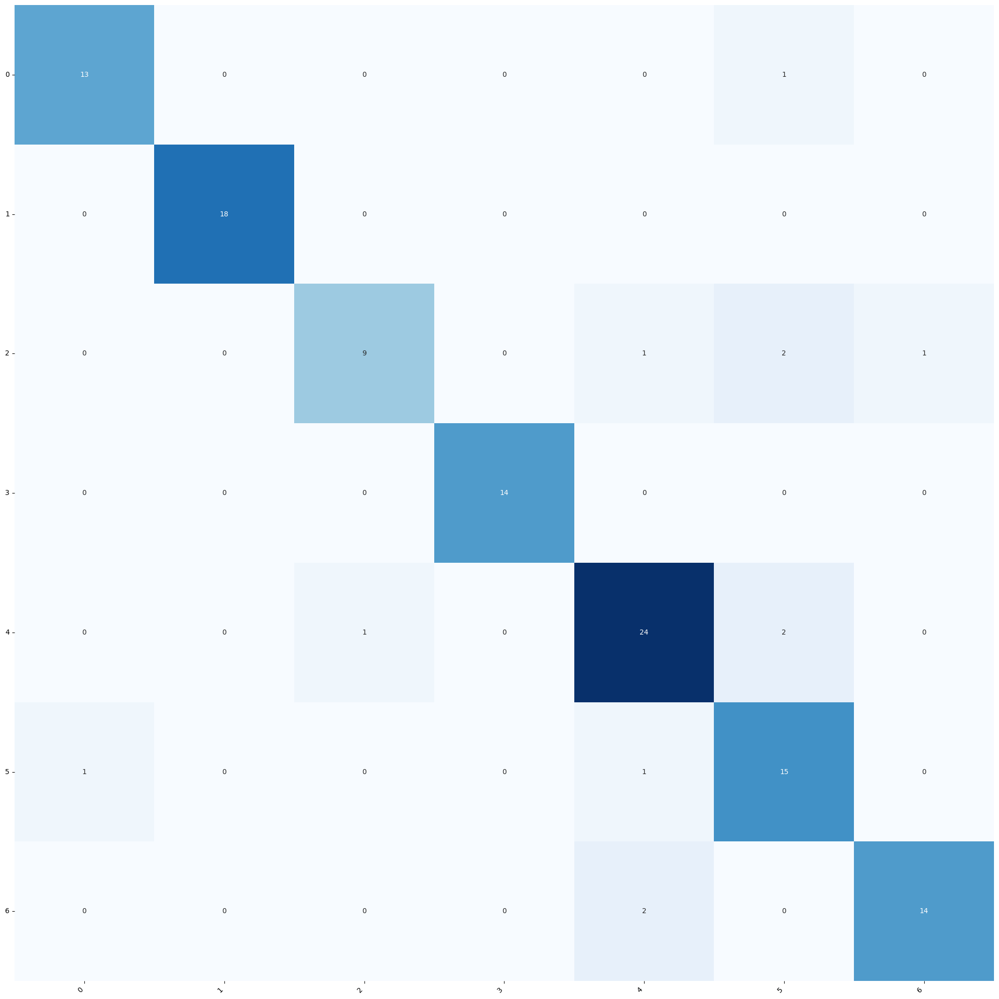

In [ ]:
import seaborn as sns

interp = ClassificationInterpretation.from_learner(model)

plt.figure(figsize=(20, 20))
ax = plt.gca()
sns.heatmap(interp.confusion_matrix(), annot=True, fmt="d", cmap="Blues", cbar=False, ax=ax)

plt.xticks(rotation=45, ha='right')

plt.yticks(rotation=0)

plt.tight_layout()

plt.show()

In [ ]:
# Access the 10th vocab item (index 9 since indexing is 0-based)
vocab_item = dls.train.vocab[105]

print(vocab_item)

Viverra zibetha


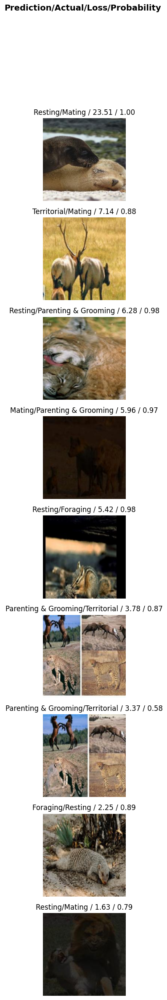

In [ ]:
interp.plot_top_losses(9, nrows = 9)

In [ ]:
cleaner = ImageClassifierCleaner(model)
cleaner

In [ ]:
cleaner.delete()
cleaner.change()

(#1) [(0, 'Resting')]

In [ ]:
for idx in cleaner.delete(): cleaner.fns[idx].unlink()
for idx, cat in cleaner.change(): shutil.move(str(cleaner.fns[idx]), f"{data_dir}/{cat}")

In [ ]:
dls.train.show_batch(max_n = 8, nrows = 4)

In [ ]:
dls.train.vocab

['Foraging', 'Hunting', 'Mating', 'Migraating', 'Parenting & Grooming', 'Resting', 'Territorial']

In [ ]:
train_len = len(dls.train)
valid_len = len(dls.valid)

print(f"Training DataLoader Length: {train_len}")
print(f"Validation DataLoader Length: {valid_len}")

Training DataLoader Length: 67
Validation DataLoader Length: 8


In [ ]:
model.load("behavior_model_v1")

Training the model with Fastai

In [ ]:
from fastai.callback.tracker import SaveModelCallback
save_callback = SaveModelCallback(monitor='valid_loss')

In [ ]:
model.fine_tune(1)

In [ ]:
model.freeze()

SuggestedLRs(slide=0.001737800776027143, valley=0.0012022644514217973)

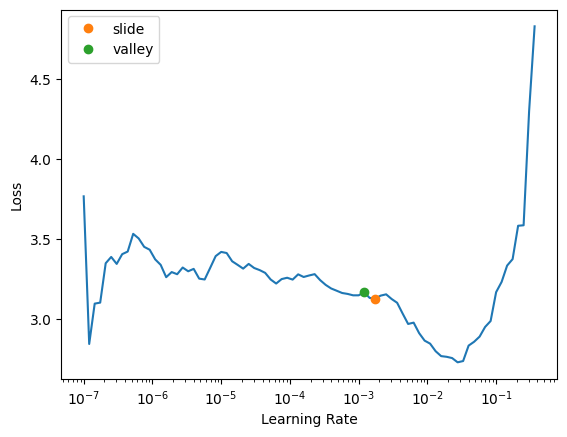

In [ ]:
model.lr_find(suggest_funcs=[slide, valley])

In [ ]:
import math

slide = 0.001737800776027143
valley = 0.0012022644514217973

log_slide = math.log10(slide)
log_valley = math.log10(valley)

lr_max = slice(10**(log_valley), 10**(log_slide))

lr_max

slice(0.0012022644514217968, 0.0017378007760271424, None)

In [ ]:
model.fit_one_cycle(2, lr_max = lr_max)

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,1.619833,0.933567,0.277311,0.722689,00:14
1,1.053821,0.706479,0.201681,0.798319,00:13


In [ ]:
model.unfreeze()

SuggestedLRs(slide=0.0012022644514217973, valley=3.0199516913853586e-05)

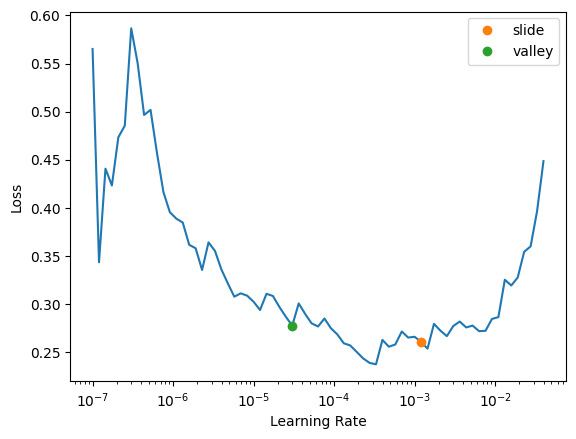

In [ ]:
from fastai.callback.schedule import slide, valley

model.lr_find(suggest_funcs=[slide, valley])

In [ ]:
import math

slide = 0.0012022644514217973
valley = 3.0199516913853586e-05

log_slide = math.log10(slide)
log_valley = math.log10(valley)

lr_max = slice(10**(log_valley), 10**(log_slide))

lr_max

slice(3.0199516913853603e-05, 0.0012022644514217968, None)

In [ ]:
model.fit_one_cycle(2, lr_max = lr_max)

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.315483,0.085682,0.025424,0.974576,01:52
1,0.284632,0.091430,0.025424,0.974576,00:15


In [ ]:
model.fit_one_cycle(5, lr_max=lr_max)

In [ ]:
model.save("behavior_model_v1")

Path('models/behavior_model_v1.pth')

In [ ]:
model.export("behavior_model_v1.pkl")

## Behavior Predictions

In [ ]:
import pandas as pd
from fastai.vision.all import *

model = load_learner('behavior_model_v1.pkl')

species_image_dir = 'final/species'

image_paths = []
species_names = []
behavior_predictions = []

# Iterate through all subfolders (species labels) within the species_image_dir
for species_name in os.listdir(species_image_dir):
    species_folder = os.path.join(species_image_dir, species_name)
    if os.path.isdir(species_folder):
        # Get a list of image file paths within the subfolder
        image_files = get_image_files(species_folder)

        # Iterate through the images in the subfolder and make predictions
        for image_file in image_files:
            img = PILImage.create(image_file)

            # Make behavior prediction
            behavior_pred, _, _ = model.predict(img)

            # Append data to lists
            image_paths.append(str(image_file))
            species_names.append(species_name)
            behavior_predictions.append(behavior_pred[0])

# Create a DataFrame with the collected data
data = {'Image_Path': image_paths, 'Species_Name': species_names, 'Behavior_Prediction': behavior_predictions}
df = pd.DataFrame(data)

df.to_csv('behavior_predictions.csv', index=False)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
import os
import pandas as pd
from fastai.vision.all import *
from tqdm import tqdm

model = load_learner('behavior_model_v1.pkl')

species_image_dir = 'final/species'

image_paths = []
species_names = []
behavior_predictions = []

# Iterate through all subfolders (species labels) within the species_image_dir
for species_name in tqdm(os.listdir(species_image_dir), desc='Processing Species'):
    species_folder = os.path.join(species_image_dir, species_name)
    if os.path.isdir(species_folder):
        # Get a list of image file paths within the subfolder
        image_files = get_image_files(species_folder)

        # Iterate through the images in the subfolder and make predictions
        for image_file in tqdm(image_files, desc=f'Predicting Behavior for {species_name}', leave=False):
            img = PILImage.create(image_file)

            # Make behavior prediction
            behavior_pred, _, _ = model.predict(img)

            # Append data to lists
            image_paths.append(str(image_file))
            species_names.append(species_name)
            behavior_predictions.append(behavior_pred[0])

# Create a DataFrame with the collected data
data = {'Image_Path': image_paths, 'Species_Name': species_names, 'Behavior_Prediction': behavior_predictions}
df = pd.DataFrame(data)

df.to_csv('behavior_predictions_v1.csv', index=False)


Predicting Behavior for Tupaia belangeri:   0%|          | 0/198 [00:00<?, ?it/s]


Predicting Behavior for Tupaia belangeri:   1%|          | 1/198 [00:01<06:14,  1.90s/it]


Predicting Behavior for Tupaia belangeri:   1%|          | 2/198 [00:03<06:01,  1.85s/it]


Predicting Behavior for Tupaia belangeri:   2%|▏         | 3/198 [00:04<04:24,  1.35s/it]


Predicting Behavior for Tupaia belangeri:   2%|▏         | 4/198 [00:04<02:56,  1.10it/s]


Predicting Behavior for Tupaia belangeri:   3%|▎         | 5/198 [00:04<02:06,  1.53it/s]


Predicting Behavior for Tupaia belangeri:   3%|▎         | 6/198 [00:05<01:37,  1.97it/s]


Predicting Behavior for Tupaia belangeri:   4%|▎         | 7/198 [00:05<01:19,  2.42it/s]


Predicting Behavior for Tupaia belangeri:   4%|▍         | 8/198 [00:05<01:10,  2.68it/s]


Predicting Behavior for Tupaia belangeri:   5%|▍         | 9/198 [00:05<01:00,  3.11it/s]


Predicting Behavior for Tupaia belangeri:   5%|▌         | 10/198 [00:06<00:54,  3.44it/s]


Predicting Behavior for Tupaia belangeri:   6%|▌         | 11/198 [00:06<00:49,  3.76it/s]


Predicting Behavior for Tupaia belangeri:   6%|▌         | 12/198 [00:06<00:49,  3.77it/s]


Predicting Behavior for Tupaia belangeri:   7%|▋         | 13/198 [00:06<00:46,  4.00it/s]


Predicting Behavior for Tupaia belangeri:   7%|▋         | 14/198 [00:06<00:44,  4.16it/s]


Predicting Behavior for Tupaia belangeri:   8%|▊         | 15/198 [00:07<00:42,  4.31it/s]


Predicting Behavior for Tupaia belangeri:   8%|▊         | 16/198 [00:07<00:46,  3.95it/s]


Predicting Behavior for Tupaia belangeri:   9%|▊         | 17/198 [00:07<00:50,  3.60it/s]


Predicting Behavior for Tupaia belangeri:   9%|▉         | 18/198 [00:08<00:55,  3.23it/s]


Predicting Behavior for Tupaia belangeri:  10%|▉         | 19/198 [00:08<00:57,  3.10it/s]


Predicting Behavior for Tupaia belangeri:  10%|█         | 20/198 [00:08<00:57,  3.11it/s]


Predicting Behavior for Tupaia belangeri:  11%|█         | 21/198 [00:09<00:59,  2.97it/s]


Predicting Behavior for Tupaia belangeri:  11%|█         | 22/198 [00:09<00:58,  3.03it/s]


Predicting Behavior for Tupaia belangeri:  12%|█▏        | 23/198 [00:09<00:56,  3.09it/s]


Predicting Behavior for Tupaia belangeri:  12%|█▏        | 24/198 [00:10<00:56,  3.09it/s]


Predicting Behavior for Tupaia belangeri:  13%|█▎        | 25/198 [00:10<00:56,  3.07it/s]


Predicting Behavior for Tupaia belangeri:  13%|█▎        | 26/198 [00:10<00:56,  3.04it/s]


Predicting Behavior for Tupaia belangeri:  14%|█▎        | 27/198 [00:11<00:58,  2.93it/s]


Predicting Behavior for Tupaia belangeri:  14%|█▍        | 28/198 [00:11<00:57,  2.94it/s]


Predicting Behavior for Tupaia belangeri:  15%|█▍        | 29/198 [00:11<00:53,  3.16it/s]


Predicting Behavior for Tupaia belangeri:  15%|█▌        | 30/198 [00:12<00:48,  3.49it/s]


Predicting Behavior for Tupaia belangeri:  16%|█▌        | 31/198 [00:12<00:44,  3.74it/s]


Predicting Behavior for Tupaia belangeri:  16%|█▌        | 32/198 [00:12<00:42,  3.89it/s]


Predicting Behavior for Tupaia belangeri:  17%|█▋        | 33/198 [00:12<00:41,  4.00it/s]


Predicting Behavior for Tupaia belangeri:  17%|█▋        | 34/198 [00:12<00:39,  4.20it/s]


Predicting Behavior for Tupaia belangeri:  18%|█▊        | 35/198 [00:13<00:37,  4.32it/s]


Predicting Behavior for Tupaia belangeri:  18%|█▊        | 36/198 [00:13<00:37,  4.34it/s]


Predicting Behavior for Tupaia belangeri:  19%|█▊        | 37/198 [00:13<00:38,  4.22it/s]


Predicting Behavior for Tupaia belangeri:  19%|█▉        | 38/198 [00:13<00:36,  4.33it/s]


Predicting Behavior for Tupaia belangeri:  20%|█▉        | 39/198 [00:14<00:35,  4.48it/s]


Predicting Behavior for Tupaia belangeri:  20%|██        | 40/198 [00:14<00:34,  4.54it/s]


Predicting Behavior for Tupaia belangeri:  21%|██        | 41/198 [00:14<00:34,  4.55it/s]


Predicting Behavior for Tupaia belangeri:  21%|██        | 42/198 [00:14<00:35,  4.40it/s]


Predicting Behavior for Tupaia belangeri:  22%|██▏       | 43/198 [00:14<00:34,  4.48it/s]


Predicting Behavior for Tupaia belangeri:  22%|██▏       | 44/198 [00:15<00:33,  4.59it/s]


Predicting Behavior for Tupaia belangeri:  23%|██▎       | 45/198 [00:15<00:32,  4.68it/s]


Predicting Behavior for Tupaia belangeri:  23%|██▎       | 46/198 [00:15<00:33,  4.49it/s]


Predicting Behavior for Tupaia belangeri:  24%|██▎       | 47/198 [00:15<00:34,  4.40it/s]


Predicting Behavior for Tupaia belangeri:  24%|██▍       | 48/198 [00:16<01:10,  2.13it/s]


Predicting Behavior for Tupaia belangeri:  25%|██▍       | 49/198 [00:17<00:59,  2.50it/s]


Predicting Behavior for Tupaia belangeri:  25%|██▌       | 50/198 [00:17<00:50,  2.94it/s]


Predicting Behavior for Tupaia belangeri:  26%|██▌       | 51/198 [00:17<00:44,  3.29it/s]


Predicting Behavior for Tupaia belangeri:  26%|██▋       | 52/198 [00:17<00:42,  3.47it/s]


Predicting Behavior for Tupaia belangeri:  27%|██▋       | 53/198 [00:18<00:39,  3.66it/s]


Predicting Behavior for Tupaia belangeri:  27%|██▋       | 54/198 [00:18<00:37,  3.81it/s]


Predicting Behavior for Tupaia belangeri:  28%|██▊       | 55/198 [00:18<00:35,  4.06it/s]


Predicting Behavior for Tupaia belangeri:  28%|██▊       | 56/198 [00:18<00:34,  4.14it/s]


Predicting Behavior for Tupaia belangeri:  29%|██▉       | 57/198 [00:18<00:33,  4.17it/s]


Predicting Behavior for Tupaia belangeri:  29%|██▉       | 58/198 [00:19<00:32,  4.34it/s]


Predicting Behavior for Tupaia belangeri:  30%|██▉       | 59/198 [00:19<00:30,  4.53it/s]


Predicting Behavior for Tupaia belangeri:  30%|███       | 60/198 [00:19<00:32,  4.21it/s]


Predicting Behavior for Tupaia belangeri:  31%|███       | 61/198 [00:19<00:31,  4.30it/s]


Predicting Behavior for Tupaia belangeri:  31%|███▏      | 62/198 [00:20<00:30,  4.46it/s]


Predicting Behavior for Tupaia belangeri:  32%|███▏      | 63/198 [00:20<00:30,  4.41it/s]


Predicting Behavior for Tupaia belangeri:  32%|███▏      | 64/198 [00:20<00:29,  4.53it/s]


Predicting Behavior for Tupaia belangeri:  33%|███▎      | 65/198 [00:20<00:29,  4.52it/s]


Predicting Behavior for Tupaia belangeri:  33%|███▎      | 66/198 [00:20<00:29,  4.47it/s]


Predicting Behavior for Tupaia belangeri:  34%|███▍      | 67/198 [00:21<00:28,  4.55it/s]


Predicting Behavior for Tupaia belangeri:  34%|███▍      | 68/198 [00:21<00:28,  4.49it/s]


Predicting Behavior for Tupaia belangeri:  35%|███▍      | 69/198 [00:21<00:28,  4.60it/s]


Predicting Behavior for Tupaia belangeri:  35%|███▌      | 70/198 [00:21<00:32,  3.99it/s]


Predicting Behavior for Tupaia belangeri:  36%|███▌      | 71/198 [00:22<00:34,  3.68it/s]


Predicting Behavior for Tupaia belangeri:  36%|███▋      | 72/198 [00:22<00:37,  3.33it/s]


Predicting Behavior for Tupaia belangeri:  37%|███▋      | 73/198 [00:22<00:39,  3.20it/s]


Predicting Behavior for Tupaia belangeri:  37%|███▋      | 74/198 [00:23<00:40,  3.07it/s]


Predicting Behavior for Tupaia belangeri:  38%|███▊      | 75/198 [00:23<00:39,  3.13it/s]


Predicting Behavior for Tupaia belangeri:  38%|███▊      | 76/198 [00:23<00:38,  3.16it/s]


Predicting Behavior for Tupaia belangeri:  39%|███▉      | 77/198 [00:24<00:38,  3.16it/s]


Predicting Behavior for Tupaia belangeri:  39%|███▉      | 78/198 [00:24<00:38,  3.08it/s]


Predicting Behavior for Tupaia belangeri:  40%|███▉      | 79/198 [00:24<00:39,  3.00it/s]


Predicting Behavior for Tupaia belangeri:  40%|████      | 80/198 [00:25<00:38,  3.06it/s]


Predicting Behavior for Tupaia belangeri:  41%|████      | 81/198 [00:25<00:38,  3.02it/s]


Predicting Behavior for Tupaia belangeri:  41%|████▏     | 82/198 [00:25<00:38,  3.04it/s]


Predicting Behavior for Tupaia belangeri:  42%|████▏     | 83/198 [00:26<00:38,  3.02it/s]


Predicting Behavior for Tupaia belangeri:  42%|████▏     | 84/198 [00:26<00:34,  3.34it/s]


Predicting Behavior for Tupaia belangeri:  43%|████▎     | 85/198 [00:26<00:31,  3.61it/s]


Predicting Behavior for Tupaia belangeri:  43%|████▎     | 86/198 [00:26<00:29,  3.75it/s]


Predicting Behavior for Tupaia belangeri:  44%|████▍     | 87/198 [00:27<00:27,  4.04it/s]


Predicting Behavior for Tupaia belangeri:  44%|████▍     | 88/198 [00:27<00:26,  4.21it/s]


Predicting Behavior for Tupaia belangeri:  45%|████▍     | 89/198 [00:27<00:25,  4.27it/s]


Predicting Behavior for Tupaia belangeri:  45%|████▌     | 90/198 [00:27<00:25,  4.26it/s]


Predicting Behavior for Tupaia belangeri:  46%|████▌     | 91/198 [00:28<00:24,  4.31it/s]


Predicting Behavior for Tupaia belangeri:  46%|████▋     | 92/198 [00:28<00:23,  4.46it/s]


Predicting Behavior for Tupaia belangeri:  47%|████▋     | 93/198 [00:28<00:23,  4.49it/s]


Predicting Behavior for Tupaia belangeri:  47%|████▋     | 94/198 [00:28<00:24,  4.26it/s]


Predicting Behavior for Tupaia belangeri:  48%|████▊     | 95/198 [00:28<00:24,  4.22it/s]


Predicting Behavior for Tupaia belangeri:  48%|████▊     | 96/198 [00:29<00:23,  4.25it/s]


Predicting Behavior for Tupaia belangeri:  49%|████▉     | 97/198 [00:29<00:23,  4.23it/s]


Predicting Behavior for Tupaia belangeri:  49%|████▉     | 98/198 [00:29<00:23,  4.32it/s]


Predicting Behavior for Tupaia belangeri:  50%|█████     | 99/198 [00:29<00:22,  4.46it/s]


Predicting Behavior for Tupaia belangeri:  51%|█████     | 100/198 [00:30<00:22,  4.41it/s]


Predicting Behavior for Tupaia belangeri:  51%|█████     | 101/198 [00:30<00:21,  4.54it/s]


Predicting Behavior for Tupaia belangeri:  52%|█████▏    | 102/198 [00:30<00:20,  4.60it/s]


Predicting Behavior for Tupaia belangeri:  52%|█████▏    | 103/198 [00:30<00:22,  4.31it/s]


Predicting Behavior for Tupaia belangeri:  53%|█████▎    | 104/198 [00:31<00:21,  4.37it/s]


Predicting Behavior for Tupaia belangeri:  53%|█████▎    | 105/198 [00:31<00:21,  4.30it/s]


Predicting Behavior for Tupaia belangeri:  54%|█████▎    | 106/198 [00:31<00:20,  4.39it/s]


Predicting Behavior for Tupaia belangeri:  54%|█████▍    | 107/198 [00:31<00:20,  4.44it/s]


Predicting Behavior for Tupaia belangeri:  55%|█████▍    | 108/198 [00:31<00:20,  4.41it/s]


Predicting Behavior for Tupaia belangeri:  55%|█████▌    | 109/198 [00:32<00:20,  4.33it/s]


Predicting Behavior for Tupaia belangeri:  56%|█████▌    | 110/198 [00:32<00:20,  4.27it/s]


Predicting Behavior for Tupaia belangeri:  56%|█████▌    | 111/198 [00:32<00:20,  4.30it/s]


Predicting Behavior for Tupaia belangeri:  57%|█████▋    | 112/198 [00:32<00:19,  4.45it/s]


Predicting Behavior for Tupaia belangeri:  57%|█████▋    | 113/198 [00:33<00:18,  4.54it/s]


Predicting Behavior for Tupaia belangeri:  58%|█████▊    | 114/198 [00:33<00:18,  4.63it/s]


Predicting Behavior for Tupaia belangeri:  58%|█████▊    | 115/198 [00:33<00:18,  4.55it/s]


Predicting Behavior for Tupaia belangeri:  59%|█████▊    | 116/198 [00:33<00:18,  4.44it/s]


Predicting Behavior for Tupaia belangeri:  59%|█████▉    | 117/198 [00:33<00:17,  4.52it/s]


Predicting Behavior for Tupaia belangeri:  60%|█████▉    | 118/198 [00:34<00:18,  4.44it/s]


Predicting Behavior for Tupaia belangeri:  60%|██████    | 119/198 [00:34<00:17,  4.55it/s]


Predicting Behavior for Tupaia belangeri:  61%|██████    | 120/198 [00:34<00:16,  4.60it/s]


Predicting Behavior for Tupaia belangeri:  61%|██████    | 121/198 [00:34<00:16,  4.57it/s]


Predicting Behavior for Tupaia belangeri:  62%|██████▏   | 122/198 [00:35<00:16,  4.61it/s]


Predicting Behavior for Tupaia belangeri:  62%|██████▏   | 123/198 [00:35<00:16,  4.51it/s]


Predicting Behavior for Tupaia belangeri:  63%|██████▎   | 124/198 [00:35<00:16,  4.40it/s]


Predicting Behavior for Tupaia belangeri:  63%|██████▎   | 125/198 [00:35<00:16,  4.31it/s]


Predicting Behavior for Tupaia belangeri:  64%|██████▎   | 126/198 [00:35<00:16,  4.42it/s]


Predicting Behavior for Tupaia belangeri:  64%|██████▍   | 127/198 [00:36<00:16,  4.33it/s]


Predicting Behavior for Tupaia belangeri:  65%|██████▍   | 128/198 [00:36<00:17,  3.93it/s]


Predicting Behavior for Tupaia belangeri:  65%|██████▌   | 129/198 [00:36<00:19,  3.55it/s]


Predicting Behavior for Tupaia belangeri:  66%|██████▌   | 130/198 [00:37<00:21,  3.22it/s]


Predicting Behavior for Tupaia belangeri:  66%|██████▌   | 131/198 [00:37<00:20,  3.24it/s]


Predicting Behavior for Tupaia belangeri:  67%|██████▋   | 132/198 [00:37<00:21,  3.07it/s]


Predicting Behavior for Tupaia belangeri:  67%|██████▋   | 133/198 [00:38<00:21,  2.98it/s]


Predicting Behavior for Tupaia belangeri:  68%|██████▊   | 134/198 [00:38<00:21,  2.95it/s]


Predicting Behavior for Tupaia belangeri:  68%|██████▊   | 135/198 [00:38<00:20,  3.00it/s]


Predicting Behavior for Tupaia belangeri:  69%|██████▊   | 136/198 [00:39<00:20,  2.99it/s]


Predicting Behavior for Tupaia belangeri:  69%|██████▉   | 137/198 [00:39<00:20,  2.92it/s]


Predicting Behavior for Tupaia belangeri:  70%|██████▉   | 138/198 [00:39<00:20,  2.86it/s]


Predicting Behavior for Tupaia belangeri:  70%|███████   | 139/198 [00:40<00:20,  2.81it/s]


Predicting Behavior for Tupaia belangeri:  71%|███████   | 140/198 [00:40<00:20,  2.86it/s]


Predicting Behavior for Tupaia belangeri:  71%|███████   | 141/198 [00:40<00:19,  2.97it/s]


Predicting Behavior for Tupaia belangeri:  72%|███████▏  | 142/198 [00:41<00:16,  3.34it/s]


Predicting Behavior for Tupaia belangeri:  72%|███████▏  | 143/198 [00:41<00:15,  3.63it/s]


Predicting Behavior for Tupaia belangeri:  73%|███████▎  | 144/198 [00:41<00:13,  3.87it/s]


Predicting Behavior for Tupaia belangeri:  73%|███████▎  | 145/198 [00:41<00:13,  4.05it/s]


Predicting Behavior for Tupaia belangeri:  74%|███████▎  | 146/198 [00:42<00:12,  4.10it/s]


Predicting Behavior for Tupaia belangeri:  74%|███████▍  | 147/198 [00:42<00:12,  4.06it/s]


Predicting Behavior for Tupaia belangeri:  75%|███████▍  | 148/198 [00:42<00:12,  4.16it/s]


Predicting Behavior for Tupaia belangeri:  75%|███████▌  | 149/198 [00:42<00:11,  4.27it/s]


Predicting Behavior for Tupaia belangeri:  76%|███████▌  | 150/198 [00:43<00:10,  4.37it/s]


Predicting Behavior for Tupaia belangeri:  76%|███████▋  | 151/198 [00:43<00:10,  4.46it/s]


Predicting Behavior for Tupaia belangeri:  77%|███████▋  | 152/198 [00:43<00:10,  4.45it/s]


Predicting Behavior for Tupaia belangeri:  77%|███████▋  | 153/198 [00:43<00:10,  4.39it/s]


Predicting Behavior for Tupaia belangeri:  78%|███████▊  | 154/198 [00:43<00:10,  4.37it/s]


Predicting Behavior for Tupaia belangeri:  78%|███████▊  | 155/198 [00:44<00:09,  4.33it/s]


Predicting Behavior for Tupaia belangeri:  79%|███████▉  | 156/198 [00:44<00:09,  4.31it/s]


Predicting Behavior for Tupaia belangeri:  79%|███████▉  | 157/198 [00:44<00:10,  4.00it/s]


Predicting Behavior for Tupaia belangeri:  80%|███████▉  | 158/198 [00:44<00:09,  4.07it/s]


Predicting Behavior for Tupaia belangeri:  80%|████████  | 159/198 [00:45<00:09,  4.26it/s]


Predicting Behavior for Tupaia belangeri:  81%|████████  | 160/198 [00:45<00:08,  4.43it/s]


Predicting Behavior for Tupaia belangeri:  81%|████████▏ | 161/198 [00:45<00:08,  4.37it/s]


Predicting Behavior for Tupaia belangeri:  82%|████████▏ | 162/198 [00:45<00:08,  4.49it/s]


Predicting Behavior for Tupaia belangeri:  82%|████████▏ | 163/198 [00:45<00:07,  4.51it/s]


Predicting Behavior for Tupaia belangeri:  83%|████████▎ | 164/198 [00:46<00:07,  4.37it/s]


Predicting Behavior for Tupaia belangeri:  83%|████████▎ | 165/198 [00:46<00:07,  4.40it/s]


Predicting Behavior for Tupaia belangeri:  84%|████████▍ | 166/198 [00:46<00:07,  4.39it/s]


Predicting Behavior for Tupaia belangeri:  84%|████████▍ | 167/198 [00:46<00:06,  4.46it/s]


Predicting Behavior for Tupaia belangeri:  85%|████████▍ | 168/198 [00:47<00:06,  4.45it/s]


Predicting Behavior for Tupaia belangeri:  85%|████████▌ | 169/198 [00:47<00:06,  4.38it/s]


Predicting Behavior for Tupaia belangeri:  86%|████████▌ | 170/198 [00:47<00:06,  4.37it/s]


Predicting Behavior for Tupaia belangeri:  86%|████████▋ | 171/198 [00:47<00:06,  4.45it/s]


Predicting Behavior for Tupaia belangeri:  87%|████████▋ | 172/198 [00:48<00:05,  4.46it/s]


Predicting Behavior for Tupaia belangeri:  87%|████████▋ | 173/198 [00:48<00:05,  4.34it/s]


Predicting Behavior for Tupaia belangeri:  88%|████████▊ | 174/198 [00:48<00:05,  4.31it/s]


Predicting Behavior for Tupaia belangeri:  88%|████████▊ | 175/198 [00:48<00:05,  4.36it/s]


Predicting Behavior for Tupaia belangeri:  89%|████████▉ | 176/198 [00:48<00:04,  4.46it/s]


Predicting Behavior for Tupaia belangeri:  89%|████████▉ | 177/198 [00:49<00:04,  4.53it/s]


Predicting Behavior for Tupaia belangeri:  90%|████████▉ | 178/198 [00:49<00:04,  4.56it/s]


Predicting Behavior for Tupaia belangeri:  90%|█████████ | 179/198 [00:49<00:04,  4.55it/s]


Predicting Behavior for Tupaia belangeri:  91%|█████████ | 180/198 [00:49<00:03,  4.58it/s]


Predicting Behavior for Tupaia belangeri:  91%|█████████▏| 181/198 [00:50<00:03,  4.55it/s]


Predicting Behavior for Tupaia belangeri:  92%|█████████▏| 182/198 [00:50<00:03,  4.61it/s]


Predicting Behavior for Tupaia belangeri:  92%|█████████▏| 183/198 [00:50<00:03,  4.42it/s]


Predicting Behavior for Tupaia belangeri:  93%|█████████▎| 184/198 [00:50<00:03,  4.30it/s]


Predicting Behavior for Tupaia belangeri:  93%|█████████▎| 185/198 [00:50<00:02,  4.36it/s]


Predicting Behavior for Tupaia belangeri:  94%|█████████▍| 186/198 [00:51<00:03,  3.92it/s]


Predicting Behavior for Tupaia belangeri:  94%|█████████▍| 187/198 [00:51<00:02,  3.71it/s]


Predicting Behavior for Tupaia belangeri:  95%|█████████▍| 188/198 [00:51<00:02,  3.49it/s]


Predicting Behavior for Tupaia belangeri:  95%|█████████▌| 189/198 [00:52<00:02,  3.47it/s]


Predicting Behavior for Tupaia belangeri:  96%|█████████▌| 190/198 [00:52<00:02,  3.42it/s]


Predicting Behavior for Tupaia belangeri:  96%|█████████▋| 191/198 [00:52<00:02,  2.99it/s]


Predicting Behavior for Tupaia belangeri:  97%|█████████▋| 192/198 [00:53<00:01,  3.09it/s]


Predicting Behavior for Tupaia belangeri:  97%|█████████▋| 193/198 [00:53<00:01,  3.13it/s]


Predicting Behavior for Tupaia belangeri:  98%|█████████▊| 194/198 [00:53<00:01,  3.16it/s]


Predicting Behavior for Tupaia belangeri:  98%|█████████▊| 195/198 [00:54<00:00,  3.20it/s]


Predicting Behavior for Tupaia belangeri:  99%|█████████▉| 196/198 [00:54<00:00,  3.18it/s]


Predicting Behavior for Tupaia belangeri:  99%|█████████▉| 197/198 [00:54<00:00,  2.93it/s]


Predicting Behavior for Manis crassicaudata:   0%|          | 0/199 [00:00<?, ?it/s]


Predicting Behavior for Manis crassicaudata:   1%|          | 1/199 [00:00<02:32,  1.29it/s]


Predicting Behavior for Manis crassicaudata:   1%|          | 2/199 [00:01<03:21,  1.02s/it]


Predicting Behavior for Manis crassicaudata:   2%|▏         | 3/199 [00:03<03:30,  1.07s/it]


Predicting Behavior for Manis crassicaudata:   2%|▏         | 4/199 [00:03<02:25,  1.34it/s]


Predicting Behavior for Manis crassicaudata:   3%|▎         | 5/199 [00:03<01:47,  1.81it/s]


Predicting Behavior for Manis crassicaudata:   3%|▎         | 6/199 [00:03<01:24,  2.27it/s]


Predicting Behavior for Manis crassicaudata:   4%|▎         | 7/199 [00:04<01:12,  2.65it/s]


Predicting Behavior for Manis crassicaudata:   4%|▍         | 8/199 [00:04<01:06,  2.87it/s]


Predicting Behavior for Manis crassicaudata:   5%|▍         | 9/199 [00:04<01:03,  3.01it/s]


Predicting Behavior for Manis crassicaudata:   5%|▌         | 10/199 [00:04<00:57,  3.31it/s]


Predicting Behavior for Manis crassicaudata:   6%|▌         | 11/199 [00:05<00:51,  3.64it/s]


Predicting Behavior for Manis crassicaudata:   6%|▌         | 12/199 [00:05<00:48,  3.86it/s]


Predicting Behavior for Manis crassicaudata:   7%|▋         | 13/199 [00:05<00:46,  4.02it/s]


Predicting Behavior for Manis crassicaudata:   7%|▋         | 14/199 [00:05<00:44,  4.14it/s]


Predicting Behavior for Manis crassicaudata:   8%|▊         | 15/199 [00:05<00:43,  4.21it/s]


Predicting Behavior for Manis crassicaudata:   8%|▊         | 16/199 [00:06<00:46,  3.90it/s]


Predicting Behavior for Manis crassicaudata:   9%|▊         | 17/199 [00:06<00:46,  3.94it/s]


Predicting Behavior for Manis crassicaudata:   9%|▉         | 18/199 [00:06<00:45,  3.98it/s]


Predicting Behavior for Manis crassicaudata:  10%|▉         | 19/199 [00:06<00:44,  4.04it/s]


Predicting Behavior for Manis crassicaudata:  10%|█         | 20/199 [00:07<00:43,  4.14it/s]


Predicting Behavior for Manis crassicaudata:  11%|█         | 21/199 [00:07<00:42,  4.21it/s]


Predicting Behavior for Manis crassicaudata:  11%|█         | 22/199 [00:07<00:42,  4.13it/s]


Predicting Behavior for Manis crassicaudata:  12%|█▏        | 23/199 [00:07<00:44,  3.99it/s]


Predicting Behavior for Manis crassicaudata:  12%|█▏        | 24/199 [00:08<00:41,  4.19it/s]


Predicting Behavior for Manis crassicaudata:  13%|█▎        | 25/199 [00:08<00:41,  4.17it/s]


Predicting Behavior for Manis crassicaudata:  13%|█▎        | 26/199 [00:08<00:41,  4.22it/s]


Predicting Behavior for Manis crassicaudata:  14%|█▎        | 27/199 [00:08<00:39,  4.32it/s]


Predicting Behavior for Manis crassicaudata:  14%|█▍        | 28/199 [00:09<00:38,  4.40it/s]


Predicting Behavior for Manis crassicaudata:  15%|█▍        | 29/199 [00:09<00:38,  4.36it/s]


Predicting Behavior for Manis crassicaudata:  15%|█▌        | 30/199 [00:11<02:09,  1.31it/s]


Predicting Behavior for Manis crassicaudata:  16%|█▌        | 31/199 [00:11<01:46,  1.58it/s]


Predicting Behavior for Manis crassicaudata:  16%|█▌        | 32/199 [00:11<01:29,  1.86it/s]


Predicting Behavior for Manis crassicaudata:  17%|█▋        | 33/199 [00:12<01:18,  2.12it/s]


Predicting Behavior for Manis crassicaudata:  17%|█▋        | 34/199 [00:12<01:12,  2.27it/s]


Predicting Behavior for Manis crassicaudata:  18%|█▊        | 35/199 [00:13<01:08,  2.38it/s]


Predicting Behavior for Manis crassicaudata:  18%|█▊        | 36/199 [00:13<01:05,  2.49it/s]


Predicting Behavior for Manis crassicaudata:  19%|█▊        | 37/199 [00:13<01:01,  2.64it/s]


Predicting Behavior for Manis crassicaudata:  19%|█▉        | 38/199 [00:14<00:57,  2.81it/s]


Predicting Behavior for Manis crassicaudata:  20%|█▉        | 39/199 [00:14<00:58,  2.72it/s]


Predicting Behavior for Manis crassicaudata:  20%|██        | 40/199 [00:14<00:58,  2.71it/s]


Predicting Behavior for Manis crassicaudata:  21%|██        | 41/199 [00:15<00:51,  3.07it/s]


Predicting Behavior for Manis crassicaudata:  21%|██        | 42/199 [00:15<00:47,  3.31it/s]


Predicting Behavior for Manis crassicaudata:  22%|██▏       | 43/199 [00:16<01:10,  2.21it/s]


Predicting Behavior for Manis crassicaudata:  22%|██▏       | 44/199 [00:16<01:00,  2.56it/s]


Predicting Behavior for Manis crassicaudata:  23%|██▎       | 45/199 [00:16<00:54,  2.83it/s]


Predicting Behavior for Manis crassicaudata:  23%|██▎       | 46/199 [00:16<00:50,  3.01it/s]


Predicting Behavior for Manis crassicaudata:  24%|██▎       | 47/199 [00:17<00:45,  3.31it/s]


Predicting Behavior for Manis crassicaudata:  24%|██▍       | 48/199 [00:17<00:43,  3.48it/s]


Predicting Behavior for Manis crassicaudata:  25%|██▍       | 49/199 [00:17<00:40,  3.67it/s]


Predicting Behavior for Manis crassicaudata:  25%|██▌       | 50/199 [00:17<00:39,  3.75it/s]


Predicting Behavior for Manis crassicaudata:  26%|██▌       | 51/199 [00:18<00:38,  3.83it/s]


Predicting Behavior for Manis crassicaudata:  26%|██▌       | 52/199 [00:18<00:38,  3.84it/s]


Predicting Behavior for Manis crassicaudata:  27%|██▋       | 53/199 [00:18<00:37,  3.90it/s]


Predicting Behavior for Manis crassicaudata:  27%|██▋       | 54/199 [00:18<00:38,  3.79it/s]


Predicting Behavior for Manis crassicaudata:  28%|██▊       | 55/199 [00:19<00:36,  3.90it/s]


Predicting Behavior for Manis crassicaudata:  28%|██▊       | 56/199 [00:19<00:36,  3.96it/s]


Predicting Behavior for Manis crassicaudata:  29%|██▊       | 57/199 [00:19<00:37,  3.82it/s]


Predicting Behavior for Manis crassicaudata:  29%|██▉       | 58/199 [00:19<00:35,  3.94it/s]


Predicting Behavior for Manis crassicaudata:  30%|██▉       | 59/199 [00:20<00:34,  4.09it/s]


Predicting Behavior for Manis crassicaudata:  30%|███       | 60/199 [00:20<00:33,  4.11it/s]


Predicting Behavior for Manis crassicaudata:  31%|███       | 61/199 [00:20<00:33,  4.12it/s]


Predicting Behavior for Manis crassicaudata:  31%|███       | 62/199 [00:20<00:32,  4.17it/s]


Predicting Behavior for Manis crassicaudata:  32%|███▏      | 63/199 [00:21<00:37,  3.67it/s]


Predicting Behavior for Manis crassicaudata:  32%|███▏      | 64/199 [00:21<00:35,  3.77it/s]


Predicting Behavior for Manis crassicaudata:  33%|███▎      | 65/199 [00:22<01:09,  1.92it/s]


Predicting Behavior for Manis crassicaudata:  33%|███▎      | 66/199 [00:22<00:58,  2.27it/s]


Predicting Behavior for Manis crassicaudata:  34%|███▎      | 67/199 [00:23<00:50,  2.59it/s]


Predicting Behavior for Manis crassicaudata:  34%|███▍      | 68/199 [00:23<00:44,  2.93it/s]


Predicting Behavior for Manis crassicaudata:  35%|███▍      | 69/199 [00:23<00:41,  3.14it/s]


Predicting Behavior for Manis crassicaudata:  35%|███▌      | 70/199 [00:23<00:38,  3.36it/s]


Predicting Behavior for Manis crassicaudata:  36%|███▌      | 71/199 [00:24<00:35,  3.57it/s]


Predicting Behavior for Manis crassicaudata:  36%|███▌      | 72/199 [00:24<00:34,  3.69it/s]


Predicting Behavior for Manis crassicaudata:  37%|███▋      | 73/199 [00:24<00:32,  3.88it/s]


Predicting Behavior for Manis crassicaudata:  37%|███▋      | 74/199 [00:24<00:30,  4.05it/s]


Predicting Behavior for Manis crassicaudata:  38%|███▊      | 75/199 [00:25<00:32,  3.82it/s]


Predicting Behavior for Manis crassicaudata:  38%|███▊      | 76/199 [00:25<00:35,  3.45it/s]


Predicting Behavior for Manis crassicaudata:  39%|███▊      | 77/199 [00:25<00:37,  3.25it/s]


Predicting Behavior for Manis crassicaudata:  39%|███▉      | 78/199 [00:26<00:37,  3.27it/s]


Predicting Behavior for Manis crassicaudata:  40%|███▉      | 79/199 [00:26<00:37,  3.19it/s]


Predicting Behavior for Manis crassicaudata:  40%|████      | 80/199 [00:26<00:37,  3.19it/s]


Predicting Behavior for Manis crassicaudata:  41%|████      | 81/199 [00:26<00:35,  3.29it/s]


Predicting Behavior for Manis crassicaudata:  41%|████      | 82/199 [00:27<00:35,  3.27it/s]


Predicting Behavior for Manis crassicaudata:  42%|████▏     | 83/199 [00:27<00:37,  3.13it/s]


Predicting Behavior for Manis crassicaudata:  42%|████▏     | 84/199 [00:27<00:36,  3.17it/s]


Predicting Behavior for Manis crassicaudata:  43%|████▎     | 85/199 [00:28<00:35,  3.24it/s]


Predicting Behavior for Manis crassicaudata:  43%|████▎     | 86/199 [00:28<00:35,  3.22it/s]


Predicting Behavior for Manis crassicaudata:  44%|████▎     | 87/199 [00:28<00:36,  3.11it/s]


Predicting Behavior for Manis crassicaudata:  44%|████▍     | 88/199 [00:29<00:36,  3.07it/s]


Predicting Behavior for Manis crassicaudata:  45%|████▍     | 89/199 [00:29<00:34,  3.18it/s]


Predicting Behavior for Manis crassicaudata:  45%|████▌     | 90/199 [00:29<00:34,  3.19it/s]


Predicting Behavior for Manis crassicaudata:  46%|████▌     | 91/199 [00:30<00:34,  3.12it/s]


Predicting Behavior for Manis crassicaudata:  46%|████▌     | 92/199 [00:30<00:34,  3.14it/s]


Predicting Behavior for Manis crassicaudata:  47%|████▋     | 93/199 [00:30<00:33,  3.17it/s]


Predicting Behavior for Manis crassicaudata:  47%|████▋     | 94/199 [00:31<00:30,  3.44it/s]


Predicting Behavior for Manis crassicaudata:  48%|████▊     | 95/199 [00:31<00:28,  3.65it/s]


Predicting Behavior for Manis crassicaudata:  48%|████▊     | 96/199 [00:31<00:27,  3.78it/s]


Predicting Behavior for Manis crassicaudata:  49%|████▊     | 97/199 [00:31<00:26,  3.86it/s]


Predicting Behavior for Manis crassicaudata:  49%|████▉     | 98/199 [00:31<00:25,  3.91it/s]


Predicting Behavior for Manis crassicaudata:  50%|████▉     | 99/199 [00:32<00:24,  4.06it/s]


Predicting Behavior for Manis crassicaudata:  50%|█████     | 100/199 [00:32<00:23,  4.15it/s]


Predicting Behavior for Manis crassicaudata:  51%|█████     | 101/199 [00:32<00:23,  4.21it/s]


Predicting Behavior for Manis crassicaudata:  51%|█████▏    | 102/199 [00:32<00:23,  4.18it/s]


Predicting Behavior for Manis crassicaudata:  52%|█████▏    | 103/199 [00:33<00:22,  4.25it/s]


Predicting Behavior for Manis crassicaudata:  52%|█████▏    | 104/199 [00:33<00:21,  4.32it/s]


Predicting Behavior for Manis crassicaudata:  53%|█████▎    | 105/199 [00:33<00:21,  4.31it/s]


Predicting Behavior for Manis crassicaudata:  53%|█████▎    | 106/199 [00:33<00:21,  4.23it/s]


Predicting Behavior for Manis crassicaudata:  54%|█████▍    | 107/199 [00:34<00:21,  4.26it/s]


Predicting Behavior for Manis crassicaudata:  54%|█████▍    | 108/199 [00:34<00:22,  4.06it/s]


Predicting Behavior for Manis crassicaudata:  55%|█████▍    | 109/199 [00:34<00:21,  4.13it/s]


Predicting Behavior for Manis crassicaudata:  55%|█████▌    | 110/199 [00:34<00:21,  4.19it/s]


Predicting Behavior for Manis crassicaudata:  56%|█████▌    | 111/199 [00:35<00:20,  4.23it/s]


Predicting Behavior for Manis crassicaudata:  56%|█████▋    | 112/199 [00:35<00:20,  4.26it/s]


Predicting Behavior for Manis crassicaudata:  57%|█████▋    | 113/199 [00:35<00:20,  4.24it/s]


Predicting Behavior for Manis crassicaudata:  57%|█████▋    | 114/199 [00:35<00:19,  4.30it/s]


Predicting Behavior for Manis crassicaudata:  58%|█████▊    | 115/199 [00:35<00:19,  4.27it/s]


Predicting Behavior for Manis crassicaudata:  58%|█████▊    | 116/199 [00:36<00:19,  4.32it/s]


Predicting Behavior for Manis crassicaudata:  59%|█████▉    | 117/199 [00:36<00:18,  4.36it/s]


Predicting Behavior for Manis crassicaudata:  59%|█████▉    | 118/199 [00:36<00:19,  4.17it/s]


Predicting Behavior for Manis crassicaudata:  60%|█████▉    | 119/199 [00:36<00:19,  4.12it/s]


Predicting Behavior for Manis crassicaudata:  60%|██████    | 120/199 [00:37<00:19,  4.12it/s]


Predicting Behavior for Manis crassicaudata:  61%|██████    | 121/199 [00:37<00:19,  4.05it/s]


Predicting Behavior for Manis crassicaudata:  61%|██████▏   | 122/199 [00:37<00:18,  4.09it/s]


Predicting Behavior for Manis crassicaudata:  62%|██████▏   | 123/199 [00:37<00:19,  3.99it/s]


Predicting Behavior for Manis crassicaudata:  62%|██████▏   | 124/199 [00:38<00:18,  4.01it/s]


Predicting Behavior for Manis crassicaudata:  63%|██████▎   | 125/199 [00:38<00:18,  4.11it/s]


Predicting Behavior for Manis crassicaudata:  63%|██████▎   | 126/199 [00:38<00:18,  3.89it/s]


Predicting Behavior for Manis crassicaudata:  64%|██████▍   | 127/199 [00:38<00:18,  3.96it/s]


Predicting Behavior for Manis crassicaudata:  64%|██████▍   | 128/199 [00:39<00:17,  4.05it/s]


Predicting Behavior for Manis crassicaudata:  65%|██████▍   | 129/199 [00:39<00:17,  4.09it/s]


Predicting Behavior for Manis crassicaudata:  65%|██████▌   | 130/199 [00:39<00:16,  4.13it/s]


Predicting Behavior for Manis crassicaudata:  66%|██████▌   | 131/199 [00:39<00:16,  4.21it/s]


Predicting Behavior for Manis crassicaudata:  66%|██████▋   | 132/199 [00:40<00:16,  4.08it/s]


Predicting Behavior for Manis crassicaudata:  67%|██████▋   | 133/199 [00:40<00:16,  4.07it/s]


Predicting Behavior for Manis crassicaudata:  67%|██████▋   | 134/199 [00:40<00:16,  4.02it/s]


Predicting Behavior for Manis crassicaudata:  68%|██████▊   | 135/199 [00:40<00:17,  3.65it/s]


Predicting Behavior for Manis crassicaudata:  68%|██████▊   | 136/199 [00:41<00:18,  3.35it/s]


Predicting Behavior for Manis crassicaudata:  69%|██████▉   | 137/199 [00:41<00:19,  3.22it/s]


Predicting Behavior for Manis crassicaudata:  69%|██████▉   | 138/199 [00:42<00:30,  1.98it/s]


Predicting Behavior for Manis crassicaudata:  70%|██████▉   | 139/199 [00:42<00:26,  2.24it/s]


Predicting Behavior for Manis crassicaudata:  70%|███████   | 140/199 [00:43<00:24,  2.45it/s]


Predicting Behavior for Manis crassicaudata:  71%|███████   | 141/199 [00:43<00:23,  2.52it/s]


Predicting Behavior for Manis crassicaudata:  71%|███████▏  | 142/199 [00:43<00:21,  2.70it/s]


Predicting Behavior for Manis crassicaudata:  72%|███████▏  | 143/199 [00:44<00:20,  2.80it/s]


Predicting Behavior for Manis crassicaudata:  72%|███████▏  | 144/199 [00:44<00:18,  2.95it/s]


Predicting Behavior for Manis crassicaudata:  73%|███████▎  | 145/199 [00:44<00:17,  3.11it/s]


Predicting Behavior for Manis crassicaudata:  73%|███████▎  | 146/199 [00:45<00:17,  3.06it/s]


Predicting Behavior for Manis crassicaudata:  74%|███████▍  | 147/199 [00:45<00:16,  3.07it/s]


Predicting Behavior for Manis crassicaudata:  74%|███████▍  | 148/199 [00:45<00:16,  3.18it/s]


Predicting Behavior for Manis crassicaudata:  75%|███████▍  | 149/199 [00:46<00:14,  3.48it/s]


Predicting Behavior for Manis crassicaudata:  75%|███████▌  | 150/199 [00:46<00:13,  3.57it/s]


Predicting Behavior for Manis crassicaudata:  76%|███████▌  | 151/199 [00:46<00:12,  3.73it/s]


Predicting Behavior for Manis crassicaudata:  76%|███████▋  | 152/199 [00:46<00:12,  3.84it/s]


Predicting Behavior for Manis crassicaudata:  77%|███████▋  | 153/199 [00:46<00:11,  3.97it/s]


Predicting Behavior for Manis crassicaudata:  77%|███████▋  | 154/199 [00:47<00:11,  4.09it/s]


Predicting Behavior for Manis crassicaudata:  78%|███████▊  | 155/199 [00:47<00:10,  4.06it/s]


Predicting Behavior for Manis crassicaudata:  78%|███████▊  | 156/199 [00:47<00:10,  4.13it/s]


Predicting Behavior for Manis crassicaudata:  79%|███████▉  | 157/199 [00:47<00:10,  4.11it/s]


Predicting Behavior for Manis crassicaudata:  79%|███████▉  | 158/199 [00:48<00:09,  4.16it/s]


Predicting Behavior for Manis crassicaudata:  80%|███████▉  | 159/199 [00:48<00:09,  4.22it/s]


Predicting Behavior for Manis crassicaudata:  80%|████████  | 160/199 [00:48<00:09,  4.12it/s]


Predicting Behavior for Manis crassicaudata:  81%|████████  | 161/199 [00:48<00:09,  4.16it/s]


Predicting Behavior for Manis crassicaudata:  81%|████████▏ | 162/199 [00:49<00:08,  4.22it/s]


Predicting Behavior for Manis crassicaudata:  82%|████████▏ | 163/199 [00:49<00:08,  4.23it/s]


Predicting Behavior for Manis crassicaudata:  82%|████████▏ | 164/199 [00:49<00:08,  4.17it/s]


Predicting Behavior for Manis crassicaudata:  83%|████████▎ | 165/199 [00:49<00:08,  4.22it/s]


Predicting Behavior for Manis crassicaudata:  83%|████████▎ | 166/199 [00:50<00:07,  4.23it/s]


Predicting Behavior for Manis crassicaudata:  84%|████████▍ | 167/199 [00:50<00:07,  4.24it/s]


Predicting Behavior for Manis crassicaudata:  84%|████████▍ | 168/199 [00:50<00:07,  4.20it/s]


Predicting Behavior for Manis crassicaudata:  85%|████████▍ | 169/199 [00:50<00:07,  4.22it/s]


Predicting Behavior for Manis crassicaudata:  85%|████████▌ | 170/199 [00:51<00:06,  4.21it/s]


Predicting Behavior for Manis crassicaudata:  86%|████████▌ | 171/199 [00:51<00:06,  4.23it/s]


Predicting Behavior for Manis crassicaudata:  86%|████████▋ | 172/199 [00:51<00:06,  4.23it/s]


Predicting Behavior for Manis crassicaudata:  87%|████████▋ | 173/199 [00:51<00:06,  4.27it/s]


Predicting Behavior for Manis crassicaudata:  87%|████████▋ | 174/199 [00:51<00:05,  4.23it/s]


Predicting Behavior for Manis crassicaudata:  88%|████████▊ | 175/199 [00:52<00:05,  4.28it/s]


Predicting Behavior for Manis crassicaudata:  88%|████████▊ | 176/199 [00:52<00:05,  4.23it/s]


Predicting Behavior for Manis crassicaudata:  89%|████████▉ | 177/199 [00:52<00:05,  4.12it/s]


Predicting Behavior for Manis crassicaudata:  89%|████████▉ | 178/199 [00:52<00:05,  4.00it/s]


Predicting Behavior for Manis crassicaudata:  90%|████████▉ | 179/199 [00:53<00:04,  4.03it/s]


Predicting Behavior for Manis crassicaudata:  90%|█████████ | 180/199 [00:53<00:04,  4.06it/s]


Predicting Behavior for Manis crassicaudata:  91%|█████████ | 181/199 [00:53<00:04,  4.02it/s]


Predicting Behavior for Manis crassicaudata:  91%|█████████▏| 182/199 [00:53<00:04,  4.06it/s]


Predicting Behavior for Manis crassicaudata:  92%|█████████▏| 183/199 [00:54<00:03,  4.15it/s]


Predicting Behavior for Manis crassicaudata:  92%|█████████▏| 184/199 [00:54<00:03,  4.17it/s]


Predicting Behavior for Manis crassicaudata:  93%|█████████▎| 185/199 [00:54<00:03,  4.11it/s]


Predicting Behavior for Manis crassicaudata:  93%|█████████▎| 186/199 [00:54<00:03,  4.16it/s]


Predicting Behavior for Manis crassicaudata:  94%|█████████▍| 187/199 [00:55<00:02,  4.18it/s]


Predicting Behavior for Manis crassicaudata:  94%|█████████▍| 188/199 [00:55<00:02,  4.14it/s]


Predicting Behavior for Manis crassicaudata:  95%|█████████▍| 189/199 [00:55<00:02,  4.15it/s]


Predicting Behavior for Manis crassicaudata:  95%|█████████▌| 190/199 [00:55<00:02,  3.87it/s]


Predicting Behavior for Manis crassicaudata:  96%|█████████▌| 191/199 [00:56<00:02,  3.59it/s]


Predicting Behavior for Manis crassicaudata:  96%|█████████▋| 192/199 [00:56<00:01,  3.54it/s]


Predicting Behavior for Manis crassicaudata:  97%|█████████▋| 193/199 [00:56<00:01,  3.49it/s]


Predicting Behavior for Manis crassicaudata:  97%|█████████▋| 194/199 [00:57<00:01,  3.40it/s]


Predicting Behavior for Manis crassicaudata:  98%|█████████▊| 195/199 [00:57<00:01,  3.38it/s]


Predicting Behavior for Manis crassicaudata:  98%|█████████▊| 196/199 [00:57<00:00,  3.27it/s]


Predicting Behavior for Manis crassicaudata:  99%|█████████▉| 197/199 [00:58<00:00,  3.32it/s]


Predicting Behavior for Manis crassicaudata:  99%|█████████▉| 198/199 [00:58<00:00,  3.34it/s]


Predicting Behavior for Uncia uncia:   0%|          | 0/198 [00:00<?, ?it/s]


Predicting Behavior for Uncia uncia:   1%|          | 1/198 [00:00<02:59,  1.09it/s]


Predicting Behavior for Uncia uncia:   1%|          | 2/198 [00:02<03:54,  1.20s/it]


Predicting Behavior for Uncia uncia:   2%|▏         | 3/198 [00:03<03:17,  1.01s/it]


Predicting Behavior for Uncia uncia:   2%|▏         | 4/198 [00:03<02:47,  1.16it/s]


Predicting Behavior for Uncia uncia:   3%|▎         | 5/198 [00:03<02:04,  1.55it/s]


Predicting Behavior for Uncia uncia:   3%|▎         | 6/198 [00:04<01:37,  1.98it/s]


Predicting Behavior for Uncia uncia:   4%|▎         | 7/198 [00:04<01:21,  2.35it/s]


Predicting Behavior for Uncia uncia:   4%|▍         | 8/198 [00:04<01:10,  2.69it/s]


Predicting Behavior for Uncia uncia:   5%|▍         | 9/198 [00:04<01:02,  3.03it/s]


Predicting Behavior for Uncia uncia:   5%|▌         | 10/198 [00:05<00:58,  3.24it/s]


Predicting Behavior for Uncia uncia:   6%|▌         | 11/198 [00:05<00:56,  3.33it/s]


Predicting Behavior for Uncia uncia:   6%|▌         | 12/198 [00:05<00:52,  3.52it/s]


Predicting Behavior for Uncia uncia:   7%|▋         | 13/198 [00:06<00:50,  3.66it/s]


Predicting Behavior for Uncia uncia:   7%|▋         | 14/198 [00:06<00:49,  3.75it/s]


Predicting Behavior for Uncia uncia:   8%|▊         | 15/198 [00:06<00:50,  3.60it/s]


Predicting Behavior for Uncia uncia:   8%|▊         | 16/198 [00:06<00:48,  3.74it/s]


Predicting Behavior for Uncia uncia:   9%|▊         | 17/198 [00:07<00:48,  3.70it/s]


Predicting Behavior for Uncia uncia:   9%|▉         | 18/198 [00:07<00:46,  3.84it/s]


Predicting Behavior for Uncia uncia:  10%|▉         | 19/198 [00:07<00:46,  3.86it/s]


Predicting Behavior for Uncia uncia:  10%|█         | 20/198 [00:07<00:45,  3.92it/s]


Predicting Behavior for Uncia uncia:  11%|█         | 21/198 [00:08<00:44,  3.97it/s]


Predicting Behavior for Uncia uncia:  11%|█         | 22/198 [00:08<00:44,  3.98it/s]


Predicting Behavior for Uncia uncia:  12%|█▏        | 23/198 [00:08<00:44,  3.92it/s]


Predicting Behavior for Uncia uncia:  12%|█▏        | 24/198 [00:08<00:44,  3.88it/s]


Predicting Behavior for Uncia uncia:  13%|█▎        | 25/198 [00:09<00:43,  3.94it/s]


Predicting Behavior for Uncia uncia:  13%|█▎        | 26/198 [00:09<00:43,  3.98it/s]


Predicting Behavior for Uncia uncia:  14%|█▎        | 27/198 [00:09<00:44,  3.82it/s]


Predicting Behavior for Uncia uncia:  14%|█▍        | 28/198 [00:09<00:43,  3.90it/s]


Predicting Behavior for Uncia uncia:  15%|█▍        | 29/198 [00:10<00:43,  3.90it/s]


Predicting Behavior for Uncia uncia:  15%|█▌        | 30/198 [00:10<00:43,  3.89it/s]


Predicting Behavior for Uncia uncia:  16%|█▌        | 31/198 [00:10<00:43,  3.87it/s]


Predicting Behavior for Uncia uncia:  16%|█▌        | 32/198 [00:10<00:42,  3.90it/s]


Predicting Behavior for Uncia uncia:  17%|█▋        | 33/198 [00:11<00:42,  3.92it/s]


Predicting Behavior for Uncia uncia:  17%|█▋        | 34/198 [00:11<00:51,  3.21it/s]


Predicting Behavior for Uncia uncia:  18%|█▊        | 35/198 [00:11<00:47,  3.45it/s]


Predicting Behavior for Uncia uncia:  18%|█▊        | 36/198 [00:12<00:46,  3.47it/s]


Predicting Behavior for Uncia uncia:  19%|█▊        | 37/198 [00:12<00:48,  3.35it/s]


Predicting Behavior for Uncia uncia:  19%|█▉        | 38/198 [00:12<00:51,  3.14it/s]


Predicting Behavior for Uncia uncia:  20%|█▉        | 39/198 [00:13<00:48,  3.26it/s]


Predicting Behavior for Uncia uncia:  20%|██        | 40/198 [00:13<00:51,  3.09it/s]


Predicting Behavior for Uncia uncia:  21%|██        | 41/198 [00:13<00:51,  3.07it/s]


Predicting Behavior for Uncia uncia:  21%|██        | 42/198 [00:14<00:50,  3.06it/s]


Predicting Behavior for Uncia uncia:  22%|██▏       | 43/198 [00:14<00:49,  3.12it/s]


Predicting Behavior for Uncia uncia:  22%|██▏       | 44/198 [00:14<00:48,  3.19it/s]


Predicting Behavior for Uncia uncia:  23%|██▎       | 45/198 [00:15<00:47,  3.25it/s]


Predicting Behavior for Uncia uncia:  23%|██▎       | 46/198 [00:15<00:46,  3.30it/s]


Predicting Behavior for Uncia uncia:  24%|██▎       | 47/198 [00:15<00:45,  3.29it/s]


Predicting Behavior for Uncia uncia:  24%|██▍       | 48/198 [00:15<00:45,  3.26it/s]


Predicting Behavior for Uncia uncia:  25%|██▍       | 49/198 [00:16<00:44,  3.33it/s]


Predicting Behavior for Uncia uncia:  25%|██▌       | 50/198 [00:16<00:44,  3.34it/s]


Predicting Behavior for Uncia uncia:  26%|██▌       | 51/198 [00:16<00:46,  3.19it/s]


Predicting Behavior for Uncia uncia:  26%|██▋       | 52/198 [00:17<00:46,  3.13it/s]


Predicting Behavior for Uncia uncia:  27%|██▋       | 53/198 [00:17<00:44,  3.23it/s]


Predicting Behavior for Uncia uncia:  27%|██▋       | 54/198 [00:17<00:44,  3.20it/s]


Predicting Behavior for Uncia uncia:  28%|██▊       | 55/198 [00:18<00:43,  3.26it/s]


Predicting Behavior for Uncia uncia:  28%|██▊       | 56/198 [00:18<00:44,  3.20it/s]


Predicting Behavior for Uncia uncia:  29%|██▉       | 57/198 [00:18<00:43,  3.25it/s]


Predicting Behavior for Uncia uncia:  29%|██▉       | 58/198 [00:19<00:45,  3.09it/s]


Predicting Behavior for Uncia uncia:  30%|██▉       | 59/198 [00:19<00:45,  3.07it/s]


Predicting Behavior for Uncia uncia:  30%|███       | 60/198 [00:19<00:43,  3.14it/s]


Predicting Behavior for Uncia uncia:  31%|███       | 61/198 [00:20<00:46,  2.97it/s]


Predicting Behavior for Uncia uncia:  31%|███▏      | 62/198 [00:20<00:44,  3.07it/s]


Predicting Behavior for Uncia uncia:  32%|███▏      | 63/198 [00:20<00:42,  3.21it/s]


Predicting Behavior for Uncia uncia:  32%|███▏      | 64/198 [00:20<00:42,  3.16it/s]


Predicting Behavior for Uncia uncia:  33%|███▎      | 65/198 [00:21<00:39,  3.34it/s]


Predicting Behavior for Uncia uncia:  33%|███▎      | 66/198 [00:21<00:37,  3.49it/s]


Predicting Behavior for Uncia uncia:  34%|███▍      | 67/198 [00:21<00:36,  3.57it/s]


Predicting Behavior for Uncia uncia:  34%|███▍      | 68/198 [00:22<00:35,  3.70it/s]


Predicting Behavior for Uncia uncia:  35%|███▍      | 69/198 [00:22<00:34,  3.73it/s]


Predicting Behavior for Uncia uncia:  35%|███▌      | 70/198 [00:22<00:34,  3.71it/s]


Predicting Behavior for Uncia uncia:  36%|███▌      | 71/198 [00:22<00:33,  3.76it/s]


Predicting Behavior for Uncia uncia:  36%|███▋      | 72/198 [00:23<00:33,  3.71it/s]


Predicting Behavior for Uncia uncia:  37%|███▋      | 73/198 [00:23<00:34,  3.66it/s]


Predicting Behavior for Uncia uncia:  37%|███▋      | 74/198 [00:23<00:33,  3.72it/s]


Predicting Behavior for Uncia uncia:  38%|███▊      | 75/198 [00:23<00:33,  3.70it/s]


Predicting Behavior for Uncia uncia:  38%|███▊      | 76/198 [00:24<00:32,  3.76it/s]


Predicting Behavior for Uncia uncia:  39%|███▉      | 77/198 [00:24<00:32,  3.73it/s]


Predicting Behavior for Uncia uncia:  39%|███▉      | 78/198 [00:24<00:33,  3.61it/s]


Predicting Behavior for Uncia uncia:  40%|███▉      | 79/198 [00:25<00:33,  3.58it/s]


Predicting Behavior for Uncia uncia:  40%|████      | 80/198 [00:25<00:31,  3.72it/s]


Predicting Behavior for Uncia uncia:  41%|████      | 81/198 [00:25<00:32,  3.58it/s]


Predicting Behavior for Uncia uncia:  41%|████▏     | 82/198 [00:25<00:31,  3.65it/s]


Predicting Behavior for Uncia uncia:  42%|████▏     | 83/198 [00:26<00:31,  3.66it/s]


Predicting Behavior for Uncia uncia:  42%|████▏     | 84/198 [00:26<00:30,  3.76it/s]


Predicting Behavior for Uncia uncia:  43%|████▎     | 85/198 [00:26<00:30,  3.75it/s]


Predicting Behavior for Uncia uncia:  43%|████▎     | 86/198 [00:26<00:29,  3.77it/s]


Predicting Behavior for Uncia uncia:  44%|████▍     | 87/198 [00:27<00:28,  3.86it/s]


Predicting Behavior for Uncia uncia:  44%|████▍     | 88/198 [00:27<00:28,  3.81it/s]


Predicting Behavior for Uncia uncia:  45%|████▍     | 89/198 [00:27<00:28,  3.84it/s]


Predicting Behavior for Uncia uncia:  45%|████▌     | 90/198 [00:27<00:28,  3.74it/s]


Predicting Behavior for Uncia uncia:  46%|████▌     | 91/198 [00:28<00:28,  3.76it/s]


Predicting Behavior for Uncia uncia:  46%|████▋     | 92/198 [00:28<00:28,  3.78it/s]


Predicting Behavior for Uncia uncia:  47%|████▋     | 93/198 [00:28<00:27,  3.84it/s]


Predicting Behavior for Uncia uncia:  47%|████▋     | 94/198 [00:29<00:28,  3.66it/s]


Predicting Behavior for Uncia uncia:  48%|████▊     | 95/198 [00:29<00:27,  3.73it/s]


Predicting Behavior for Uncia uncia:  48%|████▊     | 96/198 [00:29<00:27,  3.73it/s]


Predicting Behavior for Uncia uncia:  49%|████▉     | 97/198 [00:29<00:26,  3.79it/s]


Predicting Behavior for Uncia uncia:  49%|████▉     | 98/198 [00:30<00:27,  3.62it/s]


Predicting Behavior for Uncia uncia:  50%|█████     | 99/198 [00:30<00:29,  3.33it/s]


Predicting Behavior for Uncia uncia:  51%|█████     | 100/198 [00:30<00:30,  3.16it/s]


Predicting Behavior for Uncia uncia:  51%|█████     | 101/198 [00:31<00:32,  2.99it/s]


Predicting Behavior for Uncia uncia:  52%|█████▏    | 102/198 [00:31<00:31,  3.04it/s]


Predicting Behavior for Uncia uncia:  52%|█████▏    | 103/198 [00:31<00:31,  3.02it/s]


Predicting Behavior for Uncia uncia:  53%|█████▎    | 104/198 [00:32<00:31,  3.01it/s]


Predicting Behavior for Uncia uncia:  53%|█████▎    | 105/198 [00:32<00:30,  3.09it/s]


Predicting Behavior for Uncia uncia:  54%|█████▎    | 106/198 [00:32<00:29,  3.14it/s]


Predicting Behavior for Uncia uncia:  54%|█████▍    | 107/198 [00:33<00:30,  2.96it/s]


Predicting Behavior for Uncia uncia:  55%|█████▍    | 108/198 [00:33<00:30,  2.95it/s]


Predicting Behavior for Uncia uncia:  55%|█████▌    | 109/198 [00:33<00:32,  2.76it/s]


Predicting Behavior for Uncia uncia:  56%|█████▌    | 110/198 [00:34<00:32,  2.67it/s]


Predicting Behavior for Uncia uncia:  56%|█████▌    | 111/198 [00:34<00:32,  2.69it/s]


Predicting Behavior for Uncia uncia:  57%|█████▋    | 112/198 [00:35<00:31,  2.70it/s]


Predicting Behavior for Uncia uncia:  57%|█████▋    | 113/198 [00:35<00:30,  2.75it/s]


Predicting Behavior for Uncia uncia:  58%|█████▊    | 114/198 [00:35<00:30,  2.77it/s]


Predicting Behavior for Uncia uncia:  58%|█████▊    | 115/198 [00:36<00:29,  2.83it/s]


Predicting Behavior for Uncia uncia:  59%|█████▊    | 116/198 [00:36<00:28,  2.86it/s]


Predicting Behavior for Uncia uncia:  59%|█████▉    | 117/198 [00:36<00:27,  2.90it/s]


Predicting Behavior for Uncia uncia:  60%|█████▉    | 118/198 [00:37<00:26,  3.01it/s]


Predicting Behavior for Uncia uncia:  60%|██████    | 119/198 [00:37<00:24,  3.27it/s]


Predicting Behavior for Uncia uncia:  61%|██████    | 120/198 [00:37<00:23,  3.38it/s]


Predicting Behavior for Uncia uncia:  61%|██████    | 121/198 [00:37<00:22,  3.45it/s]


Predicting Behavior for Uncia uncia:  62%|██████▏   | 122/198 [00:38<00:21,  3.55it/s]


Predicting Behavior for Uncia uncia:  62%|██████▏   | 123/198 [00:38<00:20,  3.60it/s]


Predicting Behavior for Uncia uncia:  63%|██████▎   | 124/198 [00:38<00:20,  3.61it/s]


Predicting Behavior for Uncia uncia:  63%|██████▎   | 125/198 [00:38<00:20,  3.60it/s]


Predicting Behavior for Uncia uncia:  64%|██████▎   | 126/198 [00:39<00:19,  3.60it/s]


Predicting Behavior for Uncia uncia:  64%|██████▍   | 127/198 [00:39<00:19,  3.63it/s]


Predicting Behavior for Uncia uncia:  65%|██████▍   | 128/198 [00:39<00:18,  3.69it/s]


Predicting Behavior for Uncia uncia:  65%|██████▌   | 129/198 [00:40<00:18,  3.68it/s]


Predicting Behavior for Uncia uncia:  66%|██████▌   | 130/198 [00:40<00:18,  3.68it/s]


Predicting Behavior for Uncia uncia:  66%|██████▌   | 131/198 [00:40<00:18,  3.70it/s]


Predicting Behavior for Uncia uncia:  67%|██████▋   | 132/198 [00:40<00:18,  3.66it/s]


Predicting Behavior for Uncia uncia:  67%|██████▋   | 133/198 [00:41<00:17,  3.67it/s]


Predicting Behavior for Uncia uncia:  68%|██████▊   | 134/198 [00:41<00:17,  3.75it/s]


Predicting Behavior for Uncia uncia:  68%|██████▊   | 135/198 [00:41<00:16,  3.77it/s]


Predicting Behavior for Uncia uncia:  69%|██████▊   | 136/198 [00:41<00:16,  3.65it/s]


Predicting Behavior for Uncia uncia:  69%|██████▉   | 137/198 [00:42<00:16,  3.67it/s]


Predicting Behavior for Uncia uncia:  70%|██████▉   | 138/198 [00:42<00:16,  3.74it/s]


Predicting Behavior for Uncia uncia:  70%|███████   | 139/198 [00:42<00:15,  3.70it/s]


Predicting Behavior for Uncia uncia:  71%|███████   | 140/198 [00:42<00:15,  3.76it/s]


Predicting Behavior for Uncia uncia:  71%|███████   | 141/198 [00:43<00:15,  3.72it/s]


Predicting Behavior for Uncia uncia:  72%|███████▏  | 142/198 [00:43<00:14,  3.74it/s]


Predicting Behavior for Uncia uncia:  72%|███████▏  | 143/198 [00:43<00:14,  3.78it/s]


Predicting Behavior for Uncia uncia:  73%|███████▎  | 144/198 [00:44<00:14,  3.75it/s]


Predicting Behavior for Uncia uncia:  73%|███████▎  | 145/198 [00:44<00:13,  3.79it/s]


Predicting Behavior for Uncia uncia:  74%|███████▎  | 146/198 [00:44<00:13,  3.80it/s]


Predicting Behavior for Uncia uncia:  74%|███████▍  | 147/198 [00:44<00:13,  3.74it/s]


Predicting Behavior for Uncia uncia:  75%|███████▍  | 148/198 [00:45<00:13,  3.73it/s]


Predicting Behavior for Uncia uncia:  75%|███████▌  | 149/198 [00:45<00:13,  3.71it/s]


Predicting Behavior for Uncia uncia:  76%|███████▌  | 150/198 [00:45<00:13,  3.69it/s]


Predicting Behavior for Uncia uncia:  76%|███████▋  | 151/198 [00:45<00:12,  3.71it/s]


Predicting Behavior for Uncia uncia:  77%|███████▋  | 152/198 [00:46<00:12,  3.68it/s]


Predicting Behavior for Uncia uncia:  77%|███████▋  | 153/198 [00:46<00:12,  3.71it/s]


Predicting Behavior for Uncia uncia:  78%|███████▊  | 154/198 [00:46<00:12,  3.44it/s]


Predicting Behavior for Uncia uncia:  78%|███████▊  | 155/198 [00:47<00:12,  3.34it/s]


Predicting Behavior for Uncia uncia:  79%|███████▉  | 156/198 [00:47<00:12,  3.29it/s]


Predicting Behavior for Uncia uncia:  79%|███████▉  | 157/198 [00:47<00:12,  3.29it/s]


Predicting Behavior for Uncia uncia:  80%|███████▉  | 158/198 [00:48<00:11,  3.35it/s]


Predicting Behavior for Uncia uncia:  80%|████████  | 159/198 [00:48<00:11,  3.30it/s]


Predicting Behavior for Uncia uncia:  81%|████████  | 160/198 [00:48<00:11,  3.30it/s]


Predicting Behavior for Uncia uncia:  81%|████████▏ | 161/198 [00:49<00:12,  2.95it/s]


Predicting Behavior for Uncia uncia:  82%|████████▏ | 162/198 [00:49<00:12,  2.92it/s]


Predicting Behavior for Uncia uncia:  82%|████████▏ | 163/198 [00:49<00:11,  2.99it/s]


Predicting Behavior for Uncia uncia:  83%|████████▎ | 164/198 [00:50<00:11,  2.88it/s]


Predicting Behavior for Uncia uncia:  83%|████████▎ | 165/198 [00:50<00:11,  2.77it/s]


Predicting Behavior for Uncia uncia:  84%|████████▍ | 166/198 [00:50<00:11,  2.79it/s]


Predicting Behavior for Uncia uncia:  84%|████████▍ | 167/198 [00:51<00:11,  2.80it/s]


Predicting Behavior for Uncia uncia:  85%|████████▍ | 168/198 [00:51<00:11,  2.68it/s]


Predicting Behavior for Uncia uncia:  85%|████████▌ | 169/198 [00:51<00:10,  2.83it/s]


Predicting Behavior for Uncia uncia:  86%|████████▌ | 170/198 [00:52<00:09,  2.97it/s]


Predicting Behavior for Uncia uncia:  86%|████████▋ | 171/198 [00:52<00:09,  2.94it/s]


Predicting Behavior for Uncia uncia:  87%|████████▋ | 172/198 [00:52<00:08,  3.01it/s]


Predicting Behavior for Uncia uncia:  87%|████████▋ | 173/198 [00:53<00:08,  3.01it/s]


Predicting Behavior for Uncia uncia:  88%|████████▊ | 174/198 [00:53<00:07,  3.04it/s]


Predicting Behavior for Uncia uncia:  88%|████████▊ | 175/198 [00:53<00:07,  3.01it/s]


Predicting Behavior for Uncia uncia:  89%|████████▉ | 176/198 [00:54<00:06,  3.15it/s]


Predicting Behavior for Uncia uncia:  89%|████████▉ | 177/198 [00:54<00:06,  3.31it/s]


Predicting Behavior for Uncia uncia:  90%|████████▉ | 178/198 [00:54<00:06,  3.31it/s]


Predicting Behavior for Uncia uncia:  90%|█████████ | 179/198 [00:55<00:05,  3.34it/s]


Predicting Behavior for Uncia uncia:  91%|█████████ | 180/198 [00:55<00:05,  3.43it/s]


Predicting Behavior for Uncia uncia:  91%|█████████▏| 181/198 [00:55<00:04,  3.50it/s]


Predicting Behavior for Uncia uncia:  92%|█████████▏| 182/198 [00:55<00:04,  3.51it/s]


Predicting Behavior for Uncia uncia:  92%|█████████▏| 183/198 [00:56<00:04,  3.58it/s]


Predicting Behavior for Uncia uncia:  93%|█████████▎| 184/198 [00:56<00:03,  3.62it/s]


Predicting Behavior for Uncia uncia:  93%|█████████▎| 185/198 [00:56<00:03,  3.64it/s]


Predicting Behavior for Uncia uncia:  94%|█████████▍| 186/198 [00:56<00:03,  3.62it/s]


Predicting Behavior for Uncia uncia:  94%|█████████▍| 187/198 [00:57<00:03,  3.61it/s]


Predicting Behavior for Uncia uncia:  95%|█████████▍| 188/198 [00:57<00:02,  3.69it/s]


Predicting Behavior for Uncia uncia:  95%|█████████▌| 189/198 [00:57<00:02,  3.76it/s]


Predicting Behavior for Uncia uncia:  96%|█████████▌| 190/198 [00:58<00:02,  3.75it/s]


Predicting Behavior for Uncia uncia:  96%|█████████▋| 191/198 [00:58<00:01,  3.76it/s]


Predicting Behavior for Uncia uncia:  97%|█████████▋| 192/198 [00:58<00:01,  3.77it/s]


Predicting Behavior for Uncia uncia:  97%|█████████▋| 193/198 [00:58<00:01,  3.74it/s]


Predicting Behavior for Uncia uncia:  98%|█████████▊| 194/198 [00:59<00:01,  3.74it/s]


Predicting Behavior for Uncia uncia:  98%|█████████▊| 195/198 [00:59<00:00,  3.80it/s]


Predicting Behavior for Uncia uncia:  99%|█████████▉| 196/198 [00:59<00:00,  3.84it/s]


Predicting Behavior for Uncia uncia:  99%|█████████▉| 197/198 [00:59<00:00,  3.82it/s]


Processing Species:   3%|▎         | 3/103 [02:56<1:38:33, 59.14s/it]
Predicting Behavior for Nilgiritragus hylocrius:   0%|          | 0/197 [00:00<?, ?it/s]


Predicting Behavior for Nilgiritragus hylocrius:   1%|          | 1/197 [00:01<03:21,  1.03s/it]


Predicting Behavior for Nilgiritragus hylocrius:   1%|          | 2/197 [00:01<03:09,  1.03it/s]


Predicting Behavior for Nilgiritragus hylocrius:   2%|▏         | 3/197 [00:02<02:14,  1.44it/s]


Predicting Behavior for Nilgiritragus hylocrius:   2%|▏         | 4/197 [00:03<02:48,  1.14it/s]


Predicting Behavior for Nilgiritragus hylocrius:   3%|▎         | 5/197 [00:03<02:07,  1.51it/s]


Predicting Behavior for Nilgiritragus hylocrius:   3%|▎         | 6/197 [00:04<01:46,  1.79it/s]


Predicting Behavior for Nilgiritragus hylocrius:   4%|▎         | 7/197 [00:04<01:31,  2.08it/s]


Predicting Behavior for Nilgiritragus hylocrius:   4%|▍         | 8/197 [00:04<01:23,  2.26it/s]


Predicting Behavior for Nilgiritragus hylocrius:   5%|▍         | 9/197 [00:05<01:16,  2.46it/s]


Predicting Behavior for Nilgiritragus hylocrius:   5%|▌         | 10/197 [00:05<01:08,  2.73it/s]


Predicting Behavior for Nilgiritragus hylocrius:   6%|▌         | 11/197 [00:05<01:03,  2.92it/s]


Predicting Behavior for Nilgiritragus hylocrius:   6%|▌         | 12/197 [00:05<01:01,  3.03it/s]


Predicting Behavior for Nilgiritragus hylocrius:   7%|▋         | 13/197 [00:06<01:01,  2.99it/s]


Predicting Behavior for Nilgiritragus hylocrius:   7%|▋         | 14/197 [00:06<00:59,  3.08it/s]


Predicting Behavior for Nilgiritragus hylocrius:   8%|▊         | 15/197 [00:06<00:56,  3.19it/s]


Predicting Behavior for Nilgiritragus hylocrius:   8%|▊         | 16/197 [00:07<00:56,  3.23it/s]


Predicting Behavior for Nilgiritragus hylocrius:   9%|▊         | 17/197 [00:07<00:55,  3.25it/s]


Predicting Behavior for Nilgiritragus hylocrius:   9%|▉         | 18/197 [00:08<01:27,  2.04it/s]


Predicting Behavior for Nilgiritragus hylocrius:  10%|▉         | 19/197 [00:08<01:20,  2.20it/s]


Predicting Behavior for Nilgiritragus hylocrius:  10%|█         | 20/197 [00:09<01:12,  2.44it/s]


Predicting Behavior for Nilgiritragus hylocrius:  11%|█         | 21/197 [00:09<01:06,  2.63it/s]


Predicting Behavior for Nilgiritragus hylocrius:  11%|█         | 22/197 [00:09<01:02,  2.81it/s]


Predicting Behavior for Nilgiritragus hylocrius:  12%|█▏        | 23/197 [00:10<00:59,  2.93it/s]


Predicting Behavior for Nilgiritragus hylocrius:  12%|█▏        | 24/197 [00:10<00:57,  3.03it/s]


Predicting Behavior for Nilgiritragus hylocrius:  13%|█▎        | 25/197 [00:10<00:56,  3.07it/s]


Predicting Behavior for Nilgiritragus hylocrius:  13%|█▎        | 26/197 [00:10<00:54,  3.13it/s]


Predicting Behavior for Nilgiritragus hylocrius:  14%|█▎        | 27/197 [00:11<00:53,  3.16it/s]


Predicting Behavior for Nilgiritragus hylocrius:  14%|█▍        | 28/197 [00:11<00:51,  3.30it/s]


Predicting Behavior for Nilgiritragus hylocrius:  15%|█▍        | 29/197 [00:11<00:49,  3.39it/s]


Predicting Behavior for Nilgiritragus hylocrius:  15%|█▌        | 30/197 [00:12<00:48,  3.45it/s]


Predicting Behavior for Nilgiritragus hylocrius:  16%|█▌        | 31/197 [00:12<00:46,  3.55it/s]


Predicting Behavior for Nilgiritragus hylocrius:  16%|█▌        | 32/197 [00:12<00:47,  3.45it/s]


Predicting Behavior for Nilgiritragus hylocrius:  17%|█▋        | 33/197 [00:12<00:47,  3.47it/s]


Predicting Behavior for Nilgiritragus hylocrius:  17%|█▋        | 34/197 [00:13<00:47,  3.46it/s]


Predicting Behavior for Nilgiritragus hylocrius:  18%|█▊        | 35/197 [00:13<00:46,  3.48it/s]


Predicting Behavior for Nilgiritragus hylocrius:  18%|█▊        | 36/197 [00:13<00:45,  3.54it/s]


Predicting Behavior for Nilgiritragus hylocrius:  19%|█▉        | 37/197 [00:14<00:45,  3.48it/s]


Predicting Behavior for Nilgiritragus hylocrius:  19%|█▉        | 38/197 [00:14<00:46,  3.40it/s]


Predicting Behavior for Nilgiritragus hylocrius:  20%|█▉        | 39/197 [00:14<00:47,  3.36it/s]


Predicting Behavior for Nilgiritragus hylocrius:  20%|██        | 40/197 [00:15<00:46,  3.34it/s]


Predicting Behavior for Nilgiritragus hylocrius:  21%|██        | 41/197 [00:15<00:45,  3.46it/s]


Predicting Behavior for Nilgiritragus hylocrius:  21%|██▏       | 42/197 [00:15<00:48,  3.20it/s]


Predicting Behavior for Nilgiritragus hylocrius:  22%|██▏       | 43/197 [00:15<00:46,  3.33it/s]


Predicting Behavior for Nilgiritragus hylocrius:  22%|██▏       | 44/197 [00:16<00:45,  3.39it/s]


Predicting Behavior for Nilgiritragus hylocrius:  23%|██▎       | 45/197 [00:16<00:44,  3.45it/s]


Predicting Behavior for Nilgiritragus hylocrius:  23%|██▎       | 46/197 [00:16<00:44,  3.43it/s]


Predicting Behavior for Nilgiritragus hylocrius:  24%|██▍       | 47/197 [00:17<00:42,  3.52it/s]


Predicting Behavior for Nilgiritragus hylocrius:  24%|██▍       | 48/197 [00:17<00:41,  3.60it/s]


Predicting Behavior for Nilgiritragus hylocrius:  25%|██▍       | 49/197 [00:18<01:04,  2.30it/s]


Predicting Behavior for Nilgiritragus hylocrius:  25%|██▌       | 50/197 [00:18<00:57,  2.57it/s]


Predicting Behavior for Nilgiritragus hylocrius:  26%|██▌       | 51/197 [00:18<00:52,  2.78it/s]


Predicting Behavior for Nilgiritragus hylocrius:  26%|██▋       | 52/197 [00:18<00:49,  2.95it/s]


Predicting Behavior for Nilgiritragus hylocrius:  27%|██▋       | 53/197 [00:19<00:45,  3.15it/s]


Predicting Behavior for Nilgiritragus hylocrius:  27%|██▋       | 54/197 [00:19<00:44,  3.25it/s]


Predicting Behavior for Nilgiritragus hylocrius:  28%|██▊       | 55/197 [00:19<00:44,  3.22it/s]


Predicting Behavior for Nilgiritragus hylocrius:  28%|██▊       | 56/197 [00:20<00:42,  3.34it/s]


Predicting Behavior for Nilgiritragus hylocrius:  29%|██▉       | 57/197 [00:20<00:41,  3.39it/s]


Predicting Behavior for Nilgiritragus hylocrius:  29%|██▉       | 58/197 [00:20<00:41,  3.38it/s]


Predicting Behavior for Nilgiritragus hylocrius:  30%|██▉       | 59/197 [00:20<00:40,  3.45it/s]


Predicting Behavior for Nilgiritragus hylocrius:  30%|███       | 60/197 [00:21<00:39,  3.46it/s]


Predicting Behavior for Nilgiritragus hylocrius:  31%|███       | 61/197 [00:21<00:40,  3.35it/s]


Predicting Behavior for Nilgiritragus hylocrius:  31%|███▏      | 62/197 [00:21<00:42,  3.19it/s]


Predicting Behavior for Nilgiritragus hylocrius:  32%|███▏      | 63/197 [00:22<00:43,  3.10it/s]


Predicting Behavior for Nilgiritragus hylocrius:  32%|███▏      | 64/197 [00:22<00:43,  3.07it/s]


Predicting Behavior for Nilgiritragus hylocrius:  33%|███▎      | 65/197 [00:22<00:41,  3.22it/s]


Predicting Behavior for Nilgiritragus hylocrius:  34%|███▎      | 66/197 [00:23<00:40,  3.24it/s]


Predicting Behavior for Nilgiritragus hylocrius:  34%|███▍      | 67/197 [00:23<00:40,  3.21it/s]


Predicting Behavior for Nilgiritragus hylocrius:  35%|███▍      | 68/197 [00:23<00:40,  3.21it/s]


Predicting Behavior for Nilgiritragus hylocrius:  35%|███▌      | 69/197 [00:24<00:39,  3.21it/s]


Predicting Behavior for Nilgiritragus hylocrius:  36%|███▌      | 70/197 [00:24<00:40,  3.11it/s]


Predicting Behavior for Nilgiritragus hylocrius:  36%|███▌      | 71/197 [00:24<00:40,  3.14it/s]


Predicting Behavior for Nilgiritragus hylocrius:  37%|███▋      | 72/197 [00:25<00:42,  2.95it/s]


Predicting Behavior for Nilgiritragus hylocrius:  37%|███▋      | 73/197 [00:25<00:41,  3.02it/s]


Predicting Behavior for Nilgiritragus hylocrius:  38%|███▊      | 74/197 [00:25<00:39,  3.10it/s]


Predicting Behavior for Nilgiritragus hylocrius:  38%|███▊      | 75/197 [00:26<00:39,  3.06it/s]


Predicting Behavior for Nilgiritragus hylocrius:  39%|███▊      | 76/197 [00:26<00:40,  2.98it/s]


Predicting Behavior for Nilgiritragus hylocrius:  39%|███▉      | 77/197 [00:26<00:39,  3.06it/s]


Predicting Behavior for Nilgiritragus hylocrius:  40%|███▉      | 78/197 [00:27<00:37,  3.17it/s]


Predicting Behavior for Nilgiritragus hylocrius:  40%|████      | 79/197 [00:27<00:36,  3.22it/s]


Predicting Behavior for Nilgiritragus hylocrius:  41%|████      | 80/197 [00:27<00:35,  3.27it/s]


Predicting Behavior for Nilgiritragus hylocrius:  41%|████      | 81/197 [00:27<00:35,  3.28it/s]


Predicting Behavior for Nilgiritragus hylocrius:  42%|████▏     | 82/197 [00:28<00:35,  3.21it/s]


Predicting Behavior for Nilgiritragus hylocrius:  42%|████▏     | 83/197 [00:28<00:36,  3.13it/s]


Predicting Behavior for Nilgiritragus hylocrius:  43%|████▎     | 84/197 [00:28<00:36,  3.08it/s]


Predicting Behavior for Nilgiritragus hylocrius:  43%|████▎     | 85/197 [00:29<00:35,  3.20it/s]


Predicting Behavior for Nilgiritragus hylocrius:  44%|████▎     | 86/197 [00:29<00:34,  3.25it/s]


Predicting Behavior for Nilgiritragus hylocrius:  44%|████▍     | 87/197 [00:29<00:33,  3.33it/s]


Predicting Behavior for Nilgiritragus hylocrius:  45%|████▍     | 88/197 [00:30<00:32,  3.32it/s]


Predicting Behavior for Nilgiritragus hylocrius:  45%|████▌     | 89/197 [00:30<00:31,  3.38it/s]


Predicting Behavior for Nilgiritragus hylocrius:  46%|████▌     | 90/197 [00:30<00:31,  3.36it/s]


Predicting Behavior for Nilgiritragus hylocrius:  46%|████▌     | 91/197 [00:31<00:31,  3.39it/s]


Predicting Behavior for Nilgiritragus hylocrius:  47%|████▋     | 92/197 [00:31<00:30,  3.46it/s]


Predicting Behavior for Nilgiritragus hylocrius:  47%|████▋     | 93/197 [00:31<00:30,  3.38it/s]


Predicting Behavior for Nilgiritragus hylocrius:  48%|████▊     | 94/197 [00:31<00:31,  3.31it/s]


Predicting Behavior for Nilgiritragus hylocrius:  48%|████▊     | 95/197 [00:32<00:30,  3.36it/s]


Predicting Behavior for Nilgiritragus hylocrius:  49%|████▊     | 96/197 [00:32<00:29,  3.44it/s]


Predicting Behavior for Nilgiritragus hylocrius:  49%|████▉     | 97/197 [00:32<00:29,  3.38it/s]


Predicting Behavior for Nilgiritragus hylocrius:  50%|████▉     | 98/197 [00:33<00:28,  3.47it/s]


Predicting Behavior for Nilgiritragus hylocrius:  50%|█████     | 99/197 [00:33<00:28,  3.43it/s]


Predicting Behavior for Nilgiritragus hylocrius:  51%|█████     | 100/197 [00:33<00:28,  3.38it/s]


Predicting Behavior for Nilgiritragus hylocrius:  51%|█████▏    | 101/197 [00:33<00:27,  3.46it/s]


Predicting Behavior for Nilgiritragus hylocrius:  52%|█████▏    | 102/197 [00:34<00:26,  3.56it/s]


Predicting Behavior for Nilgiritragus hylocrius:  52%|█████▏    | 103/197 [00:34<00:27,  3.48it/s]


Predicting Behavior for Nilgiritragus hylocrius:  53%|█████▎    | 104/197 [00:34<00:27,  3.39it/s]


Predicting Behavior for Nilgiritragus hylocrius:  53%|█████▎    | 105/197 [00:35<00:27,  3.39it/s]


Predicting Behavior for Nilgiritragus hylocrius:  54%|█████▍    | 106/197 [00:35<00:28,  3.17it/s]


Predicting Behavior for Nilgiritragus hylocrius:  54%|█████▍    | 107/197 [00:35<00:27,  3.22it/s]


Predicting Behavior for Nilgiritragus hylocrius:  55%|█████▍    | 108/197 [00:36<00:26,  3.35it/s]


Predicting Behavior for Nilgiritragus hylocrius:  55%|█████▌    | 109/197 [00:36<00:25,  3.42it/s]


Predicting Behavior for Nilgiritragus hylocrius:  56%|█████▌    | 110/197 [00:36<00:26,  3.31it/s]


Predicting Behavior for Nilgiritragus hylocrius:  56%|█████▋    | 111/197 [00:36<00:25,  3.38it/s]


Predicting Behavior for Nilgiritragus hylocrius:  57%|█████▋    | 112/197 [00:37<00:24,  3.44it/s]


Predicting Behavior for Nilgiritragus hylocrius:  57%|█████▋    | 113/197 [00:38<00:38,  2.18it/s]


Predicting Behavior for Nilgiritragus hylocrius:  58%|█████▊    | 114/197 [00:38<00:33,  2.50it/s]


Predicting Behavior for Nilgiritragus hylocrius:  58%|█████▊    | 115/197 [00:38<00:29,  2.75it/s]


Predicting Behavior for Nilgiritragus hylocrius:  59%|█████▉    | 116/197 [00:38<00:27,  2.94it/s]


Predicting Behavior for Nilgiritragus hylocrius:  59%|█████▉    | 117/197 [00:39<00:27,  2.90it/s]


Predicting Behavior for Nilgiritragus hylocrius:  60%|█████▉    | 118/197 [00:39<00:26,  2.96it/s]


Predicting Behavior for Nilgiritragus hylocrius:  60%|██████    | 119/197 [00:39<00:26,  2.99it/s]


Predicting Behavior for Nilgiritragus hylocrius:  61%|██████    | 120/197 [00:40<00:24,  3.09it/s]


Predicting Behavior for Nilgiritragus hylocrius:  61%|██████▏   | 121/197 [00:40<00:23,  3.19it/s]


Predicting Behavior for Nilgiritragus hylocrius:  62%|██████▏   | 122/197 [00:40<00:23,  3.15it/s]


Predicting Behavior for Nilgiritragus hylocrius:  62%|██████▏   | 123/197 [00:41<00:23,  3.09it/s]


Predicting Behavior for Nilgiritragus hylocrius:  63%|██████▎   | 124/197 [00:41<00:23,  3.04it/s]


Predicting Behavior for Nilgiritragus hylocrius:  63%|██████▎   | 125/197 [00:41<00:23,  3.04it/s]


Predicting Behavior for Nilgiritragus hylocrius:  64%|██████▍   | 126/197 [00:42<00:23,  3.06it/s]


Predicting Behavior for Nilgiritragus hylocrius:  64%|██████▍   | 127/197 [00:42<00:23,  2.98it/s]


Predicting Behavior for Nilgiritragus hylocrius:  65%|██████▍   | 128/197 [00:42<00:23,  2.95it/s]


Predicting Behavior for Nilgiritragus hylocrius:  65%|██████▌   | 129/197 [00:43<00:23,  2.96it/s]


Predicting Behavior for Nilgiritragus hylocrius:  66%|██████▌   | 130/197 [00:43<00:22,  2.99it/s]


Predicting Behavior for Nilgiritragus hylocrius:  66%|██████▋   | 131/197 [00:43<00:21,  3.01it/s]


Predicting Behavior for Nilgiritragus hylocrius:  67%|██████▋   | 132/197 [00:44<00:21,  3.07it/s]


Predicting Behavior for Nilgiritragus hylocrius:  68%|██████▊   | 133/197 [00:44<00:21,  3.02it/s]


Predicting Behavior for Nilgiritragus hylocrius:  68%|██████▊   | 134/197 [00:44<00:21,  2.98it/s]


Predicting Behavior for Nilgiritragus hylocrius:  69%|██████▊   | 135/197 [00:45<00:20,  3.02it/s]


Predicting Behavior for Nilgiritragus hylocrius:  69%|██████▉   | 136/197 [00:45<00:20,  3.02it/s]


Predicting Behavior for Nilgiritragus hylocrius:  70%|██████▉   | 137/197 [00:45<00:19,  3.07it/s]


Predicting Behavior for Nilgiritragus hylocrius:  70%|███████   | 138/197 [00:46<00:19,  3.10it/s]


Predicting Behavior for Nilgiritragus hylocrius:  71%|███████   | 139/197 [00:47<00:28,  2.01it/s]


Predicting Behavior for Nilgiritragus hylocrius:  71%|███████   | 140/197 [00:47<00:25,  2.28it/s]


Predicting Behavior for Nilgiritragus hylocrius:  72%|███████▏  | 141/197 [00:47<00:22,  2.54it/s]


Predicting Behavior for Nilgiritragus hylocrius:  72%|███████▏  | 142/197 [00:47<00:19,  2.78it/s]


Predicting Behavior for Nilgiritragus hylocrius:  73%|███████▎  | 143/197 [00:48<00:18,  2.97it/s]


Predicting Behavior for Nilgiritragus hylocrius:  73%|███████▎  | 144/197 [00:48<00:17,  3.09it/s]


Predicting Behavior for Nilgiritragus hylocrius:  74%|███████▎  | 145/197 [00:48<00:16,  3.09it/s]


Predicting Behavior for Nilgiritragus hylocrius:  74%|███████▍  | 146/197 [00:49<00:15,  3.23it/s]


Predicting Behavior for Nilgiritragus hylocrius:  75%|███████▍  | 147/197 [00:49<00:14,  3.36it/s]


Predicting Behavior for Nilgiritragus hylocrius:  75%|███████▌  | 148/197 [00:49<00:15,  3.19it/s]


Predicting Behavior for Nilgiritragus hylocrius:  76%|███████▌  | 149/197 [00:49<00:14,  3.25it/s]


Predicting Behavior for Nilgiritragus hylocrius:  76%|███████▌  | 150/197 [00:50<00:14,  3.32it/s]


Predicting Behavior for Nilgiritragus hylocrius:  77%|███████▋  | 151/197 [00:50<00:14,  3.28it/s]


Predicting Behavior for Nilgiritragus hylocrius:  77%|███████▋  | 152/197 [00:50<00:13,  3.37it/s]


Predicting Behavior for Nilgiritragus hylocrius:  78%|███████▊  | 153/197 [00:51<00:13,  3.37it/s]


Predicting Behavior for Nilgiritragus hylocrius:  78%|███████▊  | 154/197 [00:51<00:12,  3.40it/s]


Predicting Behavior for Nilgiritragus hylocrius:  79%|███████▊  | 155/197 [00:51<00:12,  3.38it/s]


Predicting Behavior for Nilgiritragus hylocrius:  79%|███████▉  | 156/197 [00:52<00:11,  3.44it/s]


Predicting Behavior for Nilgiritragus hylocrius:  80%|███████▉  | 157/197 [00:52<00:11,  3.54it/s]


Predicting Behavior for Nilgiritragus hylocrius:  80%|████████  | 158/197 [00:52<00:11,  3.43it/s]


Predicting Behavior for Nilgiritragus hylocrius:  81%|████████  | 159/197 [00:52<00:10,  3.51it/s]


Predicting Behavior for Nilgiritragus hylocrius:  81%|████████  | 160/197 [00:53<00:10,  3.55it/s]


Predicting Behavior for Nilgiritragus hylocrius:  82%|████████▏ | 161/197 [00:53<00:10,  3.56it/s]


Predicting Behavior for Nilgiritragus hylocrius:  82%|████████▏ | 162/197 [00:53<00:09,  3.53it/s]


Predicting Behavior for Nilgiritragus hylocrius:  83%|████████▎ | 163/197 [00:53<00:09,  3.52it/s]


Predicting Behavior for Nilgiritragus hylocrius:  83%|████████▎ | 164/197 [00:54<00:09,  3.58it/s]


Predicting Behavior for Nilgiritragus hylocrius:  84%|████████▍ | 165/197 [00:54<00:09,  3.46it/s]


Predicting Behavior for Nilgiritragus hylocrius:  84%|████████▍ | 166/197 [00:54<00:09,  3.27it/s]


Predicting Behavior for Nilgiritragus hylocrius:  85%|████████▍ | 167/197 [00:55<00:09,  3.09it/s]


Predicting Behavior for Nilgiritragus hylocrius:  85%|████████▌ | 168/197 [00:55<00:09,  3.17it/s]


Predicting Behavior for Nilgiritragus hylocrius:  86%|████████▌ | 169/197 [00:55<00:08,  3.21it/s]


Predicting Behavior for Nilgiritragus hylocrius:  86%|████████▋ | 170/197 [00:56<00:08,  3.34it/s]


Predicting Behavior for Nilgiritragus hylocrius:  87%|████████▋ | 171/197 [00:56<00:07,  3.27it/s]


Predicting Behavior for Nilgiritragus hylocrius:  87%|████████▋ | 172/197 [00:56<00:07,  3.25it/s]


Predicting Behavior for Nilgiritragus hylocrius:  88%|████████▊ | 173/197 [00:57<00:07,  3.26it/s]


Predicting Behavior for Nilgiritragus hylocrius:  88%|████████▊ | 174/197 [00:57<00:07,  3.22it/s]


Predicting Behavior for Nilgiritragus hylocrius:  89%|████████▉ | 175/197 [00:57<00:06,  3.22it/s]


Predicting Behavior for Nilgiritragus hylocrius:  89%|████████▉ | 176/197 [00:58<00:06,  3.28it/s]


Predicting Behavior for Nilgiritragus hylocrius:  90%|████████▉ | 177/197 [00:58<00:05,  3.37it/s]


Predicting Behavior for Nilgiritragus hylocrius:  90%|█████████ | 178/197 [00:58<00:05,  3.33it/s]


Predicting Behavior for Nilgiritragus hylocrius:  91%|█████████ | 179/197 [00:58<00:05,  3.41it/s]


Predicting Behavior for Nilgiritragus hylocrius:  91%|█████████▏| 180/197 [00:59<00:04,  3.42it/s]


Predicting Behavior for Nilgiritragus hylocrius:  92%|█████████▏| 181/197 [00:59<00:04,  3.49it/s]


Predicting Behavior for Nilgiritragus hylocrius:  92%|█████████▏| 182/197 [00:59<00:04,  3.47it/s]


Predicting Behavior for Nilgiritragus hylocrius:  93%|█████████▎| 183/197 [01:00<00:04,  3.37it/s]


Predicting Behavior for Nilgiritragus hylocrius:  93%|█████████▎| 184/197 [01:00<00:03,  3.44it/s]


Predicting Behavior for Nilgiritragus hylocrius:  94%|█████████▍| 185/197 [01:00<00:03,  3.45it/s]


Predicting Behavior for Nilgiritragus hylocrius:  94%|█████████▍| 186/197 [01:00<00:03,  3.49it/s]


Predicting Behavior for Nilgiritragus hylocrius:  95%|█████████▍| 187/197 [01:01<00:03,  3.23it/s]


Predicting Behavior for Nilgiritragus hylocrius:  95%|█████████▌| 188/197 [01:01<00:02,  3.18it/s]


Predicting Behavior for Nilgiritragus hylocrius:  96%|█████████▌| 189/197 [01:01<00:02,  3.25it/s]


Predicting Behavior for Nilgiritragus hylocrius:  96%|█████████▋| 190/197 [01:02<00:02,  3.35it/s]


Predicting Behavior for Nilgiritragus hylocrius:  97%|█████████▋| 191/197 [01:02<00:01,  3.42it/s]


Predicting Behavior for Nilgiritragus hylocrius:  97%|█████████▋| 192/197 [01:02<00:01,  3.49it/s]


Predicting Behavior for Nilgiritragus hylocrius:  98%|█████████▊| 193/197 [01:02<00:01,  3.47it/s]


Predicting Behavior for Nilgiritragus hylocrius:  98%|█████████▊| 194/197 [01:03<00:00,  3.40it/s]


Predicting Behavior for Nilgiritragus hylocrius:  99%|█████████▉| 195/197 [01:03<00:00,  3.38it/s]


Predicting Behavior for Nilgiritragus hylocrius:  99%|█████████▉| 196/197 [01:03<00:00,  3.23it/s]


Predicting Behavior for Macaca silenus:   0%|          | 0/199 [00:00<?, ?it/s]


Predicting Behavior for Macaca silenus:   1%|          | 1/199 [00:01<03:42,  1.12s/it]


Predicting Behavior for Macaca silenus:   1%|          | 2/199 [00:02<04:39,  1.42s/it]


Predicting Behavior for Macaca silenus:   2%|▏         | 3/199 [00:03<03:11,  1.02it/s]


Predicting Behavior for Macaca silenus:   2%|▏         | 4/199 [00:03<02:42,  1.20it/s]


Predicting Behavior for Macaca silenus:   3%|▎         | 5/199 [00:04<02:04,  1.56it/s]


Predicting Behavior for Macaca silenus:   3%|▎         | 6/199 [00:04<01:43,  1.87it/s]


Predicting Behavior for Macaca silenus:   4%|▎         | 7/199 [00:04<01:28,  2.17it/s]


Predicting Behavior for Macaca silenus:   4%|▍         | 8/199 [00:05<01:16,  2.50it/s]


Predicting Behavior for Macaca silenus:   5%|▍         | 9/199 [00:05<01:09,  2.74it/s]


Predicting Behavior for Macaca silenus:   5%|▌         | 10/199 [00:05<01:07,  2.81it/s]


Predicting Behavior for Macaca silenus:   6%|▌         | 11/199 [00:06<01:09,  2.71it/s]


Predicting Behavior for Macaca silenus:   6%|▌         | 12/199 [00:06<01:05,  2.85it/s]


Predicting Behavior for Macaca silenus:   7%|▋         | 13/199 [00:06<01:02,  2.97it/s]


Predicting Behavior for Macaca silenus:   7%|▋         | 14/199 [00:06<00:59,  3.11it/s]


Predicting Behavior for Macaca silenus:   8%|▊         | 15/199 [00:07<00:57,  3.22it/s]


Predicting Behavior for Macaca silenus:   8%|▊         | 16/199 [00:07<00:56,  3.24it/s]


Predicting Behavior for Macaca silenus:   9%|▊         | 17/199 [00:07<00:57,  3.18it/s]


Predicting Behavior for Macaca silenus:   9%|▉         | 18/199 [00:08<00:55,  3.28it/s]


Predicting Behavior for Macaca silenus:  10%|▉         | 19/199 [00:08<00:54,  3.31it/s]


Predicting Behavior for Macaca silenus:  10%|█         | 20/199 [00:08<00:54,  3.31it/s]


Predicting Behavior for Macaca silenus:  11%|█         | 21/199 [00:09<00:53,  3.35it/s]


Predicting Behavior for Macaca silenus:  11%|█         | 22/199 [00:09<00:51,  3.43it/s]


Predicting Behavior for Macaca silenus:  12%|█▏        | 23/199 [00:09<00:52,  3.36it/s]


Predicting Behavior for Macaca silenus:  12%|█▏        | 24/199 [00:09<00:54,  3.24it/s]


Predicting Behavior for Macaca silenus:  13%|█▎        | 25/199 [00:10<00:54,  3.20it/s]


Predicting Behavior for Macaca silenus:  13%|█▎        | 26/199 [00:10<00:54,  3.16it/s]


Predicting Behavior for Macaca silenus:  14%|█▎        | 27/199 [00:11<00:58,  2.93it/s]


Predicting Behavior for Macaca silenus:  14%|█▍        | 28/199 [00:11<00:56,  3.04it/s]


Predicting Behavior for Macaca silenus:  15%|█▍        | 29/199 [00:11<00:54,  3.11it/s]


Predicting Behavior for Macaca silenus:  15%|█▌        | 30/199 [00:11<00:53,  3.18it/s]


Predicting Behavior for Macaca silenus:  16%|█▌        | 31/199 [00:12<00:52,  3.22it/s]


Predicting Behavior for Macaca silenus:  16%|█▌        | 32/199 [00:12<00:51,  3.24it/s]


Predicting Behavior for Macaca silenus:  17%|█▋        | 33/199 [00:12<00:53,  3.12it/s]


Predicting Behavior for Macaca silenus:  17%|█▋        | 34/199 [00:13<00:52,  3.16it/s]


Predicting Behavior for Macaca silenus:  18%|█▊        | 35/199 [00:13<00:50,  3.25it/s]


Predicting Behavior for Macaca silenus:  18%|█▊        | 36/199 [00:13<00:50,  3.20it/s]


Predicting Behavior for Macaca silenus:  19%|█▊        | 37/199 [00:14<00:51,  3.16it/s]


Predicting Behavior for Macaca silenus:  19%|█▉        | 38/199 [00:14<00:53,  3.02it/s]


Predicting Behavior for Macaca silenus:  20%|█▉        | 39/199 [00:15<01:17,  2.06it/s]


Predicting Behavior for Macaca silenus:  20%|██        | 40/199 [00:15<01:09,  2.30it/s]


Predicting Behavior for Macaca silenus:  21%|██        | 41/199 [00:15<01:05,  2.42it/s]


Predicting Behavior for Macaca silenus:  21%|██        | 42/199 [00:16<01:03,  2.48it/s]


Predicting Behavior for Macaca silenus:  22%|██▏       | 43/199 [00:16<01:00,  2.60it/s]


Predicting Behavior for Macaca silenus:  22%|██▏       | 44/199 [00:17<00:56,  2.75it/s]


Predicting Behavior for Macaca silenus:  23%|██▎       | 45/199 [00:17<00:52,  2.92it/s]


Predicting Behavior for Macaca silenus:  23%|██▎       | 46/199 [00:17<00:49,  3.06it/s]


Predicting Behavior for Macaca silenus:  24%|██▎       | 47/199 [00:17<00:50,  3.03it/s]


Predicting Behavior for Macaca silenus:  24%|██▍       | 48/199 [00:18<00:48,  3.14it/s]


Predicting Behavior for Macaca silenus:  25%|██▍       | 49/199 [00:18<00:46,  3.21it/s]


Predicting Behavior for Macaca silenus:  25%|██▌       | 50/199 [00:18<00:47,  3.14it/s]


Predicting Behavior for Macaca silenus:  26%|██▌       | 51/199 [00:19<00:46,  3.16it/s]


Predicting Behavior for Macaca silenus:  26%|██▌       | 52/199 [00:19<00:45,  3.25it/s]


Predicting Behavior for Macaca silenus:  27%|██▋       | 53/199 [00:19<00:44,  3.26it/s]


Predicting Behavior for Macaca silenus:  27%|██▋       | 54/199 [00:20<00:44,  3.28it/s]


Predicting Behavior for Macaca silenus:  28%|██▊       | 55/199 [00:20<00:44,  3.21it/s]


Predicting Behavior for Macaca silenus:  28%|██▊       | 56/199 [00:20<00:44,  3.19it/s]


Predicting Behavior for Macaca silenus:  29%|██▊       | 57/199 [00:21<00:43,  3.24it/s]


Predicting Behavior for Macaca silenus:  29%|██▉       | 58/199 [00:21<00:44,  3.18it/s]


Predicting Behavior for Macaca silenus:  30%|██▉       | 59/199 [00:21<00:44,  3.11it/s]


Predicting Behavior for Macaca silenus:  30%|███       | 60/199 [00:21<00:44,  3.16it/s]


Predicting Behavior for Macaca silenus:  31%|███       | 61/199 [00:22<00:43,  3.17it/s]


Predicting Behavior for Macaca silenus:  31%|███       | 62/199 [00:22<00:42,  3.26it/s]


Predicting Behavior for Macaca silenus:  32%|███▏      | 63/199 [00:22<00:41,  3.31it/s]


Predicting Behavior for Macaca silenus:  32%|███▏      | 64/199 [00:23<00:40,  3.33it/s]


Predicting Behavior for Macaca silenus:  33%|███▎      | 65/199 [00:23<00:41,  3.24it/s]


Predicting Behavior for Macaca silenus:  33%|███▎      | 66/199 [00:23<00:40,  3.25it/s]


Predicting Behavior for Macaca silenus:  34%|███▎      | 67/199 [00:24<01:02,  2.11it/s]


Predicting Behavior for Macaca silenus:  34%|███▍      | 68/199 [00:24<00:54,  2.38it/s]


Predicting Behavior for Macaca silenus:  35%|███▍      | 69/199 [00:25<00:52,  2.48it/s]


Predicting Behavior for Macaca silenus:  35%|███▌      | 70/199 [00:25<00:48,  2.67it/s]


Predicting Behavior for Macaca silenus:  36%|███▌      | 71/199 [00:25<00:44,  2.86it/s]


Predicting Behavior for Macaca silenus:  36%|███▌      | 72/199 [00:27<01:16,  1.65it/s]


Predicting Behavior for Macaca silenus:  37%|███▋      | 73/199 [00:27<01:06,  1.90it/s]


Predicting Behavior for Macaca silenus:  37%|███▋      | 74/199 [00:27<00:59,  2.09it/s]


Predicting Behavior for Macaca silenus:  38%|███▊      | 75/199 [00:28<00:54,  2.28it/s]


Predicting Behavior for Macaca silenus:  38%|███▊      | 76/199 [00:28<00:49,  2.51it/s]


Predicting Behavior for Macaca silenus:  39%|███▊      | 77/199 [00:28<00:46,  2.63it/s]


Predicting Behavior for Macaca silenus:  39%|███▉      | 78/199 [00:29<00:43,  2.81it/s]


Predicting Behavior for Macaca silenus:  40%|███▉      | 79/199 [00:29<00:40,  2.94it/s]


Predicting Behavior for Macaca silenus:  40%|████      | 80/199 [00:29<00:41,  2.87it/s]


Predicting Behavior for Macaca silenus:  41%|████      | 81/199 [00:30<00:39,  2.97it/s]


Predicting Behavior for Macaca silenus:  41%|████      | 82/199 [00:30<00:39,  2.94it/s]


Predicting Behavior for Macaca silenus:  42%|████▏     | 83/199 [00:30<00:44,  2.60it/s]


Predicting Behavior for Macaca silenus:  42%|████▏     | 84/199 [00:31<00:43,  2.66it/s]


Predicting Behavior for Macaca silenus:  43%|████▎     | 85/199 [00:31<00:42,  2.71it/s]


Predicting Behavior for Macaca silenus:  43%|████▎     | 86/199 [00:32<00:41,  2.75it/s]


Predicting Behavior for Macaca silenus:  44%|████▎     | 87/199 [00:32<00:40,  2.76it/s]


Predicting Behavior for Macaca silenus:  44%|████▍     | 88/199 [00:32<00:42,  2.63it/s]


Predicting Behavior for Macaca silenus:  45%|████▍     | 89/199 [00:33<00:40,  2.74it/s]


Predicting Behavior for Macaca silenus:  45%|████▌     | 90/199 [00:33<00:38,  2.84it/s]


Predicting Behavior for Macaca silenus:  46%|████▌     | 91/199 [00:33<00:36,  3.00it/s]


Predicting Behavior for Macaca silenus:  46%|████▌     | 92/199 [00:34<00:33,  3.15it/s]


Predicting Behavior for Macaca silenus:  47%|████▋     | 93/199 [00:34<00:34,  3.03it/s]


Predicting Behavior for Macaca silenus:  47%|████▋     | 94/199 [00:34<00:33,  3.11it/s]


Predicting Behavior for Macaca silenus:  48%|████▊     | 95/199 [00:34<00:32,  3.17it/s]


Predicting Behavior for Macaca silenus:  48%|████▊     | 96/199 [00:35<00:32,  3.15it/s]


Predicting Behavior for Macaca silenus:  49%|████▊     | 97/199 [00:35<00:31,  3.24it/s]


Predicting Behavior for Macaca silenus:  49%|████▉     | 98/199 [00:35<00:30,  3.34it/s]


Predicting Behavior for Macaca silenus:  50%|████▉     | 99/199 [00:36<00:29,  3.39it/s]


Predicting Behavior for Macaca silenus:  50%|█████     | 100/199 [00:36<00:30,  3.23it/s]


Predicting Behavior for Macaca silenus:  51%|█████     | 101/199 [00:36<00:30,  3.18it/s]


Predicting Behavior for Macaca silenus:  51%|█████▏    | 102/199 [00:37<00:30,  3.21it/s]


Predicting Behavior for Macaca silenus:  52%|█████▏    | 103/199 [00:37<00:30,  3.15it/s]


Predicting Behavior for Macaca silenus:  52%|█████▏    | 104/199 [00:37<00:29,  3.26it/s]


Predicting Behavior for Macaca silenus:  53%|█████▎    | 105/199 [00:38<00:28,  3.30it/s]


Predicting Behavior for Macaca silenus:  53%|█████▎    | 106/199 [00:38<00:28,  3.29it/s]


Predicting Behavior for Macaca silenus:  54%|█████▍    | 107/199 [00:38<00:27,  3.31it/s]


Predicting Behavior for Macaca silenus:  54%|█████▍    | 108/199 [00:38<00:27,  3.30it/s]


Predicting Behavior for Macaca silenus:  55%|█████▍    | 109/199 [00:39<00:27,  3.29it/s]


Predicting Behavior for Macaca silenus:  55%|█████▌    | 110/199 [00:39<00:26,  3.32it/s]


Predicting Behavior for Macaca silenus:  56%|█████▌    | 111/199 [00:39<00:26,  3.36it/s]


Predicting Behavior for Macaca silenus:  56%|█████▋    | 112/199 [00:40<00:26,  3.32it/s]


Predicting Behavior for Macaca silenus:  57%|█████▋    | 113/199 [00:40<00:26,  3.22it/s]


Predicting Behavior for Macaca silenus:  57%|█████▋    | 114/199 [00:40<00:25,  3.28it/s]


Predicting Behavior for Macaca silenus:  58%|█████▊    | 115/199 [00:41<00:25,  3.33it/s]


Predicting Behavior for Macaca silenus:  58%|█████▊    | 116/199 [00:41<00:24,  3.32it/s]


Predicting Behavior for Macaca silenus:  59%|█████▉    | 117/199 [00:41<00:25,  3.21it/s]


Predicting Behavior for Macaca silenus:  59%|█████▉    | 118/199 [00:41<00:24,  3.24it/s]


Predicting Behavior for Macaca silenus:  60%|█████▉    | 119/199 [00:42<00:24,  3.21it/s]


Predicting Behavior for Macaca silenus:  60%|██████    | 120/199 [00:42<00:23,  3.30it/s]


Predicting Behavior for Macaca silenus:  61%|██████    | 121/199 [00:42<00:24,  3.24it/s]


Predicting Behavior for Macaca silenus:  61%|██████▏   | 122/199 [00:43<00:23,  3.34it/s]


Predicting Behavior for Macaca silenus:  62%|██████▏   | 123/199 [00:43<00:24,  3.09it/s]


Predicting Behavior for Macaca silenus:  62%|██████▏   | 124/199 [00:43<00:25,  2.93it/s]


Predicting Behavior for Macaca silenus:  63%|██████▎   | 125/199 [00:44<00:24,  3.00it/s]


Predicting Behavior for Macaca silenus:  63%|██████▎   | 126/199 [00:44<00:24,  3.00it/s]


Predicting Behavior for Macaca silenus:  64%|██████▍   | 127/199 [00:44<00:24,  2.95it/s]


Predicting Behavior for Macaca silenus:  64%|██████▍   | 128/199 [00:45<00:23,  2.96it/s]


Predicting Behavior for Macaca silenus:  65%|██████▍   | 129/199 [00:45<00:24,  2.85it/s]


Predicting Behavior for Macaca silenus:  65%|██████▌   | 130/199 [00:45<00:23,  2.95it/s]


Predicting Behavior for Macaca silenus:  66%|██████▌   | 131/199 [00:46<00:26,  2.60it/s]


Predicting Behavior for Macaca silenus:  66%|██████▋   | 132/199 [00:46<00:25,  2.60it/s]


Predicting Behavior for Macaca silenus:  67%|██████▋   | 133/199 [00:47<00:24,  2.75it/s]


Predicting Behavior for Macaca silenus:  67%|██████▋   | 134/199 [00:47<00:22,  2.90it/s]


Predicting Behavior for Macaca silenus:  68%|██████▊   | 135/199 [00:47<00:22,  2.87it/s]


Predicting Behavior for Macaca silenus:  68%|██████▊   | 136/199 [00:48<00:21,  2.90it/s]


Predicting Behavior for Macaca silenus:  69%|██████▉   | 137/199 [00:48<00:20,  2.99it/s]


Predicting Behavior for Macaca silenus:  69%|██████▉   | 138/199 [00:49<00:30,  2.00it/s]


Predicting Behavior for Macaca silenus:  70%|██████▉   | 139/199 [00:49<00:27,  2.18it/s]


Predicting Behavior for Macaca silenus:  70%|███████   | 140/199 [00:50<00:24,  2.43it/s]


Predicting Behavior for Macaca silenus:  71%|███████   | 141/199 [00:50<00:21,  2.67it/s]


Predicting Behavior for Macaca silenus:  71%|███████▏  | 142/199 [00:50<00:19,  2.86it/s]


Predicting Behavior for Macaca silenus:  72%|███████▏  | 143/199 [00:50<00:18,  3.02it/s]


Predicting Behavior for Macaca silenus:  72%|███████▏  | 144/199 [00:51<00:17,  3.20it/s]


Predicting Behavior for Macaca silenus:  73%|███████▎  | 145/199 [00:51<00:16,  3.30it/s]


Predicting Behavior for Macaca silenus:  73%|███████▎  | 146/199 [00:51<00:16,  3.13it/s]


Predicting Behavior for Macaca silenus:  74%|███████▍  | 147/199 [00:52<00:16,  3.20it/s]


Predicting Behavior for Macaca silenus:  74%|███████▍  | 148/199 [00:52<00:15,  3.26it/s]


Predicting Behavior for Macaca silenus:  75%|███████▍  | 149/199 [00:52<00:16,  3.12it/s]


Predicting Behavior for Macaca silenus:  75%|███████▌  | 150/199 [00:53<00:15,  3.13it/s]


Predicting Behavior for Macaca silenus:  76%|███████▌  | 151/199 [00:53<00:14,  3.28it/s]


Predicting Behavior for Macaca silenus:  76%|███████▋  | 152/199 [00:53<00:14,  3.32it/s]


Predicting Behavior for Macaca silenus:  77%|███████▋  | 153/199 [00:54<00:23,  1.97it/s]


Predicting Behavior for Macaca silenus:  77%|███████▋  | 154/199 [00:54<00:20,  2.22it/s]


Predicting Behavior for Macaca silenus:  78%|███████▊  | 155/199 [00:55<00:18,  2.37it/s]


Predicting Behavior for Macaca silenus:  78%|███████▊  | 156/199 [00:55<00:16,  2.56it/s]


Predicting Behavior for Macaca silenus:  79%|███████▉  | 157/199 [00:55<00:15,  2.74it/s]


Predicting Behavior for Macaca silenus:  79%|███████▉  | 158/199 [00:56<00:13,  2.97it/s]


Predicting Behavior for Macaca silenus:  80%|███████▉  | 159/199 [00:56<00:14,  2.84it/s]


Predicting Behavior for Macaca silenus:  80%|████████  | 160/199 [00:56<00:13,  2.96it/s]


Predicting Behavior for Macaca silenus:  81%|████████  | 161/199 [00:57<00:12,  3.07it/s]


Predicting Behavior for Macaca silenus:  81%|████████▏ | 162/199 [00:57<00:11,  3.20it/s]


Predicting Behavior for Macaca silenus:  82%|████████▏ | 163/199 [00:57<00:11,  3.26it/s]


Predicting Behavior for Macaca silenus:  82%|████████▏ | 164/199 [00:58<00:10,  3.26it/s]


Predicting Behavior for Macaca silenus:  83%|████████▎ | 165/199 [00:58<00:10,  3.15it/s]


Predicting Behavior for Macaca silenus:  83%|████████▎ | 166/199 [00:58<00:10,  3.27it/s]


Predicting Behavior for Macaca silenus:  84%|████████▍ | 167/199 [00:58<00:09,  3.40it/s]


Predicting Behavior for Macaca silenus:  84%|████████▍ | 168/199 [00:59<00:09,  3.41it/s]


Predicting Behavior for Macaca silenus:  85%|████████▍ | 169/199 [00:59<00:08,  3.47it/s]


Predicting Behavior for Macaca silenus:  85%|████████▌ | 170/199 [00:59<00:08,  3.50it/s]


Predicting Behavior for Macaca silenus:  86%|████████▌ | 171/199 [01:00<00:08,  3.47it/s]


Predicting Behavior for Macaca silenus:  86%|████████▋ | 172/199 [01:00<00:07,  3.42it/s]


Predicting Behavior for Macaca silenus:  87%|████████▋ | 173/199 [01:00<00:08,  3.08it/s]


Predicting Behavior for Macaca silenus:  87%|████████▋ | 174/199 [01:01<00:07,  3.20it/s]


Predicting Behavior for Macaca silenus:  88%|████████▊ | 175/199 [01:01<00:07,  3.27it/s]


Predicting Behavior for Macaca silenus:  88%|████████▊ | 176/199 [01:01<00:06,  3.34it/s]


Predicting Behavior for Macaca silenus:  89%|████████▉ | 177/199 [01:01<00:06,  3.32it/s]


Predicting Behavior for Macaca silenus:  89%|████████▉ | 178/199 [01:02<00:06,  3.35it/s]


Predicting Behavior for Macaca silenus:  90%|████████▉ | 179/199 [01:02<00:05,  3.42it/s]


Predicting Behavior for Macaca silenus:  90%|█████████ | 180/199 [01:02<00:05,  3.49it/s]


Predicting Behavior for Macaca silenus:  91%|█████████ | 181/199 [01:03<00:05,  3.50it/s]


Predicting Behavior for Macaca silenus:  91%|█████████▏| 182/199 [01:03<00:04,  3.43it/s]


Predicting Behavior for Macaca silenus:  92%|█████████▏| 183/199 [01:03<00:04,  3.37it/s]


Predicting Behavior for Macaca silenus:  92%|█████████▏| 184/199 [01:03<00:04,  3.39it/s]


Predicting Behavior for Macaca silenus:  93%|█████████▎| 185/199 [01:04<00:04,  3.46it/s]


Predicting Behavior for Macaca silenus:  93%|█████████▎| 186/199 [01:04<00:03,  3.38it/s]


Predicting Behavior for Macaca silenus:  94%|█████████▍| 187/199 [01:04<00:03,  3.32it/s]


Predicting Behavior for Macaca silenus:  94%|█████████▍| 188/199 [01:05<00:03,  3.30it/s]


Predicting Behavior for Macaca silenus:  95%|█████████▍| 189/199 [01:05<00:03,  3.32it/s]


Predicting Behavior for Macaca silenus:  95%|█████████▌| 190/199 [01:05<00:02,  3.38it/s]


Predicting Behavior for Macaca silenus:  96%|█████████▌| 191/199 [01:06<00:02,  3.44it/s]


Predicting Behavior for Macaca silenus:  96%|█████████▋| 192/199 [01:06<00:02,  3.43it/s]


Predicting Behavior for Macaca silenus:  97%|█████████▋| 193/199 [01:06<00:01,  3.36it/s]


Predicting Behavior for Macaca silenus:  97%|█████████▋| 194/199 [01:06<00:01,  3.34it/s]


Predicting Behavior for Macaca silenus:  98%|█████████▊| 195/199 [01:07<00:01,  3.36it/s]


Predicting Behavior for Macaca silenus:  98%|█████████▊| 196/199 [01:07<00:00,  3.34it/s]


Predicting Behavior for Macaca silenus:  99%|█████████▉| 197/199 [01:07<00:00,  3.41it/s]


Predicting Behavior for Macaca silenus:  99%|█████████▉| 198/199 [01:08<00:00,  3.48it/s]


Processing Species:   5%|▍         | 5/103 [05:09<1:44:09, 63.77s/it]
Predicting Behavior for Prionailurus bengalensis:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Prionailurus bengalensis:   0%|          | 1/200 [00:00<02:49,  1.18it/s]


Predicting Behavior for Prionailurus bengalensis:   1%|          | 2/200 [00:01<02:59,  1.11it/s]


Predicting Behavior for Prionailurus bengalensis:   2%|▏         | 3/200 [00:03<03:48,  1.16s/it]


Predicting Behavior for Prionailurus bengalensis:   2%|▏         | 4/200 [00:03<03:10,  1.03it/s]


Predicting Behavior for Prionailurus bengalensis:   2%|▎         | 5/200 [00:04<02:24,  1.35it/s]


Predicting Behavior for Prionailurus bengalensis:   3%|▎         | 6/200 [00:04<01:55,  1.68it/s]


Predicting Behavior for Prionailurus bengalensis:   4%|▎         | 7/200 [00:04<01:36,  2.00it/s]


Predicting Behavior for Prionailurus bengalensis:   4%|▍         | 8/200 [00:05<01:25,  2.24it/s]


Predicting Behavior for Prionailurus bengalensis:   4%|▍         | 9/200 [00:05<01:16,  2.51it/s]


Predicting Behavior for Prionailurus bengalensis:   5%|▌         | 10/200 [00:05<01:09,  2.72it/s]


Predicting Behavior for Prionailurus bengalensis:   6%|▌         | 11/200 [00:06<01:05,  2.90it/s]


Predicting Behavior for Prionailurus bengalensis:   6%|▌         | 12/200 [00:06<01:02,  3.02it/s]


Predicting Behavior for Prionailurus bengalensis:   6%|▋         | 13/200 [00:06<01:01,  3.04it/s]


Predicting Behavior for Prionailurus bengalensis:   7%|▋         | 14/200 [00:07<01:03,  2.92it/s]


Predicting Behavior for Prionailurus bengalensis:   8%|▊         | 15/200 [00:07<01:00,  3.08it/s]


Predicting Behavior for Prionailurus bengalensis:   8%|▊         | 16/200 [00:07<00:57,  3.21it/s]


Predicting Behavior for Prionailurus bengalensis:   8%|▊         | 17/200 [00:07<00:55,  3.27it/s]


Predicting Behavior for Prionailurus bengalensis:   9%|▉         | 18/200 [00:08<00:55,  3.30it/s]


Predicting Behavior for Prionailurus bengalensis:  10%|▉         | 19/200 [00:08<00:55,  3.29it/s]


Predicting Behavior for Prionailurus bengalensis:  10%|█         | 20/200 [00:08<00:53,  3.33it/s]


Predicting Behavior for Prionailurus bengalensis:  10%|█         | 21/200 [00:09<00:54,  3.30it/s]


Predicting Behavior for Prionailurus bengalensis:  11%|█         | 22/200 [00:09<00:53,  3.30it/s]


Predicting Behavior for Prionailurus bengalensis:  12%|█▏        | 23/200 [00:09<00:56,  3.11it/s]


Predicting Behavior for Prionailurus bengalensis:  12%|█▏        | 24/200 [00:10<00:57,  3.04it/s]


Predicting Behavior for Prionailurus bengalensis:  12%|█▎        | 25/200 [00:10<01:02,  2.78it/s]


Predicting Behavior for Prionailurus bengalensis:  13%|█▎        | 26/200 [00:10<00:59,  2.91it/s]


Predicting Behavior for Prionailurus bengalensis:  14%|█▎        | 27/200 [00:11<00:56,  3.06it/s]


Predicting Behavior for Prionailurus bengalensis:  14%|█▍        | 28/200 [00:11<00:59,  2.91it/s]


Predicting Behavior for Prionailurus bengalensis:  14%|█▍        | 29/200 [00:11<00:59,  2.88it/s]


Predicting Behavior for Prionailurus bengalensis:  15%|█▌        | 30/200 [00:12<00:57,  2.94it/s]


Predicting Behavior for Prionailurus bengalensis:  16%|█▌        | 31/200 [00:12<00:58,  2.87it/s]


Predicting Behavior for Prionailurus bengalensis:  16%|█▌        | 32/200 [00:12<00:58,  2.86it/s]


Predicting Behavior for Prionailurus bengalensis:  16%|█▋        | 33/200 [00:13<00:59,  2.80it/s]


Predicting Behavior for Prionailurus bengalensis:  17%|█▋        | 34/200 [00:13<00:58,  2.85it/s]


Predicting Behavior for Prionailurus bengalensis:  18%|█▊        | 35/200 [00:14<01:05,  2.51it/s]


Predicting Behavior for Prionailurus bengalensis:  18%|█▊        | 36/200 [00:14<01:02,  2.63it/s]


Predicting Behavior for Prionailurus bengalensis:  18%|█▊        | 37/200 [00:14<01:01,  2.66it/s]


Predicting Behavior for Prionailurus bengalensis:  19%|█▉        | 38/200 [00:15<00:58,  2.76it/s]


Predicting Behavior for Prionailurus bengalensis:  20%|█▉        | 39/200 [00:16<01:22,  1.96it/s]


Predicting Behavior for Prionailurus bengalensis:  20%|██        | 40/200 [00:16<01:11,  2.24it/s]


Predicting Behavior for Prionailurus bengalensis:  20%|██        | 41/200 [00:16<01:05,  2.42it/s]


Predicting Behavior for Prionailurus bengalensis:  21%|██        | 42/200 [00:17<00:59,  2.64it/s]


Predicting Behavior for Prionailurus bengalensis:  22%|██▏       | 43/200 [00:17<00:55,  2.81it/s]


Predicting Behavior for Prionailurus bengalensis:  22%|██▏       | 44/200 [00:17<00:52,  2.97it/s]


Predicting Behavior for Prionailurus bengalensis:  22%|██▎       | 45/200 [00:17<00:49,  3.11it/s]


Predicting Behavior for Prionailurus bengalensis:  23%|██▎       | 46/200 [00:18<00:50,  3.06it/s]


Predicting Behavior for Prionailurus bengalensis:  24%|██▎       | 47/200 [00:18<00:48,  3.18it/s]


Predicting Behavior for Prionailurus bengalensis:  24%|██▍       | 48/200 [00:18<00:47,  3.21it/s]


Predicting Behavior for Prionailurus bengalensis:  24%|██▍       | 49/200 [00:19<00:47,  3.18it/s]


Predicting Behavior for Prionailurus bengalensis:  25%|██▌       | 50/200 [00:19<00:46,  3.25it/s]


Predicting Behavior for Prionailurus bengalensis:  26%|██▌       | 51/200 [00:19<00:44,  3.37it/s]


Predicting Behavior for Prionailurus bengalensis:  26%|██▌       | 52/200 [00:19<00:43,  3.44it/s]


Predicting Behavior for Prionailurus bengalensis:  26%|██▋       | 53/200 [00:20<00:42,  3.45it/s]


Predicting Behavior for Prionailurus bengalensis:  27%|██▋       | 54/200 [00:20<00:42,  3.42it/s]


Predicting Behavior for Prionailurus bengalensis:  28%|██▊       | 55/200 [00:20<00:41,  3.47it/s]


Predicting Behavior for Prionailurus bengalensis:  28%|██▊       | 56/200 [00:21<00:50,  2.86it/s]


Predicting Behavior for Prionailurus bengalensis:  28%|██▊       | 57/200 [00:21<00:46,  3.05it/s]


Predicting Behavior for Prionailurus bengalensis:  29%|██▉       | 58/200 [00:21<00:46,  3.04it/s]


Predicting Behavior for Prionailurus bengalensis:  30%|██▉       | 59/200 [00:22<00:45,  3.13it/s]


Predicting Behavior for Prionailurus bengalensis:  30%|███       | 60/200 [00:22<00:44,  3.16it/s]


Predicting Behavior for Prionailurus bengalensis:  30%|███       | 61/200 [00:22<00:42,  3.25it/s]


Predicting Behavior for Prionailurus bengalensis:  31%|███       | 62/200 [00:23<00:42,  3.27it/s]


Predicting Behavior for Prionailurus bengalensis:  32%|███▏      | 63/200 [00:23<00:43,  3.17it/s]


Predicting Behavior for Prionailurus bengalensis:  32%|███▏      | 64/200 [00:23<00:41,  3.28it/s]


Predicting Behavior for Prionailurus bengalensis:  32%|███▎      | 65/200 [00:24<00:40,  3.33it/s]


Predicting Behavior for Prionailurus bengalensis:  33%|███▎      | 66/200 [00:24<00:41,  3.24it/s]


Predicting Behavior for Prionailurus bengalensis:  34%|███▎      | 67/200 [00:24<00:39,  3.33it/s]


Predicting Behavior for Prionailurus bengalensis:  34%|███▍      | 68/200 [00:24<00:38,  3.40it/s]


Predicting Behavior for Prionailurus bengalensis:  34%|███▍      | 69/200 [00:25<00:38,  3.42it/s]


Predicting Behavior for Prionailurus bengalensis:  35%|███▌      | 70/200 [00:25<00:38,  3.40it/s]


Predicting Behavior for Prionailurus bengalensis:  36%|███▌      | 71/200 [00:25<00:39,  3.27it/s]


Predicting Behavior for Prionailurus bengalensis:  36%|███▌      | 72/200 [00:26<00:40,  3.20it/s]


Predicting Behavior for Prionailurus bengalensis:  36%|███▋      | 73/200 [00:26<00:40,  3.12it/s]


Predicting Behavior for Prionailurus bengalensis:  37%|███▋      | 74/200 [00:26<00:39,  3.17it/s]


Predicting Behavior for Prionailurus bengalensis:  38%|███▊      | 75/200 [00:27<00:38,  3.22it/s]


Predicting Behavior for Prionailurus bengalensis:  38%|███▊      | 76/200 [00:27<00:38,  3.19it/s]


Predicting Behavior for Prionailurus bengalensis:  38%|███▊      | 77/200 [00:27<00:38,  3.22it/s]


Predicting Behavior for Prionailurus bengalensis:  39%|███▉      | 78/200 [00:28<00:38,  3.14it/s]


Predicting Behavior for Prionailurus bengalensis:  40%|███▉      | 79/200 [00:28<00:38,  3.15it/s]


Predicting Behavior for Prionailurus bengalensis:  40%|████      | 80/200 [00:28<00:39,  3.01it/s]


Predicting Behavior for Prionailurus bengalensis:  40%|████      | 81/200 [00:29<00:38,  3.07it/s]


Predicting Behavior for Prionailurus bengalensis:  41%|████      | 82/200 [00:29<00:42,  2.76it/s]


Predicting Behavior for Prionailurus bengalensis:  42%|████▏     | 83/200 [00:29<00:41,  2.85it/s]


Predicting Behavior for Prionailurus bengalensis:  42%|████▏     | 84/200 [00:30<00:40,  2.86it/s]


Predicting Behavior for Prionailurus bengalensis:  42%|████▎     | 85/200 [00:30<00:41,  2.74it/s]


Predicting Behavior for Prionailurus bengalensis:  43%|████▎     | 86/200 [00:31<00:42,  2.67it/s]


Predicting Behavior for Prionailurus bengalensis:  44%|████▎     | 87/200 [00:31<00:40,  2.77it/s]


Predicting Behavior for Prionailurus bengalensis:  44%|████▍     | 88/200 [00:31<00:38,  2.89it/s]


Predicting Behavior for Prionailurus bengalensis:  44%|████▍     | 89/200 [00:32<00:39,  2.81it/s]


Predicting Behavior for Prionailurus bengalensis:  45%|████▌     | 90/200 [00:32<00:42,  2.59it/s]


Predicting Behavior for Prionailurus bengalensis:  46%|████▌     | 91/200 [00:32<00:40,  2.71it/s]


Predicting Behavior for Prionailurus bengalensis:  46%|████▌     | 92/200 [00:33<00:39,  2.76it/s]


Predicting Behavior for Prionailurus bengalensis:  46%|████▋     | 93/200 [00:34<00:56,  1.90it/s]


Predicting Behavior for Prionailurus bengalensis:  47%|████▋     | 94/200 [00:34<00:48,  2.17it/s]


Predicting Behavior for Prionailurus bengalensis:  48%|████▊     | 95/200 [00:34<00:44,  2.37it/s]


Predicting Behavior for Prionailurus bengalensis:  48%|████▊     | 96/200 [00:35<00:44,  2.36it/s]


Predicting Behavior for Prionailurus bengalensis:  48%|████▊     | 97/200 [00:35<00:40,  2.57it/s]


Predicting Behavior for Prionailurus bengalensis:  49%|████▉     | 98/200 [00:35<00:36,  2.79it/s]


Predicting Behavior for Prionailurus bengalensis:  50%|████▉     | 99/200 [00:36<00:34,  2.92it/s]


Predicting Behavior for Prionailurus bengalensis:  50%|█████     | 100/200 [00:36<00:33,  3.02it/s]


Predicting Behavior for Prionailurus bengalensis:  50%|█████     | 101/200 [00:36<00:32,  3.09it/s]


Predicting Behavior for Prionailurus bengalensis:  51%|█████     | 102/200 [00:36<00:31,  3.10it/s]


Predicting Behavior for Prionailurus bengalensis:  52%|█████▏    | 103/200 [00:37<00:32,  3.01it/s]


Predicting Behavior for Prionailurus bengalensis:  52%|█████▏    | 104/200 [00:37<00:30,  3.11it/s]


Predicting Behavior for Prionailurus bengalensis:  52%|█████▎    | 105/200 [00:37<00:29,  3.18it/s]


Predicting Behavior for Prionailurus bengalensis:  53%|█████▎    | 106/200 [00:38<00:29,  3.19it/s]


Predicting Behavior for Prionailurus bengalensis:  54%|█████▎    | 107/200 [00:38<00:28,  3.25it/s]


Predicting Behavior for Prionailurus bengalensis:  54%|█████▍    | 108/200 [00:38<00:28,  3.27it/s]


Predicting Behavior for Prionailurus bengalensis:  55%|█████▍    | 109/200 [00:39<00:27,  3.34it/s]


Predicting Behavior for Prionailurus bengalensis:  55%|█████▌    | 110/200 [00:39<00:26,  3.35it/s]


Predicting Behavior for Prionailurus bengalensis:  56%|█████▌    | 111/200 [00:39<00:26,  3.32it/s]


Predicting Behavior for Prionailurus bengalensis:  56%|█████▌    | 112/200 [00:40<00:26,  3.37it/s]


Predicting Behavior for Prionailurus bengalensis:  56%|█████▋    | 113/200 [00:40<00:26,  3.30it/s]


Predicting Behavior for Prionailurus bengalensis:  57%|█████▋    | 114/200 [00:40<00:25,  3.39it/s]


Predicting Behavior for Prionailurus bengalensis:  57%|█████▊    | 115/200 [00:40<00:24,  3.49it/s]


Predicting Behavior for Prionailurus bengalensis:  58%|█████▊    | 116/200 [00:41<00:25,  3.36it/s]


Predicting Behavior for Prionailurus bengalensis:  58%|█████▊    | 117/200 [00:41<00:24,  3.42it/s]


Predicting Behavior for Prionailurus bengalensis:  59%|█████▉    | 118/200 [00:41<00:23,  3.47it/s]


Predicting Behavior for Prionailurus bengalensis:  60%|█████▉    | 119/200 [00:42<00:23,  3.44it/s]


Predicting Behavior for Prionailurus bengalensis:  60%|██████    | 120/200 [00:42<00:23,  3.38it/s]


Predicting Behavior for Prionailurus bengalensis:  60%|██████    | 121/200 [00:42<00:23,  3.38it/s]


Predicting Behavior for Prionailurus bengalensis:  61%|██████    | 122/200 [00:42<00:22,  3.44it/s]


Predicting Behavior for Prionailurus bengalensis:  62%|██████▏   | 123/200 [00:43<00:22,  3.44it/s]


Predicting Behavior for Prionailurus bengalensis:  62%|██████▏   | 124/200 [00:43<00:22,  3.40it/s]


Predicting Behavior for Prionailurus bengalensis:  62%|██████▎   | 125/200 [00:43<00:22,  3.28it/s]


Predicting Behavior for Prionailurus bengalensis:  63%|██████▎   | 126/200 [00:44<00:24,  3.08it/s]


Predicting Behavior for Prionailurus bengalensis:  64%|██████▎   | 127/200 [00:44<00:24,  2.93it/s]


Predicting Behavior for Prionailurus bengalensis:  64%|██████▍   | 128/200 [00:44<00:24,  2.99it/s]


Predicting Behavior for Prionailurus bengalensis:  64%|██████▍   | 129/200 [00:45<00:23,  3.02it/s]


Predicting Behavior for Prionailurus bengalensis:  65%|██████▌   | 130/200 [00:45<00:23,  2.93it/s]


Predicting Behavior for Prionailurus bengalensis:  66%|██████▌   | 131/200 [00:46<00:24,  2.77it/s]


Predicting Behavior for Prionailurus bengalensis:  66%|██████▌   | 132/200 [00:46<00:23,  2.95it/s]


Predicting Behavior for Prionailurus bengalensis:  66%|██████▋   | 133/200 [00:46<00:21,  3.06it/s]


Predicting Behavior for Prionailurus bengalensis:  67%|██████▋   | 134/200 [00:46<00:20,  3.17it/s]


Predicting Behavior for Prionailurus bengalensis:  68%|██████▊   | 135/200 [00:47<00:21,  3.05it/s]


Predicting Behavior for Prionailurus bengalensis:  68%|██████▊   | 136/200 [00:47<00:21,  2.96it/s]


Predicting Behavior for Prionailurus bengalensis:  68%|██████▊   | 137/200 [00:47<00:20,  3.04it/s]


Predicting Behavior for Prionailurus bengalensis:  69%|██████▉   | 138/200 [00:48<00:20,  3.01it/s]


Predicting Behavior for Prionailurus bengalensis:  70%|██████▉   | 139/200 [00:48<00:20,  3.03it/s]


Predicting Behavior for Prionailurus bengalensis:  70%|███████   | 140/200 [00:48<00:19,  3.03it/s]


Predicting Behavior for Prionailurus bengalensis:  70%|███████   | 141/200 [00:49<00:19,  3.07it/s]


Predicting Behavior for Prionailurus bengalensis:  71%|███████   | 142/200 [00:49<00:18,  3.17it/s]


Predicting Behavior for Prionailurus bengalensis:  72%|███████▏  | 143/200 [00:49<00:18,  3.12it/s]


Predicting Behavior for Prionailurus bengalensis:  72%|███████▏  | 144/200 [00:50<00:18,  3.01it/s]


Predicting Behavior for Prionailurus bengalensis:  72%|███████▎  | 145/200 [00:50<00:19,  2.78it/s]


Predicting Behavior for Prionailurus bengalensis:  73%|███████▎  | 146/200 [00:51<00:22,  2.43it/s]


Predicting Behavior for Prionailurus bengalensis:  74%|███████▎  | 147/200 [00:51<00:20,  2.55it/s]


Predicting Behavior for Prionailurus bengalensis:  74%|███████▍  | 148/200 [00:51<00:19,  2.68it/s]


Predicting Behavior for Prionailurus bengalensis:  74%|███████▍  | 149/200 [00:52<00:17,  2.84it/s]


Predicting Behavior for Prionailurus bengalensis:  75%|███████▌  | 150/200 [00:52<00:16,  2.98it/s]


Predicting Behavior for Prionailurus bengalensis:  76%|███████▌  | 151/200 [00:52<00:15,  3.11it/s]


Predicting Behavior for Prionailurus bengalensis:  76%|███████▌  | 152/200 [00:53<00:15,  3.19it/s]


Predicting Behavior for Prionailurus bengalensis:  76%|███████▋  | 153/200 [00:53<00:14,  3.23it/s]


Predicting Behavior for Prionailurus bengalensis:  77%|███████▋  | 154/200 [00:53<00:13,  3.33it/s]


Predicting Behavior for Prionailurus bengalensis:  78%|███████▊  | 155/200 [00:53<00:13,  3.41it/s]


Predicting Behavior for Prionailurus bengalensis:  78%|███████▊  | 156/200 [00:54<00:12,  3.45it/s]


Predicting Behavior for Prionailurus bengalensis:  78%|███████▊  | 157/200 [00:54<00:12,  3.46it/s]


Predicting Behavior for Prionailurus bengalensis:  79%|███████▉  | 158/200 [00:54<00:11,  3.53it/s]


Predicting Behavior for Prionailurus bengalensis:  80%|███████▉  | 159/200 [00:55<00:11,  3.53it/s]


Predicting Behavior for Prionailurus bengalensis:  80%|████████  | 160/200 [00:55<00:11,  3.44it/s]


Predicting Behavior for Prionailurus bengalensis:  80%|████████  | 161/200 [00:55<00:11,  3.45it/s]


Predicting Behavior for Prionailurus bengalensis:  81%|████████  | 162/200 [00:55<00:10,  3.47it/s]


Predicting Behavior for Prionailurus bengalensis:  82%|████████▏ | 163/200 [00:56<00:10,  3.48it/s]


Predicting Behavior for Prionailurus bengalensis:  82%|████████▏ | 164/200 [00:56<00:10,  3.54it/s]


Predicting Behavior for Prionailurus bengalensis:  82%|████████▎ | 165/200 [00:56<00:09,  3.59it/s]


Predicting Behavior for Prionailurus bengalensis:  83%|████████▎ | 166/200 [00:56<00:09,  3.56it/s]


Predicting Behavior for Prionailurus bengalensis:  84%|████████▎ | 167/200 [00:57<00:09,  3.59it/s]


Predicting Behavior for Prionailurus bengalensis:  84%|████████▍ | 168/200 [00:57<00:09,  3.51it/s]


Predicting Behavior for Prionailurus bengalensis:  84%|████████▍ | 169/200 [00:57<00:08,  3.46it/s]


Predicting Behavior for Prionailurus bengalensis:  85%|████████▌ | 170/200 [00:58<00:08,  3.45it/s]


Predicting Behavior for Prionailurus bengalensis:  86%|████████▌ | 171/200 [00:58<00:08,  3.47it/s]


Predicting Behavior for Prionailurus bengalensis:  86%|████████▌ | 172/200 [00:58<00:07,  3.52it/s]


Predicting Behavior for Prionailurus bengalensis:  86%|████████▋ | 173/200 [00:59<00:07,  3.48it/s]


Predicting Behavior for Prionailurus bengalensis:  87%|████████▋ | 174/200 [00:59<00:07,  3.40it/s]


Predicting Behavior for Prionailurus bengalensis:  88%|████████▊ | 175/200 [00:59<00:07,  3.44it/s]


Predicting Behavior for Prionailurus bengalensis:  88%|████████▊ | 176/200 [00:59<00:06,  3.53it/s]


Predicting Behavior for Prionailurus bengalensis:  88%|████████▊ | 177/200 [01:00<00:06,  3.58it/s]


Predicting Behavior for Prionailurus bengalensis:  89%|████████▉ | 178/200 [01:00<00:06,  3.55it/s]


Predicting Behavior for Prionailurus bengalensis:  90%|████████▉ | 179/200 [01:00<00:05,  3.55it/s]


Predicting Behavior for Prionailurus bengalensis:  90%|█████████ | 180/200 [01:01<00:05,  3.52it/s]


Predicting Behavior for Prionailurus bengalensis:  90%|█████████ | 181/200 [01:01<00:05,  3.40it/s]


Predicting Behavior for Prionailurus bengalensis:  91%|█████████ | 182/200 [01:01<00:05,  3.24it/s]


Predicting Behavior for Prionailurus bengalensis:  92%|█████████▏| 183/200 [01:02<00:05,  3.13it/s]


Predicting Behavior for Prionailurus bengalensis:  92%|█████████▏| 184/200 [01:02<00:05,  3.03it/s]


Predicting Behavior for Prionailurus bengalensis:  92%|█████████▎| 185/200 [01:02<00:04,  3.09it/s]


Predicting Behavior for Prionailurus bengalensis:  93%|█████████▎| 186/200 [01:02<00:04,  3.15it/s]


Predicting Behavior for Prionailurus bengalensis:  94%|█████████▎| 187/200 [01:03<00:04,  3.19it/s]


Predicting Behavior for Prionailurus bengalensis:  94%|█████████▍| 188/200 [01:03<00:03,  3.13it/s]


Predicting Behavior for Prionailurus bengalensis:  94%|█████████▍| 189/200 [01:03<00:03,  3.12it/s]


Predicting Behavior for Prionailurus bengalensis:  95%|█████████▌| 190/200 [01:04<00:03,  3.16it/s]


Predicting Behavior for Prionailurus bengalensis:  96%|█████████▌| 191/200 [01:04<00:02,  3.07it/s]


Predicting Behavior for Prionailurus bengalensis:  96%|█████████▌| 192/200 [01:04<00:02,  3.09it/s]


Predicting Behavior for Prionailurus bengalensis:  96%|█████████▋| 193/200 [01:05<00:02,  3.17it/s]


Predicting Behavior for Prionailurus bengalensis:  97%|█████████▋| 194/200 [01:05<00:01,  3.21it/s]


Predicting Behavior for Prionailurus bengalensis:  98%|█████████▊| 195/200 [01:05<00:01,  3.22it/s]


Predicting Behavior for Prionailurus bengalensis:  98%|█████████▊| 196/200 [01:06<00:01,  3.10it/s]


Predicting Behavior for Prionailurus bengalensis:  98%|█████████▊| 197/200 [01:06<00:00,  3.20it/s]


Predicting Behavior for Prionailurus bengalensis:  99%|█████████▉| 198/200 [01:06<00:00,  3.23it/s]


Predicting Behavior for Prionailurus bengalensis: 100%|█████████▉| 199/200 [01:07<00:00,  3.27it/s]


Predicting Behavior for Hyaena hyaena:   0%|          | 0/199 [00:00<?, ?it/s]


Predicting Behavior for Hyaena hyaena:   1%|          | 1/199 [00:00<03:06,  1.06it/s]


Predicting Behavior for Hyaena hyaena:   1%|          | 2/199 [00:02<04:54,  1.49s/it]


Predicting Behavior for Hyaena hyaena:   2%|▏         | 3/199 [00:03<04:22,  1.34s/it]


Predicting Behavior for Hyaena hyaena:   2%|▏         | 4/199 [00:04<03:01,  1.08it/s]


Predicting Behavior for Hyaena hyaena:   3%|▎         | 5/199 [00:04<02:18,  1.40it/s]


Predicting Behavior for Hyaena hyaena:   3%|▎         | 6/199 [00:04<01:52,  1.72it/s]


Predicting Behavior for Hyaena hyaena:   4%|▎         | 7/199 [00:05<01:32,  2.07it/s]


Predicting Behavior for Hyaena hyaena:   4%|▍         | 8/199 [00:05<01:21,  2.33it/s]


Predicting Behavior for Hyaena hyaena:   5%|▍         | 9/199 [00:05<01:13,  2.59it/s]


Predicting Behavior for Hyaena hyaena:   5%|▌         | 10/199 [00:06<01:08,  2.76it/s]


Predicting Behavior for Hyaena hyaena:   6%|▌         | 11/199 [00:06<01:03,  2.98it/s]


Predicting Behavior for Hyaena hyaena:   6%|▌         | 12/199 [00:06<01:00,  3.07it/s]


Predicting Behavior for Hyaena hyaena:   7%|▋         | 13/199 [00:06<00:58,  3.20it/s]


Predicting Behavior for Hyaena hyaena:   7%|▋         | 14/199 [00:07<00:57,  3.22it/s]


Predicting Behavior for Hyaena hyaena:   8%|▊         | 15/199 [00:07<00:56,  3.28it/s]


Predicting Behavior for Hyaena hyaena:   8%|▊         | 16/199 [00:07<00:54,  3.36it/s]


Predicting Behavior for Hyaena hyaena:   9%|▊         | 17/199 [00:08<00:53,  3.41it/s]


Predicting Behavior for Hyaena hyaena:   9%|▉         | 18/199 [00:08<00:53,  3.41it/s]


Predicting Behavior for Hyaena hyaena:  10%|▉         | 19/199 [00:08<00:55,  3.23it/s]


Predicting Behavior for Hyaena hyaena:  10%|█         | 20/199 [00:09<00:54,  3.27it/s]


Predicting Behavior for Hyaena hyaena:  11%|█         | 21/199 [00:09<01:04,  2.75it/s]


Predicting Behavior for Hyaena hyaena:  11%|█         | 22/199 [00:09<01:01,  2.90it/s]


Predicting Behavior for Hyaena hyaena:  12%|█▏        | 23/199 [00:10<00:58,  3.00it/s]


Predicting Behavior for Hyaena hyaena:  12%|█▏        | 24/199 [00:11<01:29,  1.96it/s]


Predicting Behavior for Hyaena hyaena:  13%|█▎        | 25/199 [00:11<01:20,  2.17it/s]


Predicting Behavior for Hyaena hyaena:  13%|█▎        | 26/199 [00:11<01:11,  2.41it/s]


Predicting Behavior for Hyaena hyaena:  14%|█▎        | 27/199 [00:12<01:08,  2.51it/s]


Predicting Behavior for Hyaena hyaena:  14%|█▍        | 28/199 [00:12<01:05,  2.61it/s]


Predicting Behavior for Hyaena hyaena:  15%|█▍        | 29/199 [00:12<01:01,  2.75it/s]


Predicting Behavior for Hyaena hyaena:  15%|█▌        | 30/199 [00:13<01:00,  2.77it/s]


Predicting Behavior for Hyaena hyaena:  16%|█▌        | 31/199 [00:13<00:58,  2.88it/s]


Predicting Behavior for Hyaena hyaena:  16%|█▌        | 32/199 [00:13<00:58,  2.85it/s]


Predicting Behavior for Hyaena hyaena:  17%|█▋        | 33/199 [00:14<01:00,  2.72it/s]


Predicting Behavior for Hyaena hyaena:  17%|█▋        | 34/199 [00:14<01:00,  2.71it/s]


Predicting Behavior for Hyaena hyaena:  18%|█▊        | 35/199 [00:14<01:00,  2.70it/s]


Predicting Behavior for Hyaena hyaena:  18%|█▊        | 36/199 [00:15<01:02,  2.61it/s]


Predicting Behavior for Hyaena hyaena:  19%|█▊        | 37/199 [00:15<00:59,  2.71it/s]


Predicting Behavior for Hyaena hyaena:  19%|█▉        | 38/199 [00:16<00:58,  2.75it/s]


Predicting Behavior for Hyaena hyaena:  20%|█▉        | 39/199 [00:16<00:57,  2.80it/s]


Predicting Behavior for Hyaena hyaena:  20%|██        | 40/199 [00:16<00:55,  2.87it/s]


Predicting Behavior for Hyaena hyaena:  21%|██        | 41/199 [00:17<00:54,  2.92it/s]


Predicting Behavior for Hyaena hyaena:  21%|██        | 42/199 [00:17<00:52,  2.99it/s]


Predicting Behavior for Hyaena hyaena:  22%|██▏       | 43/199 [00:17<00:50,  3.08it/s]


Predicting Behavior for Hyaena hyaena:  22%|██▏       | 44/199 [00:18<00:51,  2.99it/s]


Predicting Behavior for Hyaena hyaena:  23%|██▎       | 45/199 [00:18<00:50,  3.06it/s]


Predicting Behavior for Hyaena hyaena:  23%|██▎       | 46/199 [00:18<00:49,  3.11it/s]


Predicting Behavior for Hyaena hyaena:  24%|██▎       | 47/199 [00:18<00:47,  3.22it/s]


Predicting Behavior for Hyaena hyaena:  24%|██▍       | 48/199 [00:19<00:46,  3.24it/s]


Predicting Behavior for Hyaena hyaena:  25%|██▍       | 49/199 [00:19<00:45,  3.26it/s]


Predicting Behavior for Hyaena hyaena:  25%|██▌       | 50/199 [00:19<00:44,  3.32it/s]


Predicting Behavior for Hyaena hyaena:  26%|██▌       | 51/199 [00:20<00:44,  3.35it/s]


Predicting Behavior for Hyaena hyaena:  26%|██▌       | 52/199 [00:20<00:43,  3.39it/s]


Predicting Behavior for Hyaena hyaena:  27%|██▋       | 53/199 [00:20<00:44,  3.31it/s]


Predicting Behavior for Hyaena hyaena:  27%|██▋       | 54/199 [00:21<00:44,  3.25it/s]


Predicting Behavior for Hyaena hyaena:  28%|██▊       | 55/199 [00:21<00:44,  3.21it/s]


Predicting Behavior for Hyaena hyaena:  28%|██▊       | 56/199 [00:21<00:44,  3.22it/s]


Predicting Behavior for Hyaena hyaena:  29%|██▊       | 57/199 [00:22<00:44,  3.21it/s]


Predicting Behavior for Hyaena hyaena:  29%|██▉       | 58/199 [00:22<00:45,  3.10it/s]


Predicting Behavior for Hyaena hyaena:  30%|██▉       | 59/199 [00:22<00:45,  3.11it/s]


Predicting Behavior for Hyaena hyaena:  30%|███       | 60/199 [00:22<00:44,  3.12it/s]


Predicting Behavior for Hyaena hyaena:  31%|███       | 61/199 [00:23<00:43,  3.18it/s]


Predicting Behavior for Hyaena hyaena:  31%|███       | 62/199 [00:23<00:42,  3.23it/s]


Predicting Behavior for Hyaena hyaena:  32%|███▏      | 63/199 [00:23<00:41,  3.30it/s]


Predicting Behavior for Hyaena hyaena:  32%|███▏      | 64/199 [00:24<00:41,  3.29it/s]


Predicting Behavior for Hyaena hyaena:  33%|███▎      | 65/199 [00:24<00:40,  3.33it/s]


Predicting Behavior for Hyaena hyaena:  33%|███▎      | 66/199 [00:24<00:40,  3.28it/s]


Predicting Behavior for Hyaena hyaena:  34%|███▎      | 67/199 [00:25<00:42,  3.09it/s]


Predicting Behavior for Hyaena hyaena:  34%|███▍      | 68/199 [00:25<00:42,  3.07it/s]


Predicting Behavior for Hyaena hyaena:  35%|███▍      | 69/199 [00:25<00:44,  2.95it/s]


Predicting Behavior for Hyaena hyaena:  35%|███▌      | 70/199 [00:26<00:42,  3.05it/s]


Predicting Behavior for Hyaena hyaena:  36%|███▌      | 71/199 [00:26<00:41,  3.09it/s]


Predicting Behavior for Hyaena hyaena:  36%|███▌      | 72/199 [00:26<00:40,  3.15it/s]


Predicting Behavior for Hyaena hyaena:  37%|███▋      | 73/199 [00:27<00:38,  3.26it/s]


Predicting Behavior for Hyaena hyaena:  37%|███▋      | 74/199 [00:27<00:38,  3.27it/s]


Predicting Behavior for Hyaena hyaena:  38%|███▊      | 75/199 [00:27<00:38,  3.21it/s]


Predicting Behavior for Hyaena hyaena:  38%|███▊      | 76/199 [00:28<00:39,  3.12it/s]


Predicting Behavior for Hyaena hyaena:  39%|███▊      | 77/199 [00:28<00:39,  3.09it/s]


Predicting Behavior for Hyaena hyaena:  39%|███▉      | 78/199 [00:28<00:38,  3.11it/s]


Predicting Behavior for Hyaena hyaena:  40%|███▉      | 79/199 [00:28<00:38,  3.14it/s]


Predicting Behavior for Hyaena hyaena:  40%|████      | 80/199 [00:29<00:37,  3.20it/s]


Predicting Behavior for Hyaena hyaena:  41%|████      | 81/199 [00:29<00:37,  3.15it/s]


Predicting Behavior for Hyaena hyaena:  41%|████      | 82/199 [00:30<00:40,  2.90it/s]


Predicting Behavior for Hyaena hyaena:  42%|████▏     | 83/199 [00:30<00:38,  3.03it/s]


Predicting Behavior for Hyaena hyaena:  42%|████▏     | 84/199 [00:30<00:37,  3.10it/s]


Predicting Behavior for Hyaena hyaena:  43%|████▎     | 85/199 [00:30<00:37,  3.01it/s]


Predicting Behavior for Hyaena hyaena:  43%|████▎     | 86/199 [00:31<00:36,  3.11it/s]


Predicting Behavior for Hyaena hyaena:  44%|████▎     | 87/199 [00:31<00:37,  2.98it/s]


Predicting Behavior for Hyaena hyaena:  44%|████▍     | 88/199 [00:31<00:36,  3.03it/s]


Predicting Behavior for Hyaena hyaena:  45%|████▍     | 89/199 [00:32<00:36,  3.03it/s]


Predicting Behavior for Hyaena hyaena:  45%|████▌     | 90/199 [00:32<00:35,  3.06it/s]


Predicting Behavior for Hyaena hyaena:  46%|████▌     | 91/199 [00:32<00:34,  3.15it/s]


Predicting Behavior for Hyaena hyaena:  46%|████▌     | 92/199 [00:33<00:33,  3.17it/s]


Predicting Behavior for Hyaena hyaena:  47%|████▋     | 93/199 [00:33<00:32,  3.25it/s]


Predicting Behavior for Hyaena hyaena:  47%|████▋     | 94/199 [00:33<00:31,  3.34it/s]


Predicting Behavior for Hyaena hyaena:  48%|████▊     | 95/199 [00:34<00:32,  3.17it/s]


Predicting Behavior for Hyaena hyaena:  48%|████▊     | 96/199 [00:34<00:33,  3.09it/s]


Predicting Behavior for Hyaena hyaena:  49%|████▊     | 97/199 [00:34<00:33,  3.01it/s]


Predicting Behavior for Hyaena hyaena:  49%|████▉     | 98/199 [00:35<00:33,  3.00it/s]


Predicting Behavior for Hyaena hyaena:  50%|████▉     | 99/199 [00:35<00:31,  3.15it/s]


Predicting Behavior for Hyaena hyaena:  50%|█████     | 100/199 [00:35<00:31,  3.17it/s]


Predicting Behavior for Hyaena hyaena:  51%|█████     | 101/199 [00:36<00:29,  3.27it/s]


Predicting Behavior for Hyaena hyaena:  51%|█████▏    | 102/199 [00:36<00:30,  3.21it/s]


Predicting Behavior for Hyaena hyaena:  52%|█████▏    | 103/199 [00:36<00:31,  3.04it/s]


Predicting Behavior for Hyaena hyaena:  52%|█████▏    | 104/199 [00:37<00:49,  1.93it/s]


Predicting Behavior for Hyaena hyaena:  53%|█████▎    | 105/199 [00:37<00:42,  2.22it/s]


Predicting Behavior for Hyaena hyaena:  53%|█████▎    | 106/199 [00:38<00:39,  2.37it/s]


Predicting Behavior for Hyaena hyaena:  54%|█████▍    | 107/199 [00:38<00:34,  2.64it/s]


Predicting Behavior for Hyaena hyaena:  54%|█████▍    | 108/199 [00:38<00:32,  2.81it/s]


Predicting Behavior for Hyaena hyaena:  55%|█████▍    | 109/199 [00:39<00:29,  3.01it/s]


Predicting Behavior for Hyaena hyaena:  55%|█████▌    | 110/199 [00:39<00:28,  3.18it/s]


Predicting Behavior for Hyaena hyaena:  56%|█████▌    | 111/199 [00:39<00:27,  3.25it/s]


Predicting Behavior for Hyaena hyaena:  56%|█████▋    | 112/199 [00:40<00:26,  3.33it/s]


Predicting Behavior for Hyaena hyaena:  57%|█████▋    | 113/199 [00:40<00:26,  3.24it/s]


Predicting Behavior for Hyaena hyaena:  57%|█████▋    | 114/199 [00:40<00:26,  3.23it/s]


Predicting Behavior for Hyaena hyaena:  58%|█████▊    | 115/199 [00:40<00:25,  3.31it/s]


Predicting Behavior for Hyaena hyaena:  58%|█████▊    | 116/199 [00:41<00:24,  3.32it/s]


Predicting Behavior for Hyaena hyaena:  59%|█████▉    | 117/199 [00:41<00:24,  3.36it/s]


Predicting Behavior for Hyaena hyaena:  59%|█████▉    | 118/199 [00:41<00:23,  3.41it/s]


Predicting Behavior for Hyaena hyaena:  60%|█████▉    | 119/199 [00:42<00:23,  3.38it/s]


Predicting Behavior for Hyaena hyaena:  60%|██████    | 120/199 [00:42<00:23,  3.33it/s]


Predicting Behavior for Hyaena hyaena:  61%|██████    | 121/199 [00:42<00:23,  3.39it/s]


Predicting Behavior for Hyaena hyaena:  61%|██████▏   | 122/199 [00:43<00:23,  3.33it/s]


Predicting Behavior for Hyaena hyaena:  62%|██████▏   | 123/199 [00:43<00:22,  3.35it/s]


Predicting Behavior for Hyaena hyaena:  62%|██████▏   | 124/199 [00:43<00:22,  3.34it/s]


Predicting Behavior for Hyaena hyaena:  63%|██████▎   | 125/199 [00:43<00:21,  3.45it/s]


Predicting Behavior for Hyaena hyaena:  63%|██████▎   | 126/199 [00:44<00:20,  3.51it/s]


Predicting Behavior for Hyaena hyaena:  64%|██████▍   | 127/199 [00:44<00:20,  3.52it/s]


Predicting Behavior for Hyaena hyaena:  64%|██████▍   | 128/199 [00:44<00:20,  3.50it/s]


Predicting Behavior for Hyaena hyaena:  65%|██████▍   | 129/199 [00:45<00:20,  3.44it/s]


Predicting Behavior for Hyaena hyaena:  65%|██████▌   | 130/199 [00:45<00:20,  3.34it/s]


Predicting Behavior for Hyaena hyaena:  66%|██████▌   | 131/199 [00:45<00:20,  3.30it/s]


Predicting Behavior for Hyaena hyaena:  66%|██████▋   | 132/199 [00:45<00:20,  3.33it/s]


Predicting Behavior for Hyaena hyaena:  67%|██████▋   | 133/199 [00:46<00:19,  3.30it/s]


Predicting Behavior for Hyaena hyaena:  67%|██████▋   | 134/199 [00:46<00:20,  3.17it/s]


Predicting Behavior for Hyaena hyaena:  68%|██████▊   | 135/199 [00:46<00:20,  3.10it/s]


Predicting Behavior for Hyaena hyaena:  68%|██████▊   | 136/199 [00:47<00:19,  3.19it/s]


Predicting Behavior for Hyaena hyaena:  69%|██████▉   | 137/199 [00:47<00:19,  3.14it/s]


Predicting Behavior for Hyaena hyaena:  69%|██████▉   | 138/199 [00:47<00:19,  3.20it/s]


Predicting Behavior for Hyaena hyaena:  70%|██████▉   | 139/199 [00:48<00:30,  2.00it/s]


Predicting Behavior for Hyaena hyaena:  70%|███████   | 140/199 [00:49<00:26,  2.25it/s]


Predicting Behavior for Hyaena hyaena:  71%|███████   | 141/199 [00:49<00:23,  2.48it/s]


Predicting Behavior for Hyaena hyaena:  71%|███████▏  | 142/199 [00:49<00:21,  2.66it/s]


Predicting Behavior for Hyaena hyaena:  72%|███████▏  | 143/199 [00:50<00:20,  2.80it/s]


Predicting Behavior for Hyaena hyaena:  72%|███████▏  | 144/199 [00:50<00:19,  2.88it/s]


Predicting Behavior for Hyaena hyaena:  73%|███████▎  | 145/199 [00:50<00:18,  2.88it/s]


Predicting Behavior for Hyaena hyaena:  73%|███████▎  | 146/199 [00:51<00:18,  2.90it/s]


Predicting Behavior for Hyaena hyaena:  74%|███████▍  | 147/199 [00:51<00:17,  2.96it/s]


Predicting Behavior for Hyaena hyaena:  74%|███████▍  | 148/199 [00:51<00:17,  2.93it/s]


Predicting Behavior for Hyaena hyaena:  75%|███████▍  | 149/199 [00:52<00:16,  3.05it/s]


Predicting Behavior for Hyaena hyaena:  75%|███████▌  | 150/199 [00:53<00:27,  1.76it/s]


Predicting Behavior for Hyaena hyaena:  76%|███████▌  | 151/199 [00:53<00:23,  2.01it/s]


Predicting Behavior for Hyaena hyaena:  76%|███████▋  | 152/199 [00:53<00:20,  2.32it/s]


Predicting Behavior for Hyaena hyaena:  77%|███████▋  | 153/199 [00:54<00:18,  2.51it/s]


Predicting Behavior for Hyaena hyaena:  77%|███████▋  | 154/199 [00:54<00:16,  2.72it/s]


Predicting Behavior for Hyaena hyaena:  78%|███████▊  | 155/199 [00:54<00:15,  2.86it/s]


Predicting Behavior for Hyaena hyaena:  78%|███████▊  | 156/199 [00:55<00:14,  2.90it/s]


Predicting Behavior for Hyaena hyaena:  79%|███████▉  | 157/199 [00:55<00:13,  3.06it/s]


Predicting Behavior for Hyaena hyaena:  79%|███████▉  | 158/199 [00:55<00:13,  3.12it/s]


Predicting Behavior for Hyaena hyaena:  80%|███████▉  | 159/199 [00:55<00:12,  3.22it/s]


Predicting Behavior for Hyaena hyaena:  80%|████████  | 160/199 [00:56<00:11,  3.28it/s]


Predicting Behavior for Hyaena hyaena:  81%|████████  | 161/199 [00:56<00:11,  3.37it/s]


Predicting Behavior for Hyaena hyaena:  81%|████████▏ | 162/199 [00:56<00:10,  3.42it/s]


Predicting Behavior for Hyaena hyaena:  82%|████████▏ | 163/199 [00:57<00:10,  3.52it/s]


Predicting Behavior for Hyaena hyaena:  82%|████████▏ | 164/199 [00:57<00:10,  3.49it/s]


Predicting Behavior for Hyaena hyaena:  83%|████████▎ | 165/199 [00:57<00:09,  3.47it/s]


Predicting Behavior for Hyaena hyaena:  83%|████████▎ | 166/199 [00:57<00:09,  3.54it/s]


Predicting Behavior for Hyaena hyaena:  84%|████████▍ | 167/199 [00:58<00:09,  3.51it/s]


Predicting Behavior for Hyaena hyaena:  84%|████████▍ | 168/199 [00:58<00:08,  3.57it/s]


Predicting Behavior for Hyaena hyaena:  85%|████████▍ | 169/199 [00:58<00:08,  3.35it/s]


Predicting Behavior for Hyaena hyaena:  85%|████████▌ | 170/199 [00:59<00:08,  3.43it/s]


Predicting Behavior for Hyaena hyaena:  86%|████████▌ | 171/199 [00:59<00:08,  3.31it/s]


Predicting Behavior for Hyaena hyaena:  86%|████████▋ | 172/199 [00:59<00:08,  3.30it/s]


Predicting Behavior for Hyaena hyaena:  87%|████████▋ | 173/199 [00:59<00:07,  3.40it/s]


Predicting Behavior for Hyaena hyaena:  87%|████████▋ | 174/199 [01:00<00:07,  3.25it/s]


Predicting Behavior for Hyaena hyaena:  88%|████████▊ | 175/199 [01:00<00:07,  3.02it/s]


Predicting Behavior for Hyaena hyaena:  88%|████████▊ | 176/199 [01:01<00:07,  3.08it/s]


Predicting Behavior for Hyaena hyaena:  89%|████████▉ | 177/199 [01:01<00:06,  3.24it/s]


Predicting Behavior for Hyaena hyaena:  89%|████████▉ | 178/199 [01:01<00:06,  3.30it/s]


Predicting Behavior for Hyaena hyaena:  90%|████████▉ | 179/199 [01:01<00:06,  3.27it/s]


Predicting Behavior for Hyaena hyaena:  90%|█████████ | 180/199 [01:02<00:05,  3.24it/s]


Predicting Behavior for Hyaena hyaena:  91%|█████████ | 181/199 [01:02<00:05,  3.21it/s]


Predicting Behavior for Hyaena hyaena:  91%|█████████▏| 182/199 [01:02<00:05,  3.28it/s]


Predicting Behavior for Hyaena hyaena:  92%|█████████▏| 183/199 [01:03<00:04,  3.38it/s]


Predicting Behavior for Hyaena hyaena:  92%|█████████▏| 184/199 [01:03<00:04,  3.45it/s]


Predicting Behavior for Hyaena hyaena:  93%|█████████▎| 185/199 [01:03<00:04,  3.40it/s]


Predicting Behavior for Hyaena hyaena:  93%|█████████▎| 186/199 [01:03<00:03,  3.43it/s]


Predicting Behavior for Hyaena hyaena:  94%|█████████▍| 187/199 [01:04<00:03,  3.44it/s]


Predicting Behavior for Hyaena hyaena:  94%|█████████▍| 188/199 [01:04<00:03,  3.32it/s]


Predicting Behavior for Hyaena hyaena:  95%|█████████▍| 189/199 [01:04<00:03,  3.29it/s]


Predicting Behavior for Hyaena hyaena:  95%|█████████▌| 190/199 [01:05<00:02,  3.36it/s]


Predicting Behavior for Hyaena hyaena:  96%|█████████▌| 191/199 [01:05<00:02,  3.44it/s]


Predicting Behavior for Hyaena hyaena:  96%|█████████▋| 192/199 [01:05<00:02,  3.24it/s]


Predicting Behavior for Hyaena hyaena:  97%|█████████▋| 193/199 [01:06<00:01,  3.34it/s]


Predicting Behavior for Hyaena hyaena:  97%|█████████▋| 194/199 [01:06<00:01,  3.39it/s]


Predicting Behavior for Hyaena hyaena:  98%|█████████▊| 195/199 [01:06<00:01,  3.35it/s]


Predicting Behavior for Hyaena hyaena:  98%|█████████▊| 196/199 [01:06<00:00,  3.32it/s]


Predicting Behavior for Hyaena hyaena:  99%|█████████▉| 197/199 [01:07<00:00,  3.21it/s]


Predicting Behavior for Hyaena hyaena:  99%|█████████▉| 198/199 [01:07<00:00,  3.31it/s]


Processing Species:   7%|▋         | 7/103 [07:24<1:45:30, 65.95s/it]
Predicting Behavior for Lutrogale perspicillata:   0%|          | 0/199 [00:00<?, ?it/s]


Predicting Behavior for Lutrogale perspicillata:   1%|          | 1/199 [00:00<03:05,  1.07it/s]


Predicting Behavior for Lutrogale perspicillata:   1%|          | 2/199 [00:02<04:05,  1.24s/it]


Predicting Behavior for Lutrogale perspicillata:   2%|▏         | 3/199 [00:02<02:47,  1.17it/s]


Predicting Behavior for Lutrogale perspicillata:   2%|▏         | 4/199 [00:03<02:09,  1.51it/s]


Predicting Behavior for Lutrogale perspicillata:   3%|▎         | 5/199 [00:03<01:50,  1.76it/s]


Predicting Behavior for Lutrogale perspicillata:   3%|▎         | 6/199 [00:03<01:38,  1.97it/s]


Predicting Behavior for Lutrogale perspicillata:   4%|▎         | 7/199 [00:04<01:25,  2.26it/s]


Predicting Behavior for Lutrogale perspicillata:   4%|▍         | 8/199 [00:04<01:15,  2.54it/s]


Predicting Behavior for Lutrogale perspicillata:   5%|▍         | 9/199 [00:04<01:09,  2.73it/s]


Predicting Behavior for Lutrogale perspicillata:   5%|▌         | 10/199 [00:05<01:06,  2.86it/s]


Predicting Behavior for Lutrogale perspicillata:   6%|▌         | 11/199 [00:05<01:02,  3.00it/s]


Predicting Behavior for Lutrogale perspicillata:   6%|▌         | 12/199 [00:05<00:59,  3.12it/s]


Predicting Behavior for Lutrogale perspicillata:   7%|▋         | 13/199 [00:06<00:58,  3.17it/s]


Predicting Behavior for Lutrogale perspicillata:   7%|▋         | 14/199 [00:06<00:58,  3.19it/s]


Predicting Behavior for Lutrogale perspicillata:   8%|▊         | 15/199 [00:06<00:55,  3.29it/s]


Predicting Behavior for Lutrogale perspicillata:   8%|▊         | 16/199 [00:06<00:55,  3.32it/s]


Predicting Behavior for Lutrogale perspicillata:   9%|▊         | 17/199 [00:07<00:58,  3.13it/s]


Predicting Behavior for Lutrogale perspicillata:   9%|▉         | 18/199 [00:07<00:55,  3.24it/s]


Predicting Behavior for Lutrogale perspicillata:  10%|▉         | 19/199 [00:07<00:57,  3.15it/s]


Predicting Behavior for Lutrogale perspicillata:  10%|█         | 20/199 [00:08<00:57,  3.14it/s]


Predicting Behavior for Lutrogale perspicillata:  11%|█         | 21/199 [00:08<00:55,  3.20it/s]


Predicting Behavior for Lutrogale perspicillata:  11%|█         | 22/199 [00:08<00:53,  3.28it/s]


Predicting Behavior for Lutrogale perspicillata:  12%|█▏        | 23/199 [00:09<00:52,  3.36it/s]


Predicting Behavior for Lutrogale perspicillata:  12%|█▏        | 24/199 [00:09<00:52,  3.30it/s]


Predicting Behavior for Lutrogale perspicillata:  13%|█▎        | 25/199 [00:09<00:51,  3.37it/s]


Predicting Behavior for Lutrogale perspicillata:  13%|█▎        | 26/199 [00:10<00:51,  3.38it/s]


Predicting Behavior for Lutrogale perspicillata:  14%|█▎        | 27/199 [00:10<00:51,  3.37it/s]


Predicting Behavior for Lutrogale perspicillata:  14%|█▍        | 28/199 [00:10<00:50,  3.38it/s]


Predicting Behavior for Lutrogale perspicillata:  15%|█▍        | 29/199 [00:10<00:50,  3.39it/s]


Predicting Behavior for Lutrogale perspicillata:  15%|█▌        | 30/199 [00:11<00:49,  3.39it/s]


Predicting Behavior for Lutrogale perspicillata:  16%|█▌        | 31/199 [00:11<00:53,  3.15it/s]


Predicting Behavior for Lutrogale perspicillata:  16%|█▌        | 32/199 [00:11<00:51,  3.26it/s]


Predicting Behavior for Lutrogale perspicillata:  17%|█▋        | 33/199 [00:12<00:49,  3.34it/s]


Predicting Behavior for Lutrogale perspicillata:  17%|█▋        | 34/199 [00:12<00:48,  3.39it/s]


Predicting Behavior for Lutrogale perspicillata:  18%|█▊        | 35/199 [00:12<00:48,  3.38it/s]


Predicting Behavior for Lutrogale perspicillata:  18%|█▊        | 36/199 [00:12<00:47,  3.40it/s]


Predicting Behavior for Lutrogale perspicillata:  19%|█▊        | 37/199 [00:13<00:50,  3.23it/s]


Predicting Behavior for Lutrogale perspicillata:  19%|█▉        | 38/199 [00:13<00:50,  3.18it/s]


Predicting Behavior for Lutrogale perspicillata:  20%|█▉        | 39/199 [00:14<00:52,  3.03it/s]


Predicting Behavior for Lutrogale perspicillata:  20%|██        | 40/199 [00:14<00:53,  2.95it/s]


Predicting Behavior for Lutrogale perspicillata:  21%|██        | 41/199 [00:14<00:52,  3.01it/s]


Predicting Behavior for Lutrogale perspicillata:  21%|██        | 42/199 [00:15<00:52,  3.02it/s]


Predicting Behavior for Lutrogale perspicillata:  22%|██▏       | 43/199 [00:15<00:54,  2.85it/s]


Predicting Behavior for Lutrogale perspicillata:  22%|██▏       | 44/199 [00:15<00:54,  2.84it/s]


Predicting Behavior for Lutrogale perspicillata:  23%|██▎       | 45/199 [00:16<00:52,  2.91it/s]


Predicting Behavior for Lutrogale perspicillata:  23%|██▎       | 46/199 [00:16<00:51,  2.98it/s]


Predicting Behavior for Lutrogale perspicillata:  24%|██▎       | 47/199 [00:16<00:51,  2.97it/s]


Predicting Behavior for Lutrogale perspicillata:  24%|██▍       | 48/199 [00:17<00:48,  3.10it/s]


Predicting Behavior for Lutrogale perspicillata:  25%|██▍       | 49/199 [00:17<00:46,  3.20it/s]


Predicting Behavior for Lutrogale perspicillata:  25%|██▌       | 50/199 [00:17<00:46,  3.19it/s]


Predicting Behavior for Lutrogale perspicillata:  26%|██▌       | 51/199 [00:17<00:45,  3.24it/s]


Predicting Behavior for Lutrogale perspicillata:  26%|██▌       | 52/199 [00:18<00:45,  3.24it/s]


Predicting Behavior for Lutrogale perspicillata:  27%|██▋       | 53/199 [00:18<00:45,  3.22it/s]


Predicting Behavior for Lutrogale perspicillata:  27%|██▋       | 54/199 [00:18<00:44,  3.28it/s]


Predicting Behavior for Lutrogale perspicillata:  28%|██▊       | 55/199 [00:19<00:42,  3.42it/s]


Predicting Behavior for Lutrogale perspicillata:  28%|██▊       | 56/199 [00:19<00:41,  3.48it/s]


Predicting Behavior for Lutrogale perspicillata:  29%|██▊       | 57/199 [00:19<00:40,  3.49it/s]


Predicting Behavior for Lutrogale perspicillata:  29%|██▉       | 58/199 [00:19<00:40,  3.44it/s]


Predicting Behavior for Lutrogale perspicillata:  30%|██▉       | 59/199 [00:20<00:41,  3.41it/s]


Predicting Behavior for Lutrogale perspicillata:  30%|███       | 60/199 [00:20<00:40,  3.46it/s]


Predicting Behavior for Lutrogale perspicillata:  31%|███       | 61/199 [00:20<00:39,  3.48it/s]


Predicting Behavior for Lutrogale perspicillata:  31%|███       | 62/199 [00:21<00:39,  3.49it/s]


Predicting Behavior for Lutrogale perspicillata:  32%|███▏      | 63/199 [00:21<00:39,  3.49it/s]


Predicting Behavior for Lutrogale perspicillata:  32%|███▏      | 64/199 [00:21<00:38,  3.54it/s]


Predicting Behavior for Lutrogale perspicillata:  33%|███▎      | 65/199 [00:21<00:37,  3.53it/s]


Predicting Behavior for Lutrogale perspicillata:  33%|███▎      | 66/199 [00:22<00:37,  3.51it/s]


Predicting Behavior for Lutrogale perspicillata:  34%|███▎      | 67/199 [00:22<00:37,  3.55it/s]


Predicting Behavior for Lutrogale perspicillata:  34%|███▍      | 68/199 [00:22<00:37,  3.53it/s]


Predicting Behavior for Lutrogale perspicillata:  35%|███▍      | 69/199 [00:23<00:36,  3.56it/s]


Predicting Behavior for Lutrogale perspicillata:  35%|███▌      | 70/199 [00:23<00:36,  3.55it/s]


Predicting Behavior for Lutrogale perspicillata:  36%|███▌      | 71/199 [00:23<00:36,  3.54it/s]


Predicting Behavior for Lutrogale perspicillata:  36%|███▌      | 72/199 [00:23<00:35,  3.53it/s]


Predicting Behavior for Lutrogale perspicillata:  37%|███▋      | 73/199 [00:24<00:35,  3.58it/s]


Predicting Behavior for Lutrogale perspicillata:  37%|███▋      | 74/199 [00:24<00:37,  3.34it/s]


Predicting Behavior for Lutrogale perspicillata:  38%|███▊      | 75/199 [00:24<00:36,  3.40it/s]


Predicting Behavior for Lutrogale perspicillata:  38%|███▊      | 76/199 [00:25<00:35,  3.45it/s]


Predicting Behavior for Lutrogale perspicillata:  39%|███▊      | 77/199 [00:25<00:35,  3.42it/s]


Predicting Behavior for Lutrogale perspicillata:  39%|███▉      | 78/199 [00:25<00:34,  3.46it/s]


Predicting Behavior for Lutrogale perspicillata:  40%|███▉      | 79/199 [00:26<00:35,  3.41it/s]


Predicting Behavior for Lutrogale perspicillata:  40%|████      | 80/199 [00:26<00:35,  3.36it/s]


Predicting Behavior for Lutrogale perspicillata:  41%|████      | 81/199 [00:26<00:34,  3.38it/s]


Predicting Behavior for Lutrogale perspicillata:  41%|████      | 82/199 [00:26<00:34,  3.37it/s]


Predicting Behavior for Lutrogale perspicillata:  42%|████▏     | 83/199 [00:27<00:34,  3.39it/s]


Predicting Behavior for Lutrogale perspicillata:  42%|████▏     | 84/199 [00:27<00:34,  3.36it/s]


Predicting Behavior for Lutrogale perspicillata:  43%|████▎     | 85/199 [00:27<00:33,  3.40it/s]


Predicting Behavior for Lutrogale perspicillata:  43%|████▎     | 86/199 [00:28<00:32,  3.47it/s]


Predicting Behavior for Lutrogale perspicillata:  44%|████▎     | 87/199 [00:28<00:32,  3.48it/s]


Predicting Behavior for Lutrogale perspicillata:  44%|████▍     | 88/199 [00:28<00:33,  3.29it/s]


Predicting Behavior for Lutrogale perspicillata:  45%|████▍     | 89/199 [00:29<00:33,  3.24it/s]


Predicting Behavior for Lutrogale perspicillata:  45%|████▌     | 90/199 [00:29<00:35,  3.09it/s]


Predicting Behavior for Lutrogale perspicillata:  46%|████▌     | 91/199 [00:29<00:35,  3.04it/s]


Predicting Behavior for Lutrogale perspicillata:  46%|████▌     | 92/199 [00:30<00:34,  3.08it/s]


Predicting Behavior for Lutrogale perspicillata:  47%|████▋     | 93/199 [00:30<00:35,  2.99it/s]


Predicting Behavior for Lutrogale perspicillata:  47%|████▋     | 94/199 [00:30<00:35,  2.95it/s]


Predicting Behavior for Lutrogale perspicillata:  48%|████▊     | 95/199 [00:31<00:34,  2.98it/s]


Predicting Behavior for Lutrogale perspicillata:  48%|████▊     | 96/199 [00:31<00:33,  3.05it/s]


Predicting Behavior for Lutrogale perspicillata:  49%|████▊     | 97/199 [00:31<00:33,  3.03it/s]


Predicting Behavior for Lutrogale perspicillata:  49%|████▉     | 98/199 [00:32<00:34,  2.93it/s]


Predicting Behavior for Lutrogale perspicillata:  50%|████▉     | 99/199 [00:32<00:34,  2.91it/s]


Predicting Behavior for Lutrogale perspicillata:  50%|█████     | 100/199 [00:32<00:34,  2.91it/s]


Predicting Behavior for Lutrogale perspicillata:  51%|█████     | 101/199 [00:33<00:33,  2.95it/s]


Predicting Behavior for Lutrogale perspicillata:  51%|█████▏    | 102/199 [00:33<00:33,  2.89it/s]


Predicting Behavior for Lutrogale perspicillata:  52%|█████▏    | 103/199 [00:33<00:32,  2.99it/s]


Predicting Behavior for Lutrogale perspicillata:  52%|█████▏    | 104/199 [00:34<00:32,  2.96it/s]


Predicting Behavior for Lutrogale perspicillata:  53%|█████▎    | 105/199 [00:34<00:31,  3.02it/s]


Predicting Behavior for Lutrogale perspicillata:  53%|█████▎    | 106/199 [00:34<00:30,  3.05it/s]


Predicting Behavior for Lutrogale perspicillata:  54%|█████▍    | 107/199 [00:35<00:29,  3.07it/s]


Predicting Behavior for Lutrogale perspicillata:  54%|█████▍    | 108/199 [00:36<00:47,  1.93it/s]


Predicting Behavior for Lutrogale perspicillata:  55%|█████▍    | 109/199 [00:36<00:39,  2.26it/s]


Predicting Behavior for Lutrogale perspicillata:  55%|█████▌    | 110/199 [00:36<00:35,  2.53it/s]


Predicting Behavior for Lutrogale perspicillata:  56%|█████▌    | 111/199 [00:36<00:32,  2.74it/s]


Predicting Behavior for Lutrogale perspicillata:  56%|█████▋    | 112/199 [00:37<00:30,  2.88it/s]


Predicting Behavior for Lutrogale perspicillata:  57%|█████▋    | 113/199 [00:37<00:28,  3.06it/s]


Predicting Behavior for Lutrogale perspicillata:  57%|█████▋    | 114/199 [00:37<00:27,  3.06it/s]


Predicting Behavior for Lutrogale perspicillata:  58%|█████▊    | 115/199 [00:38<00:26,  3.17it/s]


Predicting Behavior for Lutrogale perspicillata:  58%|█████▊    | 116/199 [00:38<00:25,  3.27it/s]


Predicting Behavior for Lutrogale perspicillata:  59%|█████▉    | 117/199 [00:38<00:24,  3.29it/s]


Predicting Behavior for Lutrogale perspicillata:  59%|█████▉    | 118/199 [00:38<00:24,  3.36it/s]


Predicting Behavior for Lutrogale perspicillata:  60%|█████▉    | 119/199 [00:39<00:24,  3.33it/s]


Predicting Behavior for Lutrogale perspicillata:  60%|██████    | 120/199 [00:39<00:23,  3.34it/s]


Predicting Behavior for Lutrogale perspicillata:  61%|██████    | 121/199 [00:39<00:23,  3.25it/s]


Predicting Behavior for Lutrogale perspicillata:  61%|██████▏   | 122/199 [00:40<00:23,  3.25it/s]


Predicting Behavior for Lutrogale perspicillata:  62%|██████▏   | 123/199 [00:40<00:22,  3.39it/s]


Predicting Behavior for Lutrogale perspicillata:  62%|██████▏   | 124/199 [00:40<00:22,  3.41it/s]


Predicting Behavior for Lutrogale perspicillata:  63%|██████▎   | 125/199 [00:41<00:22,  3.36it/s]


Predicting Behavior for Lutrogale perspicillata:  63%|██████▎   | 126/199 [00:41<00:22,  3.30it/s]


Predicting Behavior for Lutrogale perspicillata:  64%|██████▍   | 127/199 [00:41<00:21,  3.33it/s]


Predicting Behavior for Lutrogale perspicillata:  64%|██████▍   | 128/199 [00:41<00:20,  3.39it/s]


Predicting Behavior for Lutrogale perspicillata:  65%|██████▍   | 129/199 [00:42<00:20,  3.37it/s]


Predicting Behavior for Lutrogale perspicillata:  65%|██████▌   | 130/199 [00:42<00:20,  3.36it/s]


Predicting Behavior for Lutrogale perspicillata:  66%|██████▌   | 131/199 [00:43<00:34,  1.96it/s]


Predicting Behavior for Lutrogale perspicillata:  66%|██████▋   | 132/199 [00:43<00:30,  2.23it/s]


Predicting Behavior for Lutrogale perspicillata:  67%|██████▋   | 133/199 [00:44<00:26,  2.51it/s]


Predicting Behavior for Lutrogale perspicillata:  67%|██████▋   | 134/199 [00:44<00:23,  2.74it/s]


Predicting Behavior for Lutrogale perspicillata:  68%|██████▊   | 135/199 [00:45<00:33,  1.93it/s]


Predicting Behavior for Lutrogale perspicillata:  68%|██████▊   | 136/199 [00:45<00:28,  2.23it/s]


Predicting Behavior for Lutrogale perspicillata:  69%|██████▉   | 137/199 [00:45<00:26,  2.34it/s]


Predicting Behavior for Lutrogale perspicillata:  69%|██████▉   | 138/199 [00:46<00:25,  2.40it/s]


Predicting Behavior for Lutrogale perspicillata:  70%|██████▉   | 139/199 [00:46<00:23,  2.54it/s]


Predicting Behavior for Lutrogale perspicillata:  70%|███████   | 140/199 [00:47<00:21,  2.70it/s]


Predicting Behavior for Lutrogale perspicillata:  71%|███████   | 141/199 [00:47<00:21,  2.74it/s]


Predicting Behavior for Lutrogale perspicillata:  71%|███████▏  | 142/199 [00:47<00:20,  2.79it/s]


Predicting Behavior for Lutrogale perspicillata:  72%|███████▏  | 143/199 [00:48<00:18,  2.97it/s]


Predicting Behavior for Lutrogale perspicillata:  72%|███████▏  | 144/199 [00:48<00:18,  3.03it/s]


Predicting Behavior for Lutrogale perspicillata:  73%|███████▎  | 145/199 [00:48<00:17,  3.08it/s]


Predicting Behavior for Lutrogale perspicillata:  73%|███████▎  | 146/199 [00:48<00:16,  3.15it/s]


Predicting Behavior for Lutrogale perspicillata:  74%|███████▍  | 147/199 [00:49<00:15,  3.25it/s]


Predicting Behavior for Lutrogale perspicillata:  74%|███████▍  | 148/199 [00:49<00:15,  3.27it/s]


Predicting Behavior for Lutrogale perspicillata:  75%|███████▍  | 149/199 [00:49<00:15,  3.18it/s]


Predicting Behavior for Lutrogale perspicillata:  75%|███████▌  | 150/199 [00:50<00:15,  3.15it/s]


Predicting Behavior for Lutrogale perspicillata:  76%|███████▌  | 151/199 [00:50<00:15,  3.06it/s]


Predicting Behavior for Lutrogale perspicillata:  76%|███████▋  | 152/199 [00:50<00:15,  2.97it/s]


Predicting Behavior for Lutrogale perspicillata:  77%|███████▋  | 153/199 [00:51<00:15,  3.03it/s]


Predicting Behavior for Lutrogale perspicillata:  77%|███████▋  | 154/199 [00:51<00:14,  3.06it/s]


Predicting Behavior for Lutrogale perspicillata:  78%|███████▊  | 155/199 [00:51<00:14,  3.00it/s]


Predicting Behavior for Lutrogale perspicillata:  78%|███████▊  | 156/199 [00:52<00:13,  3.08it/s]


Predicting Behavior for Lutrogale perspicillata:  79%|███████▉  | 157/199 [00:52<00:13,  3.15it/s]


Predicting Behavior for Lutrogale perspicillata:  79%|███████▉  | 158/199 [00:52<00:13,  3.11it/s]


Predicting Behavior for Lutrogale perspicillata:  80%|███████▉  | 159/199 [00:53<00:12,  3.19it/s]


Predicting Behavior for Lutrogale perspicillata:  80%|████████  | 160/199 [00:53<00:11,  3.29it/s]


Predicting Behavior for Lutrogale perspicillata:  81%|████████  | 161/199 [00:53<00:11,  3.34it/s]


Predicting Behavior for Lutrogale perspicillata:  81%|████████▏ | 162/199 [00:53<00:11,  3.32it/s]


Predicting Behavior for Lutrogale perspicillata:  82%|████████▏ | 163/199 [00:54<00:10,  3.33it/s]


Predicting Behavior for Lutrogale perspicillata:  82%|████████▏ | 164/199 [00:54<00:10,  3.41it/s]


Predicting Behavior for Lutrogale perspicillata:  83%|████████▎ | 165/199 [00:54<00:10,  3.38it/s]


Predicting Behavior for Lutrogale perspicillata:  83%|████████▎ | 166/199 [00:55<00:09,  3.41it/s]


Predicting Behavior for Lutrogale perspicillata:  84%|████████▍ | 167/199 [00:55<00:09,  3.44it/s]


Predicting Behavior for Lutrogale perspicillata:  84%|████████▍ | 168/199 [00:55<00:08,  3.46it/s]


Predicting Behavior for Lutrogale perspicillata:  85%|████████▍ | 169/199 [00:55<00:08,  3.45it/s]


Predicting Behavior for Lutrogale perspicillata:  85%|████████▌ | 170/199 [00:56<00:08,  3.51it/s]


Predicting Behavior for Lutrogale perspicillata:  86%|████████▌ | 171/199 [00:56<00:07,  3.51it/s]


Predicting Behavior for Lutrogale perspicillata:  86%|████████▋ | 172/199 [00:56<00:07,  3.48it/s]


Predicting Behavior for Lutrogale perspicillata:  87%|████████▋ | 173/199 [00:57<00:07,  3.43it/s]


Predicting Behavior for Lutrogale perspicillata:  87%|████████▋ | 174/199 [00:57<00:07,  3.46it/s]


Predicting Behavior for Lutrogale perspicillata:  88%|████████▊ | 175/199 [00:57<00:06,  3.50it/s]


Predicting Behavior for Lutrogale perspicillata:  88%|████████▊ | 176/199 [00:58<00:07,  3.27it/s]


Predicting Behavior for Lutrogale perspicillata:  89%|████████▉ | 177/199 [00:58<00:06,  3.32it/s]


Predicting Behavior for Lutrogale perspicillata:  89%|████████▉ | 178/199 [00:58<00:06,  3.39it/s]


Predicting Behavior for Lutrogale perspicillata:  90%|████████▉ | 179/199 [00:58<00:05,  3.41it/s]


Predicting Behavior for Lutrogale perspicillata:  90%|█████████ | 180/199 [00:59<00:05,  3.45it/s]


Predicting Behavior for Lutrogale perspicillata:  91%|█████████ | 181/199 [00:59<00:05,  3.48it/s]


Predicting Behavior for Lutrogale perspicillata:  91%|█████████▏| 182/199 [00:59<00:04,  3.49it/s]


Predicting Behavior for Lutrogale perspicillata:  92%|█████████▏| 183/199 [01:00<00:04,  3.48it/s]


Predicting Behavior for Lutrogale perspicillata:  92%|█████████▏| 184/199 [01:00<00:04,  3.49it/s]


Predicting Behavior for Lutrogale perspicillata:  93%|█████████▎| 185/199 [01:00<00:04,  3.48it/s]


Predicting Behavior for Lutrogale perspicillata:  93%|█████████▎| 186/199 [01:00<00:03,  3.46it/s]


Predicting Behavior for Lutrogale perspicillata:  94%|█████████▍| 187/199 [01:01<00:03,  3.47it/s]


Predicting Behavior for Lutrogale perspicillata:  94%|█████████▍| 188/199 [01:01<00:03,  3.45it/s]


Predicting Behavior for Lutrogale perspicillata:  95%|█████████▍| 189/199 [01:01<00:02,  3.34it/s]


Predicting Behavior for Lutrogale perspicillata:  95%|█████████▌| 190/199 [01:02<00:02,  3.37it/s]


Predicting Behavior for Lutrogale perspicillata:  96%|█████████▌| 191/199 [01:02<00:02,  3.44it/s]


Predicting Behavior for Lutrogale perspicillata:  96%|█████████▋| 192/199 [01:02<00:02,  3.48it/s]


Predicting Behavior for Lutrogale perspicillata:  97%|█████████▋| 193/199 [01:03<00:01,  3.25it/s]


Predicting Behavior for Lutrogale perspicillata:  97%|█████████▋| 194/199 [01:03<00:01,  3.23it/s]


Predicting Behavior for Lutrogale perspicillata:  98%|█████████▊| 195/199 [01:03<00:01,  3.28it/s]


Predicting Behavior for Lutrogale perspicillata:  98%|█████████▊| 196/199 [01:03<00:00,  3.24it/s]


Predicting Behavior for Lutrogale perspicillata:  99%|█████████▉| 197/199 [01:04<00:00,  3.19it/s]


Predicting Behavior for Lutrogale perspicillata:  99%|█████████▉| 198/199 [01:04<00:00,  3.21it/s]


Predicting Behavior for Catopuma temminckii:   0%|          | 0/198 [00:00<?, ?it/s]


Predicting Behavior for Catopuma temminckii:   1%|          | 1/198 [00:00<02:59,  1.10it/s]


Predicting Behavior for Catopuma temminckii:   1%|          | 2/198 [00:02<04:45,  1.46s/it]


Predicting Behavior for Catopuma temminckii:   2%|▏         | 3/198 [00:03<03:08,  1.04it/s]


Predicting Behavior for Catopuma temminckii:   2%|▏         | 4/198 [00:03<02:23,  1.35it/s]


Predicting Behavior for Catopuma temminckii:   3%|▎         | 5/198 [00:03<01:58,  1.63it/s]


Predicting Behavior for Catopuma temminckii:   3%|▎         | 6/198 [00:04<01:35,  2.01it/s]


Predicting Behavior for Catopuma temminckii:   4%|▎         | 7/198 [00:04<01:21,  2.34it/s]


Predicting Behavior for Catopuma temminckii:   4%|▍         | 8/198 [00:04<01:13,  2.59it/s]


Predicting Behavior for Catopuma temminckii:   5%|▍         | 9/198 [00:05<01:07,  2.79it/s]


Predicting Behavior for Catopuma temminckii:   5%|▌         | 10/198 [00:05<01:03,  2.96it/s]


Predicting Behavior for Catopuma temminckii:   6%|▌         | 11/198 [00:05<01:00,  3.10it/s]


Predicting Behavior for Catopuma temminckii:   6%|▌         | 12/198 [00:05<00:59,  3.14it/s]


Predicting Behavior for Catopuma temminckii:   7%|▋         | 13/198 [00:06<00:56,  3.25it/s]


Predicting Behavior for Catopuma temminckii:   7%|▋         | 14/198 [00:06<00:55,  3.30it/s]


Predicting Behavior for Catopuma temminckii:   8%|▊         | 15/198 [00:06<00:56,  3.25it/s]


Predicting Behavior for Catopuma temminckii:   8%|▊         | 16/198 [00:07<00:55,  3.27it/s]


Predicting Behavior for Catopuma temminckii:   9%|▊         | 17/198 [00:07<00:57,  3.13it/s]


Predicting Behavior for Catopuma temminckii:   9%|▉         | 18/198 [00:07<00:57,  3.15it/s]


Predicting Behavior for Catopuma temminckii:  10%|▉         | 19/198 [00:08<00:55,  3.25it/s]


Predicting Behavior for Catopuma temminckii:  10%|█         | 20/198 [00:08<00:53,  3.33it/s]


Predicting Behavior for Catopuma temminckii:  11%|█         | 21/198 [00:08<00:52,  3.36it/s]


Predicting Behavior for Catopuma temminckii:  11%|█         | 22/198 [00:09<00:53,  3.27it/s]


Predicting Behavior for Catopuma temminckii:  12%|█▏        | 23/198 [00:09<00:53,  3.30it/s]


Predicting Behavior for Catopuma temminckii:  12%|█▏        | 24/198 [00:09<00:52,  3.33it/s]


Predicting Behavior for Catopuma temminckii:  13%|█▎        | 25/198 [00:09<00:51,  3.36it/s]


Predicting Behavior for Catopuma temminckii:  13%|█▎        | 26/198 [00:10<00:51,  3.32it/s]


Predicting Behavior for Catopuma temminckii:  14%|█▎        | 27/198 [00:10<00:51,  3.35it/s]


Predicting Behavior for Catopuma temminckii:  14%|█▍        | 28/198 [00:10<00:52,  3.26it/s]


Predicting Behavior for Catopuma temminckii:  15%|█▍        | 29/198 [00:11<00:51,  3.30it/s]


Predicting Behavior for Catopuma temminckii:  15%|█▌        | 30/198 [00:11<00:49,  3.41it/s]


Predicting Behavior for Catopuma temminckii:  16%|█▌        | 31/198 [00:11<00:48,  3.43it/s]


Predicting Behavior for Catopuma temminckii:  16%|█▌        | 32/198 [00:11<00:47,  3.47it/s]


Predicting Behavior for Catopuma temminckii:  17%|█▋        | 33/198 [00:12<00:47,  3.51it/s]


Predicting Behavior for Catopuma temminckii:  17%|█▋        | 34/198 [00:12<00:46,  3.53it/s]


Predicting Behavior for Catopuma temminckii:  18%|█▊        | 35/198 [00:12<00:46,  3.53it/s]


Predicting Behavior for Catopuma temminckii:  18%|█▊        | 36/198 [00:13<00:46,  3.52it/s]


Predicting Behavior for Catopuma temminckii:  19%|█▊        | 37/198 [00:13<00:45,  3.53it/s]


Predicting Behavior for Catopuma temminckii:  19%|█▉        | 38/198 [00:13<00:46,  3.47it/s]


Predicting Behavior for Catopuma temminckii:  20%|█▉        | 39/198 [00:13<00:47,  3.38it/s]


Predicting Behavior for Catopuma temminckii:  20%|██        | 40/198 [00:14<00:49,  3.22it/s]


Predicting Behavior for Catopuma temminckii:  21%|██        | 41/198 [00:15<01:16,  2.04it/s]


Predicting Behavior for Catopuma temminckii:  21%|██        | 42/198 [00:15<01:08,  2.27it/s]


Predicting Behavior for Catopuma temminckii:  22%|██▏       | 43/198 [00:15<01:02,  2.48it/s]


Predicting Behavior for Catopuma temminckii:  22%|██▏       | 44/198 [00:16<01:00,  2.55it/s]


Predicting Behavior for Catopuma temminckii:  23%|██▎       | 45/198 [00:16<00:56,  2.71it/s]


Predicting Behavior for Catopuma temminckii:  23%|██▎       | 46/198 [00:16<00:55,  2.74it/s]


Predicting Behavior for Catopuma temminckii:  24%|██▎       | 47/198 [00:17<00:53,  2.81it/s]


Predicting Behavior for Catopuma temminckii:  24%|██▍       | 48/198 [00:17<00:50,  2.96it/s]


Predicting Behavior for Catopuma temminckii:  25%|██▍       | 49/198 [00:17<00:49,  2.99it/s]


Predicting Behavior for Catopuma temminckii:  25%|██▌       | 50/198 [00:18<00:48,  3.04it/s]


Predicting Behavior for Catopuma temminckii:  26%|██▌       | 51/198 [00:18<00:48,  3.01it/s]


Predicting Behavior for Catopuma temminckii:  26%|██▋       | 52/198 [00:18<00:48,  3.03it/s]


Predicting Behavior for Catopuma temminckii:  27%|██▋       | 53/198 [00:19<00:47,  3.06it/s]


Predicting Behavior for Catopuma temminckii:  27%|██▋       | 54/198 [00:19<00:47,  3.04it/s]


Predicting Behavior for Catopuma temminckii:  28%|██▊       | 55/198 [00:19<00:48,  2.94it/s]


Predicting Behavior for Catopuma temminckii:  28%|██▊       | 56/198 [00:20<00:47,  3.00it/s]


Predicting Behavior for Catopuma temminckii:  29%|██▉       | 57/198 [00:20<00:47,  2.99it/s]


Predicting Behavior for Catopuma temminckii:  29%|██▉       | 58/198 [00:20<00:45,  3.04it/s]


Predicting Behavior for Catopuma temminckii:  30%|██▉       | 59/198 [00:21<00:44,  3.15it/s]


Predicting Behavior for Catopuma temminckii:  30%|███       | 60/198 [00:21<00:42,  3.22it/s]


Predicting Behavior for Catopuma temminckii:  31%|███       | 61/198 [00:21<00:41,  3.30it/s]


Predicting Behavior for Catopuma temminckii:  31%|███▏      | 62/198 [00:21<00:40,  3.34it/s]


Predicting Behavior for Catopuma temminckii:  32%|███▏      | 63/198 [00:22<00:39,  3.42it/s]


Predicting Behavior for Catopuma temminckii:  32%|███▏      | 64/198 [00:22<00:38,  3.47it/s]


Predicting Behavior for Catopuma temminckii:  33%|███▎      | 65/198 [00:22<00:37,  3.52it/s]


Predicting Behavior for Catopuma temminckii:  33%|███▎      | 66/198 [00:23<00:37,  3.54it/s]


Predicting Behavior for Catopuma temminckii:  34%|███▍      | 67/198 [00:23<00:37,  3.53it/s]


Predicting Behavior for Catopuma temminckii:  34%|███▍      | 68/198 [00:23<00:36,  3.57it/s]


Predicting Behavior for Catopuma temminckii:  35%|███▍      | 69/198 [00:23<00:36,  3.52it/s]


Predicting Behavior for Catopuma temminckii:  35%|███▌      | 70/198 [00:24<00:35,  3.57it/s]


Predicting Behavior for Catopuma temminckii:  36%|███▌      | 71/198 [00:24<00:36,  3.46it/s]


Predicting Behavior for Catopuma temminckii:  36%|███▋      | 72/198 [00:24<00:36,  3.50it/s]


Predicting Behavior for Catopuma temminckii:  37%|███▋      | 73/198 [00:25<00:35,  3.49it/s]


Predicting Behavior for Catopuma temminckii:  37%|███▋      | 74/198 [00:25<00:35,  3.51it/s]


Predicting Behavior for Catopuma temminckii:  38%|███▊      | 75/198 [00:25<00:35,  3.51it/s]


Predicting Behavior for Catopuma temminckii:  38%|███▊      | 76/198 [00:25<00:35,  3.42it/s]


Predicting Behavior for Catopuma temminckii:  39%|███▉      | 77/198 [00:26<00:36,  3.35it/s]


Predicting Behavior for Catopuma temminckii:  39%|███▉      | 78/198 [00:26<00:35,  3.37it/s]


Predicting Behavior for Catopuma temminckii:  40%|███▉      | 79/198 [00:26<00:36,  3.29it/s]


Predicting Behavior for Catopuma temminckii:  40%|████      | 80/198 [00:27<00:34,  3.38it/s]


Predicting Behavior for Catopuma temminckii:  41%|████      | 81/198 [00:27<00:36,  3.24it/s]


Predicting Behavior for Catopuma temminckii:  41%|████▏     | 82/198 [00:27<00:37,  3.11it/s]


Predicting Behavior for Catopuma temminckii:  42%|████▏     | 83/198 [00:28<00:36,  3.18it/s]


Predicting Behavior for Catopuma temminckii:  42%|████▏     | 84/198 [00:28<00:35,  3.17it/s]


Predicting Behavior for Catopuma temminckii:  43%|████▎     | 85/198 [00:28<00:36,  3.12it/s]


Predicting Behavior for Catopuma temminckii:  43%|████▎     | 86/198 [00:29<00:34,  3.25it/s]


Predicting Behavior for Catopuma temminckii:  44%|████▍     | 87/198 [00:29<00:33,  3.34it/s]


Predicting Behavior for Catopuma temminckii:  44%|████▍     | 88/198 [00:29<00:32,  3.39it/s]


Predicting Behavior for Catopuma temminckii:  45%|████▍     | 89/198 [00:29<00:32,  3.40it/s]


Predicting Behavior for Catopuma temminckii:  45%|████▌     | 90/198 [00:30<00:31,  3.46it/s]


Predicting Behavior for Catopuma temminckii:  46%|████▌     | 91/198 [00:30<00:30,  3.49it/s]


Predicting Behavior for Catopuma temminckii:  46%|████▋     | 92/198 [00:30<00:31,  3.38it/s]


Predicting Behavior for Catopuma temminckii:  47%|████▋     | 93/198 [00:31<00:31,  3.31it/s]


Predicting Behavior for Catopuma temminckii:  47%|████▋     | 94/198 [00:31<00:31,  3.27it/s]


Predicting Behavior for Catopuma temminckii:  48%|████▊     | 95/198 [00:31<00:32,  3.21it/s]


Predicting Behavior for Catopuma temminckii:  48%|████▊     | 96/198 [00:32<00:31,  3.23it/s]


Predicting Behavior for Catopuma temminckii:  49%|████▉     | 97/198 [00:32<00:31,  3.20it/s]


Predicting Behavior for Catopuma temminckii:  49%|████▉     | 98/198 [00:32<00:31,  3.20it/s]


Predicting Behavior for Catopuma temminckii:  50%|█████     | 99/198 [00:33<00:51,  1.93it/s]


Predicting Behavior for Catopuma temminckii:  51%|█████     | 100/198 [00:34<01:05,  1.50it/s]


Predicting Behavior for Catopuma temminckii:  51%|█████     | 101/198 [00:35<01:12,  1.34it/s]


Predicting Behavior for Catopuma temminckii:  52%|█████▏    | 102/198 [00:35<00:58,  1.63it/s]


Predicting Behavior for Catopuma temminckii:  52%|█████▏    | 103/198 [00:36<00:50,  1.87it/s]


Predicting Behavior for Catopuma temminckii:  53%|█████▎    | 104/198 [00:36<00:43,  2.16it/s]


Predicting Behavior for Catopuma temminckii:  53%|█████▎    | 105/198 [00:36<00:38,  2.42it/s]


Predicting Behavior for Catopuma temminckii:  54%|█████▎    | 106/198 [00:37<00:35,  2.61it/s]


Predicting Behavior for Catopuma temminckii:  54%|█████▍    | 107/198 [00:37<00:31,  2.85it/s]


Predicting Behavior for Catopuma temminckii:  55%|█████▍    | 108/198 [00:37<00:31,  2.90it/s]


Predicting Behavior for Catopuma temminckii:  55%|█████▌    | 109/198 [00:38<00:29,  3.03it/s]


Predicting Behavior for Catopuma temminckii:  56%|█████▌    | 110/198 [00:38<00:27,  3.15it/s]


Predicting Behavior for Catopuma temminckii:  56%|█████▌    | 111/198 [00:38<00:27,  3.13it/s]


Predicting Behavior for Catopuma temminckii:  57%|█████▋    | 112/198 [00:39<00:28,  2.98it/s]


Predicting Behavior for Catopuma temminckii:  57%|█████▋    | 113/198 [00:39<00:27,  3.06it/s]


Predicting Behavior for Catopuma temminckii:  58%|█████▊    | 114/198 [00:39<00:26,  3.17it/s]


Predicting Behavior for Catopuma temminckii:  58%|█████▊    | 115/198 [00:39<00:25,  3.30it/s]


Predicting Behavior for Catopuma temminckii:  59%|█████▊    | 116/198 [00:40<00:24,  3.35it/s]


Predicting Behavior for Catopuma temminckii:  59%|█████▉    | 117/198 [00:40<00:23,  3.39it/s]


Predicting Behavior for Catopuma temminckii:  60%|█████▉    | 118/198 [00:40<00:23,  3.41it/s]


Predicting Behavior for Catopuma temminckii:  60%|██████    | 119/198 [00:41<00:23,  3.36it/s]


Predicting Behavior for Catopuma temminckii:  61%|██████    | 120/198 [00:41<00:23,  3.33it/s]


Predicting Behavior for Catopuma temminckii:  61%|██████    | 121/198 [00:41<00:23,  3.29it/s]


Predicting Behavior for Catopuma temminckii:  62%|██████▏   | 122/198 [00:42<00:23,  3.30it/s]


Predicting Behavior for Catopuma temminckii:  62%|██████▏   | 123/198 [00:42<00:22,  3.32it/s]


Predicting Behavior for Catopuma temminckii:  63%|██████▎   | 124/198 [00:42<00:21,  3.41it/s]


Predicting Behavior for Catopuma temminckii:  63%|██████▎   | 125/198 [00:42<00:21,  3.47it/s]


Predicting Behavior for Catopuma temminckii:  64%|██████▎   | 126/198 [00:43<00:20,  3.54it/s]


Predicting Behavior for Catopuma temminckii:  64%|██████▍   | 127/198 [00:43<00:20,  3.51it/s]


Predicting Behavior for Catopuma temminckii:  65%|██████▍   | 128/198 [00:43<00:20,  3.39it/s]


Predicting Behavior for Catopuma temminckii:  65%|██████▌   | 129/198 [00:44<00:20,  3.43it/s]


Predicting Behavior for Catopuma temminckii:  66%|██████▌   | 130/198 [00:44<00:19,  3.49it/s]


Predicting Behavior for Catopuma temminckii:  66%|██████▌   | 131/198 [00:44<00:19,  3.39it/s]


Predicting Behavior for Catopuma temminckii:  67%|██████▋   | 132/198 [00:44<00:19,  3.35it/s]


Predicting Behavior for Catopuma temminckii:  67%|██████▋   | 133/198 [00:45<00:19,  3.29it/s]


Predicting Behavior for Catopuma temminckii:  68%|██████▊   | 134/198 [00:45<00:19,  3.26it/s]


Predicting Behavior for Catopuma temminckii:  68%|██████▊   | 135/198 [00:45<00:19,  3.27it/s]


Predicting Behavior for Catopuma temminckii:  69%|██████▊   | 136/198 [00:46<00:18,  3.39it/s]


Predicting Behavior for Catopuma temminckii:  69%|██████▉   | 137/198 [00:46<00:17,  3.43it/s]


Predicting Behavior for Catopuma temminckii:  70%|██████▉   | 138/198 [00:46<00:18,  3.25it/s]


Predicting Behavior for Catopuma temminckii:  70%|███████   | 139/198 [00:47<00:18,  3.18it/s]


Predicting Behavior for Catopuma temminckii:  71%|███████   | 140/198 [00:47<00:18,  3.15it/s]


Predicting Behavior for Catopuma temminckii:  71%|███████   | 141/198 [00:47<00:18,  3.08it/s]


Predicting Behavior for Catopuma temminckii:  72%|███████▏  | 142/198 [00:48<00:18,  3.00it/s]


Predicting Behavior for Catopuma temminckii:  72%|███████▏  | 143/198 [00:48<00:18,  2.97it/s]


Predicting Behavior for Catopuma temminckii:  73%|███████▎  | 144/198 [00:48<00:18,  2.91it/s]


Predicting Behavior for Catopuma temminckii:  73%|███████▎  | 145/198 [00:49<00:17,  3.05it/s]


Predicting Behavior for Catopuma temminckii:  74%|███████▎  | 146/198 [00:49<00:16,  3.09it/s]


Predicting Behavior for Catopuma temminckii:  74%|███████▍  | 147/198 [00:49<00:16,  3.14it/s]


Predicting Behavior for Catopuma temminckii:  75%|███████▍  | 148/198 [00:50<00:15,  3.17it/s]


Predicting Behavior for Catopuma temminckii:  75%|███████▌  | 149/198 [00:50<00:15,  3.14it/s]


Predicting Behavior for Catopuma temminckii:  76%|███████▌  | 150/198 [00:50<00:14,  3.27it/s]


Predicting Behavior for Catopuma temminckii:  76%|███████▋  | 151/198 [00:51<00:14,  3.20it/s]


Predicting Behavior for Catopuma temminckii:  77%|███████▋  | 152/198 [00:51<00:15,  3.06it/s]


Predicting Behavior for Catopuma temminckii:  77%|███████▋  | 153/198 [00:51<00:14,  3.10it/s]


Predicting Behavior for Catopuma temminckii:  78%|███████▊  | 154/198 [00:51<00:13,  3.18it/s]


Predicting Behavior for Catopuma temminckii:  78%|███████▊  | 155/198 [00:52<00:13,  3.10it/s]


Predicting Behavior for Catopuma temminckii:  79%|███████▉  | 156/198 [00:52<00:13,  3.17it/s]


Predicting Behavior for Catopuma temminckii:  79%|███████▉  | 157/198 [00:52<00:13,  3.10it/s]


Predicting Behavior for Catopuma temminckii:  80%|███████▉  | 158/198 [00:53<00:13,  2.97it/s]


Predicting Behavior for Catopuma temminckii:  80%|████████  | 159/198 [00:53<00:12,  3.01it/s]


Predicting Behavior for Catopuma temminckii:  81%|████████  | 160/198 [00:53<00:12,  3.02it/s]


Predicting Behavior for Catopuma temminckii:  81%|████████▏ | 161/198 [00:54<00:11,  3.09it/s]


Predicting Behavior for Catopuma temminckii:  82%|████████▏ | 162/198 [00:54<00:11,  3.15it/s]


Predicting Behavior for Catopuma temminckii:  82%|████████▏ | 163/198 [00:54<00:10,  3.21it/s]


Predicting Behavior for Catopuma temminckii:  83%|████████▎ | 164/198 [00:55<00:10,  3.21it/s]


Predicting Behavior for Catopuma temminckii:  83%|████████▎ | 165/198 [00:55<00:10,  3.26it/s]


Predicting Behavior for Catopuma temminckii:  84%|████████▍ | 166/198 [00:55<00:09,  3.33it/s]


Predicting Behavior for Catopuma temminckii:  84%|████████▍ | 167/198 [00:56<00:09,  3.41it/s]


Predicting Behavior for Catopuma temminckii:  85%|████████▍ | 168/198 [00:56<00:08,  3.38it/s]


Predicting Behavior for Catopuma temminckii:  85%|████████▌ | 169/198 [00:56<00:08,  3.51it/s]


Predicting Behavior for Catopuma temminckii:  86%|████████▌ | 170/198 [00:56<00:07,  3.51it/s]


Predicting Behavior for Catopuma temminckii:  86%|████████▋ | 171/198 [00:57<00:07,  3.50it/s]


Predicting Behavior for Catopuma temminckii:  87%|████████▋ | 172/198 [00:57<00:07,  3.54it/s]


Predicting Behavior for Catopuma temminckii:  87%|████████▋ | 173/198 [00:57<00:07,  3.51it/s]


Predicting Behavior for Catopuma temminckii:  88%|████████▊ | 174/198 [00:58<00:06,  3.49it/s]


Predicting Behavior for Catopuma temminckii:  88%|████████▊ | 175/198 [00:58<00:06,  3.49it/s]


Predicting Behavior for Catopuma temminckii:  89%|████████▉ | 176/198 [00:58<00:06,  3.61it/s]


Predicting Behavior for Catopuma temminckii:  89%|████████▉ | 177/198 [00:58<00:05,  3.60it/s]


Predicting Behavior for Catopuma temminckii:  90%|████████▉ | 178/198 [00:59<00:05,  3.50it/s]


Predicting Behavior for Catopuma temminckii:  90%|█████████ | 179/198 [00:59<00:05,  3.51it/s]


Predicting Behavior for Catopuma temminckii:  91%|█████████ | 180/198 [00:59<00:05,  3.55it/s]


Predicting Behavior for Catopuma temminckii:  91%|█████████▏| 181/198 [00:59<00:04,  3.58it/s]


Predicting Behavior for Catopuma temminckii:  92%|█████████▏| 182/198 [01:00<00:04,  3.61it/s]


Predicting Behavior for Catopuma temminckii:  92%|█████████▏| 183/198 [01:00<00:04,  3.62it/s]


Predicting Behavior for Catopuma temminckii:  93%|█████████▎| 184/198 [01:00<00:03,  3.65it/s]


Predicting Behavior for Catopuma temminckii:  93%|█████████▎| 185/198 [01:01<00:03,  3.69it/s]


Predicting Behavior for Catopuma temminckii:  94%|█████████▍| 186/198 [01:01<00:03,  3.72it/s]


Predicting Behavior for Catopuma temminckii:  94%|█████████▍| 187/198 [01:01<00:02,  3.69it/s]


Predicting Behavior for Catopuma temminckii:  95%|█████████▍| 188/198 [01:01<00:02,  3.63it/s]


Predicting Behavior for Catopuma temminckii:  95%|█████████▌| 189/198 [01:02<00:02,  3.64it/s]


Predicting Behavior for Catopuma temminckii:  96%|█████████▌| 190/198 [01:02<00:02,  3.57it/s]


Predicting Behavior for Catopuma temminckii:  96%|█████████▋| 191/198 [01:02<00:01,  3.50it/s]


Predicting Behavior for Catopuma temminckii:  97%|█████████▋| 192/198 [01:03<00:01,  3.51it/s]


Predicting Behavior for Catopuma temminckii:  97%|█████████▋| 193/198 [01:03<00:01,  3.52it/s]


Predicting Behavior for Catopuma temminckii:  98%|█████████▊| 194/198 [01:03<00:01,  3.53it/s]


Predicting Behavior for Catopuma temminckii:  98%|█████████▊| 195/198 [01:03<00:00,  3.43it/s]


Predicting Behavior for Catopuma temminckii:  99%|█████████▉| 196/198 [01:04<00:00,  3.40it/s]


Predicting Behavior for Catopuma temminckii:  99%|█████████▉| 197/198 [01:04<00:00,  3.22it/s]


Predicting Behavior for Pardofelis marmorata:   0%|          | 0/198 [00:00<?, ?it/s]


Predicting Behavior for Pardofelis marmorata:   1%|          | 1/198 [00:00<03:01,  1.08it/s]


Predicting Behavior for Pardofelis marmorata:   1%|          | 2/198 [00:02<04:21,  1.33s/it]


Predicting Behavior for Pardofelis marmorata:   2%|▏         | 3/198 [00:03<03:08,  1.04it/s]


Predicting Behavior for Pardofelis marmorata:   2%|▏         | 4/198 [00:03<02:20,  1.39it/s]


Predicting Behavior for Pardofelis marmorata:   3%|▎         | 5/198 [00:03<01:49,  1.76it/s]


Predicting Behavior for Pardofelis marmorata:   3%|▎         | 6/198 [00:04<01:32,  2.08it/s]


Predicting Behavior for Pardofelis marmorata:   4%|▎         | 7/198 [00:04<01:20,  2.37it/s]


Predicting Behavior for Pardofelis marmorata:   4%|▍         | 8/198 [00:04<01:14,  2.55it/s]


Predicting Behavior for Pardofelis marmorata:   5%|▍         | 9/198 [00:05<01:23,  2.26it/s]


Predicting Behavior for Pardofelis marmorata:   5%|▌         | 10/198 [00:05<01:14,  2.52it/s]


Predicting Behavior for Pardofelis marmorata:   6%|▌         | 11/198 [00:05<01:07,  2.79it/s]


Predicting Behavior for Pardofelis marmorata:   6%|▌         | 12/198 [00:06<01:03,  2.94it/s]


Predicting Behavior for Pardofelis marmorata:   7%|▋         | 13/198 [00:06<00:59,  3.09it/s]


Predicting Behavior for Pardofelis marmorata:   7%|▋         | 14/198 [00:06<00:58,  3.17it/s]


Predicting Behavior for Pardofelis marmorata:   8%|▊         | 15/198 [00:06<00:56,  3.23it/s]


Predicting Behavior for Pardofelis marmorata:   8%|▊         | 16/198 [00:07<00:55,  3.26it/s]


Predicting Behavior for Pardofelis marmorata:   9%|▊         | 17/198 [00:07<00:54,  3.31it/s]


Predicting Behavior for Pardofelis marmorata:   9%|▉         | 18/198 [00:07<00:55,  3.26it/s]


Predicting Behavior for Pardofelis marmorata:  10%|▉         | 19/198 [00:08<01:27,  2.04it/s]


Predicting Behavior for Pardofelis marmorata:  10%|█         | 20/198 [00:09<01:19,  2.23it/s]


Predicting Behavior for Pardofelis marmorata:  11%|█         | 21/198 [00:09<01:11,  2.49it/s]


Predicting Behavior for Pardofelis marmorata:  11%|█         | 22/198 [00:09<01:04,  2.74it/s]


Predicting Behavior for Pardofelis marmorata:  12%|█▏        | 23/198 [00:10<01:02,  2.82it/s]


Predicting Behavior for Pardofelis marmorata:  12%|█▏        | 24/198 [00:10<00:58,  2.96it/s]


Predicting Behavior for Pardofelis marmorata:  13%|█▎        | 25/198 [00:10<00:56,  3.08it/s]


Predicting Behavior for Pardofelis marmorata:  13%|█▎        | 26/198 [00:10<00:54,  3.15it/s]


Predicting Behavior for Pardofelis marmorata:  14%|█▎        | 27/198 [00:11<00:52,  3.27it/s]


Predicting Behavior for Pardofelis marmorata:  14%|█▍        | 28/198 [00:11<00:51,  3.30it/s]


Predicting Behavior for Pardofelis marmorata:  15%|█▍        | 29/198 [00:11<00:51,  3.30it/s]


Predicting Behavior for Pardofelis marmorata:  15%|█▌        | 30/198 [00:12<00:49,  3.37it/s]


Predicting Behavior for Pardofelis marmorata:  16%|█▌        | 31/198 [00:12<00:48,  3.43it/s]


Predicting Behavior for Pardofelis marmorata:  16%|█▌        | 32/198 [00:12<00:48,  3.44it/s]


Predicting Behavior for Pardofelis marmorata:  17%|█▋        | 33/198 [00:12<00:48,  3.42it/s]


Predicting Behavior for Pardofelis marmorata:  17%|█▋        | 34/198 [00:13<00:46,  3.49it/s]


Predicting Behavior for Pardofelis marmorata:  18%|█▊        | 35/198 [00:13<00:46,  3.54it/s]


Predicting Behavior for Pardofelis marmorata:  18%|█▊        | 36/198 [00:13<00:45,  3.55it/s]


Predicting Behavior for Pardofelis marmorata:  19%|█▊        | 37/198 [00:14<00:45,  3.55it/s]


Predicting Behavior for Pardofelis marmorata:  19%|█▉        | 38/198 [00:14<00:44,  3.56it/s]


Predicting Behavior for Pardofelis marmorata:  20%|█▉        | 39/198 [00:14<00:45,  3.52it/s]


Predicting Behavior for Pardofelis marmorata:  20%|██        | 40/198 [00:14<00:45,  3.50it/s]


Predicting Behavior for Pardofelis marmorata:  21%|██        | 41/198 [00:15<00:45,  3.45it/s]


Predicting Behavior for Pardofelis marmorata:  21%|██        | 42/198 [00:15<00:44,  3.50it/s]


Predicting Behavior for Pardofelis marmorata:  22%|██▏       | 43/198 [00:15<00:46,  3.33it/s]


Predicting Behavior for Pardofelis marmorata:  22%|██▏       | 44/198 [00:16<00:48,  3.19it/s]


Predicting Behavior for Pardofelis marmorata:  23%|██▎       | 45/198 [00:16<00:49,  3.12it/s]


Predicting Behavior for Pardofelis marmorata:  23%|██▎       | 46/198 [00:16<00:49,  3.05it/s]


Predicting Behavior for Pardofelis marmorata:  24%|██▎       | 47/198 [00:17<00:50,  2.99it/s]


Predicting Behavior for Pardofelis marmorata:  24%|██▍       | 48/198 [00:17<00:50,  3.00it/s]


Predicting Behavior for Pardofelis marmorata:  25%|██▍       | 49/198 [00:17<00:50,  2.97it/s]


Predicting Behavior for Pardofelis marmorata:  25%|██▌       | 50/198 [00:18<00:47,  3.12it/s]


Predicting Behavior for Pardofelis marmorata:  26%|██▌       | 51/198 [00:18<00:44,  3.27it/s]


Predicting Behavior for Pardofelis marmorata:  26%|██▋       | 52/198 [00:18<00:44,  3.26it/s]


Predicting Behavior for Pardofelis marmorata:  27%|██▋       | 53/198 [00:19<00:44,  3.24it/s]


Predicting Behavior for Pardofelis marmorata:  27%|██▋       | 54/198 [00:19<00:43,  3.30it/s]


Predicting Behavior for Pardofelis marmorata:  28%|██▊       | 55/198 [00:19<00:42,  3.37it/s]


Predicting Behavior for Pardofelis marmorata:  28%|██▊       | 56/198 [00:19<00:44,  3.20it/s]


Predicting Behavior for Pardofelis marmorata:  29%|██▉       | 57/198 [00:20<00:45,  3.07it/s]


Predicting Behavior for Pardofelis marmorata:  29%|██▉       | 58/198 [00:20<00:46,  3.00it/s]


Predicting Behavior for Pardofelis marmorata:  30%|██▉       | 59/198 [00:21<00:45,  3.02it/s]


Predicting Behavior for Pardofelis marmorata:  30%|███       | 60/198 [00:21<00:43,  3.15it/s]


Predicting Behavior for Pardofelis marmorata:  31%|███       | 61/198 [00:21<00:42,  3.25it/s]


Predicting Behavior for Pardofelis marmorata:  31%|███▏      | 62/198 [00:21<00:42,  3.18it/s]


Predicting Behavior for Pardofelis marmorata:  32%|███▏      | 63/198 [00:22<00:42,  3.19it/s]


Predicting Behavior for Pardofelis marmorata:  32%|███▏      | 64/198 [00:22<00:41,  3.23it/s]


Predicting Behavior for Pardofelis marmorata:  33%|███▎      | 65/198 [00:22<00:42,  3.16it/s]


Predicting Behavior for Pardofelis marmorata:  33%|███▎      | 66/198 [00:23<00:41,  3.16it/s]


Predicting Behavior for Pardofelis marmorata:  34%|███▍      | 67/198 [00:23<00:40,  3.25it/s]


Predicting Behavior for Pardofelis marmorata:  34%|███▍      | 68/198 [00:23<00:39,  3.31it/s]


Predicting Behavior for Pardofelis marmorata:  35%|███▍      | 69/198 [00:24<00:38,  3.37it/s]


Predicting Behavior for Pardofelis marmorata:  35%|███▌      | 70/198 [00:24<00:38,  3.34it/s]


Predicting Behavior for Pardofelis marmorata:  36%|███▌      | 71/198 [00:24<00:38,  3.31it/s]


Predicting Behavior for Pardofelis marmorata:  36%|███▋      | 72/198 [00:24<00:37,  3.34it/s]


Predicting Behavior for Pardofelis marmorata:  37%|███▋      | 73/198 [00:25<00:37,  3.37it/s]


Predicting Behavior for Pardofelis marmorata:  37%|███▋      | 74/198 [00:25<00:35,  3.45it/s]


Predicting Behavior for Pardofelis marmorata:  38%|███▊      | 75/198 [00:25<00:35,  3.48it/s]


Predicting Behavior for Pardofelis marmorata:  38%|███▊      | 76/198 [00:26<00:35,  3.46it/s]


Predicting Behavior for Pardofelis marmorata:  39%|███▉      | 77/198 [00:26<00:34,  3.47it/s]


Predicting Behavior for Pardofelis marmorata:  39%|███▉      | 78/198 [00:26<00:34,  3.47it/s]


Predicting Behavior for Pardofelis marmorata:  40%|███▉      | 79/198 [00:26<00:34,  3.43it/s]


Predicting Behavior for Pardofelis marmorata:  40%|████      | 80/198 [00:27<00:35,  3.30it/s]


Predicting Behavior for Pardofelis marmorata:  41%|████      | 81/198 [00:27<00:35,  3.33it/s]


Predicting Behavior for Pardofelis marmorata:  41%|████▏     | 82/198 [00:27<00:34,  3.35it/s]


Predicting Behavior for Pardofelis marmorata:  42%|████▏     | 83/198 [00:28<00:35,  3.25it/s]


Predicting Behavior for Pardofelis marmorata:  42%|████▏     | 84/198 [00:28<00:33,  3.37it/s]


Predicting Behavior for Pardofelis marmorata:  43%|████▎     | 85/198 [00:28<00:32,  3.44it/s]


Predicting Behavior for Pardofelis marmorata:  43%|████▎     | 86/198 [00:29<00:32,  3.42it/s]


Predicting Behavior for Pardofelis marmorata:  44%|████▍     | 87/198 [00:29<00:32,  3.38it/s]


Predicting Behavior for Pardofelis marmorata:  44%|████▍     | 88/198 [00:29<00:34,  3.22it/s]


Predicting Behavior for Pardofelis marmorata:  45%|████▍     | 89/198 [00:29<00:33,  3.29it/s]


Predicting Behavior for Pardofelis marmorata:  45%|████▌     | 90/198 [00:30<00:32,  3.36it/s]


Predicting Behavior for Pardofelis marmorata:  46%|████▌     | 91/198 [00:30<00:31,  3.40it/s]


Predicting Behavior for Pardofelis marmorata:  46%|████▋     | 92/198 [00:30<00:31,  3.41it/s]


Predicting Behavior for Pardofelis marmorata:  47%|████▋     | 93/198 [00:31<00:30,  3.48it/s]


Predicting Behavior for Pardofelis marmorata:  47%|████▋     | 94/198 [00:31<00:29,  3.49it/s]


Predicting Behavior for Pardofelis marmorata:  48%|████▊     | 95/198 [00:31<00:28,  3.57it/s]


Predicting Behavior for Pardofelis marmorata:  48%|████▊     | 96/198 [00:31<00:28,  3.55it/s]


Predicting Behavior for Pardofelis marmorata:  49%|████▉     | 97/198 [00:32<00:28,  3.59it/s]


Predicting Behavior for Pardofelis marmorata:  49%|████▉     | 98/198 [00:32<00:28,  3.57it/s]


Predicting Behavior for Pardofelis marmorata:  50%|█████     | 99/198 [00:32<00:28,  3.45it/s]


Predicting Behavior for Pardofelis marmorata:  51%|█████     | 100/198 [00:33<00:30,  3.23it/s]


Predicting Behavior for Pardofelis marmorata:  51%|█████     | 101/198 [00:33<00:30,  3.22it/s]


Predicting Behavior for Pardofelis marmorata:  52%|█████▏    | 102/198 [00:33<00:29,  3.20it/s]


Predicting Behavior for Pardofelis marmorata:  52%|█████▏    | 103/198 [00:34<00:29,  3.21it/s]


Predicting Behavior for Pardofelis marmorata:  53%|█████▎    | 104/198 [00:34<00:29,  3.21it/s]


Predicting Behavior for Pardofelis marmorata:  53%|█████▎    | 105/198 [00:34<00:29,  3.19it/s]


Predicting Behavior for Pardofelis marmorata:  54%|█████▎    | 106/198 [00:35<00:29,  3.07it/s]


Predicting Behavior for Pardofelis marmorata:  54%|█████▍    | 107/198 [00:35<00:29,  3.09it/s]


Predicting Behavior for Pardofelis marmorata:  55%|█████▍    | 108/198 [00:35<00:29,  3.02it/s]


Predicting Behavior for Pardofelis marmorata:  55%|█████▌    | 109/198 [00:36<00:29,  2.98it/s]


Predicting Behavior for Pardofelis marmorata:  56%|█████▌    | 110/198 [00:36<00:29,  3.02it/s]


Predicting Behavior for Pardofelis marmorata:  56%|█████▌    | 111/198 [00:36<00:32,  2.67it/s]


Predicting Behavior for Pardofelis marmorata:  57%|█████▋    | 112/198 [00:37<00:30,  2.80it/s]


Predicting Behavior for Pardofelis marmorata:  57%|█████▋    | 113/198 [00:37<00:29,  2.86it/s]


Predicting Behavior for Pardofelis marmorata:  58%|█████▊    | 114/198 [00:37<00:28,  2.97it/s]


Predicting Behavior for Pardofelis marmorata:  58%|█████▊    | 115/198 [00:38<00:27,  3.06it/s]


Predicting Behavior for Pardofelis marmorata:  59%|█████▊    | 116/198 [00:38<00:26,  3.11it/s]


Predicting Behavior for Pardofelis marmorata:  59%|█████▉    | 117/198 [00:38<00:26,  3.06it/s]


Predicting Behavior for Pardofelis marmorata:  60%|█████▉    | 118/198 [00:39<00:27,  2.94it/s]


Predicting Behavior for Pardofelis marmorata:  60%|██████    | 119/198 [00:39<00:26,  2.96it/s]


Predicting Behavior for Pardofelis marmorata:  61%|██████    | 120/198 [00:39<00:26,  3.00it/s]


Predicting Behavior for Pardofelis marmorata:  61%|██████    | 121/198 [00:40<00:24,  3.12it/s]


Predicting Behavior for Pardofelis marmorata:  62%|██████▏   | 122/198 [00:40<00:24,  3.04it/s]


Predicting Behavior for Pardofelis marmorata:  62%|██████▏   | 123/198 [00:40<00:24,  3.07it/s]


Predicting Behavior for Pardofelis marmorata:  63%|██████▎   | 124/198 [00:41<00:23,  3.16it/s]


Predicting Behavior for Pardofelis marmorata:  63%|██████▎   | 125/198 [00:41<00:22,  3.26it/s]


Predicting Behavior for Pardofelis marmorata:  64%|██████▎   | 126/198 [00:41<00:21,  3.29it/s]


Predicting Behavior for Pardofelis marmorata:  64%|██████▍   | 127/198 [00:41<00:21,  3.30it/s]


Predicting Behavior for Pardofelis marmorata:  65%|██████▍   | 128/198 [00:42<00:20,  3.39it/s]


Predicting Behavior for Pardofelis marmorata:  65%|██████▌   | 129/198 [00:42<00:20,  3.40it/s]


Predicting Behavior for Pardofelis marmorata:  66%|██████▌   | 130/198 [00:42<00:20,  3.38it/s]


Predicting Behavior for Pardofelis marmorata:  66%|██████▌   | 131/198 [00:43<00:19,  3.41it/s]


Predicting Behavior for Pardofelis marmorata:  67%|██████▋   | 132/198 [00:43<00:19,  3.37it/s]


Predicting Behavior for Pardofelis marmorata:  67%|██████▋   | 133/198 [00:43<00:18,  3.45it/s]


Predicting Behavior for Pardofelis marmorata:  68%|██████▊   | 134/198 [00:44<00:18,  3.41it/s]


Predicting Behavior for Pardofelis marmorata:  68%|██████▊   | 135/198 [00:44<00:18,  3.44it/s]


Predicting Behavior for Pardofelis marmorata:  69%|██████▊   | 136/198 [00:44<00:21,  2.95it/s]


Predicting Behavior for Pardofelis marmorata:  69%|██████▉   | 137/198 [00:45<00:19,  3.06it/s]


Predicting Behavior for Pardofelis marmorata:  70%|██████▉   | 138/198 [00:45<00:18,  3.20it/s]


Predicting Behavior for Pardofelis marmorata:  70%|███████   | 139/198 [00:45<00:17,  3.31it/s]


Predicting Behavior for Pardofelis marmorata:  71%|███████   | 140/198 [00:45<00:17,  3.39it/s]


Predicting Behavior for Pardofelis marmorata:  71%|███████   | 141/198 [00:46<00:17,  3.26it/s]


Predicting Behavior for Pardofelis marmorata:  72%|███████▏  | 142/198 [00:46<00:17,  3.26it/s]


Predicting Behavior for Pardofelis marmorata:  72%|███████▏  | 143/198 [00:46<00:16,  3.31it/s]


Predicting Behavior for Pardofelis marmorata:  73%|███████▎  | 144/198 [00:47<00:16,  3.28it/s]


Predicting Behavior for Pardofelis marmorata:  73%|███████▎  | 145/198 [00:47<00:16,  3.24it/s]


Predicting Behavior for Pardofelis marmorata:  74%|███████▎  | 146/198 [00:47<00:15,  3.39it/s]


Predicting Behavior for Pardofelis marmorata:  74%|███████▍  | 147/198 [00:47<00:14,  3.51it/s]


Predicting Behavior for Pardofelis marmorata:  75%|███████▍  | 148/198 [00:48<00:14,  3.53it/s]


Predicting Behavior for Pardofelis marmorata:  75%|███████▌  | 149/198 [00:48<00:13,  3.58it/s]


Predicting Behavior for Pardofelis marmorata:  76%|███████▌  | 150/198 [00:48<00:13,  3.60it/s]


Predicting Behavior for Pardofelis marmorata:  76%|███████▋  | 151/198 [00:49<00:12,  3.62it/s]


Predicting Behavior for Pardofelis marmorata:  77%|███████▋  | 152/198 [00:49<00:13,  3.48it/s]


Predicting Behavior for Pardofelis marmorata:  77%|███████▋  | 153/198 [00:49<00:12,  3.55it/s]


Predicting Behavior for Pardofelis marmorata:  78%|███████▊  | 154/198 [00:49<00:12,  3.54it/s]


Predicting Behavior for Pardofelis marmorata:  78%|███████▊  | 155/198 [00:50<00:12,  3.44it/s]


Predicting Behavior for Pardofelis marmorata:  79%|███████▉  | 156/198 [00:50<00:12,  3.40it/s]


Predicting Behavior for Pardofelis marmorata:  79%|███████▉  | 157/198 [00:50<00:12,  3.33it/s]


Predicting Behavior for Pardofelis marmorata:  80%|███████▉  | 158/198 [00:51<00:12,  3.33it/s]


Predicting Behavior for Pardofelis marmorata:  80%|████████  | 159/198 [00:51<00:11,  3.27it/s]


Predicting Behavior for Pardofelis marmorata:  81%|████████  | 160/198 [00:51<00:11,  3.26it/s]


Predicting Behavior for Pardofelis marmorata:  81%|████████▏ | 161/198 [00:52<00:11,  3.08it/s]


Predicting Behavior for Pardofelis marmorata:  82%|████████▏ | 162/198 [00:52<00:11,  3.03it/s]


Predicting Behavior for Pardofelis marmorata:  82%|████████▏ | 163/198 [00:52<00:11,  3.09it/s]


Predicting Behavior for Pardofelis marmorata:  83%|████████▎ | 164/198 [00:53<00:10,  3.14it/s]


Predicting Behavior for Pardofelis marmorata:  83%|████████▎ | 165/198 [00:53<00:10,  3.18it/s]


Predicting Behavior for Pardofelis marmorata:  84%|████████▍ | 166/198 [00:53<00:09,  3.25it/s]


Predicting Behavior for Pardofelis marmorata:  84%|████████▍ | 167/198 [00:53<00:09,  3.30it/s]


Predicting Behavior for Pardofelis marmorata:  85%|████████▍ | 168/198 [00:54<00:08,  3.40it/s]


Predicting Behavior for Pardofelis marmorata:  85%|████████▌ | 169/198 [00:54<00:08,  3.45it/s]


Predicting Behavior for Pardofelis marmorata:  86%|████████▌ | 170/198 [00:54<00:08,  3.26it/s]


Predicting Behavior for Pardofelis marmorata:  86%|████████▋ | 171/198 [00:55<00:08,  3.26it/s]


Predicting Behavior for Pardofelis marmorata:  87%|████████▋ | 172/198 [00:55<00:07,  3.29it/s]


Predicting Behavior for Pardofelis marmorata:  87%|████████▋ | 173/198 [00:55<00:07,  3.21it/s]


Predicting Behavior for Pardofelis marmorata:  88%|████████▊ | 174/198 [00:56<00:07,  3.25it/s]


Predicting Behavior for Pardofelis marmorata:  88%|████████▊ | 175/198 [00:56<00:07,  3.27it/s]


Predicting Behavior for Pardofelis marmorata:  89%|████████▉ | 176/198 [00:56<00:06,  3.25it/s]


Predicting Behavior for Pardofelis marmorata:  89%|████████▉ | 177/198 [00:57<00:06,  3.24it/s]


Predicting Behavior for Pardofelis marmorata:  90%|████████▉ | 178/198 [00:57<00:06,  3.26it/s]


Predicting Behavior for Pardofelis marmorata:  90%|█████████ | 179/198 [00:57<00:05,  3.24it/s]


Predicting Behavior for Pardofelis marmorata:  91%|█████████ | 180/198 [00:57<00:05,  3.34it/s]


Predicting Behavior for Pardofelis marmorata:  91%|█████████▏| 181/198 [00:58<00:05,  3.38it/s]


Predicting Behavior for Pardofelis marmorata:  92%|█████████▏| 182/198 [00:58<00:04,  3.40it/s]


Predicting Behavior for Pardofelis marmorata:  92%|█████████▏| 183/198 [00:58<00:04,  3.44it/s]


Predicting Behavior for Pardofelis marmorata:  93%|█████████▎| 184/198 [00:59<00:04,  3.45it/s]


Predicting Behavior for Pardofelis marmorata:  93%|█████████▎| 185/198 [00:59<00:03,  3.47it/s]


Predicting Behavior for Pardofelis marmorata:  94%|█████████▍| 186/198 [00:59<00:03,  3.50it/s]


Predicting Behavior for Pardofelis marmorata:  94%|█████████▍| 187/198 [00:59<00:03,  3.53it/s]


Predicting Behavior for Pardofelis marmorata:  95%|█████████▍| 188/198 [01:00<00:02,  3.58it/s]


Predicting Behavior for Pardofelis marmorata:  95%|█████████▌| 189/198 [01:00<00:02,  3.56it/s]


Predicting Behavior for Pardofelis marmorata:  96%|█████████▌| 190/198 [01:00<00:02,  3.56it/s]


Predicting Behavior for Pardofelis marmorata:  96%|█████████▋| 191/198 [01:01<00:01,  3.57it/s]


Predicting Behavior for Pardofelis marmorata:  97%|█████████▋| 192/198 [01:01<00:01,  3.61it/s]


Predicting Behavior for Pardofelis marmorata:  97%|█████████▋| 193/198 [01:01<00:01,  3.63it/s]


Predicting Behavior for Pardofelis marmorata:  98%|█████████▊| 194/198 [01:01<00:01,  3.49it/s]


Predicting Behavior for Pardofelis marmorata:  98%|█████████▊| 195/198 [01:02<00:00,  3.53it/s]


Predicting Behavior for Pardofelis marmorata:  99%|█████████▉| 196/198 [01:02<00:00,  3.56it/s]


Predicting Behavior for Pardofelis marmorata:  99%|█████████▉| 197/198 [01:02<00:00,  3.58it/s]


Predicting Behavior for Panthera pardus:   0%|          | 0/199 [00:00<?, ?it/s]


Predicting Behavior for Panthera pardus:   1%|          | 1/199 [00:01<05:14,  1.59s/it]


Predicting Behavior for Panthera pardus:   1%|          | 2/199 [00:03<05:26,  1.66s/it]


Predicting Behavior for Panthera pardus:   2%|▏         | 3/199 [00:04<04:43,  1.45s/it]


Predicting Behavior for Panthera pardus:   2%|▏         | 4/199 [00:04<03:26,  1.06s/it]


Predicting Behavior for Panthera pardus:   3%|▎         | 5/199 [00:05<02:35,  1.25it/s]


Predicting Behavior for Panthera pardus:   3%|▎         | 6/199 [00:05<02:03,  1.56it/s]


Predicting Behavior for Panthera pardus:   4%|▎         | 7/199 [00:05<01:43,  1.86it/s]


Predicting Behavior for Panthera pardus:   4%|▍         | 8/199 [00:06<01:32,  2.07it/s]


Predicting Behavior for Panthera pardus:   5%|▍         | 9/199 [00:06<01:22,  2.30it/s]


Predicting Behavior for Panthera pardus:   5%|▌         | 10/199 [00:07<01:23,  2.26it/s]


Predicting Behavior for Panthera pardus:   6%|▌         | 11/199 [00:07<01:16,  2.46it/s]


Predicting Behavior for Panthera pardus:   6%|▌         | 12/199 [00:07<01:11,  2.63it/s]


Predicting Behavior for Panthera pardus:   7%|▋         | 13/199 [00:08<01:11,  2.60it/s]


Predicting Behavior for Panthera pardus:   7%|▋         | 14/199 [00:08<01:09,  2.67it/s]


Predicting Behavior for Panthera pardus:   8%|▊         | 15/199 [00:08<01:07,  2.73it/s]


Predicting Behavior for Panthera pardus:   8%|▊         | 16/199 [00:09<01:06,  2.75it/s]


Predicting Behavior for Panthera pardus:   9%|▊         | 17/199 [00:09<01:04,  2.83it/s]


Predicting Behavior for Panthera pardus:   9%|▉         | 18/199 [00:10<01:11,  2.52it/s]


Predicting Behavior for Panthera pardus:  10%|▉         | 19/199 [00:10<01:07,  2.68it/s]


Predicting Behavior for Panthera pardus:  10%|█         | 20/199 [00:10<01:02,  2.84it/s]


Predicting Behavior for Panthera pardus:  11%|█         | 21/199 [00:10<01:01,  2.89it/s]


Predicting Behavior for Panthera pardus:  11%|█         | 22/199 [00:11<00:59,  2.95it/s]


Predicting Behavior for Panthera pardus:  12%|█▏        | 23/199 [00:11<00:59,  2.96it/s]


Predicting Behavior for Panthera pardus:  12%|█▏        | 24/199 [00:12<01:27,  1.99it/s]


Predicting Behavior for Panthera pardus:  13%|█▎        | 25/199 [00:12<01:16,  2.28it/s]


Predicting Behavior for Panthera pardus:  13%|█▎        | 26/199 [00:13<01:08,  2.52it/s]


Predicting Behavior for Panthera pardus:  14%|█▎        | 27/199 [00:13<01:02,  2.74it/s]


Predicting Behavior for Panthera pardus:  14%|█▍        | 28/199 [00:13<00:59,  2.89it/s]


Predicting Behavior for Panthera pardus:  15%|█▍        | 29/199 [00:14<00:57,  2.98it/s]


Predicting Behavior for Panthera pardus:  15%|█▌        | 30/199 [00:14<00:54,  3.13it/s]


Predicting Behavior for Panthera pardus:  16%|█▌        | 31/199 [00:14<00:53,  3.16it/s]


Predicting Behavior for Panthera pardus:  16%|█▌        | 32/199 [00:14<00:53,  3.14it/s]


Predicting Behavior for Panthera pardus:  17%|█▋        | 33/199 [00:15<00:51,  3.22it/s]


Predicting Behavior for Panthera pardus:  17%|█▋        | 34/199 [00:15<01:10,  2.34it/s]


Predicting Behavior for Panthera pardus:  18%|█▊        | 35/199 [00:16<01:03,  2.60it/s]


Predicting Behavior for Panthera pardus:  18%|█▊        | 36/199 [00:16<00:58,  2.76it/s]


Predicting Behavior for Panthera pardus:  19%|█▊        | 37/199 [00:16<00:55,  2.94it/s]


Predicting Behavior for Panthera pardus:  19%|█▉        | 38/199 [00:17<00:53,  3.03it/s]


Predicting Behavior for Panthera pardus:  20%|█▉        | 39/199 [00:17<00:50,  3.14it/s]


Predicting Behavior for Panthera pardus:  20%|██        | 40/199 [00:17<00:49,  3.24it/s]


Predicting Behavior for Panthera pardus:  21%|██        | 41/199 [00:17<00:48,  3.27it/s]


Predicting Behavior for Panthera pardus:  21%|██        | 42/199 [00:18<00:46,  3.37it/s]


Predicting Behavior for Panthera pardus:  22%|██▏       | 43/199 [00:18<00:46,  3.39it/s]


Predicting Behavior for Panthera pardus:  22%|██▏       | 44/199 [00:18<00:44,  3.45it/s]


Predicting Behavior for Panthera pardus:  23%|██▎       | 45/199 [00:19<00:45,  3.39it/s]


Predicting Behavior for Panthera pardus:  23%|██▎       | 46/199 [00:19<00:44,  3.46it/s]


Predicting Behavior for Panthera pardus:  24%|██▎       | 47/199 [00:19<00:42,  3.54it/s]


Predicting Behavior for Panthera pardus:  24%|██▍       | 48/199 [00:20<00:45,  3.34it/s]


Predicting Behavior for Panthera pardus:  25%|██▍       | 49/199 [00:20<00:44,  3.35it/s]


Predicting Behavior for Panthera pardus:  25%|██▌       | 50/199 [00:20<00:44,  3.37it/s]


Predicting Behavior for Panthera pardus:  26%|██▌       | 51/199 [00:20<00:43,  3.38it/s]


Predicting Behavior for Panthera pardus:  26%|██▌       | 52/199 [00:21<00:43,  3.35it/s]


Predicting Behavior for Panthera pardus:  27%|██▋       | 53/199 [00:22<01:14,  1.95it/s]


Predicting Behavior for Panthera pardus:  27%|██▋       | 54/199 [00:22<01:06,  2.17it/s]


Predicting Behavior for Panthera pardus:  28%|██▊       | 55/199 [00:23<01:07,  2.12it/s]


Predicting Behavior for Panthera pardus:  28%|██▊       | 56/199 [00:23<01:01,  2.32it/s]


Predicting Behavior for Panthera pardus:  29%|██▊       | 57/199 [00:23<00:59,  2.41it/s]


Predicting Behavior for Panthera pardus:  29%|██▉       | 58/199 [00:24<00:56,  2.49it/s]


Predicting Behavior for Panthera pardus:  30%|██▉       | 59/199 [00:24<00:53,  2.64it/s]


Predicting Behavior for Panthera pardus:  30%|███       | 60/199 [00:24<00:50,  2.78it/s]


Predicting Behavior for Panthera pardus:  31%|███       | 61/199 [00:25<00:47,  2.88it/s]


Predicting Behavior for Panthera pardus:  31%|███       | 62/199 [00:25<00:47,  2.86it/s]


Predicting Behavior for Panthera pardus:  32%|███▏      | 63/199 [00:25<00:51,  2.66it/s]


Predicting Behavior for Panthera pardus:  32%|███▏      | 64/199 [00:26<00:49,  2.73it/s]


Predicting Behavior for Panthera pardus:  33%|███▎      | 65/199 [00:26<00:49,  2.71it/s]


Predicting Behavior for Panthera pardus:  33%|███▎      | 66/199 [00:27<00:50,  2.61it/s]


Predicting Behavior for Panthera pardus:  34%|███▎      | 67/199 [00:27<00:48,  2.73it/s]


Predicting Behavior for Panthera pardus:  34%|███▍      | 68/199 [00:27<00:47,  2.74it/s]


Predicting Behavior for Panthera pardus:  35%|███▍      | 69/199 [00:28<00:46,  2.78it/s]


Predicting Behavior for Panthera pardus:  35%|███▌      | 70/199 [00:28<00:46,  2.75it/s]


Predicting Behavior for Panthera pardus:  36%|███▌      | 71/199 [00:28<00:47,  2.72it/s]


Predicting Behavior for Panthera pardus:  36%|███▌      | 72/199 [00:29<00:46,  2.74it/s]


Predicting Behavior for Panthera pardus:  37%|███▋      | 73/199 [00:29<00:42,  2.96it/s]


Predicting Behavior for Panthera pardus:  37%|███▋      | 74/199 [00:29<00:43,  2.90it/s]


Predicting Behavior for Panthera pardus:  38%|███▊      | 75/199 [00:30<00:40,  3.04it/s]


Predicting Behavior for Panthera pardus:  38%|███▊      | 76/199 [00:30<00:40,  3.02it/s]


Predicting Behavior for Panthera pardus:  39%|███▊      | 77/199 [00:30<00:39,  3.09it/s]


Predicting Behavior for Panthera pardus:  39%|███▉      | 78/199 [00:31<00:39,  3.06it/s]


Predicting Behavior for Panthera pardus:  40%|███▉      | 79/199 [00:31<00:49,  2.43it/s]


Predicting Behavior for Panthera pardus:  40%|████      | 80/199 [00:31<00:44,  2.68it/s]


Predicting Behavior for Panthera pardus:  41%|████      | 81/199 [00:32<00:42,  2.75it/s]


Predicting Behavior for Panthera pardus:  41%|████      | 82/199 [00:32<00:39,  2.96it/s]


Predicting Behavior for Panthera pardus:  42%|████▏     | 83/199 [00:32<00:39,  2.93it/s]


Predicting Behavior for Panthera pardus:  42%|████▏     | 84/199 [00:33<00:37,  3.11it/s]


Predicting Behavior for Panthera pardus:  43%|████▎     | 85/199 [00:34<00:58,  1.96it/s]


Predicting Behavior for Panthera pardus:  43%|████▎     | 86/199 [00:34<00:51,  2.18it/s]


Predicting Behavior for Panthera pardus:  44%|████▎     | 87/199 [00:34<00:45,  2.44it/s]


Predicting Behavior for Panthera pardus:  44%|████▍     | 88/199 [00:35<00:43,  2.56it/s]


Predicting Behavior for Panthera pardus:  45%|████▍     | 89/199 [00:35<00:39,  2.79it/s]


Predicting Behavior for Panthera pardus:  45%|████▌     | 90/199 [00:35<00:38,  2.85it/s]


Predicting Behavior for Panthera pardus:  46%|████▌     | 91/199 [00:36<00:36,  2.98it/s]


Predicting Behavior for Panthera pardus:  46%|████▌     | 92/199 [00:36<00:35,  3.04it/s]


Predicting Behavior for Panthera pardus:  47%|████▋     | 93/199 [00:36<00:35,  2.99it/s]


Predicting Behavior for Panthera pardus:  47%|████▋     | 94/199 [00:37<00:33,  3.11it/s]


Predicting Behavior for Panthera pardus:  48%|████▊     | 95/199 [00:37<00:32,  3.22it/s]


Predicting Behavior for Panthera pardus:  48%|████▊     | 96/199 [00:37<00:30,  3.35it/s]


Predicting Behavior for Panthera pardus:  49%|████▊     | 97/199 [00:37<00:30,  3.37it/s]


Predicting Behavior for Panthera pardus:  49%|████▉     | 98/199 [00:38<00:29,  3.41it/s]


Predicting Behavior for Panthera pardus:  50%|████▉     | 99/199 [00:38<00:29,  3.39it/s]


Predicting Behavior for Panthera pardus:  50%|█████     | 100/199 [00:38<00:28,  3.42it/s]


Predicting Behavior for Panthera pardus:  51%|█████     | 101/199 [00:39<00:30,  3.21it/s]


Predicting Behavior for Panthera pardus:  51%|█████▏    | 102/199 [00:39<00:29,  3.29it/s]


Predicting Behavior for Panthera pardus:  52%|█████▏    | 103/199 [00:39<00:30,  3.15it/s]


Predicting Behavior for Panthera pardus:  52%|█████▏    | 104/199 [00:40<00:29,  3.23it/s]


Predicting Behavior for Panthera pardus:  53%|█████▎    | 105/199 [00:40<00:29,  3.24it/s]


Predicting Behavior for Panthera pardus:  53%|█████▎    | 106/199 [00:40<00:28,  3.28it/s]


Predicting Behavior for Panthera pardus:  54%|█████▍    | 107/199 [00:40<00:27,  3.37it/s]


Predicting Behavior for Panthera pardus:  54%|█████▍    | 108/199 [00:41<00:42,  2.14it/s]


Predicting Behavior for Panthera pardus:  55%|█████▍    | 109/199 [00:42<00:38,  2.36it/s]


Predicting Behavior for Panthera pardus:  55%|█████▌    | 110/199 [00:42<00:35,  2.53it/s]


Predicting Behavior for Panthera pardus:  56%|█████▌    | 111/199 [00:42<00:32,  2.69it/s]


Predicting Behavior for Panthera pardus:  56%|█████▋    | 112/199 [00:43<00:32,  2.64it/s]


Predicting Behavior for Panthera pardus:  57%|█████▋    | 113/199 [00:43<00:31,  2.74it/s]


Predicting Behavior for Panthera pardus:  57%|█████▋    | 114/199 [00:43<00:30,  2.80it/s]


Predicting Behavior for Panthera pardus:  58%|█████▊    | 115/199 [00:44<00:43,  1.91it/s]


Predicting Behavior for Panthera pardus:  58%|█████▊    | 116/199 [00:45<00:38,  2.16it/s]


Predicting Behavior for Panthera pardus:  59%|█████▉    | 117/199 [00:45<00:34,  2.40it/s]


Predicting Behavior for Panthera pardus:  59%|█████▉    | 118/199 [00:45<00:31,  2.58it/s]


Predicting Behavior for Panthera pardus:  60%|█████▉    | 119/199 [00:45<00:28,  2.77it/s]


Predicting Behavior for Panthera pardus:  60%|██████    | 120/199 [00:46<00:27,  2.89it/s]


Predicting Behavior for Panthera pardus:  61%|██████    | 121/199 [00:46<00:26,  2.94it/s]


Predicting Behavior for Panthera pardus:  61%|██████▏   | 122/199 [00:46<00:25,  3.05it/s]


Predicting Behavior for Panthera pardus:  62%|██████▏   | 123/199 [00:47<00:23,  3.20it/s]


Predicting Behavior for Panthera pardus:  62%|██████▏   | 124/199 [00:47<00:25,  2.98it/s]


Predicting Behavior for Panthera pardus:  63%|██████▎   | 125/199 [00:47<00:24,  3.02it/s]


Predicting Behavior for Panthera pardus:  63%|██████▎   | 126/199 [00:48<00:23,  3.11it/s]


Predicting Behavior for Panthera pardus:  64%|██████▍   | 127/199 [00:48<00:22,  3.15it/s]


Predicting Behavior for Panthera pardus:  64%|██████▍   | 128/199 [00:48<00:22,  3.19it/s]


Predicting Behavior for Panthera pardus:  65%|██████▍   | 129/199 [00:49<00:21,  3.24it/s]


Predicting Behavior for Panthera pardus:  65%|██████▌   | 130/199 [00:49<00:22,  3.10it/s]


Predicting Behavior for Panthera pardus:  66%|██████▌   | 131/199 [00:49<00:21,  3.22it/s]


Predicting Behavior for Panthera pardus:  66%|██████▋   | 132/199 [00:50<00:20,  3.26it/s]


Predicting Behavior for Panthera pardus:  67%|██████▋   | 133/199 [00:50<00:19,  3.36it/s]


Predicting Behavior for Panthera pardus:  67%|██████▋   | 134/199 [00:50<00:19,  3.29it/s]


Predicting Behavior for Panthera pardus:  68%|██████▊   | 135/199 [00:50<00:19,  3.33it/s]


Predicting Behavior for Panthera pardus:  68%|██████▊   | 136/199 [00:51<00:32,  1.95it/s]


Predicting Behavior for Panthera pardus:  69%|██████▉   | 137/199 [00:52<00:28,  2.18it/s]


Predicting Behavior for Panthera pardus:  69%|██████▉   | 138/199 [00:52<00:26,  2.32it/s]


Predicting Behavior for Panthera pardus:  70%|██████▉   | 139/199 [00:53<00:26,  2.30it/s]


Predicting Behavior for Panthera pardus:  70%|███████   | 140/199 [00:53<00:23,  2.49it/s]


Predicting Behavior for Panthera pardus:  71%|███████   | 141/199 [00:53<00:25,  2.31it/s]


Predicting Behavior for Panthera pardus:  71%|███████▏  | 142/199 [00:54<00:22,  2.51it/s]


Predicting Behavior for Panthera pardus:  72%|███████▏  | 143/199 [00:54<00:20,  2.74it/s]


Predicting Behavior for Panthera pardus:  72%|███████▏  | 144/199 [00:54<00:20,  2.74it/s]


Predicting Behavior for Panthera pardus:  73%|███████▎  | 145/199 [00:55<00:18,  2.90it/s]


Predicting Behavior for Panthera pardus:  73%|███████▎  | 146/199 [00:55<00:18,  2.93it/s]


Predicting Behavior for Panthera pardus:  74%|███████▍  | 147/199 [00:56<00:23,  2.20it/s]


Predicting Behavior for Panthera pardus:  74%|███████▍  | 148/199 [00:56<00:20,  2.43it/s]


Predicting Behavior for Panthera pardus:  75%|███████▍  | 149/199 [00:56<00:19,  2.59it/s]


Predicting Behavior for Panthera pardus:  75%|███████▌  | 150/199 [00:57<00:19,  2.55it/s]


Predicting Behavior for Panthera pardus:  76%|███████▌  | 151/199 [00:57<00:17,  2.71it/s]


Predicting Behavior for Panthera pardus:  76%|███████▋  | 152/199 [00:58<00:18,  2.51it/s]


Predicting Behavior for Panthera pardus:  77%|███████▋  | 153/199 [00:58<00:17,  2.63it/s]


Predicting Behavior for Panthera pardus:  77%|███████▋  | 154/199 [00:58<00:16,  2.74it/s]


Predicting Behavior for Panthera pardus:  78%|███████▊  | 155/199 [00:59<00:16,  2.74it/s]


Predicting Behavior for Panthera pardus:  78%|███████▊  | 156/199 [00:59<00:15,  2.83it/s]


Predicting Behavior for Panthera pardus:  79%|███████▉  | 157/199 [00:59<00:14,  2.84it/s]


Predicting Behavior for Panthera pardus:  79%|███████▉  | 158/199 [01:00<00:14,  2.86it/s]


Predicting Behavior for Panthera pardus:  80%|███████▉  | 159/199 [01:00<00:13,  2.86it/s]


Predicting Behavior for Panthera pardus:  80%|████████  | 160/199 [01:00<00:13,  2.89it/s]


Predicting Behavior for Panthera pardus:  81%|████████  | 161/199 [01:01<00:12,  3.01it/s]


Predicting Behavior for Panthera pardus:  81%|████████▏ | 162/199 [01:01<00:12,  3.04it/s]


Predicting Behavior for Panthera pardus:  82%|████████▏ | 163/199 [01:01<00:11,  3.06it/s]


Predicting Behavior for Panthera pardus:  82%|████████▏ | 164/199 [01:02<00:11,  3.10it/s]


Predicting Behavior for Panthera pardus:  83%|████████▎ | 165/199 [01:02<00:10,  3.11it/s]


Predicting Behavior for Panthera pardus:  83%|████████▎ | 166/199 [01:02<00:10,  3.15it/s]


Predicting Behavior for Panthera pardus:  84%|████████▍ | 167/199 [01:02<00:10,  3.13it/s]


Predicting Behavior for Panthera pardus:  84%|████████▍ | 168/199 [01:03<00:09,  3.20it/s]


Predicting Behavior for Panthera pardus:  85%|████████▍ | 169/199 [01:03<00:09,  3.29it/s]


Predicting Behavior for Panthera pardus:  85%|████████▌ | 170/199 [01:03<00:08,  3.38it/s]


Predicting Behavior for Panthera pardus:  86%|████████▌ | 171/199 [01:04<00:08,  3.49it/s]


Predicting Behavior for Panthera pardus:  86%|████████▋ | 172/199 [01:04<00:07,  3.48it/s]


Predicting Behavior for Panthera pardus:  87%|████████▋ | 173/199 [01:04<00:07,  3.52it/s]


Predicting Behavior for Panthera pardus:  87%|████████▋ | 174/199 [01:04<00:07,  3.49it/s]


Predicting Behavior for Panthera pardus:  88%|████████▊ | 175/199 [01:05<00:06,  3.49it/s]


Predicting Behavior for Panthera pardus:  88%|████████▊ | 176/199 [01:05<00:06,  3.45it/s]


Predicting Behavior for Panthera pardus:  89%|████████▉ | 177/199 [01:05<00:06,  3.48it/s]


Predicting Behavior for Panthera pardus:  89%|████████▉ | 178/199 [01:06<00:06,  3.50it/s]


Predicting Behavior for Panthera pardus:  90%|████████▉ | 179/199 [01:06<00:05,  3.52it/s]


Predicting Behavior for Panthera pardus:  90%|█████████ | 180/199 [01:06<00:05,  3.58it/s]


Predicting Behavior for Panthera pardus:  91%|█████████ | 181/199 [01:06<00:04,  3.62it/s]


Predicting Behavior for Panthera pardus:  91%|█████████▏| 182/199 [01:07<00:04,  3.64it/s]


Predicting Behavior for Panthera pardus:  92%|█████████▏| 183/199 [01:07<00:04,  3.59it/s]


Predicting Behavior for Panthera pardus:  92%|█████████▏| 184/199 [01:07<00:04,  3.60it/s]


Predicting Behavior for Panthera pardus:  93%|█████████▎| 185/199 [01:08<00:03,  3.57it/s]


Predicting Behavior for Panthera pardus:  93%|█████████▎| 186/199 [01:08<00:03,  3.56it/s]


Predicting Behavior for Panthera pardus:  94%|█████████▍| 187/199 [01:08<00:03,  3.56it/s]


Predicting Behavior for Panthera pardus:  94%|█████████▍| 188/199 [01:08<00:03,  3.58it/s]


Predicting Behavior for Panthera pardus:  95%|█████████▍| 189/199 [01:09<00:02,  3.63it/s]


Predicting Behavior for Panthera pardus:  95%|█████████▌| 190/199 [01:09<00:02,  3.65it/s]


Predicting Behavior for Panthera pardus:  96%|█████████▌| 191/199 [01:09<00:02,  3.63it/s]


Predicting Behavior for Panthera pardus:  96%|█████████▋| 192/199 [01:09<00:01,  3.59it/s]


Predicting Behavior for Panthera pardus:  97%|█████████▋| 193/199 [01:10<00:01,  3.58it/s]


Predicting Behavior for Panthera pardus:  97%|█████████▋| 194/199 [01:10<00:01,  3.59it/s]


Predicting Behavior for Panthera pardus:  98%|█████████▊| 195/199 [01:10<00:01,  3.55it/s]


Predicting Behavior for Panthera pardus:  98%|█████████▊| 196/199 [01:11<00:00,  3.62it/s]


Predicting Behavior for Panthera pardus:  99%|█████████▉| 197/199 [01:11<00:00,  3.68it/s]


Predicting Behavior for Panthera pardus:  99%|█████████▉| 198/199 [01:11<00:00,  3.71it/s]


Predicting Behavior for Aonyx cinereus:   0%|          | 0/228 [00:00<?, ?it/s]


Predicting Behavior for Aonyx cinereus:   0%|          | 1/228 [00:00<03:46,  1.00it/s]


Predicting Behavior for Aonyx cinereus:   1%|          | 2/228 [00:01<03:36,  1.04it/s]


Predicting Behavior for Aonyx cinereus:   1%|▏         | 3/228 [00:03<05:20,  1.43s/it]


Predicting Behavior for Aonyx cinereus:   2%|▏         | 4/228 [00:04<03:46,  1.01s/it]


Predicting Behavior for Aonyx cinereus:   2%|▏         | 5/228 [00:04<03:00,  1.24it/s]


Predicting Behavior for Aonyx cinereus:   3%|▎         | 6/228 [00:05<02:23,  1.55it/s]


Predicting Behavior for Aonyx cinereus:   3%|▎         | 7/228 [00:05<01:59,  1.85it/s]


Predicting Behavior for Aonyx cinereus:   4%|▎         | 8/228 [00:05<01:46,  2.07it/s]


Predicting Behavior for Aonyx cinereus:   4%|▍         | 9/228 [00:06<01:33,  2.33it/s]


Predicting Behavior for Aonyx cinereus:   4%|▍         | 10/228 [00:06<01:24,  2.58it/s]


Predicting Behavior for Aonyx cinereus:   5%|▍         | 11/228 [00:06<01:21,  2.68it/s]


Predicting Behavior for Aonyx cinereus:   5%|▌         | 12/228 [00:07<01:17,  2.78it/s]


Predicting Behavior for Aonyx cinereus:   6%|▌         | 13/228 [00:07<01:13,  2.91it/s]


Predicting Behavior for Aonyx cinereus:   6%|▌         | 14/228 [00:07<01:13,  2.93it/s]


Predicting Behavior for Aonyx cinereus:   7%|▋         | 15/228 [00:07<01:12,  2.96it/s]


Predicting Behavior for Aonyx cinereus:   7%|▋         | 16/228 [00:08<01:09,  3.06it/s]


Predicting Behavior for Aonyx cinereus:   7%|▋         | 17/228 [00:08<01:07,  3.11it/s]


Predicting Behavior for Aonyx cinereus:   8%|▊         | 18/228 [00:08<01:05,  3.21it/s]


Predicting Behavior for Aonyx cinereus:   8%|▊         | 19/228 [00:09<01:03,  3.30it/s]


Predicting Behavior for Aonyx cinereus:   9%|▉         | 20/228 [00:09<01:02,  3.30it/s]


Predicting Behavior for Aonyx cinereus:   9%|▉         | 21/228 [00:09<01:01,  3.36it/s]


Predicting Behavior for Aonyx cinereus:  10%|▉         | 22/228 [00:10<01:02,  3.28it/s]


Predicting Behavior for Aonyx cinereus:  10%|█         | 23/228 [00:10<01:02,  3.28it/s]


Predicting Behavior for Aonyx cinereus:  11%|█         | 24/228 [00:10<01:02,  3.25it/s]


Predicting Behavior for Aonyx cinereus:  11%|█         | 25/228 [00:11<01:05,  3.11it/s]


Predicting Behavior for Aonyx cinereus:  11%|█▏        | 26/228 [00:11<01:05,  3.08it/s]


Predicting Behavior for Aonyx cinereus:  12%|█▏        | 27/228 [00:11<01:03,  3.19it/s]


Predicting Behavior for Aonyx cinereus:  12%|█▏        | 28/228 [00:11<01:01,  3.23it/s]


Predicting Behavior for Aonyx cinereus:  13%|█▎        | 29/228 [00:12<00:59,  3.36it/s]


Predicting Behavior for Aonyx cinereus:  13%|█▎        | 30/228 [00:12<00:58,  3.37it/s]


Predicting Behavior for Aonyx cinereus:  14%|█▎        | 31/228 [00:12<00:57,  3.44it/s]


Predicting Behavior for Aonyx cinereus:  14%|█▍        | 32/228 [00:13<00:57,  3.40it/s]


Predicting Behavior for Aonyx cinereus:  14%|█▍        | 33/228 [00:13<00:55,  3.49it/s]


Predicting Behavior for Aonyx cinereus:  15%|█▍        | 34/228 [00:13<00:55,  3.47it/s]


Predicting Behavior for Aonyx cinereus:  15%|█▌        | 35/228 [00:14<01:03,  3.02it/s]


Predicting Behavior for Aonyx cinereus:  16%|█▌        | 36/228 [00:14<01:02,  3.06it/s]


Predicting Behavior for Aonyx cinereus:  16%|█▌        | 37/228 [00:14<01:00,  3.14it/s]


Predicting Behavior for Aonyx cinereus:  17%|█▋        | 38/228 [00:15<00:58,  3.23it/s]


Predicting Behavior for Aonyx cinereus:  17%|█▋        | 39/228 [00:15<00:56,  3.35it/s]


Predicting Behavior for Aonyx cinereus:  18%|█▊        | 40/228 [00:15<00:56,  3.30it/s]


Predicting Behavior for Aonyx cinereus:  18%|█▊        | 41/228 [00:15<00:56,  3.33it/s]


Predicting Behavior for Aonyx cinereus:  18%|█▊        | 42/228 [00:16<00:56,  3.30it/s]


Predicting Behavior for Aonyx cinereus:  19%|█▉        | 43/228 [00:16<01:21,  2.27it/s]


Predicting Behavior for Aonyx cinereus:  19%|█▉        | 44/228 [00:17<01:12,  2.54it/s]


Predicting Behavior for Aonyx cinereus:  20%|█▉        | 45/228 [00:17<01:05,  2.79it/s]


Predicting Behavior for Aonyx cinereus:  20%|██        | 46/228 [00:17<01:01,  2.96it/s]


Predicting Behavior for Aonyx cinereus:  21%|██        | 47/228 [00:18<01:01,  2.96it/s]


Predicting Behavior for Aonyx cinereus:  21%|██        | 48/228 [00:18<01:01,  2.95it/s]


Predicting Behavior for Aonyx cinereus:  21%|██▏       | 49/228 [00:18<01:00,  2.97it/s]


Predicting Behavior for Aonyx cinereus:  22%|██▏       | 50/228 [00:19<01:00,  2.96it/s]


Predicting Behavior for Aonyx cinereus:  22%|██▏       | 51/228 [00:19<01:01,  2.90it/s]


Predicting Behavior for Aonyx cinereus:  23%|██▎       | 52/228 [00:19<00:58,  3.02it/s]


Predicting Behavior for Aonyx cinereus:  23%|██▎       | 53/228 [00:20<00:57,  3.04it/s]


Predicting Behavior for Aonyx cinereus:  24%|██▎       | 54/228 [00:20<00:58,  2.95it/s]


Predicting Behavior for Aonyx cinereus:  24%|██▍       | 55/228 [00:20<00:58,  2.96it/s]


Predicting Behavior for Aonyx cinereus:  25%|██▍       | 56/228 [00:21<00:57,  3.00it/s]


Predicting Behavior for Aonyx cinereus:  25%|██▌       | 57/228 [00:21<00:57,  2.95it/s]


Predicting Behavior for Aonyx cinereus:  25%|██▌       | 58/228 [00:21<00:56,  3.01it/s]


Predicting Behavior for Aonyx cinereus:  26%|██▌       | 59/228 [00:22<00:56,  2.97it/s]


Predicting Behavior for Aonyx cinereus:  26%|██▋       | 60/228 [00:22<00:56,  2.96it/s]


Predicting Behavior for Aonyx cinereus:  27%|██▋       | 61/228 [00:22<00:56,  2.95it/s]


Predicting Behavior for Aonyx cinereus:  27%|██▋       | 62/228 [00:23<00:57,  2.90it/s]


Predicting Behavior for Aonyx cinereus:  28%|██▊       | 63/228 [00:23<00:56,  2.90it/s]


Predicting Behavior for Aonyx cinereus:  28%|██▊       | 64/228 [00:23<00:55,  2.97it/s]


Predicting Behavior for Aonyx cinereus:  29%|██▊       | 65/228 [00:24<00:55,  2.91it/s]


Predicting Behavior for Aonyx cinereus:  29%|██▉       | 66/228 [00:24<00:55,  2.91it/s]


Predicting Behavior for Aonyx cinereus:  29%|██▉       | 67/228 [00:24<00:55,  2.92it/s]


Predicting Behavior for Aonyx cinereus:  30%|██▉       | 68/228 [00:25<00:55,  2.88it/s]


Predicting Behavior for Aonyx cinereus:  30%|███       | 69/228 [00:25<00:53,  2.98it/s]


Predicting Behavior for Aonyx cinereus:  31%|███       | 70/228 [00:26<01:20,  1.95it/s]


Predicting Behavior for Aonyx cinereus:  31%|███       | 71/228 [00:26<01:10,  2.22it/s]


Predicting Behavior for Aonyx cinereus:  32%|███▏      | 72/228 [00:27<01:06,  2.34it/s]


Predicting Behavior for Aonyx cinereus:  32%|███▏      | 73/228 [00:27<01:00,  2.58it/s]


Predicting Behavior for Aonyx cinereus:  32%|███▏      | 74/228 [00:27<00:57,  2.68it/s]


Predicting Behavior for Aonyx cinereus:  33%|███▎      | 75/228 [00:28<00:53,  2.86it/s]


Predicting Behavior for Aonyx cinereus:  33%|███▎      | 76/228 [00:28<00:51,  2.96it/s]


Predicting Behavior for Aonyx cinereus:  34%|███▍      | 77/228 [00:28<00:48,  3.11it/s]


Predicting Behavior for Aonyx cinereus:  34%|███▍      | 78/228 [00:29<00:46,  3.20it/s]


Predicting Behavior for Aonyx cinereus:  35%|███▍      | 79/228 [00:29<00:46,  3.21it/s]


Predicting Behavior for Aonyx cinereus:  35%|███▌      | 80/228 [00:29<00:45,  3.29it/s]


Predicting Behavior for Aonyx cinereus:  36%|███▌      | 81/228 [00:29<00:44,  3.28it/s]


Predicting Behavior for Aonyx cinereus:  36%|███▌      | 82/228 [00:30<00:43,  3.38it/s]


Predicting Behavior for Aonyx cinereus:  36%|███▋      | 83/228 [00:30<00:42,  3.38it/s]


Predicting Behavior for Aonyx cinereus:  37%|███▋      | 84/228 [00:30<00:42,  3.38it/s]


Predicting Behavior for Aonyx cinereus:  37%|███▋      | 85/228 [00:31<00:43,  3.32it/s]


Predicting Behavior for Aonyx cinereus:  38%|███▊      | 86/228 [00:31<00:43,  3.23it/s]


Predicting Behavior for Aonyx cinereus:  38%|███▊      | 87/228 [00:31<00:43,  3.24it/s]


Predicting Behavior for Aonyx cinereus:  39%|███▊      | 88/228 [00:32<00:42,  3.30it/s]


Predicting Behavior for Aonyx cinereus:  39%|███▉      | 89/228 [00:32<00:41,  3.35it/s]


Predicting Behavior for Aonyx cinereus:  39%|███▉      | 90/228 [00:32<00:42,  3.22it/s]


Predicting Behavior for Aonyx cinereus:  40%|███▉      | 91/228 [00:32<00:42,  3.25it/s]


Predicting Behavior for Aonyx cinereus:  40%|████      | 92/228 [00:33<00:42,  3.20it/s]


Predicting Behavior for Aonyx cinereus:  41%|████      | 93/228 [00:33<00:41,  3.29it/s]


Predicting Behavior for Aonyx cinereus:  41%|████      | 94/228 [00:33<00:39,  3.38it/s]


Predicting Behavior for Aonyx cinereus:  42%|████▏     | 95/228 [00:34<00:38,  3.45it/s]


Predicting Behavior for Aonyx cinereus:  42%|████▏     | 96/228 [00:34<00:37,  3.48it/s]


Predicting Behavior for Aonyx cinereus:  43%|████▎     | 97/228 [00:34<00:37,  3.48it/s]


Predicting Behavior for Aonyx cinereus:  43%|████▎     | 98/228 [00:34<00:36,  3.53it/s]


Predicting Behavior for Aonyx cinereus:  43%|████▎     | 99/228 [00:35<00:39,  3.26it/s]


Predicting Behavior for Aonyx cinereus:  44%|████▍     | 100/228 [00:35<00:39,  3.23it/s]


Predicting Behavior for Aonyx cinereus:  44%|████▍     | 101/228 [00:35<00:39,  3.22it/s]


Predicting Behavior for Aonyx cinereus:  45%|████▍     | 102/228 [00:36<00:42,  2.93it/s]


Predicting Behavior for Aonyx cinereus:  45%|████▌     | 103/228 [00:36<00:40,  3.05it/s]


Predicting Behavior for Aonyx cinereus:  46%|████▌     | 104/228 [00:36<00:39,  3.11it/s]


Predicting Behavior for Aonyx cinereus:  46%|████▌     | 105/228 [00:37<00:39,  3.14it/s]


Predicting Behavior for Aonyx cinereus:  46%|████▋     | 106/228 [00:37<00:40,  3.01it/s]


Predicting Behavior for Aonyx cinereus:  47%|████▋     | 107/228 [00:37<00:40,  2.97it/s]


Predicting Behavior for Aonyx cinereus:  47%|████▋     | 108/228 [00:38<00:40,  2.97it/s]


Predicting Behavior for Aonyx cinereus:  48%|████▊     | 109/228 [00:38<00:39,  2.98it/s]


Predicting Behavior for Aonyx cinereus:  48%|████▊     | 110/228 [00:38<00:38,  3.03it/s]


Predicting Behavior for Aonyx cinereus:  49%|████▊     | 111/228 [00:39<00:37,  3.09it/s]


Predicting Behavior for Aonyx cinereus:  49%|████▉     | 112/228 [00:39<00:37,  3.12it/s]


Predicting Behavior for Aonyx cinereus:  50%|████▉     | 113/228 [00:39<00:38,  3.01it/s]


Predicting Behavior for Aonyx cinereus:  50%|█████     | 114/228 [00:40<00:37,  3.01it/s]


Predicting Behavior for Aonyx cinereus:  50%|█████     | 115/228 [00:40<00:37,  3.01it/s]


Predicting Behavior for Aonyx cinereus:  51%|█████     | 116/228 [00:40<00:38,  2.94it/s]


Predicting Behavior for Aonyx cinereus:  51%|█████▏    | 117/228 [00:41<00:38,  2.90it/s]


Predicting Behavior for Aonyx cinereus:  52%|█████▏    | 118/228 [00:41<00:38,  2.82it/s]


Predicting Behavior for Aonyx cinereus:  52%|█████▏    | 119/228 [00:42<00:39,  2.76it/s]


Predicting Behavior for Aonyx cinereus:  53%|█████▎    | 120/228 [00:42<00:39,  2.74it/s]


Predicting Behavior for Aonyx cinereus:  53%|█████▎    | 121/228 [00:42<00:37,  2.82it/s]


Predicting Behavior for Aonyx cinereus:  54%|█████▎    | 122/228 [00:43<00:35,  3.01it/s]


Predicting Behavior for Aonyx cinereus:  54%|█████▍    | 123/228 [00:43<00:33,  3.13it/s]


Predicting Behavior for Aonyx cinereus:  54%|█████▍    | 124/228 [00:43<00:31,  3.26it/s]


Predicting Behavior for Aonyx cinereus:  55%|█████▍    | 125/228 [00:43<00:32,  3.15it/s]


Predicting Behavior for Aonyx cinereus:  55%|█████▌    | 126/228 [00:44<00:31,  3.25it/s]


Predicting Behavior for Aonyx cinereus:  56%|█████▌    | 127/228 [00:44<00:29,  3.37it/s]


Predicting Behavior for Aonyx cinereus:  56%|█████▌    | 128/228 [00:44<00:28,  3.45it/s]


Predicting Behavior for Aonyx cinereus:  57%|█████▋    | 129/228 [00:45<00:29,  3.38it/s]


Predicting Behavior for Aonyx cinereus:  57%|█████▋    | 130/228 [00:45<00:29,  3.28it/s]


Predicting Behavior for Aonyx cinereus:  57%|█████▋    | 131/228 [00:45<00:29,  3.33it/s]


Predicting Behavior for Aonyx cinereus:  58%|█████▊    | 132/228 [00:46<00:28,  3.33it/s]


Predicting Behavior for Aonyx cinereus:  58%|█████▊    | 133/228 [00:46<00:28,  3.36it/s]


Predicting Behavior for Aonyx cinereus:  59%|█████▉    | 134/228 [00:46<00:27,  3.46it/s]


Predicting Behavior for Aonyx cinereus:  59%|█████▉    | 135/228 [00:46<00:27,  3.43it/s]


Predicting Behavior for Aonyx cinereus:  60%|█████▉    | 136/228 [00:47<00:26,  3.46it/s]


Predicting Behavior for Aonyx cinereus:  60%|██████    | 137/228 [00:47<00:27,  3.34it/s]


Predicting Behavior for Aonyx cinereus:  61%|██████    | 138/228 [00:47<00:26,  3.41it/s]


Predicting Behavior for Aonyx cinereus:  61%|██████    | 139/228 [00:48<00:26,  3.38it/s]


Predicting Behavior for Aonyx cinereus:  61%|██████▏   | 140/228 [00:48<00:26,  3.31it/s]


Predicting Behavior for Aonyx cinereus:  62%|██████▏   | 141/228 [00:48<00:25,  3.44it/s]


Predicting Behavior for Aonyx cinereus:  62%|██████▏   | 142/228 [00:48<00:25,  3.42it/s]


Predicting Behavior for Aonyx cinereus:  63%|██████▎   | 143/228 [00:49<00:24,  3.49it/s]


Predicting Behavior for Aonyx cinereus:  63%|██████▎   | 144/228 [00:49<00:25,  3.34it/s]


Predicting Behavior for Aonyx cinereus:  64%|██████▎   | 145/228 [00:49<00:26,  3.19it/s]


Predicting Behavior for Aonyx cinereus:  64%|██████▍   | 146/228 [00:50<00:26,  3.13it/s]


Predicting Behavior for Aonyx cinereus:  64%|██████▍   | 147/228 [00:50<00:25,  3.19it/s]


Predicting Behavior for Aonyx cinereus:  65%|██████▍   | 148/228 [00:50<00:24,  3.24it/s]


Predicting Behavior for Aonyx cinereus:  65%|██████▌   | 149/228 [00:51<00:24,  3.26it/s]


Predicting Behavior for Aonyx cinereus:  66%|██████▌   | 150/228 [00:51<00:23,  3.32it/s]


Predicting Behavior for Aonyx cinereus:  66%|██████▌   | 151/228 [00:51<00:23,  3.35it/s]


Predicting Behavior for Aonyx cinereus:  67%|██████▋   | 152/228 [00:52<00:22,  3.36it/s]


Predicting Behavior for Aonyx cinereus:  67%|██████▋   | 153/228 [00:52<00:21,  3.44it/s]


Predicting Behavior for Aonyx cinereus:  68%|██████▊   | 154/228 [00:52<00:22,  3.35it/s]


Predicting Behavior for Aonyx cinereus:  68%|██████▊   | 155/228 [00:52<00:23,  3.16it/s]


Predicting Behavior for Aonyx cinereus:  68%|██████▊   | 156/228 [00:53<00:22,  3.20it/s]


Predicting Behavior for Aonyx cinereus:  69%|██████▉   | 157/228 [00:53<00:24,  2.91it/s]


Predicting Behavior for Aonyx cinereus:  69%|██████▉   | 158/228 [00:54<00:23,  2.97it/s]


Predicting Behavior for Aonyx cinereus:  70%|██████▉   | 159/228 [00:54<00:23,  2.92it/s]


Predicting Behavior for Aonyx cinereus:  70%|███████   | 160/228 [00:54<00:22,  2.98it/s]


Predicting Behavior for Aonyx cinereus:  71%|███████   | 161/228 [00:55<00:22,  3.01it/s]


Predicting Behavior for Aonyx cinereus:  71%|███████   | 162/228 [00:55<00:21,  3.03it/s]


Predicting Behavior for Aonyx cinereus:  71%|███████▏  | 163/228 [00:55<00:20,  3.13it/s]


Predicting Behavior for Aonyx cinereus:  72%|███████▏  | 164/228 [00:55<00:20,  3.14it/s]


Predicting Behavior for Aonyx cinereus:  72%|███████▏  | 165/228 [00:56<00:20,  3.02it/s]


Predicting Behavior for Aonyx cinereus:  73%|███████▎  | 166/228 [00:56<00:20,  3.05it/s]


Predicting Behavior for Aonyx cinereus:  73%|███████▎  | 167/228 [00:56<00:19,  3.06it/s]


Predicting Behavior for Aonyx cinereus:  74%|███████▎  | 168/228 [00:57<00:19,  3.06it/s]


Predicting Behavior for Aonyx cinereus:  74%|███████▍  | 169/228 [00:57<00:18,  3.19it/s]


Predicting Behavior for Aonyx cinereus:  75%|███████▍  | 170/228 [00:57<00:18,  3.19it/s]


Predicting Behavior for Aonyx cinereus:  75%|███████▌  | 171/228 [00:58<00:17,  3.27it/s]


Predicting Behavior for Aonyx cinereus:  75%|███████▌  | 172/228 [00:58<00:16,  3.35it/s]


Predicting Behavior for Aonyx cinereus:  76%|███████▌  | 173/228 [00:58<00:16,  3.41it/s]


Predicting Behavior for Aonyx cinereus:  76%|███████▋  | 174/228 [00:59<00:16,  3.29it/s]


Predicting Behavior for Aonyx cinereus:  77%|███████▋  | 175/228 [00:59<00:16,  3.16it/s]


Predicting Behavior for Aonyx cinereus:  77%|███████▋  | 176/228 [00:59<00:16,  3.19it/s]


Predicting Behavior for Aonyx cinereus:  78%|███████▊  | 177/228 [01:00<00:15,  3.24it/s]


Predicting Behavior for Aonyx cinereus:  78%|███████▊  | 178/228 [01:00<00:15,  3.32it/s]


Predicting Behavior for Aonyx cinereus:  79%|███████▊  | 179/228 [01:00<00:14,  3.39it/s]


Predicting Behavior for Aonyx cinereus:  79%|███████▉  | 180/228 [01:00<00:13,  3.50it/s]


Predicting Behavior for Aonyx cinereus:  79%|███████▉  | 181/228 [01:01<00:13,  3.52it/s]


Predicting Behavior for Aonyx cinereus:  80%|███████▉  | 182/228 [01:01<00:12,  3.58it/s]


Predicting Behavior for Aonyx cinereus:  80%|████████  | 183/228 [01:01<00:12,  3.63it/s]


Predicting Behavior for Aonyx cinereus:  81%|████████  | 184/228 [01:01<00:12,  3.60it/s]


Predicting Behavior for Aonyx cinereus:  81%|████████  | 185/228 [01:02<00:12,  3.54it/s]


Predicting Behavior for Aonyx cinereus:  82%|████████▏ | 186/228 [01:02<00:11,  3.51it/s]


Predicting Behavior for Aonyx cinereus:  82%|████████▏ | 187/228 [01:02<00:11,  3.49it/s]


Predicting Behavior for Aonyx cinereus:  82%|████████▏ | 188/228 [01:03<00:11,  3.50it/s]


Predicting Behavior for Aonyx cinereus:  83%|████████▎ | 189/228 [01:03<00:11,  3.54it/s]


Predicting Behavior for Aonyx cinereus:  83%|████████▎ | 190/228 [01:03<00:10,  3.53it/s]


Predicting Behavior for Aonyx cinereus:  84%|████████▍ | 191/228 [01:03<00:10,  3.56it/s]


Predicting Behavior for Aonyx cinereus:  84%|████████▍ | 192/228 [01:04<00:10,  3.53it/s]


Predicting Behavior for Aonyx cinereus:  85%|████████▍ | 193/228 [01:04<00:09,  3.56it/s]


Predicting Behavior for Aonyx cinereus:  85%|████████▌ | 194/228 [01:04<00:09,  3.60it/s]


Predicting Behavior for Aonyx cinereus:  86%|████████▌ | 195/228 [01:05<00:09,  3.65it/s]


Predicting Behavior for Aonyx cinereus:  86%|████████▌ | 196/228 [01:05<00:08,  3.63it/s]


Predicting Behavior for Aonyx cinereus:  86%|████████▋ | 197/228 [01:05<00:08,  3.62it/s]


Predicting Behavior for Aonyx cinereus:  87%|████████▋ | 198/228 [01:05<00:08,  3.59it/s]


Predicting Behavior for Aonyx cinereus:  87%|████████▋ | 199/228 [01:06<00:08,  3.61it/s]


Predicting Behavior for Aonyx cinereus:  88%|████████▊ | 200/228 [01:06<00:07,  3.56it/s]


Predicting Behavior for Aonyx cinereus:  88%|████████▊ | 201/228 [01:06<00:07,  3.57it/s]


Predicting Behavior for Aonyx cinereus:  89%|████████▊ | 202/228 [01:06<00:07,  3.56it/s]


Predicting Behavior for Aonyx cinereus:  89%|████████▉ | 203/228 [01:07<00:07,  3.52it/s]


Predicting Behavior for Aonyx cinereus:  89%|████████▉ | 204/228 [01:07<00:06,  3.50it/s]


Predicting Behavior for Aonyx cinereus:  90%|████████▉ | 205/228 [01:07<00:06,  3.47it/s]


Predicting Behavior for Aonyx cinereus:  90%|█████████ | 206/228 [01:08<00:06,  3.46it/s]


Predicting Behavior for Aonyx cinereus:  91%|█████████ | 207/228 [01:08<00:06,  3.42it/s]


Predicting Behavior for Aonyx cinereus:  91%|█████████ | 208/228 [01:08<00:05,  3.43it/s]


Predicting Behavior for Aonyx cinereus:  92%|█████████▏| 209/228 [01:09<00:05,  3.46it/s]


Predicting Behavior for Aonyx cinereus:  92%|█████████▏| 210/228 [01:09<00:05,  3.53it/s]


Predicting Behavior for Aonyx cinereus:  93%|█████████▎| 211/228 [01:09<00:04,  3.44it/s]


Predicting Behavior for Aonyx cinereus:  93%|█████████▎| 212/228 [01:09<00:04,  3.43it/s]


Predicting Behavior for Aonyx cinereus:  93%|█████████▎| 213/228 [01:10<00:04,  3.36it/s]


Predicting Behavior for Aonyx cinereus:  94%|█████████▍| 214/228 [01:10<00:04,  3.22it/s]


Predicting Behavior for Aonyx cinereus:  94%|█████████▍| 215/228 [01:10<00:04,  3.20it/s]


Predicting Behavior for Aonyx cinereus:  95%|█████████▍| 216/228 [01:11<00:03,  3.14it/s]


Predicting Behavior for Aonyx cinereus:  95%|█████████▌| 217/228 [01:11<00:03,  3.10it/s]


Predicting Behavior for Aonyx cinereus:  96%|█████████▌| 218/228 [01:11<00:03,  3.03it/s]


Predicting Behavior for Aonyx cinereus:  96%|█████████▌| 219/228 [01:12<00:03,  2.92it/s]


Predicting Behavior for Aonyx cinereus:  96%|█████████▋| 220/228 [01:12<00:02,  3.01it/s]


Predicting Behavior for Aonyx cinereus:  97%|█████████▋| 221/228 [01:12<00:02,  2.95it/s]


Predicting Behavior for Aonyx cinereus:  97%|█████████▋| 222/228 [01:13<00:02,  2.98it/s]


Predicting Behavior for Aonyx cinereus:  98%|█████████▊| 223/228 [01:13<00:01,  3.00it/s]


Predicting Behavior for Aonyx cinereus:  98%|█████████▊| 224/228 [01:13<00:01,  2.91it/s]


Predicting Behavior for Aonyx cinereus:  99%|█████████▊| 225/228 [01:14<00:01,  2.92it/s]


Predicting Behavior for Aonyx cinereus:  99%|█████████▉| 226/228 [01:14<00:00,  2.96it/s]


Predicting Behavior for Aonyx cinereus: 100%|█████████▉| 227/228 [01:14<00:00,  2.96it/s]


Predicting Behavior for Bos frontalis:   0%|          | 0/199 [00:00<?, ?it/s]


Predicting Behavior for Bos frontalis:   1%|          | 1/199 [00:01<03:39,  1.11s/it]


Predicting Behavior for Bos frontalis:   1%|          | 2/199 [00:02<04:28,  1.36s/it]


Predicting Behavior for Bos frontalis:   2%|▏         | 3/199 [00:03<03:04,  1.06it/s]


Predicting Behavior for Bos frontalis:   2%|▏         | 4/199 [00:03<02:16,  1.43it/s]


Predicting Behavior for Bos frontalis:   3%|▎         | 5/199 [00:03<01:50,  1.76it/s]


Predicting Behavior for Bos frontalis:   3%|▎         | 6/199 [00:04<01:32,  2.09it/s]


Predicting Behavior for Bos frontalis:   4%|▎         | 7/199 [00:04<01:20,  2.38it/s]


Predicting Behavior for Bos frontalis:   4%|▍         | 8/199 [00:04<01:13,  2.60it/s]


Predicting Behavior for Bos frontalis:   5%|▍         | 9/199 [00:04<01:08,  2.79it/s]


Predicting Behavior for Bos frontalis:   5%|▌         | 10/199 [00:05<01:05,  2.87it/s]


Predicting Behavior for Bos frontalis:   6%|▌         | 11/199 [00:05<01:02,  3.01it/s]


Predicting Behavior for Bos frontalis:   6%|▌         | 12/199 [00:05<01:00,  3.08it/s]


Predicting Behavior for Bos frontalis:   7%|▋         | 13/199 [00:06<00:57,  3.22it/s]


Predicting Behavior for Bos frontalis:   7%|▋         | 14/199 [00:06<00:56,  3.25it/s]


Predicting Behavior for Bos frontalis:   8%|▊         | 15/199 [00:06<00:56,  3.26it/s]


Predicting Behavior for Bos frontalis:   8%|▊         | 16/199 [00:07<00:55,  3.29it/s]


Predicting Behavior for Bos frontalis:   9%|▊         | 17/199 [00:07<00:55,  3.29it/s]


Predicting Behavior for Bos frontalis:   9%|▉         | 18/199 [00:07<00:55,  3.26it/s]


Predicting Behavior for Bos frontalis:  10%|▉         | 19/199 [00:08<00:55,  3.25it/s]


Predicting Behavior for Bos frontalis:  10%|█         | 20/199 [00:08<00:53,  3.33it/s]


Predicting Behavior for Bos frontalis:  11%|█         | 21/199 [00:09<01:34,  1.88it/s]


Predicting Behavior for Bos frontalis:  11%|█         | 22/199 [00:09<01:20,  2.21it/s]


Predicting Behavior for Bos frontalis:  12%|█▏        | 23/199 [00:09<01:10,  2.48it/s]


Predicting Behavior for Bos frontalis:  12%|█▏        | 24/199 [00:10<01:04,  2.70it/s]


Predicting Behavior for Bos frontalis:  13%|█▎        | 25/199 [00:10<00:59,  2.94it/s]


Predicting Behavior for Bos frontalis:  13%|█▎        | 26/199 [00:10<00:55,  3.09it/s]


Predicting Behavior for Bos frontalis:  14%|█▎        | 27/199 [00:11<00:54,  3.16it/s]


Predicting Behavior for Bos frontalis:  14%|█▍        | 28/199 [00:11<00:55,  3.11it/s]


Predicting Behavior for Bos frontalis:  15%|█▍        | 29/199 [00:11<00:57,  2.98it/s]


Predicting Behavior for Bos frontalis:  15%|█▌        | 30/199 [00:12<00:57,  2.96it/s]


Predicting Behavior for Bos frontalis:  16%|█▌        | 31/199 [00:12<00:57,  2.92it/s]


Predicting Behavior for Bos frontalis:  16%|█▌        | 32/199 [00:12<00:56,  2.95it/s]


Predicting Behavior for Bos frontalis:  17%|█▋        | 33/199 [00:13<00:55,  3.00it/s]


Predicting Behavior for Bos frontalis:  17%|█▋        | 34/199 [00:13<00:54,  3.03it/s]


Predicting Behavior for Bos frontalis:  18%|█▊        | 35/199 [00:13<00:53,  3.04it/s]


Predicting Behavior for Bos frontalis:  18%|█▊        | 36/199 [00:14<00:55,  2.95it/s]


Predicting Behavior for Bos frontalis:  19%|█▊        | 37/199 [00:14<00:55,  2.93it/s]


Predicting Behavior for Bos frontalis:  19%|█▉        | 38/199 [00:14<00:55,  2.91it/s]


Predicting Behavior for Bos frontalis:  20%|█▉        | 39/199 [00:15<00:55,  2.87it/s]


Predicting Behavior for Bos frontalis:  20%|██        | 40/199 [00:15<00:55,  2.88it/s]


Predicting Behavior for Bos frontalis:  21%|██        | 41/199 [00:15<00:54,  2.92it/s]


Predicting Behavior for Bos frontalis:  21%|██        | 42/199 [00:17<01:33,  1.69it/s]


Predicting Behavior for Bos frontalis:  22%|██▏       | 43/199 [00:17<01:21,  1.91it/s]


Predicting Behavior for Bos frontalis:  22%|██▏       | 44/199 [00:17<01:10,  2.18it/s]


Predicting Behavior for Bos frontalis:  23%|██▎       | 45/199 [00:17<01:02,  2.48it/s]


Predicting Behavior for Bos frontalis:  23%|██▎       | 46/199 [00:18<00:56,  2.71it/s]


Predicting Behavior for Bos frontalis:  24%|██▎       | 47/199 [00:18<00:52,  2.88it/s]


Predicting Behavior for Bos frontalis:  24%|██▍       | 48/199 [00:18<00:50,  2.97it/s]


Predicting Behavior for Bos frontalis:  25%|██▍       | 49/199 [00:19<00:48,  3.08it/s]


Predicting Behavior for Bos frontalis:  25%|██▌       | 50/199 [00:19<00:46,  3.23it/s]


Predicting Behavior for Bos frontalis:  26%|██▌       | 51/199 [00:19<00:45,  3.29it/s]


Predicting Behavior for Bos frontalis:  26%|██▌       | 52/199 [00:20<00:44,  3.33it/s]


Predicting Behavior for Bos frontalis:  27%|██▋       | 53/199 [00:20<00:43,  3.36it/s]


Predicting Behavior for Bos frontalis:  27%|██▋       | 54/199 [00:20<00:44,  3.25it/s]


Predicting Behavior for Bos frontalis:  28%|██▊       | 55/199 [00:20<00:43,  3.30it/s]


Predicting Behavior for Bos frontalis:  28%|██▊       | 56/199 [00:21<00:42,  3.34it/s]


Predicting Behavior for Bos frontalis:  29%|██▊       | 57/199 [00:21<00:41,  3.42it/s]


Predicting Behavior for Bos frontalis:  29%|██▉       | 58/199 [00:21<00:41,  3.42it/s]


Predicting Behavior for Bos frontalis:  30%|██▉       | 59/199 [00:22<00:40,  3.46it/s]


Predicting Behavior for Bos frontalis:  30%|███       | 60/199 [00:22<00:41,  3.38it/s]


Predicting Behavior for Bos frontalis:  31%|███       | 61/199 [00:22<00:43,  3.16it/s]


Predicting Behavior for Bos frontalis:  31%|███       | 62/199 [00:23<00:44,  3.08it/s]


Predicting Behavior for Bos frontalis:  32%|███▏      | 63/199 [00:23<00:43,  3.12it/s]


Predicting Behavior for Bos frontalis:  32%|███▏      | 64/199 [00:23<00:43,  3.11it/s]


Predicting Behavior for Bos frontalis:  33%|███▎      | 65/199 [00:24<00:42,  3.18it/s]


Predicting Behavior for Bos frontalis:  33%|███▎      | 66/199 [00:24<00:41,  3.21it/s]


Predicting Behavior for Bos frontalis:  34%|███▎      | 67/199 [00:24<00:40,  3.25it/s]


Predicting Behavior for Bos frontalis:  34%|███▍      | 68/199 [00:24<00:39,  3.33it/s]


Predicting Behavior for Bos frontalis:  35%|███▍      | 69/199 [00:25<00:38,  3.41it/s]


Predicting Behavior for Bos frontalis:  35%|███▌      | 70/199 [00:25<00:37,  3.42it/s]


Predicting Behavior for Bos frontalis:  36%|███▌      | 71/199 [00:25<00:39,  3.27it/s]


Predicting Behavior for Bos frontalis:  36%|███▌      | 72/199 [00:26<00:38,  3.32it/s]


Predicting Behavior for Bos frontalis:  37%|███▋      | 73/199 [00:26<00:37,  3.39it/s]


Predicting Behavior for Bos frontalis:  37%|███▋      | 74/199 [00:26<00:36,  3.46it/s]


Predicting Behavior for Bos frontalis:  38%|███▊      | 75/199 [00:27<00:37,  3.26it/s]


Predicting Behavior for Bos frontalis:  38%|███▊      | 76/199 [00:27<00:37,  3.29it/s]


Predicting Behavior for Bos frontalis:  39%|███▊      | 77/199 [00:27<00:37,  3.30it/s]


Predicting Behavior for Bos frontalis:  39%|███▉      | 78/199 [00:28<00:39,  3.05it/s]


Predicting Behavior for Bos frontalis:  40%|███▉      | 79/199 [00:28<00:39,  3.04it/s]


Predicting Behavior for Bos frontalis:  40%|████      | 80/199 [00:28<00:38,  3.09it/s]


Predicting Behavior for Bos frontalis:  41%|████      | 81/199 [00:28<00:38,  3.06it/s]


Predicting Behavior for Bos frontalis:  41%|████      | 82/199 [00:29<00:39,  3.00it/s]


Predicting Behavior for Bos frontalis:  42%|████▏     | 83/199 [00:29<00:37,  3.06it/s]


Predicting Behavior for Bos frontalis:  42%|████▏     | 84/199 [00:29<00:38,  3.00it/s]


Predicting Behavior for Bos frontalis:  43%|████▎     | 85/199 [00:30<00:38,  2.98it/s]


Predicting Behavior for Bos frontalis:  43%|████▎     | 86/199 [00:30<00:38,  2.97it/s]


Predicting Behavior for Bos frontalis:  44%|████▎     | 87/199 [00:30<00:36,  3.07it/s]


Predicting Behavior for Bos frontalis:  44%|████▍     | 88/199 [00:31<00:36,  3.06it/s]


Predicting Behavior for Bos frontalis:  45%|████▍     | 89/199 [00:31<00:34,  3.16it/s]


Predicting Behavior for Bos frontalis:  45%|████▌     | 90/199 [00:31<00:35,  3.11it/s]


Predicting Behavior for Bos frontalis:  46%|████▌     | 91/199 [00:32<00:34,  3.16it/s]


Predicting Behavior for Bos frontalis:  46%|████▌     | 92/199 [00:32<00:33,  3.15it/s]


Predicting Behavior for Bos frontalis:  47%|████▋     | 93/199 [00:32<00:33,  3.19it/s]


Predicting Behavior for Bos frontalis:  47%|████▋     | 94/199 [00:33<00:33,  3.10it/s]


Predicting Behavior for Bos frontalis:  48%|████▊     | 95/199 [00:33<00:33,  3.10it/s]


Predicting Behavior for Bos frontalis:  48%|████▊     | 96/199 [00:34<00:52,  1.95it/s]


Predicting Behavior for Bos frontalis:  49%|████▊     | 97/199 [00:34<00:46,  2.20it/s]


Predicting Behavior for Bos frontalis:  49%|████▉     | 98/199 [00:35<00:40,  2.50it/s]


Predicting Behavior for Bos frontalis:  50%|████▉     | 99/199 [00:35<00:36,  2.74it/s]


Predicting Behavior for Bos frontalis:  50%|█████     | 100/199 [00:35<00:34,  2.89it/s]


Predicting Behavior for Bos frontalis:  51%|█████     | 101/199 [00:35<00:32,  3.01it/s]


Predicting Behavior for Bos frontalis:  51%|█████▏    | 102/199 [00:36<00:30,  3.18it/s]


Predicting Behavior for Bos frontalis:  52%|█████▏    | 103/199 [00:36<00:30,  3.17it/s]


Predicting Behavior for Bos frontalis:  52%|█████▏    | 104/199 [00:36<00:29,  3.21it/s]


Predicting Behavior for Bos frontalis:  53%|█████▎    | 105/199 [00:37<00:29,  3.23it/s]


Predicting Behavior for Bos frontalis:  53%|█████▎    | 106/199 [00:38<00:45,  2.05it/s]


Predicting Behavior for Bos frontalis:  54%|█████▍    | 107/199 [00:38<00:39,  2.32it/s]


Predicting Behavior for Bos frontalis:  54%|█████▍    | 108/199 [00:38<00:35,  2.54it/s]


Predicting Behavior for Bos frontalis:  55%|█████▍    | 109/199 [00:38<00:32,  2.78it/s]


Predicting Behavior for Bos frontalis:  55%|█████▌    | 110/199 [00:39<00:30,  2.88it/s]


Predicting Behavior for Bos frontalis:  56%|█████▌    | 111/199 [00:39<00:30,  2.91it/s]


Predicting Behavior for Bos frontalis:  56%|█████▋    | 112/199 [00:39<00:28,  3.07it/s]


Predicting Behavior for Bos frontalis:  57%|█████▋    | 113/199 [00:40<00:27,  3.18it/s]


Predicting Behavior for Bos frontalis:  57%|█████▋    | 114/199 [00:40<00:25,  3.28it/s]


Predicting Behavior for Bos frontalis:  58%|█████▊    | 115/199 [00:40<00:25,  3.29it/s]


Predicting Behavior for Bos frontalis:  58%|█████▊    | 116/199 [00:41<00:24,  3.38it/s]


Predicting Behavior for Bos frontalis:  59%|█████▉    | 117/199 [00:41<00:24,  3.37it/s]


Predicting Behavior for Bos frontalis:  59%|█████▉    | 118/199 [00:41<00:24,  3.30it/s]


Predicting Behavior for Bos frontalis:  60%|█████▉    | 119/199 [00:41<00:25,  3.16it/s]


Predicting Behavior for Bos frontalis:  60%|██████    | 120/199 [00:42<00:28,  2.75it/s]


Predicting Behavior for Bos frontalis:  61%|██████    | 121/199 [00:42<00:27,  2.87it/s]


Predicting Behavior for Bos frontalis:  61%|██████▏   | 122/199 [00:43<00:25,  2.97it/s]


Predicting Behavior for Bos frontalis:  62%|██████▏   | 123/199 [00:43<00:25,  3.02it/s]


Predicting Behavior for Bos frontalis:  62%|██████▏   | 124/199 [00:43<00:24,  3.11it/s]


Predicting Behavior for Bos frontalis:  63%|██████▎   | 125/199 [00:44<00:23,  3.17it/s]


Predicting Behavior for Bos frontalis:  63%|██████▎   | 126/199 [00:44<00:22,  3.28it/s]


Predicting Behavior for Bos frontalis:  64%|██████▍   | 127/199 [00:44<00:22,  3.22it/s]


Predicting Behavior for Bos frontalis:  64%|██████▍   | 128/199 [00:44<00:22,  3.10it/s]


Predicting Behavior for Bos frontalis:  65%|██████▍   | 129/199 [00:45<00:22,  3.06it/s]


Predicting Behavior for Bos frontalis:  65%|██████▌   | 130/199 [00:45<00:22,  3.09it/s]


Predicting Behavior for Bos frontalis:  66%|██████▌   | 131/199 [00:45<00:21,  3.18it/s]


Predicting Behavior for Bos frontalis:  66%|██████▋   | 132/199 [00:46<00:20,  3.20it/s]


Predicting Behavior for Bos frontalis:  67%|██████▋   | 133/199 [00:46<00:20,  3.25it/s]


Predicting Behavior for Bos frontalis:  67%|██████▋   | 134/199 [00:46<00:20,  3.21it/s]


Predicting Behavior for Bos frontalis:  68%|██████▊   | 135/199 [00:47<00:20,  3.19it/s]


Predicting Behavior for Bos frontalis:  68%|██████▊   | 136/199 [00:47<00:19,  3.30it/s]


Predicting Behavior for Bos frontalis:  69%|██████▉   | 137/199 [00:47<00:19,  3.26it/s]


Predicting Behavior for Bos frontalis:  69%|██████▉   | 138/199 [00:48<00:18,  3.27it/s]


Predicting Behavior for Bos frontalis:  70%|██████▉   | 139/199 [00:48<00:18,  3.24it/s]


Predicting Behavior for Bos frontalis:  70%|███████   | 140/199 [00:48<00:17,  3.29it/s]


Predicting Behavior for Bos frontalis:  71%|███████   | 141/199 [00:48<00:17,  3.33it/s]


Predicting Behavior for Bos frontalis:  71%|███████▏  | 142/199 [00:49<00:17,  3.22it/s]


Predicting Behavior for Bos frontalis:  72%|███████▏  | 143/199 [00:49<00:17,  3.13it/s]


Predicting Behavior for Bos frontalis:  72%|███████▏  | 144/199 [00:49<00:17,  3.07it/s]


Predicting Behavior for Bos frontalis:  73%|███████▎  | 145/199 [00:50<00:17,  3.11it/s]


Predicting Behavior for Bos frontalis:  73%|███████▎  | 146/199 [00:50<00:16,  3.19it/s]


Predicting Behavior for Bos frontalis:  74%|███████▍  | 147/199 [00:50<00:16,  3.22it/s]


Predicting Behavior for Bos frontalis:  74%|███████▍  | 148/199 [00:51<00:15,  3.29it/s]


Predicting Behavior for Bos frontalis:  75%|███████▍  | 149/199 [00:51<00:15,  3.21it/s]


Predicting Behavior for Bos frontalis:  75%|███████▌  | 150/199 [00:51<00:15,  3.14it/s]


Predicting Behavior for Bos frontalis:  76%|███████▌  | 151/199 [00:52<00:15,  3.17it/s]


Predicting Behavior for Bos frontalis:  76%|███████▋  | 152/199 [00:52<00:14,  3.20it/s]


Predicting Behavior for Bos frontalis:  77%|███████▋  | 153/199 [00:52<00:13,  3.29it/s]


Predicting Behavior for Bos frontalis:  77%|███████▋  | 154/199 [00:53<00:13,  3.36it/s]


Predicting Behavior for Bos frontalis:  78%|███████▊  | 155/199 [00:53<00:12,  3.46it/s]


Predicting Behavior for Bos frontalis:  78%|███████▊  | 156/199 [00:53<00:12,  3.49it/s]


Predicting Behavior for Bos frontalis:  79%|███████▉  | 157/199 [00:53<00:11,  3.51it/s]


Predicting Behavior for Bos frontalis:  79%|███████▉  | 158/199 [00:54<00:11,  3.59it/s]


Predicting Behavior for Bos frontalis:  80%|███████▉  | 159/199 [00:54<00:11,  3.57it/s]


Predicting Behavior for Bos frontalis:  80%|████████  | 160/199 [00:54<00:11,  3.50it/s]


Predicting Behavior for Bos frontalis:  81%|████████  | 161/199 [00:54<00:10,  3.54it/s]


Predicting Behavior for Bos frontalis:  81%|████████▏ | 162/199 [00:55<00:10,  3.57it/s]


Predicting Behavior for Bos frontalis:  82%|████████▏ | 163/199 [00:55<00:10,  3.55it/s]


Predicting Behavior for Bos frontalis:  82%|████████▏ | 164/199 [00:55<00:09,  3.54it/s]


Predicting Behavior for Bos frontalis:  83%|████████▎ | 165/199 [00:56<00:09,  3.56it/s]


Predicting Behavior for Bos frontalis:  83%|████████▎ | 166/199 [00:56<00:09,  3.57it/s]


Predicting Behavior for Bos frontalis:  84%|████████▍ | 167/199 [00:56<00:09,  3.52it/s]


Predicting Behavior for Bos frontalis:  84%|████████▍ | 168/199 [00:56<00:08,  3.47it/s]


Predicting Behavior for Bos frontalis:  85%|████████▍ | 169/199 [00:57<00:08,  3.42it/s]


Predicting Behavior for Bos frontalis:  85%|████████▌ | 170/199 [00:57<00:08,  3.45it/s]


Predicting Behavior for Bos frontalis:  86%|████████▌ | 171/199 [00:57<00:08,  3.45it/s]


Predicting Behavior for Bos frontalis:  86%|████████▋ | 172/199 [00:58<00:07,  3.47it/s]


Predicting Behavior for Bos frontalis:  87%|████████▋ | 173/199 [00:58<00:07,  3.52it/s]


Predicting Behavior for Bos frontalis:  87%|████████▋ | 174/199 [00:58<00:07,  3.51it/s]


Predicting Behavior for Bos frontalis:  88%|████████▊ | 175/199 [00:58<00:06,  3.52it/s]


Predicting Behavior for Bos frontalis:  88%|████████▊ | 176/199 [00:59<00:06,  3.39it/s]


Predicting Behavior for Bos frontalis:  89%|████████▉ | 177/199 [00:59<00:06,  3.50it/s]


Predicting Behavior for Bos frontalis:  89%|████████▉ | 178/199 [00:59<00:05,  3.55it/s]


Predicting Behavior for Bos frontalis:  90%|████████▉ | 179/199 [01:00<00:05,  3.58it/s]


Predicting Behavior for Bos frontalis:  90%|█████████ | 180/199 [01:00<00:05,  3.63it/s]


Predicting Behavior for Bos frontalis:  91%|█████████ | 181/199 [01:00<00:04,  3.62it/s]


Predicting Behavior for Bos frontalis:  91%|█████████▏| 182/199 [01:00<00:04,  3.57it/s]


Predicting Behavior for Bos frontalis:  92%|█████████▏| 183/199 [01:01<00:04,  3.58it/s]


Predicting Behavior for Bos frontalis:  92%|█████████▏| 184/199 [01:01<00:04,  3.61it/s]


Predicting Behavior for Bos frontalis:  93%|█████████▎| 185/199 [01:01<00:03,  3.57it/s]


Predicting Behavior for Bos frontalis:  93%|█████████▎| 186/199 [01:02<00:03,  3.60it/s]


Predicting Behavior for Bos frontalis:  94%|█████████▍| 187/199 [01:02<00:03,  3.65it/s]


Predicting Behavior for Bos frontalis:  94%|█████████▍| 188/199 [01:02<00:03,  3.55it/s]


Predicting Behavior for Bos frontalis:  95%|█████████▍| 189/199 [01:02<00:02,  3.41it/s]


Predicting Behavior for Bos frontalis:  95%|█████████▌| 190/199 [01:03<00:02,  3.44it/s]


Predicting Behavior for Bos frontalis:  96%|█████████▌| 191/199 [01:03<00:02,  3.45it/s]


Predicting Behavior for Bos frontalis:  96%|█████████▋| 192/199 [01:03<00:02,  3.46it/s]


Predicting Behavior for Bos frontalis:  97%|█████████▋| 193/199 [01:04<00:01,  3.46it/s]


Predicting Behavior for Bos frontalis:  97%|█████████▋| 194/199 [01:04<00:01,  3.47it/s]


Predicting Behavior for Bos frontalis:  98%|█████████▊| 195/199 [01:04<00:01,  3.42it/s]


Predicting Behavior for Bos frontalis:  98%|█████████▊| 196/199 [01:04<00:00,  3.34it/s]


Predicting Behavior for Bos frontalis:  99%|█████████▉| 197/199 [01:05<00:00,  3.32it/s]


Predicting Behavior for Bos frontalis:  99%|█████████▉| 198/199 [01:05<00:00,  3.37it/s]


Predicting Behavior for Herpestes edwardsi:   0%|          | 0/198 [00:00<?, ?it/s]


Predicting Behavior for Herpestes edwardsi:   1%|          | 1/198 [00:00<03:02,  1.08it/s]


Predicting Behavior for Herpestes edwardsi:   1%|          | 2/198 [00:02<04:30,  1.38s/it]


Predicting Behavior for Herpestes edwardsi:   2%|▏         | 3/198 [00:03<03:46,  1.16s/it]


Predicting Behavior for Herpestes edwardsi:   2%|▏         | 4/198 [00:03<02:41,  1.20it/s]


Predicting Behavior for Herpestes edwardsi:   3%|▎         | 5/198 [00:04<02:04,  1.55it/s]


Predicting Behavior for Herpestes edwardsi:   3%|▎         | 6/198 [00:04<01:41,  1.89it/s]


Predicting Behavior for Herpestes edwardsi:   4%|▎         | 7/198 [00:05<02:02,  1.56it/s]


Predicting Behavior for Herpestes edwardsi:   4%|▍         | 8/198 [00:05<01:41,  1.88it/s]


Predicting Behavior for Herpestes edwardsi:   5%|▍         | 9/198 [00:05<01:26,  2.19it/s]


Predicting Behavior for Herpestes edwardsi:   5%|▌         | 10/198 [00:06<01:16,  2.44it/s]


Predicting Behavior for Herpestes edwardsi:   6%|▌         | 11/198 [00:06<01:10,  2.65it/s]


Predicting Behavior for Herpestes edwardsi:   6%|▌         | 12/198 [00:06<01:06,  2.81it/s]


Predicting Behavior for Herpestes edwardsi:   7%|▋         | 13/198 [00:07<01:03,  2.93it/s]


Predicting Behavior for Herpestes edwardsi:   7%|▋         | 14/198 [00:07<00:59,  3.10it/s]


Predicting Behavior for Herpestes edwardsi:   8%|▊         | 15/198 [00:07<00:57,  3.19it/s]


Predicting Behavior for Herpestes edwardsi:   8%|▊         | 16/198 [00:08<00:56,  3.24it/s]


Predicting Behavior for Herpestes edwardsi:   9%|▊         | 17/198 [00:08<00:54,  3.34it/s]


Predicting Behavior for Herpestes edwardsi:   9%|▉         | 18/198 [00:08<00:53,  3.34it/s]


Predicting Behavior for Herpestes edwardsi:  10%|▉         | 19/198 [00:08<00:53,  3.35it/s]


Predicting Behavior for Herpestes edwardsi:  10%|█         | 20/198 [00:09<00:52,  3.36it/s]


Predicting Behavior for Herpestes edwardsi:  11%|█         | 21/198 [00:09<00:52,  3.38it/s]


Predicting Behavior for Herpestes edwardsi:  11%|█         | 22/198 [00:09<00:52,  3.34it/s]


Predicting Behavior for Herpestes edwardsi:  12%|█▏        | 23/198 [00:10<00:51,  3.42it/s]


Predicting Behavior for Herpestes edwardsi:  12%|█▏        | 24/198 [00:10<00:51,  3.39it/s]


Predicting Behavior for Herpestes edwardsi:  13%|█▎        | 25/198 [00:10<00:52,  3.29it/s]


Predicting Behavior for Herpestes edwardsi:  13%|█▎        | 26/198 [00:10<00:51,  3.36it/s]


Predicting Behavior for Herpestes edwardsi:  14%|█▎        | 27/198 [00:11<00:49,  3.43it/s]


Predicting Behavior for Herpestes edwardsi:  14%|█▍        | 28/198 [00:11<00:48,  3.48it/s]


Predicting Behavior for Herpestes edwardsi:  15%|█▍        | 29/198 [00:11<00:50,  3.32it/s]


Predicting Behavior for Herpestes edwardsi:  15%|█▌        | 30/198 [00:12<00:49,  3.39it/s]


Predicting Behavior for Herpestes edwardsi:  16%|█▌        | 31/198 [00:12<00:48,  3.43it/s]


Predicting Behavior for Herpestes edwardsi:  16%|█▌        | 32/198 [00:12<00:49,  3.36it/s]


Predicting Behavior for Herpestes edwardsi:  17%|█▋        | 33/198 [00:13<00:49,  3.35it/s]


Predicting Behavior for Herpestes edwardsi:  17%|█▋        | 34/198 [00:13<00:58,  2.79it/s]


Predicting Behavior for Herpestes edwardsi:  18%|█▊        | 35/198 [00:13<00:57,  2.85it/s]


Predicting Behavior for Herpestes edwardsi:  18%|█▊        | 36/198 [00:14<00:55,  2.90it/s]


Predicting Behavior for Herpestes edwardsi:  19%|█▊        | 37/198 [00:14<00:54,  2.96it/s]


Predicting Behavior for Herpestes edwardsi:  19%|█▉        | 38/198 [00:14<00:52,  3.02it/s]


Predicting Behavior for Herpestes edwardsi:  20%|█▉        | 39/198 [00:15<01:19,  2.01it/s]


Predicting Behavior for Herpestes edwardsi:  20%|██        | 40/198 [00:16<01:12,  2.19it/s]


Predicting Behavior for Herpestes edwardsi:  21%|██        | 41/198 [00:16<01:04,  2.43it/s]


Predicting Behavior for Herpestes edwardsi:  21%|██        | 42/198 [00:16<01:01,  2.54it/s]


Predicting Behavior for Herpestes edwardsi:  22%|██▏       | 43/198 [00:17<01:07,  2.30it/s]


Predicting Behavior for Herpestes edwardsi:  22%|██▏       | 44/198 [00:17<01:02,  2.45it/s]


Predicting Behavior for Herpestes edwardsi:  23%|██▎       | 45/198 [00:17<01:00,  2.55it/s]


Predicting Behavior for Herpestes edwardsi:  23%|██▎       | 46/198 [00:18<00:55,  2.72it/s]


Predicting Behavior for Herpestes edwardsi:  24%|██▎       | 47/198 [00:18<00:54,  2.76it/s]


Predicting Behavior for Herpestes edwardsi:  24%|██▍       | 48/198 [00:19<00:58,  2.54it/s]


Predicting Behavior for Herpestes edwardsi:  25%|██▍       | 49/198 [00:19<00:56,  2.62it/s]


Predicting Behavior for Herpestes edwardsi:  25%|██▌       | 50/198 [00:19<00:54,  2.72it/s]


Predicting Behavior for Herpestes edwardsi:  26%|██▌       | 51/198 [00:20<00:52,  2.82it/s]


Predicting Behavior for Herpestes edwardsi:  26%|██▋       | 52/198 [00:20<00:49,  2.97it/s]


Predicting Behavior for Herpestes edwardsi:  27%|██▋       | 53/198 [00:20<00:46,  3.12it/s]


Predicting Behavior for Herpestes edwardsi:  27%|██▋       | 54/198 [00:20<00:44,  3.22it/s]


Predicting Behavior for Herpestes edwardsi:  28%|██▊       | 55/198 [00:21<00:44,  3.24it/s]


Predicting Behavior for Herpestes edwardsi:  28%|██▊       | 56/198 [00:21<00:50,  2.78it/s]


Predicting Behavior for Herpestes edwardsi:  29%|██▉       | 57/198 [00:22<00:48,  2.91it/s]


Predicting Behavior for Herpestes edwardsi:  29%|██▉       | 58/198 [00:22<00:46,  3.00it/s]


Predicting Behavior for Herpestes edwardsi:  30%|██▉       | 59/198 [00:22<00:44,  3.14it/s]


Predicting Behavior for Herpestes edwardsi:  30%|███       | 60/198 [00:22<00:43,  3.20it/s]


Predicting Behavior for Herpestes edwardsi:  31%|███       | 61/198 [00:23<00:41,  3.30it/s]


Predicting Behavior for Herpestes edwardsi:  31%|███▏      | 62/198 [00:23<00:40,  3.36it/s]


Predicting Behavior for Herpestes edwardsi:  32%|███▏      | 63/198 [00:23<00:39,  3.38it/s]


Predicting Behavior for Herpestes edwardsi:  32%|███▏      | 64/198 [00:24<00:38,  3.44it/s]


Predicting Behavior for Herpestes edwardsi:  33%|███▎      | 65/198 [00:24<00:38,  3.42it/s]


Predicting Behavior for Herpestes edwardsi:  33%|███▎      | 66/198 [00:25<01:02,  2.11it/s]


Predicting Behavior for Herpestes edwardsi:  34%|███▍      | 67/198 [00:25<00:54,  2.40it/s]


Predicting Behavior for Herpestes edwardsi:  34%|███▍      | 68/198 [00:25<00:49,  2.64it/s]


Predicting Behavior for Herpestes edwardsi:  35%|███▍      | 69/198 [00:26<00:45,  2.86it/s]


Predicting Behavior for Herpestes edwardsi:  35%|███▌      | 70/198 [00:26<00:42,  3.01it/s]


Predicting Behavior for Herpestes edwardsi:  36%|███▌      | 71/198 [00:26<00:40,  3.14it/s]


Predicting Behavior for Herpestes edwardsi:  36%|███▋      | 72/198 [00:27<00:38,  3.24it/s]


Predicting Behavior for Herpestes edwardsi:  37%|███▋      | 73/198 [00:27<00:38,  3.27it/s]


Predicting Behavior for Herpestes edwardsi:  37%|███▋      | 74/198 [00:27<00:37,  3.27it/s]


Predicting Behavior for Herpestes edwardsi:  38%|███▊      | 75/198 [00:27<00:37,  3.27it/s]


Predicting Behavior for Herpestes edwardsi:  38%|███▊      | 76/198 [00:28<00:38,  3.15it/s]


Predicting Behavior for Herpestes edwardsi:  39%|███▉      | 77/198 [00:28<00:37,  3.21it/s]


Predicting Behavior for Herpestes edwardsi:  39%|███▉      | 78/198 [00:28<00:37,  3.23it/s]


Predicting Behavior for Herpestes edwardsi:  40%|███▉      | 79/198 [00:29<00:57,  2.06it/s]


Predicting Behavior for Herpestes edwardsi:  40%|████      | 80/198 [00:30<00:50,  2.36it/s]


Predicting Behavior for Herpestes edwardsi:  41%|████      | 81/198 [00:30<00:46,  2.53it/s]


Predicting Behavior for Herpestes edwardsi:  41%|████▏     | 82/198 [00:30<00:45,  2.57it/s]


Predicting Behavior for Herpestes edwardsi:  42%|████▏     | 83/198 [00:31<00:42,  2.74it/s]


Predicting Behavior for Herpestes edwardsi:  42%|████▏     | 84/198 [00:31<00:39,  2.85it/s]


Predicting Behavior for Herpestes edwardsi:  43%|████▎     | 85/198 [00:31<00:37,  2.99it/s]


Predicting Behavior for Herpestes edwardsi:  43%|████▎     | 86/198 [00:31<00:37,  3.00it/s]


Predicting Behavior for Herpestes edwardsi:  44%|████▍     | 87/198 [00:32<00:36,  3.02it/s]


Predicting Behavior for Herpestes edwardsi:  44%|████▍     | 88/198 [00:32<00:36,  3.03it/s]


Predicting Behavior for Herpestes edwardsi:  45%|████▍     | 89/198 [00:33<00:36,  2.95it/s]


Predicting Behavior for Herpestes edwardsi:  45%|████▌     | 90/198 [00:33<00:36,  2.96it/s]


Predicting Behavior for Herpestes edwardsi:  46%|████▌     | 91/198 [00:33<00:35,  2.99it/s]


Predicting Behavior for Herpestes edwardsi:  46%|████▋     | 92/198 [00:33<00:34,  3.07it/s]


Predicting Behavior for Herpestes edwardsi:  47%|████▋     | 93/198 [00:34<00:34,  3.03it/s]


Predicting Behavior for Herpestes edwardsi:  47%|████▋     | 94/198 [00:34<00:32,  3.15it/s]


Predicting Behavior for Herpestes edwardsi:  48%|████▊     | 95/198 [00:34<00:33,  3.08it/s]


Predicting Behavior for Herpestes edwardsi:  48%|████▊     | 96/198 [00:35<00:33,  3.01it/s]


Predicting Behavior for Herpestes edwardsi:  49%|████▉     | 97/198 [00:35<00:32,  3.15it/s]


Predicting Behavior for Herpestes edwardsi:  49%|████▉     | 98/198 [00:36<00:54,  1.85it/s]


Predicting Behavior for Herpestes edwardsi:  50%|█████     | 99/198 [00:36<00:47,  2.08it/s]


Predicting Behavior for Herpestes edwardsi:  51%|█████     | 100/198 [00:37<00:41,  2.35it/s]


Predicting Behavior for Herpestes edwardsi:  51%|█████     | 101/198 [00:37<00:37,  2.61it/s]


Predicting Behavior for Herpestes edwardsi:  52%|█████▏    | 102/198 [00:37<00:34,  2.76it/s]


Predicting Behavior for Herpestes edwardsi:  52%|█████▏    | 103/198 [00:38<00:32,  2.90it/s]


Predicting Behavior for Herpestes edwardsi:  53%|█████▎    | 104/198 [00:38<00:31,  2.99it/s]


Predicting Behavior for Herpestes edwardsi:  53%|█████▎    | 105/198 [00:38<00:29,  3.12it/s]


Predicting Behavior for Herpestes edwardsi:  54%|█████▎    | 106/198 [00:39<00:28,  3.24it/s]


Predicting Behavior for Herpestes edwardsi:  54%|█████▍    | 107/198 [00:39<00:28,  3.23it/s]


Predicting Behavior for Herpestes edwardsi:  55%|█████▍    | 108/198 [00:39<00:31,  2.88it/s]


Predicting Behavior for Herpestes edwardsi:  55%|█████▌    | 109/198 [00:40<00:29,  3.05it/s]


Predicting Behavior for Herpestes edwardsi:  56%|█████▌    | 110/198 [00:40<00:27,  3.17it/s]


Predicting Behavior for Herpestes edwardsi:  56%|█████▌    | 111/198 [00:40<00:26,  3.27it/s]


Predicting Behavior for Herpestes edwardsi:  57%|█████▋    | 112/198 [00:40<00:26,  3.22it/s]


Predicting Behavior for Herpestes edwardsi:  57%|█████▋    | 113/198 [00:41<00:26,  3.24it/s]


Predicting Behavior for Herpestes edwardsi:  58%|█████▊    | 114/198 [00:41<00:25,  3.31it/s]


Predicting Behavior for Herpestes edwardsi:  58%|█████▊    | 115/198 [00:41<00:25,  3.31it/s]


Predicting Behavior for Herpestes edwardsi:  59%|█████▊    | 116/198 [00:42<00:24,  3.39it/s]


Predicting Behavior for Herpestes edwardsi:  59%|█████▉    | 117/198 [00:42<00:23,  3.38it/s]


Predicting Behavior for Herpestes edwardsi:  60%|█████▉    | 118/198 [00:42<00:23,  3.35it/s]


Predicting Behavior for Herpestes edwardsi:  60%|██████    | 119/198 [00:43<00:23,  3.43it/s]


Predicting Behavior for Herpestes edwardsi:  61%|██████    | 120/198 [00:43<00:25,  3.10it/s]


Predicting Behavior for Herpestes edwardsi:  61%|██████    | 121/198 [00:43<00:24,  3.13it/s]


Predicting Behavior for Herpestes edwardsi:  62%|██████▏   | 122/198 [00:44<00:23,  3.20it/s]


Predicting Behavior for Herpestes edwardsi:  62%|██████▏   | 123/198 [00:44<00:22,  3.32it/s]


Predicting Behavior for Herpestes edwardsi:  63%|██████▎   | 124/198 [00:44<00:22,  3.28it/s]


Predicting Behavior for Herpestes edwardsi:  63%|██████▎   | 125/198 [00:44<00:22,  3.28it/s]


Predicting Behavior for Herpestes edwardsi:  64%|██████▎   | 126/198 [00:45<00:21,  3.33it/s]


Predicting Behavior for Herpestes edwardsi:  64%|██████▍   | 127/198 [00:45<00:21,  3.34it/s]


Predicting Behavior for Herpestes edwardsi:  65%|██████▍   | 128/198 [00:45<00:20,  3.39it/s]


Predicting Behavior for Herpestes edwardsi:  65%|██████▌   | 129/198 [00:46<00:20,  3.31it/s]


Predicting Behavior for Herpestes edwardsi:  66%|██████▌   | 130/198 [00:46<00:20,  3.28it/s]


Predicting Behavior for Herpestes edwardsi:  66%|██████▌   | 131/198 [00:46<00:20,  3.33it/s]


Predicting Behavior for Herpestes edwardsi:  67%|██████▋   | 132/198 [00:47<00:22,  2.93it/s]


Predicting Behavior for Herpestes edwardsi:  67%|██████▋   | 133/198 [00:47<00:22,  2.87it/s]


Predicting Behavior for Herpestes edwardsi:  68%|██████▊   | 134/198 [00:47<00:22,  2.91it/s]


Predicting Behavior for Herpestes edwardsi:  68%|██████▊   | 135/198 [00:48<00:21,  2.98it/s]


Predicting Behavior for Herpestes edwardsi:  69%|██████▊   | 136/198 [00:48<00:20,  3.07it/s]


Predicting Behavior for Herpestes edwardsi:  69%|██████▉   | 137/198 [00:48<00:19,  3.10it/s]


Predicting Behavior for Herpestes edwardsi:  70%|██████▉   | 138/198 [00:49<00:21,  2.75it/s]


Predicting Behavior for Herpestes edwardsi:  70%|███████   | 139/198 [00:49<00:20,  2.83it/s]


Predicting Behavior for Herpestes edwardsi:  71%|███████   | 140/198 [00:49<00:20,  2.89it/s]


Predicting Behavior for Herpestes edwardsi:  71%|███████   | 141/198 [00:50<00:19,  2.88it/s]


Predicting Behavior for Herpestes edwardsi:  72%|███████▏  | 142/198 [00:50<00:19,  2.92it/s]


Predicting Behavior for Herpestes edwardsi:  72%|███████▏  | 143/198 [00:50<00:19,  2.84it/s]


Predicting Behavior for Herpestes edwardsi:  73%|███████▎  | 144/198 [00:51<00:18,  2.94it/s]


Predicting Behavior for Herpestes edwardsi:  73%|███████▎  | 145/198 [00:51<00:18,  2.80it/s]


Predicting Behavior for Herpestes edwardsi:  74%|███████▎  | 146/198 [00:52<00:19,  2.71it/s]


Predicting Behavior for Herpestes edwardsi:  74%|███████▍  | 147/198 [00:52<00:18,  2.69it/s]


Predicting Behavior for Herpestes edwardsi:  75%|███████▍  | 148/198 [00:52<00:18,  2.73it/s]


Predicting Behavior for Herpestes edwardsi:  75%|███████▌  | 149/198 [00:53<00:17,  2.74it/s]


Predicting Behavior for Herpestes edwardsi:  76%|███████▌  | 150/198 [00:53<00:18,  2.55it/s]


Predicting Behavior for Herpestes edwardsi:  76%|███████▋  | 151/198 [00:53<00:17,  2.62it/s]


Predicting Behavior for Herpestes edwardsi:  77%|███████▋  | 152/198 [00:54<00:17,  2.65it/s]


Predicting Behavior for Herpestes edwardsi:  77%|███████▋  | 153/198 [00:54<00:16,  2.71it/s]


Predicting Behavior for Herpestes edwardsi:  78%|███████▊  | 154/198 [00:54<00:15,  2.91it/s]


Predicting Behavior for Herpestes edwardsi:  78%|███████▊  | 155/198 [00:55<00:14,  3.07it/s]


Predicting Behavior for Herpestes edwardsi:  79%|███████▉  | 156/198 [00:55<00:13,  3.20it/s]


Predicting Behavior for Herpestes edwardsi:  79%|███████▉  | 157/198 [00:55<00:12,  3.28it/s]


Predicting Behavior for Herpestes edwardsi:  80%|███████▉  | 158/198 [00:56<00:11,  3.34it/s]


Predicting Behavior for Herpestes edwardsi:  80%|████████  | 159/198 [00:56<00:11,  3.41it/s]


Predicting Behavior for Herpestes edwardsi:  81%|████████  | 160/198 [00:56<00:10,  3.47it/s]


Predicting Behavior for Herpestes edwardsi:  81%|████████▏ | 161/198 [00:56<00:10,  3.50it/s]


Predicting Behavior for Herpestes edwardsi:  82%|████████▏ | 162/198 [00:57<00:10,  3.48it/s]


Predicting Behavior for Herpestes edwardsi:  82%|████████▏ | 163/198 [00:57<00:09,  3.52it/s]


Predicting Behavior for Herpestes edwardsi:  83%|████████▎ | 164/198 [00:57<00:09,  3.52it/s]


Predicting Behavior for Herpestes edwardsi:  83%|████████▎ | 165/198 [00:58<00:09,  3.52it/s]


Predicting Behavior for Herpestes edwardsi:  84%|████████▍ | 166/198 [00:58<00:09,  3.52it/s]


Predicting Behavior for Herpestes edwardsi:  84%|████████▍ | 167/198 [00:58<00:08,  3.56it/s]


Predicting Behavior for Herpestes edwardsi:  85%|████████▍ | 168/198 [00:58<00:08,  3.54it/s]


Predicting Behavior for Herpestes edwardsi:  85%|████████▌ | 169/198 [00:59<00:08,  3.55it/s]


Predicting Behavior for Herpestes edwardsi:  86%|████████▌ | 170/198 [00:59<00:08,  3.46it/s]


Predicting Behavior for Herpestes edwardsi:  86%|████████▋ | 171/198 [00:59<00:07,  3.49it/s]


Predicting Behavior for Herpestes edwardsi:  87%|████████▋ | 172/198 [01:00<00:07,  3.46it/s]


Predicting Behavior for Herpestes edwardsi:  87%|████████▋ | 173/198 [01:00<00:07,  3.37it/s]


Predicting Behavior for Herpestes edwardsi:  88%|████████▊ | 174/198 [01:00<00:06,  3.43it/s]


Predicting Behavior for Herpestes edwardsi:  88%|████████▊ | 175/198 [01:00<00:06,  3.43it/s]


Predicting Behavior for Herpestes edwardsi:  89%|████████▉ | 176/198 [01:01<00:06,  3.49it/s]


Predicting Behavior for Herpestes edwardsi:  89%|████████▉ | 177/198 [01:01<00:05,  3.50it/s]


Predicting Behavior for Herpestes edwardsi:  90%|████████▉ | 178/198 [01:01<00:05,  3.55it/s]


Predicting Behavior for Herpestes edwardsi:  90%|█████████ | 179/198 [01:02<00:05,  3.54it/s]


Predicting Behavior for Herpestes edwardsi:  91%|█████████ | 180/198 [01:02<00:05,  3.56it/s]


Predicting Behavior for Herpestes edwardsi:  91%|█████████▏| 181/198 [01:02<00:04,  3.56it/s]


Predicting Behavior for Herpestes edwardsi:  92%|█████████▏| 182/198 [01:02<00:04,  3.52it/s]


Predicting Behavior for Herpestes edwardsi:  92%|█████████▏| 183/198 [01:03<00:04,  3.56it/s]


Predicting Behavior for Herpestes edwardsi:  93%|█████████▎| 184/198 [01:03<00:03,  3.55it/s]


Predicting Behavior for Herpestes edwardsi:  93%|█████████▎| 185/198 [01:03<00:03,  3.57it/s]


Predicting Behavior for Herpestes edwardsi:  94%|█████████▍| 186/198 [01:04<00:03,  3.59it/s]


Predicting Behavior for Herpestes edwardsi:  94%|█████████▍| 187/198 [01:04<00:03,  3.58it/s]


Predicting Behavior for Herpestes edwardsi:  95%|█████████▍| 188/198 [01:04<00:02,  3.56it/s]


Predicting Behavior for Herpestes edwardsi:  95%|█████████▌| 189/198 [01:04<00:02,  3.47it/s]


Predicting Behavior for Herpestes edwardsi:  96%|█████████▌| 190/198 [01:05<00:02,  3.40it/s]


Predicting Behavior for Herpestes edwardsi:  96%|█████████▋| 191/198 [01:05<00:02,  3.38it/s]


Predicting Behavior for Herpestes edwardsi:  97%|█████████▋| 192/198 [01:05<00:01,  3.32it/s]


Predicting Behavior for Herpestes edwardsi:  97%|█████████▋| 193/198 [01:06<00:01,  3.36it/s]


Predicting Behavior for Herpestes edwardsi:  98%|█████████▊| 194/198 [01:06<00:01,  3.38it/s]


Predicting Behavior for Herpestes edwardsi:  98%|█████████▊| 195/198 [01:06<00:00,  3.35it/s]


Predicting Behavior for Herpestes edwardsi:  99%|█████████▉| 196/198 [01:07<00:00,  3.39it/s]


Predicting Behavior for Herpestes edwardsi:  99%|█████████▉| 197/198 [01:07<00:00,  3.39it/s]


Predicting Behavior for Pteropus giganteus:   0%|          | 0/198 [00:00<?, ?it/s]


Predicting Behavior for Pteropus giganteus:   1%|          | 1/198 [00:00<03:03,  1.07it/s]


Predicting Behavior for Pteropus giganteus:   1%|          | 2/198 [00:02<04:37,  1.42s/it]


Predicting Behavior for Pteropus giganteus:   2%|▏         | 3/198 [00:03<03:08,  1.04it/s]


Predicting Behavior for Pteropus giganteus:   2%|▏         | 4/198 [00:03<02:43,  1.19it/s]


Predicting Behavior for Pteropus giganteus:   3%|▎         | 5/198 [00:04<02:03,  1.56it/s]


Predicting Behavior for Pteropus giganteus:   3%|▎         | 6/198 [00:04<01:43,  1.86it/s]


Predicting Behavior for Pteropus giganteus:   4%|▎         | 7/198 [00:04<01:28,  2.16it/s]


Predicting Behavior for Pteropus giganteus:   4%|▍         | 8/198 [00:04<01:16,  2.50it/s]


Predicting Behavior for Pteropus giganteus:   5%|▍         | 9/198 [00:05<01:11,  2.66it/s]


Predicting Behavior for Pteropus giganteus:   5%|▌         | 10/198 [00:05<01:05,  2.86it/s]


Predicting Behavior for Pteropus giganteus:   6%|▌         | 11/198 [00:05<01:01,  3.04it/s]


Predicting Behavior for Pteropus giganteus:   6%|▌         | 12/198 [00:06<00:59,  3.15it/s]


Predicting Behavior for Pteropus giganteus:   7%|▋         | 13/198 [00:06<00:57,  3.22it/s]


Predicting Behavior for Pteropus giganteus:   7%|▋         | 14/198 [00:06<00:55,  3.33it/s]


Predicting Behavior for Pteropus giganteus:   8%|▊         | 15/198 [00:07<00:53,  3.40it/s]


Predicting Behavior for Pteropus giganteus:   8%|▊         | 16/198 [00:07<00:53,  3.38it/s]


Predicting Behavior for Pteropus giganteus:   9%|▊         | 17/198 [00:07<00:53,  3.40it/s]


Predicting Behavior for Pteropus giganteus:   9%|▉         | 18/198 [00:07<00:56,  3.17it/s]


Predicting Behavior for Pteropus giganteus:  10%|▉         | 19/198 [00:08<01:02,  2.86it/s]


Predicting Behavior for Pteropus giganteus:  10%|█         | 20/198 [00:08<01:01,  2.91it/s]


Predicting Behavior for Pteropus giganteus:  11%|█         | 21/198 [00:09<00:57,  3.06it/s]


Predicting Behavior for Pteropus giganteus:  11%|█         | 22/198 [00:09<00:58,  2.99it/s]


Predicting Behavior for Pteropus giganteus:  12%|█▏        | 23/198 [00:09<00:57,  3.06it/s]


Predicting Behavior for Pteropus giganteus:  12%|█▏        | 24/198 [00:09<00:55,  3.13it/s]


Predicting Behavior for Pteropus giganteus:  13%|█▎        | 25/198 [00:10<00:52,  3.27it/s]


Predicting Behavior for Pteropus giganteus:  13%|█▎        | 26/198 [00:10<00:50,  3.38it/s]


Predicting Behavior for Pteropus giganteus:  14%|█▎        | 27/198 [00:10<00:50,  3.39it/s]


Predicting Behavior for Pteropus giganteus:  14%|█▍        | 28/198 [00:11<00:49,  3.44it/s]


Predicting Behavior for Pteropus giganteus:  15%|█▍        | 29/198 [00:11<00:48,  3.50it/s]


Predicting Behavior for Pteropus giganteus:  15%|█▌        | 30/198 [00:11<00:48,  3.44it/s]


Predicting Behavior for Pteropus giganteus:  16%|█▌        | 31/198 [00:11<00:48,  3.42it/s]


Predicting Behavior for Pteropus giganteus:  16%|█▌        | 32/198 [00:12<00:47,  3.51it/s]


Predicting Behavior for Pteropus giganteus:  17%|█▋        | 33/198 [00:12<00:48,  3.39it/s]


Predicting Behavior for Pteropus giganteus:  17%|█▋        | 34/198 [00:12<00:49,  3.35it/s]


Predicting Behavior for Pteropus giganteus:  18%|█▊        | 35/198 [00:13<00:47,  3.40it/s]


Predicting Behavior for Pteropus giganteus:  18%|█▊        | 36/198 [00:13<00:47,  3.38it/s]


Predicting Behavior for Pteropus giganteus:  19%|█▊        | 37/198 [00:13<00:48,  3.34it/s]


Predicting Behavior for Pteropus giganteus:  19%|█▉        | 38/198 [00:14<00:48,  3.27it/s]


Predicting Behavior for Pteropus giganteus:  20%|█▉        | 39/198 [00:14<00:48,  3.25it/s]


Predicting Behavior for Pteropus giganteus:  20%|██        | 40/198 [00:14<00:49,  3.22it/s]


Predicting Behavior for Pteropus giganteus:  21%|██        | 41/198 [00:15<00:50,  3.12it/s]


Predicting Behavior for Pteropus giganteus:  21%|██        | 42/198 [00:15<00:50,  3.08it/s]


Predicting Behavior for Pteropus giganteus:  22%|██▏       | 43/198 [00:15<00:50,  3.08it/s]


Predicting Behavior for Pteropus giganteus:  22%|██▏       | 44/198 [00:16<00:55,  2.80it/s]


Predicting Behavior for Pteropus giganteus:  23%|██▎       | 45/198 [00:16<00:55,  2.76it/s]


Predicting Behavior for Pteropus giganteus:  23%|██▎       | 46/198 [00:16<00:57,  2.64it/s]


Predicting Behavior for Pteropus giganteus:  24%|██▎       | 47/198 [00:17<00:57,  2.64it/s]


Predicting Behavior for Pteropus giganteus:  24%|██▍       | 48/198 [00:17<00:53,  2.79it/s]


Predicting Behavior for Pteropus giganteus:  25%|██▍       | 49/198 [00:17<00:52,  2.84it/s]


Predicting Behavior for Pteropus giganteus:  25%|██▌       | 50/198 [00:18<00:50,  2.95it/s]


Predicting Behavior for Pteropus giganteus:  26%|██▌       | 51/198 [00:18<00:49,  2.99it/s]


Predicting Behavior for Pteropus giganteus:  26%|██▋       | 52/198 [00:18<00:48,  2.98it/s]


Predicting Behavior for Pteropus giganteus:  27%|██▋       | 53/198 [00:19<00:47,  3.05it/s]


Predicting Behavior for Pteropus giganteus:  27%|██▋       | 54/198 [00:19<00:46,  3.10it/s]


Predicting Behavior for Pteropus giganteus:  28%|██▊       | 55/198 [00:19<00:45,  3.16it/s]


Predicting Behavior for Pteropus giganteus:  28%|██▊       | 56/198 [00:20<00:45,  3.13it/s]


Predicting Behavior for Pteropus giganteus:  29%|██▉       | 57/198 [00:20<00:45,  3.09it/s]


Predicting Behavior for Pteropus giganteus:  29%|██▉       | 58/198 [00:20<00:46,  3.02it/s]


Predicting Behavior for Pteropus giganteus:  30%|██▉       | 59/198 [00:21<00:47,  2.95it/s]


Predicting Behavior for Pteropus giganteus:  30%|███       | 60/198 [00:21<00:44,  3.09it/s]


Predicting Behavior for Pteropus giganteus:  31%|███       | 61/198 [00:21<00:42,  3.23it/s]


Predicting Behavior for Pteropus giganteus:  31%|███▏      | 62/198 [00:22<00:42,  3.18it/s]


Predicting Behavior for Pteropus giganteus:  32%|███▏      | 63/198 [00:22<00:41,  3.23it/s]


Predicting Behavior for Pteropus giganteus:  32%|███▏      | 64/198 [00:22<00:41,  3.25it/s]


Predicting Behavior for Pteropus giganteus:  33%|███▎      | 65/198 [00:23<00:40,  3.29it/s]


Predicting Behavior for Pteropus giganteus:  33%|███▎      | 66/198 [00:23<00:39,  3.33it/s]


Predicting Behavior for Pteropus giganteus:  34%|███▍      | 67/198 [00:23<00:38,  3.42it/s]


Predicting Behavior for Pteropus giganteus:  34%|███▍      | 68/198 [00:23<00:38,  3.38it/s]


Predicting Behavior for Pteropus giganteus:  35%|███▍      | 69/198 [00:24<00:37,  3.40it/s]


Predicting Behavior for Pteropus giganteus:  35%|███▌      | 70/198 [00:24<00:39,  3.26it/s]


Predicting Behavior for Pteropus giganteus:  36%|███▌      | 71/198 [00:24<00:38,  3.31it/s]


Predicting Behavior for Pteropus giganteus:  36%|███▋      | 72/198 [00:25<00:37,  3.35it/s]


Predicting Behavior for Pteropus giganteus:  37%|███▋      | 73/198 [00:25<00:36,  3.41it/s]


Predicting Behavior for Pteropus giganteus:  37%|███▋      | 74/198 [00:25<00:35,  3.50it/s]


Predicting Behavior for Pteropus giganteus:  38%|███▊      | 75/198 [00:25<00:35,  3.50it/s]


Predicting Behavior for Pteropus giganteus:  38%|███▊      | 76/198 [00:26<00:35,  3.47it/s]


Predicting Behavior for Pteropus giganteus:  39%|███▉      | 77/198 [00:26<00:34,  3.53it/s]


Predicting Behavior for Pteropus giganteus:  39%|███▉      | 78/198 [00:26<00:35,  3.40it/s]


Predicting Behavior for Pteropus giganteus:  40%|███▉      | 79/198 [00:27<00:34,  3.45it/s]


Predicting Behavior for Pteropus giganteus:  40%|████      | 80/198 [00:27<00:34,  3.46it/s]


Predicting Behavior for Pteropus giganteus:  41%|████      | 81/198 [00:27<00:33,  3.45it/s]


Predicting Behavior for Pteropus giganteus:  41%|████▏     | 82/198 [00:27<00:33,  3.42it/s]


Predicting Behavior for Pteropus giganteus:  42%|████▏     | 83/198 [00:28<00:33,  3.44it/s]


Predicting Behavior for Pteropus giganteus:  42%|████▏     | 84/198 [00:28<00:34,  3.32it/s]


Predicting Behavior for Pteropus giganteus:  43%|████▎     | 85/198 [00:28<00:33,  3.41it/s]


Predicting Behavior for Pteropus giganteus:  43%|████▎     | 86/198 [00:29<00:32,  3.41it/s]


Predicting Behavior for Pteropus giganteus:  44%|████▍     | 87/198 [00:29<00:33,  3.34it/s]


Predicting Behavior for Pteropus giganteus:  44%|████▍     | 88/198 [00:29<00:32,  3.36it/s]


Predicting Behavior for Pteropus giganteus:  45%|████▍     | 89/198 [00:30<00:32,  3.41it/s]


Predicting Behavior for Pteropus giganteus:  45%|████▌     | 90/198 [00:30<00:31,  3.39it/s]


Predicting Behavior for Pteropus giganteus:  46%|████▌     | 91/198 [00:30<00:32,  3.33it/s]


Predicting Behavior for Pteropus giganteus:  46%|████▋     | 92/198 [00:30<00:31,  3.31it/s]


Predicting Behavior for Pteropus giganteus:  47%|████▋     | 93/198 [00:31<00:31,  3.33it/s]


Predicting Behavior for Pteropus giganteus:  47%|████▋     | 94/198 [00:31<00:31,  3.29it/s]


Predicting Behavior for Pteropus giganteus:  48%|████▊     | 95/198 [00:31<00:32,  3.14it/s]


Predicting Behavior for Pteropus giganteus:  48%|████▊     | 96/198 [00:32<00:32,  3.10it/s]


Predicting Behavior for Pteropus giganteus:  49%|████▉     | 97/198 [00:32<00:34,  2.94it/s]


Predicting Behavior for Pteropus giganteus:  49%|████▉     | 98/198 [00:32<00:35,  2.86it/s]


Predicting Behavior for Pteropus giganteus:  50%|█████     | 99/198 [00:33<00:52,  1.89it/s]


Predicting Behavior for Pteropus giganteus:  51%|█████     | 100/198 [00:34<00:45,  2.13it/s]


Predicting Behavior for Pteropus giganteus:  51%|█████     | 101/198 [00:34<00:41,  2.36it/s]


Predicting Behavior for Pteropus giganteus:  52%|█████▏    | 102/198 [00:34<00:38,  2.49it/s]


Predicting Behavior for Pteropus giganteus:  52%|█████▏    | 103/198 [00:35<00:43,  2.20it/s]


Predicting Behavior for Pteropus giganteus:  53%|█████▎    | 104/198 [00:35<00:39,  2.36it/s]


Predicting Behavior for Pteropus giganteus:  53%|█████▎    | 105/198 [00:36<00:37,  2.51it/s]


Predicting Behavior for Pteropus giganteus:  54%|█████▎    | 106/198 [00:36<00:35,  2.59it/s]


Predicting Behavior for Pteropus giganteus:  54%|█████▍    | 107/198 [00:36<00:35,  2.60it/s]


Predicting Behavior for Pteropus giganteus:  55%|█████▍    | 108/198 [00:37<00:32,  2.73it/s]


Predicting Behavior for Pteropus giganteus:  55%|█████▌    | 109/198 [00:37<00:31,  2.82it/s]


Predicting Behavior for Pteropus giganteus:  56%|█████▌    | 110/198 [00:37<00:30,  2.87it/s]


Predicting Behavior for Pteropus giganteus:  56%|█████▌    | 111/198 [00:38<00:29,  2.92it/s]


Predicting Behavior for Pteropus giganteus:  57%|█████▋    | 112/198 [00:38<00:28,  3.05it/s]


Predicting Behavior for Pteropus giganteus:  57%|█████▋    | 113/198 [00:38<00:26,  3.15it/s]


Predicting Behavior for Pteropus giganteus:  58%|█████▊    | 114/198 [00:39<00:26,  3.17it/s]


Predicting Behavior for Pteropus giganteus:  58%|█████▊    | 115/198 [00:39<00:26,  3.18it/s]


Predicting Behavior for Pteropus giganteus:  59%|█████▊    | 116/198 [00:39<00:25,  3.21it/s]


Predicting Behavior for Pteropus giganteus:  59%|█████▉    | 117/198 [00:40<00:24,  3.27it/s]


Predicting Behavior for Pteropus giganteus:  60%|█████▉    | 118/198 [00:40<00:24,  3.28it/s]


Predicting Behavior for Pteropus giganteus:  60%|██████    | 119/198 [00:40<00:24,  3.27it/s]


Predicting Behavior for Pteropus giganteus:  61%|██████    | 120/198 [00:40<00:23,  3.30it/s]


Predicting Behavior for Pteropus giganteus:  61%|██████    | 121/198 [00:41<00:23,  3.25it/s]


Predicting Behavior for Pteropus giganteus:  62%|██████▏   | 122/198 [00:41<00:23,  3.17it/s]


Predicting Behavior for Pteropus giganteus:  62%|██████▏   | 123/198 [00:41<00:23,  3.24it/s]


Predicting Behavior for Pteropus giganteus:  63%|██████▎   | 124/198 [00:42<00:22,  3.31it/s]


Predicting Behavior for Pteropus giganteus:  63%|██████▎   | 125/198 [00:42<00:21,  3.34it/s]


Predicting Behavior for Pteropus giganteus:  64%|██████▎   | 126/198 [00:42<00:21,  3.41it/s]


Predicting Behavior for Pteropus giganteus:  64%|██████▍   | 127/198 [00:43<00:20,  3.46it/s]


Predicting Behavior for Pteropus giganteus:  65%|██████▍   | 128/198 [00:43<00:20,  3.44it/s]


Predicting Behavior for Pteropus giganteus:  65%|██████▌   | 129/198 [00:43<00:19,  3.45it/s]


Predicting Behavior for Pteropus giganteus:  66%|██████▌   | 130/198 [00:43<00:20,  3.36it/s]


Predicting Behavior for Pteropus giganteus:  66%|██████▌   | 131/198 [00:44<00:20,  3.33it/s]


Predicting Behavior for Pteropus giganteus:  67%|██████▋   | 132/198 [00:44<00:20,  3.28it/s]


Predicting Behavior for Pteropus giganteus:  67%|██████▋   | 133/198 [00:44<00:20,  3.21it/s]


Predicting Behavior for Pteropus giganteus:  68%|██████▊   | 134/198 [00:45<00:20,  3.11it/s]


Predicting Behavior for Pteropus giganteus:  68%|██████▊   | 135/198 [00:45<00:20,  3.13it/s]


Predicting Behavior for Pteropus giganteus:  69%|██████▊   | 136/198 [00:45<00:20,  3.09it/s]


Predicting Behavior for Pteropus giganteus:  69%|██████▉   | 137/198 [00:46<00:19,  3.17it/s]


Predicting Behavior for Pteropus giganteus:  70%|██████▉   | 138/198 [00:46<00:18,  3.17it/s]


Predicting Behavior for Pteropus giganteus:  70%|███████   | 139/198 [00:46<00:18,  3.25it/s]


Predicting Behavior for Pteropus giganteus:  71%|███████   | 140/198 [00:47<00:17,  3.26it/s]


Predicting Behavior for Pteropus giganteus:  71%|███████   | 141/198 [00:47<00:17,  3.35it/s]


Predicting Behavior for Pteropus giganteus:  72%|███████▏  | 142/198 [00:47<00:16,  3.36it/s]


Predicting Behavior for Pteropus giganteus:  72%|███████▏  | 143/198 [00:47<00:16,  3.28it/s]


Predicting Behavior for Pteropus giganteus:  73%|███████▎  | 144/198 [00:48<00:17,  3.13it/s]


Predicting Behavior for Pteropus giganteus:  73%|███████▎  | 145/198 [00:49<00:28,  1.87it/s]


Predicting Behavior for Pteropus giganteus:  74%|███████▎  | 146/198 [00:49<00:24,  2.09it/s]


Predicting Behavior for Pteropus giganteus:  74%|███████▍  | 147/198 [00:50<00:22,  2.25it/s]


Predicting Behavior for Pteropus giganteus:  75%|███████▍  | 148/198 [00:50<00:20,  2.41it/s]


Predicting Behavior for Pteropus giganteus:  75%|███████▌  | 149/198 [00:50<00:19,  2.46it/s]


Predicting Behavior for Pteropus giganteus:  76%|███████▌  | 150/198 [00:51<00:19,  2.46it/s]


Predicting Behavior for Pteropus giganteus:  76%|███████▋  | 151/198 [00:51<00:17,  2.62it/s]


Predicting Behavior for Pteropus giganteus:  77%|███████▋  | 152/198 [00:51<00:17,  2.66it/s]


Predicting Behavior for Pteropus giganteus:  77%|███████▋  | 153/198 [00:52<00:16,  2.80it/s]


Predicting Behavior for Pteropus giganteus:  78%|███████▊  | 154/198 [00:52<00:15,  2.88it/s]


Predicting Behavior for Pteropus giganteus:  78%|███████▊  | 155/198 [00:52<00:14,  2.95it/s]


Predicting Behavior for Pteropus giganteus:  79%|███████▉  | 156/198 [00:53<00:13,  3.04it/s]


Predicting Behavior for Pteropus giganteus:  79%|███████▉  | 157/198 [00:53<00:12,  3.16it/s]


Predicting Behavior for Pteropus giganteus:  80%|███████▉  | 158/198 [00:53<00:12,  3.10it/s]


Predicting Behavior for Pteropus giganteus:  80%|████████  | 159/198 [00:54<00:13,  2.93it/s]


Predicting Behavior for Pteropus giganteus:  81%|████████  | 160/198 [00:54<00:12,  3.01it/s]


Predicting Behavior for Pteropus giganteus:  81%|████████▏ | 161/198 [00:54<00:11,  3.16it/s]


Predicting Behavior for Pteropus giganteus:  82%|████████▏ | 162/198 [00:55<00:11,  3.22it/s]


Predicting Behavior for Pteropus giganteus:  82%|████████▏ | 163/198 [00:55<00:11,  2.98it/s]


Predicting Behavior for Pteropus giganteus:  83%|████████▎ | 164/198 [00:55<00:10,  3.13it/s]


Predicting Behavior for Pteropus giganteus:  83%|████████▎ | 165/198 [00:56<00:10,  3.15it/s]


Predicting Behavior for Pteropus giganteus:  84%|████████▍ | 166/198 [00:56<00:10,  3.13it/s]


Predicting Behavior for Pteropus giganteus:  84%|████████▍ | 167/198 [00:56<00:09,  3.28it/s]


Predicting Behavior for Pteropus giganteus:  85%|████████▍ | 168/198 [00:56<00:08,  3.36it/s]


Predicting Behavior for Pteropus giganteus:  85%|████████▌ | 169/198 [00:57<00:08,  3.29it/s]


Predicting Behavior for Pteropus giganteus:  86%|████████▌ | 170/198 [00:57<00:08,  3.36it/s]


Predicting Behavior for Pteropus giganteus:  86%|████████▋ | 171/198 [00:57<00:07,  3.39it/s]


Predicting Behavior for Pteropus giganteus:  87%|████████▋ | 172/198 [00:58<00:07,  3.35it/s]


Predicting Behavior for Pteropus giganteus:  87%|████████▋ | 173/198 [00:58<00:07,  3.39it/s]


Predicting Behavior for Pteropus giganteus:  88%|████████▊ | 174/198 [00:58<00:06,  3.46it/s]


Predicting Behavior for Pteropus giganteus:  88%|████████▊ | 175/198 [00:58<00:06,  3.53it/s]


Predicting Behavior for Pteropus giganteus:  89%|████████▉ | 176/198 [00:59<00:06,  3.44it/s]


Predicting Behavior for Pteropus giganteus:  89%|████████▉ | 177/198 [00:59<00:05,  3.53it/s]


Predicting Behavior for Pteropus giganteus:  90%|████████▉ | 178/198 [00:59<00:05,  3.58it/s]


Predicting Behavior for Pteropus giganteus:  90%|█████████ | 179/198 [01:00<00:05,  3.63it/s]


Predicting Behavior for Pteropus giganteus:  91%|█████████ | 180/198 [01:00<00:04,  3.61it/s]


Predicting Behavior for Pteropus giganteus:  91%|█████████▏| 181/198 [01:00<00:04,  3.60it/s]


Predicting Behavior for Pteropus giganteus:  92%|█████████▏| 182/198 [01:00<00:04,  3.55it/s]


Predicting Behavior for Pteropus giganteus:  92%|█████████▏| 183/198 [01:01<00:04,  3.43it/s]


Predicting Behavior for Pteropus giganteus:  93%|█████████▎| 184/198 [01:01<00:04,  3.46it/s]


Predicting Behavior for Pteropus giganteus:  93%|█████████▎| 185/198 [01:01<00:03,  3.53it/s]


Predicting Behavior for Pteropus giganteus:  94%|█████████▍| 186/198 [01:02<00:03,  3.50it/s]


Predicting Behavior for Pteropus giganteus:  94%|█████████▍| 187/198 [01:02<00:03,  3.47it/s]


Predicting Behavior for Pteropus giganteus:  95%|█████████▍| 188/198 [01:02<00:02,  3.46it/s]


Predicting Behavior for Pteropus giganteus:  95%|█████████▌| 189/198 [01:02<00:02,  3.55it/s]


Predicting Behavior for Pteropus giganteus:  96%|█████████▌| 190/198 [01:03<00:02,  3.52it/s]


Predicting Behavior for Pteropus giganteus:  96%|█████████▋| 191/198 [01:03<00:01,  3.53it/s]


Predicting Behavior for Pteropus giganteus:  97%|█████████▋| 192/198 [01:03<00:01,  3.51it/s]


Predicting Behavior for Pteropus giganteus:  97%|█████████▋| 193/198 [01:04<00:01,  3.55it/s]


Predicting Behavior for Pteropus giganteus:  98%|█████████▊| 194/198 [01:04<00:01,  3.41it/s]


Predicting Behavior for Pteropus giganteus:  98%|█████████▊| 195/198 [01:04<00:00,  3.39it/s]


Predicting Behavior for Pteropus giganteus:  99%|█████████▉| 196/198 [01:05<00:00,  3.32it/s]


Predicting Behavior for Pteropus giganteus:  99%|█████████▉| 197/198 [01:05<00:00,  3.26it/s]


Predicting Behavior for Rhinolophus lepidus:   0%|          | 0/197 [00:00<?, ?it/s]


Predicting Behavior for Rhinolophus lepidus:   1%|          | 1/197 [00:00<03:03,  1.07it/s]


Predicting Behavior for Rhinolophus lepidus:   1%|          | 2/197 [00:02<05:03,  1.56s/it]


Predicting Behavior for Rhinolophus lepidus:   2%|▏         | 3/197 [00:03<03:22,  1.05s/it]


Predicting Behavior for Rhinolophus lepidus:   2%|▏         | 4/197 [00:03<02:34,  1.25it/s]


Predicting Behavior for Rhinolophus lepidus:   3%|▎         | 5/197 [00:04<02:02,  1.57it/s]


Predicting Behavior for Rhinolophus lepidus:   3%|▎         | 6/197 [00:04<01:40,  1.89it/s]


Predicting Behavior for Rhinolophus lepidus:   4%|▎         | 7/197 [00:04<01:29,  2.12it/s]


Predicting Behavior for Rhinolophus lepidus:   4%|▍         | 8/197 [00:05<01:22,  2.29it/s]


Predicting Behavior for Rhinolophus lepidus:   5%|▍         | 9/197 [00:05<01:18,  2.38it/s]


Predicting Behavior for Rhinolophus lepidus:   5%|▌         | 10/197 [00:05<01:11,  2.63it/s]


Predicting Behavior for Rhinolophus lepidus:   6%|▌         | 11/197 [00:06<01:07,  2.76it/s]


Predicting Behavior for Rhinolophus lepidus:   6%|▌         | 12/197 [00:06<01:03,  2.92it/s]


Predicting Behavior for Rhinolophus lepidus:   7%|▋         | 13/197 [00:06<01:01,  2.99it/s]


Predicting Behavior for Rhinolophus lepidus:   7%|▋         | 14/197 [00:07<00:59,  3.08it/s]


Predicting Behavior for Rhinolophus lepidus:   8%|▊         | 15/197 [00:07<00:58,  3.12it/s]


Predicting Behavior for Rhinolophus lepidus:   8%|▊         | 16/197 [00:07<00:56,  3.20it/s]


Predicting Behavior for Rhinolophus lepidus:   9%|▊         | 17/197 [00:07<00:54,  3.33it/s]


Predicting Behavior for Rhinolophus lepidus:   9%|▉         | 18/197 [00:08<00:58,  3.05it/s]


Predicting Behavior for Rhinolophus lepidus:  10%|▉         | 19/197 [00:08<01:00,  2.95it/s]


Predicting Behavior for Rhinolophus lepidus:  10%|█         | 20/197 [00:09<00:57,  3.06it/s]


Predicting Behavior for Rhinolophus lepidus:  11%|█         | 21/197 [00:09<00:55,  3.17it/s]


Predicting Behavior for Rhinolophus lepidus:  11%|█         | 22/197 [00:09<00:54,  3.24it/s]


Predicting Behavior for Rhinolophus lepidus:  12%|█▏        | 23/197 [00:09<00:54,  3.21it/s]


Predicting Behavior for Rhinolophus lepidus:  12%|█▏        | 24/197 [00:10<00:53,  3.26it/s]


Predicting Behavior for Rhinolophus lepidus:  13%|█▎        | 25/197 [00:10<00:52,  3.27it/s]


Predicting Behavior for Rhinolophus lepidus:  13%|█▎        | 26/197 [00:10<00:52,  3.25it/s]


Predicting Behavior for Rhinolophus lepidus:  14%|█▎        | 27/197 [00:11<00:51,  3.32it/s]


Predicting Behavior for Rhinolophus lepidus:  14%|█▍        | 28/197 [00:11<00:50,  3.35it/s]


Predicting Behavior for Rhinolophus lepidus:  15%|█▍        | 29/197 [00:11<00:49,  3.37it/s]


Predicting Behavior for Rhinolophus lepidus:  15%|█▌        | 30/197 [00:12<00:51,  3.24it/s]


Predicting Behavior for Rhinolophus lepidus:  16%|█▌        | 31/197 [00:12<00:49,  3.35it/s]


Predicting Behavior for Rhinolophus lepidus:  16%|█▌        | 32/197 [00:12<00:49,  3.33it/s]


Predicting Behavior for Rhinolophus lepidus:  17%|█▋        | 33/197 [00:12<00:48,  3.39it/s]


Predicting Behavior for Rhinolophus lepidus:  17%|█▋        | 34/197 [00:13<00:49,  3.27it/s]


Predicting Behavior for Rhinolophus lepidus:  18%|█▊        | 35/197 [00:13<00:49,  3.30it/s]


Predicting Behavior for Rhinolophus lepidus:  18%|█▊        | 36/197 [00:13<00:48,  3.34it/s]


Predicting Behavior for Rhinolophus lepidus:  19%|█▉        | 37/197 [00:14<00:52,  3.07it/s]


Predicting Behavior for Rhinolophus lepidus:  19%|█▉        | 38/197 [00:15<01:19,  1.99it/s]


Predicting Behavior for Rhinolophus lepidus:  20%|█▉        | 39/197 [00:15<01:10,  2.24it/s]


Predicting Behavior for Rhinolophus lepidus:  20%|██        | 40/197 [00:15<01:03,  2.46it/s]


Predicting Behavior for Rhinolophus lepidus:  21%|██        | 41/197 [00:16<01:01,  2.54it/s]


Predicting Behavior for Rhinolophus lepidus:  21%|██▏       | 42/197 [00:16<00:59,  2.62it/s]


Predicting Behavior for Rhinolophus lepidus:  22%|██▏       | 43/197 [00:16<00:59,  2.58it/s]


Predicting Behavior for Rhinolophus lepidus:  22%|██▏       | 44/197 [00:17<00:55,  2.74it/s]


Predicting Behavior for Rhinolophus lepidus:  23%|██▎       | 45/197 [00:17<00:53,  2.86it/s]


Predicting Behavior for Rhinolophus lepidus:  23%|██▎       | 46/197 [00:17<00:52,  2.87it/s]


Predicting Behavior for Rhinolophus lepidus:  24%|██▍       | 47/197 [00:18<00:50,  2.96it/s]


Predicting Behavior for Rhinolophus lepidus:  24%|██▍       | 48/197 [00:18<00:48,  3.06it/s]


Predicting Behavior for Rhinolophus lepidus:  25%|██▍       | 49/197 [00:18<00:49,  3.02it/s]


Predicting Behavior for Rhinolophus lepidus:  25%|██▌       | 50/197 [00:19<00:51,  2.86it/s]


Predicting Behavior for Rhinolophus lepidus:  26%|██▌       | 51/197 [00:19<00:55,  2.62it/s]


Predicting Behavior for Rhinolophus lepidus:  26%|██▋       | 52/197 [00:19<00:54,  2.67it/s]


Predicting Behavior for Rhinolophus lepidus:  27%|██▋       | 53/197 [00:20<00:52,  2.72it/s]


Predicting Behavior for Rhinolophus lepidus:  27%|██▋       | 54/197 [00:20<00:51,  2.76it/s]


Predicting Behavior for Rhinolophus lepidus:  28%|██▊       | 55/197 [00:20<00:48,  2.92it/s]


Predicting Behavior for Rhinolophus lepidus:  28%|██▊       | 56/197 [00:21<00:48,  2.88it/s]


Predicting Behavior for Rhinolophus lepidus:  29%|██▉       | 57/197 [00:21<00:47,  2.93it/s]


Predicting Behavior for Rhinolophus lepidus:  29%|██▉       | 58/197 [00:22<00:46,  2.97it/s]


Predicting Behavior for Rhinolophus lepidus:  30%|██▉       | 59/197 [00:22<00:46,  2.97it/s]


Predicting Behavior for Rhinolophus lepidus:  30%|███       | 60/197 [00:22<00:49,  2.77it/s]


Predicting Behavior for Rhinolophus lepidus:  31%|███       | 61/197 [00:23<00:45,  2.96it/s]


Predicting Behavior for Rhinolophus lepidus:  31%|███▏      | 62/197 [00:23<00:44,  3.02it/s]


Predicting Behavior for Rhinolophus lepidus:  32%|███▏      | 63/197 [00:23<00:50,  2.65it/s]


Predicting Behavior for Rhinolophus lepidus:  32%|███▏      | 64/197 [00:24<00:46,  2.89it/s]


Predicting Behavior for Rhinolophus lepidus:  33%|███▎      | 65/197 [00:24<00:43,  3.03it/s]


Predicting Behavior for Rhinolophus lepidus:  34%|███▎      | 66/197 [00:24<00:42,  3.10it/s]


Predicting Behavior for Rhinolophus lepidus:  34%|███▍      | 67/197 [00:25<00:41,  3.14it/s]


Predicting Behavior for Rhinolophus lepidus:  35%|███▍      | 68/197 [00:25<00:40,  3.16it/s]


Predicting Behavior for Rhinolophus lepidus:  35%|███▌      | 69/197 [00:25<00:39,  3.25it/s]


Predicting Behavior for Rhinolophus lepidus:  36%|███▌      | 70/197 [00:25<00:37,  3.36it/s]


Predicting Behavior for Rhinolophus lepidus:  36%|███▌      | 71/197 [00:26<00:37,  3.36it/s]


Predicting Behavior for Rhinolophus lepidus:  37%|███▋      | 72/197 [00:26<00:37,  3.34it/s]


Predicting Behavior for Rhinolophus lepidus:  37%|███▋      | 73/197 [00:26<00:37,  3.33it/s]


Predicting Behavior for Rhinolophus lepidus:  38%|███▊      | 74/197 [00:27<00:36,  3.33it/s]


Predicting Behavior for Rhinolophus lepidus:  38%|███▊      | 75/197 [00:27<00:36,  3.31it/s]


Predicting Behavior for Rhinolophus lepidus:  39%|███▊      | 76/197 [00:27<00:38,  3.16it/s]


Predicting Behavior for Rhinolophus lepidus:  39%|███▉      | 77/197 [00:28<00:38,  3.14it/s]


Predicting Behavior for Rhinolophus lepidus:  40%|███▉      | 78/197 [00:28<00:36,  3.25it/s]


Predicting Behavior for Rhinolophus lepidus:  40%|████      | 79/197 [00:28<00:36,  3.27it/s]


Predicting Behavior for Rhinolophus lepidus:  41%|████      | 80/197 [00:28<00:36,  3.24it/s]


Predicting Behavior for Rhinolophus lepidus:  41%|████      | 81/197 [00:29<00:34,  3.34it/s]


Predicting Behavior for Rhinolophus lepidus:  42%|████▏     | 82/197 [00:29<00:34,  3.37it/s]


Predicting Behavior for Rhinolophus lepidus:  42%|████▏     | 83/197 [00:29<00:33,  3.40it/s]


Predicting Behavior for Rhinolophus lepidus:  43%|████▎     | 84/197 [00:30<00:33,  3.42it/s]


Predicting Behavior for Rhinolophus lepidus:  43%|████▎     | 85/197 [00:30<00:32,  3.43it/s]


Predicting Behavior for Rhinolophus lepidus:  44%|████▎     | 86/197 [00:30<00:32,  3.39it/s]


Predicting Behavior for Rhinolophus lepidus:  44%|████▍     | 87/197 [00:30<00:31,  3.51it/s]


Predicting Behavior for Rhinolophus lepidus:  45%|████▍     | 88/197 [00:31<00:37,  2.94it/s]


Predicting Behavior for Rhinolophus lepidus:  45%|████▌     | 89/197 [00:31<00:35,  3.07it/s]


Predicting Behavior for Rhinolophus lepidus:  46%|████▌     | 90/197 [00:32<00:33,  3.22it/s]


Predicting Behavior for Rhinolophus lepidus:  46%|████▌     | 91/197 [00:32<00:32,  3.30it/s]


Predicting Behavior for Rhinolophus lepidus:  47%|████▋     | 92/197 [00:32<00:32,  3.21it/s]


Predicting Behavior for Rhinolophus lepidus:  47%|████▋     | 93/197 [00:32<00:32,  3.19it/s]


Predicting Behavior for Rhinolophus lepidus:  48%|████▊     | 94/197 [00:33<00:32,  3.13it/s]


Predicting Behavior for Rhinolophus lepidus:  48%|████▊     | 95/197 [00:33<00:35,  2.87it/s]


Predicting Behavior for Rhinolophus lepidus:  49%|████▊     | 96/197 [00:34<00:36,  2.73it/s]


Predicting Behavior for Rhinolophus lepidus:  49%|████▉     | 97/197 [00:34<00:34,  2.87it/s]


Predicting Behavior for Rhinolophus lepidus:  50%|████▉     | 98/197 [00:34<00:35,  2.81it/s]


Predicting Behavior for Rhinolophus lepidus:  50%|█████     | 99/197 [00:35<00:34,  2.80it/s]


Predicting Behavior for Rhinolophus lepidus:  51%|█████     | 100/197 [00:35<00:33,  2.91it/s]


Predicting Behavior for Rhinolophus lepidus:  51%|█████▏    | 101/197 [00:35<00:32,  2.94it/s]


Predicting Behavior for Rhinolophus lepidus:  52%|█████▏    | 102/197 [00:36<00:31,  3.01it/s]


Predicting Behavior for Rhinolophus lepidus:  52%|█████▏    | 103/197 [00:36<00:31,  2.96it/s]


Predicting Behavior for Rhinolophus lepidus:  53%|█████▎    | 104/197 [00:36<00:30,  3.01it/s]


Predicting Behavior for Rhinolophus lepidus:  53%|█████▎    | 105/197 [00:37<00:29,  3.12it/s]


Predicting Behavior for Rhinolophus lepidus:  54%|█████▍    | 106/197 [00:37<00:29,  3.07it/s]


Predicting Behavior for Rhinolophus lepidus:  54%|█████▍    | 107/197 [00:37<00:28,  3.12it/s]


Predicting Behavior for Rhinolophus lepidus:  55%|█████▍    | 108/197 [00:38<00:28,  3.10it/s]


Predicting Behavior for Rhinolophus lepidus:  55%|█████▌    | 109/197 [00:38<00:27,  3.20it/s]


Predicting Behavior for Rhinolophus lepidus:  56%|█████▌    | 110/197 [00:38<00:27,  3.22it/s]


Predicting Behavior for Rhinolophus lepidus:  56%|█████▋    | 111/197 [00:38<00:26,  3.29it/s]


Predicting Behavior for Rhinolophus lepidus:  57%|█████▋    | 112/197 [00:39<00:25,  3.30it/s]


Predicting Behavior for Rhinolophus lepidus:  57%|█████▋    | 113/197 [00:39<00:25,  3.29it/s]


Predicting Behavior for Rhinolophus lepidus:  58%|█████▊    | 114/197 [00:39<00:27,  3.06it/s]


Predicting Behavior for Rhinolophus lepidus:  58%|█████▊    | 115/197 [00:40<00:29,  2.81it/s]


Predicting Behavior for Rhinolophus lepidus:  59%|█████▉    | 116/197 [00:40<00:28,  2.85it/s]


Predicting Behavior for Rhinolophus lepidus:  59%|█████▉    | 117/197 [00:41<00:27,  2.88it/s]


Predicting Behavior for Rhinolophus lepidus:  60%|█████▉    | 118/197 [00:41<00:25,  3.04it/s]


Predicting Behavior for Rhinolophus lepidus:  60%|██████    | 119/197 [00:41<00:25,  3.11it/s]


Predicting Behavior for Rhinolophus lepidus:  61%|██████    | 120/197 [00:41<00:23,  3.21it/s]


Predicting Behavior for Rhinolophus lepidus:  61%|██████▏   | 121/197 [00:42<00:27,  2.80it/s]


Predicting Behavior for Rhinolophus lepidus:  62%|██████▏   | 122/197 [00:42<00:25,  2.89it/s]


Predicting Behavior for Rhinolophus lepidus:  62%|██████▏   | 123/197 [00:42<00:25,  2.94it/s]


Predicting Behavior for Rhinolophus lepidus:  63%|██████▎   | 124/197 [00:43<00:24,  3.00it/s]


Predicting Behavior for Rhinolophus lepidus:  63%|██████▎   | 125/197 [00:43<00:22,  3.16it/s]


Predicting Behavior for Rhinolophus lepidus:  64%|██████▍   | 126/197 [00:43<00:21,  3.26it/s]


Predicting Behavior for Rhinolophus lepidus:  64%|██████▍   | 127/197 [00:44<00:21,  3.28it/s]


Predicting Behavior for Rhinolophus lepidus:  65%|██████▍   | 128/197 [00:44<00:21,  3.28it/s]


Predicting Behavior for Rhinolophus lepidus:  65%|██████▌   | 129/197 [00:44<00:20,  3.32it/s]


Predicting Behavior for Rhinolophus lepidus:  66%|██████▌   | 130/197 [00:45<00:20,  3.28it/s]


Predicting Behavior for Rhinolophus lepidus:  66%|██████▋   | 131/197 [00:45<00:19,  3.33it/s]


Predicting Behavior for Rhinolophus lepidus:  67%|██████▋   | 132/197 [00:45<00:19,  3.42it/s]


Predicting Behavior for Rhinolophus lepidus:  68%|██████▊   | 133/197 [00:45<00:18,  3.43it/s]


Predicting Behavior for Rhinolophus lepidus:  68%|██████▊   | 134/197 [00:46<00:18,  3.49it/s]


Predicting Behavior for Rhinolophus lepidus:  69%|██████▊   | 135/197 [00:46<00:17,  3.50it/s]


Predicting Behavior for Rhinolophus lepidus:  69%|██████▉   | 136/197 [00:46<00:17,  3.49it/s]


Predicting Behavior for Rhinolophus lepidus:  70%|██████▉   | 137/197 [00:47<00:17,  3.51it/s]


Predicting Behavior for Rhinolophus lepidus:  70%|███████   | 138/197 [00:47<00:17,  3.37it/s]


Predicting Behavior for Rhinolophus lepidus:  71%|███████   | 139/197 [00:47<00:17,  3.37it/s]


Predicting Behavior for Rhinolophus lepidus:  71%|███████   | 140/197 [00:47<00:16,  3.39it/s]


Predicting Behavior for Rhinolophus lepidus:  72%|███████▏  | 141/197 [00:48<00:16,  3.46it/s]


Predicting Behavior for Rhinolophus lepidus:  72%|███████▏  | 142/197 [00:48<00:15,  3.46it/s]


Predicting Behavior for Rhinolophus lepidus:  73%|███████▎  | 143/197 [00:48<00:15,  3.50it/s]


Predicting Behavior for Rhinolophus lepidus:  73%|███████▎  | 144/197 [00:49<00:14,  3.54it/s]


Predicting Behavior for Rhinolophus lepidus:  74%|███████▎  | 145/197 [00:49<00:14,  3.51it/s]


Predicting Behavior for Rhinolophus lepidus:  74%|███████▍  | 146/197 [00:49<00:14,  3.50it/s]


Predicting Behavior for Rhinolophus lepidus:  75%|███████▍  | 147/197 [00:49<00:14,  3.55it/s]


Predicting Behavior for Rhinolophus lepidus:  75%|███████▌  | 148/197 [00:50<00:14,  3.50it/s]


Predicting Behavior for Rhinolophus lepidus:  76%|███████▌  | 149/197 [00:50<00:13,  3.49it/s]


Predicting Behavior for Rhinolophus lepidus:  76%|███████▌  | 150/197 [00:50<00:14,  3.34it/s]


Predicting Behavior for Rhinolophus lepidus:  77%|███████▋  | 151/197 [00:51<00:14,  3.27it/s]


Predicting Behavior for Rhinolophus lepidus:  77%|███████▋  | 152/197 [00:51<00:14,  3.19it/s]


Predicting Behavior for Rhinolophus lepidus:  78%|███████▊  | 153/197 [00:51<00:14,  3.08it/s]


Predicting Behavior for Rhinolophus lepidus:  78%|███████▊  | 154/197 [00:52<00:15,  2.79it/s]


Predicting Behavior for Rhinolophus lepidus:  79%|███████▊  | 155/197 [00:52<00:15,  2.65it/s]


Predicting Behavior for Rhinolophus lepidus:  79%|███████▉  | 156/197 [00:53<00:15,  2.66it/s]


Predicting Behavior for Rhinolophus lepidus:  80%|███████▉  | 157/197 [00:53<00:14,  2.73it/s]


Predicting Behavior for Rhinolophus lepidus:  80%|████████  | 158/197 [00:53<00:14,  2.75it/s]


Predicting Behavior for Rhinolophus lepidus:  81%|████████  | 159/197 [00:54<00:13,  2.72it/s]


Predicting Behavior for Rhinolophus lepidus:  81%|████████  | 160/197 [00:54<00:13,  2.81it/s]


Predicting Behavior for Rhinolophus lepidus:  82%|████████▏ | 161/197 [00:54<00:12,  2.91it/s]


Predicting Behavior for Rhinolophus lepidus:  82%|████████▏ | 162/197 [00:55<00:12,  2.91it/s]


Predicting Behavior for Rhinolophus lepidus:  83%|████████▎ | 163/197 [00:55<00:11,  2.92it/s]


Predicting Behavior for Rhinolophus lepidus:  83%|████████▎ | 164/197 [00:55<00:11,  2.84it/s]


Predicting Behavior for Rhinolophus lepidus:  84%|████████▍ | 165/197 [00:56<00:10,  2.93it/s]


Predicting Behavior for Rhinolophus lepidus:  84%|████████▍ | 166/197 [00:56<00:10,  3.05it/s]


Predicting Behavior for Rhinolophus lepidus:  85%|████████▍ | 167/197 [00:56<00:09,  3.16it/s]


Predicting Behavior for Rhinolophus lepidus:  85%|████████▌ | 168/197 [00:57<00:09,  3.11it/s]


Predicting Behavior for Rhinolophus lepidus:  86%|████████▌ | 169/197 [00:57<00:09,  3.09it/s]


Predicting Behavior for Rhinolophus lepidus:  86%|████████▋ | 170/197 [00:57<00:08,  3.12it/s]


Predicting Behavior for Rhinolophus lepidus:  87%|████████▋ | 171/197 [00:58<00:08,  3.16it/s]


Predicting Behavior for Rhinolophus lepidus:  87%|████████▋ | 172/197 [00:58<00:07,  3.27it/s]


Predicting Behavior for Rhinolophus lepidus:  88%|████████▊ | 173/197 [00:58<00:07,  3.26it/s]


Predicting Behavior for Rhinolophus lepidus:  88%|████████▊ | 174/197 [00:58<00:06,  3.35it/s]


Predicting Behavior for Rhinolophus lepidus:  89%|████████▉ | 175/197 [00:59<00:06,  3.41it/s]


Predicting Behavior for Rhinolophus lepidus:  89%|████████▉ | 176/197 [00:59<00:06,  3.47it/s]


Predicting Behavior for Rhinolophus lepidus:  90%|████████▉ | 177/197 [00:59<00:05,  3.52it/s]


Predicting Behavior for Rhinolophus lepidus:  90%|█████████ | 178/197 [01:00<00:05,  3.54it/s]


Predicting Behavior for Rhinolophus lepidus:  91%|█████████ | 179/197 [01:00<00:05,  3.53it/s]


Predicting Behavior for Rhinolophus lepidus:  91%|█████████▏| 180/197 [01:00<00:04,  3.55it/s]


Predicting Behavior for Rhinolophus lepidus:  92%|█████████▏| 181/197 [01:00<00:04,  3.49it/s]


Predicting Behavior for Rhinolophus lepidus:  92%|█████████▏| 182/197 [01:01<00:04,  3.54it/s]


Predicting Behavior for Rhinolophus lepidus:  93%|█████████▎| 183/197 [01:01<00:03,  3.55it/s]


Predicting Behavior for Rhinolophus lepidus:  93%|█████████▎| 184/197 [01:01<00:03,  3.51it/s]


Predicting Behavior for Rhinolophus lepidus:  94%|█████████▍| 185/197 [01:02<00:03,  3.55it/s]


Predicting Behavior for Rhinolophus lepidus:  94%|█████████▍| 186/197 [01:02<00:03,  3.53it/s]


Predicting Behavior for Rhinolophus lepidus:  95%|█████████▍| 187/197 [01:02<00:02,  3.49it/s]


Predicting Behavior for Rhinolophus lepidus:  95%|█████████▌| 188/197 [01:02<00:02,  3.51it/s]


Predicting Behavior for Rhinolophus lepidus:  96%|█████████▌| 189/197 [01:03<00:02,  3.52it/s]


Predicting Behavior for Rhinolophus lepidus:  96%|█████████▋| 190/197 [01:03<00:02,  3.50it/s]


Predicting Behavior for Rhinolophus lepidus:  97%|█████████▋| 191/197 [01:03<00:01,  3.46it/s]


Predicting Behavior for Rhinolophus lepidus:  97%|█████████▋| 192/197 [01:04<00:01,  3.51it/s]


Predicting Behavior for Rhinolophus lepidus:  98%|█████████▊| 193/197 [01:04<00:01,  3.55it/s]


Predicting Behavior for Rhinolophus lepidus:  98%|█████████▊| 194/197 [01:04<00:00,  3.57it/s]


Predicting Behavior for Rhinolophus lepidus:  99%|█████████▉| 195/197 [01:04<00:00,  3.60it/s]


Predicting Behavior for Rhinolophus lepidus:  99%|█████████▉| 196/197 [01:05<00:00,  3.62it/s]


Predicting Behavior for Bubalus bubalis:   0%|          | 0/198 [00:00<?, ?it/s]


Predicting Behavior for Bubalus bubalis:   1%|          | 1/198 [00:00<03:07,  1.05it/s]


Predicting Behavior for Bubalus bubalis:   1%|          | 2/198 [00:02<04:52,  1.49s/it]


Predicting Behavior for Bubalus bubalis:   2%|▏         | 3/198 [00:04<04:33,  1.40s/it]


Predicting Behavior for Bubalus bubalis:   2%|▏         | 4/198 [00:04<03:09,  1.02it/s]


Predicting Behavior for Bubalus bubalis:   3%|▎         | 5/198 [00:04<02:24,  1.34it/s]


Predicting Behavior for Bubalus bubalis:   3%|▎         | 6/198 [00:05<01:57,  1.63it/s]


Predicting Behavior for Bubalus bubalis:   4%|▎         | 7/198 [00:05<01:40,  1.90it/s]


Predicting Behavior for Bubalus bubalis:   4%|▍         | 8/198 [00:05<01:28,  2.14it/s]


Predicting Behavior for Bubalus bubalis:   5%|▍         | 9/198 [00:06<01:21,  2.31it/s]


Predicting Behavior for Bubalus bubalis:   5%|▌         | 10/198 [00:06<01:13,  2.54it/s]


Predicting Behavior for Bubalus bubalis:   6%|▌         | 11/198 [00:06<01:11,  2.60it/s]


Predicting Behavior for Bubalus bubalis:   6%|▌         | 12/198 [00:07<01:08,  2.72it/s]


Predicting Behavior for Bubalus bubalis:   7%|▋         | 13/198 [00:07<01:04,  2.86it/s]


Predicting Behavior for Bubalus bubalis:   7%|▋         | 14/198 [00:07<01:03,  2.90it/s]


Predicting Behavior for Bubalus bubalis:   8%|▊         | 15/198 [00:08<01:00,  3.03it/s]


Predicting Behavior for Bubalus bubalis:   8%|▊         | 16/198 [00:08<00:59,  3.06it/s]


Predicting Behavior for Bubalus bubalis:   9%|▊         | 17/198 [00:08<01:00,  3.01it/s]


Predicting Behavior for Bubalus bubalis:   9%|▉         | 18/198 [00:09<00:59,  3.05it/s]


Predicting Behavior for Bubalus bubalis:  10%|▉         | 19/198 [00:09<01:00,  2.95it/s]


Predicting Behavior for Bubalus bubalis:  10%|█         | 20/198 [00:09<01:00,  2.96it/s]


Predicting Behavior for Bubalus bubalis:  11%|█         | 21/198 [00:10<00:57,  3.08it/s]


Predicting Behavior for Bubalus bubalis:  11%|█         | 22/198 [00:10<00:55,  3.18it/s]


Predicting Behavior for Bubalus bubalis:  12%|█▏        | 23/198 [00:10<00:54,  3.23it/s]


Predicting Behavior for Bubalus bubalis:  12%|█▏        | 24/198 [00:10<00:54,  3.22it/s]


Predicting Behavior for Bubalus bubalis:  13%|█▎        | 25/198 [00:11<00:56,  3.05it/s]


Predicting Behavior for Bubalus bubalis:  13%|█▎        | 26/198 [00:12<01:26,  1.98it/s]


Predicting Behavior for Bubalus bubalis:  14%|█▎        | 27/198 [00:12<01:17,  2.21it/s]


Predicting Behavior for Bubalus bubalis:  14%|█▍        | 28/198 [00:12<01:09,  2.45it/s]


Predicting Behavior for Bubalus bubalis:  15%|█▍        | 29/198 [00:13<01:03,  2.66it/s]


Predicting Behavior for Bubalus bubalis:  15%|█▌        | 30/198 [00:13<00:58,  2.86it/s]


Predicting Behavior for Bubalus bubalis:  16%|█▌        | 31/198 [00:13<00:55,  3.02it/s]


Predicting Behavior for Bubalus bubalis:  16%|█▌        | 32/198 [00:14<00:54,  3.03it/s]


Predicting Behavior for Bubalus bubalis:  17%|█▋        | 33/198 [00:14<00:52,  3.17it/s]


Predicting Behavior for Bubalus bubalis:  17%|█▋        | 34/198 [00:14<00:51,  3.17it/s]


Predicting Behavior for Bubalus bubalis:  18%|█▊        | 35/198 [00:15<00:52,  3.12it/s]


Predicting Behavior for Bubalus bubalis:  18%|█▊        | 36/198 [00:15<00:52,  3.09it/s]


Predicting Behavior for Bubalus bubalis:  19%|█▊        | 37/198 [00:15<00:51,  3.12it/s]


Predicting Behavior for Bubalus bubalis:  19%|█▉        | 38/198 [00:16<00:51,  3.14it/s]


Predicting Behavior for Bubalus bubalis:  20%|█▉        | 39/198 [00:16<00:49,  3.22it/s]


Predicting Behavior for Bubalus bubalis:  20%|██        | 40/198 [00:16<00:48,  3.27it/s]


Predicting Behavior for Bubalus bubalis:  21%|██        | 41/198 [00:16<00:49,  3.16it/s]


Predicting Behavior for Bubalus bubalis:  21%|██        | 42/198 [00:17<00:49,  3.14it/s]


Predicting Behavior for Bubalus bubalis:  22%|██▏       | 43/198 [00:17<00:49,  3.12it/s]


Predicting Behavior for Bubalus bubalis:  22%|██▏       | 44/198 [00:17<00:48,  3.18it/s]


Predicting Behavior for Bubalus bubalis:  23%|██▎       | 45/198 [00:18<00:47,  3.19it/s]


Predicting Behavior for Bubalus bubalis:  23%|██▎       | 46/198 [00:18<00:46,  3.26it/s]


Predicting Behavior for Bubalus bubalis:  24%|██▎       | 47/198 [00:18<00:46,  3.25it/s]


Predicting Behavior for Bubalus bubalis:  24%|██▍       | 48/198 [00:19<00:48,  3.12it/s]


Predicting Behavior for Bubalus bubalis:  25%|██▍       | 49/198 [00:19<00:46,  3.18it/s]


Predicting Behavior for Bubalus bubalis:  25%|██▌       | 50/198 [00:19<00:45,  3.23it/s]


Predicting Behavior for Bubalus bubalis:  26%|██▌       | 51/198 [00:20<00:47,  3.11it/s]


Predicting Behavior for Bubalus bubalis:  26%|██▋       | 52/198 [00:20<00:50,  2.87it/s]


Predicting Behavior for Bubalus bubalis:  27%|██▋       | 53/198 [00:20<00:48,  2.99it/s]


Predicting Behavior for Bubalus bubalis:  27%|██▋       | 54/198 [00:21<00:47,  3.00it/s]


Predicting Behavior for Bubalus bubalis:  28%|██▊       | 55/198 [00:21<00:49,  2.91it/s]


Predicting Behavior for Bubalus bubalis:  28%|██▊       | 56/198 [00:21<00:52,  2.71it/s]


Predicting Behavior for Bubalus bubalis:  29%|██▉       | 57/198 [00:22<00:52,  2.70it/s]


Predicting Behavior for Bubalus bubalis:  29%|██▉       | 58/198 [00:22<00:51,  2.74it/s]


Predicting Behavior for Bubalus bubalis:  30%|██▉       | 59/198 [00:23<00:50,  2.73it/s]


Predicting Behavior for Bubalus bubalis:  30%|███       | 60/198 [00:23<00:49,  2.78it/s]


Predicting Behavior for Bubalus bubalis:  31%|███       | 61/198 [00:23<00:49,  2.79it/s]


Predicting Behavior for Bubalus bubalis:  31%|███▏      | 62/198 [00:24<00:47,  2.84it/s]


Predicting Behavior for Bubalus bubalis:  32%|███▏      | 63/198 [00:24<00:48,  2.80it/s]


Predicting Behavior for Bubalus bubalis:  32%|███▏      | 64/198 [00:24<00:46,  2.86it/s]


Predicting Behavior for Bubalus bubalis:  33%|███▎      | 65/198 [00:25<00:48,  2.74it/s]


Predicting Behavior for Bubalus bubalis:  33%|███▎      | 66/198 [00:25<00:48,  2.70it/s]


Predicting Behavior for Bubalus bubalis:  34%|███▍      | 67/198 [00:25<00:51,  2.56it/s]


Predicting Behavior for Bubalus bubalis:  34%|███▍      | 68/198 [00:26<00:50,  2.59it/s]


Predicting Behavior for Bubalus bubalis:  35%|███▍      | 69/198 [00:26<00:48,  2.64it/s]


Predicting Behavior for Bubalus bubalis:  35%|███▌      | 70/198 [00:27<00:46,  2.74it/s]


Predicting Behavior for Bubalus bubalis:  36%|███▌      | 71/198 [00:27<00:45,  2.80it/s]


Predicting Behavior for Bubalus bubalis:  36%|███▋      | 72/198 [00:27<00:43,  2.90it/s]


Predicting Behavior for Bubalus bubalis:  37%|███▋      | 73/198 [00:28<00:41,  3.03it/s]


Predicting Behavior for Bubalus bubalis:  37%|███▋      | 74/198 [00:28<00:41,  3.00it/s]


Predicting Behavior for Bubalus bubalis:  38%|███▊      | 75/198 [00:28<00:40,  3.07it/s]


Predicting Behavior for Bubalus bubalis:  38%|███▊      | 76/198 [00:29<01:00,  2.01it/s]


Predicting Behavior for Bubalus bubalis:  39%|███▉      | 77/198 [00:29<00:54,  2.22it/s]


Predicting Behavior for Bubalus bubalis:  39%|███▉      | 78/198 [00:30<00:48,  2.47it/s]


Predicting Behavior for Bubalus bubalis:  40%|███▉      | 79/198 [00:30<00:43,  2.72it/s]


Predicting Behavior for Bubalus bubalis:  40%|████      | 80/198 [00:30<00:40,  2.93it/s]


Predicting Behavior for Bubalus bubalis:  41%|████      | 81/198 [00:31<00:38,  3.03it/s]


Predicting Behavior for Bubalus bubalis:  41%|████▏     | 82/198 [00:31<00:37,  3.13it/s]


Predicting Behavior for Bubalus bubalis:  42%|████▏     | 83/198 [00:31<00:36,  3.14it/s]


Predicting Behavior for Bubalus bubalis:  42%|████▏     | 84/198 [00:31<00:35,  3.22it/s]


Predicting Behavior for Bubalus bubalis:  43%|████▎     | 85/198 [00:32<00:34,  3.29it/s]


Predicting Behavior for Bubalus bubalis:  43%|████▎     | 86/198 [00:32<00:33,  3.39it/s]


Predicting Behavior for Bubalus bubalis:  44%|████▍     | 87/198 [00:32<00:32,  3.39it/s]


Predicting Behavior for Bubalus bubalis:  44%|████▍     | 88/198 [00:33<00:32,  3.37it/s]


Predicting Behavior for Bubalus bubalis:  45%|████▍     | 89/198 [00:33<00:32,  3.36it/s]


Predicting Behavior for Bubalus bubalis:  45%|████▌     | 90/198 [00:33<00:32,  3.34it/s]


Predicting Behavior for Bubalus bubalis:  46%|████▌     | 91/198 [00:34<00:31,  3.35it/s]


Predicting Behavior for Bubalus bubalis:  46%|████▋     | 92/198 [00:34<00:31,  3.37it/s]


Predicting Behavior for Bubalus bubalis:  47%|████▋     | 93/198 [00:34<00:30,  3.41it/s]


Predicting Behavior for Bubalus bubalis:  47%|████▋     | 94/198 [00:34<00:32,  3.23it/s]


Predicting Behavior for Bubalus bubalis:  48%|████▊     | 95/198 [00:35<00:31,  3.31it/s]


Predicting Behavior for Bubalus bubalis:  48%|████▊     | 96/198 [00:35<00:31,  3.24it/s]


Predicting Behavior for Bubalus bubalis:  49%|████▉     | 97/198 [00:35<00:31,  3.22it/s]


Predicting Behavior for Bubalus bubalis:  49%|████▉     | 98/198 [00:36<00:31,  3.16it/s]


Predicting Behavior for Bubalus bubalis:  50%|█████     | 99/198 [00:36<00:30,  3.25it/s]


Predicting Behavior for Bubalus bubalis:  51%|█████     | 100/198 [00:36<00:31,  3.14it/s]


Predicting Behavior for Bubalus bubalis:  51%|█████     | 101/198 [00:37<00:32,  3.02it/s]


Predicting Behavior for Bubalus bubalis:  52%|█████▏    | 102/198 [00:37<00:32,  2.96it/s]


Predicting Behavior for Bubalus bubalis:  52%|█████▏    | 103/198 [00:37<00:31,  3.02it/s]


Predicting Behavior for Bubalus bubalis:  53%|█████▎    | 104/198 [00:38<00:30,  3.05it/s]


Predicting Behavior for Bubalus bubalis:  53%|█████▎    | 105/198 [00:38<00:29,  3.19it/s]


Predicting Behavior for Bubalus bubalis:  54%|█████▎    | 106/198 [00:38<00:28,  3.22it/s]


Predicting Behavior for Bubalus bubalis:  54%|█████▍    | 107/198 [00:39<00:28,  3.16it/s]


Predicting Behavior for Bubalus bubalis:  55%|█████▍    | 108/198 [00:39<00:27,  3.24it/s]


Predicting Behavior for Bubalus bubalis:  55%|█████▌    | 109/198 [00:39<00:27,  3.26it/s]


Predicting Behavior for Bubalus bubalis:  56%|█████▌    | 110/198 [00:39<00:26,  3.30it/s]


Predicting Behavior for Bubalus bubalis:  56%|█████▌    | 111/198 [00:40<00:27,  3.21it/s]


Predicting Behavior for Bubalus bubalis:  57%|█████▋    | 112/198 [00:40<00:26,  3.20it/s]


Predicting Behavior for Bubalus bubalis:  57%|█████▋    | 113/198 [00:41<00:41,  2.06it/s]


Predicting Behavior for Bubalus bubalis:  58%|█████▊    | 114/198 [00:41<00:37,  2.27it/s]


Predicting Behavior for Bubalus bubalis:  58%|█████▊    | 115/198 [00:42<00:34,  2.38it/s]


Predicting Behavior for Bubalus bubalis:  59%|█████▊    | 116/198 [00:42<00:34,  2.38it/s]


Predicting Behavior for Bubalus bubalis:  59%|█████▉    | 117/198 [00:43<00:32,  2.48it/s]


Predicting Behavior for Bubalus bubalis:  60%|█████▉    | 118/198 [00:43<00:31,  2.53it/s]


Predicting Behavior for Bubalus bubalis:  60%|██████    | 119/198 [00:43<00:28,  2.74it/s]


Predicting Behavior for Bubalus bubalis:  61%|██████    | 120/198 [00:43<00:26,  2.91it/s]


Predicting Behavior for Bubalus bubalis:  61%|██████    | 121/198 [00:44<00:25,  3.00it/s]


Predicting Behavior for Bubalus bubalis:  62%|██████▏   | 122/198 [00:44<00:24,  3.10it/s]


Predicting Behavior for Bubalus bubalis:  62%|██████▏   | 123/198 [00:44<00:23,  3.20it/s]


Predicting Behavior for Bubalus bubalis:  63%|██████▎   | 124/198 [00:45<00:22,  3.31it/s]


Predicting Behavior for Bubalus bubalis:  63%|██████▎   | 125/198 [00:45<00:22,  3.29it/s]


Predicting Behavior for Bubalus bubalis:  64%|██████▎   | 126/198 [00:45<00:21,  3.38it/s]


Predicting Behavior for Bubalus bubalis:  64%|██████▍   | 127/198 [00:46<00:21,  3.28it/s]


Predicting Behavior for Bubalus bubalis:  65%|██████▍   | 128/198 [00:46<00:21,  3.20it/s]


Predicting Behavior for Bubalus bubalis:  65%|██████▌   | 129/198 [00:46<00:21,  3.17it/s]


Predicting Behavior for Bubalus bubalis:  66%|██████▌   | 130/198 [00:47<00:20,  3.24it/s]


Predicting Behavior for Bubalus bubalis:  66%|██████▌   | 131/198 [00:47<00:21,  3.16it/s]


Predicting Behavior for Bubalus bubalis:  67%|██████▋   | 132/198 [00:47<00:21,  3.14it/s]


Predicting Behavior for Bubalus bubalis:  67%|██████▋   | 133/198 [00:47<00:19,  3.27it/s]


Predicting Behavior for Bubalus bubalis:  68%|██████▊   | 134/198 [00:48<00:19,  3.21it/s]


Predicting Behavior for Bubalus bubalis:  68%|██████▊   | 135/198 [00:48<00:19,  3.22it/s]


Predicting Behavior for Bubalus bubalis:  69%|██████▊   | 136/198 [00:48<00:19,  3.24it/s]


Predicting Behavior for Bubalus bubalis:  69%|██████▉   | 137/198 [00:49<00:18,  3.34it/s]


Predicting Behavior for Bubalus bubalis:  70%|██████▉   | 138/198 [00:50<00:29,  2.04it/s]


Predicting Behavior for Bubalus bubalis:  70%|███████   | 139/198 [00:50<00:25,  2.32it/s]


Predicting Behavior for Bubalus bubalis:  71%|███████   | 140/198 [00:50<00:22,  2.59it/s]


Predicting Behavior for Bubalus bubalis:  71%|███████   | 141/198 [00:50<00:20,  2.83it/s]


Predicting Behavior for Bubalus bubalis:  72%|███████▏  | 142/198 [00:51<00:18,  3.01it/s]


Predicting Behavior for Bubalus bubalis:  72%|███████▏  | 143/198 [00:51<00:17,  3.16it/s]


Predicting Behavior for Bubalus bubalis:  73%|███████▎  | 144/198 [00:51<00:17,  3.17it/s]


Predicting Behavior for Bubalus bubalis:  73%|███████▎  | 145/198 [00:52<00:16,  3.26it/s]


Predicting Behavior for Bubalus bubalis:  74%|███████▎  | 146/198 [00:52<00:15,  3.29it/s]


Predicting Behavior for Bubalus bubalis:  74%|███████▍  | 147/198 [00:52<00:15,  3.26it/s]


Predicting Behavior for Bubalus bubalis:  75%|███████▍  | 148/198 [00:53<00:15,  3.33it/s]


Predicting Behavior for Bubalus bubalis:  75%|███████▌  | 149/198 [00:53<00:15,  3.19it/s]


Predicting Behavior for Bubalus bubalis:  76%|███████▌  | 150/198 [00:53<00:15,  3.14it/s]


Predicting Behavior for Bubalus bubalis:  76%|███████▋  | 151/198 [00:53<00:14,  3.16it/s]


Predicting Behavior for Bubalus bubalis:  77%|███████▋  | 152/198 [00:54<00:14,  3.14it/s]


Predicting Behavior for Bubalus bubalis:  77%|███████▋  | 153/198 [00:54<00:14,  3.20it/s]


Predicting Behavior for Bubalus bubalis:  78%|███████▊  | 154/198 [00:54<00:14,  3.07it/s]


Predicting Behavior for Bubalus bubalis:  78%|███████▊  | 155/198 [00:55<00:13,  3.08it/s]


Predicting Behavior for Bubalus bubalis:  79%|███████▉  | 156/198 [00:55<00:13,  3.12it/s]


Predicting Behavior for Bubalus bubalis:  79%|███████▉  | 157/198 [00:55<00:13,  3.13it/s]


Predicting Behavior for Bubalus bubalis:  80%|███████▉  | 158/198 [00:56<00:13,  2.94it/s]


Predicting Behavior for Bubalus bubalis:  80%|████████  | 159/198 [00:56<00:12,  3.06it/s]


Predicting Behavior for Bubalus bubalis:  81%|████████  | 160/198 [00:56<00:12,  3.12it/s]


Predicting Behavior for Bubalus bubalis:  81%|████████▏ | 161/198 [00:57<00:11,  3.11it/s]


Predicting Behavior for Bubalus bubalis:  82%|████████▏ | 162/198 [00:57<00:11,  3.24it/s]


Predicting Behavior for Bubalus bubalis:  82%|████████▏ | 163/198 [00:57<00:10,  3.33it/s]


Predicting Behavior for Bubalus bubalis:  83%|████████▎ | 164/198 [00:58<00:10,  3.18it/s]


Predicting Behavior for Bubalus bubalis:  83%|████████▎ | 165/198 [00:58<00:10,  3.10it/s]


Predicting Behavior for Bubalus bubalis:  84%|████████▍ | 166/198 [00:58<00:10,  3.11it/s]


Predicting Behavior for Bubalus bubalis:  84%|████████▍ | 167/198 [00:59<00:10,  3.02it/s]


Predicting Behavior for Bubalus bubalis:  85%|████████▍ | 168/198 [00:59<00:09,  3.10it/s]


Predicting Behavior for Bubalus bubalis:  85%|████████▌ | 169/198 [00:59<00:09,  3.06it/s]


Predicting Behavior for Bubalus bubalis:  86%|████████▌ | 170/198 [01:00<00:09,  3.04it/s]


Predicting Behavior for Bubalus bubalis:  86%|████████▋ | 171/198 [01:00<00:08,  3.11it/s]


Predicting Behavior for Bubalus bubalis:  87%|████████▋ | 172/198 [01:00<00:08,  3.08it/s]


Predicting Behavior for Bubalus bubalis:  87%|████████▋ | 173/198 [01:01<00:07,  3.18it/s]


Predicting Behavior for Bubalus bubalis:  88%|████████▊ | 174/198 [01:01<00:07,  3.26it/s]


Predicting Behavior for Bubalus bubalis:  88%|████████▊ | 175/198 [01:01<00:06,  3.40it/s]


Predicting Behavior for Bubalus bubalis:  89%|████████▉ | 176/198 [01:01<00:06,  3.47it/s]


Predicting Behavior for Bubalus bubalis:  89%|████████▉ | 177/198 [01:02<00:05,  3.51it/s]


Predicting Behavior for Bubalus bubalis:  90%|████████▉ | 178/198 [01:02<00:05,  3.51it/s]


Predicting Behavior for Bubalus bubalis:  90%|█████████ | 179/198 [01:02<00:05,  3.57it/s]


Predicting Behavior for Bubalus bubalis:  91%|█████████ | 180/198 [01:02<00:05,  3.58it/s]


Predicting Behavior for Bubalus bubalis:  91%|█████████▏| 181/198 [01:03<00:04,  3.61it/s]


Predicting Behavior for Bubalus bubalis:  92%|█████████▏| 182/198 [01:03<00:04,  3.62it/s]


Predicting Behavior for Bubalus bubalis:  92%|█████████▏| 183/198 [01:03<00:04,  3.66it/s]


Predicting Behavior for Bubalus bubalis:  93%|█████████▎| 184/198 [01:04<00:03,  3.66it/s]


Predicting Behavior for Bubalus bubalis:  93%|█████████▎| 185/198 [01:04<00:03,  3.56it/s]


Predicting Behavior for Bubalus bubalis:  94%|█████████▍| 186/198 [01:04<00:03,  3.60it/s]


Predicting Behavior for Bubalus bubalis:  94%|█████████▍| 187/198 [01:04<00:03,  3.64it/s]


Predicting Behavior for Bubalus bubalis:  95%|█████████▍| 188/198 [01:05<00:02,  3.63it/s]


Predicting Behavior for Bubalus bubalis:  95%|█████████▌| 189/198 [01:05<00:02,  3.58it/s]


Predicting Behavior for Bubalus bubalis:  96%|█████████▌| 190/198 [01:05<00:02,  3.60it/s]


Predicting Behavior for Bubalus bubalis:  96%|█████████▋| 191/198 [01:06<00:02,  3.45it/s]


Predicting Behavior for Bubalus bubalis:  97%|█████████▋| 192/198 [01:06<00:01,  3.44it/s]


Predicting Behavior for Bubalus bubalis:  97%|█████████▋| 193/198 [01:06<00:01,  3.40it/s]


Predicting Behavior for Bubalus bubalis:  98%|█████████▊| 194/198 [01:06<00:01,  3.40it/s]


Predicting Behavior for Bubalus bubalis:  98%|█████████▊| 195/198 [01:07<00:00,  3.40it/s]


Predicting Behavior for Bubalus bubalis:  99%|█████████▉| 196/198 [01:07<00:00,  3.38it/s]


Predicting Behavior for Bubalus bubalis:  99%|█████████▉| 197/198 [01:07<00:00,  3.44it/s]


Predicting Behavior for Elephas maximus:   0%|          | 0/199 [00:00<?, ?it/s]


Predicting Behavior for Elephas maximus:   1%|          | 1/199 [00:00<02:58,  1.11it/s]


Predicting Behavior for Elephas maximus:   1%|          | 2/199 [00:02<04:39,  1.42s/it]


Predicting Behavior for Elephas maximus:   2%|▏         | 3/199 [00:03<03:01,  1.08it/s]


Predicting Behavior for Elephas maximus:   2%|▏         | 4/199 [00:03<02:36,  1.25it/s]


Predicting Behavior for Elephas maximus:   3%|▎         | 5/199 [00:03<02:02,  1.58it/s]


Predicting Behavior for Elephas maximus:   3%|▎         | 6/199 [00:04<01:45,  1.83it/s]


Predicting Behavior for Elephas maximus:   4%|▎         | 7/199 [00:04<01:30,  2.12it/s]


Predicting Behavior for Elephas maximus:   4%|▍         | 8/199 [00:04<01:20,  2.38it/s]


Predicting Behavior for Elephas maximus:   5%|▍         | 9/199 [00:05<01:18,  2.41it/s]


Predicting Behavior for Elephas maximus:   5%|▌         | 10/199 [00:05<01:11,  2.63it/s]


Predicting Behavior for Elephas maximus:   6%|▌         | 11/199 [00:06<01:10,  2.67it/s]


Predicting Behavior for Elephas maximus:   6%|▌         | 12/199 [00:06<01:05,  2.85it/s]


Predicting Behavior for Elephas maximus:   7%|▋         | 13/199 [00:06<01:14,  2.51it/s]


Predicting Behavior for Elephas maximus:   7%|▋         | 14/199 [00:07<01:09,  2.65it/s]


Predicting Behavior for Elephas maximus:   8%|▊         | 15/199 [00:07<01:07,  2.73it/s]


Predicting Behavior for Elephas maximus:   8%|▊         | 16/199 [00:07<01:06,  2.74it/s]


Predicting Behavior for Elephas maximus:   9%|▊         | 17/199 [00:08<01:06,  2.76it/s]


Predicting Behavior for Elephas maximus:   9%|▉         | 18/199 [00:08<01:01,  2.92it/s]


Predicting Behavior for Elephas maximus:  10%|▉         | 19/199 [00:08<01:00,  2.99it/s]


Predicting Behavior for Elephas maximus:  10%|█         | 20/199 [00:09<01:02,  2.87it/s]


Predicting Behavior for Elephas maximus:  11%|█         | 21/199 [00:09<01:00,  2.96it/s]


Predicting Behavior for Elephas maximus:  11%|█         | 22/199 [00:09<00:58,  3.02it/s]


Predicting Behavior for Elephas maximus:  12%|█▏        | 23/199 [00:10<00:59,  2.95it/s]


Predicting Behavior for Elephas maximus:  12%|█▏        | 24/199 [00:10<00:56,  3.10it/s]


Predicting Behavior for Elephas maximus:  13%|█▎        | 25/199 [00:10<00:54,  3.17it/s]


Predicting Behavior for Elephas maximus:  13%|█▎        | 26/199 [00:11<00:53,  3.20it/s]


Predicting Behavior for Elephas maximus:  14%|█▎        | 27/199 [00:11<00:53,  3.22it/s]


Predicting Behavior for Elephas maximus:  14%|█▍        | 28/199 [00:11<01:02,  2.74it/s]


Predicting Behavior for Elephas maximus:  15%|█▍        | 29/199 [00:12<00:59,  2.84it/s]


Predicting Behavior for Elephas maximus:  15%|█▌        | 30/199 [00:12<00:56,  2.98it/s]


Predicting Behavior for Elephas maximus:  16%|█▌        | 31/199 [00:12<00:55,  3.04it/s]


Predicting Behavior for Elephas maximus:  16%|█▌        | 32/199 [00:13<01:23,  2.00it/s]


Predicting Behavior for Elephas maximus:  17%|█▋        | 33/199 [00:14<01:15,  2.21it/s]


Predicting Behavior for Elephas maximus:  17%|█▋        | 34/199 [00:14<01:07,  2.45it/s]


Predicting Behavior for Elephas maximus:  18%|█▊        | 35/199 [00:14<01:00,  2.69it/s]


Predicting Behavior for Elephas maximus:  18%|█▊        | 36/199 [00:15<01:01,  2.66it/s]


Predicting Behavior for Elephas maximus:  19%|█▊        | 37/199 [00:15<00:56,  2.88it/s]


Predicting Behavior for Elephas maximus:  19%|█▉        | 38/199 [00:15<00:53,  3.03it/s]


Predicting Behavior for Elephas maximus:  20%|█▉        | 39/199 [00:15<00:52,  3.04it/s]


Predicting Behavior for Elephas maximus:  20%|██        | 40/199 [00:16<00:50,  3.13it/s]


Predicting Behavior for Elephas maximus:  21%|██        | 41/199 [00:17<01:15,  2.10it/s]


Predicting Behavior for Elephas maximus:  21%|██        | 42/199 [00:17<01:06,  2.37it/s]


Predicting Behavior for Elephas maximus:  22%|██▏       | 43/199 [00:17<01:03,  2.45it/s]


Predicting Behavior for Elephas maximus:  22%|██▏       | 44/199 [00:18<00:58,  2.64it/s]


Predicting Behavior for Elephas maximus:  23%|██▎       | 45/199 [00:18<00:54,  2.81it/s]


Predicting Behavior for Elephas maximus:  23%|██▎       | 46/199 [00:18<00:51,  2.97it/s]


Predicting Behavior for Elephas maximus:  24%|██▎       | 47/199 [00:18<00:50,  3.03it/s]


Predicting Behavior for Elephas maximus:  24%|██▍       | 48/199 [00:19<00:48,  3.11it/s]


Predicting Behavior for Elephas maximus:  25%|██▍       | 49/199 [00:20<01:17,  1.93it/s]


Predicting Behavior for Elephas maximus:  25%|██▌       | 50/199 [00:20<01:10,  2.11it/s]


Predicting Behavior for Elephas maximus:  26%|██▌       | 51/199 [00:21<01:06,  2.22it/s]


Predicting Behavior for Elephas maximus:  26%|██▌       | 52/199 [00:21<01:00,  2.43it/s]


Predicting Behavior for Elephas maximus:  27%|██▋       | 53/199 [00:21<00:57,  2.52it/s]


Predicting Behavior for Elephas maximus:  27%|██▋       | 54/199 [00:22<00:56,  2.57it/s]


Predicting Behavior for Elephas maximus:  28%|██▊       | 55/199 [00:22<00:55,  2.61it/s]


Predicting Behavior for Elephas maximus:  28%|██▊       | 56/199 [00:22<00:52,  2.73it/s]


Predicting Behavior for Elephas maximus:  29%|██▊       | 57/199 [00:23<00:49,  2.85it/s]


Predicting Behavior for Elephas maximus:  29%|██▉       | 58/199 [00:23<00:49,  2.83it/s]


Predicting Behavior for Elephas maximus:  30%|██▉       | 59/199 [00:23<00:47,  2.94it/s]


Predicting Behavior for Elephas maximus:  30%|███       | 60/199 [00:24<00:46,  2.99it/s]


Predicting Behavior for Elephas maximus:  31%|███       | 61/199 [00:24<00:47,  2.90it/s]


Predicting Behavior for Elephas maximus:  31%|███       | 62/199 [00:24<00:46,  2.93it/s]


Predicting Behavior for Elephas maximus:  32%|███▏      | 63/199 [00:25<00:46,  2.95it/s]


Predicting Behavior for Elephas maximus:  32%|███▏      | 64/199 [00:25<00:46,  2.91it/s]


Predicting Behavior for Elephas maximus:  33%|███▎      | 65/199 [00:25<00:49,  2.69it/s]


Predicting Behavior for Elephas maximus:  33%|███▎      | 66/199 [00:26<00:48,  2.76it/s]


Predicting Behavior for Elephas maximus:  34%|███▎      | 67/199 [00:26<00:45,  2.90it/s]


Predicting Behavior for Elephas maximus:  34%|███▍      | 68/199 [00:26<00:45,  2.91it/s]


Predicting Behavior for Elephas maximus:  35%|███▍      | 69/199 [00:27<00:44,  2.95it/s]


Predicting Behavior for Elephas maximus:  35%|███▌      | 70/199 [00:29<01:44,  1.24it/s]


Predicting Behavior for Elephas maximus:  36%|███▌      | 71/199 [00:29<01:24,  1.51it/s]


Predicting Behavior for Elephas maximus:  36%|███▌      | 72/199 [00:29<01:10,  1.80it/s]


Predicting Behavior for Elephas maximus:  37%|███▋      | 73/199 [00:30<01:01,  2.06it/s]


Predicting Behavior for Elephas maximus:  37%|███▋      | 74/199 [00:30<00:53,  2.33it/s]


Predicting Behavior for Elephas maximus:  38%|███▊      | 75/199 [00:30<00:48,  2.55it/s]


Predicting Behavior for Elephas maximus:  38%|███▊      | 76/199 [00:31<00:46,  2.67it/s]


Predicting Behavior for Elephas maximus:  39%|███▊      | 77/199 [00:31<00:43,  2.78it/s]


Predicting Behavior for Elephas maximus:  39%|███▉      | 78/199 [00:31<00:41,  2.90it/s]


Predicting Behavior for Elephas maximus:  40%|███▉      | 79/199 [00:31<00:39,  3.00it/s]


Predicting Behavior for Elephas maximus:  40%|████      | 80/199 [00:32<00:40,  2.95it/s]


Predicting Behavior for Elephas maximus:  41%|████      | 81/199 [00:32<00:38,  3.03it/s]


Predicting Behavior for Elephas maximus:  41%|████      | 82/199 [00:32<00:37,  3.12it/s]


Predicting Behavior for Elephas maximus:  42%|████▏     | 83/199 [00:33<00:36,  3.17it/s]


Predicting Behavior for Elephas maximus:  42%|████▏     | 84/199 [00:33<00:35,  3.22it/s]


Predicting Behavior for Elephas maximus:  43%|████▎     | 85/199 [00:33<00:35,  3.22it/s]


Predicting Behavior for Elephas maximus:  43%|████▎     | 86/199 [00:34<00:34,  3.24it/s]


Predicting Behavior for Elephas maximus:  44%|████▎     | 87/199 [00:34<00:34,  3.22it/s]


Predicting Behavior for Elephas maximus:  44%|████▍     | 88/199 [00:34<00:35,  3.12it/s]


Predicting Behavior for Elephas maximus:  45%|████▍     | 89/199 [00:35<00:35,  3.14it/s]


Predicting Behavior for Elephas maximus:  45%|████▌     | 90/199 [00:35<00:39,  2.79it/s]


Predicting Behavior for Elephas maximus:  46%|████▌     | 91/199 [00:36<00:55,  1.93it/s]


Predicting Behavior for Elephas maximus:  46%|████▌     | 92/199 [00:36<00:48,  2.22it/s]


Predicting Behavior for Elephas maximus:  47%|████▋     | 93/199 [00:37<00:43,  2.43it/s]


Predicting Behavior for Elephas maximus:  47%|████▋     | 94/199 [00:37<00:40,  2.61it/s]


Predicting Behavior for Elephas maximus:  48%|████▊     | 95/199 [00:37<00:38,  2.68it/s]


Predicting Behavior for Elephas maximus:  48%|████▊     | 96/199 [00:38<00:37,  2.75it/s]


Predicting Behavior for Elephas maximus:  49%|████▊     | 97/199 [00:38<00:37,  2.74it/s]


Predicting Behavior for Elephas maximus:  49%|████▉     | 98/199 [00:39<01:10,  1.44it/s]


Predicting Behavior for Elephas maximus:  50%|████▉     | 99/199 [00:40<00:57,  1.74it/s]


Predicting Behavior for Elephas maximus:  50%|█████     | 100/199 [00:40<00:53,  1.86it/s]


Predicting Behavior for Elephas maximus:  51%|█████     | 101/199 [00:40<00:46,  2.10it/s]


Predicting Behavior for Elephas maximus:  51%|█████▏    | 102/199 [00:41<00:41,  2.32it/s]


Predicting Behavior for Elephas maximus:  52%|█████▏    | 103/199 [00:41<00:37,  2.54it/s]


Predicting Behavior for Elephas maximus:  52%|█████▏    | 104/199 [00:41<00:35,  2.67it/s]


Predicting Behavior for Elephas maximus:  53%|█████▎    | 105/199 [00:42<00:34,  2.69it/s]


Predicting Behavior for Elephas maximus:  53%|█████▎    | 106/199 [00:42<00:32,  2.85it/s]


Predicting Behavior for Elephas maximus:  54%|█████▍    | 107/199 [00:42<00:32,  2.86it/s]


Predicting Behavior for Elephas maximus:  54%|█████▍    | 108/199 [00:43<00:31,  2.93it/s]


Predicting Behavior for Elephas maximus:  55%|█████▍    | 109/199 [00:43<00:31,  2.90it/s]


Predicting Behavior for Elephas maximus:  55%|█████▌    | 110/199 [00:44<00:33,  2.67it/s]


Predicting Behavior for Elephas maximus:  56%|█████▌    | 111/199 [00:44<00:32,  2.72it/s]


Predicting Behavior for Elephas maximus:  56%|█████▋    | 112/199 [00:44<00:31,  2.79it/s]


Predicting Behavior for Elephas maximus:  57%|█████▋    | 113/199 [00:45<00:28,  2.98it/s]


Predicting Behavior for Elephas maximus:  57%|█████▋    | 114/199 [00:45<00:28,  3.00it/s]


Predicting Behavior for Elephas maximus:  58%|█████▊    | 115/199 [00:45<00:29,  2.81it/s]


Predicting Behavior for Elephas maximus:  58%|█████▊    | 116/199 [00:46<00:49,  1.69it/s]


Predicting Behavior for Elephas maximus:  59%|█████▉    | 117/199 [00:47<00:41,  2.00it/s]


Predicting Behavior for Elephas maximus:  59%|█████▉    | 118/199 [00:47<00:35,  2.28it/s]


Predicting Behavior for Elephas maximus:  60%|█████▉    | 119/199 [00:47<00:31,  2.56it/s]


Predicting Behavior for Elephas maximus:  60%|██████    | 120/199 [00:48<00:28,  2.77it/s]


Predicting Behavior for Elephas maximus:  61%|██████    | 121/199 [00:48<00:27,  2.80it/s]


Predicting Behavior for Elephas maximus:  61%|██████▏   | 122/199 [00:48<00:25,  2.97it/s]


Predicting Behavior for Elephas maximus:  62%|██████▏   | 123/199 [00:48<00:24,  3.08it/s]


Predicting Behavior for Elephas maximus:  62%|██████▏   | 124/199 [00:49<00:23,  3.13it/s]


Predicting Behavior for Elephas maximus:  63%|██████▎   | 125/199 [00:49<00:22,  3.25it/s]


Predicting Behavior for Elephas maximus:  63%|██████▎   | 126/199 [00:49<00:22,  3.31it/s]


Predicting Behavior for Elephas maximus:  64%|██████▍   | 127/199 [00:50<00:22,  3.25it/s]


Predicting Behavior for Elephas maximus:  64%|██████▍   | 128/199 [00:50<00:22,  3.16it/s]


Predicting Behavior for Elephas maximus:  65%|██████▍   | 129/199 [00:50<00:22,  3.09it/s]


Predicting Behavior for Elephas maximus:  65%|██████▌   | 130/199 [00:51<00:21,  3.15it/s]


Predicting Behavior for Elephas maximus:  66%|██████▌   | 131/199 [00:51<00:20,  3.25it/s]


Predicting Behavior for Elephas maximus:  66%|██████▋   | 132/199 [00:51<00:19,  3.37it/s]


Predicting Behavior for Elephas maximus:  67%|██████▋   | 133/199 [00:52<00:20,  3.28it/s]


Predicting Behavior for Elephas maximus:  67%|██████▋   | 134/199 [00:52<00:19,  3.29it/s]


Predicting Behavior for Elephas maximus:  68%|██████▊   | 135/199 [00:52<00:19,  3.35it/s]


Predicting Behavior for Elephas maximus:  68%|██████▊   | 136/199 [00:52<00:18,  3.45it/s]


Predicting Behavior for Elephas maximus:  69%|██████▉   | 137/199 [00:53<00:18,  3.29it/s]


Predicting Behavior for Elephas maximus:  69%|██████▉   | 138/199 [00:54<00:35,  1.73it/s]


Predicting Behavior for Elephas maximus:  70%|██████▉   | 139/199 [00:54<00:30,  1.97it/s]


Predicting Behavior for Elephas maximus:  70%|███████   | 140/199 [00:55<00:26,  2.20it/s]


Predicting Behavior for Elephas maximus:  71%|███████   | 141/199 [00:56<00:34,  1.68it/s]


Predicting Behavior for Elephas maximus:  71%|███████▏  | 142/199 [00:56<00:30,  1.87it/s]


Predicting Behavior for Elephas maximus:  72%|███████▏  | 143/199 [00:56<00:26,  2.09it/s]


Predicting Behavior for Elephas maximus:  72%|███████▏  | 144/199 [00:57<00:24,  2.24it/s]


Predicting Behavior for Elephas maximus:  73%|███████▎  | 145/199 [00:57<00:22,  2.42it/s]


Predicting Behavior for Elephas maximus:  73%|███████▎  | 146/199 [00:57<00:21,  2.45it/s]


Predicting Behavior for Elephas maximus:  74%|███████▍  | 147/199 [00:58<00:20,  2.56it/s]


Predicting Behavior for Elephas maximus:  74%|███████▍  | 148/199 [00:58<00:19,  2.63it/s]


Predicting Behavior for Elephas maximus:  75%|███████▍  | 149/199 [00:58<00:18,  2.72it/s]


Predicting Behavior for Elephas maximus:  75%|███████▌  | 150/199 [00:59<00:17,  2.73it/s]


Predicting Behavior for Elephas maximus:  76%|███████▌  | 151/199 [00:59<00:16,  2.85it/s]


Predicting Behavior for Elephas maximus:  76%|███████▋  | 152/199 [00:59<00:15,  2.96it/s]


Predicting Behavior for Elephas maximus:  77%|███████▋  | 153/199 [01:00<00:15,  2.99it/s]


Predicting Behavior for Elephas maximus:  77%|███████▋  | 154/199 [01:00<00:14,  3.06it/s]


Predicting Behavior for Elephas maximus:  78%|███████▊  | 155/199 [01:00<00:14,  3.00it/s]


Predicting Behavior for Elephas maximus:  78%|███████▊  | 156/199 [01:01<00:14,  2.93it/s]


Predicting Behavior for Elephas maximus:  79%|███████▉  | 157/199 [01:01<00:14,  2.99it/s]


Predicting Behavior for Elephas maximus:  79%|███████▉  | 158/199 [01:01<00:13,  3.10it/s]


Predicting Behavior for Elephas maximus:  80%|███████▉  | 159/199 [01:02<00:12,  3.16it/s]


Predicting Behavior for Elephas maximus:  80%|████████  | 160/199 [01:02<00:12,  3.23it/s]


Predicting Behavior for Elephas maximus:  81%|████████  | 161/199 [01:02<00:11,  3.31it/s]


Predicting Behavior for Elephas maximus:  81%|████████▏ | 162/199 [01:03<00:11,  3.34it/s]


Predicting Behavior for Elephas maximus:  82%|████████▏ | 163/199 [01:03<00:10,  3.36it/s]


Predicting Behavior for Elephas maximus:  82%|████████▏ | 164/199 [01:03<00:10,  3.37it/s]


Predicting Behavior for Elephas maximus:  83%|████████▎ | 165/199 [01:03<00:10,  3.35it/s]


Predicting Behavior for Elephas maximus:  83%|████████▎ | 166/199 [01:04<00:09,  3.37it/s]


Predicting Behavior for Elephas maximus:  84%|████████▍ | 167/199 [01:04<00:09,  3.44it/s]


Predicting Behavior for Elephas maximus:  84%|████████▍ | 168/199 [01:04<00:09,  3.43it/s]


Predicting Behavior for Elephas maximus:  85%|████████▍ | 169/199 [01:05<00:08,  3.46it/s]


Predicting Behavior for Elephas maximus:  85%|████████▌ | 170/199 [01:05<00:08,  3.45it/s]


Predicting Behavior for Elephas maximus:  86%|████████▌ | 171/199 [01:05<00:07,  3.52it/s]


Predicting Behavior for Elephas maximus:  86%|████████▋ | 172/199 [01:05<00:07,  3.45it/s]


Predicting Behavior for Elephas maximus:  87%|████████▋ | 173/199 [01:06<00:07,  3.44it/s]


Predicting Behavior for Elephas maximus:  87%|████████▋ | 174/199 [01:06<00:07,  3.47it/s]


Predicting Behavior for Elephas maximus:  88%|████████▊ | 175/199 [01:06<00:06,  3.49it/s]


Predicting Behavior for Elephas maximus:  88%|████████▊ | 176/199 [01:07<00:06,  3.49it/s]


Predicting Behavior for Elephas maximus:  89%|████████▉ | 177/199 [01:07<00:06,  3.51it/s]


Predicting Behavior for Elephas maximus:  89%|████████▉ | 178/199 [01:07<00:05,  3.54it/s]


Predicting Behavior for Elephas maximus:  90%|████████▉ | 179/199 [01:07<00:05,  3.53it/s]


Predicting Behavior for Elephas maximus:  90%|█████████ | 180/199 [01:08<00:05,  3.56it/s]


Predicting Behavior for Elephas maximus:  91%|█████████ | 181/199 [01:08<00:05,  3.51it/s]


Predicting Behavior for Elephas maximus:  91%|█████████▏| 182/199 [01:08<00:04,  3.53it/s]


Predicting Behavior for Elephas maximus:  92%|█████████▏| 183/199 [01:09<00:04,  3.43it/s]


Predicting Behavior for Elephas maximus:  92%|█████████▏| 184/199 [01:09<00:04,  3.47it/s]


Predicting Behavior for Elephas maximus:  93%|█████████▎| 185/199 [01:09<00:03,  3.56it/s]


Predicting Behavior for Elephas maximus:  93%|█████████▎| 186/199 [01:09<00:03,  3.50it/s]


Predicting Behavior for Elephas maximus:  94%|█████████▍| 187/199 [01:10<00:03,  3.47it/s]


Predicting Behavior for Elephas maximus:  94%|█████████▍| 188/199 [01:10<00:03,  3.49it/s]


Predicting Behavior for Elephas maximus:  95%|█████████▍| 189/199 [01:10<00:02,  3.50it/s]


Predicting Behavior for Elephas maximus:  95%|█████████▌| 190/199 [01:11<00:02,  3.50it/s]


Predicting Behavior for Elephas maximus:  96%|█████████▌| 191/199 [01:11<00:02,  3.59it/s]


Predicting Behavior for Elephas maximus:  96%|█████████▋| 192/199 [01:11<00:01,  3.58it/s]


Predicting Behavior for Elephas maximus:  97%|█████████▋| 193/199 [01:11<00:01,  3.44it/s]


Predicting Behavior for Elephas maximus:  97%|█████████▋| 194/199 [01:12<00:01,  3.25it/s]


Predicting Behavior for Elephas maximus:  98%|█████████▊| 195/199 [01:12<00:01,  3.24it/s]


Predicting Behavior for Elephas maximus:  98%|█████████▊| 196/199 [01:12<00:00,  3.12it/s]


Predicting Behavior for Elephas maximus:  99%|█████████▉| 197/199 [01:13<00:00,  3.14it/s]


Predicting Behavior for Elephas maximus:  99%|█████████▉| 198/199 [01:13<00:00,  3.10it/s]


Predicting Behavior for Felis catus:   0%|          | 0/198 [00:00<?, ?it/s]


Predicting Behavior for Felis catus:   1%|          | 1/198 [00:00<03:06,  1.05it/s]


Predicting Behavior for Felis catus:   1%|          | 2/198 [00:02<05:03,  1.55s/it]


Predicting Behavior for Felis catus:   2%|▏         | 3/198 [00:03<03:18,  1.02s/it]


Predicting Behavior for Felis catus:   2%|▏         | 4/198 [00:03<02:36,  1.24it/s]


Predicting Behavior for Felis catus:   3%|▎         | 5/198 [00:04<03:01,  1.07it/s]


Predicting Behavior for Felis catus:   3%|▎         | 6/198 [00:05<02:17,  1.39it/s]


Predicting Behavior for Felis catus:   4%|▎         | 7/198 [00:05<01:51,  1.72it/s]


Predicting Behavior for Felis catus:   4%|▍         | 8/198 [00:05<01:33,  2.04it/s]


Predicting Behavior for Felis catus:   5%|▍         | 9/198 [00:06<01:20,  2.34it/s]


Predicting Behavior for Felis catus:   5%|▌         | 10/198 [00:06<01:13,  2.57it/s]


Predicting Behavior for Felis catus:   6%|▌         | 11/198 [00:06<01:07,  2.77it/s]


Predicting Behavior for Felis catus:   6%|▌         | 12/198 [00:07<01:02,  2.98it/s]


Predicting Behavior for Felis catus:   7%|▋         | 13/198 [00:07<00:58,  3.14it/s]


Predicting Behavior for Felis catus:   7%|▋         | 14/198 [00:07<00:56,  3.24it/s]


Predicting Behavior for Felis catus:   8%|▊         | 15/198 [00:07<00:56,  3.23it/s]


Predicting Behavior for Felis catus:   8%|▊         | 16/198 [00:08<00:57,  3.18it/s]


Predicting Behavior for Felis catus:   9%|▊         | 17/198 [00:08<00:54,  3.29it/s]


Predicting Behavior for Felis catus:   9%|▉         | 18/198 [00:08<00:54,  3.28it/s]


Predicting Behavior for Felis catus:  10%|▉         | 19/198 [00:09<00:53,  3.35it/s]


Predicting Behavior for Felis catus:  10%|█         | 20/198 [00:09<00:53,  3.35it/s]


Predicting Behavior for Felis catus:  11%|█         | 21/198 [00:09<00:51,  3.44it/s]


Predicting Behavior for Felis catus:  11%|█         | 22/198 [00:09<00:52,  3.36it/s]


Predicting Behavior for Felis catus:  12%|█▏        | 23/198 [00:10<00:51,  3.37it/s]


Predicting Behavior for Felis catus:  12%|█▏        | 24/198 [00:10<00:51,  3.41it/s]


Predicting Behavior for Felis catus:  13%|█▎        | 25/198 [00:10<00:50,  3.41it/s]


Predicting Behavior for Felis catus:  13%|█▎        | 26/198 [00:11<00:50,  3.39it/s]


Predicting Behavior for Felis catus:  14%|█▎        | 27/198 [00:11<00:49,  3.43it/s]


Predicting Behavior for Felis catus:  14%|█▍        | 28/198 [00:11<00:49,  3.43it/s]


Predicting Behavior for Felis catus:  15%|█▍        | 29/198 [00:12<00:49,  3.43it/s]


Predicting Behavior for Felis catus:  15%|█▌        | 30/198 [00:12<00:48,  3.43it/s]


Predicting Behavior for Felis catus:  16%|█▌        | 31/198 [00:12<00:47,  3.50it/s]


Predicting Behavior for Felis catus:  16%|█▌        | 32/198 [00:12<00:47,  3.48it/s]


Predicting Behavior for Felis catus:  17%|█▋        | 33/198 [00:13<00:49,  3.33it/s]


Predicting Behavior for Felis catus:  17%|█▋        | 34/198 [00:13<00:49,  3.29it/s]


Predicting Behavior for Felis catus:  18%|█▊        | 35/198 [00:13<00:53,  3.05it/s]


Predicting Behavior for Felis catus:  18%|█▊        | 36/198 [00:14<00:53,  3.05it/s]


Predicting Behavior for Felis catus:  19%|█▊        | 37/198 [00:14<00:52,  3.06it/s]


Predicting Behavior for Felis catus:  19%|█▉        | 38/198 [00:14<00:51,  3.13it/s]


Predicting Behavior for Felis catus:  20%|█▉        | 39/198 [00:15<00:52,  3.05it/s]


Predicting Behavior for Felis catus:  20%|██        | 40/198 [00:15<00:50,  3.10it/s]


Predicting Behavior for Felis catus:  21%|██        | 41/198 [00:15<00:49,  3.17it/s]


Predicting Behavior for Felis catus:  21%|██        | 42/198 [00:16<00:48,  3.19it/s]


Predicting Behavior for Felis catus:  22%|██▏       | 43/198 [00:16<00:47,  3.23it/s]


Predicting Behavior for Felis catus:  22%|██▏       | 44/198 [00:17<01:00,  2.53it/s]


Predicting Behavior for Felis catus:  23%|██▎       | 45/198 [00:18<02:03,  1.24it/s]


Predicting Behavior for Felis catus:  23%|██▎       | 46/198 [00:19<01:40,  1.51it/s]


Predicting Behavior for Felis catus:  24%|██▎       | 47/198 [00:19<01:26,  1.75it/s]


Predicting Behavior for Felis catus:  24%|██▍       | 48/198 [00:19<01:14,  2.01it/s]


Predicting Behavior for Felis catus:  25%|██▍       | 49/198 [00:20<01:10,  2.11it/s]


Predicting Behavior for Felis catus:  25%|██▌       | 50/198 [00:20<01:03,  2.34it/s]


Predicting Behavior for Felis catus:  26%|██▌       | 51/198 [00:20<00:56,  2.60it/s]


Predicting Behavior for Felis catus:  26%|██▋       | 52/198 [00:21<00:51,  2.84it/s]


Predicting Behavior for Felis catus:  27%|██▋       | 53/198 [00:21<00:48,  2.97it/s]


Predicting Behavior for Felis catus:  27%|██▋       | 54/198 [00:21<00:46,  3.13it/s]


Predicting Behavior for Felis catus:  28%|██▊       | 55/198 [00:21<00:44,  3.24it/s]


Predicting Behavior for Felis catus:  28%|██▊       | 56/198 [00:22<00:43,  3.28it/s]


Predicting Behavior for Felis catus:  29%|██▉       | 57/198 [00:22<00:42,  3.33it/s]


Predicting Behavior for Felis catus:  29%|██▉       | 58/198 [00:23<01:03,  2.19it/s]


Predicting Behavior for Felis catus:  30%|██▉       | 59/198 [00:23<00:57,  2.40it/s]


Predicting Behavior for Felis catus:  30%|███       | 60/198 [00:23<00:52,  2.63it/s]


Predicting Behavior for Felis catus:  31%|███       | 61/198 [00:24<00:49,  2.78it/s]


Predicting Behavior for Felis catus:  31%|███▏      | 62/198 [00:24<00:46,  2.90it/s]


Predicting Behavior for Felis catus:  32%|███▏      | 63/198 [00:24<00:44,  3.00it/s]


Predicting Behavior for Felis catus:  32%|███▏      | 64/198 [00:25<00:43,  3.06it/s]


Predicting Behavior for Felis catus:  33%|███▎      | 65/198 [00:25<00:43,  3.08it/s]


Predicting Behavior for Felis catus:  33%|███▎      | 66/198 [00:25<00:41,  3.15it/s]


Predicting Behavior for Felis catus:  34%|███▍      | 67/198 [00:26<00:40,  3.27it/s]


Predicting Behavior for Felis catus:  34%|███▍      | 68/198 [00:26<00:39,  3.29it/s]


Predicting Behavior for Felis catus:  35%|███▍      | 69/198 [00:26<00:39,  3.29it/s]


Predicting Behavior for Felis catus:  35%|███▌      | 70/198 [00:27<00:38,  3.32it/s]


Predicting Behavior for Felis catus:  36%|███▌      | 71/198 [00:27<00:38,  3.34it/s]


Predicting Behavior for Felis catus:  36%|███▋      | 72/198 [00:27<00:38,  3.29it/s]


Predicting Behavior for Felis catus:  37%|███▋      | 73/198 [00:27<00:37,  3.33it/s]


Predicting Behavior for Felis catus:  37%|███▋      | 74/198 [00:28<00:37,  3.29it/s]


Predicting Behavior for Felis catus:  38%|███▊      | 75/198 [00:28<00:37,  3.29it/s]


Predicting Behavior for Felis catus:  38%|███▊      | 76/198 [00:28<00:36,  3.31it/s]


Predicting Behavior for Felis catus:  39%|███▉      | 77/198 [00:29<00:46,  2.62it/s]


Predicting Behavior for Felis catus:  39%|███▉      | 78/198 [00:29<00:46,  2.61it/s]


Predicting Behavior for Felis catus:  40%|███▉      | 79/198 [00:30<00:42,  2.82it/s]


Predicting Behavior for Felis catus:  40%|████      | 80/198 [00:30<00:40,  2.90it/s]


Predicting Behavior for Felis catus:  41%|████      | 81/198 [00:30<00:39,  2.93it/s]


Predicting Behavior for Felis catus:  41%|████▏     | 82/198 [00:31<00:39,  2.95it/s]


Predicting Behavior for Felis catus:  42%|████▏     | 83/198 [00:31<00:39,  2.90it/s]


Predicting Behavior for Felis catus:  42%|████▏     | 84/198 [00:31<00:38,  2.97it/s]


Predicting Behavior for Felis catus:  43%|████▎     | 85/198 [00:32<00:39,  2.87it/s]


Predicting Behavior for Felis catus:  43%|████▎     | 86/198 [00:32<00:39,  2.84it/s]


Predicting Behavior for Felis catus:  44%|████▍     | 87/198 [00:33<01:01,  1.80it/s]


Predicting Behavior for Felis catus:  44%|████▍     | 88/198 [00:33<00:53,  2.06it/s]


Predicting Behavior for Felis catus:  45%|████▍     | 89/198 [00:34<00:48,  2.25it/s]


Predicting Behavior for Felis catus:  45%|████▌     | 90/198 [00:34<00:45,  2.39it/s]


Predicting Behavior for Felis catus:  46%|████▌     | 91/198 [00:34<00:42,  2.53it/s]


Predicting Behavior for Felis catus:  46%|████▋     | 92/198 [00:35<00:39,  2.67it/s]


Predicting Behavior for Felis catus:  47%|████▋     | 93/198 [00:35<00:37,  2.77it/s]


Predicting Behavior for Felis catus:  47%|████▋     | 94/198 [00:35<00:36,  2.87it/s]


Predicting Behavior for Felis catus:  48%|████▊     | 95/198 [00:36<00:35,  2.94it/s]


Predicting Behavior for Felis catus:  48%|████▊     | 96/198 [00:36<00:35,  2.86it/s]


Predicting Behavior for Felis catus:  49%|████▉     | 97/198 [00:36<00:34,  2.90it/s]


Predicting Behavior for Felis catus:  49%|████▉     | 98/198 [00:37<00:36,  2.74it/s]


Predicting Behavior for Felis catus:  50%|█████     | 99/198 [00:37<00:34,  2.89it/s]


Predicting Behavior for Felis catus:  51%|█████     | 100/198 [00:37<00:32,  2.99it/s]


Predicting Behavior for Felis catus:  51%|█████     | 101/198 [00:38<00:33,  2.89it/s]


Predicting Behavior for Felis catus:  52%|█████▏    | 102/198 [00:38<00:31,  3.00it/s]


Predicting Behavior for Felis catus:  52%|█████▏    | 103/198 [00:38<00:30,  3.12it/s]


Predicting Behavior for Felis catus:  53%|█████▎    | 104/198 [00:39<00:28,  3.25it/s]


Predicting Behavior for Felis catus:  53%|█████▎    | 105/198 [00:39<00:28,  3.27it/s]


Predicting Behavior for Felis catus:  54%|█████▎    | 106/198 [00:39<00:27,  3.34it/s]


Predicting Behavior for Felis catus:  54%|█████▍    | 107/198 [00:40<00:27,  3.27it/s]


Predicting Behavior for Felis catus:  55%|█████▍    | 108/198 [00:40<00:27,  3.29it/s]


Predicting Behavior for Felis catus:  55%|█████▌    | 109/198 [00:40<00:26,  3.36it/s]


Predicting Behavior for Felis catus:  56%|█████▌    | 110/198 [00:40<00:25,  3.42it/s]


Predicting Behavior for Felis catus:  56%|█████▌    | 111/198 [00:41<00:26,  3.27it/s]


Predicting Behavior for Felis catus:  57%|█████▋    | 112/198 [00:41<00:26,  3.21it/s]


Predicting Behavior for Felis catus:  57%|█████▋    | 113/198 [00:41<00:25,  3.32it/s]


Predicting Behavior for Felis catus:  58%|█████▊    | 114/198 [00:42<00:25,  3.34it/s]


Predicting Behavior for Felis catus:  58%|█████▊    | 115/198 [00:42<00:25,  3.29it/s]


Predicting Behavior for Felis catus:  59%|█████▊    | 116/198 [00:42<00:24,  3.36it/s]


Predicting Behavior for Felis catus:  59%|█████▉    | 117/198 [00:43<00:24,  3.36it/s]


Predicting Behavior for Felis catus:  60%|█████▉    | 118/198 [00:43<00:23,  3.40it/s]


Predicting Behavior for Felis catus:  60%|██████    | 119/198 [00:43<00:23,  3.43it/s]


Predicting Behavior for Felis catus:  61%|██████    | 120/198 [00:43<00:23,  3.36it/s]


Predicting Behavior for Felis catus:  61%|██████    | 121/198 [00:44<00:23,  3.23it/s]


Predicting Behavior for Felis catus:  62%|██████▏   | 122/198 [00:44<00:23,  3.26it/s]


Predicting Behavior for Felis catus:  62%|██████▏   | 123/198 [00:44<00:22,  3.32it/s]


Predicting Behavior for Felis catus:  63%|██████▎   | 124/198 [00:45<00:22,  3.29it/s]


Predicting Behavior for Felis catus:  63%|██████▎   | 125/198 [00:45<00:21,  3.35it/s]


Predicting Behavior for Felis catus:  64%|██████▎   | 126/198 [00:45<00:21,  3.35it/s]


Predicting Behavior for Felis catus:  64%|██████▍   | 127/198 [00:46<00:20,  3.39it/s]


Predicting Behavior for Felis catus:  65%|██████▍   | 128/198 [00:46<00:20,  3.41it/s]


Predicting Behavior for Felis catus:  65%|██████▌   | 129/198 [00:46<00:20,  3.33it/s]


Predicting Behavior for Felis catus:  66%|██████▌   | 130/198 [00:46<00:20,  3.36it/s]


Predicting Behavior for Felis catus:  66%|██████▌   | 131/198 [00:47<00:19,  3.38it/s]


Predicting Behavior for Felis catus:  67%|██████▋   | 132/198 [00:47<00:19,  3.33it/s]


Predicting Behavior for Felis catus:  67%|██████▋   | 133/198 [00:47<00:21,  3.09it/s]


Predicting Behavior for Felis catus:  68%|██████▊   | 134/198 [00:48<00:21,  2.95it/s]


Predicting Behavior for Felis catus:  68%|██████▊   | 135/198 [00:48<00:21,  2.97it/s]


Predicting Behavior for Felis catus:  69%|██████▊   | 136/198 [00:48<00:20,  3.02it/s]


Predicting Behavior for Felis catus:  69%|██████▉   | 137/198 [00:49<00:19,  3.12it/s]


Predicting Behavior for Felis catus:  70%|██████▉   | 138/198 [00:49<00:18,  3.20it/s]


Predicting Behavior for Felis catus:  70%|███████   | 139/198 [00:49<00:20,  2.81it/s]


Predicting Behavior for Felis catus:  71%|███████   | 140/198 [00:50<00:19,  2.93it/s]


Predicting Behavior for Felis catus:  71%|███████   | 141/198 [00:50<00:19,  2.98it/s]


Predicting Behavior for Felis catus:  72%|███████▏  | 142/198 [00:50<00:19,  2.92it/s]


Predicting Behavior for Felis catus:  72%|███████▏  | 143/198 [00:51<00:18,  3.01it/s]


Predicting Behavior for Felis catus:  73%|███████▎  | 144/198 [00:51<00:17,  3.08it/s]


Predicting Behavior for Felis catus:  73%|███████▎  | 145/198 [00:51<00:17,  3.02it/s]


Predicting Behavior for Felis catus:  74%|███████▎  | 146/198 [00:52<00:17,  2.96it/s]


Predicting Behavior for Felis catus:  74%|███████▍  | 147/198 [00:52<00:17,  2.93it/s]


Predicting Behavior for Felis catus:  75%|███████▍  | 148/198 [00:52<00:16,  2.95it/s]


Predicting Behavior for Felis catus:  75%|███████▌  | 149/198 [00:53<00:16,  3.00it/s]


Predicting Behavior for Felis catus:  76%|███████▌  | 150/198 [00:53<00:18,  2.64it/s]


Predicting Behavior for Felis catus:  76%|███████▋  | 151/198 [00:54<00:16,  2.78it/s]


Predicting Behavior for Felis catus:  77%|███████▋  | 152/198 [00:54<00:16,  2.84it/s]


Predicting Behavior for Felis catus:  77%|███████▋  | 153/198 [00:54<00:15,  2.87it/s]


Predicting Behavior for Felis catus:  78%|███████▊  | 154/198 [00:55<00:15,  2.91it/s]


Predicting Behavior for Felis catus:  78%|███████▊  | 155/198 [00:55<00:14,  3.04it/s]


Predicting Behavior for Felis catus:  79%|███████▉  | 156/198 [00:55<00:13,  3.15it/s]


Predicting Behavior for Felis catus:  79%|███████▉  | 157/198 [00:55<00:12,  3.16it/s]


Predicting Behavior for Felis catus:  80%|███████▉  | 158/198 [00:56<00:13,  2.87it/s]


Predicting Behavior for Felis catus:  80%|████████  | 159/198 [00:56<00:12,  3.02it/s]


Predicting Behavior for Felis catus:  81%|████████  | 160/198 [00:57<00:12,  3.05it/s]


Predicting Behavior for Felis catus:  81%|████████▏ | 161/198 [00:57<00:11,  3.14it/s]


Predicting Behavior for Felis catus:  82%|████████▏ | 162/198 [00:57<00:11,  3.26it/s]


Predicting Behavior for Felis catus:  82%|████████▏ | 163/198 [00:57<00:10,  3.29it/s]


Predicting Behavior for Felis catus:  83%|████████▎ | 164/198 [00:58<00:10,  3.30it/s]


Predicting Behavior for Felis catus:  83%|████████▎ | 165/198 [00:58<00:10,  3.27it/s]


Predicting Behavior for Felis catus:  84%|████████▍ | 166/198 [00:58<00:09,  3.29it/s]


Predicting Behavior for Felis catus:  84%|████████▍ | 167/198 [00:59<00:09,  3.37it/s]


Predicting Behavior for Felis catus:  85%|████████▍ | 168/198 [00:59<00:08,  3.41it/s]


Predicting Behavior for Felis catus:  85%|████████▌ | 169/198 [00:59<00:08,  3.38it/s]


Predicting Behavior for Felis catus:  86%|████████▌ | 170/198 [00:59<00:08,  3.39it/s]


Predicting Behavior for Felis catus:  86%|████████▋ | 171/198 [01:00<00:08,  3.34it/s]


Predicting Behavior for Felis catus:  87%|████████▋ | 172/198 [01:00<00:07,  3.36it/s]


Predicting Behavior for Felis catus:  87%|████████▋ | 173/198 [01:00<00:07,  3.45it/s]


Predicting Behavior for Felis catus:  88%|████████▊ | 174/198 [01:01<00:06,  3.50it/s]


Predicting Behavior for Felis catus:  88%|████████▊ | 175/198 [01:01<00:06,  3.52it/s]


Predicting Behavior for Felis catus:  89%|████████▉ | 176/198 [01:01<00:06,  3.50it/s]


Predicting Behavior for Felis catus:  89%|████████▉ | 177/198 [01:01<00:05,  3.52it/s]


Predicting Behavior for Felis catus:  90%|████████▉ | 178/198 [01:02<00:05,  3.52it/s]


Predicting Behavior for Felis catus:  90%|█████████ | 179/198 [01:02<00:05,  3.58it/s]


Predicting Behavior for Felis catus:  91%|█████████ | 180/198 [01:02<00:05,  3.52it/s]


Predicting Behavior for Felis catus:  91%|█████████▏| 181/198 [01:03<00:04,  3.51it/s]


Predicting Behavior for Felis catus:  92%|█████████▏| 182/198 [01:03<00:04,  3.49it/s]


Predicting Behavior for Felis catus:  92%|█████████▏| 183/198 [01:03<00:04,  3.44it/s]


Predicting Behavior for Felis catus:  93%|█████████▎| 184/198 [01:03<00:04,  3.45it/s]


Predicting Behavior for Felis catus:  93%|█████████▎| 185/198 [01:04<00:03,  3.48it/s]


Predicting Behavior for Felis catus:  94%|█████████▍| 186/198 [01:04<00:03,  3.51it/s]


Predicting Behavior for Felis catus:  94%|█████████▍| 187/198 [01:04<00:03,  3.46it/s]


Predicting Behavior for Felis catus:  95%|█████████▍| 188/198 [01:05<00:02,  3.35it/s]


Predicting Behavior for Felis catus:  95%|█████████▌| 189/198 [01:05<00:02,  3.34it/s]


Predicting Behavior for Felis catus:  96%|█████████▌| 190/198 [01:05<00:02,  3.27it/s]


Predicting Behavior for Felis catus:  96%|█████████▋| 191/198 [01:06<00:02,  3.24it/s]


Predicting Behavior for Felis catus:  97%|█████████▋| 192/198 [01:06<00:01,  3.17it/s]


Predicting Behavior for Felis catus:  97%|█████████▋| 193/198 [01:06<00:01,  3.22it/s]


Predicting Behavior for Felis catus:  98%|█████████▊| 194/198 [01:07<00:01,  3.19it/s]


Predicting Behavior for Felis catus:  98%|█████████▊| 195/198 [01:07<00:00,  3.09it/s]


Predicting Behavior for Felis catus:  99%|█████████▉| 196/198 [01:07<00:00,  3.09it/s]


Predicting Behavior for Felis catus:  99%|█████████▉| 197/198 [01:08<00:00,  3.06it/s]


Predicting Behavior for Lepus nigricollis:   0%|          | 0/199 [00:00<?, ?it/s]


Predicting Behavior for Lepus nigricollis:   1%|          | 1/199 [00:01<03:45,  1.14s/it]


Predicting Behavior for Lepus nigricollis:   1%|          | 2/199 [00:03<05:25,  1.65s/it]


Predicting Behavior for Lepus nigricollis:   2%|▏         | 3/199 [00:03<03:24,  1.04s/it]


Predicting Behavior for Lepus nigricollis:   2%|▏         | 4/199 [00:04<02:57,  1.10it/s]


Predicting Behavior for Lepus nigricollis:   3%|▎         | 5/199 [00:04<02:13,  1.45it/s]


Predicting Behavior for Lepus nigricollis:   3%|▎         | 6/199 [00:04<01:48,  1.78it/s]


Predicting Behavior for Lepus nigricollis:   4%|▎         | 7/199 [00:05<01:32,  2.07it/s]


Predicting Behavior for Lepus nigricollis:   4%|▍         | 8/199 [00:05<01:19,  2.41it/s]


Predicting Behavior for Lepus nigricollis:   5%|▍         | 9/199 [00:05<01:11,  2.64it/s]


Predicting Behavior for Lepus nigricollis:   5%|▌         | 10/199 [00:05<01:05,  2.89it/s]


Predicting Behavior for Lepus nigricollis:   6%|▌         | 11/199 [00:06<01:01,  3.05it/s]


Predicting Behavior for Lepus nigricollis:   6%|▌         | 12/199 [00:06<00:58,  3.19it/s]


Predicting Behavior for Lepus nigricollis:   7%|▋         | 13/199 [00:06<00:55,  3.36it/s]


Predicting Behavior for Lepus nigricollis:   7%|▋         | 14/199 [00:07<00:56,  3.28it/s]


Predicting Behavior for Lepus nigricollis:   8%|▊         | 15/199 [00:07<00:55,  3.31it/s]


Predicting Behavior for Lepus nigricollis:   8%|▊         | 16/199 [00:07<00:54,  3.36it/s]


Predicting Behavior for Lepus nigricollis:   9%|▊         | 17/199 [00:07<00:54,  3.35it/s]


Predicting Behavior for Lepus nigricollis:   9%|▉         | 18/199 [00:08<01:23,  2.16it/s]


Predicting Behavior for Lepus nigricollis:  10%|▉         | 19/199 [00:09<01:15,  2.37it/s]


Predicting Behavior for Lepus nigricollis:  10%|█         | 20/199 [00:09<01:09,  2.57it/s]


Predicting Behavior for Lepus nigricollis:  11%|█         | 21/199 [00:09<01:07,  2.64it/s]


Predicting Behavior for Lepus nigricollis:  11%|█         | 22/199 [00:10<01:03,  2.79it/s]


Predicting Behavior for Lepus nigricollis:  12%|█▏        | 23/199 [00:10<01:01,  2.85it/s]


Predicting Behavior for Lepus nigricollis:  12%|█▏        | 24/199 [00:10<00:58,  2.98it/s]


Predicting Behavior for Lepus nigricollis:  13%|█▎        | 25/199 [00:11<00:56,  3.09it/s]


Predicting Behavior for Lepus nigricollis:  13%|█▎        | 26/199 [00:11<00:55,  3.14it/s]


Predicting Behavior for Lepus nigricollis:  14%|█▎        | 27/199 [00:11<00:53,  3.20it/s]


Predicting Behavior for Lepus nigricollis:  14%|█▍        | 28/199 [00:11<00:50,  3.36it/s]


Predicting Behavior for Lepus nigricollis:  15%|█▍        | 29/199 [00:12<00:50,  3.37it/s]


Predicting Behavior for Lepus nigricollis:  15%|█▌        | 30/199 [00:12<00:51,  3.26it/s]


Predicting Behavior for Lepus nigricollis:  16%|█▌        | 31/199 [00:12<00:52,  3.19it/s]


Predicting Behavior for Lepus nigricollis:  16%|█▌        | 32/199 [00:13<00:51,  3.23it/s]


Predicting Behavior for Lepus nigricollis:  17%|█▋        | 33/199 [00:13<00:52,  3.14it/s]


Predicting Behavior for Lepus nigricollis:  17%|█▋        | 34/199 [00:13<00:52,  3.14it/s]


Predicting Behavior for Lepus nigricollis:  18%|█▊        | 35/199 [00:14<00:51,  3.21it/s]


Predicting Behavior for Lepus nigricollis:  18%|█▊        | 36/199 [00:14<00:54,  3.01it/s]


Predicting Behavior for Lepus nigricollis:  19%|█▊        | 37/199 [00:14<00:54,  2.97it/s]


Predicting Behavior for Lepus nigricollis:  19%|█▉        | 38/199 [00:15<00:54,  2.97it/s]


Predicting Behavior for Lepus nigricollis:  20%|█▉        | 39/199 [00:15<00:54,  2.96it/s]


Predicting Behavior for Lepus nigricollis:  20%|██        | 40/199 [00:15<00:54,  2.92it/s]


Predicting Behavior for Lepus nigricollis:  21%|██        | 41/199 [00:16<00:53,  2.94it/s]


Predicting Behavior for Lepus nigricollis:  21%|██        | 42/199 [00:16<00:53,  2.92it/s]


Predicting Behavior for Lepus nigricollis:  22%|██▏       | 43/199 [00:16<00:53,  2.93it/s]


Predicting Behavior for Lepus nigricollis:  22%|██▏       | 44/199 [00:17<00:51,  3.01it/s]


Predicting Behavior for Lepus nigricollis:  23%|██▎       | 45/199 [00:17<00:51,  2.97it/s]


Predicting Behavior for Lepus nigricollis:  23%|██▎       | 46/199 [00:17<00:53,  2.88it/s]


Predicting Behavior for Lepus nigricollis:  24%|██▎       | 47/199 [00:18<00:52,  2.89it/s]


Predicting Behavior for Lepus nigricollis:  24%|██▍       | 48/199 [00:18<00:51,  2.91it/s]


Predicting Behavior for Lepus nigricollis:  25%|██▍       | 49/199 [00:18<00:50,  2.96it/s]


Predicting Behavior for Lepus nigricollis:  25%|██▌       | 50/199 [00:19<00:50,  2.96it/s]


Predicting Behavior for Lepus nigricollis:  26%|██▌       | 51/199 [00:19<00:53,  2.78it/s]


Predicting Behavior for Lepus nigricollis:  26%|██▌       | 52/199 [00:20<00:51,  2.84it/s]


Predicting Behavior for Lepus nigricollis:  27%|██▋       | 53/199 [00:20<00:50,  2.87it/s]


Predicting Behavior for Lepus nigricollis:  27%|██▋       | 54/199 [00:20<00:51,  2.84it/s]


Predicting Behavior for Lepus nigricollis:  28%|██▊       | 55/199 [00:21<00:48,  2.95it/s]


Predicting Behavior for Lepus nigricollis:  28%|██▊       | 56/199 [00:21<00:47,  2.99it/s]


Predicting Behavior for Lepus nigricollis:  29%|██▊       | 57/199 [00:21<00:46,  3.06it/s]


Predicting Behavior for Lepus nigricollis:  29%|██▉       | 58/199 [00:21<00:43,  3.22it/s]


Predicting Behavior for Lepus nigricollis:  30%|██▉       | 59/199 [00:22<00:42,  3.28it/s]


Predicting Behavior for Lepus nigricollis:  30%|███       | 60/199 [00:22<00:41,  3.36it/s]


Predicting Behavior for Lepus nigricollis:  31%|███       | 61/199 [00:22<00:42,  3.27it/s]


Predicting Behavior for Lepus nigricollis:  31%|███       | 62/199 [00:23<00:41,  3.31it/s]


Predicting Behavior for Lepus nigricollis:  32%|███▏      | 63/199 [00:23<00:40,  3.36it/s]


Predicting Behavior for Lepus nigricollis:  32%|███▏      | 64/199 [00:23<00:40,  3.32it/s]


Predicting Behavior for Lepus nigricollis:  33%|███▎      | 65/199 [00:24<00:40,  3.27it/s]


Predicting Behavior for Lepus nigricollis:  33%|███▎      | 66/199 [00:24<00:39,  3.33it/s]


Predicting Behavior for Lepus nigricollis:  34%|███▎      | 67/199 [00:24<00:38,  3.41it/s]


Predicting Behavior for Lepus nigricollis:  34%|███▍      | 68/199 [00:24<00:38,  3.41it/s]


Predicting Behavior for Lepus nigricollis:  35%|███▍      | 69/199 [00:25<00:39,  3.30it/s]


Predicting Behavior for Lepus nigricollis:  35%|███▌      | 70/199 [00:25<00:39,  3.30it/s]


Predicting Behavior for Lepus nigricollis:  36%|███▌      | 71/199 [00:25<00:38,  3.29it/s]


Predicting Behavior for Lepus nigricollis:  36%|███▌      | 72/199 [00:26<00:38,  3.29it/s]


Predicting Behavior for Lepus nigricollis:  37%|███▋      | 73/199 [00:26<00:37,  3.36it/s]


Predicting Behavior for Lepus nigricollis:  37%|███▋      | 74/199 [00:26<00:36,  3.42it/s]


Predicting Behavior for Lepus nigricollis:  38%|███▊      | 75/199 [00:27<00:37,  3.35it/s]


Predicting Behavior for Lepus nigricollis:  38%|███▊      | 76/199 [00:27<00:35,  3.44it/s]


Predicting Behavior for Lepus nigricollis:  39%|███▊      | 77/199 [00:27<00:37,  3.29it/s]


Predicting Behavior for Lepus nigricollis:  39%|███▉      | 78/199 [00:27<00:37,  3.23it/s]


Predicting Behavior for Lepus nigricollis:  40%|███▉      | 79/199 [00:28<00:36,  3.30it/s]


Predicting Behavior for Lepus nigricollis:  40%|████      | 80/199 [00:28<00:35,  3.34it/s]


Predicting Behavior for Lepus nigricollis:  41%|████      | 81/199 [00:28<00:34,  3.43it/s]


Predicting Behavior for Lepus nigricollis:  41%|████      | 82/199 [00:29<00:33,  3.46it/s]


Predicting Behavior for Lepus nigricollis:  42%|████▏     | 83/199 [00:29<00:32,  3.54it/s]


Predicting Behavior for Lepus nigricollis:  42%|████▏     | 84/199 [00:29<00:31,  3.62it/s]


Predicting Behavior for Lepus nigricollis:  43%|████▎     | 85/199 [00:29<00:31,  3.61it/s]


Predicting Behavior for Lepus nigricollis:  43%|████▎     | 86/199 [00:30<00:32,  3.53it/s]


Predicting Behavior for Lepus nigricollis:  44%|████▎     | 87/199 [00:30<00:31,  3.61it/s]


Predicting Behavior for Lepus nigricollis:  44%|████▍     | 88/199 [00:30<00:31,  3.51it/s]


Predicting Behavior for Lepus nigricollis:  45%|████▍     | 89/199 [00:31<00:32,  3.41it/s]


Predicting Behavior for Lepus nigricollis:  45%|████▌     | 90/199 [00:31<00:34,  3.15it/s]


Predicting Behavior for Lepus nigricollis:  46%|████▌     | 91/199 [00:31<00:34,  3.10it/s]


Predicting Behavior for Lepus nigricollis:  46%|████▌     | 92/199 [00:32<00:34,  3.15it/s]


Predicting Behavior for Lepus nigricollis:  47%|████▋     | 93/199 [00:32<00:34,  3.09it/s]


Predicting Behavior for Lepus nigricollis:  47%|████▋     | 94/199 [00:32<00:34,  3.01it/s]


Predicting Behavior for Lepus nigricollis:  48%|████▊     | 95/199 [00:33<00:34,  3.03it/s]


Predicting Behavior for Lepus nigricollis:  48%|████▊     | 96/199 [00:33<00:34,  3.01it/s]


Predicting Behavior for Lepus nigricollis:  49%|████▊     | 97/199 [00:33<00:35,  2.83it/s]


Predicting Behavior for Lepus nigricollis:  49%|████▉     | 98/199 [00:34<00:34,  2.93it/s]


Predicting Behavior for Lepus nigricollis:  50%|████▉     | 99/199 [00:34<00:33,  3.00it/s]


Predicting Behavior for Lepus nigricollis:  50%|█████     | 100/199 [00:34<00:33,  2.97it/s]


Predicting Behavior for Lepus nigricollis:  51%|█████     | 101/199 [00:35<00:32,  2.98it/s]


Predicting Behavior for Lepus nigricollis:  51%|█████▏    | 102/199 [00:35<00:33,  2.94it/s]


Predicting Behavior for Lepus nigricollis:  52%|█████▏    | 103/199 [00:35<00:32,  2.97it/s]


Predicting Behavior for Lepus nigricollis:  52%|█████▏    | 104/199 [00:36<00:31,  2.99it/s]


Predicting Behavior for Lepus nigricollis:  53%|█████▎    | 105/199 [00:36<00:31,  3.01it/s]


Predicting Behavior for Lepus nigricollis:  53%|█████▎    | 106/199 [00:36<00:32,  2.90it/s]


Predicting Behavior for Lepus nigricollis:  54%|█████▍    | 107/199 [00:37<00:30,  3.02it/s]


Predicting Behavior for Lepus nigricollis:  54%|█████▍    | 108/199 [00:37<00:30,  3.00it/s]


Predicting Behavior for Lepus nigricollis:  55%|█████▍    | 109/199 [00:37<00:28,  3.14it/s]


Predicting Behavior for Lepus nigricollis:  55%|█████▌    | 110/199 [00:38<00:28,  3.12it/s]


Predicting Behavior for Lepus nigricollis:  56%|█████▌    | 111/199 [00:38<00:27,  3.24it/s]


Predicting Behavior for Lepus nigricollis:  56%|█████▋    | 112/199 [00:38<00:26,  3.29it/s]


Predicting Behavior for Lepus nigricollis:  57%|█████▋    | 113/199 [00:39<00:26,  3.20it/s]


Predicting Behavior for Lepus nigricollis:  57%|█████▋    | 114/199 [00:39<00:27,  3.13it/s]


Predicting Behavior for Lepus nigricollis:  58%|█████▊    | 115/199 [00:39<00:25,  3.24it/s]


Predicting Behavior for Lepus nigricollis:  58%|█████▊    | 116/199 [00:39<00:24,  3.35it/s]


Predicting Behavior for Lepus nigricollis:  59%|█████▉    | 117/199 [00:40<00:25,  3.22it/s]


Predicting Behavior for Lepus nigricollis:  59%|█████▉    | 118/199 [00:40<00:25,  3.22it/s]


Predicting Behavior for Lepus nigricollis:  60%|█████▉    | 119/199 [00:40<00:24,  3.22it/s]


Predicting Behavior for Lepus nigricollis:  60%|██████    | 120/199 [00:41<00:24,  3.18it/s]


Predicting Behavior for Lepus nigricollis:  61%|██████    | 121/199 [00:41<00:24,  3.25it/s]


Predicting Behavior for Lepus nigricollis:  61%|██████▏   | 122/199 [00:41<00:23,  3.24it/s]


Predicting Behavior for Lepus nigricollis:  62%|██████▏   | 123/199 [00:42<00:22,  3.31it/s]


Predicting Behavior for Lepus nigricollis:  62%|██████▏   | 124/199 [00:42<00:22,  3.37it/s]


Predicting Behavior for Lepus nigricollis:  63%|██████▎   | 125/199 [00:42<00:21,  3.43it/s]


Predicting Behavior for Lepus nigricollis:  63%|██████▎   | 126/199 [00:42<00:20,  3.49it/s]


Predicting Behavior for Lepus nigricollis:  64%|██████▍   | 127/199 [00:43<00:20,  3.51it/s]


Predicting Behavior for Lepus nigricollis:  64%|██████▍   | 128/199 [00:43<00:19,  3.57it/s]


Predicting Behavior for Lepus nigricollis:  65%|██████▍   | 129/199 [00:43<00:19,  3.56it/s]


Predicting Behavior for Lepus nigricollis:  65%|██████▌   | 130/199 [00:44<00:19,  3.56it/s]


Predicting Behavior for Lepus nigricollis:  66%|██████▌   | 131/199 [00:44<00:19,  3.54it/s]


Predicting Behavior for Lepus nigricollis:  66%|██████▋   | 132/199 [00:44<00:19,  3.37it/s]


Predicting Behavior for Lepus nigricollis:  67%|██████▋   | 133/199 [00:45<00:31,  2.10it/s]


Predicting Behavior for Lepus nigricollis:  67%|██████▋   | 134/199 [00:46<00:38,  1.69it/s]


Predicting Behavior for Lepus nigricollis:  68%|██████▊   | 135/199 [00:46<00:32,  1.97it/s]


Predicting Behavior for Lepus nigricollis:  68%|██████▊   | 136/199 [00:47<00:28,  2.21it/s]


Predicting Behavior for Lepus nigricollis:  69%|██████▉   | 137/199 [00:47<00:25,  2.46it/s]


Predicting Behavior for Lepus nigricollis:  69%|██████▉   | 138/199 [00:47<00:23,  2.55it/s]


Predicting Behavior for Lepus nigricollis:  70%|██████▉   | 139/199 [00:48<00:23,  2.60it/s]


Predicting Behavior for Lepus nigricollis:  70%|███████   | 140/199 [00:48<00:22,  2.68it/s]


Predicting Behavior for Lepus nigricollis:  71%|███████   | 141/199 [00:48<00:20,  2.79it/s]


Predicting Behavior for Lepus nigricollis:  71%|███████▏  | 142/199 [00:49<00:20,  2.78it/s]


Predicting Behavior for Lepus nigricollis:  72%|███████▏  | 143/199 [00:49<00:19,  2.80it/s]


Predicting Behavior for Lepus nigricollis:  72%|███████▏  | 144/199 [00:49<00:19,  2.80it/s]


Predicting Behavior for Lepus nigricollis:  73%|███████▎  | 145/199 [00:50<00:18,  2.85it/s]


Predicting Behavior for Lepus nigricollis:  73%|███████▎  | 146/199 [00:50<00:17,  2.97it/s]


Predicting Behavior for Lepus nigricollis:  74%|███████▍  | 147/199 [00:50<00:17,  2.95it/s]


Predicting Behavior for Lepus nigricollis:  74%|███████▍  | 148/199 [00:51<00:16,  3.00it/s]


Predicting Behavior for Lepus nigricollis:  75%|███████▍  | 149/199 [00:51<00:16,  3.05it/s]


Predicting Behavior for Lepus nigricollis:  75%|███████▌  | 150/199 [00:51<00:15,  3.14it/s]


Predicting Behavior for Lepus nigricollis:  76%|███████▌  | 151/199 [00:52<00:24,  1.93it/s]


Predicting Behavior for Lepus nigricollis:  76%|███████▋  | 152/199 [00:53<00:21,  2.16it/s]


Predicting Behavior for Lepus nigricollis:  77%|███████▋  | 153/199 [00:53<00:20,  2.29it/s]


Predicting Behavior for Lepus nigricollis:  77%|███████▋  | 154/199 [00:53<00:20,  2.15it/s]


Predicting Behavior for Lepus nigricollis:  78%|███████▊  | 155/199 [00:54<00:19,  2.30it/s]


Predicting Behavior for Lepus nigricollis:  78%|███████▊  | 156/199 [00:54<00:17,  2.44it/s]


Predicting Behavior for Lepus nigricollis:  79%|███████▉  | 157/199 [00:54<00:16,  2.62it/s]


Predicting Behavior for Lepus nigricollis:  79%|███████▉  | 158/199 [00:55<00:14,  2.77it/s]


Predicting Behavior for Lepus nigricollis:  80%|███████▉  | 159/199 [00:55<00:13,  2.92it/s]


Predicting Behavior for Lepus nigricollis:  80%|████████  | 160/199 [00:55<00:13,  2.92it/s]


Predicting Behavior for Lepus nigricollis:  81%|████████  | 161/199 [00:56<00:12,  3.10it/s]


Predicting Behavior for Lepus nigricollis:  81%|████████▏ | 162/199 [00:56<00:11,  3.19it/s]


Predicting Behavior for Lepus nigricollis:  82%|████████▏ | 163/199 [00:56<00:10,  3.30it/s]


Predicting Behavior for Lepus nigricollis:  82%|████████▏ | 164/199 [00:57<00:10,  3.28it/s]


Predicting Behavior for Lepus nigricollis:  83%|████████▎ | 165/199 [00:57<00:10,  3.28it/s]


Predicting Behavior for Lepus nigricollis:  83%|████████▎ | 166/199 [00:57<00:10,  3.28it/s]


Predicting Behavior for Lepus nigricollis:  84%|████████▍ | 167/199 [00:57<00:09,  3.32it/s]


Predicting Behavior for Lepus nigricollis:  84%|████████▍ | 168/199 [00:58<00:09,  3.41it/s]


Predicting Behavior for Lepus nigricollis:  85%|████████▍ | 169/199 [00:58<00:08,  3.40it/s]


Predicting Behavior for Lepus nigricollis:  85%|████████▌ | 170/199 [00:58<00:08,  3.48it/s]


Predicting Behavior for Lepus nigricollis:  86%|████████▌ | 171/199 [00:59<00:08,  3.44it/s]


Predicting Behavior for Lepus nigricollis:  86%|████████▋ | 172/199 [00:59<00:07,  3.49it/s]


Predicting Behavior for Lepus nigricollis:  87%|████████▋ | 173/199 [00:59<00:07,  3.48it/s]


Predicting Behavior for Lepus nigricollis:  87%|████████▋ | 174/199 [00:59<00:07,  3.53it/s]


Predicting Behavior for Lepus nigricollis:  88%|████████▊ | 175/199 [01:00<00:06,  3.50it/s]


Predicting Behavior for Lepus nigricollis:  88%|████████▊ | 176/199 [01:00<00:06,  3.53it/s]


Predicting Behavior for Lepus nigricollis:  89%|████████▉ | 177/199 [01:00<00:06,  3.59it/s]


Predicting Behavior for Lepus nigricollis:  89%|████████▉ | 178/199 [01:01<00:05,  3.60it/s]


Predicting Behavior for Lepus nigricollis:  90%|████████▉ | 179/199 [01:01<00:05,  3.63it/s]


Predicting Behavior for Lepus nigricollis:  90%|█████████ | 180/199 [01:01<00:05,  3.53it/s]


Predicting Behavior for Lepus nigricollis:  91%|█████████ | 181/199 [01:01<00:05,  3.55it/s]


Predicting Behavior for Lepus nigricollis:  91%|█████████▏| 182/199 [01:02<00:04,  3.58it/s]


Predicting Behavior for Lepus nigricollis:  92%|█████████▏| 183/199 [01:02<00:04,  3.64it/s]


Predicting Behavior for Lepus nigricollis:  92%|█████████▏| 184/199 [01:02<00:04,  3.63it/s]


Predicting Behavior for Lepus nigricollis:  93%|█████████▎| 185/199 [01:03<00:03,  3.64it/s]


Predicting Behavior for Lepus nigricollis:  93%|█████████▎| 186/199 [01:03<00:03,  3.67it/s]


Predicting Behavior for Lepus nigricollis:  94%|█████████▍| 187/199 [01:03<00:03,  3.63it/s]


Predicting Behavior for Lepus nigricollis:  94%|█████████▍| 188/199 [01:03<00:03,  3.61it/s]


Predicting Behavior for Lepus nigricollis:  95%|█████████▍| 189/199 [01:04<00:02,  3.64it/s]


Predicting Behavior for Lepus nigricollis:  95%|█████████▌| 190/199 [01:04<00:02,  3.65it/s]


Predicting Behavior for Lepus nigricollis:  96%|█████████▌| 191/199 [01:04<00:02,  3.63it/s]


Predicting Behavior for Lepus nigricollis:  96%|█████████▋| 192/199 [01:05<00:02,  3.44it/s]


Predicting Behavior for Lepus nigricollis:  97%|█████████▋| 193/199 [01:05<00:01,  3.43it/s]


Predicting Behavior for Lepus nigricollis:  97%|█████████▋| 194/199 [01:05<00:01,  3.42it/s]


Predicting Behavior for Lepus nigricollis:  98%|█████████▊| 195/199 [01:05<00:01,  3.27it/s]


Predicting Behavior for Lepus nigricollis:  98%|█████████▊| 196/199 [01:06<00:00,  3.32it/s]


Predicting Behavior for Lepus nigricollis:  99%|█████████▉| 197/199 [01:06<00:00,  3.38it/s]


Predicting Behavior for Lepus nigricollis:  99%|█████████▉| 198/199 [01:06<00:00,  3.31it/s]


Predicting Behavior for Ratufa bicolor:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Ratufa bicolor:   0%|          | 1/200 [00:01<03:22,  1.02s/it]


Predicting Behavior for Ratufa bicolor:   1%|          | 2/200 [00:01<03:11,  1.03it/s]


Predicting Behavior for Ratufa bicolor:   2%|▏         | 3/200 [00:03<04:29,  1.37s/it]


Predicting Behavior for Ratufa bicolor:   2%|▏         | 4/200 [00:04<03:08,  1.04it/s]


Predicting Behavior for Ratufa bicolor:   2%|▎         | 5/200 [00:04<02:21,  1.37it/s]


Predicting Behavior for Ratufa bicolor:   3%|▎         | 6/200 [00:04<01:53,  1.71it/s]


Predicting Behavior for Ratufa bicolor:   4%|▎         | 7/200 [00:05<01:38,  1.97it/s]


Predicting Behavior for Ratufa bicolor:   4%|▍         | 8/200 [00:05<01:23,  2.29it/s]


Predicting Behavior for Ratufa bicolor:   4%|▍         | 9/200 [00:05<01:15,  2.53it/s]


Predicting Behavior for Ratufa bicolor:   5%|▌         | 10/200 [00:05<01:09,  2.72it/s]


Predicting Behavior for Ratufa bicolor:   6%|▌         | 11/200 [00:06<01:05,  2.88it/s]


Predicting Behavior for Ratufa bicolor:   6%|▌         | 12/200 [00:06<01:08,  2.76it/s]


Predicting Behavior for Ratufa bicolor:   6%|▋         | 13/200 [00:06<01:03,  2.93it/s]


Predicting Behavior for Ratufa bicolor:   7%|▋         | 14/200 [00:07<01:02,  2.98it/s]


Predicting Behavior for Ratufa bicolor:   8%|▊         | 15/200 [00:08<01:31,  2.01it/s]


Predicting Behavior for Ratufa bicolor:   8%|▊         | 16/200 [00:08<01:19,  2.30it/s]


Predicting Behavior for Ratufa bicolor:   8%|▊         | 17/200 [00:08<01:11,  2.55it/s]


Predicting Behavior for Ratufa bicolor:   9%|▉         | 18/200 [00:09<01:05,  2.77it/s]


Predicting Behavior for Ratufa bicolor:  10%|▉         | 19/200 [00:09<01:02,  2.91it/s]


Predicting Behavior for Ratufa bicolor:  10%|█         | 20/200 [00:09<00:59,  3.01it/s]


Predicting Behavior for Ratufa bicolor:  10%|█         | 21/200 [00:09<00:57,  3.13it/s]


Predicting Behavior for Ratufa bicolor:  11%|█         | 22/200 [00:10<00:55,  3.23it/s]


Predicting Behavior for Ratufa bicolor:  12%|█▏        | 23/200 [00:10<00:54,  3.25it/s]


Predicting Behavior for Ratufa bicolor:  12%|█▏        | 24/200 [00:10<00:53,  3.31it/s]


Predicting Behavior for Ratufa bicolor:  12%|█▎        | 25/200 [00:11<00:53,  3.25it/s]


Predicting Behavior for Ratufa bicolor:  13%|█▎        | 26/200 [00:11<00:53,  3.28it/s]


Predicting Behavior for Ratufa bicolor:  14%|█▎        | 27/200 [00:11<00:52,  3.28it/s]


Predicting Behavior for Ratufa bicolor:  14%|█▍        | 28/200 [00:12<00:51,  3.32it/s]


Predicting Behavior for Ratufa bicolor:  14%|█▍        | 29/200 [00:12<00:50,  3.37it/s]


Predicting Behavior for Ratufa bicolor:  15%|█▌        | 30/200 [00:12<00:50,  3.39it/s]


Predicting Behavior for Ratufa bicolor:  16%|█▌        | 31/200 [00:12<00:50,  3.36it/s]


Predicting Behavior for Ratufa bicolor:  16%|█▌        | 32/200 [00:13<00:48,  3.44it/s]


Predicting Behavior for Ratufa bicolor:  16%|█▋        | 33/200 [00:13<00:51,  3.26it/s]


Predicting Behavior for Ratufa bicolor:  17%|█▋        | 34/200 [00:13<00:54,  3.04it/s]


Predicting Behavior for Ratufa bicolor:  18%|█▊        | 35/200 [00:14<00:53,  3.08it/s]


Predicting Behavior for Ratufa bicolor:  18%|█▊        | 36/200 [00:14<00:55,  2.98it/s]


Predicting Behavior for Ratufa bicolor:  18%|█▊        | 37/200 [00:14<00:54,  2.99it/s]


Predicting Behavior for Ratufa bicolor:  19%|█▉        | 38/200 [00:15<00:52,  3.10it/s]


Predicting Behavior for Ratufa bicolor:  20%|█▉        | 39/200 [00:15<00:51,  3.15it/s]


Predicting Behavior for Ratufa bicolor:  20%|██        | 40/200 [00:15<00:56,  2.84it/s]


Predicting Behavior for Ratufa bicolor:  20%|██        | 41/200 [00:16<00:53,  2.96it/s]


Predicting Behavior for Ratufa bicolor:  21%|██        | 42/200 [00:16<00:54,  2.91it/s]


Predicting Behavior for Ratufa bicolor:  22%|██▏       | 43/200 [00:16<00:52,  2.98it/s]


Predicting Behavior for Ratufa bicolor:  22%|██▏       | 44/200 [00:17<00:50,  3.11it/s]


Predicting Behavior for Ratufa bicolor:  22%|██▎       | 45/200 [00:17<00:48,  3.20it/s]


Predicting Behavior for Ratufa bicolor:  23%|██▎       | 46/200 [00:17<00:48,  3.18it/s]


Predicting Behavior for Ratufa bicolor:  24%|██▎       | 47/200 [00:18<00:48,  3.14it/s]


Predicting Behavior for Ratufa bicolor:  24%|██▍       | 48/200 [00:18<00:47,  3.17it/s]


Predicting Behavior for Ratufa bicolor:  24%|██▍       | 49/200 [00:18<00:49,  3.06it/s]


Predicting Behavior for Ratufa bicolor:  25%|██▌       | 50/200 [00:19<00:47,  3.17it/s]


Predicting Behavior for Ratufa bicolor:  26%|██▌       | 51/200 [00:19<00:46,  3.21it/s]


Predicting Behavior for Ratufa bicolor:  26%|██▌       | 52/200 [00:19<00:45,  3.23it/s]


Predicting Behavior for Ratufa bicolor:  26%|██▋       | 53/200 [00:20<00:46,  3.14it/s]


Predicting Behavior for Ratufa bicolor:  27%|██▋       | 54/200 [00:20<00:46,  3.12it/s]


Predicting Behavior for Ratufa bicolor:  28%|██▊       | 55/200 [00:20<00:47,  3.05it/s]


Predicting Behavior for Ratufa bicolor:  28%|██▊       | 56/200 [00:21<00:47,  3.02it/s]


Predicting Behavior for Ratufa bicolor:  28%|██▊       | 57/200 [00:21<00:44,  3.19it/s]


Predicting Behavior for Ratufa bicolor:  29%|██▉       | 58/200 [00:21<00:43,  3.30it/s]


Predicting Behavior for Ratufa bicolor:  30%|██▉       | 59/200 [00:21<00:41,  3.44it/s]


Predicting Behavior for Ratufa bicolor:  30%|███       | 60/200 [00:22<00:40,  3.44it/s]


Predicting Behavior for Ratufa bicolor:  30%|███       | 61/200 [00:22<00:39,  3.48it/s]


Predicting Behavior for Ratufa bicolor:  31%|███       | 62/200 [00:22<00:39,  3.50it/s]


Predicting Behavior for Ratufa bicolor:  32%|███▏      | 63/200 [00:23<00:38,  3.52it/s]


Predicting Behavior for Ratufa bicolor:  32%|███▏      | 64/200 [00:23<00:38,  3.53it/s]


Predicting Behavior for Ratufa bicolor:  32%|███▎      | 65/200 [00:23<00:39,  3.42it/s]


Predicting Behavior for Ratufa bicolor:  33%|███▎      | 66/200 [00:23<00:39,  3.39it/s]


Predicting Behavior for Ratufa bicolor:  34%|███▎      | 67/200 [00:24<00:39,  3.35it/s]


Predicting Behavior for Ratufa bicolor:  34%|███▍      | 68/200 [00:24<00:38,  3.42it/s]


Predicting Behavior for Ratufa bicolor:  34%|███▍      | 69/200 [00:24<00:38,  3.43it/s]


Predicting Behavior for Ratufa bicolor:  35%|███▌      | 70/200 [00:25<00:37,  3.47it/s]


Predicting Behavior for Ratufa bicolor:  36%|███▌      | 71/200 [00:25<00:37,  3.45it/s]


Predicting Behavior for Ratufa bicolor:  36%|███▌      | 72/200 [00:25<00:36,  3.53it/s]


Predicting Behavior for Ratufa bicolor:  36%|███▋      | 73/200 [00:25<00:36,  3.48it/s]


Predicting Behavior for Ratufa bicolor:  37%|███▋      | 74/200 [00:26<00:35,  3.55it/s]


Predicting Behavior for Ratufa bicolor:  38%|███▊      | 75/200 [00:26<00:35,  3.49it/s]


Predicting Behavior for Ratufa bicolor:  38%|███▊      | 76/200 [00:26<00:35,  3.53it/s]


Predicting Behavior for Ratufa bicolor:  38%|███▊      | 77/200 [00:27<00:35,  3.51it/s]


Predicting Behavior for Ratufa bicolor:  39%|███▉      | 78/200 [00:27<00:34,  3.52it/s]


Predicting Behavior for Ratufa bicolor:  40%|███▉      | 79/200 [00:27<00:34,  3.46it/s]


Predicting Behavior for Ratufa bicolor:  40%|████      | 80/200 [00:27<00:34,  3.47it/s]


Predicting Behavior for Ratufa bicolor:  40%|████      | 81/200 [00:28<00:34,  3.45it/s]


Predicting Behavior for Ratufa bicolor:  41%|████      | 82/200 [00:28<00:34,  3.40it/s]


Predicting Behavior for Ratufa bicolor:  42%|████▏     | 83/200 [00:28<00:34,  3.36it/s]


Predicting Behavior for Ratufa bicolor:  42%|████▏     | 84/200 [00:29<00:34,  3.36it/s]


Predicting Behavior for Ratufa bicolor:  42%|████▎     | 85/200 [00:29<00:34,  3.34it/s]


Predicting Behavior for Ratufa bicolor:  43%|████▎     | 86/200 [00:29<00:33,  3.40it/s]


Predicting Behavior for Ratufa bicolor:  44%|████▎     | 87/200 [00:30<00:32,  3.44it/s]


Predicting Behavior for Ratufa bicolor:  44%|████▍     | 88/200 [00:30<00:32,  3.43it/s]


Predicting Behavior for Ratufa bicolor:  44%|████▍     | 89/200 [00:30<00:34,  3.24it/s]


Predicting Behavior for Ratufa bicolor:  45%|████▌     | 90/200 [00:30<00:35,  3.14it/s]


Predicting Behavior for Ratufa bicolor:  46%|████▌     | 91/200 [00:31<00:33,  3.22it/s]


Predicting Behavior for Ratufa bicolor:  46%|████▌     | 92/200 [00:31<00:34,  3.12it/s]


Predicting Behavior for Ratufa bicolor:  46%|████▋     | 93/200 [00:31<00:34,  3.09it/s]


Predicting Behavior for Ratufa bicolor:  47%|████▋     | 94/200 [00:32<00:35,  3.00it/s]


Predicting Behavior for Ratufa bicolor:  48%|████▊     | 95/200 [00:32<00:35,  2.97it/s]


Predicting Behavior for Ratufa bicolor:  48%|████▊     | 96/200 [00:33<00:36,  2.83it/s]


Predicting Behavior for Ratufa bicolor:  48%|████▊     | 97/200 [00:33<00:35,  2.93it/s]


Predicting Behavior for Ratufa bicolor:  49%|████▉     | 98/200 [00:33<00:35,  2.86it/s]


Predicting Behavior for Ratufa bicolor:  50%|████▉     | 99/200 [00:34<00:34,  2.91it/s]


Predicting Behavior for Ratufa bicolor:  50%|█████     | 100/200 [00:34<00:34,  2.91it/s]


Predicting Behavior for Ratufa bicolor:  50%|█████     | 101/200 [00:34<00:34,  2.86it/s]


Predicting Behavior for Ratufa bicolor:  51%|█████     | 102/200 [00:35<00:33,  2.94it/s]


Predicting Behavior for Ratufa bicolor:  52%|█████▏    | 103/200 [00:35<00:31,  3.03it/s]


Predicting Behavior for Ratufa bicolor:  52%|█████▏    | 104/200 [00:35<00:31,  3.00it/s]


Predicting Behavior for Ratufa bicolor:  52%|█████▎    | 105/200 [00:36<00:32,  2.94it/s]


Predicting Behavior for Ratufa bicolor:  53%|█████▎    | 106/200 [00:36<00:30,  3.10it/s]


Predicting Behavior for Ratufa bicolor:  54%|█████▎    | 107/200 [00:36<00:29,  3.11it/s]


Predicting Behavior for Ratufa bicolor:  54%|█████▍    | 108/200 [00:37<00:30,  3.07it/s]


Predicting Behavior for Ratufa bicolor:  55%|█████▍    | 109/200 [00:37<00:28,  3.14it/s]


Predicting Behavior for Ratufa bicolor:  55%|█████▌    | 110/200 [00:37<00:29,  3.06it/s]


Predicting Behavior for Ratufa bicolor:  56%|█████▌    | 111/200 [00:38<00:30,  2.92it/s]


Predicting Behavior for Ratufa bicolor:  56%|█████▌    | 112/200 [00:38<00:29,  2.94it/s]


Predicting Behavior for Ratufa bicolor:  56%|█████▋    | 113/200 [00:38<00:27,  3.12it/s]


Predicting Behavior for Ratufa bicolor:  57%|█████▋    | 114/200 [00:39<00:43,  1.97it/s]


Predicting Behavior for Ratufa bicolor:  57%|█████▊    | 115/200 [00:39<00:37,  2.28it/s]


Predicting Behavior for Ratufa bicolor:  58%|█████▊    | 116/200 [00:40<00:33,  2.51it/s]


Predicting Behavior for Ratufa bicolor:  58%|█████▊    | 117/200 [00:40<00:30,  2.73it/s]


Predicting Behavior for Ratufa bicolor:  59%|█████▉    | 118/200 [00:40<00:28,  2.93it/s]


Predicting Behavior for Ratufa bicolor:  60%|█████▉    | 119/200 [00:41<00:26,  3.02it/s]


Predicting Behavior for Ratufa bicolor:  60%|██████    | 120/200 [00:41<00:26,  3.05it/s]


Predicting Behavior for Ratufa bicolor:  60%|██████    | 121/200 [00:41<00:25,  3.08it/s]


Predicting Behavior for Ratufa bicolor:  61%|██████    | 122/200 [00:42<00:24,  3.16it/s]


Predicting Behavior for Ratufa bicolor:  62%|██████▏   | 123/200 [00:42<00:24,  3.11it/s]


Predicting Behavior for Ratufa bicolor:  62%|██████▏   | 124/200 [00:42<00:23,  3.17it/s]


Predicting Behavior for Ratufa bicolor:  62%|██████▎   | 125/200 [00:42<00:23,  3.26it/s]


Predicting Behavior for Ratufa bicolor:  63%|██████▎   | 126/200 [00:43<00:22,  3.28it/s]


Predicting Behavior for Ratufa bicolor:  64%|██████▎   | 127/200 [00:43<00:21,  3.37it/s]


Predicting Behavior for Ratufa bicolor:  64%|██████▍   | 128/200 [00:43<00:21,  3.42it/s]


Predicting Behavior for Ratufa bicolor:  64%|██████▍   | 129/200 [00:44<00:22,  3.19it/s]


Predicting Behavior for Ratufa bicolor:  65%|██████▌   | 130/200 [00:44<00:21,  3.27it/s]


Predicting Behavior for Ratufa bicolor:  66%|██████▌   | 131/200 [00:44<00:20,  3.37it/s]


Predicting Behavior for Ratufa bicolor:  66%|██████▌   | 132/200 [00:45<00:20,  3.34it/s]


Predicting Behavior for Ratufa bicolor:  66%|██████▋   | 133/200 [00:45<00:20,  3.35it/s]


Predicting Behavior for Ratufa bicolor:  67%|██████▋   | 134/200 [00:45<00:19,  3.32it/s]


Predicting Behavior for Ratufa bicolor:  68%|██████▊   | 135/200 [00:45<00:19,  3.28it/s]


Predicting Behavior for Ratufa bicolor:  68%|██████▊   | 136/200 [00:46<00:19,  3.22it/s]


Predicting Behavior for Ratufa bicolor:  68%|██████▊   | 137/200 [00:46<00:19,  3.30it/s]


Predicting Behavior for Ratufa bicolor:  69%|██████▉   | 138/200 [00:46<00:18,  3.40it/s]


Predicting Behavior for Ratufa bicolor:  70%|██████▉   | 139/200 [00:47<00:17,  3.43it/s]


Predicting Behavior for Ratufa bicolor:  70%|███████   | 140/200 [00:47<00:17,  3.39it/s]


Predicting Behavior for Ratufa bicolor:  70%|███████   | 141/200 [00:47<00:17,  3.36it/s]


Predicting Behavior for Ratufa bicolor:  71%|███████   | 142/200 [00:48<00:17,  3.38it/s]


Predicting Behavior for Ratufa bicolor:  72%|███████▏  | 143/200 [00:48<00:16,  3.35it/s]


Predicting Behavior for Ratufa bicolor:  72%|███████▏  | 144/200 [00:48<00:17,  3.26it/s]


Predicting Behavior for Ratufa bicolor:  72%|███████▎  | 145/200 [00:48<00:17,  3.19it/s]


Predicting Behavior for Ratufa bicolor:  73%|███████▎  | 146/200 [00:49<00:17,  3.14it/s]


Predicting Behavior for Ratufa bicolor:  74%|███████▎  | 147/200 [00:49<00:16,  3.15it/s]


Predicting Behavior for Ratufa bicolor:  74%|███████▍  | 148/200 [00:49<00:17,  2.99it/s]


Predicting Behavior for Ratufa bicolor:  74%|███████▍  | 149/200 [00:50<00:16,  3.06it/s]


Predicting Behavior for Ratufa bicolor:  75%|███████▌  | 150/200 [00:50<00:16,  3.04it/s]


Predicting Behavior for Ratufa bicolor:  76%|███████▌  | 151/200 [00:50<00:16,  2.97it/s]


Predicting Behavior for Ratufa bicolor:  76%|███████▌  | 152/200 [00:51<00:15,  3.02it/s]


Predicting Behavior for Ratufa bicolor:  76%|███████▋  | 153/200 [00:51<00:15,  3.03it/s]


Predicting Behavior for Ratufa bicolor:  77%|███████▋  | 154/200 [00:51<00:15,  3.05it/s]


Predicting Behavior for Ratufa bicolor:  78%|███████▊  | 155/200 [00:52<00:14,  3.12it/s]


Predicting Behavior for Ratufa bicolor:  78%|███████▊  | 156/200 [00:52<00:13,  3.15it/s]


Predicting Behavior for Ratufa bicolor:  78%|███████▊  | 157/200 [00:52<00:13,  3.24it/s]


Predicting Behavior for Ratufa bicolor:  79%|███████▉  | 158/200 [00:53<00:13,  3.15it/s]


Predicting Behavior for Ratufa bicolor:  80%|███████▉  | 159/200 [00:53<00:13,  3.04it/s]


Predicting Behavior for Ratufa bicolor:  80%|████████  | 160/200 [00:53<00:12,  3.09it/s]


Predicting Behavior for Ratufa bicolor:  80%|████████  | 161/200 [00:54<00:12,  3.12it/s]


Predicting Behavior for Ratufa bicolor:  81%|████████  | 162/200 [00:54<00:12,  3.05it/s]


Predicting Behavior for Ratufa bicolor:  82%|████████▏ | 163/200 [00:54<00:12,  2.99it/s]


Predicting Behavior for Ratufa bicolor:  82%|████████▏ | 164/200 [00:55<00:12,  2.99it/s]


Predicting Behavior for Ratufa bicolor:  82%|████████▎ | 165/200 [00:55<00:11,  3.04it/s]


Predicting Behavior for Ratufa bicolor:  83%|████████▎ | 166/200 [00:55<00:10,  3.11it/s]


Predicting Behavior for Ratufa bicolor:  84%|████████▎ | 167/200 [00:56<00:10,  3.17it/s]


Predicting Behavior for Ratufa bicolor:  84%|████████▍ | 168/200 [00:56<00:09,  3.21it/s]


Predicting Behavior for Ratufa bicolor:  84%|████████▍ | 169/200 [00:56<00:09,  3.29it/s]


Predicting Behavior for Ratufa bicolor:  85%|████████▌ | 170/200 [00:57<00:09,  3.33it/s]


Predicting Behavior for Ratufa bicolor:  86%|████████▌ | 171/200 [00:57<00:08,  3.37it/s]


Predicting Behavior for Ratufa bicolor:  86%|████████▌ | 172/200 [00:57<00:08,  3.45it/s]


Predicting Behavior for Ratufa bicolor:  86%|████████▋ | 173/200 [00:57<00:07,  3.48it/s]


Predicting Behavior for Ratufa bicolor:  87%|████████▋ | 174/200 [00:58<00:07,  3.48it/s]


Predicting Behavior for Ratufa bicolor:  88%|████████▊ | 175/200 [00:58<00:07,  3.43it/s]


Predicting Behavior for Ratufa bicolor:  88%|████████▊ | 176/200 [00:58<00:06,  3.43it/s]


Predicting Behavior for Ratufa bicolor:  88%|████████▊ | 177/200 [00:59<00:06,  3.29it/s]


Predicting Behavior for Ratufa bicolor:  89%|████████▉ | 178/200 [00:59<00:06,  3.40it/s]


Predicting Behavior for Ratufa bicolor:  90%|████████▉ | 179/200 [00:59<00:06,  3.47it/s]


Predicting Behavior for Ratufa bicolor:  90%|█████████ | 180/200 [00:59<00:05,  3.54it/s]


Predicting Behavior for Ratufa bicolor:  90%|█████████ | 181/200 [01:00<00:05,  3.53it/s]


Predicting Behavior for Ratufa bicolor:  91%|█████████ | 182/200 [01:00<00:05,  3.50it/s]


Predicting Behavior for Ratufa bicolor:  92%|█████████▏| 183/200 [01:00<00:04,  3.57it/s]


Predicting Behavior for Ratufa bicolor:  92%|█████████▏| 184/200 [01:00<00:04,  3.61it/s]


Predicting Behavior for Ratufa bicolor:  92%|█████████▎| 185/200 [01:01<00:04,  3.56it/s]


Predicting Behavior for Ratufa bicolor:  93%|█████████▎| 186/200 [01:01<00:03,  3.54it/s]


Predicting Behavior for Ratufa bicolor:  94%|█████████▎| 187/200 [01:01<00:03,  3.55it/s]


Predicting Behavior for Ratufa bicolor:  94%|█████████▍| 188/200 [01:02<00:03,  3.50it/s]


Predicting Behavior for Ratufa bicolor:  94%|█████████▍| 189/200 [01:02<00:03,  3.52it/s]


Predicting Behavior for Ratufa bicolor:  95%|█████████▌| 190/200 [01:02<00:02,  3.58it/s]


Predicting Behavior for Ratufa bicolor:  96%|█████████▌| 191/200 [01:02<00:02,  3.62it/s]


Predicting Behavior for Ratufa bicolor:  96%|█████████▌| 192/200 [01:03<00:02,  3.60it/s]


Predicting Behavior for Ratufa bicolor:  96%|█████████▋| 193/200 [01:03<00:01,  3.58it/s]


Predicting Behavior for Ratufa bicolor:  97%|█████████▋| 194/200 [01:03<00:01,  3.40it/s]


Predicting Behavior for Ratufa bicolor:  98%|█████████▊| 195/200 [01:04<00:01,  3.37it/s]


Predicting Behavior for Ratufa bicolor:  98%|█████████▊| 196/200 [01:04<00:01,  3.40it/s]


Predicting Behavior for Ratufa bicolor:  98%|█████████▊| 197/200 [01:04<00:00,  3.42it/s]


Predicting Behavior for Ratufa bicolor:  99%|█████████▉| 198/200 [01:05<00:00,  3.47it/s]


Predicting Behavior for Ratufa bicolor: 100%|█████████▉| 199/200 [01:05<00:00,  3.51it/s]


Predicting Behavior for Hoolock hoolock:   0%|          | 0/199 [00:00<?, ?it/s]


Predicting Behavior for Hoolock hoolock:   1%|          | 1/199 [00:01<03:30,  1.06s/it]


Predicting Behavior for Hoolock hoolock:   1%|          | 2/199 [00:03<05:21,  1.63s/it]


Predicting Behavior for Hoolock hoolock:   2%|▏         | 3/199 [00:03<03:28,  1.07s/it]


Predicting Behavior for Hoolock hoolock:   2%|▏         | 4/199 [00:03<02:36,  1.25it/s]


Predicting Behavior for Hoolock hoolock:   3%|▎         | 5/199 [00:04<02:04,  1.56it/s]


Predicting Behavior for Hoolock hoolock:   3%|▎         | 6/199 [00:04<01:42,  1.89it/s]


Predicting Behavior for Hoolock hoolock:   4%|▎         | 7/199 [00:04<01:32,  2.07it/s]


Predicting Behavior for Hoolock hoolock:   4%|▍         | 8/199 [00:05<01:21,  2.35it/s]


Predicting Behavior for Hoolock hoolock:   5%|▍         | 9/199 [00:06<01:48,  1.76it/s]


Predicting Behavior for Hoolock hoolock:   5%|▌         | 10/199 [00:06<01:33,  2.03it/s]


Predicting Behavior for Hoolock hoolock:   6%|▌         | 11/199 [00:06<01:21,  2.31it/s]


Predicting Behavior for Hoolock hoolock:   6%|▌         | 12/199 [00:07<01:13,  2.54it/s]


Predicting Behavior for Hoolock hoolock:   7%|▋         | 13/199 [00:07<01:07,  2.75it/s]


Predicting Behavior for Hoolock hoolock:   7%|▋         | 14/199 [00:07<01:03,  2.90it/s]


Predicting Behavior for Hoolock hoolock:   8%|▊         | 15/199 [00:07<01:01,  3.00it/s]


Predicting Behavior for Hoolock hoolock:   8%|▊         | 16/199 [00:08<00:59,  3.08it/s]


Predicting Behavior for Hoolock hoolock:   9%|▊         | 17/199 [00:08<00:57,  3.15it/s]


Predicting Behavior for Hoolock hoolock:   9%|▉         | 18/199 [00:08<00:56,  3.22it/s]


Predicting Behavior for Hoolock hoolock:  10%|▉         | 19/199 [00:09<00:57,  3.12it/s]


Predicting Behavior for Hoolock hoolock:  10%|█         | 20/199 [00:09<00:54,  3.26it/s]


Predicting Behavior for Hoolock hoolock:  11%|█         | 21/199 [00:09<00:53,  3.34it/s]


Predicting Behavior for Hoolock hoolock:  11%|█         | 22/199 [00:10<00:52,  3.37it/s]


Predicting Behavior for Hoolock hoolock:  12%|█▏        | 23/199 [00:10<00:52,  3.35it/s]


Predicting Behavior for Hoolock hoolock:  12%|█▏        | 24/199 [00:10<00:52,  3.31it/s]


Predicting Behavior for Hoolock hoolock:  13%|█▎        | 25/199 [00:10<00:51,  3.37it/s]


Predicting Behavior for Hoolock hoolock:  13%|█▎        | 26/199 [00:11<00:52,  3.27it/s]


Predicting Behavior for Hoolock hoolock:  14%|█▎        | 27/199 [00:11<00:50,  3.38it/s]


Predicting Behavior for Hoolock hoolock:  14%|█▍        | 28/199 [00:11<00:49,  3.45it/s]


Predicting Behavior for Hoolock hoolock:  15%|█▍        | 29/199 [00:12<00:48,  3.48it/s]


Predicting Behavior for Hoolock hoolock:  15%|█▌        | 30/199 [00:12<00:48,  3.45it/s]


Predicting Behavior for Hoolock hoolock:  16%|█▌        | 31/199 [00:12<00:47,  3.57it/s]


Predicting Behavior for Hoolock hoolock:  16%|█▌        | 32/199 [00:12<00:47,  3.51it/s]


Predicting Behavior for Hoolock hoolock:  17%|█▋        | 33/199 [00:13<00:47,  3.47it/s]


Predicting Behavior for Hoolock hoolock:  17%|█▋        | 34/199 [00:13<00:48,  3.43it/s]


Predicting Behavior for Hoolock hoolock:  18%|█▊        | 35/199 [00:13<00:48,  3.35it/s]


Predicting Behavior for Hoolock hoolock:  18%|█▊        | 36/199 [00:14<00:48,  3.36it/s]


Predicting Behavior for Hoolock hoolock:  19%|█▊        | 37/199 [00:14<00:48,  3.32it/s]


Predicting Behavior for Hoolock hoolock:  19%|█▉        | 38/199 [00:14<00:47,  3.38it/s]


Predicting Behavior for Hoolock hoolock:  20%|█▉        | 39/199 [00:15<00:47,  3.38it/s]


Predicting Behavior for Hoolock hoolock:  20%|██        | 40/199 [00:15<00:47,  3.38it/s]


Predicting Behavior for Hoolock hoolock:  21%|██        | 41/199 [00:15<00:46,  3.41it/s]


Predicting Behavior for Hoolock hoolock:  21%|██        | 42/199 [00:15<00:46,  3.35it/s]


Predicting Behavior for Hoolock hoolock:  22%|██▏       | 43/199 [00:16<00:46,  3.33it/s]


Predicting Behavior for Hoolock hoolock:  22%|██▏       | 44/199 [00:16<00:49,  3.16it/s]


Predicting Behavior for Hoolock hoolock:  23%|██▎       | 45/199 [00:16<00:49,  3.11it/s]


Predicting Behavior for Hoolock hoolock:  23%|██▎       | 46/199 [00:17<00:51,  2.98it/s]


Predicting Behavior for Hoolock hoolock:  24%|██▎       | 47/199 [00:17<00:50,  3.00it/s]


Predicting Behavior for Hoolock hoolock:  24%|██▍       | 48/199 [00:17<00:51,  2.94it/s]


Predicting Behavior for Hoolock hoolock:  25%|██▍       | 49/199 [00:18<00:50,  3.00it/s]


Predicting Behavior for Hoolock hoolock:  25%|██▌       | 50/199 [00:18<00:49,  3.03it/s]


Predicting Behavior for Hoolock hoolock:  26%|██▌       | 51/199 [00:18<00:47,  3.10it/s]


Predicting Behavior for Hoolock hoolock:  26%|██▌       | 52/199 [00:19<00:48,  3.06it/s]


Predicting Behavior for Hoolock hoolock:  27%|██▋       | 53/199 [00:19<00:49,  2.98it/s]


Predicting Behavior for Hoolock hoolock:  27%|██▋       | 54/199 [00:19<00:49,  2.92it/s]


Predicting Behavior for Hoolock hoolock:  28%|██▊       | 55/199 [00:20<00:48,  2.95it/s]


Predicting Behavior for Hoolock hoolock:  28%|██▊       | 56/199 [00:20<00:47,  2.99it/s]


Predicting Behavior for Hoolock hoolock:  29%|██▊       | 57/199 [00:20<00:48,  2.94it/s]


Predicting Behavior for Hoolock hoolock:  29%|██▉       | 58/199 [00:21<00:47,  2.95it/s]


Predicting Behavior for Hoolock hoolock:  30%|██▉       | 59/199 [00:21<00:45,  3.07it/s]


Predicting Behavior for Hoolock hoolock:  30%|███       | 60/199 [00:21<00:46,  3.01it/s]


Predicting Behavior for Hoolock hoolock:  31%|███       | 61/199 [00:22<00:44,  3.13it/s]


Predicting Behavior for Hoolock hoolock:  31%|███       | 62/199 [00:22<00:44,  3.11it/s]


Predicting Behavior for Hoolock hoolock:  32%|███▏      | 63/199 [00:22<00:43,  3.16it/s]


Predicting Behavior for Hoolock hoolock:  32%|███▏      | 64/199 [00:23<00:44,  3.05it/s]


Predicting Behavior for Hoolock hoolock:  33%|███▎      | 65/199 [00:23<00:43,  3.10it/s]


Predicting Behavior for Hoolock hoolock:  33%|███▎      | 66/199 [00:23<00:43,  3.06it/s]


Predicting Behavior for Hoolock hoolock:  34%|███▎      | 67/199 [00:24<00:41,  3.16it/s]


Predicting Behavior for Hoolock hoolock:  34%|███▍      | 68/199 [00:24<00:39,  3.28it/s]


Predicting Behavior for Hoolock hoolock:  35%|███▍      | 69/199 [00:24<00:40,  3.21it/s]


Predicting Behavior for Hoolock hoolock:  35%|███▌      | 70/199 [00:25<00:40,  3.21it/s]


Predicting Behavior for Hoolock hoolock:  36%|███▌      | 71/199 [00:25<00:43,  2.95it/s]


Predicting Behavior for Hoolock hoolock:  36%|███▌      | 72/199 [00:25<00:40,  3.10it/s]


Predicting Behavior for Hoolock hoolock:  37%|███▋      | 73/199 [00:26<00:39,  3.19it/s]


Predicting Behavior for Hoolock hoolock:  37%|███▋      | 74/199 [00:26<00:39,  3.14it/s]


Predicting Behavior for Hoolock hoolock:  38%|███▊      | 75/199 [00:26<00:40,  3.08it/s]


Predicting Behavior for Hoolock hoolock:  38%|███▊      | 76/199 [00:27<00:39,  3.15it/s]


Predicting Behavior for Hoolock hoolock:  39%|███▊      | 77/199 [00:27<00:38,  3.17it/s]


Predicting Behavior for Hoolock hoolock:  39%|███▉      | 78/199 [00:27<00:38,  3.16it/s]


Predicting Behavior for Hoolock hoolock:  40%|███▉      | 79/199 [00:27<00:37,  3.24it/s]


Predicting Behavior for Hoolock hoolock:  40%|████      | 80/199 [00:28<00:36,  3.30it/s]


Predicting Behavior for Hoolock hoolock:  41%|████      | 81/199 [00:28<00:35,  3.34it/s]


Predicting Behavior for Hoolock hoolock:  41%|████      | 82/199 [00:28<00:35,  3.28it/s]


Predicting Behavior for Hoolock hoolock:  42%|████▏     | 83/199 [00:29<00:34,  3.33it/s]


Predicting Behavior for Hoolock hoolock:  42%|████▏     | 84/199 [00:29<00:34,  3.37it/s]


Predicting Behavior for Hoolock hoolock:  43%|████▎     | 85/199 [00:29<00:33,  3.39it/s]


Predicting Behavior for Hoolock hoolock:  43%|████▎     | 86/199 [00:30<00:33,  3.39it/s]


Predicting Behavior for Hoolock hoolock:  44%|████▎     | 87/199 [00:30<00:32,  3.49it/s]


Predicting Behavior for Hoolock hoolock:  44%|████▍     | 88/199 [00:30<00:32,  3.46it/s]


Predicting Behavior for Hoolock hoolock:  45%|████▍     | 89/199 [00:30<00:31,  3.45it/s]


Predicting Behavior for Hoolock hoolock:  45%|████▌     | 90/199 [00:31<00:31,  3.49it/s]


Predicting Behavior for Hoolock hoolock:  46%|████▌     | 91/199 [00:31<00:31,  3.41it/s]


Predicting Behavior for Hoolock hoolock:  46%|████▌     | 92/199 [00:31<00:30,  3.51it/s]


Predicting Behavior for Hoolock hoolock:  47%|████▋     | 93/199 [00:32<00:30,  3.52it/s]


Predicting Behavior for Hoolock hoolock:  47%|████▋     | 94/199 [00:32<00:30,  3.39it/s]


Predicting Behavior for Hoolock hoolock:  48%|████▊     | 95/199 [00:32<00:31,  3.31it/s]


Predicting Behavior for Hoolock hoolock:  48%|████▊     | 96/199 [00:32<00:31,  3.24it/s]


Predicting Behavior for Hoolock hoolock:  49%|████▊     | 97/199 [00:33<00:30,  3.37it/s]


Predicting Behavior for Hoolock hoolock:  49%|████▉     | 98/199 [00:33<00:30,  3.31it/s]


Predicting Behavior for Hoolock hoolock:  50%|████▉     | 99/199 [00:33<00:31,  3.17it/s]


Predicting Behavior for Hoolock hoolock:  50%|█████     | 100/199 [00:34<00:31,  3.15it/s]


Predicting Behavior for Hoolock hoolock:  51%|█████     | 101/199 [00:35<00:49,  2.00it/s]


Predicting Behavior for Hoolock hoolock:  51%|█████▏    | 102/199 [00:35<00:46,  2.10it/s]


Predicting Behavior for Hoolock hoolock:  52%|█████▏    | 103/199 [00:35<00:41,  2.34it/s]


Predicting Behavior for Hoolock hoolock:  52%|█████▏    | 104/199 [00:36<00:37,  2.54it/s]


Predicting Behavior for Hoolock hoolock:  53%|█████▎    | 105/199 [00:36<00:35,  2.67it/s]


Predicting Behavior for Hoolock hoolock:  53%|█████▎    | 106/199 [00:36<00:33,  2.77it/s]


Predicting Behavior for Hoolock hoolock:  54%|█████▍    | 107/199 [00:37<00:32,  2.87it/s]


Predicting Behavior for Hoolock hoolock:  54%|█████▍    | 108/199 [00:37<00:30,  2.97it/s]


Predicting Behavior for Hoolock hoolock:  55%|█████▍    | 109/199 [00:37<00:30,  2.98it/s]


Predicting Behavior for Hoolock hoolock:  55%|█████▌    | 110/199 [00:38<00:29,  3.06it/s]


Predicting Behavior for Hoolock hoolock:  56%|█████▌    | 111/199 [00:38<00:29,  2.99it/s]


Predicting Behavior for Hoolock hoolock:  56%|█████▋    | 112/199 [00:38<00:30,  2.88it/s]


Predicting Behavior for Hoolock hoolock:  57%|█████▋    | 113/199 [00:39<00:30,  2.85it/s]


Predicting Behavior for Hoolock hoolock:  57%|█████▋    | 114/199 [00:39<00:31,  2.71it/s]


Predicting Behavior for Hoolock hoolock:  58%|█████▊    | 115/199 [00:40<00:31,  2.69it/s]


Predicting Behavior for Hoolock hoolock:  58%|█████▊    | 116/199 [00:40<00:29,  2.82it/s]


Predicting Behavior for Hoolock hoolock:  59%|█████▉    | 117/199 [00:40<00:27,  2.96it/s]


Predicting Behavior for Hoolock hoolock:  59%|█████▉    | 118/199 [00:40<00:26,  3.06it/s]


Predicting Behavior for Hoolock hoolock:  60%|█████▉    | 119/199 [00:41<00:25,  3.17it/s]


Predicting Behavior for Hoolock hoolock:  60%|██████    | 120/199 [00:41<00:24,  3.25it/s]


Predicting Behavior for Hoolock hoolock:  61%|██████    | 121/199 [00:41<00:23,  3.38it/s]


Predicting Behavior for Hoolock hoolock:  61%|██████▏   | 122/199 [00:42<00:22,  3.38it/s]


Predicting Behavior for Hoolock hoolock:  62%|██████▏   | 123/199 [00:42<00:22,  3.42it/s]


Predicting Behavior for Hoolock hoolock:  62%|██████▏   | 124/199 [00:42<00:21,  3.49it/s]


Predicting Behavior for Hoolock hoolock:  63%|██████▎   | 125/199 [00:42<00:21,  3.44it/s]


Predicting Behavior for Hoolock hoolock:  63%|██████▎   | 126/199 [00:43<00:21,  3.44it/s]


Predicting Behavior for Hoolock hoolock:  64%|██████▍   | 127/199 [00:43<00:21,  3.42it/s]


Predicting Behavior for Hoolock hoolock:  64%|██████▍   | 128/199 [00:43<00:20,  3.48it/s]


Predicting Behavior for Hoolock hoolock:  65%|██████▍   | 129/199 [00:44<00:20,  3.42it/s]


Predicting Behavior for Hoolock hoolock:  65%|██████▌   | 130/199 [00:44<00:20,  3.42it/s]


Predicting Behavior for Hoolock hoolock:  66%|██████▌   | 131/199 [00:44<00:19,  3.42it/s]


Predicting Behavior for Hoolock hoolock:  66%|██████▋   | 132/199 [00:44<00:19,  3.37it/s]


Predicting Behavior for Hoolock hoolock:  67%|██████▋   | 133/199 [00:45<00:19,  3.37it/s]


Predicting Behavior for Hoolock hoolock:  67%|██████▋   | 134/199 [00:45<00:18,  3.46it/s]


Predicting Behavior for Hoolock hoolock:  68%|██████▊   | 135/199 [00:45<00:18,  3.47it/s]


Predicting Behavior for Hoolock hoolock:  68%|██████▊   | 136/199 [00:46<00:18,  3.47it/s]


Predicting Behavior for Hoolock hoolock:  69%|██████▉   | 137/199 [00:46<00:17,  3.50it/s]


Predicting Behavior for Hoolock hoolock:  69%|██████▉   | 138/199 [00:46<00:17,  3.43it/s]


Predicting Behavior for Hoolock hoolock:  70%|██████▉   | 139/199 [00:46<00:17,  3.46it/s]


Predicting Behavior for Hoolock hoolock:  70%|███████   | 140/199 [00:47<00:16,  3.53it/s]


Predicting Behavior for Hoolock hoolock:  71%|███████   | 141/199 [00:47<00:16,  3.44it/s]


Predicting Behavior for Hoolock hoolock:  71%|███████▏  | 142/199 [00:47<00:16,  3.42it/s]


Predicting Behavior for Hoolock hoolock:  72%|███████▏  | 143/199 [00:48<00:15,  3.53it/s]


Predicting Behavior for Hoolock hoolock:  72%|███████▏  | 144/199 [00:48<00:15,  3.46it/s]


Predicting Behavior for Hoolock hoolock:  73%|███████▎  | 145/199 [00:48<00:15,  3.47it/s]


Predicting Behavior for Hoolock hoolock:  73%|███████▎  | 146/199 [00:49<00:16,  3.29it/s]


Predicting Behavior for Hoolock hoolock:  74%|███████▍  | 147/199 [00:49<00:15,  3.31it/s]


Predicting Behavior for Hoolock hoolock:  74%|███████▍  | 148/199 [00:49<00:15,  3.38it/s]


Predicting Behavior for Hoolock hoolock:  75%|███████▍  | 149/199 [00:49<00:15,  3.32it/s]


Predicting Behavior for Hoolock hoolock:  75%|███████▌  | 150/199 [00:50<00:14,  3.32it/s]


Predicting Behavior for Hoolock hoolock:  76%|███████▌  | 151/199 [00:50<00:15,  3.13it/s]


Predicting Behavior for Hoolock hoolock:  76%|███████▋  | 152/199 [00:50<00:15,  3.11it/s]


Predicting Behavior for Hoolock hoolock:  77%|███████▋  | 153/199 [00:51<00:14,  3.08it/s]


Predicting Behavior for Hoolock hoolock:  77%|███████▋  | 154/199 [00:51<00:14,  3.07it/s]


Predicting Behavior for Hoolock hoolock:  78%|███████▊  | 155/199 [00:51<00:14,  3.05it/s]


Predicting Behavior for Hoolock hoolock:  78%|███████▊  | 156/199 [00:52<00:14,  3.06it/s]


Predicting Behavior for Hoolock hoolock:  79%|███████▉  | 157/199 [00:52<00:14,  2.88it/s]


Predicting Behavior for Hoolock hoolock:  79%|███████▉  | 158/199 [00:52<00:14,  2.91it/s]


Predicting Behavior for Hoolock hoolock:  80%|███████▉  | 159/199 [00:53<00:13,  2.94it/s]


Predicting Behavior for Hoolock hoolock:  80%|████████  | 160/199 [00:53<00:13,  3.00it/s]


Predicting Behavior for Hoolock hoolock:  81%|████████  | 161/199 [00:53<00:12,  3.02it/s]


Predicting Behavior for Hoolock hoolock:  81%|████████▏ | 162/199 [00:54<00:11,  3.12it/s]


Predicting Behavior for Hoolock hoolock:  82%|████████▏ | 163/199 [00:54<00:11,  3.18it/s]


Predicting Behavior for Hoolock hoolock:  82%|████████▏ | 164/199 [00:54<00:11,  3.10it/s]


Predicting Behavior for Hoolock hoolock:  83%|████████▎ | 165/199 [00:55<00:10,  3.12it/s]


Predicting Behavior for Hoolock hoolock:  83%|████████▎ | 166/199 [00:55<00:10,  3.13it/s]


Predicting Behavior for Hoolock hoolock:  84%|████████▍ | 167/199 [00:55<00:10,  2.99it/s]


Predicting Behavior for Hoolock hoolock:  84%|████████▍ | 168/199 [00:56<00:10,  3.05it/s]


Predicting Behavior for Hoolock hoolock:  85%|████████▍ | 169/199 [00:56<00:09,  3.10it/s]


Predicting Behavior for Hoolock hoolock:  85%|████████▌ | 170/199 [00:56<00:09,  3.03it/s]


Predicting Behavior for Hoolock hoolock:  86%|████████▌ | 171/199 [00:57<00:09,  3.07it/s]


Predicting Behavior for Hoolock hoolock:  86%|████████▋ | 172/199 [00:57<00:08,  3.12it/s]


Predicting Behavior for Hoolock hoolock:  87%|████████▋ | 173/199 [00:57<00:08,  3.21it/s]


Predicting Behavior for Hoolock hoolock:  87%|████████▋ | 174/199 [00:58<00:07,  3.21it/s]


Predicting Behavior for Hoolock hoolock:  88%|████████▊ | 175/199 [00:58<00:07,  3.25it/s]


Predicting Behavior for Hoolock hoolock:  88%|████████▊ | 176/199 [00:58<00:06,  3.31it/s]


Predicting Behavior for Hoolock hoolock:  89%|████████▉ | 177/199 [00:58<00:06,  3.32it/s]


Predicting Behavior for Hoolock hoolock:  89%|████████▉ | 178/199 [00:59<00:06,  3.23it/s]


Predicting Behavior for Hoolock hoolock:  90%|████████▉ | 179/199 [00:59<00:06,  3.32it/s]


Predicting Behavior for Hoolock hoolock:  90%|█████████ | 180/199 [00:59<00:05,  3.33it/s]


Predicting Behavior for Hoolock hoolock:  91%|█████████ | 181/199 [01:00<00:05,  3.32it/s]


Predicting Behavior for Hoolock hoolock:  91%|█████████▏| 182/199 [01:00<00:05,  3.37it/s]


Predicting Behavior for Hoolock hoolock:  92%|█████████▏| 183/199 [01:00<00:04,  3.28it/s]


Predicting Behavior for Hoolock hoolock:  92%|█████████▏| 184/199 [01:01<00:04,  3.35it/s]


Predicting Behavior for Hoolock hoolock:  93%|█████████▎| 185/199 [01:01<00:04,  3.41it/s]


Predicting Behavior for Hoolock hoolock:  93%|█████████▎| 186/199 [01:01<00:03,  3.46it/s]


Predicting Behavior for Hoolock hoolock:  94%|█████████▍| 187/199 [01:01<00:03,  3.50it/s]


Predicting Behavior for Hoolock hoolock:  94%|█████████▍| 188/199 [01:02<00:03,  3.43it/s]


Predicting Behavior for Hoolock hoolock:  95%|█████████▍| 189/199 [01:02<00:02,  3.50it/s]


Predicting Behavior for Hoolock hoolock:  95%|█████████▌| 190/199 [01:02<00:02,  3.49it/s]


Predicting Behavior for Hoolock hoolock:  96%|█████████▌| 191/199 [01:03<00:02,  3.49it/s]


Predicting Behavior for Hoolock hoolock:  96%|█████████▋| 192/199 [01:03<00:02,  3.41it/s]


Predicting Behavior for Hoolock hoolock:  97%|█████████▋| 193/199 [01:03<00:01,  3.49it/s]


Predicting Behavior for Hoolock hoolock:  97%|█████████▋| 194/199 [01:03<00:01,  3.44it/s]


Predicting Behavior for Hoolock hoolock:  98%|█████████▊| 195/199 [01:04<00:01,  3.48it/s]


Predicting Behavior for Hoolock hoolock:  98%|█████████▊| 196/199 [01:04<00:00,  3.48it/s]


Predicting Behavior for Hoolock hoolock:  99%|█████████▉| 197/199 [01:04<00:00,  3.46it/s]


Predicting Behavior for Hoolock hoolock:  99%|█████████▉| 198/199 [01:05<00:00,  3.41it/s]


Processing Species:  21%|██▏       | 22/103 [24:17<1:30:21, 66.93s/it]
Predicting Behavior for Trachypithecus pileatus:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Trachypithecus pileatus:   0%|          | 1/200 [00:00<03:11,  1.04it/s]


Predicting Behavior for Trachypithecus pileatus:   1%|          | 2/200 [00:01<03:00,  1.10it/s]


Predicting Behavior for Trachypithecus pileatus:   2%|▏         | 3/200 [00:03<04:15,  1.30s/it]


Predicting Behavior for Trachypithecus pileatus:   2%|▏         | 4/200 [00:04<03:11,  1.02it/s]


Predicting Behavior for Trachypithecus pileatus:   2%|▎         | 5/200 [00:04<02:31,  1.29it/s]


Predicting Behavior for Trachypithecus pileatus:   3%|▎         | 6/200 [00:04<02:01,  1.60it/s]


Predicting Behavior for Trachypithecus pileatus:   4%|▎         | 7/200 [00:05<01:40,  1.92it/s]


Predicting Behavior for Trachypithecus pileatus:   4%|▍         | 8/200 [00:05<01:28,  2.16it/s]


Predicting Behavior for Trachypithecus pileatus:   4%|▍         | 9/200 [00:05<01:24,  2.27it/s]


Predicting Behavior for Trachypithecus pileatus:   5%|▌         | 10/200 [00:06<01:16,  2.48it/s]


Predicting Behavior for Trachypithecus pileatus:   6%|▌         | 11/200 [00:06<01:12,  2.59it/s]


Predicting Behavior for Trachypithecus pileatus:   6%|▌         | 12/200 [00:06<01:08,  2.76it/s]


Predicting Behavior for Trachypithecus pileatus:   6%|▋         | 13/200 [00:07<01:10,  2.66it/s]


Predicting Behavior for Trachypithecus pileatus:   7%|▋         | 14/200 [00:07<01:08,  2.74it/s]


Predicting Behavior for Trachypithecus pileatus:   8%|▊         | 15/200 [00:07<01:05,  2.84it/s]


Predicting Behavior for Trachypithecus pileatus:   8%|▊         | 16/200 [00:08<01:03,  2.89it/s]


Predicting Behavior for Trachypithecus pileatus:   8%|▊         | 17/200 [00:08<01:01,  2.95it/s]


Predicting Behavior for Trachypithecus pileatus:   9%|▉         | 18/200 [00:08<01:05,  2.77it/s]


Predicting Behavior for Trachypithecus pileatus:  10%|▉         | 19/200 [00:09<01:04,  2.80it/s]


Predicting Behavior for Trachypithecus pileatus:  10%|█         | 20/200 [00:09<01:04,  2.77it/s]


Predicting Behavior for Trachypithecus pileatus:  10%|█         | 21/200 [00:10<01:02,  2.89it/s]


Predicting Behavior for Trachypithecus pileatus:  11%|█         | 22/200 [00:10<00:59,  2.99it/s]


Predicting Behavior for Trachypithecus pileatus:  12%|█▏        | 23/200 [00:10<00:58,  3.02it/s]


Predicting Behavior for Trachypithecus pileatus:  12%|█▏        | 24/200 [00:10<00:56,  3.14it/s]


Predicting Behavior for Trachypithecus pileatus:  12%|█▎        | 25/200 [00:11<00:54,  3.24it/s]


Predicting Behavior for Trachypithecus pileatus:  13%|█▎        | 26/200 [00:11<00:54,  3.22it/s]


Predicting Behavior for Trachypithecus pileatus:  14%|█▎        | 27/200 [00:11<00:53,  3.25it/s]


Predicting Behavior for Trachypithecus pileatus:  14%|█▍        | 28/200 [00:12<00:52,  3.27it/s]


Predicting Behavior for Trachypithecus pileatus:  14%|█▍        | 29/200 [00:12<00:51,  3.29it/s]


Predicting Behavior for Trachypithecus pileatus:  15%|█▌        | 30/200 [00:12<00:51,  3.28it/s]


Predicting Behavior for Trachypithecus pileatus:  16%|█▌        | 31/200 [00:13<00:50,  3.35it/s]


Predicting Behavior for Trachypithecus pileatus:  16%|█▌        | 32/200 [00:13<01:20,  2.08it/s]


Predicting Behavior for Trachypithecus pileatus:  16%|█▋        | 33/200 [00:14<01:11,  2.33it/s]


Predicting Behavior for Trachypithecus pileatus:  17%|█▋        | 34/200 [00:14<01:05,  2.54it/s]


Predicting Behavior for Trachypithecus pileatus:  18%|█▊        | 35/200 [00:14<01:00,  2.75it/s]


Predicting Behavior for Trachypithecus pileatus:  18%|█▊        | 36/200 [00:15<00:56,  2.93it/s]


Predicting Behavior for Trachypithecus pileatus:  18%|█▊        | 37/200 [00:16<01:23,  1.94it/s]


Predicting Behavior for Trachypithecus pileatus:  19%|█▉        | 38/200 [00:16<01:13,  2.22it/s]


Predicting Behavior for Trachypithecus pileatus:  20%|█▉        | 39/200 [00:16<01:04,  2.49it/s]


Predicting Behavior for Trachypithecus pileatus:  20%|██        | 40/200 [00:16<00:59,  2.69it/s]


Predicting Behavior for Trachypithecus pileatus:  20%|██        | 41/200 [00:17<00:54,  2.91it/s]


Predicting Behavior for Trachypithecus pileatus:  21%|██        | 42/200 [00:17<00:52,  3.01it/s]


Predicting Behavior for Trachypithecus pileatus:  22%|██▏       | 43/200 [00:17<00:50,  3.09it/s]


Predicting Behavior for Trachypithecus pileatus:  22%|██▏       | 44/200 [00:18<00:49,  3.15it/s]


Predicting Behavior for Trachypithecus pileatus:  22%|██▎       | 45/200 [00:19<01:16,  2.04it/s]


Predicting Behavior for Trachypithecus pileatus:  23%|██▎       | 46/200 [00:19<01:06,  2.33it/s]


Predicting Behavior for Trachypithecus pileatus:  24%|██▎       | 47/200 [00:19<01:00,  2.54it/s]


Predicting Behavior for Trachypithecus pileatus:  24%|██▍       | 48/200 [00:19<00:55,  2.75it/s]


Predicting Behavior for Trachypithecus pileatus:  24%|██▍       | 49/200 [00:20<00:52,  2.85it/s]


Predicting Behavior for Trachypithecus pileatus:  25%|██▌       | 50/200 [00:20<00:51,  2.93it/s]


Predicting Behavior for Trachypithecus pileatus:  26%|██▌       | 51/200 [00:20<00:51,  2.87it/s]


Predicting Behavior for Trachypithecus pileatus:  26%|██▌       | 52/200 [00:21<00:50,  2.93it/s]


Predicting Behavior for Trachypithecus pileatus:  26%|██▋       | 53/200 [00:22<01:19,  1.85it/s]


Predicting Behavior for Trachypithecus pileatus:  27%|██▋       | 54/200 [00:22<01:09,  2.11it/s]


Predicting Behavior for Trachypithecus pileatus:  28%|██▊       | 55/200 [00:22<01:02,  2.31it/s]


Predicting Behavior for Trachypithecus pileatus:  28%|██▊       | 56/200 [00:23<00:58,  2.47it/s]


Predicting Behavior for Trachypithecus pileatus:  28%|██▊       | 57/200 [00:23<00:56,  2.54it/s]


Predicting Behavior for Trachypithecus pileatus:  29%|██▉       | 58/200 [00:23<00:52,  2.69it/s]


Predicting Behavior for Trachypithecus pileatus:  30%|██▉       | 59/200 [00:24<00:51,  2.75it/s]


Predicting Behavior for Trachypithecus pileatus:  30%|███       | 60/200 [00:24<00:49,  2.83it/s]


Predicting Behavior for Trachypithecus pileatus:  30%|███       | 61/200 [00:24<00:49,  2.83it/s]


Predicting Behavior for Trachypithecus pileatus:  31%|███       | 62/200 [00:25<00:47,  2.89it/s]


Predicting Behavior for Trachypithecus pileatus:  32%|███▏      | 63/200 [00:25<00:48,  2.84it/s]


Predicting Behavior for Trachypithecus pileatus:  32%|███▏      | 64/200 [00:26<00:47,  2.84it/s]


Predicting Behavior for Trachypithecus pileatus:  32%|███▎      | 65/200 [00:26<00:47,  2.83it/s]


Predicting Behavior for Trachypithecus pileatus:  33%|███▎      | 66/200 [00:26<00:46,  2.89it/s]


Predicting Behavior for Trachypithecus pileatus:  34%|███▎      | 67/200 [00:26<00:43,  3.03it/s]


Predicting Behavior for Trachypithecus pileatus:  34%|███▍      | 68/200 [00:27<00:42,  3.08it/s]


Predicting Behavior for Trachypithecus pileatus:  34%|███▍      | 69/200 [00:27<00:42,  3.09it/s]


Predicting Behavior for Trachypithecus pileatus:  35%|███▌      | 70/200 [00:27<00:40,  3.24it/s]


Predicting Behavior for Trachypithecus pileatus:  36%|███▌      | 71/200 [00:28<00:38,  3.31it/s]


Predicting Behavior for Trachypithecus pileatus:  36%|███▌      | 72/200 [00:28<00:38,  3.32it/s]


Predicting Behavior for Trachypithecus pileatus:  36%|███▋      | 73/200 [00:28<00:37,  3.37it/s]


Predicting Behavior for Trachypithecus pileatus:  37%|███▋      | 74/200 [00:29<00:36,  3.42it/s]


Predicting Behavior for Trachypithecus pileatus:  38%|███▊      | 75/200 [00:29<00:36,  3.38it/s]


Predicting Behavior for Trachypithecus pileatus:  38%|███▊      | 76/200 [00:29<00:36,  3.44it/s]


Predicting Behavior for Trachypithecus pileatus:  38%|███▊      | 77/200 [00:29<00:35,  3.44it/s]


Predicting Behavior for Trachypithecus pileatus:  39%|███▉      | 78/200 [00:30<00:35,  3.45it/s]


Predicting Behavior for Trachypithecus pileatus:  40%|███▉      | 79/200 [00:30<00:35,  3.40it/s]


Predicting Behavior for Trachypithecus pileatus:  40%|████      | 80/200 [00:30<00:35,  3.37it/s]


Predicting Behavior for Trachypithecus pileatus:  40%|████      | 81/200 [00:31<00:34,  3.44it/s]


Predicting Behavior for Trachypithecus pileatus:  41%|████      | 82/200 [00:31<00:34,  3.38it/s]


Predicting Behavior for Trachypithecus pileatus:  42%|████▏     | 83/200 [00:31<00:34,  3.35it/s]


Predicting Behavior for Trachypithecus pileatus:  42%|████▏     | 84/200 [00:32<00:34,  3.36it/s]


Predicting Behavior for Trachypithecus pileatus:  42%|████▎     | 85/200 [00:32<00:33,  3.40it/s]


Predicting Behavior for Trachypithecus pileatus:  43%|████▎     | 86/200 [00:32<00:34,  3.30it/s]


Predicting Behavior for Trachypithecus pileatus:  44%|████▎     | 87/200 [00:32<00:34,  3.24it/s]


Predicting Behavior for Trachypithecus pileatus:  44%|████▍     | 88/200 [00:33<00:33,  3.34it/s]


Predicting Behavior for Trachypithecus pileatus:  44%|████▍     | 89/200 [00:33<00:33,  3.36it/s]


Predicting Behavior for Trachypithecus pileatus:  45%|████▌     | 90/200 [00:33<00:32,  3.37it/s]


Predicting Behavior for Trachypithecus pileatus:  46%|████▌     | 91/200 [00:34<00:32,  3.35it/s]


Predicting Behavior for Trachypithecus pileatus:  46%|████▌     | 92/200 [00:34<00:31,  3.44it/s]


Predicting Behavior for Trachypithecus pileatus:  46%|████▋     | 93/200 [00:34<00:31,  3.41it/s]


Predicting Behavior for Trachypithecus pileatus:  47%|████▋     | 94/200 [00:34<00:30,  3.45it/s]


Predicting Behavior for Trachypithecus pileatus:  48%|████▊     | 95/200 [00:35<00:30,  3.50it/s]


Predicting Behavior for Trachypithecus pileatus:  48%|████▊     | 96/200 [00:35<00:29,  3.54it/s]


Predicting Behavior for Trachypithecus pileatus:  48%|████▊     | 97/200 [00:35<00:28,  3.57it/s]


Predicting Behavior for Trachypithecus pileatus:  49%|████▉     | 98/200 [00:36<00:29,  3.43it/s]


Predicting Behavior for Trachypithecus pileatus:  50%|████▉     | 99/200 [00:36<00:28,  3.48it/s]


Predicting Behavior for Trachypithecus pileatus:  50%|█████     | 100/200 [00:36<00:28,  3.53it/s]


Predicting Behavior for Trachypithecus pileatus:  50%|█████     | 101/200 [00:36<00:29,  3.40it/s]


Predicting Behavior for Trachypithecus pileatus:  51%|█████     | 102/200 [00:37<00:30,  3.20it/s]


Predicting Behavior for Trachypithecus pileatus:  52%|█████▏    | 103/200 [00:37<00:31,  3.04it/s]


Predicting Behavior for Trachypithecus pileatus:  52%|█████▏    | 104/200 [00:38<00:33,  2.86it/s]


Predicting Behavior for Trachypithecus pileatus:  52%|█████▎    | 105/200 [00:38<00:32,  2.91it/s]


Predicting Behavior for Trachypithecus pileatus:  53%|█████▎    | 106/200 [00:38<00:31,  3.00it/s]


Predicting Behavior for Trachypithecus pileatus:  54%|█████▎    | 107/200 [00:39<00:31,  2.97it/s]


Predicting Behavior for Trachypithecus pileatus:  54%|█████▍    | 108/200 [00:39<00:30,  3.04it/s]


Predicting Behavior for Trachypithecus pileatus:  55%|█████▍    | 109/200 [00:39<00:30,  3.03it/s]


Predicting Behavior for Trachypithecus pileatus:  55%|█████▌    | 110/200 [00:40<00:31,  2.90it/s]


Predicting Behavior for Trachypithecus pileatus:  56%|█████▌    | 111/200 [00:40<00:30,  2.94it/s]


Predicting Behavior for Trachypithecus pileatus:  56%|█████▌    | 112/200 [00:40<00:30,  2.85it/s]


Predicting Behavior for Trachypithecus pileatus:  56%|█████▋    | 113/200 [00:41<00:30,  2.83it/s]


Predicting Behavior for Trachypithecus pileatus:  57%|█████▋    | 114/200 [00:41<00:30,  2.80it/s]


Predicting Behavior for Trachypithecus pileatus:  57%|█████▊    | 115/200 [00:41<00:29,  2.90it/s]


Predicting Behavior for Trachypithecus pileatus:  58%|█████▊    | 116/200 [00:42<00:27,  3.04it/s]


Predicting Behavior for Trachypithecus pileatus:  58%|█████▊    | 117/200 [00:43<00:44,  1.86it/s]


Predicting Behavior for Trachypithecus pileatus:  59%|█████▉    | 118/200 [00:43<00:40,  2.00it/s]


Predicting Behavior for Trachypithecus pileatus:  60%|█████▉    | 119/200 [00:43<00:35,  2.27it/s]


Predicting Behavior for Trachypithecus pileatus:  60%|██████    | 120/200 [00:44<00:31,  2.53it/s]


Predicting Behavior for Trachypithecus pileatus:  60%|██████    | 121/200 [00:44<00:29,  2.72it/s]


Predicting Behavior for Trachypithecus pileatus:  61%|██████    | 122/200 [00:44<00:26,  2.90it/s]


Predicting Behavior for Trachypithecus pileatus:  62%|██████▏   | 123/200 [00:45<00:25,  3.03it/s]


Predicting Behavior for Trachypithecus pileatus:  62%|██████▏   | 124/200 [00:45<00:23,  3.22it/s]


Predicting Behavior for Trachypithecus pileatus:  62%|██████▎   | 125/200 [00:45<00:22,  3.29it/s]


Predicting Behavior for Trachypithecus pileatus:  63%|██████▎   | 126/200 [00:45<00:21,  3.38it/s]


Predicting Behavior for Trachypithecus pileatus:  64%|██████▎   | 127/200 [00:46<00:21,  3.46it/s]


Predicting Behavior for Trachypithecus pileatus:  64%|██████▍   | 128/200 [00:46<00:21,  3.41it/s]


Predicting Behavior for Trachypithecus pileatus:  64%|██████▍   | 129/200 [00:46<00:20,  3.42it/s]


Predicting Behavior for Trachypithecus pileatus:  65%|██████▌   | 130/200 [00:47<00:20,  3.44it/s]


Predicting Behavior for Trachypithecus pileatus:  66%|██████▌   | 131/200 [00:47<00:19,  3.45it/s]


Predicting Behavior for Trachypithecus pileatus:  66%|██████▌   | 132/200 [00:47<00:20,  3.36it/s]


Predicting Behavior for Trachypithecus pileatus:  66%|██████▋   | 133/200 [00:47<00:19,  3.36it/s]


Predicting Behavior for Trachypithecus pileatus:  67%|██████▋   | 134/200 [00:48<00:19,  3.39it/s]


Predicting Behavior for Trachypithecus pileatus:  68%|██████▊   | 135/200 [00:48<00:19,  3.38it/s]


Predicting Behavior for Trachypithecus pileatus:  68%|██████▊   | 136/200 [00:48<00:18,  3.38it/s]


Predicting Behavior for Trachypithecus pileatus:  68%|██████▊   | 137/200 [00:49<00:18,  3.43it/s]


Predicting Behavior for Trachypithecus pileatus:  69%|██████▉   | 138/200 [00:49<00:18,  3.40it/s]


Predicting Behavior for Trachypithecus pileatus:  70%|██████▉   | 139/200 [00:49<00:18,  3.36it/s]


Predicting Behavior for Trachypithecus pileatus:  70%|███████   | 140/200 [00:49<00:17,  3.41it/s]


Predicting Behavior for Trachypithecus pileatus:  70%|███████   | 141/200 [00:50<00:17,  3.40it/s]


Predicting Behavior for Trachypithecus pileatus:  71%|███████   | 142/200 [00:50<00:17,  3.27it/s]


Predicting Behavior for Trachypithecus pileatus:  72%|███████▏  | 143/200 [00:50<00:17,  3.28it/s]


Predicting Behavior for Trachypithecus pileatus:  72%|███████▏  | 144/200 [00:51<00:16,  3.39it/s]


Predicting Behavior for Trachypithecus pileatus:  72%|███████▎  | 145/200 [00:51<00:16,  3.35it/s]


Predicting Behavior for Trachypithecus pileatus:  73%|███████▎  | 146/200 [00:51<00:16,  3.35it/s]


Predicting Behavior for Trachypithecus pileatus:  74%|███████▎  | 147/200 [00:52<00:15,  3.37it/s]


Predicting Behavior for Trachypithecus pileatus:  74%|███████▍  | 148/200 [00:52<00:15,  3.34it/s]


Predicting Behavior for Trachypithecus pileatus:  74%|███████▍  | 149/200 [00:52<00:15,  3.19it/s]


Predicting Behavior for Trachypithecus pileatus:  75%|███████▌  | 150/200 [00:53<00:15,  3.23it/s]


Predicting Behavior for Trachypithecus pileatus:  76%|███████▌  | 151/200 [00:53<00:15,  3.21it/s]


Predicting Behavior for Trachypithecus pileatus:  76%|███████▌  | 152/200 [00:53<00:14,  3.21it/s]


Predicting Behavior for Trachypithecus pileatus:  76%|███████▋  | 153/200 [00:53<00:14,  3.19it/s]


Predicting Behavior for Trachypithecus pileatus:  77%|███████▋  | 154/200 [00:54<00:14,  3.17it/s]


Predicting Behavior for Trachypithecus pileatus:  78%|███████▊  | 155/200 [00:54<00:14,  3.06it/s]


Predicting Behavior for Trachypithecus pileatus:  78%|███████▊  | 156/200 [00:55<00:14,  3.03it/s]


Predicting Behavior for Trachypithecus pileatus:  78%|███████▊  | 157/200 [00:55<00:13,  3.13it/s]


Predicting Behavior for Trachypithecus pileatus:  79%|███████▉  | 158/200 [00:55<00:13,  3.15it/s]


Predicting Behavior for Trachypithecus pileatus:  80%|███████▉  | 159/200 [00:55<00:13,  3.08it/s]


Predicting Behavior for Trachypithecus pileatus:  80%|████████  | 160/200 [00:56<00:12,  3.18it/s]


Predicting Behavior for Trachypithecus pileatus:  80%|████████  | 161/200 [00:56<00:12,  3.23it/s]


Predicting Behavior for Trachypithecus pileatus:  81%|████████  | 162/200 [00:56<00:11,  3.21it/s]


Predicting Behavior for Trachypithecus pileatus:  82%|████████▏ | 163/200 [00:57<00:11,  3.22it/s]


Predicting Behavior for Trachypithecus pileatus:  82%|████████▏ | 164/200 [00:57<00:11,  3.26it/s]


Predicting Behavior for Trachypithecus pileatus:  82%|████████▎ | 165/200 [00:57<00:10,  3.24it/s]


Predicting Behavior for Trachypithecus pileatus:  83%|████████▎ | 166/200 [00:58<00:10,  3.21it/s]


Predicting Behavior for Trachypithecus pileatus:  84%|████████▎ | 167/200 [00:58<00:10,  3.06it/s]


Predicting Behavior for Trachypithecus pileatus:  84%|████████▍ | 168/200 [00:58<00:10,  2.99it/s]


Predicting Behavior for Trachypithecus pileatus:  84%|████████▍ | 169/200 [00:59<00:10,  3.05it/s]


Predicting Behavior for Trachypithecus pileatus:  85%|████████▌ | 170/200 [00:59<00:09,  3.14it/s]


Predicting Behavior for Trachypithecus pileatus:  86%|████████▌ | 171/200 [00:59<00:09,  3.18it/s]


Predicting Behavior for Trachypithecus pileatus:  86%|████████▌ | 172/200 [01:00<00:09,  3.10it/s]


Predicting Behavior for Trachypithecus pileatus:  86%|████████▋ | 173/200 [01:00<00:08,  3.08it/s]


Predicting Behavior for Trachypithecus pileatus:  87%|████████▋ | 174/200 [01:00<00:08,  3.07it/s]


Predicting Behavior for Trachypithecus pileatus:  88%|████████▊ | 175/200 [01:01<00:08,  3.09it/s]


Predicting Behavior for Trachypithecus pileatus:  88%|████████▊ | 176/200 [01:01<00:07,  3.15it/s]


Predicting Behavior for Trachypithecus pileatus:  88%|████████▊ | 177/200 [01:01<00:07,  3.20it/s]


Predicting Behavior for Trachypithecus pileatus:  89%|████████▉ | 178/200 [01:01<00:06,  3.33it/s]


Predicting Behavior for Trachypithecus pileatus:  90%|████████▉ | 179/200 [01:02<00:06,  3.35it/s]


Predicting Behavior for Trachypithecus pileatus:  90%|█████████ | 180/200 [01:02<00:05,  3.37it/s]


Predicting Behavior for Trachypithecus pileatus:  90%|█████████ | 181/200 [01:02<00:05,  3.45it/s]


Predicting Behavior for Trachypithecus pileatus:  91%|█████████ | 182/200 [01:03<00:05,  3.41it/s]


Predicting Behavior for Trachypithecus pileatus:  92%|█████████▏| 183/200 [01:03<00:05,  3.39it/s]


Predicting Behavior for Trachypithecus pileatus:  92%|█████████▏| 184/200 [01:03<00:04,  3.46it/s]


Predicting Behavior for Trachypithecus pileatus:  92%|█████████▎| 185/200 [01:03<00:04,  3.47it/s]


Predicting Behavior for Trachypithecus pileatus:  93%|█████████▎| 186/200 [01:04<00:03,  3.55it/s]


Predicting Behavior for Trachypithecus pileatus:  94%|█████████▎| 187/200 [01:04<00:03,  3.52it/s]


Predicting Behavior for Trachypithecus pileatus:  94%|█████████▍| 188/200 [01:04<00:03,  3.58it/s]


Predicting Behavior for Trachypithecus pileatus:  94%|█████████▍| 189/200 [01:05<00:03,  3.61it/s]


Predicting Behavior for Trachypithecus pileatus:  95%|█████████▌| 190/200 [01:05<00:02,  3.53it/s]


Predicting Behavior for Trachypithecus pileatus:  96%|█████████▌| 191/200 [01:05<00:02,  3.51it/s]


Predicting Behavior for Trachypithecus pileatus:  96%|█████████▌| 192/200 [01:05<00:02,  3.55it/s]


Predicting Behavior for Trachypithecus pileatus:  96%|█████████▋| 193/200 [01:06<00:01,  3.56it/s]


Predicting Behavior for Trachypithecus pileatus:  97%|█████████▋| 194/200 [01:06<00:01,  3.50it/s]


Predicting Behavior for Trachypithecus pileatus:  98%|█████████▊| 195/200 [01:06<00:01,  3.55it/s]


Predicting Behavior for Trachypithecus pileatus:  98%|█████████▊| 196/200 [01:07<00:01,  3.58it/s]


Predicting Behavior for Trachypithecus pileatus:  98%|█████████▊| 197/200 [01:07<00:00,  3.57it/s]


Predicting Behavior for Trachypithecus pileatus:  99%|█████████▉| 198/200 [01:07<00:00,  3.49it/s]


Predicting Behavior for Trachypithecus pileatus: 100%|█████████▉| 199/200 [01:07<00:00,  3.54it/s]


Predicting Behavior for Rusa unicolor:   0%|          | 0/199 [00:00<?, ?it/s]


Predicting Behavior for Rusa unicolor:   1%|          | 1/199 [00:00<02:53,  1.14it/s]


Predicting Behavior for Rusa unicolor:   1%|          | 2/199 [00:02<04:27,  1.36s/it]


Predicting Behavior for Rusa unicolor:   2%|▏         | 3/199 [00:03<04:11,  1.29s/it]


Predicting Behavior for Rusa unicolor:   2%|▏         | 4/199 [00:04<03:04,  1.06it/s]


Predicting Behavior for Rusa unicolor:   3%|▎         | 5/199 [00:04<02:19,  1.40it/s]


Predicting Behavior for Rusa unicolor:   3%|▎         | 6/199 [00:04<01:55,  1.67it/s]


Predicting Behavior for Rusa unicolor:   4%|▎         | 7/199 [00:05<01:36,  1.98it/s]


Predicting Behavior for Rusa unicolor:   4%|▍         | 8/199 [00:05<01:25,  2.24it/s]


Predicting Behavior for Rusa unicolor:   5%|▍         | 9/199 [00:05<01:19,  2.38it/s]


Predicting Behavior for Rusa unicolor:   5%|▌         | 10/199 [00:06<01:14,  2.55it/s]


Predicting Behavior for Rusa unicolor:   6%|▌         | 11/199 [00:06<01:09,  2.72it/s]


Predicting Behavior for Rusa unicolor:   6%|▌         | 12/199 [00:06<01:06,  2.81it/s]


Predicting Behavior for Rusa unicolor:   7%|▋         | 13/199 [00:07<01:05,  2.86it/s]


Predicting Behavior for Rusa unicolor:   7%|▋         | 14/199 [00:07<01:04,  2.88it/s]


Predicting Behavior for Rusa unicolor:   8%|▊         | 15/199 [00:07<01:02,  2.93it/s]


Predicting Behavior for Rusa unicolor:   8%|▊         | 16/199 [00:08<01:01,  2.97it/s]


Predicting Behavior for Rusa unicolor:   9%|▊         | 17/199 [00:08<01:00,  3.00it/s]


Predicting Behavior for Rusa unicolor:   9%|▉         | 18/199 [00:08<00:59,  3.02it/s]


Predicting Behavior for Rusa unicolor:  10%|▉         | 19/199 [00:09<01:01,  2.91it/s]


Predicting Behavior for Rusa unicolor:  10%|█         | 20/199 [00:09<01:03,  2.83it/s]


Predicting Behavior for Rusa unicolor:  11%|█         | 21/199 [00:09<01:00,  2.92it/s]


Predicting Behavior for Rusa unicolor:  11%|█         | 22/199 [00:10<00:59,  2.98it/s]


Predicting Behavior for Rusa unicolor:  12%|█▏        | 23/199 [00:10<00:58,  2.99it/s]


Predicting Behavior for Rusa unicolor:  12%|█▏        | 24/199 [00:10<00:56,  3.10it/s]


Predicting Behavior for Rusa unicolor:  13%|█▎        | 25/199 [00:11<00:54,  3.17it/s]


Predicting Behavior for Rusa unicolor:  13%|█▎        | 26/199 [00:11<00:56,  3.07it/s]


Predicting Behavior for Rusa unicolor:  14%|█▎        | 27/199 [00:11<00:53,  3.21it/s]


Predicting Behavior for Rusa unicolor:  14%|█▍        | 28/199 [00:12<00:53,  3.19it/s]


Predicting Behavior for Rusa unicolor:  15%|█▍        | 29/199 [00:12<00:52,  3.22it/s]


Predicting Behavior for Rusa unicolor:  15%|█▌        | 30/199 [00:12<00:53,  3.17it/s]


Predicting Behavior for Rusa unicolor:  16%|█▌        | 31/199 [00:13<00:52,  3.23it/s]


Predicting Behavior for Rusa unicolor:  16%|█▌        | 32/199 [00:13<00:51,  3.23it/s]


Predicting Behavior for Rusa unicolor:  17%|█▋        | 33/199 [00:13<00:51,  3.20it/s]


Predicting Behavior for Rusa unicolor:  17%|█▋        | 34/199 [00:13<00:49,  3.31it/s]


Predicting Behavior for Rusa unicolor:  18%|█▊        | 35/199 [00:14<00:49,  3.29it/s]


Predicting Behavior for Rusa unicolor:  18%|█▊        | 36/199 [00:14<00:47,  3.40it/s]


Predicting Behavior for Rusa unicolor:  19%|█▊        | 37/199 [00:14<00:47,  3.43it/s]


Predicting Behavior for Rusa unicolor:  19%|█▉        | 38/199 [00:15<00:49,  3.25it/s]


Predicting Behavior for Rusa unicolor:  20%|█▉        | 39/199 [00:15<00:49,  3.22it/s]


Predicting Behavior for Rusa unicolor:  20%|██        | 40/199 [00:15<00:48,  3.30it/s]


Predicting Behavior for Rusa unicolor:  21%|██        | 41/199 [00:15<00:46,  3.41it/s]


Predicting Behavior for Rusa unicolor:  21%|██        | 42/199 [00:16<00:48,  3.26it/s]


Predicting Behavior for Rusa unicolor:  22%|██▏       | 43/199 [00:16<00:49,  3.12it/s]


Predicting Behavior for Rusa unicolor:  22%|██▏       | 44/199 [00:16<00:49,  3.15it/s]


Predicting Behavior for Rusa unicolor:  23%|██▎       | 45/199 [00:17<00:49,  3.12it/s]


Predicting Behavior for Rusa unicolor:  23%|██▎       | 46/199 [00:17<00:47,  3.19it/s]


Predicting Behavior for Rusa unicolor:  24%|██▎       | 47/199 [00:17<00:46,  3.24it/s]


Predicting Behavior for Rusa unicolor:  24%|██▍       | 48/199 [00:18<00:46,  3.24it/s]


Predicting Behavior for Rusa unicolor:  25%|██▍       | 49/199 [00:18<00:46,  3.24it/s]


Predicting Behavior for Rusa unicolor:  25%|██▌       | 50/199 [00:18<00:46,  3.24it/s]


Predicting Behavior for Rusa unicolor:  26%|██▌       | 51/199 [00:19<00:44,  3.29it/s]


Predicting Behavior for Rusa unicolor:  26%|██▌       | 52/199 [00:19<00:44,  3.31it/s]


Predicting Behavior for Rusa unicolor:  27%|██▋       | 53/199 [00:19<00:44,  3.28it/s]


Predicting Behavior for Rusa unicolor:  27%|██▋       | 54/199 [00:20<00:44,  3.27it/s]


Predicting Behavior for Rusa unicolor:  28%|██▊       | 55/199 [00:20<00:45,  3.17it/s]


Predicting Behavior for Rusa unicolor:  28%|██▊       | 56/199 [00:20<00:45,  3.16it/s]


Predicting Behavior for Rusa unicolor:  29%|██▊       | 57/199 [00:21<00:45,  3.11it/s]


Predicting Behavior for Rusa unicolor:  29%|██▉       | 58/199 [00:21<00:47,  2.98it/s]


Predicting Behavior for Rusa unicolor:  30%|██▉       | 59/199 [00:21<00:46,  3.02it/s]


Predicting Behavior for Rusa unicolor:  30%|███       | 60/199 [00:22<00:45,  3.07it/s]


Predicting Behavior for Rusa unicolor:  31%|███       | 61/199 [00:22<00:48,  2.85it/s]


Predicting Behavior for Rusa unicolor:  31%|███       | 62/199 [00:22<00:46,  2.95it/s]


Predicting Behavior for Rusa unicolor:  32%|███▏      | 63/199 [00:23<00:48,  2.82it/s]


Predicting Behavior for Rusa unicolor:  32%|███▏      | 64/199 [00:23<00:47,  2.85it/s]


Predicting Behavior for Rusa unicolor:  33%|███▎      | 65/199 [00:24<01:12,  1.85it/s]


Predicting Behavior for Rusa unicolor:  33%|███▎      | 66/199 [00:24<01:04,  2.06it/s]


Predicting Behavior for Rusa unicolor:  34%|███▎      | 67/199 [00:25<00:58,  2.25it/s]


Predicting Behavior for Rusa unicolor:  34%|███▍      | 68/199 [00:25<00:52,  2.48it/s]


Predicting Behavior for Rusa unicolor:  35%|███▍      | 69/199 [00:25<00:49,  2.63it/s]


Predicting Behavior for Rusa unicolor:  35%|███▌      | 70/199 [00:26<00:47,  2.70it/s]


Predicting Behavior for Rusa unicolor:  36%|███▌      | 71/199 [00:26<00:46,  2.77it/s]


Predicting Behavior for Rusa unicolor:  36%|███▌      | 72/199 [00:26<00:44,  2.83it/s]


Predicting Behavior for Rusa unicolor:  37%|███▋      | 73/199 [00:27<00:43,  2.92it/s]


Predicting Behavior for Rusa unicolor:  37%|███▋      | 74/199 [00:27<00:40,  3.06it/s]


Predicting Behavior for Rusa unicolor:  38%|███▊      | 75/199 [00:27<00:40,  3.05it/s]


Predicting Behavior for Rusa unicolor:  38%|███▊      | 76/199 [00:28<00:39,  3.08it/s]


Predicting Behavior for Rusa unicolor:  39%|███▊      | 77/199 [00:28<00:38,  3.15it/s]


Predicting Behavior for Rusa unicolor:  39%|███▉      | 78/199 [00:28<00:38,  3.18it/s]


Predicting Behavior for Rusa unicolor:  40%|███▉      | 79/199 [00:29<00:38,  3.10it/s]


Predicting Behavior for Rusa unicolor:  40%|████      | 80/199 [00:29<00:37,  3.14it/s]


Predicting Behavior for Rusa unicolor:  41%|████      | 81/199 [00:29<00:37,  3.17it/s]


Predicting Behavior for Rusa unicolor:  41%|████      | 82/199 [00:29<00:36,  3.21it/s]


Predicting Behavior for Rusa unicolor:  42%|████▏     | 83/199 [00:30<00:34,  3.32it/s]


Predicting Behavior for Rusa unicolor:  42%|████▏     | 84/199 [00:30<00:34,  3.30it/s]


Predicting Behavior for Rusa unicolor:  43%|████▎     | 85/199 [00:30<00:34,  3.31it/s]


Predicting Behavior for Rusa unicolor:  43%|████▎     | 86/199 [00:31<00:33,  3.35it/s]


Predicting Behavior for Rusa unicolor:  44%|████▎     | 87/199 [00:31<00:33,  3.30it/s]


Predicting Behavior for Rusa unicolor:  44%|████▍     | 88/199 [00:31<00:33,  3.33it/s]


Predicting Behavior for Rusa unicolor:  45%|████▍     | 89/199 [00:32<00:32,  3.36it/s]


Predicting Behavior for Rusa unicolor:  45%|████▌     | 90/199 [00:32<00:32,  3.36it/s]


Predicting Behavior for Rusa unicolor:  46%|████▌     | 91/199 [00:32<00:31,  3.44it/s]


Predicting Behavior for Rusa unicolor:  46%|████▌     | 92/199 [00:32<00:31,  3.41it/s]


Predicting Behavior for Rusa unicolor:  47%|████▋     | 93/199 [00:33<00:33,  3.20it/s]


Predicting Behavior for Rusa unicolor:  47%|████▋     | 94/199 [00:33<00:32,  3.26it/s]


Predicting Behavior for Rusa unicolor:  48%|████▊     | 95/199 [00:33<00:31,  3.26it/s]


Predicting Behavior for Rusa unicolor:  48%|████▊     | 96/199 [00:34<00:31,  3.31it/s]


Predicting Behavior for Rusa unicolor:  49%|████▊     | 97/199 [00:34<00:30,  3.35it/s]


Predicting Behavior for Rusa unicolor:  49%|████▉     | 98/199 [00:34<00:31,  3.26it/s]


Predicting Behavior for Rusa unicolor:  50%|████▉     | 99/199 [00:35<00:47,  2.11it/s]


Predicting Behavior for Rusa unicolor:  50%|█████     | 100/199 [00:35<00:40,  2.43it/s]


Predicting Behavior for Rusa unicolor:  51%|█████     | 101/199 [00:36<00:37,  2.63it/s]


Predicting Behavior for Rusa unicolor:  51%|█████▏    | 102/199 [00:36<00:34,  2.83it/s]


Predicting Behavior for Rusa unicolor:  52%|█████▏    | 103/199 [00:36<00:33,  2.86it/s]


Predicting Behavior for Rusa unicolor:  52%|█████▏    | 104/199 [00:37<00:32,  2.95it/s]


Predicting Behavior for Rusa unicolor:  53%|█████▎    | 105/199 [00:37<00:31,  2.97it/s]


Predicting Behavior for Rusa unicolor:  53%|█████▎    | 106/199 [00:37<00:31,  2.92it/s]


Predicting Behavior for Rusa unicolor:  54%|█████▍    | 107/199 [00:38<00:29,  3.07it/s]


Predicting Behavior for Rusa unicolor:  54%|█████▍    | 108/199 [00:38<00:29,  3.06it/s]


Predicting Behavior for Rusa unicolor:  55%|█████▍    | 109/199 [00:38<00:28,  3.12it/s]


Predicting Behavior for Rusa unicolor:  55%|█████▌    | 110/199 [00:39<00:44,  1.98it/s]


Predicting Behavior for Rusa unicolor:  56%|█████▌    | 111/199 [00:40<00:40,  2.19it/s]


Predicting Behavior for Rusa unicolor:  56%|█████▋    | 112/199 [00:40<00:38,  2.29it/s]


Predicting Behavior for Rusa unicolor:  57%|█████▋    | 113/199 [00:40<00:34,  2.48it/s]


Predicting Behavior for Rusa unicolor:  57%|█████▋    | 114/199 [00:41<00:31,  2.71it/s]


Predicting Behavior for Rusa unicolor:  58%|█████▊    | 115/199 [00:41<00:30,  2.79it/s]


Predicting Behavior for Rusa unicolor:  58%|█████▊    | 116/199 [00:41<00:29,  2.83it/s]


Predicting Behavior for Rusa unicolor:  59%|█████▉    | 117/199 [00:42<00:28,  2.85it/s]


Predicting Behavior for Rusa unicolor:  59%|█████▉    | 118/199 [00:42<00:27,  2.92it/s]


Predicting Behavior for Rusa unicolor:  60%|█████▉    | 119/199 [00:43<00:42,  1.90it/s]


Predicting Behavior for Rusa unicolor:  60%|██████    | 120/199 [00:43<00:36,  2.17it/s]


Predicting Behavior for Rusa unicolor:  61%|██████    | 121/199 [00:43<00:32,  2.39it/s]


Predicting Behavior for Rusa unicolor:  61%|██████▏   | 122/199 [00:44<00:29,  2.63it/s]


Predicting Behavior for Rusa unicolor:  62%|██████▏   | 123/199 [00:44<00:27,  2.75it/s]


Predicting Behavior for Rusa unicolor:  62%|██████▏   | 124/199 [00:44<00:25,  2.92it/s]


Predicting Behavior for Rusa unicolor:  63%|██████▎   | 125/199 [00:45<00:24,  3.02it/s]


Predicting Behavior for Rusa unicolor:  63%|██████▎   | 126/199 [00:45<00:24,  3.02it/s]


Predicting Behavior for Rusa unicolor:  64%|██████▍   | 127/199 [00:45<00:22,  3.17it/s]


Predicting Behavior for Rusa unicolor:  64%|██████▍   | 128/199 [00:46<00:21,  3.29it/s]


Predicting Behavior for Rusa unicolor:  65%|██████▍   | 129/199 [00:46<00:20,  3.37it/s]


Predicting Behavior for Rusa unicolor:  65%|██████▌   | 130/199 [00:46<00:20,  3.33it/s]


Predicting Behavior for Rusa unicolor:  66%|██████▌   | 131/199 [00:46<00:20,  3.25it/s]


Predicting Behavior for Rusa unicolor:  66%|██████▋   | 132/199 [00:47<00:20,  3.23it/s]


Predicting Behavior for Rusa unicolor:  67%|██████▋   | 133/199 [00:47<00:20,  3.17it/s]


Predicting Behavior for Rusa unicolor:  67%|██████▋   | 134/199 [00:47<00:20,  3.23it/s]


Predicting Behavior for Rusa unicolor:  68%|██████▊   | 135/199 [00:48<00:19,  3.24it/s]


Predicting Behavior for Rusa unicolor:  68%|██████▊   | 136/199 [00:48<00:19,  3.25it/s]


Predicting Behavior for Rusa unicolor:  69%|██████▉   | 137/199 [00:48<00:18,  3.33it/s]


Predicting Behavior for Rusa unicolor:  69%|██████▉   | 138/199 [00:49<00:19,  3.18it/s]


Predicting Behavior for Rusa unicolor:  70%|██████▉   | 139/199 [00:49<00:18,  3.24it/s]


Predicting Behavior for Rusa unicolor:  70%|███████   | 140/199 [00:49<00:17,  3.34it/s]


Predicting Behavior for Rusa unicolor:  71%|███████   | 141/199 [00:50<00:18,  3.15it/s]


Predicting Behavior for Rusa unicolor:  71%|███████▏  | 142/199 [00:50<00:17,  3.21it/s]


Predicting Behavior for Rusa unicolor:  72%|███████▏  | 143/199 [00:50<00:17,  3.27it/s]


Predicting Behavior for Rusa unicolor:  72%|███████▏  | 144/199 [00:50<00:16,  3.38it/s]


Predicting Behavior for Rusa unicolor:  73%|███████▎  | 145/199 [00:51<00:16,  3.33it/s]


Predicting Behavior for Rusa unicolor:  73%|███████▎  | 146/199 [00:51<00:15,  3.41it/s]


Predicting Behavior for Rusa unicolor:  74%|███████▍  | 147/199 [00:51<00:15,  3.40it/s]


Predicting Behavior for Rusa unicolor:  74%|███████▍  | 148/199 [00:52<00:14,  3.45it/s]


Predicting Behavior for Rusa unicolor:  75%|███████▍  | 149/199 [00:52<00:14,  3.36it/s]


Predicting Behavior for Rusa unicolor:  75%|███████▌  | 150/199 [00:52<00:14,  3.41it/s]


Predicting Behavior for Rusa unicolor:  76%|███████▌  | 151/199 [00:53<00:14,  3.40it/s]


Predicting Behavior for Rusa unicolor:  76%|███████▋  | 152/199 [00:53<00:14,  3.17it/s]


Predicting Behavior for Rusa unicolor:  77%|███████▋  | 153/199 [00:53<00:14,  3.19it/s]


Predicting Behavior for Rusa unicolor:  77%|███████▋  | 154/199 [00:54<00:14,  3.21it/s]


Predicting Behavior for Rusa unicolor:  78%|███████▊  | 155/199 [00:54<00:14,  3.05it/s]


Predicting Behavior for Rusa unicolor:  78%|███████▊  | 156/199 [00:54<00:14,  2.87it/s]


Predicting Behavior for Rusa unicolor:  79%|███████▉  | 157/199 [00:55<00:14,  2.91it/s]


Predicting Behavior for Rusa unicolor:  79%|███████▉  | 158/199 [00:55<00:14,  2.91it/s]


Predicting Behavior for Rusa unicolor:  80%|███████▉  | 159/199 [00:55<00:13,  2.93it/s]


Predicting Behavior for Rusa unicolor:  80%|████████  | 160/199 [00:56<00:13,  2.93it/s]


Predicting Behavior for Rusa unicolor:  81%|████████  | 161/199 [00:56<00:12,  2.94it/s]


Predicting Behavior for Rusa unicolor:  81%|████████▏ | 162/199 [00:56<00:13,  2.83it/s]


Predicting Behavior for Rusa unicolor:  82%|████████▏ | 163/199 [00:57<00:13,  2.76it/s]


Predicting Behavior for Rusa unicolor:  82%|████████▏ | 164/199 [00:57<00:13,  2.69it/s]


Predicting Behavior for Rusa unicolor:  83%|████████▎ | 165/199 [00:57<00:12,  2.78it/s]


Predicting Behavior for Rusa unicolor:  83%|████████▎ | 166/199 [00:58<00:12,  2.71it/s]


Predicting Behavior for Rusa unicolor:  84%|████████▍ | 167/199 [00:58<00:11,  2.77it/s]


Predicting Behavior for Rusa unicolor:  84%|████████▍ | 168/199 [00:59<00:10,  2.86it/s]


Predicting Behavior for Rusa unicolor:  85%|████████▍ | 169/199 [00:59<00:10,  2.98it/s]


Predicting Behavior for Rusa unicolor:  85%|████████▌ | 170/199 [00:59<00:09,  3.06it/s]


Predicting Behavior for Rusa unicolor:  86%|████████▌ | 171/199 [00:59<00:08,  3.16it/s]


Predicting Behavior for Rusa unicolor:  86%|████████▋ | 172/199 [01:00<00:08,  3.18it/s]


Predicting Behavior for Rusa unicolor:  87%|████████▋ | 173/199 [01:00<00:08,  3.04it/s]


Predicting Behavior for Rusa unicolor:  87%|████████▋ | 174/199 [01:00<00:07,  3.14it/s]


Predicting Behavior for Rusa unicolor:  88%|████████▊ | 175/199 [01:01<00:07,  3.25it/s]


Predicting Behavior for Rusa unicolor:  88%|████████▊ | 176/199 [01:01<00:06,  3.32it/s]


Predicting Behavior for Rusa unicolor:  89%|████████▉ | 177/199 [01:01<00:06,  3.32it/s]


Predicting Behavior for Rusa unicolor:  89%|████████▉ | 178/199 [01:02<00:06,  3.42it/s]


Predicting Behavior for Rusa unicolor:  90%|████████▉ | 179/199 [01:02<00:05,  3.50it/s]


Predicting Behavior for Rusa unicolor:  90%|█████████ | 180/199 [01:02<00:05,  3.60it/s]


Predicting Behavior for Rusa unicolor:  91%|█████████ | 181/199 [01:02<00:05,  3.59it/s]


Predicting Behavior for Rusa unicolor:  91%|█████████▏| 182/199 [01:03<00:04,  3.59it/s]


Predicting Behavior for Rusa unicolor:  92%|█████████▏| 183/199 [01:03<00:04,  3.58it/s]


Predicting Behavior for Rusa unicolor:  92%|█████████▏| 184/199 [01:03<00:04,  3.52it/s]


Predicting Behavior for Rusa unicolor:  93%|█████████▎| 185/199 [01:03<00:04,  3.50it/s]


Predicting Behavior for Rusa unicolor:  93%|█████████▎| 186/199 [01:04<00:03,  3.50it/s]


Predicting Behavior for Rusa unicolor:  94%|█████████▍| 187/199 [01:04<00:03,  3.53it/s]


Predicting Behavior for Rusa unicolor:  94%|█████████▍| 188/199 [01:04<00:03,  3.58it/s]


Predicting Behavior for Rusa unicolor:  95%|█████████▍| 189/199 [01:05<00:02,  3.56it/s]


Predicting Behavior for Rusa unicolor:  95%|█████████▌| 190/199 [01:05<00:02,  3.46it/s]


Predicting Behavior for Rusa unicolor:  96%|█████████▌| 191/199 [01:05<00:02,  3.43it/s]


Predicting Behavior for Rusa unicolor:  96%|█████████▋| 192/199 [01:06<00:02,  3.42it/s]


Predicting Behavior for Rusa unicolor:  97%|█████████▋| 193/199 [01:06<00:01,  3.48it/s]


Predicting Behavior for Rusa unicolor:  97%|█████████▋| 194/199 [01:06<00:01,  3.55it/s]


Predicting Behavior for Rusa unicolor:  98%|█████████▊| 195/199 [01:06<00:01,  3.59it/s]


Predicting Behavior for Rusa unicolor:  98%|█████████▊| 196/199 [01:07<00:00,  3.59it/s]


Predicting Behavior for Rusa unicolor:  99%|█████████▉| 197/199 [01:07<00:00,  3.55it/s]


Predicting Behavior for Rusa unicolor:  99%|█████████▉| 198/199 [01:07<00:00,  3.56it/s]


Processing Species:  23%|██▎       | 24/103 [26:33<1:28:53, 67.51s/it]
Predicting Behavior for Boselaphus tragocamelus:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Boselaphus tragocamelus:   0%|          | 1/200 [00:00<02:50,  1.17it/s]


Predicting Behavior for Boselaphus tragocamelus:   1%|          | 2/200 [00:01<02:51,  1.16it/s]


Predicting Behavior for Boselaphus tragocamelus:   2%|▏         | 3/200 [00:03<04:11,  1.28s/it]


Predicting Behavior for Boselaphus tragocamelus:   2%|▏         | 4/200 [00:04<03:29,  1.07s/it]


Predicting Behavior for Boselaphus tragocamelus:   2%|▎         | 5/200 [00:04<02:42,  1.20it/s]


Predicting Behavior for Boselaphus tragocamelus:   3%|▎         | 6/200 [00:05<02:13,  1.46it/s]


Predicting Behavior for Boselaphus tragocamelus:   4%|▎         | 7/200 [00:05<01:49,  1.77it/s]


Predicting Behavior for Boselaphus tragocamelus:   4%|▍         | 8/200 [00:05<01:32,  2.07it/s]


Predicting Behavior for Boselaphus tragocamelus:   4%|▍         | 9/200 [00:06<01:25,  2.23it/s]


Predicting Behavior for Boselaphus tragocamelus:   5%|▌         | 10/200 [00:06<01:19,  2.40it/s]


Predicting Behavior for Boselaphus tragocamelus:   6%|▌         | 11/200 [00:06<01:13,  2.59it/s]


Predicting Behavior for Boselaphus tragocamelus:   6%|▌         | 12/200 [00:07<01:10,  2.65it/s]


Predicting Behavior for Boselaphus tragocamelus:   6%|▋         | 13/200 [00:07<01:07,  2.76it/s]


Predicting Behavior for Boselaphus tragocamelus:   7%|▋         | 14/200 [00:07<01:05,  2.84it/s]


Predicting Behavior for Boselaphus tragocamelus:   8%|▊         | 15/200 [00:08<01:03,  2.91it/s]


Predicting Behavior for Boselaphus tragocamelus:   8%|▊         | 16/200 [00:08<01:02,  2.92it/s]


Predicting Behavior for Boselaphus tragocamelus:   8%|▊         | 17/200 [00:08<01:03,  2.88it/s]


Predicting Behavior for Boselaphus tragocamelus:   9%|▉         | 18/200 [00:09<01:41,  1.80it/s]


Predicting Behavior for Boselaphus tragocamelus:  10%|▉         | 19/200 [00:10<01:26,  2.10it/s]


Predicting Behavior for Boselaphus tragocamelus:  10%|█         | 20/200 [00:11<01:54,  1.57it/s]


Predicting Behavior for Boselaphus tragocamelus:  10%|█         | 21/200 [00:11<01:36,  1.85it/s]


Predicting Behavior for Boselaphus tragocamelus:  11%|█         | 22/200 [00:11<01:25,  2.09it/s]


Predicting Behavior for Boselaphus tragocamelus:  12%|█▏        | 23/200 [00:12<01:17,  2.29it/s]


Predicting Behavior for Boselaphus tragocamelus:  12%|█▏        | 24/200 [00:12<01:09,  2.54it/s]


Predicting Behavior for Boselaphus tragocamelus:  12%|█▎        | 25/200 [00:12<01:04,  2.72it/s]


Predicting Behavior for Boselaphus tragocamelus:  13%|█▎        | 26/200 [00:12<01:00,  2.90it/s]


Predicting Behavior for Boselaphus tragocamelus:  14%|█▎        | 27/200 [00:13<00:58,  2.97it/s]


Predicting Behavior for Boselaphus tragocamelus:  14%|█▍        | 28/200 [00:13<00:56,  3.06it/s]


Predicting Behavior for Boselaphus tragocamelus:  14%|█▍        | 29/200 [00:13<00:53,  3.20it/s]


Predicting Behavior for Boselaphus tragocamelus:  15%|█▌        | 30/200 [00:14<00:54,  3.15it/s]


Predicting Behavior for Boselaphus tragocamelus:  16%|█▌        | 31/200 [00:14<00:52,  3.23it/s]


Predicting Behavior for Boselaphus tragocamelus:  16%|█▌        | 32/200 [00:14<00:51,  3.23it/s]


Predicting Behavior for Boselaphus tragocamelus:  16%|█▋        | 33/200 [00:15<00:51,  3.24it/s]


Predicting Behavior for Boselaphus tragocamelus:  17%|█▋        | 34/200 [00:15<00:51,  3.25it/s]


Predicting Behavior for Boselaphus tragocamelus:  18%|█▊        | 35/200 [00:15<00:51,  3.21it/s]


Predicting Behavior for Boselaphus tragocamelus:  18%|█▊        | 36/200 [00:16<00:52,  3.15it/s]


Predicting Behavior for Boselaphus tragocamelus:  18%|█▊        | 37/200 [00:16<00:51,  3.15it/s]


Predicting Behavior for Boselaphus tragocamelus:  19%|█▉        | 38/200 [00:16<00:49,  3.27it/s]


Predicting Behavior for Boselaphus tragocamelus:  20%|█▉        | 39/200 [00:16<00:49,  3.27it/s]


Predicting Behavior for Boselaphus tragocamelus:  20%|██        | 40/200 [00:17<00:47,  3.36it/s]


Predicting Behavior for Boselaphus tragocamelus:  20%|██        | 41/200 [00:17<00:45,  3.46it/s]


Predicting Behavior for Boselaphus tragocamelus:  21%|██        | 42/200 [00:17<00:44,  3.52it/s]


Predicting Behavior for Boselaphus tragocamelus:  22%|██▏       | 43/200 [00:18<00:44,  3.56it/s]


Predicting Behavior for Boselaphus tragocamelus:  22%|██▏       | 44/200 [00:18<00:44,  3.50it/s]


Predicting Behavior for Boselaphus tragocamelus:  22%|██▎       | 45/200 [00:18<00:44,  3.46it/s]


Predicting Behavior for Boselaphus tragocamelus:  23%|██▎       | 46/200 [00:18<00:43,  3.52it/s]


Predicting Behavior for Boselaphus tragocamelus:  24%|██▎       | 47/200 [00:19<00:44,  3.43it/s]


Predicting Behavior for Boselaphus tragocamelus:  24%|██▍       | 48/200 [00:19<00:46,  3.26it/s]


Predicting Behavior for Boselaphus tragocamelus:  24%|██▍       | 49/200 [00:19<00:47,  3.15it/s]


Predicting Behavior for Boselaphus tragocamelus:  25%|██▌       | 50/200 [00:20<00:58,  2.56it/s]


Predicting Behavior for Boselaphus tragocamelus:  26%|██▌       | 51/200 [00:20<00:54,  2.74it/s]


Predicting Behavior for Boselaphus tragocamelus:  26%|██▌       | 52/200 [00:21<00:51,  2.86it/s]


Predicting Behavior for Boselaphus tragocamelus:  26%|██▋       | 53/200 [00:21<00:51,  2.87it/s]


Predicting Behavior for Boselaphus tragocamelus:  27%|██▋       | 54/200 [00:21<00:47,  3.06it/s]


Predicting Behavior for Boselaphus tragocamelus:  28%|██▊       | 55/200 [00:22<00:46,  3.11it/s]


Predicting Behavior for Boselaphus tragocamelus:  28%|██▊       | 56/200 [00:22<00:45,  3.16it/s]


Predicting Behavior for Boselaphus tragocamelus:  28%|██▊       | 57/200 [00:22<00:46,  3.10it/s]


Predicting Behavior for Boselaphus tragocamelus:  29%|██▉       | 58/200 [00:22<00:44,  3.17it/s]


Predicting Behavior for Boselaphus tragocamelus:  30%|██▉       | 59/200 [00:23<00:47,  2.96it/s]


Predicting Behavior for Boselaphus tragocamelus:  30%|███       | 60/200 [00:23<00:46,  3.00it/s]


Predicting Behavior for Boselaphus tragocamelus:  30%|███       | 61/200 [00:23<00:45,  3.08it/s]


Predicting Behavior for Boselaphus tragocamelus:  31%|███       | 62/200 [00:24<00:43,  3.14it/s]


Predicting Behavior for Boselaphus tragocamelus:  32%|███▏      | 63/200 [00:24<00:43,  3.12it/s]


Predicting Behavior for Boselaphus tragocamelus:  32%|███▏      | 64/200 [00:24<00:44,  3.08it/s]


Predicting Behavior for Boselaphus tragocamelus:  32%|███▎      | 65/200 [00:25<01:10,  1.92it/s]


Predicting Behavior for Boselaphus tragocamelus:  33%|███▎      | 66/200 [00:26<01:02,  2.16it/s]


Predicting Behavior for Boselaphus tragocamelus:  34%|███▎      | 67/200 [00:26<00:57,  2.31it/s]


Predicting Behavior for Boselaphus tragocamelus:  34%|███▍      | 68/200 [00:26<00:53,  2.45it/s]


Predicting Behavior for Boselaphus tragocamelus:  34%|███▍      | 69/200 [00:27<00:48,  2.68it/s]


Predicting Behavior for Boselaphus tragocamelus:  35%|███▌      | 70/200 [00:27<00:46,  2.79it/s]


Predicting Behavior for Boselaphus tragocamelus:  36%|███▌      | 71/200 [00:27<00:42,  3.00it/s]


Predicting Behavior for Boselaphus tragocamelus:  36%|███▌      | 72/200 [00:28<00:39,  3.21it/s]


Predicting Behavior for Boselaphus tragocamelus:  36%|███▋      | 73/200 [00:28<00:39,  3.18it/s]


Predicting Behavior for Boselaphus tragocamelus:  37%|███▋      | 74/200 [00:28<00:38,  3.24it/s]


Predicting Behavior for Boselaphus tragocamelus:  38%|███▊      | 75/200 [00:29<00:38,  3.21it/s]


Predicting Behavior for Boselaphus tragocamelus:  38%|███▊      | 76/200 [00:29<00:37,  3.28it/s]


Predicting Behavior for Boselaphus tragocamelus:  38%|███▊      | 77/200 [00:29<00:40,  3.04it/s]


Predicting Behavior for Boselaphus tragocamelus:  39%|███▉      | 78/200 [00:30<00:40,  3.01it/s]


Predicting Behavior for Boselaphus tragocamelus:  40%|███▉      | 79/200 [00:30<00:38,  3.16it/s]


Predicting Behavior for Boselaphus tragocamelus:  40%|████      | 80/200 [00:30<00:38,  3.14it/s]


Predicting Behavior for Boselaphus tragocamelus:  40%|████      | 81/200 [00:31<00:38,  3.11it/s]


Predicting Behavior for Boselaphus tragocamelus:  41%|████      | 82/200 [00:31<00:37,  3.18it/s]


Predicting Behavior for Boselaphus tragocamelus:  42%|████▏     | 83/200 [00:31<00:35,  3.29it/s]


Predicting Behavior for Boselaphus tragocamelus:  42%|████▏     | 84/200 [00:31<00:35,  3.25it/s]


Predicting Behavior for Boselaphus tragocamelus:  42%|████▎     | 85/200 [00:32<00:34,  3.30it/s]


Predicting Behavior for Boselaphus tragocamelus:  43%|████▎     | 86/200 [00:32<00:35,  3.24it/s]


Predicting Behavior for Boselaphus tragocamelus:  44%|████▎     | 87/200 [00:32<00:37,  3.01it/s]


Predicting Behavior for Boselaphus tragocamelus:  44%|████▍     | 88/200 [00:33<00:35,  3.12it/s]


Predicting Behavior for Boselaphus tragocamelus:  44%|████▍     | 89/200 [00:33<00:34,  3.22it/s]


Predicting Behavior for Boselaphus tragocamelus:  45%|████▌     | 90/200 [00:33<00:32,  3.34it/s]


Predicting Behavior for Boselaphus tragocamelus:  46%|████▌     | 91/200 [00:34<00:31,  3.41it/s]


Predicting Behavior for Boselaphus tragocamelus:  46%|████▌     | 92/200 [00:34<00:31,  3.40it/s]


Predicting Behavior for Boselaphus tragocamelus:  46%|████▋     | 93/200 [00:34<00:32,  3.30it/s]


Predicting Behavior for Boselaphus tragocamelus:  47%|████▋     | 94/200 [00:34<00:31,  3.35it/s]


Predicting Behavior for Boselaphus tragocamelus:  48%|████▊     | 95/200 [00:35<00:32,  3.26it/s]


Predicting Behavior for Boselaphus tragocamelus:  48%|████▊     | 96/200 [00:35<00:30,  3.40it/s]


Predicting Behavior for Boselaphus tragocamelus:  48%|████▊     | 97/200 [00:35<00:30,  3.42it/s]


Predicting Behavior for Boselaphus tragocamelus:  49%|████▉     | 98/200 [00:36<00:30,  3.39it/s]


Predicting Behavior for Boselaphus tragocamelus:  50%|████▉     | 99/200 [00:36<00:30,  3.34it/s]


Predicting Behavior for Boselaphus tragocamelus:  50%|█████     | 100/200 [00:36<00:30,  3.32it/s]


Predicting Behavior for Boselaphus tragocamelus:  50%|█████     | 101/200 [00:37<00:30,  3.26it/s]


Predicting Behavior for Boselaphus tragocamelus:  51%|█████     | 102/200 [00:37<00:31,  3.13it/s]


Predicting Behavior for Boselaphus tragocamelus:  52%|█████▏    | 103/200 [00:37<00:31,  3.03it/s]


Predicting Behavior for Boselaphus tragocamelus:  52%|█████▏    | 104/200 [00:38<00:32,  2.94it/s]


Predicting Behavior for Boselaphus tragocamelus:  52%|█████▎    | 105/200 [00:38<00:31,  3.00it/s]


Predicting Behavior for Boselaphus tragocamelus:  53%|█████▎    | 106/200 [00:38<00:31,  3.00it/s]


Predicting Behavior for Boselaphus tragocamelus:  54%|█████▎    | 107/200 [00:39<00:31,  2.94it/s]


Predicting Behavior for Boselaphus tragocamelus:  54%|█████▍    | 108/200 [00:39<00:31,  2.91it/s]


Predicting Behavior for Boselaphus tragocamelus:  55%|█████▍    | 109/200 [00:39<00:31,  2.91it/s]


Predicting Behavior for Boselaphus tragocamelus:  55%|█████▌    | 110/200 [00:40<00:30,  2.96it/s]


Predicting Behavior for Boselaphus tragocamelus:  56%|█████▌    | 111/200 [00:40<00:30,  2.93it/s]


Predicting Behavior for Boselaphus tragocamelus:  56%|█████▌    | 112/200 [00:40<00:29,  2.95it/s]


Predicting Behavior for Boselaphus tragocamelus:  56%|█████▋    | 113/200 [00:41<00:29,  3.00it/s]


Predicting Behavior for Boselaphus tragocamelus:  57%|█████▋    | 114/200 [00:41<00:28,  2.99it/s]


Predicting Behavior for Boselaphus tragocamelus:  57%|█████▊    | 115/200 [00:41<00:27,  3.06it/s]


Predicting Behavior for Boselaphus tragocamelus:  58%|█████▊    | 116/200 [00:42<00:28,  2.96it/s]


Predicting Behavior for Boselaphus tragocamelus:  58%|█████▊    | 117/200 [00:42<00:28,  2.93it/s]


Predicting Behavior for Boselaphus tragocamelus:  59%|█████▉    | 118/200 [00:42<00:27,  2.96it/s]


Predicting Behavior for Boselaphus tragocamelus:  60%|█████▉    | 119/200 [00:43<00:26,  3.06it/s]


Predicting Behavior for Boselaphus tragocamelus:  60%|██████    | 120/200 [00:43<00:26,  3.08it/s]


Predicting Behavior for Boselaphus tragocamelus:  60%|██████    | 121/200 [00:43<00:25,  3.05it/s]


Predicting Behavior for Boselaphus tragocamelus:  61%|██████    | 122/200 [00:44<00:24,  3.18it/s]


Predicting Behavior for Boselaphus tragocamelus:  62%|██████▏   | 123/200 [00:44<00:23,  3.24it/s]


Predicting Behavior for Boselaphus tragocamelus:  62%|██████▏   | 124/200 [00:44<00:23,  3.29it/s]


Predicting Behavior for Boselaphus tragocamelus:  62%|██████▎   | 125/200 [00:45<00:35,  2.11it/s]


Predicting Behavior for Boselaphus tragocamelus:  63%|██████▎   | 126/200 [00:45<00:32,  2.31it/s]


Predicting Behavior for Boselaphus tragocamelus:  64%|██████▎   | 127/200 [00:46<00:28,  2.55it/s]


Predicting Behavior for Boselaphus tragocamelus:  64%|██████▍   | 128/200 [00:46<00:26,  2.74it/s]


Predicting Behavior for Boselaphus tragocamelus:  64%|██████▍   | 129/200 [00:46<00:25,  2.79it/s]


Predicting Behavior for Boselaphus tragocamelus:  65%|██████▌   | 130/200 [00:47<00:23,  2.94it/s]


Predicting Behavior for Boselaphus tragocamelus:  66%|██████▌   | 131/200 [00:47<00:22,  3.07it/s]


Predicting Behavior for Boselaphus tragocamelus:  66%|██████▌   | 132/200 [00:47<00:22,  3.08it/s]


Predicting Behavior for Boselaphus tragocamelus:  66%|██████▋   | 133/200 [00:48<00:20,  3.22it/s]


Predicting Behavior for Boselaphus tragocamelus:  67%|██████▋   | 134/200 [00:48<00:20,  3.17it/s]


Predicting Behavior for Boselaphus tragocamelus:  68%|██████▊   | 135/200 [00:49<00:31,  2.06it/s]


Predicting Behavior for Boselaphus tragocamelus:  68%|██████▊   | 136/200 [00:49<00:28,  2.25it/s]


Predicting Behavior for Boselaphus tragocamelus:  68%|██████▊   | 137/200 [00:49<00:25,  2.46it/s]


Predicting Behavior for Boselaphus tragocamelus:  69%|██████▉   | 138/200 [00:50<00:22,  2.71it/s]


Predicting Behavior for Boselaphus tragocamelus:  70%|██████▉   | 139/200 [00:50<00:20,  2.94it/s]


Predicting Behavior for Boselaphus tragocamelus:  70%|███████   | 140/200 [00:50<00:19,  3.06it/s]


Predicting Behavior for Boselaphus tragocamelus:  70%|███████   | 141/200 [00:51<00:18,  3.19it/s]


Predicting Behavior for Boselaphus tragocamelus:  71%|███████   | 142/200 [00:51<00:17,  3.26it/s]


Predicting Behavior for Boselaphus tragocamelus:  72%|███████▏  | 143/200 [00:51<00:17,  3.33it/s]


Predicting Behavior for Boselaphus tragocamelus:  72%|███████▏  | 144/200 [00:51<00:16,  3.31it/s]


Predicting Behavior for Boselaphus tragocamelus:  72%|███████▎  | 145/200 [00:52<00:16,  3.41it/s]


Predicting Behavior for Boselaphus tragocamelus:  73%|███████▎  | 146/200 [00:52<00:15,  3.47it/s]


Predicting Behavior for Boselaphus tragocamelus:  74%|███████▎  | 147/200 [00:53<00:26,  1.98it/s]


Predicting Behavior for Boselaphus tragocamelus:  74%|███████▍  | 148/200 [00:53<00:23,  2.22it/s]


Predicting Behavior for Boselaphus tragocamelus:  74%|███████▍  | 149/200 [00:54<00:21,  2.36it/s]


Predicting Behavior for Boselaphus tragocamelus:  75%|███████▌  | 150/200 [00:54<00:20,  2.48it/s]


Predicting Behavior for Boselaphus tragocamelus:  76%|███████▌  | 151/200 [00:54<00:18,  2.70it/s]


Predicting Behavior for Boselaphus tragocamelus:  76%|███████▌  | 152/200 [00:55<00:17,  2.72it/s]


Predicting Behavior for Boselaphus tragocamelus:  76%|███████▋  | 153/200 [00:55<00:17,  2.71it/s]


Predicting Behavior for Boselaphus tragocamelus:  77%|███████▋  | 154/200 [00:55<00:16,  2.80it/s]


Predicting Behavior for Boselaphus tragocamelus:  78%|███████▊  | 155/200 [00:56<00:16,  2.80it/s]


Predicting Behavior for Boselaphus tragocamelus:  78%|███████▊  | 156/200 [00:56<00:15,  2.89it/s]


Predicting Behavior for Boselaphus tragocamelus:  78%|███████▊  | 157/200 [00:56<00:14,  3.01it/s]


Predicting Behavior for Boselaphus tragocamelus:  79%|███████▉  | 158/200 [00:57<00:14,  2.97it/s]


Predicting Behavior for Boselaphus tragocamelus:  80%|███████▉  | 159/200 [00:57<00:13,  3.03it/s]


Predicting Behavior for Boselaphus tragocamelus:  80%|████████  | 160/200 [00:57<00:12,  3.12it/s]


Predicting Behavior for Boselaphus tragocamelus:  80%|████████  | 161/200 [00:58<00:12,  3.17it/s]


Predicting Behavior for Boselaphus tragocamelus:  81%|████████  | 162/200 [00:58<00:12,  3.09it/s]


Predicting Behavior for Boselaphus tragocamelus:  82%|████████▏ | 163/200 [00:58<00:12,  3.07it/s]


Predicting Behavior for Boselaphus tragocamelus:  82%|████████▏ | 164/200 [00:59<00:11,  3.15it/s]


Predicting Behavior for Boselaphus tragocamelus:  82%|████████▎ | 165/200 [00:59<00:11,  3.15it/s]


Predicting Behavior for Boselaphus tragocamelus:  83%|████████▎ | 166/200 [00:59<00:10,  3.12it/s]


Predicting Behavior for Boselaphus tragocamelus:  84%|████████▎ | 167/200 [01:00<00:10,  3.12it/s]


Predicting Behavior for Boselaphus tragocamelus:  84%|████████▍ | 168/200 [01:00<00:10,  2.99it/s]


Predicting Behavior for Boselaphus tragocamelus:  84%|████████▍ | 169/200 [01:00<00:10,  2.91it/s]


Predicting Behavior for Boselaphus tragocamelus:  85%|████████▌ | 170/200 [01:01<00:10,  2.85it/s]


Predicting Behavior for Boselaphus tragocamelus:  86%|████████▌ | 171/200 [01:01<00:10,  2.89it/s]


Predicting Behavior for Boselaphus tragocamelus:  86%|████████▌ | 172/200 [01:01<00:09,  3.04it/s]


Predicting Behavior for Boselaphus tragocamelus:  86%|████████▋ | 173/200 [01:02<00:08,  3.01it/s]


Predicting Behavior for Boselaphus tragocamelus:  87%|████████▋ | 174/200 [01:02<00:08,  3.08it/s]


Predicting Behavior for Boselaphus tragocamelus:  88%|████████▊ | 175/200 [01:02<00:07,  3.22it/s]


Predicting Behavior for Boselaphus tragocamelus:  88%|████████▊ | 176/200 [01:03<00:07,  3.19it/s]


Predicting Behavior for Boselaphus tragocamelus:  88%|████████▊ | 177/200 [01:03<00:07,  3.27it/s]


Predicting Behavior for Boselaphus tragocamelus:  89%|████████▉ | 178/200 [01:03<00:06,  3.26it/s]


Predicting Behavior for Boselaphus tragocamelus:  90%|████████▉ | 179/200 [01:03<00:06,  3.27it/s]


Predicting Behavior for Boselaphus tragocamelus:  90%|█████████ | 180/200 [01:04<00:06,  3.18it/s]


Predicting Behavior for Boselaphus tragocamelus:  90%|█████████ | 181/200 [01:04<00:05,  3.17it/s]


Predicting Behavior for Boselaphus tragocamelus:  91%|█████████ | 182/200 [01:04<00:05,  3.23it/s]


Predicting Behavior for Boselaphus tragocamelus:  92%|█████████▏| 183/200 [01:05<00:05,  3.16it/s]


Predicting Behavior for Boselaphus tragocamelus:  92%|█████████▏| 184/200 [01:05<00:04,  3.22it/s]


Predicting Behavior for Boselaphus tragocamelus:  92%|█████████▎| 185/200 [01:05<00:04,  3.34it/s]


Predicting Behavior for Boselaphus tragocamelus:  93%|█████████▎| 186/200 [01:06<00:04,  3.41it/s]


Predicting Behavior for Boselaphus tragocamelus:  94%|█████████▎| 187/200 [01:06<00:03,  3.46it/s]


Predicting Behavior for Boselaphus tragocamelus:  94%|█████████▍| 188/200 [01:06<00:03,  3.46it/s]


Predicting Behavior for Boselaphus tragocamelus:  94%|█████████▍| 189/200 [01:06<00:03,  3.52it/s]


Predicting Behavior for Boselaphus tragocamelus:  95%|█████████▌| 190/200 [01:07<00:02,  3.54it/s]


Predicting Behavior for Boselaphus tragocamelus:  96%|█████████▌| 191/200 [01:07<00:02,  3.60it/s]


Predicting Behavior for Boselaphus tragocamelus:  96%|█████████▌| 192/200 [01:07<00:02,  3.45it/s]


Predicting Behavior for Boselaphus tragocamelus:  96%|█████████▋| 193/200 [01:08<00:02,  3.46it/s]


Predicting Behavior for Boselaphus tragocamelus:  97%|█████████▋| 194/200 [01:08<00:01,  3.50it/s]


Predicting Behavior for Boselaphus tragocamelus:  98%|█████████▊| 195/200 [01:08<00:01,  3.43it/s]


Predicting Behavior for Boselaphus tragocamelus:  98%|█████████▊| 196/200 [01:08<00:01,  3.46it/s]


Predicting Behavior for Boselaphus tragocamelus:  98%|█████████▊| 197/200 [01:09<00:00,  3.50it/s]


Predicting Behavior for Boselaphus tragocamelus:  99%|█████████▉| 198/200 [01:09<00:00,  3.59it/s]


Predicting Behavior for Boselaphus tragocamelus: 100%|█████████▉| 199/200 [01:09<00:00,  3.57it/s]


Predicting Behavior for Sus scrofa:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Sus scrofa:   0%|          | 1/200 [00:00<02:50,  1.17it/s]


Predicting Behavior for Sus scrofa:   1%|          | 2/200 [00:01<03:05,  1.07it/s]


Predicting Behavior for Sus scrofa:   2%|▏         | 3/200 [00:03<04:51,  1.48s/it]


Predicting Behavior for Sus scrofa:   2%|▏         | 4/200 [00:04<03:42,  1.14s/it]


Predicting Behavior for Sus scrofa:   2%|▎         | 5/200 [00:04<02:44,  1.19it/s]


Predicting Behavior for Sus scrofa:   3%|▎         | 6/200 [00:05<02:08,  1.50it/s]


Predicting Behavior for Sus scrofa:   4%|▎         | 7/200 [00:05<01:48,  1.78it/s]


Predicting Behavior for Sus scrofa:   4%|▍         | 8/200 [00:05<01:38,  1.95it/s]


Predicting Behavior for Sus scrofa:   4%|▍         | 9/200 [00:06<01:27,  2.19it/s]


Predicting Behavior for Sus scrofa:   5%|▌         | 10/200 [00:06<01:27,  2.17it/s]


Predicting Behavior for Sus scrofa:   6%|▌         | 11/200 [00:07<01:32,  2.04it/s]


Predicting Behavior for Sus scrofa:   6%|▌         | 12/200 [00:07<01:23,  2.25it/s]


Predicting Behavior for Sus scrofa:   6%|▋         | 13/200 [00:07<01:15,  2.48it/s]


Predicting Behavior for Sus scrofa:   7%|▋         | 14/200 [00:08<01:13,  2.54it/s]


Predicting Behavior for Sus scrofa:   8%|▊         | 15/200 [00:08<01:07,  2.73it/s]


Predicting Behavior for Sus scrofa:   8%|▊         | 16/200 [00:08<01:02,  2.96it/s]


Predicting Behavior for Sus scrofa:   8%|▊         | 17/200 [00:09<00:59,  3.09it/s]


Predicting Behavior for Sus scrofa:   9%|▉         | 18/200 [00:09<00:56,  3.21it/s]


Predicting Behavior for Sus scrofa:  10%|▉         | 19/200 [00:09<00:54,  3.30it/s]


Predicting Behavior for Sus scrofa:  10%|█         | 20/200 [00:10<00:53,  3.33it/s]


Predicting Behavior for Sus scrofa:  10%|█         | 21/200 [00:10<01:04,  2.77it/s]


Predicting Behavior for Sus scrofa:  11%|█         | 22/200 [00:10<01:01,  2.88it/s]


Predicting Behavior for Sus scrofa:  12%|█▏        | 23/200 [00:11<00:57,  3.06it/s]


Predicting Behavior for Sus scrofa:  12%|█▏        | 24/200 [00:11<00:57,  3.07it/s]


Predicting Behavior for Sus scrofa:  12%|█▎        | 25/200 [00:11<00:54,  3.21it/s]


Predicting Behavior for Sus scrofa:  13%|█▎        | 26/200 [00:12<00:52,  3.30it/s]


Predicting Behavior for Sus scrofa:  14%|█▎        | 27/200 [00:12<00:58,  2.97it/s]


Predicting Behavior for Sus scrofa:  14%|█▍        | 28/200 [00:12<00:57,  3.01it/s]


Predicting Behavior for Sus scrofa:  14%|█▍        | 29/200 [00:13<00:56,  3.02it/s]


Predicting Behavior for Sus scrofa:  15%|█▌        | 30/200 [00:13<00:56,  3.02it/s]


Predicting Behavior for Sus scrofa:  16%|█▌        | 31/200 [00:13<00:55,  3.04it/s]


Predicting Behavior for Sus scrofa:  16%|█▌        | 32/200 [00:14<00:55,  3.05it/s]


Predicting Behavior for Sus scrofa:  16%|█▋        | 33/200 [00:14<00:53,  3.14it/s]


Predicting Behavior for Sus scrofa:  17%|█▋        | 34/200 [00:14<00:52,  3.19it/s]


Predicting Behavior for Sus scrofa:  18%|█▊        | 35/200 [00:15<00:51,  3.20it/s]


Predicting Behavior for Sus scrofa:  18%|█▊        | 36/200 [00:15<00:50,  3.23it/s]


Predicting Behavior for Sus scrofa:  18%|█▊        | 37/200 [00:15<00:53,  3.06it/s]


Predicting Behavior for Sus scrofa:  19%|█▉        | 38/200 [00:15<00:50,  3.20it/s]


Predicting Behavior for Sus scrofa:  20%|█▉        | 39/200 [00:16<00:50,  3.20it/s]


Predicting Behavior for Sus scrofa:  20%|██        | 40/200 [00:16<00:48,  3.31it/s]


Predicting Behavior for Sus scrofa:  20%|██        | 41/200 [00:16<00:48,  3.26it/s]


Predicting Behavior for Sus scrofa:  21%|██        | 42/200 [00:17<00:46,  3.37it/s]


Predicting Behavior for Sus scrofa:  22%|██▏       | 43/200 [00:17<00:47,  3.31it/s]


Predicting Behavior for Sus scrofa:  22%|██▏       | 44/200 [00:17<00:47,  3.28it/s]


Predicting Behavior for Sus scrofa:  22%|██▎       | 45/200 [00:18<00:46,  3.32it/s]


Predicting Behavior for Sus scrofa:  23%|██▎       | 46/200 [00:18<01:05,  2.33it/s]


Predicting Behavior for Sus scrofa:  24%|██▎       | 47/200 [00:19<01:02,  2.43it/s]


Predicting Behavior for Sus scrofa:  24%|██▍       | 48/200 [00:19<01:00,  2.53it/s]


Predicting Behavior for Sus scrofa:  24%|██▍       | 49/200 [00:19<00:57,  2.64it/s]


Predicting Behavior for Sus scrofa:  25%|██▌       | 50/200 [00:20<01:05,  2.28it/s]


Predicting Behavior for Sus scrofa:  26%|██▌       | 51/200 [00:20<01:00,  2.47it/s]


Predicting Behavior for Sus scrofa:  26%|██▌       | 52/200 [00:21<00:59,  2.49it/s]


Predicting Behavior for Sus scrofa:  26%|██▋       | 53/200 [00:21<00:56,  2.58it/s]


Predicting Behavior for Sus scrofa:  27%|██▋       | 54/200 [00:21<00:56,  2.61it/s]


Predicting Behavior for Sus scrofa:  28%|██▊       | 55/200 [00:22<00:53,  2.72it/s]


Predicting Behavior for Sus scrofa:  28%|██▊       | 56/200 [00:22<00:52,  2.74it/s]


Predicting Behavior for Sus scrofa:  28%|██▊       | 57/200 [00:22<00:51,  2.76it/s]


Predicting Behavior for Sus scrofa:  29%|██▉       | 58/200 [00:23<00:50,  2.82it/s]


Predicting Behavior for Sus scrofa:  30%|██▉       | 59/200 [00:23<00:47,  2.97it/s]


Predicting Behavior for Sus scrofa:  30%|███       | 60/200 [00:23<00:45,  3.08it/s]


Predicting Behavior for Sus scrofa:  30%|███       | 61/200 [00:24<00:45,  3.05it/s]


Predicting Behavior for Sus scrofa:  31%|███       | 62/200 [00:24<00:44,  3.11it/s]


Predicting Behavior for Sus scrofa:  32%|███▏      | 63/200 [00:24<00:44,  3.04it/s]


Predicting Behavior for Sus scrofa:  32%|███▏      | 64/200 [00:25<00:46,  2.92it/s]


Predicting Behavior for Sus scrofa:  32%|███▎      | 65/200 [00:25<00:47,  2.86it/s]


Predicting Behavior for Sus scrofa:  33%|███▎      | 66/200 [00:25<00:45,  2.95it/s]


Predicting Behavior for Sus scrofa:  34%|███▎      | 67/200 [00:26<00:44,  3.02it/s]


Predicting Behavior for Sus scrofa:  34%|███▍      | 68/200 [00:26<00:43,  3.05it/s]


Predicting Behavior for Sus scrofa:  34%|███▍      | 69/200 [00:26<00:41,  3.13it/s]


Predicting Behavior for Sus scrofa:  35%|███▌      | 70/200 [00:27<00:41,  3.16it/s]


Predicting Behavior for Sus scrofa:  36%|███▌      | 71/200 [00:27<00:40,  3.19it/s]


Predicting Behavior for Sus scrofa:  36%|███▌      | 72/200 [00:27<00:38,  3.30it/s]/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(



Predicting Behavior for Sus scrofa:  36%|███▋      | 73/200 [00:28<00:38,  3.31it/s]


Predicting Behavior for Sus scrofa:  37%|███▋      | 74/200 [00:28<00:38,  3.31it/s]


Predicting Behavior for Sus scrofa:  38%|███▊      | 75/200 [00:28<00:37,  3.33it/s]


Predicting Behavior for Sus scrofa:  38%|███▊      | 76/200 [00:28<00:36,  3.37it/s]


Predicting Behavior for Sus scrofa:  38%|███▊      | 77/200 [00:29<00:35,  3.46it/s]


Predicting Behavior for Sus scrofa:  39%|███▉      | 78/200 [00:29<00:35,  3.44it/s]


Predicting Behavior for Sus scrofa:  40%|███▉      | 79/200 [00:29<00:34,  3.47it/s]


Predicting Behavior for Sus scrofa:  40%|████      | 80/200 [00:30<00:35,  3.40it/s]


Predicting Behavior for Sus scrofa:  40%|████      | 81/200 [00:30<00:35,  3.32it/s]


Predicting Behavior for Sus scrofa:  41%|████      | 82/200 [00:30<00:38,  3.06it/s]


Predicting Behavior for Sus scrofa:  42%|████▏     | 83/200 [00:31<00:37,  3.12it/s]


Predicting Behavior for Sus scrofa:  42%|████▏     | 84/200 [00:31<00:37,  3.07it/s]


Predicting Behavior for Sus scrofa:  42%|████▎     | 85/200 [00:31<00:38,  3.01it/s]


Predicting Behavior for Sus scrofa:  43%|████▎     | 86/200 [00:32<00:37,  3.05it/s]


Predicting Behavior for Sus scrofa:  44%|████▎     | 87/200 [00:32<00:36,  3.09it/s]


Predicting Behavior for Sus scrofa:  44%|████▍     | 88/200 [00:32<00:36,  3.09it/s]


Predicting Behavior for Sus scrofa:  44%|████▍     | 89/200 [00:33<00:34,  3.22it/s]


Predicting Behavior for Sus scrofa:  45%|████▌     | 90/200 [00:33<00:33,  3.29it/s]


Predicting Behavior for Sus scrofa:  46%|████▌     | 91/200 [00:33<00:32,  3.34it/s]


Predicting Behavior for Sus scrofa:  46%|████▌     | 92/200 [00:33<00:32,  3.32it/s]


Predicting Behavior for Sus scrofa:  46%|████▋     | 93/200 [00:34<00:32,  3.25it/s]


Predicting Behavior for Sus scrofa:  47%|████▋     | 94/200 [00:34<00:31,  3.38it/s]


Predicting Behavior for Sus scrofa:  48%|████▊     | 95/200 [00:34<00:30,  3.44it/s]


Predicting Behavior for Sus scrofa:  48%|████▊     | 96/200 [00:35<00:30,  3.36it/s]


Predicting Behavior for Sus scrofa:  48%|████▊     | 97/200 [00:35<00:34,  3.00it/s]


Predicting Behavior for Sus scrofa:  49%|████▉     | 98/200 [00:35<00:34,  2.98it/s]


Predicting Behavior for Sus scrofa:  50%|████▉     | 99/200 [00:36<00:34,  2.97it/s]


Predicting Behavior for Sus scrofa:  50%|█████     | 100/200 [00:36<00:33,  3.01it/s]


Predicting Behavior for Sus scrofa:  50%|█████     | 101/200 [00:36<00:35,  2.83it/s]


Predicting Behavior for Sus scrofa:  51%|█████     | 102/200 [00:37<00:41,  2.37it/s]


Predicting Behavior for Sus scrofa:  52%|█████▏    | 103/200 [00:37<00:37,  2.56it/s]


Predicting Behavior for Sus scrofa:  52%|█████▏    | 104/200 [00:38<00:35,  2.69it/s]


Predicting Behavior for Sus scrofa:  52%|█████▎    | 105/200 [00:38<00:34,  2.78it/s]


Predicting Behavior for Sus scrofa:  53%|█████▎    | 106/200 [00:38<00:32,  2.88it/s]


Predicting Behavior for Sus scrofa:  54%|█████▎    | 107/200 [00:39<00:33,  2.77it/s]


Predicting Behavior for Sus scrofa:  54%|█████▍    | 108/200 [00:39<00:33,  2.74it/s]


Predicting Behavior for Sus scrofa:  55%|█████▍    | 109/200 [00:39<00:32,  2.82it/s]


Predicting Behavior for Sus scrofa:  55%|█████▌    | 110/200 [00:40<00:33,  2.68it/s]


Predicting Behavior for Sus scrofa:  56%|█████▌    | 111/200 [00:41<00:49,  1.79it/s]


Predicting Behavior for Sus scrofa:  56%|█████▌    | 112/200 [00:41<00:43,  2.03it/s]


Predicting Behavior for Sus scrofa:  56%|█████▋    | 113/200 [00:41<00:37,  2.29it/s]


Predicting Behavior for Sus scrofa:  57%|█████▋    | 114/200 [00:42<00:34,  2.52it/s]


Predicting Behavior for Sus scrofa:  57%|█████▊    | 115/200 [00:42<00:32,  2.63it/s]


Predicting Behavior for Sus scrofa:  58%|█████▊    | 116/200 [00:42<00:29,  2.85it/s]


Predicting Behavior for Sus scrofa:  58%|█████▊    | 117/200 [00:43<00:28,  2.96it/s]


Predicting Behavior for Sus scrofa:  59%|█████▉    | 118/200 [00:43<00:26,  3.11it/s]


Predicting Behavior for Sus scrofa:  60%|█████▉    | 119/200 [00:43<00:25,  3.23it/s]


Predicting Behavior for Sus scrofa:  60%|██████    | 120/200 [00:44<00:24,  3.33it/s]


Predicting Behavior for Sus scrofa:  60%|██████    | 121/200 [00:44<00:23,  3.35it/s]


Predicting Behavior for Sus scrofa:  61%|██████    | 122/200 [00:44<00:23,  3.39it/s]


Predicting Behavior for Sus scrofa:  62%|██████▏   | 123/200 [00:44<00:22,  3.41it/s]


Predicting Behavior for Sus scrofa:  62%|██████▏   | 124/200 [00:45<00:23,  3.29it/s]


Predicting Behavior for Sus scrofa:  62%|██████▎   | 125/200 [00:45<00:22,  3.36it/s]


Predicting Behavior for Sus scrofa:  63%|██████▎   | 126/200 [00:45<00:21,  3.39it/s]


Predicting Behavior for Sus scrofa:  64%|██████▎   | 127/200 [00:46<00:21,  3.45it/s]


Predicting Behavior for Sus scrofa:  64%|██████▍   | 128/200 [00:46<00:21,  3.30it/s]


Predicting Behavior for Sus scrofa:  64%|██████▍   | 129/200 [00:46<00:21,  3.29it/s]


Predicting Behavior for Sus scrofa:  65%|██████▌   | 130/200 [00:46<00:20,  3.35it/s]


Predicting Behavior for Sus scrofa:  66%|██████▌   | 131/200 [00:47<00:20,  3.33it/s]


Predicting Behavior for Sus scrofa:  66%|██████▌   | 132/200 [00:47<00:20,  3.36it/s]


Predicting Behavior for Sus scrofa:  66%|██████▋   | 133/200 [00:47<00:20,  3.34it/s]


Predicting Behavior for Sus scrofa:  67%|██████▋   | 134/200 [00:48<00:21,  3.14it/s]


Predicting Behavior for Sus scrofa:  68%|██████▊   | 135/200 [00:48<00:20,  3.22it/s]


Predicting Behavior for Sus scrofa:  68%|██████▊   | 136/200 [00:48<00:19,  3.29it/s]


Predicting Behavior for Sus scrofa:  68%|██████▊   | 137/200 [00:49<00:18,  3.36it/s]


Predicting Behavior for Sus scrofa:  69%|██████▉   | 138/200 [00:49<00:18,  3.40it/s]


Predicting Behavior for Sus scrofa:  70%|██████▉   | 139/200 [00:49<00:18,  3.38it/s]


Predicting Behavior for Sus scrofa:  70%|███████   | 140/200 [00:49<00:17,  3.47it/s]


Predicting Behavior for Sus scrofa:  70%|███████   | 141/200 [00:50<00:16,  3.50it/s]


Predicting Behavior for Sus scrofa:  71%|███████   | 142/200 [00:50<00:16,  3.46it/s]


Predicting Behavior for Sus scrofa:  72%|███████▏  | 143/200 [00:50<00:16,  3.51it/s]


Predicting Behavior for Sus scrofa:  72%|███████▏  | 144/200 [00:51<00:16,  3.50it/s]


Predicting Behavior for Sus scrofa:  72%|███████▎  | 145/200 [00:51<00:15,  3.53it/s]


Predicting Behavior for Sus scrofa:  73%|███████▎  | 146/200 [00:51<00:19,  2.80it/s]


Predicting Behavior for Sus scrofa:  74%|███████▎  | 147/200 [00:52<00:18,  2.89it/s]


Predicting Behavior for Sus scrofa:  74%|███████▍  | 148/200 [00:52<00:17,  3.03it/s]


Predicting Behavior for Sus scrofa:  74%|███████▍  | 149/200 [00:52<00:16,  3.10it/s]


Predicting Behavior for Sus scrofa:  75%|███████▌  | 150/200 [00:53<00:16,  3.07it/s]


Predicting Behavior for Sus scrofa:  76%|███████▌  | 151/200 [00:53<00:16,  2.90it/s]


Predicting Behavior for Sus scrofa:  76%|███████▌  | 152/200 [00:53<00:15,  3.03it/s]


Predicting Behavior for Sus scrofa:  76%|███████▋  | 153/200 [00:54<00:14,  3.17it/s]


Predicting Behavior for Sus scrofa:  77%|███████▋  | 154/200 [00:54<00:14,  3.13it/s]


Predicting Behavior for Sus scrofa:  78%|███████▊  | 155/200 [00:54<00:14,  3.17it/s]


Predicting Behavior for Sus scrofa:  78%|███████▊  | 156/200 [00:55<00:14,  2.99it/s]


Predicting Behavior for Sus scrofa:  78%|███████▊  | 157/200 [00:55<00:14,  2.95it/s]


Predicting Behavior for Sus scrofa:  79%|███████▉  | 158/200 [00:55<00:13,  3.00it/s]


Predicting Behavior for Sus scrofa:  80%|███████▉  | 159/200 [00:56<00:15,  2.64it/s]


Predicting Behavior for Sus scrofa:  80%|████████  | 160/200 [00:56<00:14,  2.83it/s]


Predicting Behavior for Sus scrofa:  80%|████████  | 161/200 [00:56<00:13,  2.96it/s]


Predicting Behavior for Sus scrofa:  81%|████████  | 162/200 [00:57<00:12,  3.03it/s]


Predicting Behavior for Sus scrofa:  82%|████████▏ | 163/200 [00:57<00:12,  3.05it/s]


Predicting Behavior for Sus scrofa:  82%|████████▏ | 164/200 [00:58<00:14,  2.49it/s]


Predicting Behavior for Sus scrofa:  82%|████████▎ | 165/200 [00:58<00:13,  2.52it/s]


Predicting Behavior for Sus scrofa:  83%|████████▎ | 166/200 [00:58<00:12,  2.67it/s]


Predicting Behavior for Sus scrofa:  84%|████████▎ | 167/200 [00:59<00:12,  2.63it/s]


Predicting Behavior for Sus scrofa:  84%|████████▍ | 168/200 [00:59<00:11,  2.71it/s]


Predicting Behavior for Sus scrofa:  84%|████████▍ | 169/200 [00:59<00:10,  2.86it/s]


Predicting Behavior for Sus scrofa:  85%|████████▌ | 170/200 [01:00<00:10,  2.93it/s]


Predicting Behavior for Sus scrofa:  86%|████████▌ | 171/200 [01:00<00:09,  3.05it/s]


Predicting Behavior for Sus scrofa:  86%|████████▌ | 172/200 [01:00<00:08,  3.13it/s]


Predicting Behavior for Sus scrofa:  86%|████████▋ | 173/200 [01:01<00:08,  3.10it/s]


Predicting Behavior for Sus scrofa:  87%|████████▋ | 174/200 [01:01<00:08,  3.11it/s]


Predicting Behavior for Sus scrofa:  88%|████████▊ | 175/200 [01:01<00:07,  3.27it/s]


Predicting Behavior for Sus scrofa:  88%|████████▊ | 176/200 [01:01<00:07,  3.36it/s]


Predicting Behavior for Sus scrofa:  88%|████████▊ | 177/200 [01:02<00:06,  3.42it/s]


Predicting Behavior for Sus scrofa:  89%|████████▉ | 178/200 [01:02<00:06,  3.48it/s]


Predicting Behavior for Sus scrofa:  90%|████████▉ | 179/200 [01:02<00:05,  3.52it/s]


Predicting Behavior for Sus scrofa:  90%|█████████ | 180/200 [01:03<00:05,  3.48it/s]


Predicting Behavior for Sus scrofa:  90%|█████████ | 181/200 [01:03<00:05,  3.46it/s]


Predicting Behavior for Sus scrofa:  91%|█████████ | 182/200 [01:03<00:05,  3.53it/s]


Predicting Behavior for Sus scrofa:  92%|█████████▏| 183/200 [01:03<00:04,  3.53it/s]


Predicting Behavior for Sus scrofa:  92%|█████████▏| 184/200 [01:04<00:04,  3.51it/s]


Predicting Behavior for Sus scrofa:  92%|█████████▎| 185/200 [01:04<00:04,  3.54it/s]


Predicting Behavior for Sus scrofa:  93%|█████████▎| 186/200 [01:04<00:03,  3.58it/s]


Predicting Behavior for Sus scrofa:  94%|█████████▎| 187/200 [01:05<00:03,  3.57it/s]


Predicting Behavior for Sus scrofa:  94%|█████████▍| 188/200 [01:05<00:03,  3.57it/s]


Predicting Behavior for Sus scrofa:  94%|█████████▍| 189/200 [01:05<00:03,  3.54it/s]


Predicting Behavior for Sus scrofa:  95%|█████████▌| 190/200 [01:05<00:02,  3.52it/s]


Predicting Behavior for Sus scrofa:  96%|█████████▌| 191/200 [01:06<00:02,  3.54it/s]


Predicting Behavior for Sus scrofa:  96%|█████████▌| 192/200 [01:06<00:02,  3.58it/s]


Predicting Behavior for Sus scrofa:  96%|█████████▋| 193/200 [01:06<00:01,  3.54it/s]


Predicting Behavior for Sus scrofa:  97%|█████████▋| 194/200 [01:07<00:01,  3.62it/s]


Predicting Behavior for Sus scrofa:  98%|█████████▊| 195/200 [01:07<00:01,  3.60it/s]


Predicting Behavior for Sus scrofa:  98%|█████████▊| 196/200 [01:07<00:01,  3.61it/s]


Predicting Behavior for Sus scrofa:  98%|█████████▊| 197/200 [01:07<00:00,  3.62it/s]


Predicting Behavior for Sus scrofa:  99%|█████████▉| 198/200 [01:08<00:00,  3.65it/s]


Predicting Behavior for Sus scrofa: 100%|█████████▉| 199/200 [01:08<00:00,  3.63it/s]


Predicting Behavior for Funambulus palmarum:   0%|          | 0/199 [00:00<?, ?it/s]


Predicting Behavior for Funambulus palmarum:   1%|          | 1/199 [00:00<03:07,  1.06it/s]


Predicting Behavior for Funambulus palmarum:   1%|          | 2/199 [00:02<04:43,  1.44s/it]


Predicting Behavior for Funambulus palmarum:   2%|▏         | 3/199 [00:03<04:05,  1.25s/it]


Predicting Behavior for Funambulus palmarum:   2%|▏         | 4/199 [00:04<02:54,  1.12it/s]


Predicting Behavior for Funambulus palmarum:   3%|▎         | 5/199 [00:04<02:14,  1.44it/s]


Predicting Behavior for Funambulus palmarum:   3%|▎         | 6/199 [00:04<01:53,  1.71it/s]


Predicting Behavior for Funambulus palmarum:   4%|▎         | 7/199 [00:05<01:39,  1.94it/s]


Predicting Behavior for Funambulus palmarum:   4%|▍         | 8/199 [00:05<01:31,  2.08it/s]


Predicting Behavior for Funambulus palmarum:   5%|▍         | 9/199 [00:05<01:23,  2.27it/s]


Predicting Behavior for Funambulus palmarum:   5%|▌         | 10/199 [00:06<01:16,  2.47it/s]


Predicting Behavior for Funambulus palmarum:   6%|▌         | 11/199 [00:06<01:10,  2.66it/s]


Predicting Behavior for Funambulus palmarum:   6%|▌         | 12/199 [00:06<01:07,  2.77it/s]


Predicting Behavior for Funambulus palmarum:   7%|▋         | 13/199 [00:07<01:05,  2.86it/s]


Predicting Behavior for Funambulus palmarum:   7%|▋         | 14/199 [00:07<01:03,  2.93it/s]


Predicting Behavior for Funambulus palmarum:   8%|▊         | 15/199 [00:07<01:01,  3.00it/s]


Predicting Behavior for Funambulus palmarum:   8%|▊         | 16/199 [00:08<01:01,  2.98it/s]


Predicting Behavior for Funambulus palmarum:   9%|▊         | 17/199 [00:08<01:00,  3.02it/s]


Predicting Behavior for Funambulus palmarum:   9%|▉         | 18/199 [00:08<00:57,  3.17it/s]


Predicting Behavior for Funambulus palmarum:  10%|▉         | 19/199 [00:09<00:54,  3.29it/s]


Predicting Behavior for Funambulus palmarum:  10%|█         | 20/199 [00:09<00:53,  3.34it/s]


Predicting Behavior for Funambulus palmarum:  11%|█         | 21/199 [00:09<00:53,  3.33it/s]


Predicting Behavior for Funambulus palmarum:  11%|█         | 22/199 [00:09<00:53,  3.29it/s]


Predicting Behavior for Funambulus palmarum:  12%|█▏        | 23/199 [00:10<00:54,  3.24it/s]


Predicting Behavior for Funambulus palmarum:  12%|█▏        | 24/199 [00:10<00:53,  3.26it/s]


Predicting Behavior for Funambulus palmarum:  13%|█▎        | 25/199 [00:10<00:54,  3.21it/s]


Predicting Behavior for Funambulus palmarum:  13%|█▎        | 26/199 [00:11<00:52,  3.28it/s]


Predicting Behavior for Funambulus palmarum:  14%|█▎        | 27/199 [00:11<00:54,  3.18it/s]


Predicting Behavior for Funambulus palmarum:  14%|█▍        | 28/199 [00:11<00:52,  3.25it/s]


Predicting Behavior for Funambulus palmarum:  15%|█▍        | 29/199 [00:12<00:50,  3.35it/s]


Predicting Behavior for Funambulus palmarum:  15%|█▌        | 30/199 [00:12<00:51,  3.28it/s]


Predicting Behavior for Funambulus palmarum:  16%|█▌        | 31/199 [00:12<00:50,  3.33it/s]


Predicting Behavior for Funambulus palmarum:  16%|█▌        | 32/199 [00:13<00:48,  3.42it/s]


Predicting Behavior for Funambulus palmarum:  17%|█▋        | 33/199 [00:13<00:47,  3.46it/s]


Predicting Behavior for Funambulus palmarum:  17%|█▋        | 34/199 [00:13<00:47,  3.44it/s]


Predicting Behavior for Funambulus palmarum:  18%|█▊        | 35/199 [00:14<01:18,  2.10it/s]


Predicting Behavior for Funambulus palmarum:  18%|█▊        | 36/199 [00:14<01:09,  2.36it/s]


Predicting Behavior for Funambulus palmarum:  19%|█▊        | 37/199 [00:15<01:02,  2.59it/s]


Predicting Behavior for Funambulus palmarum:  19%|█▉        | 38/199 [00:15<00:57,  2.78it/s]


Predicting Behavior for Funambulus palmarum:  20%|█▉        | 39/199 [00:15<00:54,  2.93it/s]


Predicting Behavior for Funambulus palmarum:  20%|██        | 40/199 [00:15<00:52,  3.04it/s]


Predicting Behavior for Funambulus palmarum:  21%|██        | 41/199 [00:16<00:49,  3.18it/s]


Predicting Behavior for Funambulus palmarum:  21%|██        | 42/199 [00:16<00:47,  3.30it/s]


Predicting Behavior for Funambulus palmarum:  22%|██▏       | 43/199 [00:16<00:46,  3.34it/s]


Predicting Behavior for Funambulus palmarum:  22%|██▏       | 44/199 [00:17<00:46,  3.33it/s]


Predicting Behavior for Funambulus palmarum:  23%|██▎       | 45/199 [00:17<00:46,  3.34it/s]


Predicting Behavior for Funambulus palmarum:  23%|██▎       | 46/199 [00:17<00:46,  3.27it/s]


Predicting Behavior for Funambulus palmarum:  24%|██▎       | 47/199 [00:18<00:47,  3.21it/s]


Predicting Behavior for Funambulus palmarum:  24%|██▍       | 48/199 [00:18<00:45,  3.29it/s]


Predicting Behavior for Funambulus palmarum:  25%|██▍       | 49/199 [00:18<00:46,  3.26it/s]


Predicting Behavior for Funambulus palmarum:  25%|██▌       | 50/199 [00:19<00:46,  3.23it/s]


Predicting Behavior for Funambulus palmarum:  26%|██▌       | 51/199 [00:19<00:45,  3.23it/s]


Predicting Behavior for Funambulus palmarum:  26%|██▌       | 52/199 [00:19<00:44,  3.27it/s]


Predicting Behavior for Funambulus palmarum:  27%|██▋       | 53/199 [00:19<00:45,  3.19it/s]


Predicting Behavior for Funambulus palmarum:  27%|██▋       | 54/199 [00:20<00:45,  3.19it/s]


Predicting Behavior for Funambulus palmarum:  28%|██▊       | 55/199 [00:20<00:45,  3.13it/s]


Predicting Behavior for Funambulus palmarum:  28%|██▊       | 56/199 [00:20<00:47,  3.03it/s]


Predicting Behavior for Funambulus palmarum:  29%|██▊       | 57/199 [00:21<00:48,  2.90it/s]


Predicting Behavior for Funambulus palmarum:  29%|██▉       | 58/199 [00:21<00:48,  2.90it/s]


Predicting Behavior for Funambulus palmarum:  30%|██▉       | 59/199 [00:22<00:48,  2.86it/s]


Predicting Behavior for Funambulus palmarum:  30%|███       | 60/199 [00:22<00:47,  2.92it/s]


Predicting Behavior for Funambulus palmarum:  31%|███       | 61/199 [00:22<00:48,  2.83it/s]


Predicting Behavior for Funambulus palmarum:  31%|███       | 62/199 [00:23<00:49,  2.77it/s]


Predicting Behavior for Funambulus palmarum:  32%|███▏      | 63/199 [00:23<00:48,  2.80it/s]


Predicting Behavior for Funambulus palmarum:  32%|███▏      | 64/199 [00:23<00:48,  2.76it/s]


Predicting Behavior for Funambulus palmarum:  33%|███▎      | 65/199 [00:24<00:56,  2.36it/s]


Predicting Behavior for Funambulus palmarum:  33%|███▎      | 66/199 [00:24<00:51,  2.56it/s]


Predicting Behavior for Funambulus palmarum:  34%|███▎      | 67/199 [00:25<00:50,  2.61it/s]


Predicting Behavior for Funambulus palmarum:  34%|███▍      | 68/199 [00:25<00:58,  2.25it/s]


Predicting Behavior for Funambulus palmarum:  35%|███▍      | 69/199 [00:25<00:52,  2.46it/s]


Predicting Behavior for Funambulus palmarum:  35%|███▌      | 70/199 [00:26<00:48,  2.67it/s]


Predicting Behavior for Funambulus palmarum:  36%|███▌      | 71/199 [00:26<00:47,  2.70it/s]


Predicting Behavior for Funambulus palmarum:  36%|███▌      | 72/199 [00:26<00:44,  2.85it/s]


Predicting Behavior for Funambulus palmarum:  37%|███▋      | 73/199 [00:27<00:42,  2.96it/s]


Predicting Behavior for Funambulus palmarum:  37%|███▋      | 74/199 [00:27<00:42,  2.94it/s]


Predicting Behavior for Funambulus palmarum:  38%|███▊      | 75/199 [00:27<00:41,  3.01it/s]


Predicting Behavior for Funambulus palmarum:  38%|███▊      | 76/199 [00:28<00:39,  3.15it/s]


Predicting Behavior for Funambulus palmarum:  39%|███▊      | 77/199 [00:28<00:41,  2.92it/s]


Predicting Behavior for Funambulus palmarum:  39%|███▉      | 78/199 [00:28<00:40,  2.99it/s]


Predicting Behavior for Funambulus palmarum:  40%|███▉      | 79/199 [00:29<00:38,  3.14it/s]


Predicting Behavior for Funambulus palmarum:  40%|████      | 80/199 [00:29<00:37,  3.19it/s]


Predicting Behavior for Funambulus palmarum:  41%|████      | 81/199 [00:29<00:35,  3.29it/s]


Predicting Behavior for Funambulus palmarum:  41%|████      | 82/199 [00:30<00:36,  3.23it/s]


Predicting Behavior for Funambulus palmarum:  42%|████▏     | 83/199 [00:30<00:35,  3.26it/s]


Predicting Behavior for Funambulus palmarum:  42%|████▏     | 84/199 [00:30<00:34,  3.29it/s]


Predicting Behavior for Funambulus palmarum:  43%|████▎     | 85/199 [00:31<00:34,  3.31it/s]


Predicting Behavior for Funambulus palmarum:  43%|████▎     | 86/199 [00:31<00:34,  3.30it/s]


Predicting Behavior for Funambulus palmarum:  44%|████▎     | 87/199 [00:31<00:33,  3.30it/s]


Predicting Behavior for Funambulus palmarum:  44%|████▍     | 88/199 [00:31<00:33,  3.32it/s]


Predicting Behavior for Funambulus palmarum:  45%|████▍     | 89/199 [00:32<00:32,  3.37it/s]


Predicting Behavior for Funambulus palmarum:  45%|████▌     | 90/199 [00:32<00:32,  3.40it/s]


Predicting Behavior for Funambulus palmarum:  46%|████▌     | 91/199 [00:32<00:31,  3.41it/s]


Predicting Behavior for Funambulus palmarum:  46%|████▌     | 92/199 [00:33<00:32,  3.32it/s]


Predicting Behavior for Funambulus palmarum:  47%|████▋     | 93/199 [00:33<00:33,  3.17it/s]


Predicting Behavior for Funambulus palmarum:  47%|████▋     | 94/199 [00:33<00:32,  3.21it/s]


Predicting Behavior for Funambulus palmarum:  48%|████▊     | 95/199 [00:34<00:31,  3.31it/s]


Predicting Behavior for Funambulus palmarum:  48%|████▊     | 96/199 [00:34<00:29,  3.47it/s]


Predicting Behavior for Funambulus palmarum:  49%|████▊     | 97/199 [00:34<00:29,  3.41it/s]


Predicting Behavior for Funambulus palmarum:  49%|████▉     | 98/199 [00:34<00:30,  3.36it/s]


Predicting Behavior for Funambulus palmarum:  50%|████▉     | 99/199 [00:35<00:29,  3.37it/s]


Predicting Behavior for Funambulus palmarum:  50%|█████     | 100/199 [00:35<00:28,  3.43it/s]


Predicting Behavior for Funambulus palmarum:  51%|█████     | 101/199 [00:35<00:28,  3.40it/s]


Predicting Behavior for Funambulus palmarum:  51%|█████▏    | 102/199 [00:36<00:30,  3.21it/s]


Predicting Behavior for Funambulus palmarum:  52%|█████▏    | 103/199 [00:36<00:29,  3.23it/s]


Predicting Behavior for Funambulus palmarum:  52%|█████▏    | 104/199 [00:36<00:29,  3.23it/s]


Predicting Behavior for Funambulus palmarum:  53%|█████▎    | 105/199 [00:37<00:30,  3.12it/s]


Predicting Behavior for Funambulus palmarum:  53%|█████▎    | 106/199 [00:37<00:29,  3.16it/s]


Predicting Behavior for Funambulus palmarum:  54%|█████▍    | 107/199 [00:37<00:28,  3.26it/s]


Predicting Behavior for Funambulus palmarum:  54%|█████▍    | 108/199 [00:37<00:27,  3.31it/s]


Predicting Behavior for Funambulus palmarum:  55%|█████▍    | 109/199 [00:38<00:28,  3.13it/s]


Predicting Behavior for Funambulus palmarum:  55%|█████▌    | 110/199 [00:38<00:28,  3.08it/s]


Predicting Behavior for Funambulus palmarum:  56%|█████▌    | 111/199 [00:38<00:28,  3.07it/s]


Predicting Behavior for Funambulus palmarum:  56%|█████▋    | 112/199 [00:39<00:27,  3.12it/s]


Predicting Behavior for Funambulus palmarum:  57%|█████▋    | 113/199 [00:39<00:32,  2.61it/s]


Predicting Behavior for Funambulus palmarum:  57%|█████▋    | 114/199 [00:40<00:32,  2.61it/s]


Predicting Behavior for Funambulus palmarum:  58%|█████▊    | 115/199 [00:40<00:31,  2.65it/s]


Predicting Behavior for Funambulus palmarum:  58%|█████▊    | 116/199 [00:40<00:30,  2.73it/s]


Predicting Behavior for Funambulus palmarum:  59%|█████▉    | 117/199 [00:41<00:28,  2.89it/s]


Predicting Behavior for Funambulus palmarum:  59%|█████▉    | 118/199 [00:41<00:27,  2.95it/s]


Predicting Behavior for Funambulus palmarum:  60%|█████▉    | 119/199 [00:41<00:26,  2.99it/s]


Predicting Behavior for Funambulus palmarum:  60%|██████    | 120/199 [00:42<00:25,  3.10it/s]


Predicting Behavior for Funambulus palmarum:  61%|██████    | 121/199 [00:42<00:26,  2.99it/s]


Predicting Behavior for Funambulus palmarum:  61%|██████▏   | 122/199 [00:42<00:25,  2.97it/s]


Predicting Behavior for Funambulus palmarum:  62%|██████▏   | 123/199 [00:43<00:24,  3.04it/s]


Predicting Behavior for Funambulus palmarum:  62%|██████▏   | 124/199 [00:43<00:25,  2.93it/s]


Predicting Behavior for Funambulus palmarum:  63%|██████▎   | 125/199 [00:43<00:25,  2.92it/s]


Predicting Behavior for Funambulus palmarum:  63%|██████▎   | 126/199 [00:44<00:24,  3.01it/s]


Predicting Behavior for Funambulus palmarum:  64%|██████▍   | 127/199 [00:44<00:23,  3.08it/s]


Predicting Behavior for Funambulus palmarum:  64%|██████▍   | 128/199 [00:44<00:22,  3.19it/s]


Predicting Behavior for Funambulus palmarum:  65%|██████▍   | 129/199 [00:45<00:21,  3.19it/s]


Predicting Behavior for Funambulus palmarum:  65%|██████▌   | 130/199 [00:45<00:21,  3.25it/s]


Predicting Behavior for Funambulus palmarum:  66%|██████▌   | 131/199 [00:45<00:21,  3.20it/s]


Predicting Behavior for Funambulus palmarum:  66%|██████▋   | 132/199 [00:46<00:20,  3.29it/s]


Predicting Behavior for Funambulus palmarum:  67%|██████▋   | 133/199 [00:46<00:20,  3.27it/s]


Predicting Behavior for Funambulus palmarum:  67%|██████▋   | 134/199 [00:46<00:20,  3.16it/s]


Predicting Behavior for Funambulus palmarum:  68%|██████▊   | 135/199 [00:46<00:19,  3.26it/s]


Predicting Behavior for Funambulus palmarum:  68%|██████▊   | 136/199 [00:47<00:18,  3.33it/s]


Predicting Behavior for Funambulus palmarum:  69%|██████▉   | 137/199 [00:47<00:18,  3.34it/s]


Predicting Behavior for Funambulus palmarum:  69%|██████▉   | 138/199 [00:47<00:18,  3.39it/s]


Predicting Behavior for Funambulus palmarum:  70%|██████▉   | 139/199 [00:48<00:17,  3.45it/s]


Predicting Behavior for Funambulus palmarum:  70%|███████   | 140/199 [00:48<00:17,  3.41it/s]


Predicting Behavior for Funambulus palmarum:  71%|███████   | 141/199 [00:48<00:17,  3.34it/s]


Predicting Behavior for Funambulus palmarum:  71%|███████▏  | 142/199 [00:48<00:16,  3.41it/s]


Predicting Behavior for Funambulus palmarum:  72%|███████▏  | 143/199 [00:49<00:16,  3.41it/s]


Predicting Behavior for Funambulus palmarum:  72%|███████▏  | 144/199 [00:49<00:16,  3.42it/s]


Predicting Behavior for Funambulus palmarum:  73%|███████▎  | 145/199 [00:49<00:16,  3.32it/s]


Predicting Behavior for Funambulus palmarum:  73%|███████▎  | 146/199 [00:50<00:15,  3.34it/s]


Predicting Behavior for Funambulus palmarum:  74%|███████▍  | 147/199 [00:50<00:15,  3.35it/s]


Predicting Behavior for Funambulus palmarum:  74%|███████▍  | 148/199 [00:50<00:16,  3.11it/s]


Predicting Behavior for Funambulus palmarum:  75%|███████▍  | 149/199 [00:51<00:16,  3.11it/s]


Predicting Behavior for Funambulus palmarum:  75%|███████▌  | 150/199 [00:51<00:15,  3.17it/s]


Predicting Behavior for Funambulus palmarum:  76%|███████▌  | 151/199 [00:51<00:15,  3.19it/s]


Predicting Behavior for Funambulus palmarum:  76%|███████▋  | 152/199 [00:52<00:14,  3.27it/s]


Predicting Behavior for Funambulus palmarum:  77%|███████▋  | 153/199 [00:52<00:14,  3.28it/s]


Predicting Behavior for Funambulus palmarum:  77%|███████▋  | 154/199 [00:52<00:13,  3.36it/s]


Predicting Behavior for Funambulus palmarum:  78%|███████▊  | 155/199 [00:52<00:13,  3.36it/s]


Predicting Behavior for Funambulus palmarum:  78%|███████▊  | 156/199 [00:53<00:12,  3.46it/s]


Predicting Behavior for Funambulus palmarum:  79%|███████▉  | 157/199 [00:53<00:12,  3.41it/s]


Predicting Behavior for Funambulus palmarum:  79%|███████▉  | 158/199 [00:53<00:12,  3.26it/s]


Predicting Behavior for Funambulus palmarum:  80%|███████▉  | 159/199 [00:54<00:12,  3.20it/s]


Predicting Behavior for Funambulus palmarum:  80%|████████  | 160/199 [00:54<00:12,  3.09it/s]


Predicting Behavior for Funambulus palmarum:  81%|████████  | 161/199 [00:54<00:12,  3.11it/s]


Predicting Behavior for Funambulus palmarum:  81%|████████▏ | 162/199 [00:55<00:17,  2.07it/s]


Predicting Behavior for Funambulus palmarum:  82%|████████▏ | 163/199 [00:56<00:16,  2.21it/s]


Predicting Behavior for Funambulus palmarum:  82%|████████▏ | 164/199 [00:56<00:14,  2.47it/s]


Predicting Behavior for Funambulus palmarum:  83%|████████▎ | 165/199 [00:56<00:13,  2.52it/s]


Predicting Behavior for Funambulus palmarum:  83%|████████▎ | 166/199 [00:57<00:12,  2.68it/s]


Predicting Behavior for Funambulus palmarum:  84%|████████▍ | 167/199 [00:57<00:11,  2.86it/s]


Predicting Behavior for Funambulus palmarum:  84%|████████▍ | 168/199 [00:57<00:10,  2.86it/s]


Predicting Behavior for Funambulus palmarum:  85%|████████▍ | 169/199 [00:58<00:10,  2.85it/s]


Predicting Behavior for Funambulus palmarum:  85%|████████▌ | 170/199 [00:58<00:10,  2.87it/s]


Predicting Behavior for Funambulus palmarum:  86%|████████▌ | 171/199 [00:58<00:09,  2.96it/s]


Predicting Behavior for Funambulus palmarum:  86%|████████▋ | 172/199 [00:59<00:08,  3.04it/s]


Predicting Behavior for Funambulus palmarum:  87%|████████▋ | 173/199 [00:59<00:08,  3.02it/s]


Predicting Behavior for Funambulus palmarum:  87%|████████▋ | 174/199 [00:59<00:08,  2.87it/s]


Predicting Behavior for Funambulus palmarum:  88%|████████▊ | 175/199 [01:00<00:09,  2.64it/s]


Predicting Behavior for Funambulus palmarum:  88%|████████▊ | 176/199 [01:00<00:08,  2.76it/s]


Predicting Behavior for Funambulus palmarum:  89%|████████▉ | 177/199 [01:00<00:07,  2.97it/s]


Predicting Behavior for Funambulus palmarum:  89%|████████▉ | 178/199 [01:01<00:06,  3.07it/s]


Predicting Behavior for Funambulus palmarum:  90%|████████▉ | 179/199 [01:01<00:06,  3.17it/s]


Predicting Behavior for Funambulus palmarum:  90%|█████████ | 180/199 [01:01<00:05,  3.24it/s]


Predicting Behavior for Funambulus palmarum:  91%|█████████ | 181/199 [01:02<00:05,  3.17it/s]


Predicting Behavior for Funambulus palmarum:  91%|█████████▏| 182/199 [01:02<00:05,  3.07it/s]


Predicting Behavior for Funambulus palmarum:  92%|█████████▏| 183/199 [01:02<00:05,  3.17it/s]


Predicting Behavior for Funambulus palmarum:  92%|█████████▏| 184/199 [01:02<00:04,  3.28it/s]


Predicting Behavior for Funambulus palmarum:  93%|█████████▎| 185/199 [01:03<00:04,  3.30it/s]


Predicting Behavior for Funambulus palmarum:  93%|█████████▎| 186/199 [01:03<00:03,  3.30it/s]


Predicting Behavior for Funambulus palmarum:  94%|█████████▍| 187/199 [01:03<00:03,  3.37it/s]


Predicting Behavior for Funambulus palmarum:  94%|█████████▍| 188/199 [01:04<00:03,  3.39it/s]


Predicting Behavior for Funambulus palmarum:  95%|█████████▍| 189/199 [01:04<00:02,  3.47it/s]


Predicting Behavior for Funambulus palmarum:  95%|█████████▌| 190/199 [01:04<00:02,  3.38it/s]


Predicting Behavior for Funambulus palmarum:  96%|█████████▌| 191/199 [01:05<00:02,  3.42it/s]


Predicting Behavior for Funambulus palmarum:  96%|█████████▋| 192/199 [01:05<00:02,  3.40it/s]


Predicting Behavior for Funambulus palmarum:  97%|█████████▋| 193/199 [01:05<00:01,  3.42it/s]


Predicting Behavior for Funambulus palmarum:  97%|█████████▋| 194/199 [01:05<00:01,  3.47it/s]


Predicting Behavior for Funambulus palmarum:  98%|█████████▊| 195/199 [01:06<00:01,  3.40it/s]


Predicting Behavior for Funambulus palmarum:  98%|█████████▊| 196/199 [01:06<00:00,  3.45it/s]


Predicting Behavior for Funambulus palmarum:  99%|█████████▉| 197/199 [01:06<00:00,  3.41it/s]


Predicting Behavior for Funambulus palmarum:  99%|█████████▉| 198/199 [01:07<00:00,  3.49it/s]


Predicting Behavior for Canis aureus:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Canis aureus:   0%|          | 1/200 [00:00<03:06,  1.07it/s]


Predicting Behavior for Canis aureus:   1%|          | 2/200 [00:01<02:58,  1.11it/s]


Predicting Behavior for Canis aureus:   2%|▏         | 3/200 [00:03<04:44,  1.45s/it]


Predicting Behavior for Canis aureus:   2%|▏         | 4/200 [00:04<03:28,  1.06s/it]


Predicting Behavior for Canis aureus:   2%|▎         | 5/200 [00:04<02:36,  1.24it/s]


Predicting Behavior for Canis aureus:   3%|▎         | 6/200 [00:05<02:10,  1.48it/s]


Predicting Behavior for Canis aureus:   4%|▎         | 7/200 [00:05<01:50,  1.74it/s]


Predicting Behavior for Canis aureus:   4%|▍         | 8/200 [00:05<01:36,  1.99it/s]


Predicting Behavior for Canis aureus:   4%|▍         | 9/200 [00:06<01:24,  2.26it/s]


Predicting Behavior for Canis aureus:   5%|▌         | 10/200 [00:06<01:18,  2.41it/s]


Predicting Behavior for Canis aureus:   6%|▌         | 11/200 [00:06<01:12,  2.61it/s]


Predicting Behavior for Canis aureus:   6%|▌         | 12/200 [00:07<01:08,  2.74it/s]


Predicting Behavior for Canis aureus:   6%|▋         | 13/200 [00:07<01:06,  2.83it/s]


Predicting Behavior for Canis aureus:   7%|▋         | 14/200 [00:07<01:05,  2.84it/s]


Predicting Behavior for Canis aureus:   8%|▊         | 15/200 [00:08<01:03,  2.89it/s]


Predicting Behavior for Canis aureus:   8%|▊         | 16/200 [00:08<01:03,  2.89it/s]


Predicting Behavior for Canis aureus:   8%|▊         | 17/200 [00:08<01:02,  2.92it/s]


Predicting Behavior for Canis aureus:   9%|▉         | 18/200 [00:09<01:01,  2.94it/s]


Predicting Behavior for Canis aureus:  10%|▉         | 19/200 [00:09<01:03,  2.83it/s]


Predicting Behavior for Canis aureus:  10%|█         | 20/200 [00:09<01:04,  2.77it/s]


Predicting Behavior for Canis aureus:  10%|█         | 21/200 [00:10<01:03,  2.82it/s]


Predicting Behavior for Canis aureus:  11%|█         | 22/200 [00:10<01:03,  2.82it/s]


Predicting Behavior for Canis aureus:  12%|█▏        | 23/200 [00:10<01:01,  2.90it/s]


Predicting Behavior for Canis aureus:  12%|█▏        | 24/200 [00:11<00:58,  3.00it/s]


Predicting Behavior for Canis aureus:  12%|█▎        | 25/200 [00:11<00:57,  3.04it/s]


Predicting Behavior for Canis aureus:  13%|█▎        | 26/200 [00:11<00:54,  3.22it/s]


Predicting Behavior for Canis aureus:  14%|█▎        | 27/200 [00:12<00:52,  3.28it/s]


Predicting Behavior for Canis aureus:  14%|█▍        | 28/200 [00:12<00:51,  3.36it/s]


Predicting Behavior for Canis aureus:  14%|█▍        | 29/200 [00:12<00:51,  3.31it/s]


Predicting Behavior for Canis aureus:  15%|█▌        | 30/200 [00:13<00:50,  3.34it/s]


Predicting Behavior for Canis aureus:  16%|█▌        | 31/200 [00:13<00:50,  3.36it/s]


Predicting Behavior for Canis aureus:  16%|█▌        | 32/200 [00:13<00:49,  3.42it/s]


Predicting Behavior for Canis aureus:  16%|█▋        | 33/200 [00:13<00:48,  3.41it/s]


Predicting Behavior for Canis aureus:  17%|█▋        | 34/200 [00:14<00:48,  3.41it/s]


Predicting Behavior for Canis aureus:  18%|█▊        | 35/200 [00:14<00:48,  3.38it/s]


Predicting Behavior for Canis aureus:  18%|█▊        | 36/200 [00:14<00:48,  3.41it/s]


Predicting Behavior for Canis aureus:  18%|█▊        | 37/200 [00:15<00:47,  3.42it/s]


Predicting Behavior for Canis aureus:  19%|█▉        | 38/200 [00:15<00:48,  3.36it/s]


Predicting Behavior for Canis aureus:  20%|█▉        | 39/200 [00:15<00:48,  3.32it/s]


Predicting Behavior for Canis aureus:  20%|██        | 40/200 [00:16<00:48,  3.31it/s]


Predicting Behavior for Canis aureus:  20%|██        | 41/200 [00:16<00:48,  3.28it/s]


Predicting Behavior for Canis aureus:  21%|██        | 42/200 [00:16<00:47,  3.32it/s]


Predicting Behavior for Canis aureus:  22%|██▏       | 43/200 [00:16<00:47,  3.28it/s]


Predicting Behavior for Canis aureus:  22%|██▏       | 44/200 [00:17<00:47,  3.27it/s]


Predicting Behavior for Canis aureus:  22%|██▎       | 45/200 [00:17<00:46,  3.34it/s]


Predicting Behavior for Canis aureus:  23%|██▎       | 46/200 [00:17<00:47,  3.25it/s]


Predicting Behavior for Canis aureus:  24%|██▎       | 47/200 [00:18<00:46,  3.30it/s]


Predicting Behavior for Canis aureus:  24%|██▍       | 48/200 [00:18<00:46,  3.26it/s]


Predicting Behavior for Canis aureus:  24%|██▍       | 49/200 [00:18<00:46,  3.23it/s]


Predicting Behavior for Canis aureus:  25%|██▌       | 50/200 [00:19<00:46,  3.23it/s]


Predicting Behavior for Canis aureus:  26%|██▌       | 51/200 [00:19<00:45,  3.27it/s]


Predicting Behavior for Canis aureus:  26%|██▌       | 52/200 [00:19<00:44,  3.34it/s]


Predicting Behavior for Canis aureus:  26%|██▋       | 53/200 [00:19<00:43,  3.37it/s]


Predicting Behavior for Canis aureus:  27%|██▋       | 54/200 [00:20<00:42,  3.41it/s]


Predicting Behavior for Canis aureus:  28%|██▊       | 55/200 [00:20<00:44,  3.29it/s]


Predicting Behavior for Canis aureus:  28%|██▊       | 56/200 [00:20<00:45,  3.16it/s]


Predicting Behavior for Canis aureus:  28%|██▊       | 57/200 [00:21<00:45,  3.18it/s]


Predicting Behavior for Canis aureus:  29%|██▉       | 58/200 [00:21<00:45,  3.13it/s]


Predicting Behavior for Canis aureus:  30%|██▉       | 59/200 [00:21<00:44,  3.16it/s]


Predicting Behavior for Canis aureus:  30%|███       | 60/200 [00:22<00:45,  3.08it/s]


Predicting Behavior for Canis aureus:  30%|███       | 61/200 [00:22<00:44,  3.13it/s]


Predicting Behavior for Canis aureus:  31%|███       | 62/200 [00:22<00:44,  3.12it/s]


Predicting Behavior for Canis aureus:  32%|███▏      | 63/200 [00:23<00:43,  3.16it/s]


Predicting Behavior for Canis aureus:  32%|███▏      | 64/200 [00:23<00:42,  3.18it/s]


Predicting Behavior for Canis aureus:  32%|███▎      | 65/200 [00:23<00:43,  3.10it/s]


Predicting Behavior for Canis aureus:  33%|███▎      | 66/200 [00:24<00:46,  2.86it/s]


Predicting Behavior for Canis aureus:  34%|███▎      | 67/200 [00:24<00:45,  2.91it/s]


Predicting Behavior for Canis aureus:  34%|███▍      | 68/200 [00:24<00:44,  2.98it/s]


Predicting Behavior for Canis aureus:  34%|███▍      | 69/200 [00:25<00:42,  3.12it/s]


Predicting Behavior for Canis aureus:  35%|███▌      | 70/200 [00:25<00:41,  3.12it/s]


Predicting Behavior for Canis aureus:  36%|███▌      | 71/200 [00:25<00:41,  3.12it/s]


Predicting Behavior for Canis aureus:  36%|███▌      | 72/200 [00:26<00:40,  3.18it/s]


Predicting Behavior for Canis aureus:  36%|███▋      | 73/200 [00:26<00:39,  3.21it/s]


Predicting Behavior for Canis aureus:  37%|███▋      | 74/200 [00:26<00:38,  3.23it/s]


Predicting Behavior for Canis aureus:  38%|███▊      | 75/200 [00:27<01:02,  2.00it/s]


Predicting Behavior for Canis aureus:  38%|███▊      | 76/200 [00:27<00:54,  2.26it/s]


Predicting Behavior for Canis aureus:  38%|███▊      | 77/200 [00:28<00:48,  2.51it/s]


Predicting Behavior for Canis aureus:  39%|███▉      | 78/200 [00:28<00:44,  2.77it/s]


Predicting Behavior for Canis aureus:  40%|███▉      | 79/200 [00:28<00:41,  2.92it/s]


Predicting Behavior for Canis aureus:  40%|████      | 80/200 [00:29<00:45,  2.62it/s]


Predicting Behavior for Canis aureus:  40%|████      | 81/200 [00:29<00:42,  2.82it/s]


Predicting Behavior for Canis aureus:  41%|████      | 82/200 [00:29<00:39,  2.99it/s]


Predicting Behavior for Canis aureus:  42%|████▏     | 83/200 [00:30<00:38,  3.04it/s]


Predicting Behavior for Canis aureus:  42%|████▏     | 84/200 [00:30<00:36,  3.19it/s]


Predicting Behavior for Canis aureus:  42%|████▎     | 85/200 [00:30<00:34,  3.29it/s]


Predicting Behavior for Canis aureus:  43%|████▎     | 86/200 [00:31<00:35,  3.24it/s]


Predicting Behavior for Canis aureus:  44%|████▎     | 87/200 [00:31<00:34,  3.29it/s]


Predicting Behavior for Canis aureus:  44%|████▍     | 88/200 [00:31<00:34,  3.27it/s]


Predicting Behavior for Canis aureus:  44%|████▍     | 89/200 [00:31<00:34,  3.25it/s]


Predicting Behavior for Canis aureus:  45%|████▌     | 90/200 [00:32<00:34,  3.16it/s]


Predicting Behavior for Canis aureus:  46%|████▌     | 91/200 [00:32<00:33,  3.27it/s]


Predicting Behavior for Canis aureus:  46%|████▌     | 92/200 [00:32<00:33,  3.27it/s]


Predicting Behavior for Canis aureus:  46%|████▋     | 93/200 [00:33<00:32,  3.27it/s]


Predicting Behavior for Canis aureus:  47%|████▋     | 94/200 [00:33<00:31,  3.33it/s]


Predicting Behavior for Canis aureus:  48%|████▊     | 95/200 [00:33<00:31,  3.38it/s]


Predicting Behavior for Canis aureus:  48%|████▊     | 96/200 [00:34<00:30,  3.45it/s]


Predicting Behavior for Canis aureus:  48%|████▊     | 97/200 [00:34<00:30,  3.34it/s]


Predicting Behavior for Canis aureus:  49%|████▉     | 98/200 [00:34<00:30,  3.38it/s]


Predicting Behavior for Canis aureus:  50%|████▉     | 99/200 [00:34<00:29,  3.44it/s]


Predicting Behavior for Canis aureus:  50%|█████     | 100/200 [00:35<00:30,  3.31it/s]


Predicting Behavior for Canis aureus:  50%|█████     | 101/200 [00:35<00:29,  3.38it/s]


Predicting Behavior for Canis aureus:  51%|█████     | 102/200 [00:35<00:28,  3.42it/s]


Predicting Behavior for Canis aureus:  52%|█████▏    | 103/200 [00:36<00:28,  3.45it/s]


Predicting Behavior for Canis aureus:  52%|█████▏    | 104/200 [00:36<00:27,  3.48it/s]


Predicting Behavior for Canis aureus:  52%|█████▎    | 105/200 [00:36<00:26,  3.54it/s]


Predicting Behavior for Canis aureus:  53%|█████▎    | 106/200 [00:36<00:26,  3.50it/s]


Predicting Behavior for Canis aureus:  54%|█████▎    | 107/200 [00:37<00:26,  3.46it/s]


Predicting Behavior for Canis aureus:  54%|█████▍    | 108/200 [00:37<00:27,  3.36it/s]


Predicting Behavior for Canis aureus:  55%|█████▍    | 109/200 [00:37<00:27,  3.30it/s]


Predicting Behavior for Canis aureus:  55%|█████▌    | 110/200 [00:38<00:27,  3.27it/s]


Predicting Behavior for Canis aureus:  56%|█████▌    | 111/200 [00:38<00:27,  3.24it/s]


Predicting Behavior for Canis aureus:  56%|█████▌    | 112/200 [00:38<00:27,  3.22it/s]


Predicting Behavior for Canis aureus:  56%|█████▋    | 113/200 [00:39<00:26,  3.24it/s]


Predicting Behavior for Canis aureus:  57%|█████▋    | 114/200 [00:39<00:26,  3.25it/s]


Predicting Behavior for Canis aureus:  57%|█████▊    | 115/200 [00:39<00:25,  3.28it/s]


Predicting Behavior for Canis aureus:  58%|█████▊    | 116/200 [00:40<00:26,  3.21it/s]


Predicting Behavior for Canis aureus:  58%|█████▊    | 117/200 [00:40<00:25,  3.19it/s]


Predicting Behavior for Canis aureus:  59%|█████▉    | 118/200 [00:40<00:25,  3.21it/s]


Predicting Behavior for Canis aureus:  60%|█████▉    | 119/200 [00:41<00:25,  3.16it/s]


Predicting Behavior for Canis aureus:  60%|██████    | 120/200 [00:41<00:24,  3.23it/s]


Predicting Behavior for Canis aureus:  60%|██████    | 121/200 [00:41<00:25,  3.14it/s]


Predicting Behavior for Canis aureus:  61%|██████    | 122/200 [00:41<00:24,  3.18it/s]


Predicting Behavior for Canis aureus:  62%|██████▏   | 123/200 [00:42<00:23,  3.21it/s]


Predicting Behavior for Canis aureus:  62%|██████▏   | 124/200 [00:42<00:25,  2.98it/s]


Predicting Behavior for Canis aureus:  62%|██████▎   | 125/200 [00:42<00:24,  3.07it/s]


Predicting Behavior for Canis aureus:  63%|██████▎   | 126/200 [00:43<00:24,  3.08it/s]


Predicting Behavior for Canis aureus:  64%|██████▎   | 127/200 [00:43<00:24,  3.02it/s]


Predicting Behavior for Canis aureus:  64%|██████▍   | 128/200 [00:44<00:25,  2.82it/s]


Predicting Behavior for Canis aureus:  64%|██████▍   | 129/200 [00:44<00:24,  2.85it/s]


Predicting Behavior for Canis aureus:  65%|██████▌   | 130/200 [00:44<00:24,  2.83it/s]


Predicting Behavior for Canis aureus:  66%|██████▌   | 131/200 [00:45<00:24,  2.78it/s]


Predicting Behavior for Canis aureus:  66%|██████▌   | 132/200 [00:45<00:23,  2.88it/s]


Predicting Behavior for Canis aureus:  66%|██████▋   | 133/200 [00:45<00:22,  2.98it/s]


Predicting Behavior for Canis aureus:  67%|██████▋   | 134/200 [00:46<00:22,  2.92it/s]


Predicting Behavior for Canis aureus:  68%|██████▊   | 135/200 [00:46<00:21,  2.96it/s]


Predicting Behavior for Canis aureus:  68%|██████▊   | 136/200 [00:46<00:20,  3.07it/s]


Predicting Behavior for Canis aureus:  68%|██████▊   | 137/200 [00:47<00:20,  3.12it/s]


Predicting Behavior for Canis aureus:  69%|██████▉   | 138/200 [00:47<00:19,  3.23it/s]


Predicting Behavior for Canis aureus:  70%|██████▉   | 139/200 [00:47<00:19,  3.20it/s]


Predicting Behavior for Canis aureus:  70%|███████   | 140/200 [00:47<00:18,  3.20it/s]


Predicting Behavior for Canis aureus:  70%|███████   | 141/200 [00:48<00:17,  3.30it/s]


Predicting Behavior for Canis aureus:  71%|███████   | 142/200 [00:48<00:17,  3.38it/s]


Predicting Behavior for Canis aureus:  72%|███████▏  | 143/200 [00:48<00:17,  3.32it/s]


Predicting Behavior for Canis aureus:  72%|███████▏  | 144/200 [00:49<00:17,  3.24it/s]


Predicting Behavior for Canis aureus:  72%|███████▎  | 145/200 [00:49<00:16,  3.30it/s]


Predicting Behavior for Canis aureus:  73%|███████▎  | 146/200 [00:49<00:16,  3.33it/s]


Predicting Behavior for Canis aureus:  74%|███████▎  | 147/200 [00:50<00:15,  3.36it/s]


Predicting Behavior for Canis aureus:  74%|███████▍  | 148/200 [00:50<00:15,  3.39it/s]


Predicting Behavior for Canis aureus:  74%|███████▍  | 149/200 [00:50<00:14,  3.49it/s]


Predicting Behavior for Canis aureus:  75%|███████▌  | 150/200 [00:50<00:14,  3.49it/s]


Predicting Behavior for Canis aureus:  76%|███████▌  | 151/200 [00:51<00:13,  3.50it/s]


Predicting Behavior for Canis aureus:  76%|███████▌  | 152/200 [00:51<00:13,  3.51it/s]


Predicting Behavior for Canis aureus:  76%|███████▋  | 153/200 [00:51<00:13,  3.49it/s]


Predicting Behavior for Canis aureus:  77%|███████▋  | 154/200 [00:52<00:13,  3.45it/s]


Predicting Behavior for Canis aureus:  78%|███████▊  | 155/200 [00:52<00:13,  3.39it/s]


Predicting Behavior for Canis aureus:  78%|███████▊  | 156/200 [00:52<00:12,  3.41it/s]


Predicting Behavior for Canis aureus:  78%|███████▊  | 157/200 [00:52<00:12,  3.49it/s]


Predicting Behavior for Canis aureus:  79%|███████▉  | 158/200 [00:53<00:12,  3.47it/s]


Predicting Behavior for Canis aureus:  80%|███████▉  | 159/200 [00:53<00:12,  3.41it/s]


Predicting Behavior for Canis aureus:  80%|████████  | 160/200 [00:53<00:11,  3.44it/s]


Predicting Behavior for Canis aureus:  80%|████████  | 161/200 [00:54<00:11,  3.42it/s]


Predicting Behavior for Canis aureus:  81%|████████  | 162/200 [00:54<00:11,  3.31it/s]


Predicting Behavior for Canis aureus:  82%|████████▏ | 163/200 [00:54<00:10,  3.38it/s]


Predicting Behavior for Canis aureus:  82%|████████▏ | 164/200 [00:54<00:10,  3.44it/s]


Predicting Behavior for Canis aureus:  82%|████████▎ | 165/200 [00:55<00:10,  3.40it/s]


Predicting Behavior for Canis aureus:  83%|████████▎ | 166/200 [00:55<00:10,  3.32it/s]


Predicting Behavior for Canis aureus:  84%|████████▎ | 167/200 [00:55<00:10,  3.28it/s]


Predicting Behavior for Canis aureus:  84%|████████▍ | 168/200 [00:56<00:09,  3.24it/s]


Predicting Behavior for Canis aureus:  84%|████████▍ | 169/200 [00:56<00:09,  3.27it/s]


Predicting Behavior for Canis aureus:  85%|████████▌ | 170/200 [00:56<00:09,  3.27it/s]


Predicting Behavior for Canis aureus:  86%|████████▌ | 171/200 [00:57<00:09,  3.20it/s]


Predicting Behavior for Canis aureus:  86%|████████▌ | 172/200 [00:57<00:09,  2.97it/s]


Predicting Behavior for Canis aureus:  86%|████████▋ | 173/200 [00:57<00:09,  2.92it/s]


Predicting Behavior for Canis aureus:  87%|████████▋ | 174/200 [00:58<00:08,  3.08it/s]


Predicting Behavior for Canis aureus:  88%|████████▊ | 175/200 [00:58<00:07,  3.14it/s]


Predicting Behavior for Canis aureus:  88%|████████▊ | 176/200 [00:58<00:07,  3.12it/s]


Predicting Behavior for Canis aureus:  88%|████████▊ | 177/200 [00:59<00:07,  3.21it/s]


Predicting Behavior for Canis aureus:  89%|████████▉ | 178/200 [00:59<00:06,  3.29it/s]


Predicting Behavior for Canis aureus:  90%|████████▉ | 179/200 [00:59<00:06,  3.30it/s]


Predicting Behavior for Canis aureus:  90%|█████████ | 180/200 [00:59<00:06,  3.25it/s]


Predicting Behavior for Canis aureus:  90%|█████████ | 181/200 [01:00<00:05,  3.26it/s]


Predicting Behavior for Canis aureus:  91%|█████████ | 182/200 [01:00<00:05,  3.29it/s]


Predicting Behavior for Canis aureus:  92%|█████████▏| 183/200 [01:00<00:05,  3.36it/s]


Predicting Behavior for Canis aureus:  92%|█████████▏| 184/200 [01:01<00:04,  3.31it/s]


Predicting Behavior for Canis aureus:  92%|█████████▎| 185/200 [01:01<00:04,  3.39it/s]


Predicting Behavior for Canis aureus:  93%|█████████▎| 186/200 [01:01<00:04,  3.36it/s]


Predicting Behavior for Canis aureus:  94%|█████████▎| 187/200 [01:02<00:03,  3.27it/s]


Predicting Behavior for Canis aureus:  94%|█████████▍| 188/200 [01:02<00:03,  3.17it/s]


Predicting Behavior for Canis aureus:  94%|█████████▍| 189/200 [01:02<00:03,  3.19it/s]


Predicting Behavior for Canis aureus:  95%|█████████▌| 190/200 [01:03<00:03,  3.27it/s]


Predicting Behavior for Canis aureus:  96%|█████████▌| 191/200 [01:03<00:02,  3.37it/s]


Predicting Behavior for Canis aureus:  96%|█████████▌| 192/200 [01:03<00:02,  3.39it/s]


Predicting Behavior for Canis aureus:  96%|█████████▋| 193/200 [01:03<00:02,  3.43it/s]


Predicting Behavior for Canis aureus:  97%|█████████▋| 194/200 [01:04<00:01,  3.50it/s]


Predicting Behavior for Canis aureus:  98%|█████████▊| 195/200 [01:04<00:01,  3.51it/s]


Predicting Behavior for Canis aureus:  98%|█████████▊| 196/200 [01:04<00:01,  3.56it/s]


Predicting Behavior for Canis aureus:  98%|█████████▊| 197/200 [01:05<00:00,  3.52it/s]


Predicting Behavior for Canis aureus:  99%|█████████▉| 198/200 [01:05<00:00,  3.55it/s]


Predicting Behavior for Canis aureus: 100%|█████████▉| 199/200 [01:05<00:00,  3.58it/s]


Predicting Behavior for Gazella bennettii:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Gazella bennettii:   0%|          | 1/200 [00:00<03:07,  1.06it/s]


Predicting Behavior for Gazella bennettii:   1%|          | 2/200 [00:02<03:22,  1.02s/it]


Predicting Behavior for Gazella bennettii:   2%|▏         | 3/200 [00:03<04:04,  1.24s/it]


Predicting Behavior for Gazella bennettii:   2%|▏         | 4/200 [00:03<02:58,  1.10it/s]


Predicting Behavior for Gazella bennettii:   2%|▎         | 5/200 [00:04<02:20,  1.39it/s]


Predicting Behavior for Gazella bennettii:   3%|▎         | 6/200 [00:04<02:13,  1.45it/s]


Predicting Behavior for Gazella bennettii:   4%|▎         | 7/200 [00:05<01:51,  1.73it/s]


Predicting Behavior for Gazella bennettii:   4%|▍         | 8/200 [00:05<01:33,  2.04it/s]


Predicting Behavior for Gazella bennettii:   4%|▍         | 9/200 [00:05<01:23,  2.30it/s]


Predicting Behavior for Gazella bennettii:   5%|▌         | 10/200 [00:06<01:13,  2.59it/s]


Predicting Behavior for Gazella bennettii:   6%|▌         | 11/200 [00:06<01:06,  2.83it/s]


Predicting Behavior for Gazella bennettii:   6%|▌         | 12/200 [00:06<01:02,  3.00it/s]


Predicting Behavior for Gazella bennettii:   6%|▋         | 13/200 [00:07<01:01,  3.05it/s]


Predicting Behavior for Gazella bennettii:   7%|▋         | 14/200 [00:07<01:01,  3.04it/s]


Predicting Behavior for Gazella bennettii:   8%|▊         | 15/200 [00:07<01:02,  2.98it/s]


Predicting Behavior for Gazella bennettii:   8%|▊         | 16/200 [00:08<01:07,  2.72it/s]


Predicting Behavior for Gazella bennettii:   8%|▊         | 17/200 [00:08<01:06,  2.77it/s]


Predicting Behavior for Gazella bennettii:   9%|▉         | 18/200 [00:08<01:02,  2.93it/s]


Predicting Behavior for Gazella bennettii:  10%|▉         | 19/200 [00:09<01:01,  2.93it/s]


Predicting Behavior for Gazella bennettii:  10%|█         | 20/200 [00:09<01:00,  2.99it/s]


Predicting Behavior for Gazella bennettii:  10%|█         | 21/200 [00:09<01:02,  2.88it/s]


Predicting Behavior for Gazella bennettii:  11%|█         | 22/200 [00:10<01:01,  2.91it/s]


Predicting Behavior for Gazella bennettii:  12%|█▏        | 23/200 [00:10<01:01,  2.86it/s]


Predicting Behavior for Gazella bennettii:  12%|█▏        | 24/200 [00:10<01:01,  2.88it/s]


Predicting Behavior for Gazella bennettii:  12%|█▎        | 25/200 [00:11<00:59,  2.96it/s]


Predicting Behavior for Gazella bennettii:  13%|█▎        | 26/200 [00:11<00:57,  3.01it/s]


Predicting Behavior for Gazella bennettii:  14%|█▎        | 27/200 [00:11<00:58,  2.94it/s]


Predicting Behavior for Gazella bennettii:  14%|█▍        | 28/200 [00:12<00:57,  3.00it/s]


Predicting Behavior for Gazella bennettii:  14%|█▍        | 29/200 [00:12<00:57,  2.96it/s]


Predicting Behavior for Gazella bennettii:  15%|█▌        | 30/200 [00:12<00:57,  2.97it/s]


Predicting Behavior for Gazella bennettii:  16%|█▌        | 31/200 [00:13<00:58,  2.87it/s]


Predicting Behavior for Gazella bennettii:  16%|█▌        | 32/200 [00:13<00:57,  2.95it/s]


Predicting Behavior for Gazella bennettii:  16%|█▋        | 33/200 [00:13<00:57,  2.92it/s]


Predicting Behavior for Gazella bennettii:  17%|█▋        | 34/200 [00:14<00:58,  2.82it/s]


Predicting Behavior for Gazella bennettii:  18%|█▊        | 35/200 [00:14<00:57,  2.86it/s]


Predicting Behavior for Gazella bennettii:  18%|█▊        | 36/200 [00:14<00:54,  2.98it/s]


Predicting Behavior for Gazella bennettii:  18%|█▊        | 37/200 [00:15<00:52,  3.11it/s]


Predicting Behavior for Gazella bennettii:  19%|█▉        | 38/200 [00:15<00:50,  3.18it/s]


Predicting Behavior for Gazella bennettii:  20%|█▉        | 39/200 [00:15<00:49,  3.26it/s]


Predicting Behavior for Gazella bennettii:  20%|██        | 40/200 [00:16<00:50,  3.17it/s]


Predicting Behavior for Gazella bennettii:  20%|██        | 41/200 [00:17<01:18,  2.02it/s]


Predicting Behavior for Gazella bennettii:  21%|██        | 42/200 [00:17<01:09,  2.27it/s]


Predicting Behavior for Gazella bennettii:  22%|██▏       | 43/200 [00:17<01:02,  2.51it/s]


Predicting Behavior for Gazella bennettii:  22%|██▏       | 44/200 [00:18<00:58,  2.65it/s]


Predicting Behavior for Gazella bennettii:  22%|██▎       | 45/200 [00:18<00:54,  2.85it/s]


Predicting Behavior for Gazella bennettii:  23%|██▎       | 46/200 [00:18<00:53,  2.89it/s]


Predicting Behavior for Gazella bennettii:  24%|██▎       | 47/200 [00:18<00:49,  3.07it/s]


Predicting Behavior for Gazella bennettii:  24%|██▍       | 48/200 [00:19<00:48,  3.16it/s]


Predicting Behavior for Gazella bennettii:  24%|██▍       | 49/200 [00:19<00:46,  3.27it/s]


Predicting Behavior for Gazella bennettii:  25%|██▌       | 50/200 [00:19<00:44,  3.38it/s]


Predicting Behavior for Gazella bennettii:  26%|██▌       | 51/200 [00:20<00:43,  3.42it/s]


Predicting Behavior for Gazella bennettii:  26%|██▌       | 52/200 [00:20<00:42,  3.45it/s]


Predicting Behavior for Gazella bennettii:  26%|██▋       | 53/200 [00:20<00:43,  3.41it/s]


Predicting Behavior for Gazella bennettii:  27%|██▋       | 54/200 [00:20<00:43,  3.35it/s]


Predicting Behavior for Gazella bennettii:  28%|██▊       | 55/200 [00:21<00:43,  3.36it/s]


Predicting Behavior for Gazella bennettii:  28%|██▊       | 56/200 [00:21<00:43,  3.29it/s]


Predicting Behavior for Gazella bennettii:  28%|██▊       | 57/200 [00:22<01:08,  2.07it/s]


Predicting Behavior for Gazella bennettii:  29%|██▉       | 58/200 [00:22<01:00,  2.34it/s]


Predicting Behavior for Gazella bennettii:  30%|██▉       | 59/200 [00:23<00:54,  2.58it/s]


Predicting Behavior for Gazella bennettii:  30%|███       | 60/200 [00:23<00:50,  2.77it/s]


Predicting Behavior for Gazella bennettii:  30%|███       | 61/200 [00:23<00:47,  2.92it/s]


Predicting Behavior for Gazella bennettii:  31%|███       | 62/200 [00:24<00:47,  2.93it/s]


Predicting Behavior for Gazella bennettii:  32%|███▏      | 63/200 [00:24<00:45,  2.99it/s]


Predicting Behavior for Gazella bennettii:  32%|███▏      | 64/200 [00:24<00:44,  3.04it/s]


Predicting Behavior for Gazella bennettii:  32%|███▎      | 65/200 [00:24<00:43,  3.10it/s]


Predicting Behavior for Gazella bennettii:  33%|███▎      | 66/200 [00:25<00:43,  3.12it/s]


Predicting Behavior for Gazella bennettii:  34%|███▎      | 67/200 [00:25<00:41,  3.17it/s]


Predicting Behavior for Gazella bennettii:  34%|███▍      | 68/200 [00:25<00:41,  3.17it/s]


Predicting Behavior for Gazella bennettii:  34%|███▍      | 69/200 [00:26<00:40,  3.23it/s]


Predicting Behavior for Gazella bennettii:  35%|███▌      | 70/200 [00:26<00:39,  3.27it/s]


Predicting Behavior for Gazella bennettii:  36%|███▌      | 71/200 [00:26<00:39,  3.27it/s]


Predicting Behavior for Gazella bennettii:  36%|███▌      | 72/200 [00:27<00:39,  3.25it/s]


Predicting Behavior for Gazella bennettii:  36%|███▋      | 73/200 [00:27<00:38,  3.26it/s]


Predicting Behavior for Gazella bennettii:  37%|███▋      | 74/200 [00:27<00:38,  3.29it/s]


Predicting Behavior for Gazella bennettii:  38%|███▊      | 75/200 [00:28<01:03,  1.96it/s]


Predicting Behavior for Gazella bennettii:  38%|███▊      | 76/200 [00:29<01:06,  1.86it/s]


Predicting Behavior for Gazella bennettii:  38%|███▊      | 77/200 [00:29<01:00,  2.05it/s]


Predicting Behavior for Gazella bennettii:  39%|███▉      | 78/200 [00:30<00:54,  2.24it/s]


Predicting Behavior for Gazella bennettii:  40%|███▉      | 79/200 [00:30<00:51,  2.34it/s]


Predicting Behavior for Gazella bennettii:  40%|████      | 80/200 [00:30<00:49,  2.43it/s]


Predicting Behavior for Gazella bennettii:  40%|████      | 81/200 [00:31<00:46,  2.54it/s]


Predicting Behavior for Gazella bennettii:  41%|████      | 82/200 [00:31<00:45,  2.58it/s]


Predicting Behavior for Gazella bennettii:  42%|████▏     | 83/200 [00:31<00:43,  2.68it/s]


Predicting Behavior for Gazella bennettii:  42%|████▏     | 84/200 [00:32<00:42,  2.74it/s]


Predicting Behavior for Gazella bennettii:  42%|████▎     | 85/200 [00:32<00:39,  2.89it/s]


Predicting Behavior for Gazella bennettii:  43%|████▎     | 86/200 [00:32<00:37,  3.05it/s]


Predicting Behavior for Gazella bennettii:  44%|████▎     | 87/200 [00:33<00:36,  3.08it/s]


Predicting Behavior for Gazella bennettii:  44%|████▍     | 88/200 [00:33<00:35,  3.19it/s]


Predicting Behavior for Gazella bennettii:  44%|████▍     | 89/200 [00:33<00:33,  3.29it/s]


Predicting Behavior for Gazella bennettii:  45%|████▌     | 90/200 [00:33<00:33,  3.32it/s]


Predicting Behavior for Gazella bennettii:  46%|████▌     | 91/200 [00:34<00:32,  3.30it/s]


Predicting Behavior for Gazella bennettii:  46%|████▌     | 92/200 [00:34<00:31,  3.39it/s]


Predicting Behavior for Gazella bennettii:  46%|████▋     | 93/200 [00:34<00:31,  3.43it/s]


Predicting Behavior for Gazella bennettii:  47%|████▋     | 94/200 [00:35<00:31,  3.39it/s]


Predicting Behavior for Gazella bennettii:  48%|████▊     | 95/200 [00:35<00:31,  3.37it/s]


Predicting Behavior for Gazella bennettii:  48%|████▊     | 96/200 [00:35<00:29,  3.47it/s]


Predicting Behavior for Gazella bennettii:  48%|████▊     | 97/200 [00:35<00:29,  3.47it/s]


Predicting Behavior for Gazella bennettii:  49%|████▉     | 98/200 [00:36<00:29,  3.51it/s]


Predicting Behavior for Gazella bennettii:  50%|████▉     | 99/200 [00:36<00:29,  3.42it/s]


Predicting Behavior for Gazella bennettii:  50%|█████     | 100/200 [00:36<00:28,  3.47it/s]


Predicting Behavior for Gazella bennettii:  50%|█████     | 101/200 [00:37<00:28,  3.44it/s]


Predicting Behavior for Gazella bennettii:  51%|█████     | 102/200 [00:37<00:28,  3.40it/s]


Predicting Behavior for Gazella bennettii:  52%|█████▏    | 103/200 [00:37<00:28,  3.39it/s]


Predicting Behavior for Gazella bennettii:  52%|█████▏    | 104/200 [00:38<00:30,  3.14it/s]


Predicting Behavior for Gazella bennettii:  52%|█████▎    | 105/200 [00:38<00:30,  3.14it/s]


Predicting Behavior for Gazella bennettii:  53%|█████▎    | 106/200 [00:38<00:29,  3.16it/s]


Predicting Behavior for Gazella bennettii:  54%|█████▎    | 107/200 [00:39<00:27,  3.33it/s]


Predicting Behavior for Gazella bennettii:  54%|█████▍    | 108/200 [00:39<00:42,  2.15it/s]


Predicting Behavior for Gazella bennettii:  55%|█████▍    | 109/200 [00:40<00:38,  2.35it/s]


Predicting Behavior for Gazella bennettii:  55%|█████▌    | 110/200 [00:40<00:35,  2.54it/s]


Predicting Behavior for Gazella bennettii:  56%|█████▌    | 111/200 [00:40<00:32,  2.74it/s]


Predicting Behavior for Gazella bennettii:  56%|█████▌    | 112/200 [00:41<00:30,  2.84it/s]


Predicting Behavior for Gazella bennettii:  56%|█████▋    | 113/200 [00:41<00:30,  2.90it/s]


Predicting Behavior for Gazella bennettii:  57%|█████▋    | 114/200 [00:41<00:29,  2.94it/s]


Predicting Behavior for Gazella bennettii:  57%|█████▊    | 115/200 [00:42<00:30,  2.83it/s]


Predicting Behavior for Gazella bennettii:  58%|█████▊    | 116/200 [00:42<00:28,  2.98it/s]


Predicting Behavior for Gazella bennettii:  58%|█████▊    | 117/200 [00:42<00:28,  2.88it/s]


Predicting Behavior for Gazella bennettii:  59%|█████▉    | 118/200 [00:43<00:27,  3.00it/s]


Predicting Behavior for Gazella bennettii:  60%|█████▉    | 119/200 [00:43<00:26,  3.04it/s]


Predicting Behavior for Gazella bennettii:  60%|██████    | 120/200 [00:43<00:26,  3.05it/s]


Predicting Behavior for Gazella bennettii:  60%|██████    | 121/200 [00:44<00:25,  3.05it/s]


Predicting Behavior for Gazella bennettii:  61%|██████    | 122/200 [00:44<00:25,  3.05it/s]


Predicting Behavior for Gazella bennettii:  62%|██████▏   | 123/200 [00:44<00:25,  3.06it/s]


Predicting Behavior for Gazella bennettii:  62%|██████▏   | 124/200 [00:45<00:24,  3.11it/s]


Predicting Behavior for Gazella bennettii:  62%|██████▎   | 125/200 [00:45<00:24,  3.00it/s]


Predicting Behavior for Gazella bennettii:  63%|██████▎   | 126/200 [00:45<00:25,  2.96it/s]


Predicting Behavior for Gazella bennettii:  64%|██████▎   | 127/200 [00:46<00:25,  2.81it/s]


Predicting Behavior for Gazella bennettii:  64%|██████▍   | 128/200 [00:46<00:24,  2.89it/s]


Predicting Behavior for Gazella bennettii:  64%|██████▍   | 129/200 [00:46<00:24,  2.90it/s]


Predicting Behavior for Gazella bennettii:  65%|██████▌   | 130/200 [00:47<00:24,  2.89it/s]


Predicting Behavior for Gazella bennettii:  66%|██████▌   | 131/200 [00:47<00:23,  2.97it/s]


Predicting Behavior for Gazella bennettii:  66%|██████▌   | 132/200 [00:47<00:22,  3.03it/s]


Predicting Behavior for Gazella bennettii:  66%|██████▋   | 133/200 [00:48<00:22,  2.93it/s]


Predicting Behavior for Gazella bennettii:  67%|██████▋   | 134/200 [00:48<00:23,  2.80it/s]


Predicting Behavior for Gazella bennettii:  68%|██████▊   | 135/200 [00:49<00:24,  2.61it/s]


Predicting Behavior for Gazella bennettii:  68%|██████▊   | 136/200 [00:49<00:23,  2.73it/s]


Predicting Behavior for Gazella bennettii:  68%|██████▊   | 137/200 [00:49<00:21,  2.93it/s]


Predicting Behavior for Gazella bennettii:  69%|██████▉   | 138/200 [00:49<00:19,  3.12it/s]


Predicting Behavior for Gazella bennettii:  70%|██████▉   | 139/200 [00:50<00:19,  3.10it/s]


Predicting Behavior for Gazella bennettii:  70%|███████   | 140/200 [00:50<00:18,  3.25it/s]


Predicting Behavior for Gazella bennettii:  70%|███████   | 141/200 [00:50<00:18,  3.16it/s]


Predicting Behavior for Gazella bennettii:  71%|███████   | 142/200 [00:51<00:17,  3.27it/s]


Predicting Behavior for Gazella bennettii:  72%|███████▏  | 143/200 [00:51<00:17,  3.32it/s]


Predicting Behavior for Gazella bennettii:  72%|███████▏  | 144/200 [00:51<00:17,  3.28it/s]


Predicting Behavior for Gazella bennettii:  72%|███████▎  | 145/200 [00:52<00:16,  3.25it/s]


Predicting Behavior for Gazella bennettii:  73%|███████▎  | 146/200 [00:52<00:15,  3.42it/s]


Predicting Behavior for Gazella bennettii:  74%|███████▎  | 147/200 [00:52<00:15,  3.45it/s]


Predicting Behavior for Gazella bennettii:  74%|███████▍  | 148/200 [00:52<00:14,  3.48it/s]


Predicting Behavior for Gazella bennettii:  74%|███████▍  | 149/200 [00:53<00:14,  3.45it/s]


Predicting Behavior for Gazella bennettii:  75%|███████▌  | 150/200 [00:53<00:15,  3.23it/s]


Predicting Behavior for Gazella bennettii:  76%|███████▌  | 151/200 [00:53<00:14,  3.28it/s]


Predicting Behavior for Gazella bennettii:  76%|███████▌  | 152/200 [00:54<00:14,  3.38it/s]


Predicting Behavior for Gazella bennettii:  76%|███████▋  | 153/200 [00:54<00:13,  3.42it/s]


Predicting Behavior for Gazella bennettii:  77%|███████▋  | 154/200 [00:55<00:19,  2.31it/s]


Predicting Behavior for Gazella bennettii:  78%|███████▊  | 155/200 [00:55<00:17,  2.54it/s]


Predicting Behavior for Gazella bennettii:  78%|███████▊  | 156/200 [00:55<00:16,  2.75it/s]


Predicting Behavior for Gazella bennettii:  78%|███████▊  | 157/200 [00:56<00:14,  2.92it/s]


Predicting Behavior for Gazella bennettii:  79%|███████▉  | 158/200 [00:56<00:13,  3.08it/s]


Predicting Behavior for Gazella bennettii:  80%|███████▉  | 159/200 [00:56<00:12,  3.20it/s]


Predicting Behavior for Gazella bennettii:  80%|████████  | 160/200 [00:56<00:12,  3.27it/s]


Predicting Behavior for Gazella bennettii:  80%|████████  | 161/200 [00:57<00:12,  3.20it/s]


Predicting Behavior for Gazella bennettii:  81%|████████  | 162/200 [00:57<00:11,  3.34it/s]


Predicting Behavior for Gazella bennettii:  82%|████████▏ | 163/200 [00:57<00:10,  3.40it/s]


Predicting Behavior for Gazella bennettii:  82%|████████▏ | 164/200 [00:58<00:10,  3.37it/s]


Predicting Behavior for Gazella bennettii:  82%|████████▎ | 165/200 [00:58<00:10,  3.38it/s]


Predicting Behavior for Gazella bennettii:  83%|████████▎ | 166/200 [00:58<00:09,  3.44it/s]


Predicting Behavior for Gazella bennettii:  84%|████████▎ | 167/200 [00:58<00:09,  3.54it/s]


Predicting Behavior for Gazella bennettii:  84%|████████▍ | 168/200 [00:59<00:09,  3.48it/s]


Predicting Behavior for Gazella bennettii:  84%|████████▍ | 169/200 [00:59<00:09,  3.35it/s]


Predicting Behavior for Gazella bennettii:  85%|████████▌ | 170/200 [00:59<00:08,  3.37it/s]


Predicting Behavior for Gazella bennettii:  86%|████████▌ | 171/200 [01:00<00:08,  3.31it/s]


Predicting Behavior for Gazella bennettii:  86%|████████▌ | 172/200 [01:00<00:08,  3.32it/s]


Predicting Behavior for Gazella bennettii:  86%|████████▋ | 173/200 [01:00<00:08,  3.32it/s]


Predicting Behavior for Gazella bennettii:  87%|████████▋ | 174/200 [01:01<00:07,  3.40it/s]


Predicting Behavior for Gazella bennettii:  88%|████████▊ | 175/200 [01:01<00:07,  3.36it/s]


Predicting Behavior for Gazella bennettii:  88%|████████▊ | 176/200 [01:01<00:07,  3.37it/s]


Predicting Behavior for Gazella bennettii:  88%|████████▊ | 177/200 [01:01<00:06,  3.35it/s]


Predicting Behavior for Gazella bennettii:  89%|████████▉ | 178/200 [01:02<00:06,  3.37it/s]


Predicting Behavior for Gazella bennettii:  90%|████████▉ | 179/200 [01:02<00:06,  3.33it/s]


Predicting Behavior for Gazella bennettii:  90%|█████████ | 180/200 [01:02<00:06,  3.30it/s]


Predicting Behavior for Gazella bennettii:  90%|█████████ | 181/200 [01:03<00:05,  3.40it/s]


Predicting Behavior for Gazella bennettii:  91%|█████████ | 182/200 [01:03<00:05,  3.38it/s]


Predicting Behavior for Gazella bennettii:  92%|█████████▏| 183/200 [01:03<00:04,  3.42it/s]


Predicting Behavior for Gazella bennettii:  92%|█████████▏| 184/200 [01:03<00:04,  3.31it/s]


Predicting Behavior for Gazella bennettii:  92%|█████████▎| 185/200 [01:04<00:04,  3.33it/s]


Predicting Behavior for Gazella bennettii:  93%|█████████▎| 186/200 [01:04<00:04,  3.37it/s]


Predicting Behavior for Gazella bennettii:  94%|█████████▎| 187/200 [01:04<00:03,  3.29it/s]


Predicting Behavior for Gazella bennettii:  94%|█████████▍| 188/200 [01:05<00:03,  3.15it/s]


Predicting Behavior for Gazella bennettii:  94%|█████████▍| 189/200 [01:05<00:03,  3.12it/s]


Predicting Behavior for Gazella bennettii:  95%|█████████▌| 190/200 [01:05<00:03,  3.16it/s]


Predicting Behavior for Gazella bennettii:  96%|█████████▌| 191/200 [01:06<00:02,  3.20it/s]


Predicting Behavior for Gazella bennettii:  96%|█████████▌| 192/200 [01:06<00:02,  3.15it/s]


Predicting Behavior for Gazella bennettii:  96%|█████████▋| 193/200 [01:06<00:02,  3.19it/s]


Predicting Behavior for Gazella bennettii:  97%|█████████▋| 194/200 [01:07<00:01,  3.31it/s]


Predicting Behavior for Gazella bennettii:  98%|█████████▊| 195/200 [01:07<00:01,  3.40it/s]


Predicting Behavior for Gazella bennettii:  98%|█████████▊| 196/200 [01:07<00:01,  3.49it/s]


Predicting Behavior for Gazella bennettii:  98%|█████████▊| 197/200 [01:07<00:00,  3.48it/s]


Predicting Behavior for Gazella bennettii:  99%|█████████▉| 198/200 [01:08<00:00,  3.48it/s]


Predicting Behavior for Gazella bennettii: 100%|█████████▉| 199/200 [01:08<00:00,  3.41it/s]


Predicting Behavior for Bos grunniens:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Bos grunniens:   0%|          | 1/200 [00:00<02:56,  1.13it/s]


Predicting Behavior for Bos grunniens:   1%|          | 2/200 [00:01<03:18,  1.01s/it]


Predicting Behavior for Bos grunniens:   2%|▏         | 3/200 [00:03<04:05,  1.25s/it]


Predicting Behavior for Bos grunniens:   2%|▏         | 4/200 [00:03<02:53,  1.13it/s]


Predicting Behavior for Bos grunniens:   2%|▎         | 5/200 [00:04<02:18,  1.41it/s]


Predicting Behavior for Bos grunniens:   3%|▎         | 6/200 [00:04<01:51,  1.73it/s]


Predicting Behavior for Bos grunniens:   4%|▎         | 7/200 [00:04<01:35,  2.02it/s]


Predicting Behavior for Bos grunniens:   4%|▍         | 8/200 [00:05<01:22,  2.33it/s]


Predicting Behavior for Bos grunniens:   4%|▍         | 9/200 [00:05<01:16,  2.50it/s]


Predicting Behavior for Bos grunniens:   5%|▌         | 10/200 [00:05<01:11,  2.67it/s]


Predicting Behavior for Bos grunniens:   6%|▌         | 11/200 [00:06<01:06,  2.86it/s]


Predicting Behavior for Bos grunniens:   6%|▌         | 12/200 [00:06<01:06,  2.84it/s]


Predicting Behavior for Bos grunniens:   6%|▋         | 13/200 [00:06<01:07,  2.79it/s]


Predicting Behavior for Bos grunniens:   7%|▋         | 14/200 [00:07<01:09,  2.68it/s]


Predicting Behavior for Bos grunniens:   8%|▊         | 15/200 [00:07<01:04,  2.85it/s]


Predicting Behavior for Bos grunniens:   8%|▊         | 16/200 [00:07<01:01,  2.97it/s]


Predicting Behavior for Bos grunniens:   8%|▊         | 17/200 [00:08<01:02,  2.95it/s]


Predicting Behavior for Bos grunniens:   9%|▉         | 18/200 [00:08<01:02,  2.90it/s]


Predicting Behavior for Bos grunniens:  10%|▉         | 19/200 [00:08<01:01,  2.93it/s]


Predicting Behavior for Bos grunniens:  10%|█         | 20/200 [00:09<01:01,  2.93it/s]


Predicting Behavior for Bos grunniens:  10%|█         | 21/200 [00:09<01:02,  2.87it/s]


Predicting Behavior for Bos grunniens:  11%|█         | 22/200 [00:11<02:20,  1.26it/s]


Predicting Behavior for Bos grunniens:  12%|█▏        | 23/200 [00:11<01:55,  1.53it/s]


Predicting Behavior for Bos grunniens:  12%|█▏        | 24/200 [00:12<01:37,  1.80it/s]


Predicting Behavior for Bos grunniens:  12%|█▎        | 25/200 [00:12<01:25,  2.05it/s]


Predicting Behavior for Bos grunniens:  13%|█▎        | 26/200 [00:12<01:15,  2.29it/s]


Predicting Behavior for Bos grunniens:  14%|█▎        | 27/200 [00:13<01:11,  2.41it/s]


Predicting Behavior for Bos grunniens:  14%|█▍        | 28/200 [00:13<01:06,  2.60it/s]


Predicting Behavior for Bos grunniens:  14%|█▍        | 29/200 [00:13<01:02,  2.74it/s]


Predicting Behavior for Bos grunniens:  15%|█▌        | 30/200 [00:14<00:59,  2.86it/s]


Predicting Behavior for Bos grunniens:  16%|█▌        | 31/200 [00:14<00:59,  2.86it/s]


Predicting Behavior for Bos grunniens:  16%|█▌        | 32/200 [00:14<00:56,  2.95it/s]


Predicting Behavior for Bos grunniens:  16%|█▋        | 33/200 [00:14<00:54,  3.09it/s]


Predicting Behavior for Bos grunniens:  17%|█▋        | 34/200 [00:15<00:52,  3.16it/s]


Predicting Behavior for Bos grunniens:  18%|█▊        | 35/200 [00:15<00:50,  3.25it/s]


Predicting Behavior for Bos grunniens:  18%|█▊        | 36/200 [00:15<00:48,  3.38it/s]


Predicting Behavior for Bos grunniens:  18%|█▊        | 37/200 [00:16<00:47,  3.45it/s]


Predicting Behavior for Bos grunniens:  19%|█▉        | 38/200 [00:16<00:46,  3.48it/s]


Predicting Behavior for Bos grunniens:  20%|█▉        | 39/200 [00:16<00:46,  3.48it/s]


Predicting Behavior for Bos grunniens:  20%|██        | 40/200 [00:16<00:46,  3.43it/s]


Predicting Behavior for Bos grunniens:  20%|██        | 41/200 [00:17<00:45,  3.48it/s]


Predicting Behavior for Bos grunniens:  21%|██        | 42/200 [00:17<00:45,  3.46it/s]


Predicting Behavior for Bos grunniens:  22%|██▏       | 43/200 [00:17<00:45,  3.47it/s]


Predicting Behavior for Bos grunniens:  22%|██▏       | 44/200 [00:18<00:45,  3.45it/s]


Predicting Behavior for Bos grunniens:  22%|██▎       | 45/200 [00:18<00:44,  3.46it/s]


Predicting Behavior for Bos grunniens:  23%|██▎       | 46/200 [00:18<00:45,  3.38it/s]


Predicting Behavior for Bos grunniens:  24%|██▎       | 47/200 [00:19<00:44,  3.40it/s]


Predicting Behavior for Bos grunniens:  24%|██▍       | 48/200 [00:19<00:46,  3.28it/s]


Predicting Behavior for Bos grunniens:  24%|██▍       | 49/200 [00:19<00:45,  3.30it/s]


Predicting Behavior for Bos grunniens:  25%|██▌       | 50/200 [00:19<00:46,  3.24it/s]


Predicting Behavior for Bos grunniens:  26%|██▌       | 51/200 [00:20<00:45,  3.31it/s]


Predicting Behavior for Bos grunniens:  26%|██▌       | 52/200 [00:20<00:46,  3.17it/s]


Predicting Behavior for Bos grunniens:  26%|██▋       | 53/200 [00:20<00:44,  3.29it/s]


Predicting Behavior for Bos grunniens:  27%|██▋       | 54/200 [00:21<00:44,  3.30it/s]


Predicting Behavior for Bos grunniens:  28%|██▊       | 55/200 [00:21<00:43,  3.30it/s]


Predicting Behavior for Bos grunniens:  28%|██▊       | 56/200 [00:21<00:43,  3.32it/s]


Predicting Behavior for Bos grunniens:  28%|██▊       | 57/200 [00:22<00:42,  3.33it/s]


Predicting Behavior for Bos grunniens:  29%|██▉       | 58/200 [00:22<00:42,  3.33it/s]


Predicting Behavior for Bos grunniens:  30%|██▉       | 59/200 [00:22<00:42,  3.29it/s]


Predicting Behavior for Bos grunniens:  30%|███       | 60/200 [00:22<00:41,  3.36it/s]


Predicting Behavior for Bos grunniens:  30%|███       | 61/200 [00:23<00:40,  3.44it/s]


Predicting Behavior for Bos grunniens:  31%|███       | 62/200 [00:23<00:41,  3.31it/s]


Predicting Behavior for Bos grunniens:  32%|███▏      | 63/200 [00:23<00:40,  3.42it/s]


Predicting Behavior for Bos grunniens:  32%|███▏      | 64/200 [00:24<00:40,  3.39it/s]


Predicting Behavior for Bos grunniens:  32%|███▎      | 65/200 [00:24<00:40,  3.30it/s]


Predicting Behavior for Bos grunniens:  33%|███▎      | 66/200 [00:24<00:41,  3.22it/s]


Predicting Behavior for Bos grunniens:  34%|███▎      | 67/200 [00:25<00:42,  3.14it/s]


Predicting Behavior for Bos grunniens:  34%|███▍      | 68/200 [00:25<00:43,  3.05it/s]


Predicting Behavior for Bos grunniens:  34%|███▍      | 69/200 [00:25<00:47,  2.78it/s]


Predicting Behavior for Bos grunniens:  35%|███▌      | 70/200 [00:26<00:46,  2.82it/s]


Predicting Behavior for Bos grunniens:  36%|███▌      | 71/200 [00:26<00:45,  2.82it/s]


Predicting Behavior for Bos grunniens:  36%|███▌      | 72/200 [00:26<00:44,  2.87it/s]


Predicting Behavior for Bos grunniens:  36%|███▋      | 73/200 [00:27<00:44,  2.87it/s]


Predicting Behavior for Bos grunniens:  37%|███▋      | 74/200 [00:27<00:44,  2.85it/s]


Predicting Behavior for Bos grunniens:  38%|███▊      | 75/200 [00:28<00:46,  2.71it/s]


Predicting Behavior for Bos grunniens:  38%|███▊      | 76/200 [00:28<00:45,  2.71it/s]


Predicting Behavior for Bos grunniens:  38%|███▊      | 77/200 [00:28<00:44,  2.78it/s]


Predicting Behavior for Bos grunniens:  39%|███▉      | 78/200 [00:29<00:43,  2.80it/s]


Predicting Behavior for Bos grunniens:  40%|███▉      | 79/200 [00:29<00:42,  2.87it/s]


Predicting Behavior for Bos grunniens:  40%|████      | 80/200 [00:29<00:40,  3.00it/s]


Predicting Behavior for Bos grunniens:  40%|████      | 81/200 [00:30<00:40,  2.94it/s]


Predicting Behavior for Bos grunniens:  41%|████      | 82/200 [00:30<00:40,  2.89it/s]


Predicting Behavior for Bos grunniens:  42%|████▏     | 83/200 [00:30<00:40,  2.89it/s]


Predicting Behavior for Bos grunniens:  42%|████▏     | 84/200 [00:31<00:39,  2.94it/s]


Predicting Behavior for Bos grunniens:  42%|████▎     | 85/200 [00:31<00:45,  2.55it/s]


Predicting Behavior for Bos grunniens:  43%|████▎     | 86/200 [00:31<00:41,  2.77it/s]


Predicting Behavior for Bos grunniens:  44%|████▎     | 87/200 [00:32<00:38,  2.93it/s]


Predicting Behavior for Bos grunniens:  44%|████▍     | 88/200 [00:32<00:37,  3.00it/s]


Predicting Behavior for Bos grunniens:  44%|████▍     | 89/200 [00:32<00:35,  3.09it/s]


Predicting Behavior for Bos grunniens:  45%|████▌     | 90/200 [00:33<00:34,  3.22it/s]


Predicting Behavior for Bos grunniens:  46%|████▌     | 91/200 [00:33<00:33,  3.28it/s]


Predicting Behavior for Bos grunniens:  46%|████▌     | 92/200 [00:33<00:32,  3.29it/s]


Predicting Behavior for Bos grunniens:  46%|████▋     | 93/200 [00:34<00:32,  3.30it/s]


Predicting Behavior for Bos grunniens:  47%|████▋     | 94/200 [00:34<00:31,  3.33it/s]


Predicting Behavior for Bos grunniens:  48%|████▊     | 95/200 [00:34<00:32,  3.20it/s]


Predicting Behavior for Bos grunniens:  48%|████▊     | 96/200 [00:34<00:31,  3.28it/s]


Predicting Behavior for Bos grunniens:  48%|████▊     | 97/200 [00:35<00:31,  3.32it/s]


Predicting Behavior for Bos grunniens:  49%|████▉     | 98/200 [00:35<00:30,  3.34it/s]


Predicting Behavior for Bos grunniens:  50%|████▉     | 99/200 [00:35<00:31,  3.19it/s]


Predicting Behavior for Bos grunniens:  50%|█████     | 100/200 [00:36<00:30,  3.24it/s]


Predicting Behavior for Bos grunniens:  50%|█████     | 101/200 [00:36<00:30,  3.25it/s]


Predicting Behavior for Bos grunniens:  51%|█████     | 102/200 [00:36<00:31,  3.07it/s]


Predicting Behavior for Bos grunniens:  52%|█████▏    | 103/200 [00:37<00:30,  3.16it/s]


Predicting Behavior for Bos grunniens:  52%|█████▏    | 104/200 [00:37<00:31,  3.07it/s]


Predicting Behavior for Bos grunniens:  52%|█████▎    | 105/200 [00:37<00:29,  3.22it/s]


Predicting Behavior for Bos grunniens:  53%|█████▎    | 106/200 [00:39<01:05,  1.44it/s]


Predicting Behavior for Bos grunniens:  54%|█████▎    | 107/200 [00:40<01:15,  1.24it/s]


Predicting Behavior for Bos grunniens:  54%|█████▍    | 108/200 [00:40<01:00,  1.51it/s]


Predicting Behavior for Bos grunniens:  55%|█████▍    | 109/200 [00:41<00:50,  1.78it/s]


Predicting Behavior for Bos grunniens:  55%|█████▌    | 110/200 [00:41<00:43,  2.06it/s]


Predicting Behavior for Bos grunniens:  56%|█████▌    | 111/200 [00:41<00:38,  2.34it/s]


Predicting Behavior for Bos grunniens:  56%|█████▌    | 112/200 [00:42<00:37,  2.35it/s]


Predicting Behavior for Bos grunniens:  56%|█████▋    | 113/200 [00:42<00:33,  2.56it/s]


Predicting Behavior for Bos grunniens:  57%|█████▋    | 114/200 [00:42<00:32,  2.65it/s]


Predicting Behavior for Bos grunniens:  57%|█████▊    | 115/200 [00:43<00:30,  2.82it/s]


Predicting Behavior for Bos grunniens:  58%|█████▊    | 116/200 [00:43<00:29,  2.87it/s]


Predicting Behavior for Bos grunniens:  58%|█████▊    | 117/200 [00:43<00:28,  2.88it/s]


Predicting Behavior for Bos grunniens:  59%|█████▉    | 118/200 [00:44<00:28,  2.85it/s]


Predicting Behavior for Bos grunniens:  60%|█████▉    | 119/200 [00:45<00:42,  1.89it/s]


Predicting Behavior for Bos grunniens:  60%|██████    | 120/200 [00:45<00:38,  2.07it/s]


Predicting Behavior for Bos grunniens:  60%|██████    | 121/200 [00:45<00:35,  2.22it/s]


Predicting Behavior for Bos grunniens:  61%|██████    | 122/200 [00:46<00:33,  2.35it/s]


Predicting Behavior for Bos grunniens:  62%|██████▏   | 123/200 [00:46<00:30,  2.48it/s]


Predicting Behavior for Bos grunniens:  62%|██████▏   | 124/200 [00:46<00:28,  2.66it/s]


Predicting Behavior for Bos grunniens:  62%|██████▎   | 125/200 [00:47<00:27,  2.72it/s]


Predicting Behavior for Bos grunniens:  63%|██████▎   | 126/200 [00:47<00:26,  2.79it/s]


Predicting Behavior for Bos grunniens:  64%|██████▎   | 127/200 [00:47<00:25,  2.87it/s]


Predicting Behavior for Bos grunniens:  64%|██████▍   | 128/200 [00:48<00:24,  2.94it/s]


Predicting Behavior for Bos grunniens:  64%|██████▍   | 129/200 [00:48<00:24,  2.88it/s]


Predicting Behavior for Bos grunniens:  65%|██████▌   | 130/200 [00:48<00:23,  2.93it/s]


Predicting Behavior for Bos grunniens:  66%|██████▌   | 131/200 [00:49<00:22,  3.02it/s]


Predicting Behavior for Bos grunniens:  66%|██████▌   | 132/200 [00:49<00:22,  3.00it/s]


Predicting Behavior for Bos grunniens:  66%|██████▋   | 133/200 [00:49<00:21,  3.17it/s]


Predicting Behavior for Bos grunniens:  67%|██████▋   | 134/200 [00:50<00:20,  3.22it/s]


Predicting Behavior for Bos grunniens:  68%|██████▊   | 135/200 [00:50<00:20,  3.20it/s]


Predicting Behavior for Bos grunniens:  68%|██████▊   | 136/200 [00:50<00:19,  3.27it/s]


Predicting Behavior for Bos grunniens:  68%|██████▊   | 137/200 [00:50<00:18,  3.34it/s]


Predicting Behavior for Bos grunniens:  69%|██████▉   | 138/200 [00:51<00:18,  3.35it/s]


Predicting Behavior for Bos grunniens:  70%|██████▉   | 139/200 [00:51<00:18,  3.31it/s]


Predicting Behavior for Bos grunniens:  70%|███████   | 140/200 [00:51<00:18,  3.23it/s]


Predicting Behavior for Bos grunniens:  70%|███████   | 141/200 [00:52<00:17,  3.32it/s]


Predicting Behavior for Bos grunniens:  71%|███████   | 142/200 [00:52<00:17,  3.31it/s]


Predicting Behavior for Bos grunniens:  72%|███████▏  | 143/200 [00:52<00:17,  3.33it/s]


Predicting Behavior for Bos grunniens:  72%|███████▏  | 144/200 [00:53<00:16,  3.31it/s]


Predicting Behavior for Bos grunniens:  72%|███████▎  | 145/200 [00:53<00:16,  3.33it/s]


Predicting Behavior for Bos grunniens:  73%|███████▎  | 146/200 [00:53<00:16,  3.36it/s]


Predicting Behavior for Bos grunniens:  74%|███████▎  | 147/200 [00:54<00:16,  3.28it/s]


Predicting Behavior for Bos grunniens:  74%|███████▍  | 148/200 [00:54<00:15,  3.38it/s]


Predicting Behavior for Bos grunniens:  74%|███████▍  | 149/200 [00:54<00:14,  3.45it/s]


Predicting Behavior for Bos grunniens:  75%|███████▌  | 150/200 [00:54<00:15,  3.31it/s]


Predicting Behavior for Bos grunniens:  76%|███████▌  | 151/200 [00:55<00:15,  3.22it/s]


Predicting Behavior for Bos grunniens:  76%|███████▌  | 152/200 [00:55<00:14,  3.33it/s]


Predicting Behavior for Bos grunniens:  76%|███████▋  | 153/200 [00:55<00:14,  3.21it/s]


Predicting Behavior for Bos grunniens:  77%|███████▋  | 154/200 [00:56<00:13,  3.32it/s]


Predicting Behavior for Bos grunniens:  78%|███████▊  | 155/200 [00:56<00:13,  3.31it/s]


Predicting Behavior for Bos grunniens:  78%|███████▊  | 156/200 [00:56<00:13,  3.28it/s]


Predicting Behavior for Bos grunniens:  78%|███████▊  | 157/200 [00:57<00:12,  3.36it/s]


Predicting Behavior for Bos grunniens:  79%|███████▉  | 158/200 [00:57<00:12,  3.46it/s]


Predicting Behavior for Bos grunniens:  80%|███████▉  | 159/200 [00:57<00:11,  3.50it/s]


Predicting Behavior for Bos grunniens:  80%|████████  | 160/200 [00:57<00:11,  3.53it/s]


Predicting Behavior for Bos grunniens:  80%|████████  | 161/200 [00:58<00:11,  3.51it/s]


Predicting Behavior for Bos grunniens:  81%|████████  | 162/200 [00:58<00:10,  3.47it/s]


Predicting Behavior for Bos grunniens:  82%|████████▏ | 163/200 [00:58<00:10,  3.39it/s]


Predicting Behavior for Bos grunniens:  82%|████████▏ | 164/200 [00:59<00:10,  3.30it/s]


Predicting Behavior for Bos grunniens:  82%|████████▎ | 165/200 [00:59<00:10,  3.32it/s]


Predicting Behavior for Bos grunniens:  83%|████████▎ | 166/200 [00:59<00:10,  3.30it/s]


Predicting Behavior for Bos grunniens:  84%|████████▎ | 167/200 [01:00<00:10,  3.15it/s]


Predicting Behavior for Bos grunniens:  84%|████████▍ | 168/200 [01:00<00:09,  3.28it/s]


Predicting Behavior for Bos grunniens:  84%|████████▍ | 169/200 [01:00<00:09,  3.16it/s]


Predicting Behavior for Bos grunniens:  85%|████████▌ | 170/200 [01:00<00:09,  3.03it/s]


Predicting Behavior for Bos grunniens:  86%|████████▌ | 171/200 [01:01<00:09,  3.15it/s]


Predicting Behavior for Bos grunniens:  86%|████████▌ | 172/200 [01:01<00:08,  3.20it/s]


Predicting Behavior for Bos grunniens:  86%|████████▋ | 173/200 [01:01<00:08,  3.09it/s]


Predicting Behavior for Bos grunniens:  87%|████████▋ | 174/200 [01:02<00:08,  3.15it/s]


Predicting Behavior for Bos grunniens:  88%|████████▊ | 175/200 [01:02<00:07,  3.15it/s]


Predicting Behavior for Bos grunniens:  88%|████████▊ | 176/200 [01:02<00:08,  2.93it/s]


Predicting Behavior for Bos grunniens:  88%|████████▊ | 177/200 [01:03<00:08,  2.86it/s]


Predicting Behavior for Bos grunniens:  89%|████████▉ | 178/200 [01:03<00:07,  3.01it/s]


Predicting Behavior for Bos grunniens:  90%|████████▉ | 179/200 [01:03<00:07,  2.96it/s]


Predicting Behavior for Bos grunniens:  90%|█████████ | 180/200 [01:04<00:06,  3.01it/s]


Predicting Behavior for Bos grunniens:  90%|█████████ | 181/200 [01:04<00:06,  2.98it/s]


Predicting Behavior for Bos grunniens:  91%|█████████ | 182/200 [01:04<00:06,  2.88it/s]


Predicting Behavior for Bos grunniens:  92%|█████████▏| 183/200 [01:05<00:05,  2.87it/s]


Predicting Behavior for Bos grunniens:  92%|█████████▏| 184/200 [01:05<00:05,  2.95it/s]


Predicting Behavior for Bos grunniens:  92%|█████████▎| 185/200 [01:05<00:04,  3.04it/s]


Predicting Behavior for Bos grunniens:  93%|█████████▎| 186/200 [01:06<00:04,  3.10it/s]


Predicting Behavior for Bos grunniens:  94%|█████████▎| 187/200 [01:06<00:04,  3.07it/s]


Predicting Behavior for Bos grunniens:  94%|█████████▍| 188/200 [01:06<00:03,  3.12it/s]


Predicting Behavior for Bos grunniens:  94%|█████████▍| 189/200 [01:07<00:03,  3.28it/s]


Predicting Behavior for Bos grunniens:  95%|█████████▌| 190/200 [01:07<00:03,  2.89it/s]


Predicting Behavior for Bos grunniens:  96%|█████████▌| 191/200 [01:07<00:02,  3.09it/s]


Predicting Behavior for Bos grunniens:  96%|█████████▌| 192/200 [01:08<00:02,  3.20it/s]


Predicting Behavior for Bos grunniens:  96%|█████████▋| 193/200 [01:08<00:02,  3.27it/s]


Predicting Behavior for Bos grunniens:  97%|█████████▋| 194/200 [01:08<00:01,  3.34it/s]


Predicting Behavior for Bos grunniens:  98%|█████████▊| 195/200 [01:09<00:01,  3.41it/s]


Predicting Behavior for Bos grunniens:  98%|█████████▊| 196/200 [01:09<00:01,  3.42it/s]


Predicting Behavior for Bos grunniens:  98%|█████████▊| 197/200 [01:09<00:00,  3.44it/s]


Predicting Behavior for Bos grunniens:  99%|█████████▉| 198/200 [01:09<00:00,  3.52it/s]


Predicting Behavior for Bos grunniens: 100%|█████████▉| 199/200 [01:10<00:00,  3.54it/s]


Predicting Behavior for Trachypithecus phayrei:   0%|          | 0/199 [00:00<?, ?it/s]


Predicting Behavior for Trachypithecus phayrei:   1%|          | 1/199 [00:00<02:58,  1.11it/s]


Predicting Behavior for Trachypithecus phayrei:   1%|          | 2/199 [00:02<04:28,  1.36s/it]


Predicting Behavior for Trachypithecus phayrei:   2%|▏         | 3/199 [00:02<02:57,  1.10it/s]


Predicting Behavior for Trachypithecus phayrei:   2%|▏         | 4/199 [00:03<02:11,  1.49it/s]


Predicting Behavior for Trachypithecus phayrei:   3%|▎         | 5/199 [00:03<01:47,  1.81it/s]


Predicting Behavior for Trachypithecus phayrei:   3%|▎         | 6/199 [00:03<01:30,  2.12it/s]


Predicting Behavior for Trachypithecus phayrei:   4%|▎         | 7/199 [00:04<01:22,  2.32it/s]


Predicting Behavior for Trachypithecus phayrei:   4%|▍         | 8/199 [00:04<01:13,  2.61it/s]


Predicting Behavior for Trachypithecus phayrei:   5%|▍         | 9/199 [00:04<01:07,  2.81it/s]


Predicting Behavior for Trachypithecus phayrei:   5%|▌         | 10/199 [00:05<01:05,  2.87it/s]


Predicting Behavior for Trachypithecus phayrei:   6%|▌         | 11/199 [00:05<01:02,  3.01it/s]


Predicting Behavior for Trachypithecus phayrei:   6%|▌         | 12/199 [00:05<01:03,  2.97it/s]


Predicting Behavior for Trachypithecus phayrei:   7%|▋         | 13/199 [00:06<01:02,  2.96it/s]


Predicting Behavior for Trachypithecus phayrei:   7%|▋         | 14/199 [00:06<01:00,  3.04it/s]


Predicting Behavior for Trachypithecus phayrei:   8%|▊         | 15/199 [00:06<00:58,  3.13it/s]


Predicting Behavior for Trachypithecus phayrei:   8%|▊         | 16/199 [00:07<00:57,  3.18it/s]


Predicting Behavior for Trachypithecus phayrei:   9%|▊         | 17/199 [00:07<00:56,  3.22it/s]


Predicting Behavior for Trachypithecus phayrei:   9%|▉         | 18/199 [00:07<00:56,  3.22it/s]


Predicting Behavior for Trachypithecus phayrei:  10%|▉         | 19/199 [00:08<00:57,  3.14it/s]


Predicting Behavior for Trachypithecus phayrei:  10%|█         | 20/199 [00:08<00:56,  3.19it/s]


Predicting Behavior for Trachypithecus phayrei:  11%|█         | 21/199 [00:08<00:56,  3.16it/s]


Predicting Behavior for Trachypithecus phayrei:  11%|█         | 22/199 [00:08<00:55,  3.21it/s]


Predicting Behavior for Trachypithecus phayrei:  12%|█▏        | 23/199 [00:09<00:58,  3.02it/s]


Predicting Behavior for Trachypithecus phayrei:  12%|█▏        | 24/199 [00:09<00:55,  3.14it/s]


Predicting Behavior for Trachypithecus phayrei:  13%|█▎        | 25/199 [00:09<00:58,  3.00it/s]


Predicting Behavior for Trachypithecus phayrei:  13%|█▎        | 26/199 [00:10<00:56,  3.04it/s]


Predicting Behavior for Trachypithecus phayrei:  14%|█▎        | 27/199 [00:10<00:58,  2.96it/s]


Predicting Behavior for Trachypithecus phayrei:  14%|█▍        | 28/199 [00:11<01:01,  2.78it/s]


Predicting Behavior for Trachypithecus phayrei:  15%|█▍        | 29/199 [00:11<01:02,  2.73it/s]


Predicting Behavior for Trachypithecus phayrei:  15%|█▌        | 30/199 [00:11<00:58,  2.90it/s]


Predicting Behavior for Trachypithecus phayrei:  16%|█▌        | 31/199 [00:12<00:59,  2.81it/s]


Predicting Behavior for Trachypithecus phayrei:  16%|█▌        | 32/199 [00:12<00:59,  2.82it/s]


Predicting Behavior for Trachypithecus phayrei:  17%|█▋        | 33/199 [00:12<00:56,  2.96it/s]


Predicting Behavior for Trachypithecus phayrei:  17%|█▋        | 34/199 [00:13<00:54,  3.00it/s]


Predicting Behavior for Trachypithecus phayrei:  18%|█▊        | 35/199 [00:13<00:54,  2.98it/s]


Predicting Behavior for Trachypithecus phayrei:  18%|█▊        | 36/199 [00:13<00:52,  3.08it/s]


Predicting Behavior for Trachypithecus phayrei:  19%|█▊        | 37/199 [00:14<00:52,  3.06it/s]


Predicting Behavior for Trachypithecus phayrei:  19%|█▉        | 38/199 [00:14<00:50,  3.17it/s]


Predicting Behavior for Trachypithecus phayrei:  20%|█▉        | 39/199 [00:14<00:50,  3.16it/s]


Predicting Behavior for Trachypithecus phayrei:  20%|██        | 40/199 [00:14<00:49,  3.23it/s]


Predicting Behavior for Trachypithecus phayrei:  21%|██        | 41/199 [00:15<00:47,  3.30it/s]


Predicting Behavior for Trachypithecus phayrei:  21%|██        | 42/199 [00:15<00:46,  3.35it/s]


Predicting Behavior for Trachypithecus phayrei:  22%|██▏       | 43/199 [00:15<00:46,  3.38it/s]


Predicting Behavior for Trachypithecus phayrei:  22%|██▏       | 44/199 [00:16<00:46,  3.35it/s]


Predicting Behavior for Trachypithecus phayrei:  23%|██▎       | 45/199 [00:16<00:45,  3.37it/s]


Predicting Behavior for Trachypithecus phayrei:  23%|██▎       | 46/199 [00:16<00:46,  3.27it/s]


Predicting Behavior for Trachypithecus phayrei:  24%|██▎       | 47/199 [00:17<00:45,  3.31it/s]


Predicting Behavior for Trachypithecus phayrei:  24%|██▍       | 48/199 [00:17<00:45,  3.29it/s]


Predicting Behavior for Trachypithecus phayrei:  25%|██▍       | 49/199 [00:17<00:43,  3.43it/s]


Predicting Behavior for Trachypithecus phayrei:  25%|██▌       | 50/199 [00:17<00:42,  3.47it/s]


Predicting Behavior for Trachypithecus phayrei:  26%|██▌       | 51/199 [00:18<00:43,  3.39it/s]


Predicting Behavior for Trachypithecus phayrei:  26%|██▌       | 52/199 [00:18<00:45,  3.27it/s]


Predicting Behavior for Trachypithecus phayrei:  27%|██▋       | 53/199 [00:18<00:42,  3.41it/s]


Predicting Behavior for Trachypithecus phayrei:  27%|██▋       | 54/199 [00:19<00:41,  3.49it/s]


Predicting Behavior for Trachypithecus phayrei:  28%|██▊       | 55/199 [00:19<00:41,  3.49it/s]


Predicting Behavior for Trachypithecus phayrei:  28%|██▊       | 56/199 [00:19<00:40,  3.56it/s]


Predicting Behavior for Trachypithecus phayrei:  29%|██▊       | 57/199 [00:19<00:40,  3.55it/s]


Predicting Behavior for Trachypithecus phayrei:  29%|██▉       | 58/199 [00:20<00:41,  3.44it/s]


Predicting Behavior for Trachypithecus phayrei:  30%|██▉       | 59/199 [00:20<00:42,  3.28it/s]


Predicting Behavior for Trachypithecus phayrei:  30%|███       | 60/199 [00:20<00:42,  3.27it/s]


Predicting Behavior for Trachypithecus phayrei:  31%|███       | 61/199 [00:21<00:41,  3.36it/s]


Predicting Behavior for Trachypithecus phayrei:  31%|███       | 62/199 [00:21<00:39,  3.44it/s]


Predicting Behavior for Trachypithecus phayrei:  32%|███▏      | 63/199 [00:21<00:38,  3.50it/s]


Predicting Behavior for Trachypithecus phayrei:  32%|███▏      | 64/199 [00:22<00:39,  3.42it/s]


Predicting Behavior for Trachypithecus phayrei:  33%|███▎      | 65/199 [00:22<00:39,  3.37it/s]


Predicting Behavior for Trachypithecus phayrei:  33%|███▎      | 66/199 [00:22<00:38,  3.43it/s]


Predicting Behavior for Trachypithecus phayrei:  34%|███▎      | 67/199 [00:22<00:39,  3.34it/s]


Predicting Behavior for Trachypithecus phayrei:  34%|███▍      | 68/199 [00:23<00:39,  3.29it/s]


Predicting Behavior for Trachypithecus phayrei:  35%|███▍      | 69/199 [00:23<00:39,  3.25it/s]


Predicting Behavior for Trachypithecus phayrei:  35%|███▌      | 70/199 [00:24<01:06,  1.93it/s]


Predicting Behavior for Trachypithecus phayrei:  36%|███▌      | 71/199 [00:24<00:58,  2.18it/s]


Predicting Behavior for Trachypithecus phayrei:  36%|███▌      | 72/199 [00:25<00:52,  2.41it/s]


Predicting Behavior for Trachypithecus phayrei:  37%|███▋      | 73/199 [00:25<00:47,  2.63it/s]


Predicting Behavior for Trachypithecus phayrei:  37%|███▋      | 74/199 [00:25<00:44,  2.78it/s]


Predicting Behavior for Trachypithecus phayrei:  38%|███▊      | 75/199 [00:26<00:43,  2.84it/s]


Predicting Behavior for Trachypithecus phayrei:  38%|███▊      | 76/199 [00:26<00:41,  2.98it/s]


Predicting Behavior for Trachypithecus phayrei:  39%|███▊      | 77/199 [00:26<00:39,  3.06it/s]


Predicting Behavior for Trachypithecus phayrei:  39%|███▉      | 78/199 [00:27<00:41,  2.91it/s]


Predicting Behavior for Trachypithecus phayrei:  40%|███▉      | 79/199 [00:27<00:43,  2.78it/s]


Predicting Behavior for Trachypithecus phayrei:  40%|████      | 80/199 [00:27<00:41,  2.87it/s]


Predicting Behavior for Trachypithecus phayrei:  41%|████      | 81/199 [00:28<00:40,  2.88it/s]


Predicting Behavior for Trachypithecus phayrei:  41%|████      | 82/199 [00:28<00:40,  2.88it/s]


Predicting Behavior for Trachypithecus phayrei:  42%|████▏     | 83/199 [00:28<00:40,  2.88it/s]


Predicting Behavior for Trachypithecus phayrei:  42%|████▏     | 84/199 [00:29<00:38,  2.98it/s]


Predicting Behavior for Trachypithecus phayrei:  43%|████▎     | 85/199 [00:29<00:37,  3.08it/s]


Predicting Behavior for Trachypithecus phayrei:  43%|████▎     | 86/199 [00:29<00:36,  3.12it/s]


Predicting Behavior for Trachypithecus phayrei:  44%|████▎     | 87/199 [00:30<00:35,  3.19it/s]


Predicting Behavior for Trachypithecus phayrei:  44%|████▍     | 88/199 [00:30<00:34,  3.25it/s]


Predicting Behavior for Trachypithecus phayrei:  45%|████▍     | 89/199 [00:30<00:33,  3.24it/s]


Predicting Behavior for Trachypithecus phayrei:  45%|████▌     | 90/199 [00:31<00:59,  1.83it/s]


Predicting Behavior for Trachypithecus phayrei:  46%|████▌     | 91/199 [00:32<00:52,  2.06it/s]


Predicting Behavior for Trachypithecus phayrei:  46%|████▌     | 92/199 [00:32<00:45,  2.33it/s]


Predicting Behavior for Trachypithecus phayrei:  47%|████▋     | 93/199 [00:32<00:41,  2.53it/s]


Predicting Behavior for Trachypithecus phayrei:  47%|████▋     | 94/199 [00:33<00:40,  2.61it/s]


Predicting Behavior for Trachypithecus phayrei:  48%|████▊     | 95/199 [00:33<00:37,  2.78it/s]


Predicting Behavior for Trachypithecus phayrei:  48%|████▊     | 96/199 [00:33<00:34,  3.00it/s]


Predicting Behavior for Trachypithecus phayrei:  49%|████▊     | 97/199 [00:33<00:32,  3.10it/s]


Predicting Behavior for Trachypithecus phayrei:  49%|████▉     | 98/199 [00:34<00:32,  3.10it/s]


Predicting Behavior for Trachypithecus phayrei:  50%|████▉     | 99/199 [00:34<00:31,  3.22it/s]


Predicting Behavior for Trachypithecus phayrei:  50%|█████     | 100/199 [00:34<00:31,  3.19it/s]


Predicting Behavior for Trachypithecus phayrei:  51%|█████     | 101/199 [00:35<00:50,  1.95it/s]


Predicting Behavior for Trachypithecus phayrei:  51%|█████▏    | 102/199 [00:36<00:43,  2.23it/s]


Predicting Behavior for Trachypithecus phayrei:  52%|█████▏    | 103/199 [00:36<00:38,  2.49it/s]


Predicting Behavior for Trachypithecus phayrei:  52%|█████▏    | 104/199 [00:36<00:35,  2.67it/s]


Predicting Behavior for Trachypithecus phayrei:  53%|█████▎    | 105/199 [00:37<00:32,  2.87it/s]


Predicting Behavior for Trachypithecus phayrei:  53%|█████▎    | 106/199 [00:37<00:31,  2.94it/s]


Predicting Behavior for Trachypithecus phayrei:  54%|█████▍    | 107/199 [00:37<00:30,  3.06it/s]


Predicting Behavior for Trachypithecus phayrei:  54%|█████▍    | 108/199 [00:38<00:29,  3.05it/s]


Predicting Behavior for Trachypithecus phayrei:  55%|█████▍    | 109/199 [00:38<00:29,  3.10it/s]


Predicting Behavior for Trachypithecus phayrei:  55%|█████▌    | 110/199 [00:38<00:27,  3.23it/s]


Predicting Behavior for Trachypithecus phayrei:  56%|█████▌    | 111/199 [00:38<00:26,  3.34it/s]


Predicting Behavior for Trachypithecus phayrei:  56%|█████▋    | 112/199 [00:39<00:25,  3.43it/s]


Predicting Behavior for Trachypithecus phayrei:  57%|█████▋    | 113/199 [00:39<00:25,  3.42it/s]


Predicting Behavior for Trachypithecus phayrei:  57%|█████▋    | 114/199 [00:39<00:24,  3.45it/s]


Predicting Behavior for Trachypithecus phayrei:  58%|█████▊    | 115/199 [00:40<00:24,  3.38it/s]


Predicting Behavior for Trachypithecus phayrei:  58%|█████▊    | 116/199 [00:40<00:25,  3.21it/s]


Predicting Behavior for Trachypithecus phayrei:  59%|█████▉    | 117/199 [00:40<00:26,  3.14it/s]


Predicting Behavior for Trachypithecus phayrei:  59%|█████▉    | 118/199 [00:41<00:26,  3.02it/s]


Predicting Behavior for Trachypithecus phayrei:  60%|█████▉    | 119/199 [00:41<00:26,  2.99it/s]


Predicting Behavior for Trachypithecus phayrei:  60%|██████    | 120/199 [00:42<00:41,  1.90it/s]


Predicting Behavior for Trachypithecus phayrei:  61%|██████    | 121/199 [00:42<00:37,  2.08it/s]


Predicting Behavior for Trachypithecus phayrei:  61%|██████▏   | 122/199 [00:43<00:48,  1.59it/s]


Predicting Behavior for Trachypithecus phayrei:  62%|██████▏   | 123/199 [00:44<00:41,  1.85it/s]


Predicting Behavior for Trachypithecus phayrei:  62%|██████▏   | 124/199 [00:44<00:36,  2.07it/s]


Predicting Behavior for Trachypithecus phayrei:  63%|██████▎   | 125/199 [00:44<00:32,  2.29it/s]


Predicting Behavior for Trachypithecus phayrei:  63%|██████▎   | 126/199 [00:45<00:30,  2.43it/s]


Predicting Behavior for Trachypithecus phayrei:  64%|██████▍   | 127/199 [00:45<00:28,  2.53it/s]


Predicting Behavior for Trachypithecus phayrei:  64%|██████▍   | 128/199 [00:45<00:27,  2.61it/s]


Predicting Behavior for Trachypithecus phayrei:  65%|██████▍   | 129/199 [00:46<00:25,  2.79it/s]


Predicting Behavior for Trachypithecus phayrei:  65%|██████▌   | 130/199 [00:46<00:23,  2.97it/s]


Predicting Behavior for Trachypithecus phayrei:  66%|██████▌   | 131/199 [00:46<00:21,  3.11it/s]


Predicting Behavior for Trachypithecus phayrei:  66%|██████▋   | 132/199 [00:46<00:20,  3.24it/s]


Predicting Behavior for Trachypithecus phayrei:  67%|██████▋   | 133/199 [00:47<00:19,  3.33it/s]


Predicting Behavior for Trachypithecus phayrei:  67%|██████▋   | 134/199 [00:47<00:20,  3.19it/s]


Predicting Behavior for Trachypithecus phayrei:  68%|██████▊   | 135/199 [00:47<00:19,  3.22it/s]


Predicting Behavior for Trachypithecus phayrei:  68%|██████▊   | 136/199 [00:48<00:19,  3.29it/s]


Predicting Behavior for Trachypithecus phayrei:  69%|██████▉   | 137/199 [00:48<00:18,  3.32it/s]


Predicting Behavior for Trachypithecus phayrei:  69%|██████▉   | 138/199 [00:48<00:18,  3.38it/s]


Predicting Behavior for Trachypithecus phayrei:  70%|██████▉   | 139/199 [00:49<00:17,  3.42it/s]


Predicting Behavior for Trachypithecus phayrei:  70%|███████   | 140/199 [00:49<00:17,  3.38it/s]


Predicting Behavior for Trachypithecus phayrei:  71%|███████   | 141/199 [00:49<00:17,  3.39it/s]


Predicting Behavior for Trachypithecus phayrei:  71%|███████▏  | 142/199 [00:49<00:16,  3.40it/s]


Predicting Behavior for Trachypithecus phayrei:  72%|███████▏  | 143/199 [00:50<00:16,  3.44it/s]


Predicting Behavior for Trachypithecus phayrei:  72%|███████▏  | 144/199 [00:50<00:16,  3.40it/s]


Predicting Behavior for Trachypithecus phayrei:  73%|███████▎  | 145/199 [00:50<00:15,  3.48it/s]


Predicting Behavior for Trachypithecus phayrei:  73%|███████▎  | 146/199 [00:51<00:15,  3.41it/s]


Predicting Behavior for Trachypithecus phayrei:  74%|███████▍  | 147/199 [00:51<00:15,  3.40it/s]


Predicting Behavior for Trachypithecus phayrei:  74%|███████▍  | 148/199 [00:51<00:14,  3.43it/s]


Predicting Behavior for Trachypithecus phayrei:  75%|███████▍  | 149/199 [00:52<00:14,  3.38it/s]


Predicting Behavior for Trachypithecus phayrei:  75%|███████▌  | 150/199 [00:52<00:14,  3.29it/s]


Predicting Behavior for Trachypithecus phayrei:  76%|███████▌  | 151/199 [00:52<00:14,  3.37it/s]


Predicting Behavior for Trachypithecus phayrei:  76%|███████▋  | 152/199 [00:52<00:13,  3.43it/s]


Predicting Behavior for Trachypithecus phayrei:  77%|███████▋  | 153/199 [00:53<00:13,  3.38it/s]


Predicting Behavior for Trachypithecus phayrei:  77%|███████▋  | 154/199 [00:53<00:13,  3.33it/s]


Predicting Behavior for Trachypithecus phayrei:  78%|███████▊  | 155/199 [00:53<00:12,  3.41it/s]


Predicting Behavior for Trachypithecus phayrei:  78%|███████▊  | 156/199 [00:54<00:12,  3.37it/s]


Predicting Behavior for Trachypithecus phayrei:  79%|███████▉  | 157/199 [00:54<00:12,  3.36it/s]


Predicting Behavior for Trachypithecus phayrei:  79%|███████▉  | 158/199 [00:54<00:11,  3.44it/s]


Predicting Behavior for Trachypithecus phayrei:  80%|███████▉  | 159/199 [00:54<00:11,  3.41it/s]


Predicting Behavior for Trachypithecus phayrei:  80%|████████  | 160/199 [00:55<00:11,  3.36it/s]


Predicting Behavior for Trachypithecus phayrei:  81%|████████  | 161/199 [00:55<00:11,  3.39it/s]


Predicting Behavior for Trachypithecus phayrei:  81%|████████▏ | 162/199 [00:55<00:11,  3.33it/s]


Predicting Behavior for Trachypithecus phayrei:  82%|████████▏ | 163/199 [00:56<00:11,  3.22it/s]


Predicting Behavior for Trachypithecus phayrei:  82%|████████▏ | 164/199 [00:56<00:11,  3.09it/s]


Predicting Behavior for Trachypithecus phayrei:  83%|████████▎ | 165/199 [00:56<00:11,  3.04it/s]


Predicting Behavior for Trachypithecus phayrei:  83%|████████▎ | 166/199 [00:57<00:10,  3.07it/s]


Predicting Behavior for Trachypithecus phayrei:  84%|████████▍ | 167/199 [00:57<00:10,  3.13it/s]


Predicting Behavior for Trachypithecus phayrei:  84%|████████▍ | 168/199 [00:57<00:09,  3.18it/s]


Predicting Behavior for Trachypithecus phayrei:  85%|████████▍ | 169/199 [00:58<00:09,  3.23it/s]


Predicting Behavior for Trachypithecus phayrei:  85%|████████▌ | 170/199 [00:58<00:09,  3.15it/s]


Predicting Behavior for Trachypithecus phayrei:  86%|████████▌ | 171/199 [00:58<00:08,  3.23it/s]


Predicting Behavior for Trachypithecus phayrei:  86%|████████▋ | 172/199 [00:59<00:08,  3.22it/s]


Predicting Behavior for Trachypithecus phayrei:  87%|████████▋ | 173/199 [00:59<00:08,  3.22it/s]


Predicting Behavior for Trachypithecus phayrei:  87%|████████▋ | 174/199 [00:59<00:07,  3.25it/s]


Predicting Behavior for Trachypithecus phayrei:  88%|████████▊ | 175/199 [00:59<00:07,  3.31it/s]


Predicting Behavior for Trachypithecus phayrei:  88%|████████▊ | 176/199 [01:00<00:07,  3.27it/s]


Predicting Behavior for Trachypithecus phayrei:  89%|████████▉ | 177/199 [01:00<00:06,  3.29it/s]


Predicting Behavior for Trachypithecus phayrei:  89%|████████▉ | 178/199 [01:00<00:06,  3.30it/s]


Predicting Behavior for Trachypithecus phayrei:  90%|████████▉ | 179/199 [01:01<00:06,  3.28it/s]


Predicting Behavior for Trachypithecus phayrei:  90%|█████████ | 180/199 [01:01<00:05,  3.34it/s]


Predicting Behavior for Trachypithecus phayrei:  91%|█████████ | 181/199 [01:01<00:05,  3.35it/s]


Predicting Behavior for Trachypithecus phayrei:  91%|█████████▏| 182/199 [01:02<00:05,  3.33it/s]


Predicting Behavior for Trachypithecus phayrei:  92%|█████████▏| 183/199 [01:02<00:04,  3.33it/s]


Predicting Behavior for Trachypithecus phayrei:  92%|█████████▏| 184/199 [01:02<00:04,  3.22it/s]


Predicting Behavior for Trachypithecus phayrei:  93%|█████████▎| 185/199 [01:03<00:04,  3.18it/s]


Predicting Behavior for Trachypithecus phayrei:  93%|█████████▎| 186/199 [01:03<00:04,  3.15it/s]


Predicting Behavior for Trachypithecus phayrei:  94%|█████████▍| 187/199 [01:03<00:03,  3.14it/s]


Predicting Behavior for Trachypithecus phayrei:  94%|█████████▍| 188/199 [01:03<00:03,  3.29it/s]


Predicting Behavior for Trachypithecus phayrei:  95%|█████████▍| 189/199 [01:04<00:02,  3.37it/s]


Predicting Behavior for Trachypithecus phayrei:  95%|█████████▌| 190/199 [01:04<00:02,  3.39it/s]


Predicting Behavior for Trachypithecus phayrei:  96%|█████████▌| 191/199 [01:04<00:02,  3.35it/s]


Predicting Behavior for Trachypithecus phayrei:  96%|█████████▋| 192/199 [01:05<00:02,  3.42it/s]


Predicting Behavior for Trachypithecus phayrei:  97%|█████████▋| 193/199 [01:05<00:01,  3.43it/s]


Predicting Behavior for Trachypithecus phayrei:  97%|█████████▋| 194/199 [01:05<00:01,  3.46it/s]


Predicting Behavior for Trachypithecus phayrei:  98%|█████████▊| 195/199 [01:06<00:01,  3.31it/s]


Predicting Behavior for Trachypithecus phayrei:  98%|█████████▊| 196/199 [01:06<00:00,  3.38it/s]


Predicting Behavior for Trachypithecus phayrei:  99%|█████████▉| 197/199 [01:06<00:00,  3.45it/s]


Predicting Behavior for Trachypithecus phayrei:  99%|█████████▉| 198/199 [01:06<00:00,  3.43it/s]


Processing Species:  30%|███       | 31/103 [34:32<1:21:49, 68.19s/it]
Predicting Behavior for Callosciurus erythraeus:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Callosciurus erythraeus:   0%|          | 1/200 [00:00<03:03,  1.09it/s]


Predicting Behavior for Callosciurus erythraeus:   1%|          | 2/200 [00:01<03:08,  1.05it/s]


Predicting Behavior for Callosciurus erythraeus:   2%|▏         | 3/200 [00:03<04:26,  1.35s/it]


Predicting Behavior for Callosciurus erythraeus:   2%|▏         | 4/200 [00:05<04:32,  1.39s/it]


Predicting Behavior for Callosciurus erythraeus:   2%|▎         | 5/200 [00:05<03:17,  1.01s/it]


Predicting Behavior for Callosciurus erythraeus:   3%|▎         | 6/200 [00:05<02:36,  1.24it/s]


Predicting Behavior for Callosciurus erythraeus:   4%|▎         | 7/200 [00:06<02:03,  1.57it/s]


Predicting Behavior for Callosciurus erythraeus:   4%|▍         | 8/200 [00:06<01:42,  1.88it/s]


Predicting Behavior for Callosciurus erythraeus:   4%|▍         | 9/200 [00:06<01:29,  2.13it/s]


Predicting Behavior for Callosciurus erythraeus:   5%|▌         | 10/200 [00:07<01:20,  2.37it/s]


Predicting Behavior for Callosciurus erythraeus:   6%|▌         | 11/200 [00:07<01:15,  2.52it/s]


Predicting Behavior for Callosciurus erythraeus:   6%|▌         | 12/200 [00:08<01:45,  1.79it/s]


Predicting Behavior for Callosciurus erythraeus:   6%|▋         | 13/200 [00:08<01:30,  2.06it/s]


Predicting Behavior for Callosciurus erythraeus:   7%|▋         | 14/200 [00:09<01:20,  2.31it/s]


Predicting Behavior for Callosciurus erythraeus:   8%|▊         | 15/200 [00:09<01:14,  2.48it/s]


Predicting Behavior for Callosciurus erythraeus:   8%|▊         | 16/200 [00:09<01:08,  2.67it/s]


Predicting Behavior for Callosciurus erythraeus:   8%|▊         | 17/200 [00:10<01:07,  2.71it/s]


Predicting Behavior for Callosciurus erythraeus:   9%|▉         | 18/200 [00:10<01:09,  2.62it/s]


Predicting Behavior for Callosciurus erythraeus:  10%|▉         | 19/200 [00:10<01:05,  2.75it/s]


Predicting Behavior for Callosciurus erythraeus:  10%|█         | 20/200 [00:11<01:03,  2.81it/s]


Predicting Behavior for Callosciurus erythraeus:  10%|█         | 21/200 [00:11<01:01,  2.89it/s]


Predicting Behavior for Callosciurus erythraeus:  11%|█         | 22/200 [00:11<00:59,  2.99it/s]


Predicting Behavior for Callosciurus erythraeus:  12%|█▏        | 23/200 [00:12<00:56,  3.14it/s]


Predicting Behavior for Callosciurus erythraeus:  12%|█▏        | 24/200 [00:12<00:57,  3.05it/s]


Predicting Behavior for Callosciurus erythraeus:  12%|█▎        | 25/200 [00:12<01:00,  2.91it/s]


Predicting Behavior for Callosciurus erythraeus:  13%|█▎        | 26/200 [00:13<00:59,  2.95it/s]


Predicting Behavior for Callosciurus erythraeus:  14%|█▎        | 27/200 [00:13<00:57,  2.99it/s]


Predicting Behavior for Callosciurus erythraeus:  14%|█▍        | 28/200 [00:13<00:55,  3.09it/s]


Predicting Behavior for Callosciurus erythraeus:  14%|█▍        | 29/200 [00:14<00:54,  3.11it/s]


Predicting Behavior for Callosciurus erythraeus:  15%|█▌        | 30/200 [00:14<00:53,  3.17it/s]


Predicting Behavior for Callosciurus erythraeus:  16%|█▌        | 31/200 [00:14<00:53,  3.17it/s]


Predicting Behavior for Callosciurus erythraeus:  16%|█▌        | 32/200 [00:14<00:51,  3.24it/s]


Predicting Behavior for Callosciurus erythraeus:  16%|█▋        | 33/200 [00:15<00:52,  3.17it/s]


Predicting Behavior for Callosciurus erythraeus:  17%|█▋        | 34/200 [00:15<00:51,  3.22it/s]


Predicting Behavior for Callosciurus erythraeus:  18%|█▊        | 35/200 [00:15<00:52,  3.17it/s]


Predicting Behavior for Callosciurus erythraeus:  18%|█▊        | 36/200 [00:16<00:49,  3.30it/s]


Predicting Behavior for Callosciurus erythraeus:  18%|█▊        | 37/200 [00:16<00:48,  3.36it/s]


Predicting Behavior for Callosciurus erythraeus:  19%|█▉        | 38/200 [00:16<00:51,  3.12it/s]


Predicting Behavior for Callosciurus erythraeus:  20%|█▉        | 39/200 [00:17<00:49,  3.22it/s]


Predicting Behavior for Callosciurus erythraeus:  20%|██        | 40/200 [00:17<00:48,  3.31it/s]


Predicting Behavior for Callosciurus erythraeus:  20%|██        | 41/200 [00:17<00:47,  3.33it/s]


Predicting Behavior for Callosciurus erythraeus:  21%|██        | 42/200 [00:18<00:47,  3.33it/s]


Predicting Behavior for Callosciurus erythraeus:  22%|██▏       | 43/200 [00:18<00:45,  3.42it/s]


Predicting Behavior for Callosciurus erythraeus:  22%|██▏       | 44/200 [00:18<00:45,  3.42it/s]


Predicting Behavior for Callosciurus erythraeus:  22%|██▎       | 45/200 [00:18<00:46,  3.37it/s]


Predicting Behavior for Callosciurus erythraeus:  23%|██▎       | 46/200 [00:19<00:44,  3.44it/s]


Predicting Behavior for Callosciurus erythraeus:  24%|██▎       | 47/200 [00:19<00:44,  3.47it/s]


Predicting Behavior for Callosciurus erythraeus:  24%|██▍       | 48/200 [00:19<00:45,  3.35it/s]


Predicting Behavior for Callosciurus erythraeus:  24%|██▍       | 49/200 [00:20<00:46,  3.23it/s]


Predicting Behavior for Callosciurus erythraeus:  25%|██▌       | 50/200 [00:20<00:44,  3.35it/s]


Predicting Behavior for Callosciurus erythraeus:  26%|██▌       | 51/200 [00:20<00:44,  3.35it/s]


Predicting Behavior for Callosciurus erythraeus:  26%|██▌       | 52/200 [00:20<00:44,  3.34it/s]


Predicting Behavior for Callosciurus erythraeus:  26%|██▋       | 53/200 [00:21<00:43,  3.36it/s]


Predicting Behavior for Callosciurus erythraeus:  27%|██▋       | 54/200 [00:21<00:42,  3.42it/s]


Predicting Behavior for Callosciurus erythraeus:  28%|██▊       | 55/200 [00:21<00:44,  3.25it/s]


Predicting Behavior for Callosciurus erythraeus:  28%|██▊       | 56/200 [00:22<00:43,  3.29it/s]


Predicting Behavior for Callosciurus erythraeus:  28%|██▊       | 57/200 [00:22<00:43,  3.25it/s]


Predicting Behavior for Callosciurus erythraeus:  29%|██▉       | 58/200 [00:22<00:42,  3.33it/s]


Predicting Behavior for Callosciurus erythraeus:  30%|██▉       | 59/200 [00:23<00:42,  3.31it/s]


Predicting Behavior for Callosciurus erythraeus:  30%|███       | 60/200 [00:23<00:43,  3.26it/s]


Predicting Behavior for Callosciurus erythraeus:  30%|███       | 61/200 [00:23<00:42,  3.24it/s]


Predicting Behavior for Callosciurus erythraeus:  31%|███       | 62/200 [00:24<00:43,  3.20it/s]


Predicting Behavior for Callosciurus erythraeus:  32%|███▏      | 63/200 [00:24<00:42,  3.25it/s]


Predicting Behavior for Callosciurus erythraeus:  32%|███▏      | 64/200 [00:24<00:41,  3.29it/s]


Predicting Behavior for Callosciurus erythraeus:  32%|███▎      | 65/200 [00:24<00:40,  3.32it/s]


Predicting Behavior for Callosciurus erythraeus:  33%|███▎      | 66/200 [00:25<00:40,  3.29it/s]


Predicting Behavior for Callosciurus erythraeus:  34%|███▎      | 67/200 [00:25<00:41,  3.18it/s]


Predicting Behavior for Callosciurus erythraeus:  34%|███▍      | 68/200 [00:25<00:40,  3.22it/s]


Predicting Behavior for Callosciurus erythraeus:  34%|███▍      | 69/200 [00:26<00:41,  3.16it/s]


Predicting Behavior for Callosciurus erythraeus:  35%|███▌      | 70/200 [00:26<00:42,  3.02it/s]


Predicting Behavior for Callosciurus erythraeus:  36%|███▌      | 71/200 [00:26<00:43,  2.96it/s]


Predicting Behavior for Callosciurus erythraeus:  36%|███▌      | 72/200 [00:27<00:42,  3.04it/s]


Predicting Behavior for Callosciurus erythraeus:  36%|███▋      | 73/200 [00:27<00:40,  3.11it/s]


Predicting Behavior for Callosciurus erythraeus:  37%|███▋      | 74/200 [00:27<00:39,  3.19it/s]


Predicting Behavior for Callosciurus erythraeus:  38%|███▊      | 75/200 [00:28<00:39,  3.18it/s]


Predicting Behavior for Callosciurus erythraeus:  38%|███▊      | 76/200 [00:28<00:38,  3.18it/s]


Predicting Behavior for Callosciurus erythraeus:  38%|███▊      | 77/200 [00:28<00:40,  3.07it/s]


Predicting Behavior for Callosciurus erythraeus:  39%|███▉      | 78/200 [00:29<00:39,  3.05it/s]


Predicting Behavior for Callosciurus erythraeus:  40%|███▉      | 79/200 [00:29<00:40,  2.98it/s]


Predicting Behavior for Callosciurus erythraeus:  40%|████      | 80/200 [00:29<00:40,  2.94it/s]


Predicting Behavior for Callosciurus erythraeus:  40%|████      | 81/200 [00:30<00:41,  2.89it/s]


Predicting Behavior for Callosciurus erythraeus:  41%|████      | 82/200 [00:30<00:40,  2.92it/s]


Predicting Behavior for Callosciurus erythraeus:  42%|████▏     | 83/200 [00:30<00:38,  3.05it/s]


Predicting Behavior for Callosciurus erythraeus:  42%|████▏     | 84/200 [00:31<00:37,  3.12it/s]


Predicting Behavior for Callosciurus erythraeus:  42%|████▎     | 85/200 [00:31<00:35,  3.20it/s]


Predicting Behavior for Callosciurus erythraeus:  43%|████▎     | 86/200 [00:31<00:33,  3.38it/s]


Predicting Behavior for Callosciurus erythraeus:  44%|████▎     | 87/200 [00:31<00:32,  3.43it/s]


Predicting Behavior for Callosciurus erythraeus:  44%|████▍     | 88/200 [00:32<00:32,  3.42it/s]


Predicting Behavior for Callosciurus erythraeus:  44%|████▍     | 89/200 [00:32<00:33,  3.29it/s]


Predicting Behavior for Callosciurus erythraeus:  45%|████▌     | 90/200 [00:32<00:32,  3.34it/s]


Predicting Behavior for Callosciurus erythraeus:  46%|████▌     | 91/200 [00:33<00:32,  3.37it/s]


Predicting Behavior for Callosciurus erythraeus:  46%|████▌     | 92/200 [00:33<00:31,  3.42it/s]


Predicting Behavior for Callosciurus erythraeus:  46%|████▋     | 93/200 [00:33<00:31,  3.43it/s]


Predicting Behavior for Callosciurus erythraeus:  47%|████▋     | 94/200 [00:34<00:30,  3.45it/s]


Predicting Behavior for Callosciurus erythraeus:  48%|████▊     | 95/200 [00:34<00:29,  3.54it/s]


Predicting Behavior for Callosciurus erythraeus:  48%|████▊     | 96/200 [00:34<00:30,  3.43it/s]


Predicting Behavior for Callosciurus erythraeus:  48%|████▊     | 97/200 [00:34<00:30,  3.43it/s]


Predicting Behavior for Callosciurus erythraeus:  49%|████▉     | 98/200 [00:35<00:29,  3.47it/s]


Predicting Behavior for Callosciurus erythraeus:  50%|████▉     | 99/200 [00:35<00:28,  3.50it/s]


Predicting Behavior for Callosciurus erythraeus:  50%|█████     | 100/200 [00:35<00:28,  3.47it/s]


Predicting Behavior for Callosciurus erythraeus:  50%|█████     | 101/200 [00:36<00:28,  3.46it/s]


Predicting Behavior for Callosciurus erythraeus:  51%|█████     | 102/200 [00:36<00:27,  3.51it/s]


Predicting Behavior for Callosciurus erythraeus:  52%|█████▏    | 103/200 [00:36<00:28,  3.45it/s]


Predicting Behavior for Callosciurus erythraeus:  52%|█████▏    | 104/200 [00:36<00:28,  3.42it/s]


Predicting Behavior for Callosciurus erythraeus:  52%|█████▎    | 105/200 [00:37<00:29,  3.25it/s]


Predicting Behavior for Callosciurus erythraeus:  53%|█████▎    | 106/200 [00:37<00:28,  3.29it/s]


Predicting Behavior for Callosciurus erythraeus:  54%|█████▎    | 107/200 [00:37<00:28,  3.29it/s]


Predicting Behavior for Callosciurus erythraeus:  54%|█████▍    | 108/200 [00:38<00:29,  3.16it/s]


Predicting Behavior for Callosciurus erythraeus:  55%|█████▍    | 109/200 [00:38<00:28,  3.17it/s]


Predicting Behavior for Callosciurus erythraeus:  55%|█████▌    | 110/200 [00:38<00:28,  3.17it/s]


Predicting Behavior for Callosciurus erythraeus:  56%|█████▌    | 111/200 [00:39<00:27,  3.22it/s]


Predicting Behavior for Callosciurus erythraeus:  56%|█████▌    | 112/200 [00:39<00:26,  3.29it/s]


Predicting Behavior for Callosciurus erythraeus:  56%|█████▋    | 113/200 [00:39<00:26,  3.33it/s]


Predicting Behavior for Callosciurus erythraeus:  57%|█████▋    | 114/200 [00:40<00:25,  3.37it/s]


Predicting Behavior for Callosciurus erythraeus:  57%|█████▊    | 115/200 [00:40<00:24,  3.40it/s]


Predicting Behavior for Callosciurus erythraeus:  58%|█████▊    | 116/200 [00:40<00:24,  3.46it/s]


Predicting Behavior for Callosciurus erythraeus:  58%|█████▊    | 117/200 [00:40<00:25,  3.29it/s]


Predicting Behavior for Callosciurus erythraeus:  59%|█████▉    | 118/200 [00:41<00:25,  3.20it/s]


Predicting Behavior for Callosciurus erythraeus:  60%|█████▉    | 119/200 [00:41<00:25,  3.12it/s]


Predicting Behavior for Callosciurus erythraeus:  60%|██████    | 120/200 [00:41<00:25,  3.08it/s]


Predicting Behavior for Callosciurus erythraeus:  60%|██████    | 121/200 [00:42<00:25,  3.13it/s]


Predicting Behavior for Callosciurus erythraeus:  61%|██████    | 122/200 [00:42<00:24,  3.16it/s]


Predicting Behavior for Callosciurus erythraeus:  62%|██████▏   | 123/200 [00:42<00:26,  2.92it/s]


Predicting Behavior for Callosciurus erythraeus:  62%|██████▏   | 124/200 [00:43<00:26,  2.85it/s]


Predicting Behavior for Callosciurus erythraeus:  62%|██████▎   | 125/200 [00:43<00:24,  3.03it/s]


Predicting Behavior for Callosciurus erythraeus:  63%|██████▎   | 126/200 [00:43<00:24,  3.08it/s]


Predicting Behavior for Callosciurus erythraeus:  64%|██████▎   | 127/200 [00:44<00:24,  3.00it/s]


Predicting Behavior for Callosciurus erythraeus:  64%|██████▍   | 128/200 [00:44<00:23,  3.10it/s]


Predicting Behavior for Callosciurus erythraeus:  64%|██████▍   | 129/200 [00:44<00:22,  3.09it/s]


Predicting Behavior for Callosciurus erythraeus:  65%|██████▌   | 130/200 [00:45<00:22,  3.10it/s]


Predicting Behavior for Callosciurus erythraeus:  66%|██████▌   | 131/200 [00:45<00:22,  3.02it/s]


Predicting Behavior for Callosciurus erythraeus:  66%|██████▌   | 132/200 [00:45<00:22,  2.96it/s]


Predicting Behavior for Callosciurus erythraeus:  66%|██████▋   | 133/200 [00:46<00:22,  3.03it/s]


Predicting Behavior for Callosciurus erythraeus:  67%|██████▋   | 134/200 [00:46<00:21,  3.11it/s]


Predicting Behavior for Callosciurus erythraeus:  68%|██████▊   | 135/200 [00:46<00:21,  3.09it/s]


Predicting Behavior for Callosciurus erythraeus:  68%|██████▊   | 136/200 [00:47<00:20,  3.15it/s]


Predicting Behavior for Callosciurus erythraeus:  68%|██████▊   | 137/200 [00:47<00:20,  3.14it/s]


Predicting Behavior for Callosciurus erythraeus:  69%|██████▉   | 138/200 [00:47<00:20,  2.99it/s]


Predicting Behavior for Callosciurus erythraeus:  70%|██████▉   | 139/200 [00:48<00:19,  3.05it/s]


Predicting Behavior for Callosciurus erythraeus:  70%|███████   | 140/200 [00:48<00:20,  3.00it/s]


Predicting Behavior for Callosciurus erythraeus:  70%|███████   | 141/200 [00:48<00:19,  3.05it/s]


Predicting Behavior for Callosciurus erythraeus:  71%|███████   | 142/200 [00:49<00:18,  3.19it/s]


Predicting Behavior for Callosciurus erythraeus:  72%|███████▏  | 143/200 [00:49<00:18,  3.10it/s]


Predicting Behavior for Callosciurus erythraeus:  72%|███████▏  | 144/200 [00:49<00:17,  3.20it/s]


Predicting Behavior for Callosciurus erythraeus:  72%|███████▎  | 145/200 [00:50<00:17,  3.12it/s]


Predicting Behavior for Callosciurus erythraeus:  73%|███████▎  | 146/200 [00:50<00:17,  3.11it/s]


Predicting Behavior for Callosciurus erythraeus:  74%|███████▎  | 147/200 [00:50<00:16,  3.23it/s]


Predicting Behavior for Callosciurus erythraeus:  74%|███████▍  | 148/200 [00:50<00:15,  3.25it/s]


Predicting Behavior for Callosciurus erythraeus:  74%|███████▍  | 149/200 [00:51<00:15,  3.26it/s]


Predicting Behavior for Callosciurus erythraeus:  75%|███████▌  | 150/200 [00:51<00:15,  3.30it/s]


Predicting Behavior for Callosciurus erythraeus:  76%|███████▌  | 151/200 [00:51<00:14,  3.29it/s]


Predicting Behavior for Callosciurus erythraeus:  76%|███████▌  | 152/200 [00:52<00:14,  3.37it/s]


Predicting Behavior for Callosciurus erythraeus:  76%|███████▋  | 153/200 [00:52<00:13,  3.47it/s]


Predicting Behavior for Callosciurus erythraeus:  77%|███████▋  | 154/200 [00:52<00:13,  3.53it/s]


Predicting Behavior for Callosciurus erythraeus:  78%|███████▊  | 155/200 [00:52<00:12,  3.49it/s]


Predicting Behavior for Callosciurus erythraeus:  78%|███████▊  | 156/200 [00:53<00:12,  3.49it/s]


Predicting Behavior for Callosciurus erythraeus:  78%|███████▊  | 157/200 [00:53<00:12,  3.47it/s]


Predicting Behavior for Callosciurus erythraeus:  79%|███████▉  | 158/200 [00:53<00:12,  3.46it/s]


Predicting Behavior for Callosciurus erythraeus:  80%|███████▉  | 159/200 [00:54<00:11,  3.52it/s]


Predicting Behavior for Callosciurus erythraeus:  80%|████████  | 160/200 [00:54<00:11,  3.50it/s]


Predicting Behavior for Callosciurus erythraeus:  80%|████████  | 161/200 [00:54<00:11,  3.48it/s]


Predicting Behavior for Callosciurus erythraeus:  81%|████████  | 162/200 [00:55<00:10,  3.48it/s]


Predicting Behavior for Callosciurus erythraeus:  82%|████████▏ | 163/200 [00:55<00:10,  3.53it/s]


Predicting Behavior for Callosciurus erythraeus:  82%|████████▏ | 164/200 [00:55<00:10,  3.50it/s]


Predicting Behavior for Callosciurus erythraeus:  82%|████████▎ | 165/200 [00:55<00:09,  3.55it/s]


Predicting Behavior for Callosciurus erythraeus:  83%|████████▎ | 166/200 [00:56<00:09,  3.56it/s]


Predicting Behavior for Callosciurus erythraeus:  84%|████████▎ | 167/200 [00:56<00:09,  3.57it/s]


Predicting Behavior for Callosciurus erythraeus:  84%|████████▍ | 168/200 [00:56<00:09,  3.53it/s]


Predicting Behavior for Callosciurus erythraeus:  84%|████████▍ | 169/200 [00:56<00:08,  3.56it/s]


Predicting Behavior for Callosciurus erythraeus:  85%|████████▌ | 170/200 [00:57<00:08,  3.58it/s]


Predicting Behavior for Callosciurus erythraeus:  86%|████████▌ | 171/200 [00:57<00:07,  3.63it/s]


Predicting Behavior for Callosciurus erythraeus:  86%|████████▌ | 172/200 [00:57<00:07,  3.61it/s]


Predicting Behavior for Callosciurus erythraeus:  86%|████████▋ | 173/200 [00:58<00:07,  3.62it/s]


Predicting Behavior for Callosciurus erythraeus:  87%|████████▋ | 174/200 [00:58<00:07,  3.64it/s]


Predicting Behavior for Callosciurus erythraeus:  88%|████████▊ | 175/200 [00:58<00:07,  3.50it/s]


Predicting Behavior for Callosciurus erythraeus:  88%|████████▊ | 176/200 [00:58<00:07,  3.32it/s]


Predicting Behavior for Callosciurus erythraeus:  88%|████████▊ | 177/200 [00:59<00:07,  3.27it/s]


Predicting Behavior for Callosciurus erythraeus:  89%|████████▉ | 178/200 [00:59<00:06,  3.24it/s]


Predicting Behavior for Callosciurus erythraeus:  90%|████████▉ | 179/200 [00:59<00:06,  3.08it/s]


Predicting Behavior for Callosciurus erythraeus:  90%|█████████ | 180/200 [01:00<00:06,  3.08it/s]


Predicting Behavior for Callosciurus erythraeus:  90%|█████████ | 181/200 [01:00<00:06,  3.10it/s]


Predicting Behavior for Callosciurus erythraeus:  91%|█████████ | 182/200 [01:00<00:05,  3.06it/s]


Predicting Behavior for Callosciurus erythraeus:  92%|█████████▏| 183/200 [01:01<00:05,  3.06it/s]


Predicting Behavior for Callosciurus erythraeus:  92%|█████████▏| 184/200 [01:01<00:05,  3.13it/s]


Predicting Behavior for Callosciurus erythraeus:  92%|█████████▎| 185/200 [01:01<00:04,  3.15it/s]


Predicting Behavior for Callosciurus erythraeus:  93%|█████████▎| 186/200 [01:02<00:04,  3.12it/s]


Predicting Behavior for Callosciurus erythraeus:  94%|█████████▎| 187/200 [01:02<00:04,  3.13it/s]


Predicting Behavior for Callosciurus erythraeus:  94%|█████████▍| 188/200 [01:02<00:03,  3.12it/s]


Predicting Behavior for Callosciurus erythraeus:  94%|█████████▍| 189/200 [01:03<00:03,  3.05it/s]


Predicting Behavior for Callosciurus erythraeus:  95%|█████████▌| 190/200 [01:03<00:03,  3.07it/s]


Predicting Behavior for Callosciurus erythraeus:  96%|█████████▌| 191/200 [01:03<00:02,  3.10it/s]


Predicting Behavior for Callosciurus erythraeus:  96%|█████████▌| 192/200 [01:04<00:02,  2.96it/s]


Predicting Behavior for Callosciurus erythraeus:  96%|█████████▋| 193/200 [01:04<00:02,  3.03it/s]


Predicting Behavior for Callosciurus erythraeus:  97%|█████████▋| 194/200 [01:04<00:01,  3.01it/s]


Predicting Behavior for Callosciurus erythraeus:  98%|█████████▊| 195/200 [01:05<00:01,  2.96it/s]


Predicting Behavior for Callosciurus erythraeus:  98%|█████████▊| 196/200 [01:05<00:01,  2.98it/s]


Predicting Behavior for Callosciurus erythraeus:  98%|█████████▊| 197/200 [01:05<00:00,  3.05it/s]


Predicting Behavior for Callosciurus erythraeus:  99%|█████████▉| 198/200 [01:06<00:00,  3.17it/s]


Predicting Behavior for Callosciurus erythraeus: 100%|█████████▉| 199/200 [01:06<00:00,  3.25it/s]


Predicting Behavior for Felis chaus:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Felis chaus:   0%|          | 1/200 [00:00<03:02,  1.09it/s]


Predicting Behavior for Felis chaus:   1%|          | 2/200 [00:01<03:00,  1.10it/s]


Predicting Behavior for Felis chaus:   2%|▏         | 3/200 [00:03<03:55,  1.20s/it]


Predicting Behavior for Felis chaus:   2%|▏         | 4/200 [00:03<02:48,  1.16it/s]


Predicting Behavior for Felis chaus:   2%|▎         | 5/200 [00:04<02:19,  1.40it/s]


Predicting Behavior for Felis chaus:   3%|▎         | 6/200 [00:04<01:50,  1.75it/s]


Predicting Behavior for Felis chaus:   4%|▎         | 7/200 [00:04<01:33,  2.07it/s]


Predicting Behavior for Felis chaus:   4%|▍         | 8/200 [00:05<01:23,  2.30it/s]


Predicting Behavior for Felis chaus:   4%|▍         | 9/200 [00:05<01:15,  2.52it/s]


Predicting Behavior for Felis chaus:   5%|▌         | 10/200 [00:05<01:09,  2.72it/s]


Predicting Behavior for Felis chaus:   6%|▌         | 11/200 [00:05<01:05,  2.90it/s]


Predicting Behavior for Felis chaus:   6%|▌         | 12/200 [00:06<01:03,  2.98it/s]


Predicting Behavior for Felis chaus:   6%|▋         | 13/200 [00:06<01:00,  3.09it/s]


Predicting Behavior for Felis chaus:   7%|▋         | 14/200 [00:06<00:59,  3.10it/s]


Predicting Behavior for Felis chaus:   8%|▊         | 15/200 [00:07<00:59,  3.11it/s]


Predicting Behavior for Felis chaus:   8%|▊         | 16/200 [00:07<00:59,  3.12it/s]


Predicting Behavior for Felis chaus:   8%|▊         | 17/200 [00:07<00:57,  3.17it/s]


Predicting Behavior for Felis chaus:   9%|▉         | 18/200 [00:08<00:58,  3.10it/s]


Predicting Behavior for Felis chaus:  10%|▉         | 19/200 [00:08<00:56,  3.22it/s]


Predicting Behavior for Felis chaus:  10%|█         | 20/200 [00:08<00:54,  3.30it/s]


Predicting Behavior for Felis chaus:  10%|█         | 21/200 [00:09<00:53,  3.33it/s]


Predicting Behavior for Felis chaus:  11%|█         | 22/200 [00:09<00:53,  3.31it/s]


Predicting Behavior for Felis chaus:  12%|█▏        | 23/200 [00:09<00:53,  3.30it/s]


Predicting Behavior for Felis chaus:  12%|█▏        | 24/200 [00:10<00:54,  3.22it/s]


Predicting Behavior for Felis chaus:  12%|█▎        | 25/200 [00:10<00:54,  3.21it/s]


Predicting Behavior for Felis chaus:  13%|█▎        | 26/200 [00:10<00:55,  3.14it/s]


Predicting Behavior for Felis chaus:  14%|█▎        | 27/200 [00:11<00:58,  2.97it/s]


Predicting Behavior for Felis chaus:  14%|█▍        | 28/200 [00:11<00:57,  2.97it/s]


Predicting Behavior for Felis chaus:  14%|█▍        | 29/200 [00:11<00:56,  3.03it/s]


Predicting Behavior for Felis chaus:  15%|█▌        | 30/200 [00:12<00:58,  2.92it/s]


Predicting Behavior for Felis chaus:  16%|█▌        | 31/200 [00:12<00:54,  3.08it/s]


Predicting Behavior for Felis chaus:  16%|█▌        | 32/200 [00:12<00:56,  2.99it/s]


Predicting Behavior for Felis chaus:  16%|█▋        | 33/200 [00:13<00:55,  3.01it/s]


Predicting Behavior for Felis chaus:  17%|█▋        | 34/200 [00:13<00:53,  3.09it/s]


Predicting Behavior for Felis chaus:  18%|█▊        | 35/200 [00:13<00:53,  3.09it/s]


Predicting Behavior for Felis chaus:  18%|█▊        | 36/200 [00:13<00:53,  3.05it/s]


Predicting Behavior for Felis chaus:  18%|█▊        | 37/200 [00:14<00:53,  3.05it/s]


Predicting Behavior for Felis chaus:  19%|█▉        | 38/200 [00:14<00:52,  3.06it/s]


Predicting Behavior for Felis chaus:  20%|█▉        | 39/200 [00:15<01:22,  1.96it/s]


Predicting Behavior for Felis chaus:  20%|██        | 40/200 [00:15<01:15,  2.12it/s]


Predicting Behavior for Felis chaus:  20%|██        | 41/200 [00:16<01:06,  2.37it/s]


Predicting Behavior for Felis chaus:  21%|██        | 42/200 [00:16<00:59,  2.66it/s]


Predicting Behavior for Felis chaus:  22%|██▏       | 43/200 [00:16<00:58,  2.67it/s]


Predicting Behavior for Felis chaus:  22%|██▏       | 44/200 [00:17<00:54,  2.89it/s]


Predicting Behavior for Felis chaus:  22%|██▎       | 45/200 [00:17<00:51,  3.04it/s]


Predicting Behavior for Felis chaus:  23%|██▎       | 46/200 [00:17<00:49,  3.10it/s]


Predicting Behavior for Felis chaus:  24%|██▎       | 47/200 [00:18<00:48,  3.17it/s]


Predicting Behavior for Felis chaus:  24%|██▍       | 48/200 [00:18<00:47,  3.18it/s]


Predicting Behavior for Felis chaus:  24%|██▍       | 49/200 [00:18<00:45,  3.32it/s]


Predicting Behavior for Felis chaus:  25%|██▌       | 50/200 [00:18<00:45,  3.33it/s]


Predicting Behavior for Felis chaus:  26%|██▌       | 51/200 [00:19<00:44,  3.36it/s]


Predicting Behavior for Felis chaus:  26%|██▌       | 52/200 [00:19<00:45,  3.24it/s]


Predicting Behavior for Felis chaus:  26%|██▋       | 53/200 [00:19<00:44,  3.27it/s]


Predicting Behavior for Felis chaus:  27%|██▋       | 54/200 [00:20<00:44,  3.31it/s]


Predicting Behavior for Felis chaus:  28%|██▊       | 55/200 [00:20<00:43,  3.31it/s]


Predicting Behavior for Felis chaus:  28%|██▊       | 56/200 [00:20<00:42,  3.38it/s]


Predicting Behavior for Felis chaus:  28%|██▊       | 57/200 [00:21<00:42,  3.39it/s]


Predicting Behavior for Felis chaus:  29%|██▉       | 58/200 [00:21<00:45,  3.15it/s]


Predicting Behavior for Felis chaus:  30%|██▉       | 59/200 [00:21<00:43,  3.22it/s]


Predicting Behavior for Felis chaus:  30%|███       | 60/200 [00:22<00:44,  3.15it/s]


Predicting Behavior for Felis chaus:  30%|███       | 61/200 [00:22<00:43,  3.22it/s]


Predicting Behavior for Felis chaus:  31%|███       | 62/200 [00:22<00:42,  3.23it/s]


Predicting Behavior for Felis chaus:  32%|███▏      | 63/200 [00:22<00:42,  3.26it/s]


Predicting Behavior for Felis chaus:  32%|███▏      | 64/200 [00:23<00:42,  3.23it/s]


Predicting Behavior for Felis chaus:  32%|███▎      | 65/200 [00:23<00:40,  3.33it/s]


Predicting Behavior for Felis chaus:  33%|███▎      | 66/200 [00:23<00:41,  3.19it/s]


Predicting Behavior for Felis chaus:  34%|███▎      | 67/200 [00:24<00:40,  3.26it/s]


Predicting Behavior for Felis chaus:  34%|███▍      | 68/200 [00:24<00:39,  3.32it/s]


Predicting Behavior for Felis chaus:  34%|███▍      | 69/200 [00:24<00:38,  3.36it/s]


Predicting Behavior for Felis chaus:  35%|███▌      | 70/200 [00:25<00:38,  3.35it/s]


Predicting Behavior for Felis chaus:  36%|███▌      | 71/200 [00:25<00:41,  3.12it/s]


Predicting Behavior for Felis chaus:  36%|███▌      | 72/200 [00:25<00:40,  3.17it/s]


Predicting Behavior for Felis chaus:  36%|███▋      | 73/200 [00:26<00:39,  3.23it/s]


Predicting Behavior for Felis chaus:  37%|███▋      | 74/200 [00:26<00:40,  3.10it/s]


Predicting Behavior for Felis chaus:  38%|███▊      | 75/200 [00:26<00:40,  3.09it/s]


Predicting Behavior for Felis chaus:  38%|███▊      | 76/200 [00:27<00:39,  3.13it/s]


Predicting Behavior for Felis chaus:  38%|███▊      | 77/200 [00:27<00:39,  3.12it/s]


Predicting Behavior for Felis chaus:  39%|███▉      | 78/200 [00:27<00:38,  3.17it/s]


Predicting Behavior for Felis chaus:  40%|███▉      | 79/200 [00:28<00:39,  3.06it/s]


Predicting Behavior for Felis chaus:  40%|████      | 80/200 [00:28<00:40,  2.97it/s]


Predicting Behavior for Felis chaus:  40%|████      | 81/200 [00:28<00:39,  2.98it/s]


Predicting Behavior for Felis chaus:  41%|████      | 82/200 [00:29<00:42,  2.79it/s]


Predicting Behavior for Felis chaus:  42%|████▏     | 83/200 [00:29<00:41,  2.85it/s]


Predicting Behavior for Felis chaus:  42%|████▏     | 84/200 [00:29<00:39,  2.92it/s]


Predicting Behavior for Felis chaus:  42%|████▎     | 85/200 [00:30<00:39,  2.94it/s]


Predicting Behavior for Felis chaus:  43%|████▎     | 86/200 [00:30<00:37,  3.02it/s]


Predicting Behavior for Felis chaus:  44%|████▎     | 87/200 [00:30<00:36,  3.06it/s]


Predicting Behavior for Felis chaus:  44%|████▍     | 88/200 [00:31<00:36,  3.04it/s]


Predicting Behavior for Felis chaus:  44%|████▍     | 89/200 [00:31<00:36,  3.04it/s]


Predicting Behavior for Felis chaus:  45%|████▌     | 90/200 [00:31<00:35,  3.08it/s]


Predicting Behavior for Felis chaus:  46%|████▌     | 91/200 [00:32<00:36,  2.99it/s]


Predicting Behavior for Felis chaus:  46%|████▌     | 92/200 [00:32<00:37,  2.87it/s]


Predicting Behavior for Felis chaus:  46%|████▋     | 93/200 [00:32<00:37,  2.88it/s]


Predicting Behavior for Felis chaus:  47%|████▋     | 94/200 [00:33<00:35,  2.98it/s]


Predicting Behavior for Felis chaus:  48%|████▊     | 95/200 [00:33<00:34,  3.01it/s]


Predicting Behavior for Felis chaus:  48%|████▊     | 96/200 [00:33<00:33,  3.14it/s]


Predicting Behavior for Felis chaus:  48%|████▊     | 97/200 [00:34<00:32,  3.21it/s]


Predicting Behavior for Felis chaus:  49%|████▉     | 98/200 [00:34<00:31,  3.27it/s]


Predicting Behavior for Felis chaus:  50%|████▉     | 99/200 [00:34<00:30,  3.36it/s]


Predicting Behavior for Felis chaus:  50%|█████     | 100/200 [00:34<00:29,  3.39it/s]


Predicting Behavior for Felis chaus:  50%|█████     | 101/200 [00:35<00:29,  3.41it/s]


Predicting Behavior for Felis chaus:  51%|█████     | 102/200 [00:35<00:29,  3.37it/s]


Predicting Behavior for Felis chaus:  52%|█████▏    | 103/200 [00:35<00:28,  3.43it/s]


Predicting Behavior for Felis chaus:  52%|█████▏    | 104/200 [00:36<00:28,  3.41it/s]


Predicting Behavior for Felis chaus:  52%|█████▎    | 105/200 [00:36<00:27,  3.46it/s]


Predicting Behavior for Felis chaus:  53%|█████▎    | 106/200 [00:36<00:26,  3.52it/s]


Predicting Behavior for Felis chaus:  54%|█████▎    | 107/200 [00:36<00:26,  3.55it/s]


Predicting Behavior for Felis chaus:  54%|█████▍    | 108/200 [00:37<00:28,  3.24it/s]


Predicting Behavior for Felis chaus:  55%|█████▍    | 109/200 [00:38<00:42,  2.13it/s]


Predicting Behavior for Felis chaus:  55%|█████▌    | 110/200 [00:38<00:37,  2.41it/s]


Predicting Behavior for Felis chaus:  56%|█████▌    | 111/200 [00:38<00:34,  2.59it/s]


Predicting Behavior for Felis chaus:  56%|█████▌    | 112/200 [00:38<00:31,  2.81it/s]


Predicting Behavior for Felis chaus:  56%|█████▋    | 113/200 [00:39<00:28,  3.03it/s]


Predicting Behavior for Felis chaus:  57%|█████▋    | 114/200 [00:39<00:27,  3.12it/s]


Predicting Behavior for Felis chaus:  57%|█████▊    | 115/200 [00:39<00:26,  3.18it/s]


Predicting Behavior for Felis chaus:  58%|█████▊    | 116/200 [00:40<00:26,  3.17it/s]


Predicting Behavior for Felis chaus:  58%|█████▊    | 117/200 [00:40<00:24,  3.32it/s]


Predicting Behavior for Felis chaus:  59%|█████▉    | 118/200 [00:40<00:24,  3.35it/s]


Predicting Behavior for Felis chaus:  60%|█████▉    | 119/200 [00:41<00:24,  3.28it/s]


Predicting Behavior for Felis chaus:  60%|██████    | 120/200 [00:41<00:23,  3.38it/s]


Predicting Behavior for Felis chaus:  60%|██████    | 121/200 [00:41<00:24,  3.24it/s]


Predicting Behavior for Felis chaus:  61%|██████    | 122/200 [00:41<00:23,  3.27it/s]


Predicting Behavior for Felis chaus:  62%|██████▏   | 123/200 [00:42<00:23,  3.33it/s]


Predicting Behavior for Felis chaus:  62%|██████▏   | 124/200 [00:42<00:23,  3.25it/s]


Predicting Behavior for Felis chaus:  62%|██████▎   | 125/200 [00:42<00:23,  3.26it/s]


Predicting Behavior for Felis chaus:  63%|██████▎   | 126/200 [00:43<00:21,  3.37it/s]


Predicting Behavior for Felis chaus:  64%|██████▎   | 127/200 [00:43<00:21,  3.32it/s]


Predicting Behavior for Felis chaus:  64%|██████▍   | 128/200 [00:43<00:22,  3.20it/s]


Predicting Behavior for Felis chaus:  64%|██████▍   | 129/200 [00:44<00:22,  3.18it/s]


Predicting Behavior for Felis chaus:  65%|██████▌   | 130/200 [00:44<00:22,  3.06it/s]


Predicting Behavior for Felis chaus:  66%|██████▌   | 131/200 [00:44<00:22,  3.12it/s]


Predicting Behavior for Felis chaus:  66%|██████▌   | 132/200 [00:45<00:22,  3.00it/s]


Predicting Behavior for Felis chaus:  66%|██████▋   | 133/200 [00:45<00:22,  3.00it/s]


Predicting Behavior for Felis chaus:  67%|██████▋   | 134/200 [00:45<00:21,  3.08it/s]


Predicting Behavior for Felis chaus:  68%|██████▊   | 135/200 [00:46<00:21,  3.04it/s]


Predicting Behavior for Felis chaus:  68%|██████▊   | 136/200 [00:46<00:20,  3.13it/s]


Predicting Behavior for Felis chaus:  68%|██████▊   | 137/200 [00:46<00:20,  3.09it/s]


Predicting Behavior for Felis chaus:  69%|██████▉   | 138/200 [00:47<00:20,  3.02it/s]


Predicting Behavior for Felis chaus:  70%|██████▉   | 139/200 [00:47<00:20,  2.94it/s]


Predicting Behavior for Felis chaus:  70%|███████   | 140/200 [00:47<00:20,  2.86it/s]


Predicting Behavior for Felis chaus:  70%|███████   | 141/200 [00:48<00:21,  2.78it/s]


Predicting Behavior for Felis chaus:  71%|███████   | 142/200 [00:48<00:20,  2.79it/s]


Predicting Behavior for Felis chaus:  72%|███████▏  | 143/200 [00:48<00:20,  2.77it/s]


Predicting Behavior for Felis chaus:  72%|███████▏  | 144/200 [00:49<00:20,  2.74it/s]


Predicting Behavior for Felis chaus:  72%|███████▎  | 145/200 [00:49<00:19,  2.85it/s]


Predicting Behavior for Felis chaus:  73%|███████▎  | 146/200 [00:49<00:18,  2.91it/s]


Predicting Behavior for Felis chaus:  74%|███████▎  | 147/200 [00:50<00:17,  2.99it/s]


Predicting Behavior for Felis chaus:  74%|███████▍  | 148/200 [00:50<00:17,  3.05it/s]


Predicting Behavior for Felis chaus:  74%|███████▍  | 149/200 [00:50<00:16,  3.04it/s]


Predicting Behavior for Felis chaus:  75%|███████▌  | 150/200 [00:51<00:15,  3.15it/s]


Predicting Behavior for Felis chaus:  76%|███████▌  | 151/200 [00:52<00:24,  2.02it/s]


Predicting Behavior for Felis chaus:  76%|███████▌  | 152/200 [00:53<00:30,  1.56it/s]


Predicting Behavior for Felis chaus:  76%|███████▋  | 153/200 [00:53<00:25,  1.82it/s]


Predicting Behavior for Felis chaus:  77%|███████▋  | 154/200 [00:54<00:29,  1.56it/s]


Predicting Behavior for Felis chaus:  78%|███████▊  | 155/200 [00:54<00:25,  1.80it/s]


Predicting Behavior for Felis chaus:  78%|███████▊  | 156/200 [00:54<00:21,  2.08it/s]


Predicting Behavior for Felis chaus:  78%|███████▊  | 157/200 [00:55<00:18,  2.37it/s]


Predicting Behavior for Felis chaus:  79%|███████▉  | 158/200 [00:55<00:16,  2.58it/s]


Predicting Behavior for Felis chaus:  80%|███████▉  | 159/200 [00:55<00:15,  2.70it/s]


Predicting Behavior for Felis chaus:  80%|████████  | 160/200 [00:56<00:14,  2.82it/s]


Predicting Behavior for Felis chaus:  80%|████████  | 161/200 [00:57<00:19,  1.98it/s]


Predicting Behavior for Felis chaus:  81%|████████  | 162/200 [00:57<00:16,  2.25it/s]


Predicting Behavior for Felis chaus:  82%|████████▏ | 163/200 [00:57<00:15,  2.45it/s]


Predicting Behavior for Felis chaus:  82%|████████▏ | 164/200 [00:57<00:13,  2.67it/s]


Predicting Behavior for Felis chaus:  82%|████████▎ | 165/200 [00:58<00:12,  2.88it/s]


Predicting Behavior for Felis chaus:  83%|████████▎ | 166/200 [00:58<00:11,  3.00it/s]


Predicting Behavior for Felis chaus:  84%|████████▎ | 167/200 [00:58<00:10,  3.17it/s]


Predicting Behavior for Felis chaus:  84%|████████▍ | 168/200 [00:59<00:09,  3.25it/s]


Predicting Behavior for Felis chaus:  84%|████████▍ | 169/200 [00:59<00:09,  3.30it/s]


Predicting Behavior for Felis chaus:  85%|████████▌ | 170/200 [00:59<00:09,  3.27it/s]


Predicting Behavior for Felis chaus:  86%|████████▌ | 171/200 [01:00<00:09,  3.22it/s]


Predicting Behavior for Felis chaus:  86%|████████▌ | 172/200 [01:00<00:08,  3.33it/s]


Predicting Behavior for Felis chaus:  86%|████████▋ | 173/200 [01:00<00:08,  3.35it/s]


Predicting Behavior for Felis chaus:  87%|████████▋ | 174/200 [01:00<00:07,  3.32it/s]


Predicting Behavior for Felis chaus:  88%|████████▊ | 175/200 [01:01<00:07,  3.32it/s]


Predicting Behavior for Felis chaus:  88%|████████▊ | 176/200 [01:01<00:07,  3.24it/s]


Predicting Behavior for Felis chaus:  88%|████████▊ | 177/200 [01:01<00:07,  3.14it/s]


Predicting Behavior for Felis chaus:  89%|████████▉ | 178/200 [01:02<00:06,  3.18it/s]


Predicting Behavior for Felis chaus:  90%|████████▉ | 179/200 [01:02<00:06,  3.24it/s]


Predicting Behavior for Felis chaus:  90%|█████████ | 180/200 [01:02<00:06,  3.12it/s]


Predicting Behavior for Felis chaus:  90%|█████████ | 181/200 [01:03<00:09,  1.95it/s]


Predicting Behavior for Felis chaus:  91%|█████████ | 182/200 [01:04<00:08,  2.18it/s]


Predicting Behavior for Felis chaus:  92%|█████████▏| 183/200 [01:04<00:07,  2.36it/s]


Predicting Behavior for Felis chaus:  92%|█████████▏| 184/200 [01:04<00:06,  2.57it/s]


Predicting Behavior for Felis chaus:  92%|█████████▎| 185/200 [01:05<00:05,  2.66it/s]


Predicting Behavior for Felis chaus:  93%|█████████▎| 186/200 [01:05<00:05,  2.75it/s]


Predicting Behavior for Felis chaus:  94%|█████████▎| 187/200 [01:05<00:04,  2.95it/s]


Predicting Behavior for Felis chaus:  94%|█████████▍| 188/200 [01:06<00:03,  3.04it/s]


Predicting Behavior for Felis chaus:  94%|█████████▍| 189/200 [01:06<00:03,  3.11it/s]


Predicting Behavior for Felis chaus:  95%|█████████▌| 190/200 [01:06<00:03,  3.23it/s]


Predicting Behavior for Felis chaus:  96%|█████████▌| 191/200 [01:06<00:02,  3.26it/s]


Predicting Behavior for Felis chaus:  96%|█████████▌| 192/200 [01:07<00:02,  3.25it/s]


Predicting Behavior for Felis chaus:  96%|█████████▋| 193/200 [01:07<00:02,  3.25it/s]


Predicting Behavior for Felis chaus:  97%|█████████▋| 194/200 [01:07<00:01,  3.28it/s]


Predicting Behavior for Felis chaus:  98%|█████████▊| 195/200 [01:08<00:01,  3.29it/s]


Predicting Behavior for Felis chaus:  98%|█████████▊| 196/200 [01:08<00:01,  3.36it/s]


Predicting Behavior for Felis chaus:  98%|█████████▊| 197/200 [01:08<00:00,  3.41it/s]


Predicting Behavior for Felis chaus:  99%|█████████▉| 198/200 [01:08<00:00,  3.53it/s]


Predicting Behavior for Felis chaus: 100%|█████████▉| 199/200 [01:09<00:00,  3.56it/s]


Predicting Behavior for Antilope cervicapra:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Antilope cervicapra:   0%|          | 1/200 [00:00<02:53,  1.15it/s]


Predicting Behavior for Antilope cervicapra:   1%|          | 2/200 [00:01<02:50,  1.16it/s]


Predicting Behavior for Antilope cervicapra:   2%|▏         | 3/200 [00:03<03:57,  1.20s/it]


Predicting Behavior for Antilope cervicapra:   2%|▏         | 4/200 [00:03<02:52,  1.14it/s]


Predicting Behavior for Antilope cervicapra:   2%|▎         | 5/200 [00:04<02:16,  1.42it/s]


Predicting Behavior for Antilope cervicapra:   3%|▎         | 6/200 [00:04<01:50,  1.76it/s]


Predicting Behavior for Antilope cervicapra:   4%|▎         | 7/200 [00:04<01:33,  2.06it/s]


Predicting Behavior for Antilope cervicapra:   4%|▍         | 8/200 [00:05<01:30,  2.13it/s]


Predicting Behavior for Antilope cervicapra:   4%|▍         | 9/200 [00:05<01:20,  2.38it/s]


Predicting Behavior for Antilope cervicapra:   5%|▌         | 10/200 [00:05<01:20,  2.35it/s]


Predicting Behavior for Antilope cervicapra:   6%|▌         | 11/200 [00:06<01:12,  2.61it/s]


Predicting Behavior for Antilope cervicapra:   6%|▌         | 12/200 [00:06<01:08,  2.75it/s]


Predicting Behavior for Antilope cervicapra:   6%|▋         | 13/200 [00:06<01:04,  2.88it/s]


Predicting Behavior for Antilope cervicapra:   7%|▋         | 14/200 [00:07<01:01,  3.01it/s]


Predicting Behavior for Antilope cervicapra:   8%|▊         | 15/200 [00:07<00:58,  3.16it/s]


Predicting Behavior for Antilope cervicapra:   8%|▊         | 16/200 [00:07<00:56,  3.25it/s]


Predicting Behavior for Antilope cervicapra:   8%|▊         | 17/200 [00:08<00:56,  3.26it/s]


Predicting Behavior for Antilope cervicapra:   9%|▉         | 18/200 [00:08<00:54,  3.33it/s]


Predicting Behavior for Antilope cervicapra:  10%|▉         | 19/200 [00:08<00:54,  3.33it/s]


Predicting Behavior for Antilope cervicapra:  10%|█         | 20/200 [00:08<00:54,  3.27it/s]


Predicting Behavior for Antilope cervicapra:  10%|█         | 21/200 [00:09<00:56,  3.16it/s]


Predicting Behavior for Antilope cervicapra:  11%|█         | 22/200 [00:09<00:56,  3.16it/s]


Predicting Behavior for Antilope cervicapra:  12%|█▏        | 23/200 [00:09<00:55,  3.21it/s]


Predicting Behavior for Antilope cervicapra:  12%|█▏        | 24/200 [00:10<00:55,  3.19it/s]


Predicting Behavior for Antilope cervicapra:  12%|█▎        | 25/200 [00:10<00:53,  3.27it/s]


Predicting Behavior for Antilope cervicapra:  13%|█▎        | 26/200 [00:10<00:53,  3.28it/s]


Predicting Behavior for Antilope cervicapra:  14%|█▎        | 27/200 [00:11<00:54,  3.19it/s]


Predicting Behavior for Antilope cervicapra:  14%|█▍        | 28/200 [00:11<00:53,  3.21it/s]


Predicting Behavior for Antilope cervicapra:  14%|█▍        | 29/200 [00:11<00:53,  3.17it/s]


Predicting Behavior for Antilope cervicapra:  15%|█▌        | 30/200 [00:12<00:53,  3.19it/s]


Predicting Behavior for Antilope cervicapra:  16%|█▌        | 31/200 [00:12<00:52,  3.19it/s]


Predicting Behavior for Antilope cervicapra:  16%|█▌        | 32/200 [00:13<01:22,  2.04it/s]


Predicting Behavior for Antilope cervicapra:  16%|█▋        | 33/200 [00:13<01:13,  2.27it/s]


Predicting Behavior for Antilope cervicapra:  17%|█▋        | 34/200 [00:13<01:06,  2.49it/s]


Predicting Behavior for Antilope cervicapra:  18%|█▊        | 35/200 [00:14<01:31,  1.81it/s]


Predicting Behavior for Antilope cervicapra:  18%|█▊        | 36/200 [00:15<01:20,  2.03it/s]


Predicting Behavior for Antilope cervicapra:  18%|█▊        | 37/200 [00:16<01:43,  1.58it/s]


Predicting Behavior for Antilope cervicapra:  19%|█▉        | 38/200 [00:16<01:28,  1.83it/s]


Predicting Behavior for Antilope cervicapra:  20%|█▉        | 39/200 [00:16<01:15,  2.12it/s]


Predicting Behavior for Antilope cervicapra:  20%|██        | 40/200 [00:17<01:21,  1.97it/s]


Predicting Behavior for Antilope cervicapra:  20%|██        | 41/200 [00:17<01:11,  2.22it/s]


Predicting Behavior for Antilope cervicapra:  21%|██        | 42/200 [00:17<01:03,  2.48it/s]


Predicting Behavior for Antilope cervicapra:  22%|██▏       | 43/200 [00:18<00:59,  2.66it/s]


Predicting Behavior for Antilope cervicapra:  22%|██▏       | 44/200 [00:18<00:58,  2.67it/s]


Predicting Behavior for Antilope cervicapra:  22%|██▎       | 45/200 [00:19<01:31,  1.69it/s]


Predicting Behavior for Antilope cervicapra:  23%|██▎       | 46/200 [00:20<01:17,  2.00it/s]


Predicting Behavior for Antilope cervicapra:  24%|██▎       | 47/200 [00:20<01:06,  2.29it/s]


Predicting Behavior for Antilope cervicapra:  24%|██▍       | 48/200 [00:20<01:01,  2.49it/s]


Predicting Behavior for Antilope cervicapra:  24%|██▍       | 49/200 [00:20<00:55,  2.71it/s]


Predicting Behavior for Antilope cervicapra:  25%|██▌       | 50/200 [00:21<00:51,  2.90it/s]


Predicting Behavior for Antilope cervicapra:  26%|██▌       | 51/200 [00:21<00:48,  3.05it/s]


Predicting Behavior for Antilope cervicapra:  26%|██▌       | 52/200 [00:21<00:48,  3.07it/s]


Predicting Behavior for Antilope cervicapra:  26%|██▋       | 53/200 [00:22<00:46,  3.16it/s]


Predicting Behavior for Antilope cervicapra:  27%|██▋       | 54/200 [00:22<00:45,  3.21it/s]


Predicting Behavior for Antilope cervicapra:  28%|██▊       | 55/200 [00:22<00:46,  3.15it/s]


Predicting Behavior for Antilope cervicapra:  28%|██▊       | 56/200 [00:23<00:43,  3.30it/s]


Predicting Behavior for Antilope cervicapra:  28%|██▊       | 57/200 [00:23<00:42,  3.38it/s]


Predicting Behavior for Antilope cervicapra:  29%|██▉       | 58/200 [00:23<00:42,  3.34it/s]


Predicting Behavior for Antilope cervicapra:  30%|██▉       | 59/200 [00:23<00:41,  3.42it/s]


Predicting Behavior for Antilope cervicapra:  30%|███       | 60/200 [00:24<00:40,  3.43it/s]


Predicting Behavior for Antilope cervicapra:  30%|███       | 61/200 [00:24<00:40,  3.41it/s]


Predicting Behavior for Antilope cervicapra:  31%|███       | 62/200 [00:24<00:42,  3.28it/s]


Predicting Behavior for Antilope cervicapra:  32%|███▏      | 63/200 [00:25<00:41,  3.34it/s]


Predicting Behavior for Antilope cervicapra:  32%|███▏      | 64/200 [00:25<00:40,  3.35it/s]


Predicting Behavior for Antilope cervicapra:  32%|███▎      | 65/200 [00:25<00:41,  3.25it/s]


Predicting Behavior for Antilope cervicapra:  33%|███▎      | 66/200 [00:26<00:42,  3.12it/s]


Predicting Behavior for Antilope cervicapra:  34%|███▎      | 67/200 [00:26<00:43,  3.03it/s]


Predicting Behavior for Antilope cervicapra:  34%|███▍      | 68/200 [00:26<00:43,  3.06it/s]


Predicting Behavior for Antilope cervicapra:  34%|███▍      | 69/200 [00:27<00:43,  3.04it/s]


Predicting Behavior for Antilope cervicapra:  35%|███▌      | 70/200 [00:28<01:12,  1.80it/s]


Predicting Behavior for Antilope cervicapra:  36%|███▌      | 71/200 [00:28<01:05,  1.98it/s]


Predicting Behavior for Antilope cervicapra:  36%|███▌      | 72/200 [00:28<00:58,  2.19it/s]


Predicting Behavior for Antilope cervicapra:  36%|███▋      | 73/200 [00:29<00:52,  2.40it/s]


Predicting Behavior for Antilope cervicapra:  37%|███▋      | 74/200 [00:29<00:51,  2.45it/s]


Predicting Behavior for Antilope cervicapra:  38%|███▊      | 75/200 [00:29<00:49,  2.54it/s]


Predicting Behavior for Antilope cervicapra:  38%|███▊      | 76/200 [00:30<00:47,  2.60it/s]


Predicting Behavior for Antilope cervicapra:  38%|███▊      | 77/200 [00:30<00:45,  2.71it/s]


Predicting Behavior for Antilope cervicapra:  39%|███▉      | 78/200 [00:30<00:42,  2.88it/s]


Predicting Behavior for Antilope cervicapra:  40%|███▉      | 79/200 [00:31<00:42,  2.82it/s]


Predicting Behavior for Antilope cervicapra:  40%|████      | 80/200 [00:31<00:42,  2.82it/s]


Predicting Behavior for Antilope cervicapra:  40%|████      | 81/200 [00:32<00:42,  2.83it/s]


Predicting Behavior for Antilope cervicapra:  41%|████      | 82/200 [00:32<00:41,  2.83it/s]


Predicting Behavior for Antilope cervicapra:  42%|████▏     | 83/200 [00:32<00:39,  2.98it/s]


Predicting Behavior for Antilope cervicapra:  42%|████▏     | 84/200 [00:32<00:36,  3.15it/s]


Predicting Behavior for Antilope cervicapra:  42%|████▎     | 85/200 [00:33<00:35,  3.28it/s]


Predicting Behavior for Antilope cervicapra:  43%|████▎     | 86/200 [00:33<00:34,  3.30it/s]


Predicting Behavior for Antilope cervicapra:  44%|████▎     | 87/200 [00:33<00:34,  3.26it/s]


Predicting Behavior for Antilope cervicapra:  44%|████▍     | 88/200 [00:34<00:34,  3.20it/s]


Predicting Behavior for Antilope cervicapra:  44%|████▍     | 89/200 [00:34<00:33,  3.28it/s]


Predicting Behavior for Antilope cervicapra:  45%|████▌     | 90/200 [00:34<00:32,  3.35it/s]


Predicting Behavior for Antilope cervicapra:  46%|████▌     | 91/200 [00:35<00:32,  3.40it/s]


Predicting Behavior for Antilope cervicapra:  46%|████▌     | 92/200 [00:35<00:33,  3.19it/s]


Predicting Behavior for Antilope cervicapra:  46%|████▋     | 93/200 [00:35<00:34,  3.10it/s]


Predicting Behavior for Antilope cervicapra:  47%|████▋     | 94/200 [00:36<00:33,  3.15it/s]


Predicting Behavior for Antilope cervicapra:  48%|████▊     | 95/200 [00:36<00:32,  3.27it/s]


Predicting Behavior for Antilope cervicapra:  48%|████▊     | 96/200 [00:36<00:32,  3.22it/s]


Predicting Behavior for Antilope cervicapra:  48%|████▊     | 97/200 [00:36<00:31,  3.28it/s]


Predicting Behavior for Antilope cervicapra:  49%|████▉     | 98/200 [00:37<00:30,  3.34it/s]


Predicting Behavior for Antilope cervicapra:  50%|████▉     | 99/200 [00:37<00:31,  3.16it/s]


Predicting Behavior for Antilope cervicapra:  50%|█████     | 100/200 [00:37<00:31,  3.18it/s]


Predicting Behavior for Antilope cervicapra:  50%|█████     | 101/200 [00:38<00:31,  3.15it/s]


Predicting Behavior for Antilope cervicapra:  51%|█████     | 102/200 [00:38<00:30,  3.17it/s]


Predicting Behavior for Antilope cervicapra:  52%|█████▏    | 103/200 [00:39<00:48,  2.00it/s]


Predicting Behavior for Antilope cervicapra:  52%|█████▏    | 104/200 [00:39<00:42,  2.26it/s]


Predicting Behavior for Antilope cervicapra:  52%|█████▎    | 105/200 [00:40<00:37,  2.52it/s]


Predicting Behavior for Antilope cervicapra:  53%|█████▎    | 106/200 [00:40<00:33,  2.78it/s]


Predicting Behavior for Antilope cervicapra:  54%|█████▎    | 107/200 [00:40<00:31,  2.97it/s]


Predicting Behavior for Antilope cervicapra:  54%|█████▍    | 108/200 [00:40<00:29,  3.07it/s]


Predicting Behavior for Antilope cervicapra:  55%|█████▍    | 109/200 [00:41<00:29,  3.12it/s]


Predicting Behavior for Antilope cervicapra:  55%|█████▌    | 110/200 [00:41<00:28,  3.19it/s]


Predicting Behavior for Antilope cervicapra:  56%|█████▌    | 111/200 [00:41<00:27,  3.20it/s]


Predicting Behavior for Antilope cervicapra:  56%|█████▌    | 112/200 [00:42<00:26,  3.29it/s]


Predicting Behavior for Antilope cervicapra:  56%|█████▋    | 113/200 [00:42<00:25,  3.37it/s]


Predicting Behavior for Antilope cervicapra:  57%|█████▋    | 114/200 [00:42<00:27,  3.08it/s]


Predicting Behavior for Antilope cervicapra:  57%|█████▊    | 115/200 [00:43<00:27,  3.04it/s]


Predicting Behavior for Antilope cervicapra:  58%|█████▊    | 116/200 [00:43<00:28,  2.95it/s]


Predicting Behavior for Antilope cervicapra:  58%|█████▊    | 117/200 [00:44<00:42,  1.95it/s]


Predicting Behavior for Antilope cervicapra:  59%|█████▉    | 118/200 [00:44<00:36,  2.22it/s]


Predicting Behavior for Antilope cervicapra:  60%|█████▉    | 119/200 [00:44<00:32,  2.46it/s]


Predicting Behavior for Antilope cervicapra:  60%|██████    | 120/200 [00:45<00:29,  2.69it/s]


Predicting Behavior for Antilope cervicapra:  60%|██████    | 121/200 [00:45<00:27,  2.84it/s]


Predicting Behavior for Antilope cervicapra:  61%|██████    | 122/200 [00:45<00:26,  2.94it/s]


Predicting Behavior for Antilope cervicapra:  62%|██████▏   | 123/200 [00:46<00:25,  3.03it/s]


Predicting Behavior for Antilope cervicapra:  62%|██████▏   | 124/200 [00:46<00:27,  2.78it/s]


Predicting Behavior for Antilope cervicapra:  62%|██████▎   | 125/200 [00:46<00:26,  2.84it/s]


Predicting Behavior for Antilope cervicapra:  63%|██████▎   | 126/200 [00:47<00:25,  2.88it/s]


Predicting Behavior for Antilope cervicapra:  64%|██████▎   | 127/200 [00:47<00:25,  2.89it/s]


Predicting Behavior for Antilope cervicapra:  64%|██████▍   | 128/200 [00:47<00:24,  2.90it/s]


Predicting Behavior for Antilope cervicapra:  64%|██████▍   | 129/200 [00:48<00:24,  2.84it/s]


Predicting Behavior for Antilope cervicapra:  65%|██████▌   | 130/200 [00:48<00:24,  2.83it/s]


Predicting Behavior for Antilope cervicapra:  66%|██████▌   | 131/200 [00:49<00:23,  2.92it/s]


Predicting Behavior for Antilope cervicapra:  66%|██████▌   | 132/200 [00:49<00:23,  2.92it/s]


Predicting Behavior for Antilope cervicapra:  66%|██████▋   | 133/200 [00:49<00:22,  3.03it/s]


Predicting Behavior for Antilope cervicapra:  67%|██████▋   | 134/200 [00:49<00:20,  3.14it/s]


Predicting Behavior for Antilope cervicapra:  68%|██████▊   | 135/200 [00:50<00:20,  3.22it/s]


Predicting Behavior for Antilope cervicapra:  68%|██████▊   | 136/200 [00:50<00:19,  3.28it/s]


Predicting Behavior for Antilope cervicapra:  68%|██████▊   | 137/200 [00:50<00:19,  3.25it/s]


Predicting Behavior for Antilope cervicapra:  69%|██████▉   | 138/200 [00:51<00:18,  3.27it/s]


Predicting Behavior for Antilope cervicapra:  70%|██████▉   | 139/200 [00:51<00:18,  3.30it/s]


Predicting Behavior for Antilope cervicapra:  70%|███████   | 140/200 [00:51<00:18,  3.32it/s]


Predicting Behavior for Antilope cervicapra:  70%|███████   | 141/200 [00:52<00:17,  3.32it/s]


Predicting Behavior for Antilope cervicapra:  71%|███████   | 142/200 [00:52<00:17,  3.36it/s]


Predicting Behavior for Antilope cervicapra:  72%|███████▏  | 143/200 [00:52<00:16,  3.39it/s]


Predicting Behavior for Antilope cervicapra:  72%|███████▏  | 144/200 [00:52<00:16,  3.38it/s]


Predicting Behavior for Antilope cervicapra:  72%|███████▎  | 145/200 [00:53<00:16,  3.27it/s]


Predicting Behavior for Antilope cervicapra:  73%|███████▎  | 146/200 [00:53<00:17,  3.12it/s]


Predicting Behavior for Antilope cervicapra:  74%|███████▎  | 147/200 [00:53<00:17,  3.11it/s]


Predicting Behavior for Antilope cervicapra:  74%|███████▍  | 148/200 [00:54<00:24,  2.15it/s]


Predicting Behavior for Antilope cervicapra:  74%|███████▍  | 149/200 [00:55<00:21,  2.43it/s]


Predicting Behavior for Antilope cervicapra:  75%|███████▌  | 150/200 [00:55<00:18,  2.70it/s]


Predicting Behavior for Antilope cervicapra:  76%|███████▌  | 151/200 [00:55<00:17,  2.80it/s]


Predicting Behavior for Antilope cervicapra:  76%|███████▌  | 152/200 [00:56<00:26,  1.81it/s]


Predicting Behavior for Antilope cervicapra:  76%|███████▋  | 153/200 [00:56<00:22,  2.10it/s]


Predicting Behavior for Antilope cervicapra:  77%|███████▋  | 154/200 [00:57<00:20,  2.20it/s]


Predicting Behavior for Antilope cervicapra:  78%|███████▊  | 155/200 [00:57<00:19,  2.37it/s]


Predicting Behavior for Antilope cervicapra:  78%|███████▊  | 156/200 [00:57<00:16,  2.63it/s]


Predicting Behavior for Antilope cervicapra:  78%|███████▊  | 157/200 [00:58<00:15,  2.82it/s]


Predicting Behavior for Antilope cervicapra:  79%|███████▉  | 158/200 [00:58<00:14,  2.97it/s]


Predicting Behavior for Antilope cervicapra:  80%|███████▉  | 159/200 [00:58<00:13,  3.05it/s]


Predicting Behavior for Antilope cervicapra:  80%|████████  | 160/200 [00:59<00:12,  3.19it/s]


Predicting Behavior for Antilope cervicapra:  80%|████████  | 161/200 [00:59<00:11,  3.31it/s]


Predicting Behavior for Antilope cervicapra:  81%|████████  | 162/200 [00:59<00:12,  3.16it/s]


Predicting Behavior for Antilope cervicapra:  82%|████████▏ | 163/200 [01:00<00:11,  3.20it/s]


Predicting Behavior for Antilope cervicapra:  82%|████████▏ | 164/200 [01:00<00:11,  3.20it/s]


Predicting Behavior for Antilope cervicapra:  82%|████████▎ | 165/200 [01:00<00:10,  3.24it/s]


Predicting Behavior for Antilope cervicapra:  83%|████████▎ | 166/200 [01:00<00:10,  3.27it/s]


Predicting Behavior for Antilope cervicapra:  84%|████████▎ | 167/200 [01:01<00:09,  3.33it/s]


Predicting Behavior for Antilope cervicapra:  84%|████████▍ | 168/200 [01:01<00:10,  3.16it/s]


Predicting Behavior for Antilope cervicapra:  84%|████████▍ | 169/200 [01:01<00:09,  3.11it/s]


Predicting Behavior for Antilope cervicapra:  85%|████████▌ | 170/200 [01:02<00:09,  3.05it/s]


Predicting Behavior for Antilope cervicapra:  86%|████████▌ | 171/200 [01:02<00:09,  3.01it/s]


Predicting Behavior for Antilope cervicapra:  86%|████████▌ | 172/200 [01:02<00:09,  3.01it/s]


Predicting Behavior for Antilope cervicapra:  86%|████████▋ | 173/200 [01:03<00:09,  2.97it/s]


Predicting Behavior for Antilope cervicapra:  87%|████████▋ | 174/200 [01:03<00:08,  2.92it/s]


Predicting Behavior for Antilope cervicapra:  88%|████████▊ | 175/200 [01:04<00:08,  2.90it/s]


Predicting Behavior for Antilope cervicapra:  88%|████████▊ | 176/200 [01:04<00:08,  2.90it/s]


Predicting Behavior for Antilope cervicapra:  88%|████████▊ | 177/200 [01:04<00:07,  2.97it/s]


Predicting Behavior for Antilope cervicapra:  89%|████████▉ | 178/200 [01:05<00:07,  2.99it/s]


Predicting Behavior for Antilope cervicapra:  90%|████████▉ | 179/200 [01:05<00:07,  2.90it/s]


Predicting Behavior for Antilope cervicapra:  90%|█████████ | 180/200 [01:05<00:06,  2.90it/s]


Predicting Behavior for Antilope cervicapra:  90%|█████████ | 181/200 [01:06<00:06,  2.88it/s]


Predicting Behavior for Antilope cervicapra:  91%|█████████ | 182/200 [01:06<00:06,  2.98it/s]


Predicting Behavior for Antilope cervicapra:  92%|█████████▏| 183/200 [01:06<00:05,  3.14it/s]


Predicting Behavior for Antilope cervicapra:  92%|█████████▏| 184/200 [01:06<00:04,  3.28it/s]


Predicting Behavior for Antilope cervicapra:  92%|█████████▎| 185/200 [01:07<00:04,  3.38it/s]


Predicting Behavior for Antilope cervicapra:  93%|█████████▎| 186/200 [01:07<00:04,  3.39it/s]


Predicting Behavior for Antilope cervicapra:  94%|█████████▎| 187/200 [01:07<00:03,  3.37it/s]


Predicting Behavior for Antilope cervicapra:  94%|█████████▍| 188/200 [01:08<00:03,  3.42it/s]


Predicting Behavior for Antilope cervicapra:  94%|█████████▍| 189/200 [01:08<00:03,  3.48it/s]


Predicting Behavior for Antilope cervicapra:  95%|█████████▌| 190/200 [01:08<00:02,  3.48it/s]


Predicting Behavior for Antilope cervicapra:  96%|█████████▌| 191/200 [01:08<00:02,  3.48it/s]


Predicting Behavior for Antilope cervicapra:  96%|█████████▌| 192/200 [01:09<00:02,  3.52it/s]


Predicting Behavior for Antilope cervicapra:  96%|█████████▋| 193/200 [01:09<00:01,  3.55it/s]


Predicting Behavior for Antilope cervicapra:  97%|█████████▋| 194/200 [01:09<00:01,  3.58it/s]


Predicting Behavior for Antilope cervicapra:  98%|█████████▊| 195/200 [01:10<00:01,  3.63it/s]


Predicting Behavior for Antilope cervicapra:  98%|█████████▊| 196/200 [01:10<00:01,  3.61it/s]


Predicting Behavior for Antilope cervicapra:  98%|█████████▊| 197/200 [01:10<00:00,  3.61it/s]


Predicting Behavior for Antilope cervicapra:  99%|█████████▉| 198/200 [01:10<00:00,  3.65it/s]


Predicting Behavior for Antilope cervicapra: 100%|█████████▉| 199/200 [01:11<00:00,  3.67it/s]


Predicting Behavior for Muntiacus muntjak:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Muntiacus muntjak:   0%|          | 1/200 [00:00<03:04,  1.08it/s]


Predicting Behavior for Muntiacus muntjak:   1%|          | 2/200 [00:01<02:59,  1.10it/s]


Predicting Behavior for Muntiacus muntjak:   2%|▏         | 3/200 [00:03<03:59,  1.22s/it]


Predicting Behavior for Muntiacus muntjak:   2%|▏         | 4/200 [00:03<02:48,  1.16it/s]


Predicting Behavior for Muntiacus muntjak:   2%|▎         | 5/200 [00:04<02:09,  1.51it/s]


Predicting Behavior for Muntiacus muntjak:   3%|▎         | 6/200 [00:04<01:46,  1.82it/s]


Predicting Behavior for Muntiacus muntjak:   4%|▎         | 7/200 [00:04<01:31,  2.11it/s]


Predicting Behavior for Muntiacus muntjak:   4%|▍         | 8/200 [00:04<01:21,  2.37it/s]


Predicting Behavior for Muntiacus muntjak:   4%|▍         | 9/200 [00:05<01:15,  2.53it/s]


Predicting Behavior for Muntiacus muntjak:   5%|▌         | 10/200 [00:05<01:11,  2.66it/s]


Predicting Behavior for Muntiacus muntjak:   6%|▌         | 11/200 [00:06<01:09,  2.72it/s]


Predicting Behavior for Muntiacus muntjak:   6%|▌         | 12/200 [00:06<01:09,  2.72it/s]


Predicting Behavior for Muntiacus muntjak:   6%|▋         | 13/200 [00:06<01:06,  2.82it/s]


Predicting Behavior for Muntiacus muntjak:   7%|▋         | 14/200 [00:07<01:03,  2.91it/s]


Predicting Behavior for Muntiacus muntjak:   8%|▊         | 15/200 [00:07<01:03,  2.89it/s]


Predicting Behavior for Muntiacus muntjak:   8%|▊         | 16/200 [00:07<01:00,  3.02it/s]


Predicting Behavior for Muntiacus muntjak:   8%|▊         | 17/200 [00:07<00:59,  3.07it/s]


Predicting Behavior for Muntiacus muntjak:   9%|▉         | 18/200 [00:08<01:01,  2.98it/s]


Predicting Behavior for Muntiacus muntjak:  10%|▉         | 19/200 [00:08<00:59,  3.06it/s]


Predicting Behavior for Muntiacus muntjak:  10%|█         | 20/200 [00:08<00:57,  3.11it/s]


Predicting Behavior for Muntiacus muntjak:  10%|█         | 21/200 [00:09<00:59,  3.01it/s]


Predicting Behavior for Muntiacus muntjak:  11%|█         | 22/200 [00:09<00:58,  3.06it/s]


Predicting Behavior for Muntiacus muntjak:  12%|█▏        | 23/200 [00:09<00:58,  3.04it/s]


Predicting Behavior for Muntiacus muntjak:  12%|█▏        | 24/200 [00:10<01:02,  2.82it/s]


Predicting Behavior for Muntiacus muntjak:  12%|█▎        | 25/200 [00:10<01:01,  2.86it/s]


Predicting Behavior for Muntiacus muntjak:  13%|█▎        | 26/200 [00:11<00:58,  2.97it/s]


Predicting Behavior for Muntiacus muntjak:  14%|█▎        | 27/200 [00:11<00:56,  3.04it/s]


Predicting Behavior for Muntiacus muntjak:  14%|█▍        | 28/200 [00:11<00:58,  2.92it/s]


Predicting Behavior for Muntiacus muntjak:  14%|█▍        | 29/200 [00:12<00:57,  2.98it/s]


Predicting Behavior for Muntiacus muntjak:  15%|█▌        | 30/200 [00:12<00:55,  3.08it/s]


Predicting Behavior for Muntiacus muntjak:  16%|█▌        | 31/200 [00:12<00:56,  2.99it/s]


Predicting Behavior for Muntiacus muntjak:  16%|█▌        | 32/200 [00:13<00:54,  3.06it/s]


Predicting Behavior for Muntiacus muntjak:  16%|█▋        | 33/200 [00:13<00:52,  3.19it/s]


Predicting Behavior for Muntiacus muntjak:  17%|█▋        | 34/200 [00:13<00:52,  3.19it/s]


Predicting Behavior for Muntiacus muntjak:  18%|█▊        | 35/200 [00:13<00:50,  3.29it/s]


Predicting Behavior for Muntiacus muntjak:  18%|█▊        | 36/200 [00:14<00:47,  3.43it/s]


Predicting Behavior for Muntiacus muntjak:  18%|█▊        | 37/200 [00:14<00:46,  3.53it/s]


Predicting Behavior for Muntiacus muntjak:  19%|█▉        | 38/200 [00:14<00:46,  3.48it/s]


Predicting Behavior for Muntiacus muntjak:  20%|█▉        | 39/200 [00:15<00:48,  3.33it/s]


Predicting Behavior for Muntiacus muntjak:  20%|██        | 40/200 [00:15<00:49,  3.23it/s]


Predicting Behavior for Muntiacus muntjak:  20%|██        | 41/200 [00:15<00:49,  3.23it/s]


Predicting Behavior for Muntiacus muntjak:  21%|██        | 42/200 [00:15<00:49,  3.17it/s]


Predicting Behavior for Muntiacus muntjak:  22%|██▏       | 43/200 [00:16<00:48,  3.24it/s]


Predicting Behavior for Muntiacus muntjak:  22%|██▏       | 44/200 [00:16<00:47,  3.30it/s]


Predicting Behavior for Muntiacus muntjak:  22%|██▎       | 45/200 [00:16<00:45,  3.39it/s]


Predicting Behavior for Muntiacus muntjak:  23%|██▎       | 46/200 [00:17<00:45,  3.36it/s]


Predicting Behavior for Muntiacus muntjak:  24%|██▎       | 47/200 [00:17<00:44,  3.45it/s]


Predicting Behavior for Muntiacus muntjak:  24%|██▍       | 48/200 [00:17<00:44,  3.41it/s]


Predicting Behavior for Muntiacus muntjak:  24%|██▍       | 49/200 [00:18<00:44,  3.40it/s]


Predicting Behavior for Muntiacus muntjak:  25%|██▌       | 50/200 [00:18<00:44,  3.37it/s]


Predicting Behavior for Muntiacus muntjak:  26%|██▌       | 51/200 [00:19<01:12,  2.07it/s]


Predicting Behavior for Muntiacus muntjak:  26%|██▌       | 52/200 [00:19<01:02,  2.37it/s]


Predicting Behavior for Muntiacus muntjak:  26%|██▋       | 53/200 [00:19<00:57,  2.58it/s]


Predicting Behavior for Muntiacus muntjak:  27%|██▋       | 54/200 [00:20<00:52,  2.79it/s]


Predicting Behavior for Muntiacus muntjak:  28%|██▊       | 55/200 [00:20<00:50,  2.87it/s]


Predicting Behavior for Muntiacus muntjak:  28%|██▊       | 56/200 [00:20<00:48,  2.98it/s]


Predicting Behavior for Muntiacus muntjak:  28%|██▊       | 57/200 [00:21<00:47,  3.04it/s]


Predicting Behavior for Muntiacus muntjak:  29%|██▉       | 58/200 [00:21<00:46,  3.07it/s]


Predicting Behavior for Muntiacus muntjak:  30%|██▉       | 59/200 [00:21<00:45,  3.12it/s]


Predicting Behavior for Muntiacus muntjak:  30%|███       | 60/200 [00:22<00:44,  3.12it/s]


Predicting Behavior for Muntiacus muntjak:  30%|███       | 61/200 [00:22<00:43,  3.21it/s]


Predicting Behavior for Muntiacus muntjak:  31%|███       | 62/200 [00:22<00:41,  3.32it/s]


Predicting Behavior for Muntiacus muntjak:  32%|███▏      | 63/200 [00:22<00:40,  3.34it/s]


Predicting Behavior for Muntiacus muntjak:  32%|███▏      | 64/200 [00:23<00:41,  3.25it/s]


Predicting Behavior for Muntiacus muntjak:  32%|███▎      | 65/200 [00:23<00:42,  3.16it/s]


Predicting Behavior for Muntiacus muntjak:  33%|███▎      | 66/200 [00:23<00:42,  3.12it/s]


Predicting Behavior for Muntiacus muntjak:  34%|███▎      | 67/200 [00:24<00:41,  3.18it/s]


Predicting Behavior for Muntiacus muntjak:  34%|███▍      | 68/200 [00:24<00:43,  3.05it/s]


Predicting Behavior for Muntiacus muntjak:  34%|███▍      | 69/200 [00:24<00:42,  3.05it/s]


Predicting Behavior for Muntiacus muntjak:  35%|███▌      | 70/200 [00:25<00:44,  2.95it/s]


Predicting Behavior for Muntiacus muntjak:  36%|███▌      | 71/200 [00:25<00:43,  2.95it/s]


Predicting Behavior for Muntiacus muntjak:  36%|███▌      | 72/200 [00:25<00:42,  2.99it/s]


Predicting Behavior for Muntiacus muntjak:  36%|███▋      | 73/200 [00:26<00:42,  2.99it/s]


Predicting Behavior for Muntiacus muntjak:  37%|███▋      | 74/200 [00:26<00:42,  2.99it/s]


Predicting Behavior for Muntiacus muntjak:  38%|███▊      | 75/200 [00:26<00:43,  2.89it/s]


Predicting Behavior for Muntiacus muntjak:  38%|███▊      | 76/200 [00:27<00:43,  2.86it/s]


Predicting Behavior for Muntiacus muntjak:  38%|███▊      | 77/200 [00:27<00:42,  2.86it/s]


Predicting Behavior for Muntiacus muntjak:  39%|███▉      | 78/200 [00:27<00:42,  2.89it/s]


Predicting Behavior for Muntiacus muntjak:  40%|███▉      | 79/200 [00:28<00:41,  2.88it/s]


Predicting Behavior for Muntiacus muntjak:  40%|████      | 80/200 [00:28<00:40,  2.96it/s]


Predicting Behavior for Muntiacus muntjak:  40%|████      | 81/200 [00:28<00:39,  2.99it/s]


Predicting Behavior for Muntiacus muntjak:  41%|████      | 82/200 [00:29<00:41,  2.86it/s]


Predicting Behavior for Muntiacus muntjak:  42%|████▏     | 83/200 [00:29<00:40,  2.91it/s]


Predicting Behavior for Muntiacus muntjak:  42%|████▏     | 84/200 [00:30<00:39,  2.91it/s]


Predicting Behavior for Muntiacus muntjak:  42%|████▎     | 85/200 [00:30<00:39,  2.91it/s]


Predicting Behavior for Muntiacus muntjak:  43%|████▎     | 86/200 [00:30<00:38,  3.00it/s]


Predicting Behavior for Muntiacus muntjak:  44%|████▎     | 87/200 [00:30<00:36,  3.07it/s]


Predicting Behavior for Muntiacus muntjak:  44%|████▍     | 88/200 [00:31<00:35,  3.16it/s]


Predicting Behavior for Muntiacus muntjak:  44%|████▍     | 89/200 [00:31<00:34,  3.18it/s]


Predicting Behavior for Muntiacus muntjak:  45%|████▌     | 90/200 [00:31<00:34,  3.23it/s]


Predicting Behavior for Muntiacus muntjak:  46%|████▌     | 91/200 [00:32<00:34,  3.15it/s]


Predicting Behavior for Muntiacus muntjak:  46%|████▌     | 92/200 [00:32<00:34,  3.17it/s]


Predicting Behavior for Muntiacus muntjak:  46%|████▋     | 93/200 [00:32<00:34,  3.11it/s]


Predicting Behavior for Muntiacus muntjak:  47%|████▋     | 94/200 [00:33<00:33,  3.18it/s]


Predicting Behavior for Muntiacus muntjak:  48%|████▊     | 95/200 [00:33<00:32,  3.28it/s]


Predicting Behavior for Muntiacus muntjak:  48%|████▊     | 96/200 [00:33<00:31,  3.33it/s]


Predicting Behavior for Muntiacus muntjak:  48%|████▊     | 97/200 [00:34<00:31,  3.30it/s]


Predicting Behavior for Muntiacus muntjak:  49%|████▉     | 98/200 [00:34<00:30,  3.39it/s]


Predicting Behavior for Muntiacus muntjak:  50%|████▉     | 99/200 [00:34<00:30,  3.31it/s]


Predicting Behavior for Muntiacus muntjak:  50%|█████     | 100/200 [00:34<00:29,  3.39it/s]


Predicting Behavior for Muntiacus muntjak:  50%|█████     | 101/200 [00:35<00:29,  3.34it/s]


Predicting Behavior for Muntiacus muntjak:  51%|█████     | 102/200 [00:35<00:29,  3.38it/s]


Predicting Behavior for Muntiacus muntjak:  52%|█████▏    | 103/200 [00:35<00:28,  3.38it/s]


Predicting Behavior for Muntiacus muntjak:  52%|█████▏    | 104/200 [00:36<00:27,  3.44it/s]


Predicting Behavior for Muntiacus muntjak:  52%|█████▎    | 105/200 [00:36<00:27,  3.44it/s]


Predicting Behavior for Muntiacus muntjak:  53%|█████▎    | 106/200 [00:36<00:27,  3.42it/s]


Predicting Behavior for Muntiacus muntjak:  54%|█████▎    | 107/200 [00:36<00:27,  3.42it/s]


Predicting Behavior for Muntiacus muntjak:  54%|█████▍    | 108/200 [00:37<00:27,  3.36it/s]


Predicting Behavior for Muntiacus muntjak:  55%|█████▍    | 109/200 [00:37<00:27,  3.34it/s]


Predicting Behavior for Muntiacus muntjak:  55%|█████▌    | 110/200 [00:37<00:28,  3.13it/s]


Predicting Behavior for Muntiacus muntjak:  56%|█████▌    | 111/200 [00:38<00:28,  3.17it/s]


Predicting Behavior for Muntiacus muntjak:  56%|█████▌    | 112/200 [00:38<00:27,  3.24it/s]


Predicting Behavior for Muntiacus muntjak:  56%|█████▋    | 113/200 [00:38<00:26,  3.25it/s]


Predicting Behavior for Muntiacus muntjak:  57%|█████▋    | 114/200 [00:39<00:26,  3.22it/s]


Predicting Behavior for Muntiacus muntjak:  57%|█████▊    | 115/200 [00:39<00:26,  3.22it/s]


Predicting Behavior for Muntiacus muntjak:  58%|█████▊    | 116/200 [00:39<00:26,  3.22it/s]


Predicting Behavior for Muntiacus muntjak:  58%|█████▊    | 117/200 [00:40<00:25,  3.23it/s]


Predicting Behavior for Muntiacus muntjak:  59%|█████▉    | 118/200 [00:40<00:24,  3.30it/s]


Predicting Behavior for Muntiacus muntjak:  60%|█████▉    | 119/200 [00:40<00:24,  3.30it/s]


Predicting Behavior for Muntiacus muntjak:  60%|██████    | 120/200 [00:41<00:25,  3.19it/s]


Predicting Behavior for Muntiacus muntjak:  60%|██████    | 121/200 [00:41<00:24,  3.22it/s]


Predicting Behavior for Muntiacus muntjak:  61%|██████    | 122/200 [00:41<00:24,  3.13it/s]


Predicting Behavior for Muntiacus muntjak:  62%|██████▏   | 123/200 [00:42<00:25,  2.99it/s]


Predicting Behavior for Muntiacus muntjak:  62%|██████▏   | 124/200 [00:42<00:25,  2.94it/s]


Predicting Behavior for Muntiacus muntjak:  62%|██████▎   | 125/200 [00:42<00:24,  3.03it/s]


Predicting Behavior for Muntiacus muntjak:  63%|██████▎   | 126/200 [00:43<00:25,  2.85it/s]


Predicting Behavior for Muntiacus muntjak:  64%|██████▎   | 127/200 [00:43<00:25,  2.82it/s]


Predicting Behavior for Muntiacus muntjak:  64%|██████▍   | 128/200 [00:43<00:25,  2.84it/s]


Predicting Behavior for Muntiacus muntjak:  64%|██████▍   | 129/200 [00:44<00:26,  2.71it/s]


Predicting Behavior for Muntiacus muntjak:  65%|██████▌   | 130/200 [00:44<00:24,  2.83it/s]


Predicting Behavior for Muntiacus muntjak:  66%|██████▌   | 131/200 [00:44<00:24,  2.80it/s]


Predicting Behavior for Muntiacus muntjak:  66%|██████▌   | 132/200 [00:45<00:23,  2.83it/s]


Predicting Behavior for Muntiacus muntjak:  66%|██████▋   | 133/200 [00:45<00:23,  2.89it/s]


Predicting Behavior for Muntiacus muntjak:  67%|██████▋   | 134/200 [00:45<00:22,  2.95it/s]


Predicting Behavior for Muntiacus muntjak:  68%|██████▊   | 135/200 [00:46<00:23,  2.81it/s]


Predicting Behavior for Muntiacus muntjak:  68%|██████▊   | 136/200 [00:46<00:21,  2.91it/s]


Predicting Behavior for Muntiacus muntjak:  68%|██████▊   | 137/200 [00:47<00:23,  2.68it/s]


Predicting Behavior for Muntiacus muntjak:  69%|██████▉   | 138/200 [00:47<00:22,  2.70it/s]


Predicting Behavior for Muntiacus muntjak:  70%|██████▉   | 139/200 [00:47<00:22,  2.76it/s]


Predicting Behavior for Muntiacus muntjak:  70%|███████   | 140/200 [00:48<00:20,  2.88it/s]


Predicting Behavior for Muntiacus muntjak:  70%|███████   | 141/200 [00:48<00:19,  3.04it/s]


Predicting Behavior for Muntiacus muntjak:  71%|███████   | 142/200 [00:48<00:18,  3.13it/s]


Predicting Behavior for Muntiacus muntjak:  72%|███████▏  | 143/200 [00:48<00:17,  3.28it/s]


Predicting Behavior for Muntiacus muntjak:  72%|███████▏  | 144/200 [00:49<00:16,  3.40it/s]


Predicting Behavior for Muntiacus muntjak:  72%|███████▎  | 145/200 [00:49<00:16,  3.37it/s]


Predicting Behavior for Muntiacus muntjak:  73%|███████▎  | 146/200 [00:49<00:15,  3.41it/s]


Predicting Behavior for Muntiacus muntjak:  74%|███████▎  | 147/200 [00:50<00:15,  3.42it/s]


Predicting Behavior for Muntiacus muntjak:  74%|███████▍  | 148/200 [00:50<00:15,  3.46it/s]


Predicting Behavior for Muntiacus muntjak:  74%|███████▍  | 149/200 [00:50<00:14,  3.49it/s]


Predicting Behavior for Muntiacus muntjak:  75%|███████▌  | 150/200 [00:50<00:14,  3.45it/s]


Predicting Behavior for Muntiacus muntjak:  76%|███████▌  | 151/200 [00:51<00:14,  3.38it/s]


Predicting Behavior for Muntiacus muntjak:  76%|███████▌  | 152/200 [00:51<00:14,  3.38it/s]


Predicting Behavior for Muntiacus muntjak:  76%|███████▋  | 153/200 [00:51<00:13,  3.39it/s]


Predicting Behavior for Muntiacus muntjak:  77%|███████▋  | 154/200 [00:52<00:14,  3.21it/s]


Predicting Behavior for Muntiacus muntjak:  78%|███████▊  | 155/200 [00:52<00:13,  3.29it/s]


Predicting Behavior for Muntiacus muntjak:  78%|███████▊  | 156/200 [00:52<00:13,  3.25it/s]


Predicting Behavior for Muntiacus muntjak:  78%|███████▊  | 157/200 [00:53<00:13,  3.23it/s]


Predicting Behavior for Muntiacus muntjak:  79%|███████▉  | 158/200 [00:53<00:12,  3.27it/s]


Predicting Behavior for Muntiacus muntjak:  80%|███████▉  | 159/200 [00:53<00:12,  3.35it/s]


Predicting Behavior for Muntiacus muntjak:  80%|████████  | 160/200 [00:54<00:12,  3.29it/s]


Predicting Behavior for Muntiacus muntjak:  80%|████████  | 161/200 [00:54<00:11,  3.32it/s]


Predicting Behavior for Muntiacus muntjak:  81%|████████  | 162/200 [00:54<00:11,  3.37it/s]


Predicting Behavior for Muntiacus muntjak:  82%|████████▏ | 163/200 [00:54<00:11,  3.36it/s]


Predicting Behavior for Muntiacus muntjak:  82%|████████▏ | 164/200 [00:55<00:10,  3.32it/s]


Predicting Behavior for Muntiacus muntjak:  82%|████████▎ | 165/200 [00:55<00:10,  3.29it/s]


Predicting Behavior for Muntiacus muntjak:  83%|████████▎ | 166/200 [00:55<00:10,  3.29it/s]


Predicting Behavior for Muntiacus muntjak:  84%|████████▎ | 167/200 [00:56<00:09,  3.30it/s]


Predicting Behavior for Muntiacus muntjak:  84%|████████▍ | 168/200 [00:56<00:09,  3.31it/s]


Predicting Behavior for Muntiacus muntjak:  84%|████████▍ | 169/200 [00:56<00:09,  3.26it/s]


Predicting Behavior for Muntiacus muntjak:  85%|████████▌ | 170/200 [00:57<00:09,  3.33it/s]


Predicting Behavior for Muntiacus muntjak:  86%|████████▌ | 171/200 [00:57<00:08,  3.27it/s]


Predicting Behavior for Muntiacus muntjak:  86%|████████▌ | 172/200 [00:57<00:08,  3.32it/s]


Predicting Behavior for Muntiacus muntjak:  86%|████████▋ | 173/200 [00:57<00:08,  3.31it/s]


Predicting Behavior for Muntiacus muntjak:  87%|████████▋ | 174/200 [00:58<00:07,  3.28it/s]


Predicting Behavior for Muntiacus muntjak:  88%|████████▊ | 175/200 [00:58<00:07,  3.30it/s]


Predicting Behavior for Muntiacus muntjak:  88%|████████▊ | 176/200 [00:58<00:07,  3.27it/s]


Predicting Behavior for Muntiacus muntjak:  88%|████████▊ | 177/200 [00:59<00:07,  3.23it/s]


Predicting Behavior for Muntiacus muntjak:  89%|████████▉ | 178/200 [00:59<00:06,  3.29it/s]


Predicting Behavior for Muntiacus muntjak:  90%|████████▉ | 179/200 [00:59<00:06,  3.19it/s]


Predicting Behavior for Muntiacus muntjak:  90%|█████████ | 180/200 [01:00<00:06,  3.18it/s]


Predicting Behavior for Muntiacus muntjak:  90%|█████████ | 181/200 [01:00<00:05,  3.19it/s]


Predicting Behavior for Muntiacus muntjak:  91%|█████████ | 182/200 [01:00<00:05,  3.06it/s]


Predicting Behavior for Muntiacus muntjak:  92%|█████████▏| 183/200 [01:01<00:05,  3.05it/s]


Predicting Behavior for Muntiacus muntjak:  92%|█████████▏| 184/200 [01:01<00:05,  3.09it/s]


Predicting Behavior for Muntiacus muntjak:  92%|█████████▎| 185/200 [01:01<00:04,  3.17it/s]


Predicting Behavior for Muntiacus muntjak:  93%|█████████▎| 186/200 [01:02<00:04,  3.23it/s]


Predicting Behavior for Muntiacus muntjak:  94%|█████████▎| 187/200 [01:02<00:03,  3.27it/s]


Predicting Behavior for Muntiacus muntjak:  94%|█████████▍| 188/200 [01:02<00:03,  3.18it/s]


Predicting Behavior for Muntiacus muntjak:  94%|█████████▍| 189/200 [01:02<00:03,  3.15it/s]


Predicting Behavior for Muntiacus muntjak:  95%|█████████▌| 190/200 [01:03<00:03,  3.08it/s]


Predicting Behavior for Muntiacus muntjak:  96%|█████████▌| 191/200 [01:03<00:02,  3.13it/s]


Predicting Behavior for Muntiacus muntjak:  96%|█████████▌| 192/200 [01:03<00:02,  3.19it/s]


Predicting Behavior for Muntiacus muntjak:  96%|█████████▋| 193/200 [01:04<00:02,  3.12it/s]


Predicting Behavior for Muntiacus muntjak:  97%|█████████▋| 194/200 [01:04<00:01,  3.14it/s]


Predicting Behavior for Muntiacus muntjak:  98%|█████████▊| 195/200 [01:04<00:01,  3.16it/s]


Predicting Behavior for Muntiacus muntjak:  98%|█████████▊| 196/200 [01:05<00:01,  3.15it/s]


Predicting Behavior for Muntiacus muntjak:  98%|█████████▊| 197/200 [01:05<00:00,  3.27it/s]


Predicting Behavior for Muntiacus muntjak:  99%|█████████▉| 198/200 [01:05<00:00,  3.36it/s]


Predicting Behavior for Muntiacus muntjak: 100%|█████████▉| 199/200 [01:06<00:00,  3.43it/s]


Predicting Behavior for Nycticebus bengalensis:   0%|          | 0/199 [00:00<?, ?it/s]


Predicting Behavior for Nycticebus bengalensis:   1%|          | 1/199 [00:00<02:54,  1.14it/s]


Predicting Behavior for Nycticebus bengalensis:   1%|          | 2/199 [00:02<04:02,  1.23s/it]


Predicting Behavior for Nycticebus bengalensis:   2%|▏         | 3/199 [00:02<03:07,  1.05it/s]


Predicting Behavior for Nycticebus bengalensis:   2%|▏         | 4/199 [00:03<02:19,  1.40it/s]


Predicting Behavior for Nycticebus bengalensis:   3%|▎         | 5/199 [00:03<01:50,  1.76it/s]


Predicting Behavior for Nycticebus bengalensis:   3%|▎         | 6/199 [00:03<01:32,  2.10it/s]


Predicting Behavior for Nycticebus bengalensis:   4%|▎         | 7/199 [00:04<01:20,  2.38it/s]


Predicting Behavior for Nycticebus bengalensis:   4%|▍         | 8/199 [00:04<01:14,  2.55it/s]


Predicting Behavior for Nycticebus bengalensis:   5%|▍         | 9/199 [00:04<01:09,  2.73it/s]


Predicting Behavior for Nycticebus bengalensis:   5%|▌         | 10/199 [00:05<01:06,  2.84it/s]


Predicting Behavior for Nycticebus bengalensis:   6%|▌         | 11/199 [00:05<01:03,  2.97it/s]


Predicting Behavior for Nycticebus bengalensis:   6%|▌         | 12/199 [00:06<01:37,  1.92it/s]


Predicting Behavior for Nycticebus bengalensis:   7%|▋         | 13/199 [00:06<01:24,  2.21it/s]


Predicting Behavior for Nycticebus bengalensis:   7%|▋         | 14/199 [00:07<01:15,  2.46it/s]


Predicting Behavior for Nycticebus bengalensis:   8%|▊         | 15/199 [00:07<01:07,  2.71it/s]


Predicting Behavior for Nycticebus bengalensis:   8%|▊         | 16/199 [00:07<01:03,  2.86it/s]


Predicting Behavior for Nycticebus bengalensis:   9%|▊         | 17/199 [00:07<00:59,  3.08it/s]


Predicting Behavior for Nycticebus bengalensis:   9%|▉         | 18/199 [00:08<00:59,  3.06it/s]


Predicting Behavior for Nycticebus bengalensis:  10%|▉         | 19/199 [00:08<00:57,  3.11it/s]


Predicting Behavior for Nycticebus bengalensis:  10%|█         | 20/199 [00:08<00:55,  3.20it/s]


Predicting Behavior for Nycticebus bengalensis:  11%|█         | 21/199 [00:09<01:07,  2.65it/s]


Predicting Behavior for Nycticebus bengalensis:  11%|█         | 22/199 [00:09<01:05,  2.70it/s]


Predicting Behavior for Nycticebus bengalensis:  12%|█▏        | 23/199 [00:10<01:01,  2.85it/s]


Predicting Behavior for Nycticebus bengalensis:  12%|█▏        | 24/199 [00:10<01:01,  2.82it/s]


Predicting Behavior for Nycticebus bengalensis:  13%|█▎        | 25/199 [00:10<00:59,  2.90it/s]


Predicting Behavior for Nycticebus bengalensis:  13%|█▎        | 26/199 [00:11<00:57,  2.99it/s]


Predicting Behavior for Nycticebus bengalensis:  14%|█▎        | 27/199 [00:11<00:55,  3.13it/s]


Predicting Behavior for Nycticebus bengalensis:  14%|█▍        | 28/199 [00:11<00:53,  3.22it/s]


Predicting Behavior for Nycticebus bengalensis:  15%|█▍        | 29/199 [00:11<00:52,  3.21it/s]


Predicting Behavior for Nycticebus bengalensis:  15%|█▌        | 30/199 [00:12<00:51,  3.30it/s]


Predicting Behavior for Nycticebus bengalensis:  16%|█▌        | 31/199 [00:12<00:51,  3.28it/s]


Predicting Behavior for Nycticebus bengalensis:  16%|█▌        | 32/199 [00:12<00:53,  3.11it/s]


Predicting Behavior for Nycticebus bengalensis:  17%|█▋        | 33/199 [00:13<00:51,  3.23it/s]


Predicting Behavior for Nycticebus bengalensis:  17%|█▋        | 34/199 [00:13<00:58,  2.84it/s]


Predicting Behavior for Nycticebus bengalensis:  18%|█▊        | 35/199 [00:13<00:56,  2.89it/s]


Predicting Behavior for Nycticebus bengalensis:  18%|█▊        | 36/199 [00:14<00:56,  2.87it/s]


Predicting Behavior for Nycticebus bengalensis:  19%|█▊        | 37/199 [00:14<00:54,  2.98it/s]


Predicting Behavior for Nycticebus bengalensis:  19%|█▉        | 38/199 [00:14<00:53,  3.02it/s]


Predicting Behavior for Nycticebus bengalensis:  20%|█▉        | 39/199 [00:15<00:52,  3.04it/s]


Predicting Behavior for Nycticebus bengalensis:  20%|██        | 40/199 [00:15<00:51,  3.07it/s]


Predicting Behavior for Nycticebus bengalensis:  21%|██        | 41/199 [00:15<00:51,  3.08it/s]


Predicting Behavior for Nycticebus bengalensis:  21%|██        | 42/199 [00:16<00:51,  3.02it/s]


Predicting Behavior for Nycticebus bengalensis:  22%|██▏       | 43/199 [00:16<00:51,  3.06it/s]


Predicting Behavior for Nycticebus bengalensis:  22%|██▏       | 44/199 [00:16<00:53,  2.92it/s]


Predicting Behavior for Nycticebus bengalensis:  23%|██▎       | 45/199 [00:17<00:51,  2.99it/s]


Predicting Behavior for Nycticebus bengalensis:  23%|██▎       | 46/199 [00:17<00:48,  3.13it/s]


Predicting Behavior for Nycticebus bengalensis:  24%|██▎       | 47/199 [00:17<00:46,  3.29it/s]


Predicting Behavior for Nycticebus bengalensis:  24%|██▍       | 48/199 [00:18<00:46,  3.27it/s]


Predicting Behavior for Nycticebus bengalensis:  25%|██▍       | 49/199 [00:18<00:45,  3.27it/s]


Predicting Behavior for Nycticebus bengalensis:  25%|██▌       | 50/199 [00:18<00:51,  2.88it/s]


Predicting Behavior for Nycticebus bengalensis:  26%|██▌       | 51/199 [00:19<00:49,  2.99it/s]


Predicting Behavior for Nycticebus bengalensis:  26%|██▌       | 52/199 [00:19<00:47,  3.12it/s]


Predicting Behavior for Nycticebus bengalensis:  27%|██▋       | 53/199 [00:19<00:46,  3.13it/s]


Predicting Behavior for Nycticebus bengalensis:  27%|██▋       | 54/199 [00:20<00:43,  3.31it/s]


Predicting Behavior for Nycticebus bengalensis:  28%|██▊       | 55/199 [00:20<00:43,  3.31it/s]


Predicting Behavior for Nycticebus bengalensis:  28%|██▊       | 56/199 [00:20<00:41,  3.43it/s]


Predicting Behavior for Nycticebus bengalensis:  29%|██▊       | 57/199 [00:20<00:41,  3.45it/s]


Predicting Behavior for Nycticebus bengalensis:  29%|██▉       | 58/199 [00:21<00:41,  3.41it/s]


Predicting Behavior for Nycticebus bengalensis:  30%|██▉       | 59/199 [00:21<00:40,  3.46it/s]


Predicting Behavior for Nycticebus bengalensis:  30%|███       | 60/199 [00:21<00:41,  3.35it/s]


Predicting Behavior for Nycticebus bengalensis:  31%|███       | 61/199 [00:22<00:41,  3.32it/s]


Predicting Behavior for Nycticebus bengalensis:  31%|███       | 62/199 [00:22<00:40,  3.37it/s]


Predicting Behavior for Nycticebus bengalensis:  32%|███▏      | 63/199 [00:22<00:39,  3.46it/s]


Predicting Behavior for Nycticebus bengalensis:  32%|███▏      | 64/199 [00:22<00:39,  3.43it/s]


Predicting Behavior for Nycticebus bengalensis:  33%|███▎      | 65/199 [00:23<00:38,  3.48it/s]


Predicting Behavior for Nycticebus bengalensis:  33%|███▎      | 66/199 [00:23<00:38,  3.49it/s]


Predicting Behavior for Nycticebus bengalensis:  34%|███▎      | 67/199 [00:23<00:37,  3.49it/s]


Predicting Behavior for Nycticebus bengalensis:  34%|███▍      | 68/199 [00:24<00:37,  3.53it/s]


Predicting Behavior for Nycticebus bengalensis:  35%|███▍      | 69/199 [00:24<00:37,  3.45it/s]


Predicting Behavior for Nycticebus bengalensis:  35%|███▌      | 70/199 [00:25<01:15,  1.71it/s]


Predicting Behavior for Nycticebus bengalensis:  36%|███▌      | 71/199 [00:25<01:02,  2.04it/s]


Predicting Behavior for Nycticebus bengalensis:  36%|███▌      | 72/199 [00:26<00:54,  2.32it/s]


Predicting Behavior for Nycticebus bengalensis:  37%|███▋      | 73/199 [00:26<00:48,  2.59it/s]


Predicting Behavior for Nycticebus bengalensis:  37%|███▋      | 74/199 [00:26<00:44,  2.80it/s]


Predicting Behavior for Nycticebus bengalensis:  38%|███▊      | 75/199 [00:27<00:42,  2.90it/s]


Predicting Behavior for Nycticebus bengalensis:  38%|███▊      | 76/199 [00:27<00:42,  2.86it/s]


Predicting Behavior for Nycticebus bengalensis:  39%|███▊      | 77/199 [00:27<00:41,  2.94it/s]


Predicting Behavior for Nycticebus bengalensis:  39%|███▉      | 78/199 [00:28<00:39,  3.04it/s]


Predicting Behavior for Nycticebus bengalensis:  40%|███▉      | 79/199 [00:28<00:38,  3.10it/s]


Predicting Behavior for Nycticebus bengalensis:  40%|████      | 80/199 [00:28<00:38,  3.13it/s]


Predicting Behavior for Nycticebus bengalensis:  41%|████      | 81/199 [00:29<00:38,  3.10it/s]


Predicting Behavior for Nycticebus bengalensis:  41%|████      | 82/199 [00:29<00:38,  3.07it/s]


Predicting Behavior for Nycticebus bengalensis:  42%|████▏     | 83/199 [00:29<00:38,  2.98it/s]


Predicting Behavior for Nycticebus bengalensis:  42%|████▏     | 84/199 [00:30<00:38,  2.95it/s]


Predicting Behavior for Nycticebus bengalensis:  43%|████▎     | 85/199 [00:30<00:39,  2.89it/s]


Predicting Behavior for Nycticebus bengalensis:  43%|████▎     | 86/199 [00:30<00:42,  2.69it/s]


Predicting Behavior for Nycticebus bengalensis:  44%|████▎     | 87/199 [00:31<00:40,  2.76it/s]


Predicting Behavior for Nycticebus bengalensis:  44%|████▍     | 88/199 [00:31<00:39,  2.80it/s]


Predicting Behavior for Nycticebus bengalensis:  45%|████▍     | 89/199 [00:31<00:38,  2.84it/s]


Predicting Behavior for Nycticebus bengalensis:  45%|████▌     | 90/199 [00:32<00:40,  2.72it/s]


Predicting Behavior for Nycticebus bengalensis:  46%|████▌     | 91/199 [00:32<00:36,  2.92it/s]


Predicting Behavior for Nycticebus bengalensis:  46%|████▌     | 92/199 [00:32<00:34,  3.06it/s]


Predicting Behavior for Nycticebus bengalensis:  47%|████▋     | 93/199 [00:33<00:33,  3.16it/s]


Predicting Behavior for Nycticebus bengalensis:  47%|████▋     | 94/199 [00:33<00:33,  3.12it/s]


Predicting Behavior for Nycticebus bengalensis:  48%|████▊     | 95/199 [00:33<00:33,  3.14it/s]


Predicting Behavior for Nycticebus bengalensis:  48%|████▊     | 96/199 [00:34<00:33,  3.09it/s]


Predicting Behavior for Nycticebus bengalensis:  49%|████▊     | 97/199 [00:34<00:32,  3.14it/s]


Predicting Behavior for Nycticebus bengalensis:  49%|████▉     | 98/199 [00:34<00:31,  3.21it/s]


Predicting Behavior for Nycticebus bengalensis:  50%|████▉     | 99/199 [00:35<00:30,  3.28it/s]


Predicting Behavior for Nycticebus bengalensis:  50%|█████     | 100/199 [00:35<00:29,  3.33it/s]


Predicting Behavior for Nycticebus bengalensis:  51%|█████     | 101/199 [00:35<00:28,  3.42it/s]


Predicting Behavior for Nycticebus bengalensis:  51%|█████▏    | 102/199 [00:35<00:28,  3.46it/s]


Predicting Behavior for Nycticebus bengalensis:  52%|█████▏    | 103/199 [00:36<00:47,  2.04it/s]


Predicting Behavior for Nycticebus bengalensis:  52%|█████▏    | 104/199 [00:37<00:41,  2.29it/s]


Predicting Behavior for Nycticebus bengalensis:  53%|█████▎    | 105/199 [00:37<00:36,  2.55it/s]


Predicting Behavior for Nycticebus bengalensis:  53%|█████▎    | 106/199 [00:37<00:33,  2.79it/s]


Predicting Behavior for Nycticebus bengalensis:  54%|█████▍    | 107/199 [00:38<00:32,  2.87it/s]


Predicting Behavior for Nycticebus bengalensis:  54%|█████▍    | 108/199 [00:38<00:31,  2.92it/s]


Predicting Behavior for Nycticebus bengalensis:  55%|█████▍    | 109/199 [00:38<00:29,  3.08it/s]


Predicting Behavior for Nycticebus bengalensis:  55%|█████▌    | 110/199 [00:38<00:27,  3.25it/s]


Predicting Behavior for Nycticebus bengalensis:  56%|█████▌    | 111/199 [00:39<00:26,  3.27it/s]


Predicting Behavior for Nycticebus bengalensis:  56%|█████▋    | 112/199 [00:39<00:25,  3.36it/s]


Predicting Behavior for Nycticebus bengalensis:  57%|█████▋    | 113/199 [00:39<00:26,  3.31it/s]


Predicting Behavior for Nycticebus bengalensis:  57%|█████▋    | 114/199 [00:40<00:25,  3.32it/s]


Predicting Behavior for Nycticebus bengalensis:  58%|█████▊    | 115/199 [00:40<00:24,  3.36it/s]


Predicting Behavior for Nycticebus bengalensis:  58%|█████▊    | 116/199 [00:40<00:24,  3.35it/s]


Predicting Behavior for Nycticebus bengalensis:  59%|█████▉    | 117/199 [00:40<00:24,  3.41it/s]


Predicting Behavior for Nycticebus bengalensis:  59%|█████▉    | 118/199 [00:41<00:23,  3.45it/s]


Predicting Behavior for Nycticebus bengalensis:  60%|█████▉    | 119/199 [00:41<00:22,  3.52it/s]


Predicting Behavior for Nycticebus bengalensis:  60%|██████    | 120/199 [00:41<00:22,  3.54it/s]


Predicting Behavior for Nycticebus bengalensis:  61%|██████    | 121/199 [00:42<00:22,  3.54it/s]


Predicting Behavior for Nycticebus bengalensis:  61%|██████▏   | 122/199 [00:42<00:21,  3.50it/s]


Predicting Behavior for Nycticebus bengalensis:  62%|██████▏   | 123/199 [00:42<00:21,  3.47it/s]


Predicting Behavior for Nycticebus bengalensis:  62%|██████▏   | 124/199 [00:42<00:21,  3.47it/s]


Predicting Behavior for Nycticebus bengalensis:  63%|██████▎   | 125/199 [00:43<00:22,  3.36it/s]


Predicting Behavior for Nycticebus bengalensis:  63%|██████▎   | 126/199 [00:43<00:21,  3.35it/s]


Predicting Behavior for Nycticebus bengalensis:  64%|██████▍   | 127/199 [00:43<00:20,  3.44it/s]


Predicting Behavior for Nycticebus bengalensis:  64%|██████▍   | 128/199 [00:44<00:20,  3.47it/s]


Predicting Behavior for Nycticebus bengalensis:  65%|██████▍   | 129/199 [00:44<00:21,  3.27it/s]


Predicting Behavior for Nycticebus bengalensis:  65%|██████▌   | 130/199 [00:44<00:21,  3.19it/s]


Predicting Behavior for Nycticebus bengalensis:  66%|██████▌   | 131/199 [00:45<00:21,  3.15it/s]


Predicting Behavior for Nycticebus bengalensis:  66%|██████▋   | 132/199 [00:45<00:21,  3.19it/s]


Predicting Behavior for Nycticebus bengalensis:  67%|██████▋   | 133/199 [00:45<00:21,  3.10it/s]


Predicting Behavior for Nycticebus bengalensis:  67%|██████▋   | 134/199 [00:46<00:21,  3.01it/s]


Predicting Behavior for Nycticebus bengalensis:  68%|██████▊   | 135/199 [00:46<00:20,  3.06it/s]


Predicting Behavior for Nycticebus bengalensis:  68%|██████▊   | 136/199 [00:46<00:20,  3.02it/s]


Predicting Behavior for Nycticebus bengalensis:  69%|██████▉   | 137/199 [00:47<00:20,  3.03it/s]


Predicting Behavior for Nycticebus bengalensis:  69%|██████▉   | 138/199 [00:47<00:19,  3.11it/s]


Predicting Behavior for Nycticebus bengalensis:  70%|██████▉   | 139/199 [00:47<00:19,  3.07it/s]


Predicting Behavior for Nycticebus bengalensis:  70%|███████   | 140/199 [00:48<00:19,  3.03it/s]


Predicting Behavior for Nycticebus bengalensis:  71%|███████   | 141/199 [00:48<00:19,  2.95it/s]


Predicting Behavior for Nycticebus bengalensis:  71%|███████▏  | 142/199 [00:48<00:20,  2.80it/s]


Predicting Behavior for Nycticebus bengalensis:  72%|███████▏  | 143/199 [00:49<00:20,  2.76it/s]


Predicting Behavior for Nycticebus bengalensis:  72%|███████▏  | 144/199 [00:49<00:19,  2.81it/s]


Predicting Behavior for Nycticebus bengalensis:  73%|███████▎  | 145/199 [00:49<00:18,  2.89it/s]


Predicting Behavior for Nycticebus bengalensis:  73%|███████▎  | 146/199 [00:50<00:18,  2.89it/s]


Predicting Behavior for Nycticebus bengalensis:  74%|███████▍  | 147/199 [00:50<00:17,  2.95it/s]


Predicting Behavior for Nycticebus bengalensis:  74%|███████▍  | 148/199 [00:50<00:17,  2.96it/s]


Predicting Behavior for Nycticebus bengalensis:  75%|███████▍  | 149/199 [00:51<00:16,  3.00it/s]


Predicting Behavior for Nycticebus bengalensis:  75%|███████▌  | 150/199 [00:51<00:16,  3.04it/s]


Predicting Behavior for Nycticebus bengalensis:  76%|███████▌  | 151/199 [00:51<00:15,  3.02it/s]


Predicting Behavior for Nycticebus bengalensis:  76%|███████▋  | 152/199 [00:52<00:15,  3.13it/s]


Predicting Behavior for Nycticebus bengalensis:  77%|███████▋  | 153/199 [00:52<00:13,  3.29it/s]


Predicting Behavior for Nycticebus bengalensis:  77%|███████▋  | 154/199 [00:52<00:13,  3.36it/s]


Predicting Behavior for Nycticebus bengalensis:  78%|███████▊  | 155/199 [00:52<00:12,  3.45it/s]


Predicting Behavior for Nycticebus bengalensis:  78%|███████▊  | 156/199 [00:53<00:12,  3.51it/s]


Predicting Behavior for Nycticebus bengalensis:  79%|███████▉  | 157/199 [00:53<00:11,  3.56it/s]


Predicting Behavior for Nycticebus bengalensis:  79%|███████▉  | 158/199 [00:53<00:11,  3.43it/s]


Predicting Behavior for Nycticebus bengalensis:  80%|███████▉  | 159/199 [00:54<00:11,  3.50it/s]


Predicting Behavior for Nycticebus bengalensis:  80%|████████  | 160/199 [00:54<00:10,  3.56it/s]


Predicting Behavior for Nycticebus bengalensis:  81%|████████  | 161/199 [00:54<00:10,  3.57it/s]


Predicting Behavior for Nycticebus bengalensis:  81%|████████▏ | 162/199 [00:54<00:10,  3.57it/s]


Predicting Behavior for Nycticebus bengalensis:  82%|████████▏ | 163/199 [00:55<00:09,  3.63it/s]


Predicting Behavior for Nycticebus bengalensis:  82%|████████▏ | 164/199 [00:55<00:09,  3.68it/s]


Predicting Behavior for Nycticebus bengalensis:  83%|████████▎ | 165/199 [00:55<00:09,  3.66it/s]


Predicting Behavior for Nycticebus bengalensis:  83%|████████▎ | 166/199 [00:56<00:09,  3.66it/s]


Predicting Behavior for Nycticebus bengalensis:  84%|████████▍ | 167/199 [00:56<00:08,  3.67it/s]


Predicting Behavior for Nycticebus bengalensis:  84%|████████▍ | 168/199 [00:56<00:08,  3.72it/s]


Predicting Behavior for Nycticebus bengalensis:  85%|████████▍ | 169/199 [00:56<00:08,  3.73it/s]


Predicting Behavior for Nycticebus bengalensis:  85%|████████▌ | 170/199 [00:57<00:07,  3.69it/s]


Predicting Behavior for Nycticebus bengalensis:  86%|████████▌ | 171/199 [00:57<00:07,  3.68it/s]


Predicting Behavior for Nycticebus bengalensis:  86%|████████▋ | 172/199 [00:57<00:07,  3.70it/s]


Predicting Behavior for Nycticebus bengalensis:  87%|████████▋ | 173/199 [00:57<00:07,  3.71it/s]


Predicting Behavior for Nycticebus bengalensis:  87%|████████▋ | 174/199 [00:58<00:06,  3.63it/s]


Predicting Behavior for Nycticebus bengalensis:  88%|████████▊ | 175/199 [00:58<00:06,  3.61it/s]


Predicting Behavior for Nycticebus bengalensis:  88%|████████▊ | 176/199 [00:58<00:06,  3.63it/s]


Predicting Behavior for Nycticebus bengalensis:  89%|████████▉ | 177/199 [00:59<00:06,  3.58it/s]


Predicting Behavior for Nycticebus bengalensis:  89%|████████▉ | 178/199 [00:59<00:05,  3.60it/s]


Predicting Behavior for Nycticebus bengalensis:  90%|████████▉ | 179/199 [00:59<00:05,  3.55it/s]


Predicting Behavior for Nycticebus bengalensis:  90%|█████████ | 180/199 [00:59<00:05,  3.58it/s]


Predicting Behavior for Nycticebus bengalensis:  91%|█████████ | 181/199 [01:00<00:05,  3.57it/s]


Predicting Behavior for Nycticebus bengalensis:  91%|█████████▏| 182/199 [01:00<00:04,  3.61it/s]


Predicting Behavior for Nycticebus bengalensis:  92%|█████████▏| 183/199 [01:00<00:04,  3.60it/s]


Predicting Behavior for Nycticebus bengalensis:  92%|█████████▏| 184/199 [01:00<00:04,  3.58it/s]


Predicting Behavior for Nycticebus bengalensis:  93%|█████████▎| 185/199 [01:01<00:03,  3.57it/s]


Predicting Behavior for Nycticebus bengalensis:  93%|█████████▎| 186/199 [01:01<00:03,  3.56it/s]


Predicting Behavior for Nycticebus bengalensis:  94%|█████████▍| 187/199 [01:01<00:03,  3.45it/s]


Predicting Behavior for Nycticebus bengalensis:  94%|█████████▍| 188/199 [01:02<00:03,  3.40it/s]


Predicting Behavior for Nycticebus bengalensis:  95%|█████████▍| 189/199 [01:02<00:02,  3.42it/s]


Predicting Behavior for Nycticebus bengalensis:  95%|█████████▌| 190/199 [01:02<00:02,  3.39it/s]


Predicting Behavior for Nycticebus bengalensis:  96%|█████████▌| 191/199 [01:03<00:02,  3.46it/s]


Predicting Behavior for Nycticebus bengalensis:  96%|█████████▋| 192/199 [01:03<00:02,  3.36it/s]


Predicting Behavior for Nycticebus bengalensis:  97%|█████████▋| 193/199 [01:03<00:01,  3.35it/s]


Predicting Behavior for Nycticebus bengalensis:  97%|█████████▋| 194/199 [01:03<00:01,  3.31it/s]


Predicting Behavior for Nycticebus bengalensis:  98%|█████████▊| 195/199 [01:04<00:01,  3.25it/s]


Predicting Behavior for Nycticebus bengalensis:  98%|█████████▊| 196/199 [01:04<00:00,  3.23it/s]


Predicting Behavior for Nycticebus bengalensis:  99%|█████████▉| 197/199 [01:04<00:00,  3.24it/s]


Predicting Behavior for Nycticebus bengalensis:  99%|█████████▉| 198/199 [01:05<00:00,  3.20it/s]


Predicting Behavior for Panthera tigris:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Panthera tigris:   0%|          | 1/200 [00:00<03:02,  1.09it/s]


Predicting Behavior for Panthera tigris:   1%|          | 2/200 [00:01<03:07,  1.05it/s]


Predicting Behavior for Panthera tigris:   2%|▏         | 3/200 [00:03<04:16,  1.30s/it]


Predicting Behavior for Panthera tigris:   2%|▏         | 4/200 [00:04<03:16,  1.00s/it]


Predicting Behavior for Panthera tigris:   2%|▎         | 5/200 [00:04<02:32,  1.28it/s]


Predicting Behavior for Panthera tigris:   3%|▎         | 6/200 [00:04<02:08,  1.51it/s]


Predicting Behavior for Panthera tigris:   4%|▎         | 7/200 [00:05<01:46,  1.82it/s]


Predicting Behavior for Panthera tigris:   4%|▍         | 8/200 [00:05<01:29,  2.14it/s]


Predicting Behavior for Panthera tigris:   4%|▍         | 9/200 [00:05<01:19,  2.40it/s]


Predicting Behavior for Panthera tigris:   5%|▌         | 10/200 [00:06<01:15,  2.51it/s]


Predicting Behavior for Panthera tigris:   6%|▌         | 11/200 [00:06<01:08,  2.75it/s]


Predicting Behavior for Panthera tigris:   6%|▌         | 12/200 [00:06<01:05,  2.86it/s]


Predicting Behavior for Panthera tigris:   6%|▋         | 13/200 [00:07<01:02,  3.01it/s]


Predicting Behavior for Panthera tigris:   7%|▋         | 14/200 [00:07<01:00,  3.09it/s]


Predicting Behavior for Panthera tigris:   8%|▊         | 15/200 [00:08<01:46,  1.74it/s]


Predicting Behavior for Panthera tigris:   8%|▊         | 16/200 [00:08<01:30,  2.04it/s]


Predicting Behavior for Panthera tigris:   8%|▊         | 17/200 [00:09<01:23,  2.18it/s]


Predicting Behavior for Panthera tigris:   9%|▉         | 18/200 [00:09<01:14,  2.45it/s]


Predicting Behavior for Panthera tigris:  10%|▉         | 19/200 [00:09<01:06,  2.70it/s]


Predicting Behavior for Panthera tigris:  10%|█         | 20/200 [00:10<01:04,  2.79it/s]


Predicting Behavior for Panthera tigris:  10%|█         | 21/200 [00:10<01:01,  2.90it/s]


Predicting Behavior for Panthera tigris:  11%|█         | 22/200 [00:10<00:58,  3.05it/s]


Predicting Behavior for Panthera tigris:  12%|█▏        | 23/200 [00:11<00:57,  3.08it/s]


Predicting Behavior for Panthera tigris:  12%|█▏        | 24/200 [00:11<01:00,  2.93it/s]


Predicting Behavior for Panthera tigris:  12%|█▎        | 25/200 [00:11<00:57,  3.06it/s]


Predicting Behavior for Panthera tigris:  13%|█▎        | 26/200 [00:12<00:56,  3.11it/s]


Predicting Behavior for Panthera tigris:  14%|█▎        | 27/200 [00:12<00:54,  3.18it/s]


Predicting Behavior for Panthera tigris:  14%|█▍        | 28/200 [00:12<00:54,  3.15it/s]


Predicting Behavior for Panthera tigris:  14%|█▍        | 29/200 [00:13<00:54,  3.17it/s]


Predicting Behavior for Panthera tigris:  15%|█▌        | 30/200 [00:13<00:53,  3.20it/s]


Predicting Behavior for Panthera tigris:  16%|█▌        | 31/200 [00:13<00:54,  3.12it/s]


Predicting Behavior for Panthera tigris:  16%|█▌        | 32/200 [00:13<00:52,  3.20it/s]


Predicting Behavior for Panthera tigris:  16%|█▋        | 33/200 [00:14<00:53,  3.12it/s]


Predicting Behavior for Panthera tigris:  17%|█▋        | 34/200 [00:14<00:55,  2.99it/s]


Predicting Behavior for Panthera tigris:  18%|█▊        | 35/200 [00:15<00:55,  2.96it/s]


Predicting Behavior for Panthera tigris:  18%|█▊        | 36/200 [00:15<01:11,  2.28it/s]


Predicting Behavior for Panthera tigris:  18%|█▊        | 37/200 [00:16<01:37,  1.67it/s]


Predicting Behavior for Panthera tigris:  19%|█▉        | 38/200 [00:17<01:31,  1.78it/s]


Predicting Behavior for Panthera tigris:  20%|█▉        | 39/200 [00:17<01:22,  1.94it/s]


Predicting Behavior for Panthera tigris:  20%|██        | 40/200 [00:17<01:15,  2.12it/s]


Predicting Behavior for Panthera tigris:  20%|██        | 41/200 [00:18<01:10,  2.27it/s]


Predicting Behavior for Panthera tigris:  21%|██        | 42/200 [00:18<01:05,  2.42it/s]


Predicting Behavior for Panthera tigris:  22%|██▏       | 43/200 [00:18<01:02,  2.51it/s]


Predicting Behavior for Panthera tigris:  22%|██▏       | 44/200 [00:19<01:00,  2.58it/s]


Predicting Behavior for Panthera tigris:  22%|██▎       | 45/200 [00:19<00:55,  2.77it/s]


Predicting Behavior for Panthera tigris:  23%|██▎       | 46/200 [00:19<00:52,  2.94it/s]


Predicting Behavior for Panthera tigris:  24%|██▎       | 47/200 [00:20<00:49,  3.07it/s]


Predicting Behavior for Panthera tigris:  24%|██▍       | 48/200 [00:20<00:49,  3.07it/s]


Predicting Behavior for Panthera tigris:  24%|██▍       | 49/200 [00:20<00:48,  3.13it/s]


Predicting Behavior for Panthera tigris:  25%|██▌       | 50/200 [00:21<00:47,  3.18it/s]


Predicting Behavior for Panthera tigris:  26%|██▌       | 51/200 [00:21<00:46,  3.22it/s]


Predicting Behavior for Panthera tigris:  26%|██▌       | 52/200 [00:21<00:47,  3.14it/s]


Predicting Behavior for Panthera tigris:  26%|██▋       | 53/200 [00:22<00:48,  3.02it/s]


Predicting Behavior for Panthera tigris:  27%|██▋       | 54/200 [00:22<01:06,  2.18it/s]


Predicting Behavior for Panthera tigris:  28%|██▊       | 55/200 [00:23<01:00,  2.41it/s]


Predicting Behavior for Panthera tigris:  28%|██▊       | 56/200 [00:23<00:55,  2.59it/s]


Predicting Behavior for Panthera tigris:  28%|██▊       | 57/200 [00:23<00:51,  2.77it/s]


Predicting Behavior for Panthera tigris:  29%|██▉       | 58/200 [00:24<00:49,  2.89it/s]


Predicting Behavior for Panthera tigris:  30%|██▉       | 59/200 [00:24<00:49,  2.87it/s]


Predicting Behavior for Panthera tigris:  30%|███       | 60/200 [00:24<00:46,  2.99it/s]


Predicting Behavior for Panthera tigris:  30%|███       | 61/200 [00:25<00:47,  2.90it/s]


Predicting Behavior for Panthera tigris:  31%|███       | 62/200 [00:25<00:50,  2.72it/s]


Predicting Behavior for Panthera tigris:  32%|███▏      | 63/200 [00:25<00:46,  2.93it/s]


Predicting Behavior for Panthera tigris:  32%|███▏      | 64/200 [00:26<00:44,  3.04it/s]


Predicting Behavior for Panthera tigris:  32%|███▎      | 65/200 [00:26<00:43,  3.12it/s]


Predicting Behavior for Panthera tigris:  33%|███▎      | 66/200 [00:26<00:41,  3.23it/s]


Predicting Behavior for Panthera tigris:  34%|███▎      | 67/200 [00:27<00:40,  3.31it/s]


Predicting Behavior for Panthera tigris:  34%|███▍      | 68/200 [00:27<00:41,  3.16it/s]


Predicting Behavior for Panthera tigris:  34%|███▍      | 69/200 [00:27<00:40,  3.22it/s]


Predicting Behavior for Panthera tigris:  35%|███▌      | 70/200 [00:28<00:40,  3.17it/s]


Predicting Behavior for Panthera tigris:  36%|███▌      | 71/200 [00:29<01:28,  1.46it/s]


Predicting Behavior for Panthera tigris:  36%|███▌      | 72/200 [00:29<01:13,  1.75it/s]


Predicting Behavior for Panthera tigris:  36%|███▋      | 73/200 [00:30<01:03,  2.01it/s]


Predicting Behavior for Panthera tigris:  37%|███▋      | 74/200 [00:30<00:56,  2.24it/s]


Predicting Behavior for Panthera tigris:  38%|███▊      | 75/200 [00:30<00:50,  2.46it/s]


Predicting Behavior for Panthera tigris:  38%|███▊      | 76/200 [00:31<00:51,  2.43it/s]


Predicting Behavior for Panthera tigris:  38%|███▊      | 77/200 [00:31<00:47,  2.59it/s]


Predicting Behavior for Panthera tigris:  39%|███▉      | 78/200 [00:32<01:08,  1.79it/s]


Predicting Behavior for Panthera tigris:  40%|███▉      | 79/200 [00:32<00:58,  2.07it/s]


Predicting Behavior for Panthera tigris:  40%|████      | 80/200 [00:33<00:52,  2.30it/s]


Predicting Behavior for Panthera tigris:  40%|████      | 81/200 [00:33<00:50,  2.38it/s]


Predicting Behavior for Panthera tigris:  41%|████      | 82/200 [00:33<00:47,  2.48it/s]


Predicting Behavior for Panthera tigris:  42%|████▏     | 83/200 [00:34<00:44,  2.62it/s]


Predicting Behavior for Panthera tigris:  42%|████▏     | 84/200 [00:34<00:42,  2.75it/s]


Predicting Behavior for Panthera tigris:  42%|████▎     | 85/200 [00:34<00:41,  2.79it/s]


Predicting Behavior for Panthera tigris:  43%|████▎     | 86/200 [00:35<00:40,  2.78it/s]


Predicting Behavior for Panthera tigris:  44%|████▎     | 87/200 [00:35<00:42,  2.66it/s]


Predicting Behavior for Panthera tigris:  44%|████▍     | 88/200 [00:36<00:41,  2.68it/s]


Predicting Behavior for Panthera tigris:  44%|████▍     | 89/200 [00:36<00:40,  2.74it/s]


Predicting Behavior for Panthera tigris:  45%|████▌     | 90/200 [00:36<00:38,  2.89it/s]


Predicting Behavior for Panthera tigris:  46%|████▌     | 91/200 [00:37<00:35,  3.06it/s]


Predicting Behavior for Panthera tigris:  46%|████▌     | 92/200 [00:37<00:35,  3.04it/s]


Predicting Behavior for Panthera tigris:  46%|████▋     | 93/200 [00:37<00:33,  3.17it/s]


Predicting Behavior for Panthera tigris:  47%|████▋     | 94/200 [00:37<00:33,  3.19it/s]


Predicting Behavior for Panthera tigris:  48%|████▊     | 95/200 [00:38<00:39,  2.64it/s]


Predicting Behavior for Panthera tigris:  48%|████▊     | 96/200 [00:38<00:37,  2.80it/s]


Predicting Behavior for Panthera tigris:  48%|████▊     | 97/200 [00:39<00:35,  2.91it/s]


Predicting Behavior for Panthera tigris:  49%|████▉     | 98/200 [00:39<00:33,  3.00it/s]


Predicting Behavior for Panthera tigris:  50%|████▉     | 99/200 [00:39<00:32,  3.08it/s]


Predicting Behavior for Panthera tigris:  50%|█████     | 100/200 [00:39<00:31,  3.19it/s]


Predicting Behavior for Panthera tigris:  50%|█████     | 101/200 [00:40<00:31,  3.18it/s]


Predicting Behavior for Panthera tigris:  51%|█████     | 102/200 [00:40<00:30,  3.23it/s]


Predicting Behavior for Panthera tigris:  52%|█████▏    | 103/200 [00:40<00:30,  3.19it/s]


Predicting Behavior for Panthera tigris:  52%|█████▏    | 104/200 [00:41<00:30,  3.19it/s]


Predicting Behavior for Panthera tigris:  52%|█████▎    | 105/200 [00:41<00:29,  3.26it/s]


Predicting Behavior for Panthera tigris:  53%|█████▎    | 106/200 [00:41<00:30,  3.06it/s]


Predicting Behavior for Panthera tigris:  54%|█████▎    | 107/200 [00:42<00:29,  3.12it/s]


Predicting Behavior for Panthera tigris:  54%|█████▍    | 108/200 [00:42<00:30,  3.05it/s]


Predicting Behavior for Panthera tigris:  55%|█████▍    | 109/200 [00:42<00:28,  3.19it/s]


Predicting Behavior for Panthera tigris:  55%|█████▌    | 110/200 [00:43<00:27,  3.22it/s]


Predicting Behavior for Panthera tigris:  56%|█████▌    | 111/200 [00:43<00:27,  3.22it/s]


Predicting Behavior for Panthera tigris:  56%|█████▌    | 112/200 [00:43<00:26,  3.33it/s]


Predicting Behavior for Panthera tigris:  56%|█████▋    | 113/200 [00:44<00:25,  3.35it/s]


Predicting Behavior for Panthera tigris:  57%|█████▋    | 114/200 [00:44<00:26,  3.31it/s]


Predicting Behavior for Panthera tigris:  57%|█████▊    | 115/200 [00:44<00:24,  3.42it/s]


Predicting Behavior for Panthera tigris:  58%|█████▊    | 116/200 [00:44<00:26,  3.23it/s]


Predicting Behavior for Panthera tigris:  58%|█████▊    | 117/200 [00:45<00:25,  3.21it/s]


Predicting Behavior for Panthera tigris:  59%|█████▉    | 118/200 [00:45<00:25,  3.20it/s]


Predicting Behavior for Panthera tigris:  60%|█████▉    | 119/200 [00:45<00:25,  3.24it/s]


Predicting Behavior for Panthera tigris:  60%|██████    | 120/200 [00:46<00:25,  3.14it/s]


Predicting Behavior for Panthera tigris:  60%|██████    | 121/200 [00:46<00:28,  2.82it/s]


Predicting Behavior for Panthera tigris:  61%|██████    | 122/200 [00:47<00:27,  2.85it/s]


Predicting Behavior for Panthera tigris:  62%|██████▏   | 123/200 [00:47<00:27,  2.82it/s]


Predicting Behavior for Panthera tigris:  62%|██████▏   | 124/200 [00:47<00:26,  2.85it/s]


Predicting Behavior for Panthera tigris:  62%|██████▎   | 125/200 [00:48<00:26,  2.88it/s]


Predicting Behavior for Panthera tigris:  63%|██████▎   | 126/200 [00:48<00:25,  2.94it/s]


Predicting Behavior for Panthera tigris:  64%|██████▎   | 127/200 [00:48<00:24,  3.02it/s]


Predicting Behavior for Panthera tigris:  64%|██████▍   | 128/200 [00:48<00:23,  3.09it/s]


Predicting Behavior for Panthera tigris:  64%|██████▍   | 129/200 [00:50<00:40,  1.75it/s]


Predicting Behavior for Panthera tigris:  65%|██████▌   | 130/200 [00:50<00:34,  2.04it/s]


Predicting Behavior for Panthera tigris:  66%|██████▌   | 131/200 [00:50<00:30,  2.24it/s]


Predicting Behavior for Panthera tigris:  66%|██████▌   | 132/200 [00:51<00:27,  2.44it/s]


Predicting Behavior for Panthera tigris:  66%|██████▋   | 133/200 [00:51<00:25,  2.64it/s]


Predicting Behavior for Panthera tigris:  67%|██████▋   | 134/200 [00:51<00:24,  2.73it/s]


Predicting Behavior for Panthera tigris:  68%|██████▊   | 135/200 [00:52<00:23,  2.78it/s]


Predicting Behavior for Panthera tigris:  68%|██████▊   | 136/200 [00:53<00:37,  1.69it/s]


Predicting Behavior for Panthera tigris:  68%|██████▊   | 137/200 [00:53<00:31,  1.97it/s]


Predicting Behavior for Panthera tigris:  69%|██████▉   | 138/200 [00:53<00:27,  2.24it/s]


Predicting Behavior for Panthera tigris:  70%|██████▉   | 139/200 [00:54<00:24,  2.50it/s]


Predicting Behavior for Panthera tigris:  70%|███████   | 140/200 [00:54<00:23,  2.60it/s]


Predicting Behavior for Panthera tigris:  70%|███████   | 141/200 [00:54<00:21,  2.74it/s]


Predicting Behavior for Panthera tigris:  71%|███████   | 142/200 [00:55<00:20,  2.89it/s]


Predicting Behavior for Panthera tigris:  72%|███████▏  | 143/200 [00:55<00:18,  3.03it/s]


Predicting Behavior for Panthera tigris:  72%|███████▏  | 144/200 [00:55<00:18,  2.99it/s]


Predicting Behavior for Panthera tigris:  72%|███████▎  | 145/200 [00:56<00:19,  2.87it/s]


Predicting Behavior for Panthera tigris:  73%|███████▎  | 146/200 [00:57<00:30,  1.79it/s]


Predicting Behavior for Panthera tigris:  74%|███████▎  | 147/200 [00:57<00:25,  2.08it/s]


Predicting Behavior for Panthera tigris:  74%|███████▍  | 148/200 [00:57<00:21,  2.37it/s]


Predicting Behavior for Panthera tigris:  74%|███████▍  | 149/200 [00:58<00:19,  2.58it/s]


Predicting Behavior for Panthera tigris:  75%|███████▌  | 150/200 [00:58<00:18,  2.71it/s]


Predicting Behavior for Panthera tigris:  76%|███████▌  | 151/200 [00:58<00:18,  2.65it/s]


Predicting Behavior for Panthera tigris:  76%|███████▌  | 152/200 [00:59<00:17,  2.80it/s]


Predicting Behavior for Panthera tigris:  76%|███████▋  | 153/200 [00:59<00:16,  2.92it/s]


Predicting Behavior for Panthera tigris:  77%|███████▋  | 154/200 [00:59<00:15,  3.06it/s]


Predicting Behavior for Panthera tigris:  78%|███████▊  | 155/200 [01:00<00:14,  3.11it/s]


Predicting Behavior for Panthera tigris:  78%|███████▊  | 156/200 [01:00<00:13,  3.22it/s]


Predicting Behavior for Panthera tigris:  78%|███████▊  | 157/200 [01:00<00:13,  3.30it/s]


Predicting Behavior for Panthera tigris:  79%|███████▉  | 158/200 [01:01<00:14,  2.90it/s]


Predicting Behavior for Panthera tigris:  80%|███████▉  | 159/200 [01:01<00:13,  3.07it/s]


Predicting Behavior for Panthera tigris:  80%|████████  | 160/200 [01:01<00:12,  3.19it/s]


Predicting Behavior for Panthera tigris:  80%|████████  | 161/200 [01:01<00:11,  3.30it/s]


Predicting Behavior for Panthera tigris:  81%|████████  | 162/200 [01:02<00:11,  3.28it/s]


Predicting Behavior for Panthera tigris:  82%|████████▏ | 163/200 [01:02<00:10,  3.40it/s]


Predicting Behavior for Panthera tigris:  82%|████████▏ | 164/200 [01:02<00:10,  3.52it/s]


Predicting Behavior for Panthera tigris:  82%|████████▎ | 165/200 [01:02<00:09,  3.51it/s]


Predicting Behavior for Panthera tigris:  83%|████████▎ | 166/200 [01:03<00:09,  3.41it/s]


Predicting Behavior for Panthera tigris:  84%|████████▎ | 167/200 [01:03<00:10,  3.30it/s]


Predicting Behavior for Panthera tigris:  84%|████████▍ | 168/200 [01:03<00:09,  3.23it/s]


Predicting Behavior for Panthera tigris:  84%|████████▍ | 169/200 [01:04<00:09,  3.18it/s]


Predicting Behavior for Panthera tigris:  85%|████████▌ | 170/200 [01:04<00:09,  3.24it/s]


Predicting Behavior for Panthera tigris:  86%|████████▌ | 171/200 [01:04<00:08,  3.33it/s]


Predicting Behavior for Panthera tigris:  86%|████████▌ | 172/200 [01:05<00:08,  3.33it/s]


Predicting Behavior for Panthera tigris:  86%|████████▋ | 173/200 [01:05<00:08,  3.34it/s]


Predicting Behavior for Panthera tigris:  87%|████████▋ | 174/200 [01:05<00:07,  3.32it/s]


Predicting Behavior for Panthera tigris:  88%|████████▊ | 175/200 [01:06<00:07,  3.31it/s]


Predicting Behavior for Panthera tigris:  88%|████████▊ | 176/200 [01:06<00:07,  3.23it/s]


Predicting Behavior for Panthera tigris:  88%|████████▊ | 177/200 [01:06<00:07,  3.18it/s]


Predicting Behavior for Panthera tigris:  89%|████████▉ | 178/200 [01:07<00:07,  3.09it/s]


Predicting Behavior for Panthera tigris:  90%|████████▉ | 179/200 [01:07<00:06,  3.11it/s]


Predicting Behavior for Panthera tigris:  90%|█████████ | 180/200 [01:07<00:06,  3.02it/s]


Predicting Behavior for Panthera tigris:  90%|█████████ | 181/200 [01:08<00:06,  2.99it/s]


Predicting Behavior for Panthera tigris:  91%|█████████ | 182/200 [01:08<00:06,  2.87it/s]


Predicting Behavior for Panthera tigris:  92%|█████████▏| 183/200 [01:08<00:05,  2.96it/s]


Predicting Behavior for Panthera tigris:  92%|█████████▏| 184/200 [01:09<00:05,  3.04it/s]


Predicting Behavior for Panthera tigris:  92%|█████████▎| 185/200 [01:09<00:04,  3.12it/s]


Predicting Behavior for Panthera tigris:  93%|█████████▎| 186/200 [01:09<00:04,  3.13it/s]


Predicting Behavior for Panthera tigris:  94%|█████████▎| 187/200 [01:10<00:04,  3.12it/s]


Predicting Behavior for Panthera tigris:  94%|█████████▍| 188/200 [01:10<00:03,  3.05it/s]


Predicting Behavior for Panthera tigris:  94%|█████████▍| 189/200 [01:10<00:03,  3.10it/s]


Predicting Behavior for Panthera tigris:  95%|█████████▌| 190/200 [01:10<00:03,  3.27it/s]


Predicting Behavior for Panthera tigris:  96%|█████████▌| 191/200 [01:11<00:02,  3.40it/s]


Predicting Behavior for Panthera tigris:  96%|█████████▌| 192/200 [01:11<00:02,  3.48it/s]


Predicting Behavior for Panthera tigris:  96%|█████████▋| 193/200 [01:11<00:02,  3.50it/s]


Predicting Behavior for Panthera tigris:  97%|█████████▋| 194/200 [01:12<00:01,  3.58it/s]


Predicting Behavior for Panthera tigris:  98%|█████████▊| 195/200 [01:12<00:01,  3.58it/s]


Predicting Behavior for Panthera tigris:  98%|█████████▊| 196/200 [01:12<00:01,  3.55it/s]


Predicting Behavior for Panthera tigris:  98%|█████████▊| 197/200 [01:12<00:00,  3.46it/s]


Predicting Behavior for Panthera tigris:  99%|█████████▉| 198/200 [01:13<00:00,  3.46it/s]


Predicting Behavior for Panthera tigris: 100%|█████████▉| 199/200 [01:13<00:00,  3.48it/s]


Predicting Behavior for Ratufa indica:   0%|          | 0/199 [00:00<?, ?it/s]


Predicting Behavior for Ratufa indica:   1%|          | 1/199 [00:00<02:52,  1.15it/s]


Predicting Behavior for Ratufa indica:   1%|          | 2/199 [00:02<04:14,  1.29s/it]


Predicting Behavior for Ratufa indica:   2%|▏         | 3/199 [00:02<02:49,  1.16it/s]


Predicting Behavior for Ratufa indica:   2%|▏         | 4/199 [00:03<02:45,  1.18it/s]


Predicting Behavior for Ratufa indica:   3%|▎         | 5/199 [00:03<02:08,  1.51it/s]


Predicting Behavior for Ratufa indica:   3%|▎         | 6/199 [00:04<01:47,  1.79it/s]


Predicting Behavior for Ratufa indica:   4%|▎         | 7/199 [00:04<01:31,  2.09it/s]


Predicting Behavior for Ratufa indica:   4%|▍         | 8/199 [00:04<01:19,  2.40it/s]


Predicting Behavior for Ratufa indica:   5%|▍         | 9/199 [00:05<01:15,  2.51it/s]


Predicting Behavior for Ratufa indica:   5%|▌         | 10/199 [00:05<01:09,  2.73it/s]


Predicting Behavior for Ratufa indica:   6%|▌         | 11/199 [00:05<01:04,  2.93it/s]


Predicting Behavior for Ratufa indica:   6%|▌         | 12/199 [00:06<01:00,  3.11it/s]


Predicting Behavior for Ratufa indica:   7%|▋         | 13/199 [00:06<00:56,  3.27it/s]


Predicting Behavior for Ratufa indica:   7%|▋         | 14/199 [00:06<00:57,  3.20it/s]


Predicting Behavior for Ratufa indica:   8%|▊         | 15/199 [00:07<00:57,  3.17it/s]


Predicting Behavior for Ratufa indica:   8%|▊         | 16/199 [00:07<00:59,  3.09it/s]


Predicting Behavior for Ratufa indica:   9%|▊         | 17/199 [00:07<01:00,  3.03it/s]


Predicting Behavior for Ratufa indica:   9%|▉         | 18/199 [00:08<00:59,  3.02it/s]


Predicting Behavior for Ratufa indica:  10%|▉         | 19/199 [00:08<00:58,  3.07it/s]


Predicting Behavior for Ratufa indica:  10%|█         | 20/199 [00:08<00:57,  3.10it/s]


Predicting Behavior for Ratufa indica:  11%|█         | 21/199 [00:09<00:58,  3.02it/s]


Predicting Behavior for Ratufa indica:  11%|█         | 22/199 [00:09<00:58,  3.03it/s]


Predicting Behavior for Ratufa indica:  12%|█▏        | 23/199 [00:09<00:58,  3.01it/s]


Predicting Behavior for Ratufa indica:  12%|█▏        | 24/199 [00:10<00:58,  3.01it/s]


Predicting Behavior for Ratufa indica:  13%|█▎        | 25/199 [00:10<00:59,  2.91it/s]


Predicting Behavior for Ratufa indica:  13%|█▎        | 26/199 [00:10<00:59,  2.90it/s]


Predicting Behavior for Ratufa indica:  14%|█▎        | 27/199 [00:11<01:00,  2.84it/s]


Predicting Behavior for Ratufa indica:  14%|█▍        | 28/199 [00:11<01:01,  2.77it/s]


Predicting Behavior for Ratufa indica:  15%|█▍        | 29/199 [00:11<01:00,  2.81it/s]


Predicting Behavior for Ratufa indica:  15%|█▌        | 30/199 [00:12<00:57,  2.92it/s]


Predicting Behavior for Ratufa indica:  16%|█▌        | 31/199 [00:12<00:56,  2.99it/s]


Predicting Behavior for Ratufa indica:  16%|█▌        | 32/199 [00:12<00:57,  2.90it/s]


Predicting Behavior for Ratufa indica:  17%|█▋        | 33/199 [00:13<00:55,  2.97it/s]


Predicting Behavior for Ratufa indica:  17%|█▋        | 34/199 [00:13<00:54,  3.04it/s]


Predicting Behavior for Ratufa indica:  18%|█▊        | 35/199 [00:13<00:53,  3.05it/s]


Predicting Behavior for Ratufa indica:  18%|█▊        | 36/199 [00:14<00:51,  3.15it/s]


Predicting Behavior for Ratufa indica:  19%|█▊        | 37/199 [00:14<00:50,  3.19it/s]


Predicting Behavior for Ratufa indica:  19%|█▉        | 38/199 [00:14<00:49,  3.28it/s]


Predicting Behavior for Ratufa indica:  20%|█▉        | 39/199 [00:14<00:48,  3.30it/s]


Predicting Behavior for Ratufa indica:  20%|██        | 40/199 [00:15<00:49,  3.20it/s]


Predicting Behavior for Ratufa indica:  21%|██        | 41/199 [00:15<00:51,  3.09it/s]


Predicting Behavior for Ratufa indica:  21%|██        | 42/199 [00:15<00:49,  3.15it/s]


Predicting Behavior for Ratufa indica:  22%|██▏       | 43/199 [00:16<00:48,  3.24it/s]


Predicting Behavior for Ratufa indica:  22%|██▏       | 44/199 [00:16<00:48,  3.20it/s]


Predicting Behavior for Ratufa indica:  23%|██▎       | 45/199 [00:16<00:46,  3.32it/s]


Predicting Behavior for Ratufa indica:  23%|██▎       | 46/199 [00:17<00:45,  3.37it/s]


Predicting Behavior for Ratufa indica:  24%|██▎       | 47/199 [00:17<00:50,  3.03it/s]


Predicting Behavior for Ratufa indica:  24%|██▍       | 48/199 [00:17<00:48,  3.13it/s]


Predicting Behavior for Ratufa indica:  25%|██▍       | 49/199 [00:18<00:46,  3.22it/s]


Predicting Behavior for Ratufa indica:  25%|██▌       | 50/199 [00:18<00:45,  3.28it/s]


Predicting Behavior for Ratufa indica:  26%|██▌       | 51/199 [00:18<00:44,  3.30it/s]


Predicting Behavior for Ratufa indica:  26%|██▌       | 52/199 [00:20<01:31,  1.61it/s]


Predicting Behavior for Ratufa indica:  27%|██▋       | 53/199 [00:20<01:17,  1.89it/s]


Predicting Behavior for Ratufa indica:  27%|██▋       | 54/199 [00:20<01:08,  2.12it/s]


Predicting Behavior for Ratufa indica:  28%|██▊       | 55/199 [00:21<01:01,  2.36it/s]


Predicting Behavior for Ratufa indica:  28%|██▊       | 56/199 [00:21<00:56,  2.53it/s]


Predicting Behavior for Ratufa indica:  29%|██▊       | 57/199 [00:21<00:52,  2.72it/s]


Predicting Behavior for Ratufa indica:  29%|██▉       | 58/199 [00:21<00:48,  2.90it/s]


Predicting Behavior for Ratufa indica:  30%|██▉       | 59/199 [00:22<00:46,  3.03it/s]


Predicting Behavior for Ratufa indica:  30%|███       | 60/199 [00:22<00:45,  3.07it/s]


Predicting Behavior for Ratufa indica:  31%|███       | 61/199 [00:22<00:43,  3.16it/s]


Predicting Behavior for Ratufa indica:  31%|███       | 62/199 [00:23<00:42,  3.25it/s]


Predicting Behavior for Ratufa indica:  32%|███▏      | 63/199 [00:23<00:41,  3.26it/s]


Predicting Behavior for Ratufa indica:  32%|███▏      | 64/199 [00:23<00:39,  3.38it/s]


Predicting Behavior for Ratufa indica:  33%|███▎      | 65/199 [00:24<00:40,  3.34it/s]


Predicting Behavior for Ratufa indica:  33%|███▎      | 66/199 [00:24<00:41,  3.21it/s]


Predicting Behavior for Ratufa indica:  34%|███▎      | 67/199 [00:24<00:40,  3.24it/s]


Predicting Behavior for Ratufa indica:  34%|███▍      | 68/199 [00:25<00:41,  3.16it/s]


Predicting Behavior for Ratufa indica:  35%|███▍      | 69/199 [00:25<00:42,  3.03it/s]


Predicting Behavior for Ratufa indica:  35%|███▌      | 70/199 [00:25<00:42,  3.03it/s]


Predicting Behavior for Ratufa indica:  36%|███▌      | 71/199 [00:26<00:40,  3.13it/s]


Predicting Behavior for Ratufa indica:  36%|███▌      | 72/199 [00:26<00:41,  3.08it/s]


Predicting Behavior for Ratufa indica:  37%|███▋      | 73/199 [00:26<00:40,  3.14it/s]


Predicting Behavior for Ratufa indica:  37%|███▋      | 74/199 [00:26<00:39,  3.20it/s]


Predicting Behavior for Ratufa indica:  38%|███▊      | 75/199 [00:27<00:38,  3.22it/s]


Predicting Behavior for Ratufa indica:  38%|███▊      | 76/199 [00:27<00:38,  3.23it/s]


Predicting Behavior for Ratufa indica:  39%|███▊      | 77/199 [00:27<00:36,  3.30it/s]


Predicting Behavior for Ratufa indica:  39%|███▉      | 78/199 [00:28<00:37,  3.25it/s]


Predicting Behavior for Ratufa indica:  40%|███▉      | 79/199 [00:28<00:36,  3.28it/s]


Predicting Behavior for Ratufa indica:  40%|████      | 80/199 [00:28<00:35,  3.33it/s]


Predicting Behavior for Ratufa indica:  41%|████      | 81/199 [00:29<00:36,  3.22it/s]


Predicting Behavior for Ratufa indica:  41%|████      | 82/199 [00:29<00:37,  3.15it/s]


Predicting Behavior for Ratufa indica:  42%|████▏     | 83/199 [00:29<00:36,  3.15it/s]


Predicting Behavior for Ratufa indica:  42%|████▏     | 84/199 [00:30<00:36,  3.15it/s]


Predicting Behavior for Ratufa indica:  43%|████▎     | 85/199 [00:30<00:35,  3.21it/s]


Predicting Behavior for Ratufa indica:  43%|████▎     | 86/199 [00:30<00:38,  2.91it/s]


Predicting Behavior for Ratufa indica:  44%|████▎     | 87/199 [00:31<00:37,  3.01it/s]


Predicting Behavior for Ratufa indica:  44%|████▍     | 88/199 [00:31<00:39,  2.78it/s]


Predicting Behavior for Ratufa indica:  45%|████▍     | 89/199 [00:31<00:37,  2.95it/s]


Predicting Behavior for Ratufa indica:  45%|████▌     | 90/199 [00:32<01:01,  1.77it/s]


Predicting Behavior for Ratufa indica:  46%|████▌     | 91/199 [00:33<00:51,  2.10it/s]


Predicting Behavior for Ratufa indica:  46%|████▌     | 92/199 [00:33<00:44,  2.39it/s]


Predicting Behavior for Ratufa indica:  47%|████▋     | 93/199 [00:33<00:40,  2.60it/s]


Predicting Behavior for Ratufa indica:  47%|████▋     | 94/199 [00:34<00:39,  2.69it/s]


Predicting Behavior for Ratufa indica:  48%|████▊     | 95/199 [00:34<00:36,  2.89it/s]


Predicting Behavior for Ratufa indica:  48%|████▊     | 96/199 [00:34<00:33,  3.03it/s]


Predicting Behavior for Ratufa indica:  49%|████▊     | 97/199 [00:34<00:32,  3.10it/s]


Predicting Behavior for Ratufa indica:  49%|████▉     | 98/199 [00:35<00:32,  3.13it/s]


Predicting Behavior for Ratufa indica:  50%|████▉     | 99/199 [00:35<00:31,  3.19it/s]


Predicting Behavior for Ratufa indica:  50%|█████     | 100/199 [00:36<00:34,  2.87it/s]


Predicting Behavior for Ratufa indica:  51%|█████     | 101/199 [00:36<00:31,  3.06it/s]


Predicting Behavior for Ratufa indica:  51%|█████▏    | 102/199 [00:36<00:29,  3.24it/s]


Predicting Behavior for Ratufa indica:  52%|█████▏    | 103/199 [00:36<00:29,  3.30it/s]


Predicting Behavior for Ratufa indica:  52%|█████▏    | 104/199 [00:37<00:27,  3.40it/s]


Predicting Behavior for Ratufa indica:  53%|█████▎    | 105/199 [00:37<00:28,  3.25it/s]


Predicting Behavior for Ratufa indica:  53%|█████▎    | 106/199 [00:37<00:28,  3.23it/s]


Predicting Behavior for Ratufa indica:  54%|█████▍    | 107/199 [00:38<00:28,  3.26it/s]


Predicting Behavior for Ratufa indica:  54%|█████▍    | 108/199 [00:38<00:27,  3.30it/s]


Predicting Behavior for Ratufa indica:  55%|█████▍    | 109/199 [00:38<00:26,  3.34it/s]


Predicting Behavior for Ratufa indica:  55%|█████▌    | 110/199 [00:38<00:27,  3.28it/s]


Predicting Behavior for Ratufa indica:  56%|█████▌    | 111/199 [00:39<00:27,  3.19it/s]


Predicting Behavior for Ratufa indica:  56%|█████▋    | 112/199 [00:39<00:26,  3.25it/s]


Predicting Behavior for Ratufa indica:  57%|█████▋    | 113/199 [00:39<00:26,  3.25it/s]


Predicting Behavior for Ratufa indica:  57%|█████▋    | 114/199 [00:40<00:26,  3.18it/s]


Predicting Behavior for Ratufa indica:  58%|█████▊    | 115/199 [00:40<00:25,  3.24it/s]


Predicting Behavior for Ratufa indica:  58%|█████▊    | 116/199 [00:40<00:25,  3.31it/s]


Predicting Behavior for Ratufa indica:  59%|█████▉    | 117/199 [00:41<00:24,  3.32it/s]


Predicting Behavior for Ratufa indica:  59%|█████▉    | 118/199 [00:41<00:24,  3.37it/s]


Predicting Behavior for Ratufa indica:  60%|█████▉    | 119/199 [00:41<00:23,  3.39it/s]


Predicting Behavior for Ratufa indica:  60%|██████    | 120/199 [00:42<00:24,  3.18it/s]


Predicting Behavior for Ratufa indica:  61%|██████    | 121/199 [00:42<00:24,  3.13it/s]


Predicting Behavior for Ratufa indica:  61%|██████▏   | 122/199 [00:42<00:24,  3.16it/s]


Predicting Behavior for Ratufa indica:  62%|██████▏   | 123/199 [00:43<00:26,  2.88it/s]


Predicting Behavior for Ratufa indica:  62%|██████▏   | 124/199 [00:43<00:25,  2.99it/s]


Predicting Behavior for Ratufa indica:  63%|██████▎   | 125/199 [00:43<00:25,  2.92it/s]


Predicting Behavior for Ratufa indica:  63%|██████▎   | 126/199 [00:44<00:25,  2.89it/s]


Predicting Behavior for Ratufa indica:  64%|██████▍   | 127/199 [00:44<00:25,  2.85it/s]


Predicting Behavior for Ratufa indica:  64%|██████▍   | 128/199 [00:44<00:25,  2.81it/s]


Predicting Behavior for Ratufa indica:  65%|██████▍   | 129/199 [00:45<00:24,  2.83it/s]


Predicting Behavior for Ratufa indica:  65%|██████▌   | 130/199 [00:45<00:24,  2.87it/s]


Predicting Behavior for Ratufa indica:  66%|██████▌   | 131/199 [00:45<00:23,  2.95it/s]


Predicting Behavior for Ratufa indica:  66%|██████▋   | 132/199 [00:46<00:22,  3.03it/s]


Predicting Behavior for Ratufa indica:  67%|██████▋   | 133/199 [00:46<00:21,  3.02it/s]


Predicting Behavior for Ratufa indica:  67%|██████▋   | 134/199 [00:46<00:21,  3.06it/s]


Predicting Behavior for Ratufa indica:  68%|██████▊   | 135/199 [00:47<00:21,  3.02it/s]


Predicting Behavior for Ratufa indica:  68%|██████▊   | 136/199 [00:47<00:20,  3.00it/s]


Predicting Behavior for Ratufa indica:  69%|██████▉   | 137/199 [00:47<00:20,  3.08it/s]


Predicting Behavior for Ratufa indica:  69%|██████▉   | 138/199 [00:48<00:20,  2.99it/s]


Predicting Behavior for Ratufa indica:  70%|██████▉   | 139/199 [00:48<00:20,  2.96it/s]


Predicting Behavior for Ratufa indica:  70%|███████   | 140/199 [00:48<00:19,  3.01it/s]


Predicting Behavior for Ratufa indica:  71%|███████   | 141/199 [00:49<00:18,  3.08it/s]


Predicting Behavior for Ratufa indica:  71%|███████▏  | 142/199 [00:49<00:18,  3.10it/s]


Predicting Behavior for Ratufa indica:  72%|███████▏  | 143/199 [00:49<00:17,  3.13it/s]


Predicting Behavior for Ratufa indica:  72%|███████▏  | 144/199 [00:50<00:19,  2.88it/s]


Predicting Behavior for Ratufa indica:  73%|███████▎  | 145/199 [00:50<00:18,  2.95it/s]


Predicting Behavior for Ratufa indica:  73%|███████▎  | 146/199 [00:50<00:17,  3.06it/s]


Predicting Behavior for Ratufa indica:  74%|███████▍  | 147/199 [00:51<00:16,  3.21it/s]


Predicting Behavior for Ratufa indica:  74%|███████▍  | 148/199 [00:51<00:16,  3.14it/s]


Predicting Behavior for Ratufa indica:  75%|███████▍  | 149/199 [00:51<00:16,  3.09it/s]


Predicting Behavior for Ratufa indica:  75%|███████▌  | 150/199 [00:52<00:15,  3.18it/s]


Predicting Behavior for Ratufa indica:  76%|███████▌  | 151/199 [00:52<00:14,  3.21it/s]


Predicting Behavior for Ratufa indica:  76%|███████▋  | 152/199 [00:52<00:14,  3.28it/s]


Predicting Behavior for Ratufa indica:  77%|███████▋  | 153/199 [00:52<00:13,  3.32it/s]


Predicting Behavior for Ratufa indica:  77%|███████▋  | 154/199 [00:53<00:13,  3.40it/s]


Predicting Behavior for Ratufa indica:  78%|███████▊  | 155/199 [00:53<00:13,  3.33it/s]


Predicting Behavior for Ratufa indica:  78%|███████▊  | 156/199 [00:53<00:12,  3.39it/s]


Predicting Behavior for Ratufa indica:  79%|███████▉  | 157/199 [00:54<00:12,  3.45it/s]


Predicting Behavior for Ratufa indica:  79%|███████▉  | 158/199 [00:54<00:11,  3.51it/s]


Predicting Behavior for Ratufa indica:  80%|███████▉  | 159/199 [00:54<00:11,  3.49it/s]


Predicting Behavior for Ratufa indica:  80%|████████  | 160/199 [00:54<00:11,  3.50it/s]


Predicting Behavior for Ratufa indica:  81%|████████  | 161/199 [00:55<00:10,  3.54it/s]


Predicting Behavior for Ratufa indica:  81%|████████▏ | 162/199 [00:55<00:10,  3.56it/s]


Predicting Behavior for Ratufa indica:  82%|████████▏ | 163/199 [00:55<00:10,  3.58it/s]


Predicting Behavior for Ratufa indica:  82%|████████▏ | 164/199 [00:56<00:09,  3.57it/s]


Predicting Behavior for Ratufa indica:  83%|████████▎ | 165/199 [00:56<00:09,  3.59it/s]


Predicting Behavior for Ratufa indica:  83%|████████▎ | 166/199 [00:56<00:09,  3.56it/s]


Predicting Behavior for Ratufa indica:  84%|████████▍ | 167/199 [00:56<00:09,  3.52it/s]


Predicting Behavior for Ratufa indica:  84%|████████▍ | 168/199 [00:57<00:09,  3.37it/s]


Predicting Behavior for Ratufa indica:  85%|████████▍ | 169/199 [00:57<00:08,  3.46it/s]


Predicting Behavior for Ratufa indica:  85%|████████▌ | 170/199 [00:57<00:08,  3.53it/s]


Predicting Behavior for Ratufa indica:  86%|████████▌ | 171/199 [00:58<00:07,  3.55it/s]


Predicting Behavior for Ratufa indica:  86%|████████▋ | 172/199 [00:58<00:07,  3.57it/s]


Predicting Behavior for Ratufa indica:  87%|████████▋ | 173/199 [00:58<00:07,  3.63it/s]


Predicting Behavior for Ratufa indica:  87%|████████▋ | 174/199 [00:58<00:07,  3.51it/s]


Predicting Behavior for Ratufa indica:  88%|████████▊ | 175/199 [00:59<00:07,  3.43it/s]


Predicting Behavior for Ratufa indica:  88%|████████▊ | 176/199 [00:59<00:06,  3.33it/s]


Predicting Behavior for Ratufa indica:  89%|████████▉ | 177/199 [00:59<00:06,  3.24it/s]


Predicting Behavior for Ratufa indica:  89%|████████▉ | 178/199 [01:00<00:06,  3.21it/s]


Predicting Behavior for Ratufa indica:  90%|████████▉ | 179/199 [01:00<00:06,  3.13it/s]


Predicting Behavior for Ratufa indica:  90%|█████████ | 180/199 [01:00<00:06,  3.13it/s]


Predicting Behavior for Ratufa indica:  91%|█████████ | 181/199 [01:01<00:05,  3.11it/s]


Predicting Behavior for Ratufa indica:  91%|█████████▏| 182/199 [01:01<00:05,  3.10it/s]


Predicting Behavior for Ratufa indica:  92%|█████████▏| 183/199 [01:01<00:05,  3.14it/s]


Predicting Behavior for Ratufa indica:  92%|█████████▏| 184/199 [01:02<00:04,  3.06it/s]


Predicting Behavior for Ratufa indica:  93%|█████████▎| 185/199 [01:02<00:04,  3.04it/s]


Predicting Behavior for Ratufa indica:  93%|█████████▎| 186/199 [01:02<00:04,  3.09it/s]


Predicting Behavior for Ratufa indica:  94%|█████████▍| 187/199 [01:03<00:03,  3.16it/s]


Predicting Behavior for Ratufa indica:  94%|█████████▍| 188/199 [01:03<00:03,  3.19it/s]


Predicting Behavior for Ratufa indica:  95%|█████████▍| 189/199 [01:03<00:03,  3.21it/s]


Predicting Behavior for Ratufa indica:  95%|█████████▌| 190/199 [01:04<00:02,  3.09it/s]


Predicting Behavior for Ratufa indica:  96%|█████████▌| 191/199 [01:04<00:02,  2.91it/s]


Predicting Behavior for Ratufa indica:  96%|█████████▋| 192/199 [01:04<00:02,  2.91it/s]


Predicting Behavior for Ratufa indica:  97%|█████████▋| 193/199 [01:05<00:02,  2.94it/s]


Predicting Behavior for Ratufa indica:  97%|█████████▋| 194/199 [01:05<00:01,  2.94it/s]


Predicting Behavior for Ratufa indica:  98%|█████████▊| 195/199 [01:05<00:01,  2.94it/s]


Predicting Behavior for Ratufa indica:  98%|█████████▊| 196/199 [01:06<00:00,  3.04it/s]


Predicting Behavior for Ratufa indica:  99%|█████████▉| 197/199 [01:06<00:00,  3.03it/s]


Predicting Behavior for Ratufa indica:  99%|█████████▉| 198/199 [01:06<00:00,  3.05it/s]


Predicting Behavior for Tamiops mcclellandii:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Tamiops mcclellandii:   0%|          | 1/200 [00:00<02:51,  1.16it/s]


Predicting Behavior for Tamiops mcclellandii:   1%|          | 2/200 [00:01<02:51,  1.15it/s]


Predicting Behavior for Tamiops mcclellandii:   2%|▏         | 3/200 [00:03<03:46,  1.15s/it]


Predicting Behavior for Tamiops mcclellandii:   2%|▏         | 4/200 [00:03<02:45,  1.18it/s]


Predicting Behavior for Tamiops mcclellandii:   2%|▎         | 5/200 [00:03<02:09,  1.51it/s]


Predicting Behavior for Tamiops mcclellandii:   3%|▎         | 6/200 [00:04<01:45,  1.83it/s]


Predicting Behavior for Tamiops mcclellandii:   4%|▎         | 7/200 [00:04<01:28,  2.18it/s]


Predicting Behavior for Tamiops mcclellandii:   4%|▍         | 8/200 [00:04<01:17,  2.49it/s]


Predicting Behavior for Tamiops mcclellandii:   4%|▍         | 9/200 [00:05<01:09,  2.75it/s]


Predicting Behavior for Tamiops mcclellandii:   5%|▌         | 10/200 [00:05<01:04,  2.95it/s]


Predicting Behavior for Tamiops mcclellandii:   6%|▌         | 11/200 [00:05<01:02,  3.02it/s]


Predicting Behavior for Tamiops mcclellandii:   6%|▌         | 12/200 [00:05<00:59,  3.16it/s]


Predicting Behavior for Tamiops mcclellandii:   6%|▋         | 13/200 [00:06<00:57,  3.25it/s]


Predicting Behavior for Tamiops mcclellandii:   7%|▋         | 14/200 [00:06<00:56,  3.30it/s]


Predicting Behavior for Tamiops mcclellandii:   8%|▊         | 15/200 [00:06<00:54,  3.38it/s]


Predicting Behavior for Tamiops mcclellandii:   8%|▊         | 16/200 [00:07<00:54,  3.38it/s]


Predicting Behavior for Tamiops mcclellandii:   8%|▊         | 17/200 [00:07<00:53,  3.40it/s]


Predicting Behavior for Tamiops mcclellandii:   9%|▉         | 18/200 [00:07<00:52,  3.48it/s]


Predicting Behavior for Tamiops mcclellandii:  10%|▉         | 19/200 [00:07<00:51,  3.53it/s]


Predicting Behavior for Tamiops mcclellandii:  10%|█         | 20/200 [00:08<00:51,  3.48it/s]


Predicting Behavior for Tamiops mcclellandii:  10%|█         | 21/200 [00:08<00:51,  3.47it/s]


Predicting Behavior for Tamiops mcclellandii:  11%|█         | 22/200 [00:08<00:52,  3.36it/s]


Predicting Behavior for Tamiops mcclellandii:  12%|█▏        | 23/200 [00:09<00:51,  3.42it/s]


Predicting Behavior for Tamiops mcclellandii:  12%|█▏        | 24/200 [00:09<00:57,  3.04it/s]


Predicting Behavior for Tamiops mcclellandii:  12%|█▎        | 25/200 [00:09<00:57,  3.06it/s]


Predicting Behavior for Tamiops mcclellandii:  13%|█▎        | 26/200 [00:10<00:55,  3.12it/s]


Predicting Behavior for Tamiops mcclellandii:  14%|█▎        | 27/200 [00:10<00:56,  3.07it/s]


Predicting Behavior for Tamiops mcclellandii:  14%|█▍        | 28/200 [00:10<00:56,  3.05it/s]


Predicting Behavior for Tamiops mcclellandii:  14%|█▍        | 29/200 [00:11<00:57,  2.97it/s]


Predicting Behavior for Tamiops mcclellandii:  15%|█▌        | 30/200 [00:11<00:57,  2.96it/s]


Predicting Behavior for Tamiops mcclellandii:  16%|█▌        | 31/200 [00:11<00:57,  2.95it/s]


Predicting Behavior for Tamiops mcclellandii:  16%|█▌        | 32/200 [00:12<00:58,  2.89it/s]


Predicting Behavior for Tamiops mcclellandii:  16%|█▋        | 33/200 [00:12<00:55,  3.02it/s]


Predicting Behavior for Tamiops mcclellandii:  17%|█▋        | 34/200 [00:12<00:54,  3.06it/s]


Predicting Behavior for Tamiops mcclellandii:  18%|█▊        | 35/200 [00:13<00:52,  3.12it/s]


Predicting Behavior for Tamiops mcclellandii:  18%|█▊        | 36/200 [00:13<00:53,  3.06it/s]


Predicting Behavior for Tamiops mcclellandii:  18%|█▊        | 37/200 [00:13<00:53,  3.02it/s]


Predicting Behavior for Tamiops mcclellandii:  19%|█▉        | 38/200 [00:14<00:51,  3.14it/s]


Predicting Behavior for Tamiops mcclellandii:  20%|█▉        | 39/200 [00:14<00:49,  3.22it/s]


Predicting Behavior for Tamiops mcclellandii:  20%|██        | 40/200 [00:14<00:53,  3.01it/s]


Predicting Behavior for Tamiops mcclellandii:  20%|██        | 41/200 [00:15<00:54,  2.93it/s]


Predicting Behavior for Tamiops mcclellandii:  21%|██        | 42/200 [00:15<00:54,  2.93it/s]


Predicting Behavior for Tamiops mcclellandii:  22%|██▏       | 43/200 [00:15<00:53,  2.96it/s]


Predicting Behavior for Tamiops mcclellandii:  22%|██▏       | 44/200 [00:16<00:52,  2.95it/s]


Predicting Behavior for Tamiops mcclellandii:  22%|██▎       | 45/200 [00:16<00:53,  2.92it/s]


Predicting Behavior for Tamiops mcclellandii:  23%|██▎       | 46/200 [00:16<00:51,  3.00it/s]


Predicting Behavior for Tamiops mcclellandii:  24%|██▎       | 47/200 [00:17<00:50,  3.03it/s]


Predicting Behavior for Tamiops mcclellandii:  24%|██▍       | 48/200 [00:17<00:48,  3.13it/s]


Predicting Behavior for Tamiops mcclellandii:  24%|██▍       | 49/200 [00:17<00:46,  3.26it/s]


Predicting Behavior for Tamiops mcclellandii:  25%|██▌       | 50/200 [00:18<00:45,  3.31it/s]


Predicting Behavior for Tamiops mcclellandii:  26%|██▌       | 51/200 [00:18<00:45,  3.25it/s]


Predicting Behavior for Tamiops mcclellandii:  26%|██▌       | 52/200 [00:18<00:47,  3.14it/s]


Predicting Behavior for Tamiops mcclellandii:  26%|██▋       | 53/200 [00:19<00:45,  3.23it/s]


Predicting Behavior for Tamiops mcclellandii:  27%|██▋       | 54/200 [00:19<00:44,  3.25it/s]


Predicting Behavior for Tamiops mcclellandii:  28%|██▊       | 55/200 [00:19<00:43,  3.32it/s]


Predicting Behavior for Tamiops mcclellandii:  28%|██▊       | 56/200 [00:19<00:41,  3.44it/s]


Predicting Behavior for Tamiops mcclellandii:  28%|██▊       | 57/200 [00:20<00:42,  3.35it/s]


Predicting Behavior for Tamiops mcclellandii:  29%|██▉       | 58/200 [00:20<00:42,  3.36it/s]


Predicting Behavior for Tamiops mcclellandii:  30%|██▉       | 59/200 [00:20<00:40,  3.48it/s]


Predicting Behavior for Tamiops mcclellandii:  30%|███       | 60/200 [00:21<00:40,  3.50it/s]


Predicting Behavior for Tamiops mcclellandii:  30%|███       | 61/200 [00:21<00:39,  3.53it/s]


Predicting Behavior for Tamiops mcclellandii:  31%|███       | 62/200 [00:21<00:39,  3.53it/s]


Predicting Behavior for Tamiops mcclellandii:  32%|███▏      | 63/200 [00:21<00:38,  3.54it/s]


Predicting Behavior for Tamiops mcclellandii:  32%|███▏      | 64/200 [00:22<00:38,  3.57it/s]


Predicting Behavior for Tamiops mcclellandii:  32%|███▎      | 65/200 [00:22<00:38,  3.55it/s]


Predicting Behavior for Tamiops mcclellandii:  33%|███▎      | 66/200 [00:22<00:38,  3.52it/s]


Predicting Behavior for Tamiops mcclellandii:  34%|███▎      | 67/200 [00:22<00:37,  3.58it/s]


Predicting Behavior for Tamiops mcclellandii:  34%|███▍      | 68/200 [00:23<00:36,  3.62it/s]


Predicting Behavior for Tamiops mcclellandii:  34%|███▍      | 69/200 [00:23<00:37,  3.53it/s]


Predicting Behavior for Tamiops mcclellandii:  35%|███▌      | 70/200 [00:23<00:37,  3.49it/s]


Predicting Behavior for Tamiops mcclellandii:  36%|███▌      | 71/200 [00:24<00:35,  3.59it/s]


Predicting Behavior for Tamiops mcclellandii:  36%|███▌      | 72/200 [00:24<00:36,  3.55it/s]


Predicting Behavior for Tamiops mcclellandii:  36%|███▋      | 73/200 [00:24<00:36,  3.52it/s]


Predicting Behavior for Tamiops mcclellandii:  37%|███▋      | 74/200 [00:24<00:35,  3.51it/s]


Predicting Behavior for Tamiops mcclellandii:  38%|███▊      | 75/200 [00:25<00:34,  3.58it/s]


Predicting Behavior for Tamiops mcclellandii:  38%|███▊      | 76/200 [00:25<00:41,  2.97it/s]


Predicting Behavior for Tamiops mcclellandii:  38%|███▊      | 77/200 [00:25<00:39,  3.10it/s]


Predicting Behavior for Tamiops mcclellandii:  39%|███▉      | 78/200 [00:26<00:37,  3.21it/s]


Predicting Behavior for Tamiops mcclellandii:  40%|███▉      | 79/200 [00:26<00:38,  3.11it/s]


Predicting Behavior for Tamiops mcclellandii:  40%|████      | 80/200 [00:27<01:03,  1.90it/s]


Predicting Behavior for Tamiops mcclellandii:  40%|████      | 81/200 [00:28<00:57,  2.06it/s]


Predicting Behavior for Tamiops mcclellandii:  41%|████      | 82/200 [00:28<00:52,  2.27it/s]


Predicting Behavior for Tamiops mcclellandii:  42%|████▏     | 83/200 [00:28<00:47,  2.47it/s]


Predicting Behavior for Tamiops mcclellandii:  42%|████▏     | 84/200 [00:28<00:43,  2.69it/s]


Predicting Behavior for Tamiops mcclellandii:  42%|████▎     | 85/200 [00:29<00:40,  2.82it/s]


Predicting Behavior for Tamiops mcclellandii:  43%|████▎     | 86/200 [00:29<00:41,  2.77it/s]


Predicting Behavior for Tamiops mcclellandii:  44%|████▎     | 87/200 [00:29<00:39,  2.83it/s]


Predicting Behavior for Tamiops mcclellandii:  44%|████▍     | 88/200 [00:30<00:39,  2.85it/s]


Predicting Behavior for Tamiops mcclellandii:  44%|████▍     | 89/200 [00:30<00:38,  2.89it/s]


Predicting Behavior for Tamiops mcclellandii:  45%|████▌     | 90/200 [00:31<00:38,  2.87it/s]


Predicting Behavior for Tamiops mcclellandii:  46%|████▌     | 91/200 [00:31<00:36,  2.96it/s]


Predicting Behavior for Tamiops mcclellandii:  46%|████▌     | 92/200 [00:31<00:36,  2.98it/s]


Predicting Behavior for Tamiops mcclellandii:  46%|████▋     | 93/200 [00:32<00:35,  2.99it/s]


Predicting Behavior for Tamiops mcclellandii:  47%|████▋     | 94/200 [00:32<00:35,  2.99it/s]


Predicting Behavior for Tamiops mcclellandii:  48%|████▊     | 95/200 [00:32<00:35,  2.99it/s]


Predicting Behavior for Tamiops mcclellandii:  48%|████▊     | 96/200 [00:33<00:35,  2.95it/s]


Predicting Behavior for Tamiops mcclellandii:  48%|████▊     | 97/200 [00:33<00:35,  2.93it/s]


Predicting Behavior for Tamiops mcclellandii:  49%|████▉     | 98/200 [00:33<00:35,  2.91it/s]


Predicting Behavior for Tamiops mcclellandii:  50%|████▉     | 99/200 [00:34<00:35,  2.82it/s]


Predicting Behavior for Tamiops mcclellandii:  50%|█████     | 100/200 [00:34<00:35,  2.82it/s]


Predicting Behavior for Tamiops mcclellandii:  50%|█████     | 101/200 [00:34<00:34,  2.89it/s]


Predicting Behavior for Tamiops mcclellandii:  51%|█████     | 102/200 [00:35<00:33,  2.92it/s]


Predicting Behavior for Tamiops mcclellandii:  52%|█████▏    | 103/200 [00:35<00:31,  3.09it/s]


Predicting Behavior for Tamiops mcclellandii:  52%|█████▏    | 104/200 [00:35<00:29,  3.21it/s]


Predicting Behavior for Tamiops mcclellandii:  52%|█████▎    | 105/200 [00:35<00:28,  3.31it/s]


Predicting Behavior for Tamiops mcclellandii:  53%|█████▎    | 106/200 [00:36<00:28,  3.29it/s]


Predicting Behavior for Tamiops mcclellandii:  54%|█████▎    | 107/200 [00:36<00:28,  3.29it/s]


Predicting Behavior for Tamiops mcclellandii:  54%|█████▍    | 108/200 [00:36<00:27,  3.32it/s]


Predicting Behavior for Tamiops mcclellandii:  55%|█████▍    | 109/200 [00:37<00:28,  3.20it/s]


Predicting Behavior for Tamiops mcclellandii:  55%|█████▌    | 110/200 [00:37<00:27,  3.25it/s]


Predicting Behavior for Tamiops mcclellandii:  56%|█████▌    | 111/200 [00:37<00:27,  3.21it/s]


Predicting Behavior for Tamiops mcclellandii:  56%|█████▌    | 112/200 [00:38<00:26,  3.32it/s]


Predicting Behavior for Tamiops mcclellandii:  56%|█████▋    | 113/200 [00:38<00:26,  3.25it/s]


Predicting Behavior for Tamiops mcclellandii:  57%|█████▋    | 114/200 [00:38<00:26,  3.27it/s]


Predicting Behavior for Tamiops mcclellandii:  57%|█████▊    | 115/200 [00:39<00:25,  3.34it/s]


Predicting Behavior for Tamiops mcclellandii:  58%|█████▊    | 116/200 [00:39<00:25,  3.32it/s]


Predicting Behavior for Tamiops mcclellandii:  58%|█████▊    | 117/200 [00:39<00:25,  3.27it/s]


Predicting Behavior for Tamiops mcclellandii:  59%|█████▉    | 118/200 [00:39<00:24,  3.35it/s]


Predicting Behavior for Tamiops mcclellandii:  60%|█████▉    | 119/200 [00:40<00:23,  3.40it/s]


Predicting Behavior for Tamiops mcclellandii:  60%|██████    | 120/200 [00:40<00:23,  3.36it/s]


Predicting Behavior for Tamiops mcclellandii:  60%|██████    | 121/200 [00:40<00:26,  2.99it/s]


Predicting Behavior for Tamiops mcclellandii:  61%|██████    | 122/200 [00:41<00:24,  3.16it/s]


Predicting Behavior for Tamiops mcclellandii:  62%|██████▏   | 123/200 [00:41<00:23,  3.28it/s]


Predicting Behavior for Tamiops mcclellandii:  62%|██████▏   | 124/200 [00:41<00:22,  3.37it/s]


Predicting Behavior for Tamiops mcclellandii:  62%|██████▎   | 125/200 [00:42<00:21,  3.44it/s]


Predicting Behavior for Tamiops mcclellandii:  63%|██████▎   | 126/200 [00:42<00:22,  3.25it/s]


Predicting Behavior for Tamiops mcclellandii:  64%|██████▎   | 127/200 [00:42<00:22,  3.29it/s]


Predicting Behavior for Tamiops mcclellandii:  64%|██████▍   | 128/200 [00:42<00:21,  3.40it/s]


Predicting Behavior for Tamiops mcclellandii:  64%|██████▍   | 129/200 [00:43<00:20,  3.47it/s]


Predicting Behavior for Tamiops mcclellandii:  65%|██████▌   | 130/200 [00:43<00:20,  3.37it/s]


Predicting Behavior for Tamiops mcclellandii:  66%|██████▌   | 131/200 [00:43<00:20,  3.44it/s]


Predicting Behavior for Tamiops mcclellandii:  66%|██████▌   | 132/200 [00:44<00:19,  3.49it/s]


Predicting Behavior for Tamiops mcclellandii:  66%|██████▋   | 133/200 [00:44<00:19,  3.46it/s]


Predicting Behavior for Tamiops mcclellandii:  67%|██████▋   | 134/200 [00:44<00:19,  3.41it/s]


Predicting Behavior for Tamiops mcclellandii:  68%|██████▊   | 135/200 [00:45<00:19,  3.32it/s]


Predicting Behavior for Tamiops mcclellandii:  68%|██████▊   | 136/200 [00:45<00:19,  3.26it/s]


Predicting Behavior for Tamiops mcclellandii:  68%|██████▊   | 137/200 [00:45<00:19,  3.19it/s]


Predicting Behavior for Tamiops mcclellandii:  69%|██████▉   | 138/200 [00:46<00:21,  2.93it/s]


Predicting Behavior for Tamiops mcclellandii:  70%|██████▉   | 139/200 [00:46<00:21,  2.88it/s]


Predicting Behavior for Tamiops mcclellandii:  70%|███████   | 140/200 [00:46<00:21,  2.84it/s]


Predicting Behavior for Tamiops mcclellandii:  70%|███████   | 141/200 [00:47<00:20,  2.84it/s]


Predicting Behavior for Tamiops mcclellandii:  71%|███████   | 142/200 [00:47<00:20,  2.87it/s]


Predicting Behavior for Tamiops mcclellandii:  72%|███████▏  | 143/200 [00:47<00:20,  2.84it/s]


Predicting Behavior for Tamiops mcclellandii:  72%|███████▏  | 144/200 [00:48<00:18,  2.96it/s]


Predicting Behavior for Tamiops mcclellandii:  72%|███████▎  | 145/200 [00:48<00:18,  3.02it/s]


Predicting Behavior for Tamiops mcclellandii:  73%|███████▎  | 146/200 [00:48<00:17,  3.08it/s]


Predicting Behavior for Tamiops mcclellandii:  74%|███████▎  | 147/200 [00:49<00:16,  3.16it/s]


Predicting Behavior for Tamiops mcclellandii:  74%|███████▍  | 148/200 [00:49<00:16,  3.08it/s]


Predicting Behavior for Tamiops mcclellandii:  74%|███████▍  | 149/200 [00:49<00:17,  2.97it/s]


Predicting Behavior for Tamiops mcclellandii:  75%|███████▌  | 150/200 [00:50<00:16,  3.05it/s]


Predicting Behavior for Tamiops mcclellandii:  76%|███████▌  | 151/200 [00:50<00:16,  3.04it/s]


Predicting Behavior for Tamiops mcclellandii:  76%|███████▌  | 152/200 [00:50<00:15,  3.07it/s]


Predicting Behavior for Tamiops mcclellandii:  76%|███████▋  | 153/200 [00:51<00:15,  2.99it/s]


Predicting Behavior for Tamiops mcclellandii:  77%|███████▋  | 154/200 [00:51<00:15,  3.01it/s]


Predicting Behavior for Tamiops mcclellandii:  78%|███████▊  | 155/200 [00:51<00:14,  3.08it/s]


Predicting Behavior for Tamiops mcclellandii:  78%|███████▊  | 156/200 [00:52<00:14,  3.06it/s]


Predicting Behavior for Tamiops mcclellandii:  78%|███████▊  | 157/200 [00:52<00:14,  3.05it/s]


Predicting Behavior for Tamiops mcclellandii:  79%|███████▉  | 158/200 [00:52<00:13,  3.05it/s]


Predicting Behavior for Tamiops mcclellandii:  80%|███████▉  | 159/200 [00:53<00:13,  3.09it/s]


Predicting Behavior for Tamiops mcclellandii:  80%|████████  | 160/200 [00:53<00:12,  3.25it/s]


Predicting Behavior for Tamiops mcclellandii:  80%|████████  | 161/200 [00:53<00:11,  3.28it/s]


Predicting Behavior for Tamiops mcclellandii:  81%|████████  | 162/200 [00:53<00:11,  3.26it/s]


Predicting Behavior for Tamiops mcclellandii:  82%|████████▏ | 163/200 [00:54<00:11,  3.29it/s]


Predicting Behavior for Tamiops mcclellandii:  82%|████████▏ | 164/200 [00:54<00:10,  3.33it/s]


Predicting Behavior for Tamiops mcclellandii:  82%|████████▎ | 165/200 [00:54<00:10,  3.42it/s]


Predicting Behavior for Tamiops mcclellandii:  83%|████████▎ | 166/200 [00:55<00:10,  3.37it/s]


Predicting Behavior for Tamiops mcclellandii:  84%|████████▎ | 167/200 [00:55<00:09,  3.36it/s]


Predicting Behavior for Tamiops mcclellandii:  84%|████████▍ | 168/200 [00:55<00:09,  3.40it/s]


Predicting Behavior for Tamiops mcclellandii:  84%|████████▍ | 169/200 [00:55<00:08,  3.49it/s]


Predicting Behavior for Tamiops mcclellandii:  85%|████████▌ | 170/200 [00:56<00:08,  3.53it/s]


Predicting Behavior for Tamiops mcclellandii:  86%|████████▌ | 171/200 [00:56<00:08,  3.55it/s]


Predicting Behavior for Tamiops mcclellandii:  86%|████████▌ | 172/200 [00:56<00:07,  3.60it/s]


Predicting Behavior for Tamiops mcclellandii:  86%|████████▋ | 173/200 [00:57<00:07,  3.68it/s]


Predicting Behavior for Tamiops mcclellandii:  87%|████████▋ | 174/200 [00:57<00:07,  3.58it/s]


Predicting Behavior for Tamiops mcclellandii:  88%|████████▊ | 175/200 [00:57<00:06,  3.63it/s]


Predicting Behavior for Tamiops mcclellandii:  88%|████████▊ | 176/200 [00:57<00:06,  3.65it/s]


Predicting Behavior for Tamiops mcclellandii:  88%|████████▊ | 177/200 [00:58<00:06,  3.56it/s]


Predicting Behavior for Tamiops mcclellandii:  89%|████████▉ | 178/200 [00:58<00:06,  3.27it/s]


Predicting Behavior for Tamiops mcclellandii:  90%|████████▉ | 179/200 [00:58<00:06,  3.29it/s]


Predicting Behavior for Tamiops mcclellandii:  90%|█████████ | 180/200 [00:59<00:05,  3.38it/s]


Predicting Behavior for Tamiops mcclellandii:  90%|█████████ | 181/200 [00:59<00:05,  3.43it/s]


Predicting Behavior for Tamiops mcclellandii:  91%|█████████ | 182/200 [00:59<00:05,  3.44it/s]


Predicting Behavior for Tamiops mcclellandii:  92%|█████████▏| 183/200 [00:59<00:04,  3.45it/s]


Predicting Behavior for Tamiops mcclellandii:  92%|█████████▏| 184/200 [01:00<00:04,  3.52it/s]


Predicting Behavior for Tamiops mcclellandii:  92%|█████████▎| 185/200 [01:00<00:04,  3.49it/s]


Predicting Behavior for Tamiops mcclellandii:  93%|█████████▎| 186/200 [01:00<00:03,  3.56it/s]


Predicting Behavior for Tamiops mcclellandii:  94%|█████████▎| 187/200 [01:01<00:03,  3.56it/s]


Predicting Behavior for Tamiops mcclellandii:  94%|█████████▍| 188/200 [01:01<00:03,  3.52it/s]


Predicting Behavior for Tamiops mcclellandii:  94%|█████████▍| 189/200 [01:01<00:03,  3.55it/s]


Predicting Behavior for Tamiops mcclellandii:  95%|█████████▌| 190/200 [01:01<00:02,  3.62it/s]


Predicting Behavior for Tamiops mcclellandii:  96%|█████████▌| 191/200 [01:02<00:02,  3.54it/s]


Predicting Behavior for Tamiops mcclellandii:  96%|█████████▌| 192/200 [01:02<00:02,  3.49it/s]


Predicting Behavior for Tamiops mcclellandii:  96%|█████████▋| 193/200 [01:02<00:02,  3.26it/s]


Predicting Behavior for Tamiops mcclellandii:  97%|█████████▋| 194/200 [01:03<00:01,  3.28it/s]


Predicting Behavior for Tamiops mcclellandii:  98%|█████████▊| 195/200 [01:03<00:01,  3.19it/s]


Predicting Behavior for Tamiops mcclellandii:  98%|█████████▊| 196/200 [01:03<00:01,  3.19it/s]


Predicting Behavior for Tamiops mcclellandii:  98%|█████████▊| 197/200 [01:04<00:00,  3.19it/s]


Predicting Behavior for Tamiops mcclellandii:  99%|█████████▉| 198/200 [01:04<00:00,  3.12it/s]


Predicting Behavior for Tamiops mcclellandii: 100%|█████████▉| 199/200 [01:04<00:00,  3.14it/s]


Predicting Behavior for Ziphius cavirostris:   0%|          | 0/198 [00:00<?, ?it/s]


Predicting Behavior for Ziphius cavirostris:   1%|          | 1/198 [00:00<02:58,  1.11it/s]


Predicting Behavior for Ziphius cavirostris:   1%|          | 2/198 [00:02<04:47,  1.46s/it]


Predicting Behavior for Ziphius cavirostris:   2%|▏         | 3/198 [00:03<03:08,  1.04it/s]


Predicting Behavior for Ziphius cavirostris:   2%|▏         | 4/198 [00:03<02:41,  1.20it/s]


Predicting Behavior for Ziphius cavirostris:   3%|▎         | 5/198 [00:04<02:02,  1.57it/s]


Predicting Behavior for Ziphius cavirostris:   3%|▎         | 6/198 [00:04<01:39,  1.92it/s]


Predicting Behavior for Ziphius cavirostris:   4%|▎         | 7/198 [00:04<01:28,  2.16it/s]


Predicting Behavior for Ziphius cavirostris:   4%|▍         | 8/198 [00:04<01:17,  2.46it/s]


Predicting Behavior for Ziphius cavirostris:   5%|▍         | 9/198 [00:05<01:09,  2.73it/s]


Predicting Behavior for Ziphius cavirostris:   5%|▌         | 10/198 [00:05<01:04,  2.91it/s]


Predicting Behavior for Ziphius cavirostris:   6%|▌         | 11/198 [00:06<01:32,  2.02it/s]


Predicting Behavior for Ziphius cavirostris:   6%|▌         | 12/198 [00:06<01:21,  2.29it/s]


Predicting Behavior for Ziphius cavirostris:   7%|▋         | 13/198 [00:06<01:12,  2.57it/s]


Predicting Behavior for Ziphius cavirostris:   7%|▋         | 14/198 [00:07<01:06,  2.76it/s]


Predicting Behavior for Ziphius cavirostris:   8%|▊         | 15/198 [00:07<01:01,  2.96it/s]


Predicting Behavior for Ziphius cavirostris:   8%|▊         | 16/198 [00:07<01:01,  2.98it/s]


Predicting Behavior for Ziphius cavirostris:   9%|▊         | 17/198 [00:08<00:58,  3.08it/s]


Predicting Behavior for Ziphius cavirostris:   9%|▉         | 18/198 [00:08<00:57,  3.15it/s]


Predicting Behavior for Ziphius cavirostris:  10%|▉         | 19/198 [00:08<00:54,  3.29it/s]


Predicting Behavior for Ziphius cavirostris:  10%|█         | 20/198 [00:09<00:53,  3.30it/s]


Predicting Behavior for Ziphius cavirostris:  11%|█         | 21/198 [00:09<00:52,  3.34it/s]


Predicting Behavior for Ziphius cavirostris:  11%|█         | 22/198 [00:09<00:51,  3.44it/s]


Predicting Behavior for Ziphius cavirostris:  12%|█▏        | 23/198 [00:09<00:50,  3.49it/s]


Predicting Behavior for Ziphius cavirostris:  12%|█▏        | 24/198 [00:10<00:50,  3.46it/s]


Predicting Behavior for Ziphius cavirostris:  13%|█▎        | 25/198 [00:10<00:48,  3.55it/s]


Predicting Behavior for Ziphius cavirostris:  13%|█▎        | 26/198 [00:10<00:49,  3.47it/s]


Predicting Behavior for Ziphius cavirostris:  14%|█▎        | 27/198 [00:11<00:50,  3.41it/s]


Predicting Behavior for Ziphius cavirostris:  14%|█▍        | 28/198 [00:12<01:23,  2.04it/s]


Predicting Behavior for Ziphius cavirostris:  15%|█▍        | 29/198 [00:12<01:12,  2.33it/s]


Predicting Behavior for Ziphius cavirostris:  15%|█▌        | 30/198 [00:12<01:05,  2.57it/s]


Predicting Behavior for Ziphius cavirostris:  16%|█▌        | 31/198 [00:12<00:59,  2.80it/s]


Predicting Behavior for Ziphius cavirostris:  16%|█▌        | 32/198 [00:13<00:57,  2.89it/s]


Predicting Behavior for Ziphius cavirostris:  17%|█▋        | 33/198 [00:13<00:54,  3.04it/s]


Predicting Behavior for Ziphius cavirostris:  17%|█▋        | 34/198 [00:13<00:54,  3.04it/s]


Predicting Behavior for Ziphius cavirostris:  18%|█▊        | 35/198 [00:14<00:54,  3.00it/s]


Predicting Behavior for Ziphius cavirostris:  18%|█▊        | 36/198 [00:14<00:53,  3.03it/s]


Predicting Behavior for Ziphius cavirostris:  19%|█▊        | 37/198 [00:14<00:52,  3.07it/s]


Predicting Behavior for Ziphius cavirostris:  19%|█▉        | 38/198 [00:15<00:53,  2.96it/s]


Predicting Behavior for Ziphius cavirostris:  20%|█▉        | 39/198 [00:15<00:53,  2.98it/s]


Predicting Behavior for Ziphius cavirostris:  20%|██        | 40/198 [00:15<00:55,  2.85it/s]


Predicting Behavior for Ziphius cavirostris:  21%|██        | 41/198 [00:16<00:54,  2.89it/s]


Predicting Behavior for Ziphius cavirostris:  21%|██        | 42/198 [00:16<00:52,  2.95it/s]


Predicting Behavior for Ziphius cavirostris:  22%|██▏       | 43/198 [00:16<00:50,  3.07it/s]


Predicting Behavior for Ziphius cavirostris:  22%|██▏       | 44/198 [00:17<00:49,  3.10it/s]


Predicting Behavior for Ziphius cavirostris:  23%|██▎       | 45/198 [00:17<00:48,  3.12it/s]


Predicting Behavior for Ziphius cavirostris:  23%|██▎       | 46/198 [00:17<00:50,  3.02it/s]


Predicting Behavior for Ziphius cavirostris:  24%|██▎       | 47/198 [00:18<00:48,  3.14it/s]


Predicting Behavior for Ziphius cavirostris:  24%|██▍       | 48/198 [00:18<00:48,  3.11it/s]


Predicting Behavior for Ziphius cavirostris:  25%|██▍       | 49/198 [00:18<00:49,  3.01it/s]


Predicting Behavior for Ziphius cavirostris:  25%|██▌       | 50/198 [00:19<00:51,  2.86it/s]


Predicting Behavior for Ziphius cavirostris:  26%|██▌       | 51/198 [00:19<00:52,  2.82it/s]


Predicting Behavior for Ziphius cavirostris:  26%|██▋       | 52/198 [00:19<00:53,  2.75it/s]


Predicting Behavior for Ziphius cavirostris:  27%|██▋       | 53/198 [00:20<00:50,  2.85it/s]


Predicting Behavior for Ziphius cavirostris:  27%|██▋       | 54/198 [00:20<00:48,  2.97it/s]


Predicting Behavior for Ziphius cavirostris:  28%|██▊       | 55/198 [00:20<00:49,  2.90it/s]


Predicting Behavior for Ziphius cavirostris:  28%|██▊       | 56/198 [00:21<00:46,  3.06it/s]


Predicting Behavior for Ziphius cavirostris:  29%|██▉       | 57/198 [00:21<00:46,  3.06it/s]


Predicting Behavior for Ziphius cavirostris:  29%|██▉       | 58/198 [00:21<00:44,  3.14it/s]


Predicting Behavior for Ziphius cavirostris:  30%|██▉       | 59/198 [00:22<00:42,  3.29it/s]


Predicting Behavior for Ziphius cavirostris:  30%|███       | 60/198 [00:22<00:41,  3.32it/s]


Predicting Behavior for Ziphius cavirostris:  31%|███       | 61/198 [00:22<00:40,  3.41it/s]


Predicting Behavior for Ziphius cavirostris:  31%|███▏      | 62/198 [00:22<00:41,  3.31it/s]


Predicting Behavior for Ziphius cavirostris:  32%|███▏      | 63/198 [00:23<00:41,  3.28it/s]


Predicting Behavior for Ziphius cavirostris:  32%|███▏      | 64/198 [00:23<00:40,  3.34it/s]


Predicting Behavior for Ziphius cavirostris:  33%|███▎      | 65/198 [00:23<00:39,  3.39it/s]


Predicting Behavior for Ziphius cavirostris:  33%|███▎      | 66/198 [00:24<00:38,  3.47it/s]


Predicting Behavior for Ziphius cavirostris:  34%|███▍      | 67/198 [00:24<00:37,  3.52it/s]


Predicting Behavior for Ziphius cavirostris:  34%|███▍      | 68/198 [00:24<00:36,  3.53it/s]


Predicting Behavior for Ziphius cavirostris:  35%|███▍      | 69/198 [00:24<00:36,  3.50it/s]


Predicting Behavior for Ziphius cavirostris:  35%|███▌      | 70/198 [00:25<00:36,  3.53it/s]


Predicting Behavior for Ziphius cavirostris:  36%|███▌      | 71/198 [00:25<00:35,  3.58it/s]


Predicting Behavior for Ziphius cavirostris:  36%|███▋      | 72/198 [00:25<00:36,  3.45it/s]


Predicting Behavior for Ziphius cavirostris:  37%|███▋      | 73/198 [00:26<00:35,  3.51it/s]


Predicting Behavior for Ziphius cavirostris:  37%|███▋      | 74/198 [00:26<00:35,  3.47it/s]


Predicting Behavior for Ziphius cavirostris:  38%|███▊      | 75/198 [00:26<00:36,  3.42it/s]


Predicting Behavior for Ziphius cavirostris:  38%|███▊      | 76/198 [00:27<00:35,  3.43it/s]


Predicting Behavior for Ziphius cavirostris:  39%|███▉      | 77/198 [00:27<00:35,  3.43it/s]


Predicting Behavior for Ziphius cavirostris:  39%|███▉      | 78/198 [00:27<00:35,  3.41it/s]


Predicting Behavior for Ziphius cavirostris:  40%|███▉      | 79/198 [00:27<00:35,  3.39it/s]


Predicting Behavior for Ziphius cavirostris:  40%|████      | 80/198 [00:28<00:34,  3.42it/s]


Predicting Behavior for Ziphius cavirostris:  41%|████      | 81/198 [00:28<00:33,  3.48it/s]


Predicting Behavior for Ziphius cavirostris:  41%|████▏     | 82/198 [00:28<00:32,  3.54it/s]


Predicting Behavior for Ziphius cavirostris:  42%|████▏     | 83/198 [00:29<00:32,  3.55it/s]


Predicting Behavior for Ziphius cavirostris:  42%|████▏     | 84/198 [00:29<00:35,  3.25it/s]


Predicting Behavior for Ziphius cavirostris:  43%|████▎     | 85/198 [00:29<00:35,  3.18it/s]


Predicting Behavior for Ziphius cavirostris:  43%|████▎     | 86/198 [00:30<00:34,  3.24it/s]


Predicting Behavior for Ziphius cavirostris:  44%|████▍     | 87/198 [00:30<00:33,  3.30it/s]


Predicting Behavior for Ziphius cavirostris:  44%|████▍     | 88/198 [00:30<00:33,  3.29it/s]


Predicting Behavior for Ziphius cavirostris:  45%|████▍     | 89/198 [00:30<00:32,  3.31it/s]


Predicting Behavior for Ziphius cavirostris:  45%|████▌     | 90/198 [00:31<00:34,  3.11it/s]


Predicting Behavior for Ziphius cavirostris:  46%|████▌     | 91/198 [00:31<00:33,  3.15it/s]


Predicting Behavior for Ziphius cavirostris:  46%|████▋     | 92/198 [00:31<00:35,  3.00it/s]


Predicting Behavior for Ziphius cavirostris:  47%|████▋     | 93/198 [00:32<00:34,  3.04it/s]


Predicting Behavior for Ziphius cavirostris:  47%|████▋     | 94/198 [00:32<00:34,  3.01it/s]


Predicting Behavior for Ziphius cavirostris:  48%|████▊     | 95/198 [00:32<00:33,  3.05it/s]


Predicting Behavior for Ziphius cavirostris:  48%|████▊     | 96/198 [00:33<00:34,  2.93it/s]


Predicting Behavior for Ziphius cavirostris:  49%|████▉     | 97/198 [00:33<00:33,  3.01it/s]


Predicting Behavior for Ziphius cavirostris:  49%|████▉     | 98/198 [00:33<00:33,  2.98it/s]


Predicting Behavior for Ziphius cavirostris:  50%|█████     | 99/198 [00:34<00:33,  2.96it/s]


Predicting Behavior for Ziphius cavirostris:  51%|█████     | 100/198 [00:34<00:33,  2.90it/s]


Predicting Behavior for Ziphius cavirostris:  51%|█████     | 101/198 [00:34<00:32,  2.99it/s]


Predicting Behavior for Ziphius cavirostris:  52%|█████▏    | 102/198 [00:35<00:31,  3.07it/s]


Predicting Behavior for Ziphius cavirostris:  52%|█████▏    | 103/198 [00:35<00:31,  3.03it/s]


Predicting Behavior for Ziphius cavirostris:  53%|█████▎    | 104/198 [00:35<00:31,  2.97it/s]


Predicting Behavior for Ziphius cavirostris:  53%|█████▎    | 105/198 [00:36<00:30,  3.02it/s]


Predicting Behavior for Ziphius cavirostris:  54%|█████▎    | 106/198 [00:36<00:31,  2.90it/s]


Predicting Behavior for Ziphius cavirostris:  54%|█████▍    | 107/198 [00:37<00:31,  2.85it/s]


Predicting Behavior for Ziphius cavirostris:  55%|█████▍    | 108/198 [00:37<00:31,  2.85it/s]


Predicting Behavior for Ziphius cavirostris:  55%|█████▌    | 109/198 [00:37<00:30,  2.88it/s]


Predicting Behavior for Ziphius cavirostris:  56%|█████▌    | 110/198 [00:38<00:29,  2.97it/s]


Predicting Behavior for Ziphius cavirostris:  56%|█████▌    | 111/198 [00:38<00:29,  2.95it/s]


Predicting Behavior for Ziphius cavirostris:  57%|█████▋    | 112/198 [00:38<00:28,  3.06it/s]


Predicting Behavior for Ziphius cavirostris:  57%|█████▋    | 113/198 [00:39<00:29,  2.84it/s]


Predicting Behavior for Ziphius cavirostris:  58%|█████▊    | 114/198 [00:39<00:28,  3.00it/s]


Predicting Behavior for Ziphius cavirostris:  58%|█████▊    | 115/198 [00:39<00:26,  3.12it/s]


Predicting Behavior for Ziphius cavirostris:  59%|█████▊    | 116/198 [00:39<00:24,  3.29it/s]


Predicting Behavior for Ziphius cavirostris:  59%|█████▉    | 117/198 [00:40<00:23,  3.42it/s]


Predicting Behavior for Ziphius cavirostris:  60%|█████▉    | 118/198 [00:40<00:23,  3.47it/s]


Predicting Behavior for Ziphius cavirostris:  60%|██████    | 119/198 [00:40<00:22,  3.52it/s]


Predicting Behavior for Ziphius cavirostris:  61%|██████    | 120/198 [00:41<00:21,  3.55it/s]


Predicting Behavior for Ziphius cavirostris:  61%|██████    | 121/198 [00:41<00:22,  3.39it/s]


Predicting Behavior for Ziphius cavirostris:  62%|██████▏   | 122/198 [00:41<00:21,  3.47it/s]


Predicting Behavior for Ziphius cavirostris:  62%|██████▏   | 123/198 [00:41<00:21,  3.42it/s]


Predicting Behavior for Ziphius cavirostris:  63%|██████▎   | 124/198 [00:42<00:21,  3.46it/s]


Predicting Behavior for Ziphius cavirostris:  63%|██████▎   | 125/198 [00:42<00:20,  3.51it/s]


Predicting Behavior for Ziphius cavirostris:  64%|██████▎   | 126/198 [00:42<00:20,  3.55it/s]


Predicting Behavior for Ziphius cavirostris:  64%|██████▍   | 127/198 [00:43<00:21,  3.36it/s]


Predicting Behavior for Ziphius cavirostris:  65%|██████▍   | 128/198 [00:43<00:20,  3.36it/s]


Predicting Behavior for Ziphius cavirostris:  65%|██████▌   | 129/198 [00:43<00:20,  3.37it/s]


Predicting Behavior for Ziphius cavirostris:  66%|██████▌   | 130/198 [00:43<00:20,  3.36it/s]


Predicting Behavior for Ziphius cavirostris:  66%|██████▌   | 131/198 [00:44<00:19,  3.37it/s]


Predicting Behavior for Ziphius cavirostris:  67%|██████▋   | 132/198 [00:44<00:20,  3.26it/s]


Predicting Behavior for Ziphius cavirostris:  67%|██████▋   | 133/198 [00:44<00:20,  3.16it/s]


Predicting Behavior for Ziphius cavirostris:  68%|██████▊   | 134/198 [00:45<00:19,  3.30it/s]


Predicting Behavior for Ziphius cavirostris:  68%|██████▊   | 135/198 [00:45<00:18,  3.37it/s]


Predicting Behavior for Ziphius cavirostris:  69%|██████▊   | 136/198 [00:45<00:18,  3.43it/s]


Predicting Behavior for Ziphius cavirostris:  69%|██████▉   | 137/198 [00:46<00:20,  3.03it/s]


Predicting Behavior for Ziphius cavirostris:  70%|██████▉   | 138/198 [00:46<00:19,  3.13it/s]


Predicting Behavior for Ziphius cavirostris:  70%|███████   | 139/198 [00:46<00:17,  3.30it/s]


Predicting Behavior for Ziphius cavirostris:  71%|███████   | 140/198 [00:47<00:20,  2.88it/s]


Predicting Behavior for Ziphius cavirostris:  71%|███████   | 141/198 [00:47<00:18,  3.00it/s]


Predicting Behavior for Ziphius cavirostris:  72%|███████▏  | 142/198 [00:47<00:17,  3.12it/s]


Predicting Behavior for Ziphius cavirostris:  72%|███████▏  | 143/198 [00:48<00:17,  3.13it/s]


Predicting Behavior for Ziphius cavirostris:  73%|███████▎  | 144/198 [00:48<00:17,  3.15it/s]


Predicting Behavior for Ziphius cavirostris:  73%|███████▎  | 145/198 [00:48<00:16,  3.15it/s]


Predicting Behavior for Ziphius cavirostris:  74%|███████▎  | 146/198 [00:49<00:16,  3.14it/s]


Predicting Behavior for Ziphius cavirostris:  74%|███████▍  | 147/198 [00:49<00:16,  3.10it/s]


Predicting Behavior for Ziphius cavirostris:  75%|███████▍  | 148/198 [00:49<00:16,  3.12it/s]


Predicting Behavior for Ziphius cavirostris:  75%|███████▌  | 149/198 [00:50<00:15,  3.13it/s]


Predicting Behavior for Ziphius cavirostris:  76%|███████▌  | 150/198 [00:50<00:15,  3.06it/s]


Predicting Behavior for Ziphius cavirostris:  76%|███████▋  | 151/198 [00:50<00:15,  3.09it/s]


Predicting Behavior for Ziphius cavirostris:  77%|███████▋  | 152/198 [00:50<00:14,  3.19it/s]


Predicting Behavior for Ziphius cavirostris:  77%|███████▋  | 153/198 [00:51<00:15,  3.00it/s]


Predicting Behavior for Ziphius cavirostris:  78%|███████▊  | 154/198 [00:51<00:14,  2.96it/s]


Predicting Behavior for Ziphius cavirostris:  78%|███████▊  | 155/198 [00:52<00:13,  3.08it/s]


Predicting Behavior for Ziphius cavirostris:  79%|███████▉  | 156/198 [00:52<00:13,  3.17it/s]


Predicting Behavior for Ziphius cavirostris:  79%|███████▉  | 157/198 [00:52<00:13,  3.14it/s]


Predicting Behavior for Ziphius cavirostris:  80%|███████▉  | 158/198 [00:52<00:13,  3.07it/s]


Predicting Behavior for Ziphius cavirostris:  80%|████████  | 159/198 [00:53<00:13,  2.83it/s]


Predicting Behavior for Ziphius cavirostris:  81%|████████  | 160/198 [00:53<00:13,  2.89it/s]


Predicting Behavior for Ziphius cavirostris:  81%|████████▏ | 161/198 [00:54<00:12,  2.88it/s]


Predicting Behavior for Ziphius cavirostris:  82%|████████▏ | 162/198 [00:54<00:12,  2.92it/s]


Predicting Behavior for Ziphius cavirostris:  82%|████████▏ | 163/198 [00:54<00:11,  2.96it/s]


Predicting Behavior for Ziphius cavirostris:  83%|████████▎ | 164/198 [00:55<00:11,  3.03it/s]


Predicting Behavior for Ziphius cavirostris:  83%|████████▎ | 165/198 [00:55<00:10,  3.03it/s]


Predicting Behavior for Ziphius cavirostris:  84%|████████▍ | 166/198 [00:55<00:10,  2.92it/s]


Predicting Behavior for Ziphius cavirostris:  84%|████████▍ | 167/198 [00:56<00:10,  3.05it/s]


Predicting Behavior for Ziphius cavirostris:  85%|████████▍ | 168/198 [00:56<00:09,  3.13it/s]


Predicting Behavior for Ziphius cavirostris:  85%|████████▌ | 169/198 [00:56<00:09,  3.20it/s]


Predicting Behavior for Ziphius cavirostris:  86%|████████▌ | 170/198 [00:56<00:08,  3.27it/s]


Predicting Behavior for Ziphius cavirostris:  86%|████████▋ | 171/198 [00:57<00:08,  3.34it/s]


Predicting Behavior for Ziphius cavirostris:  87%|████████▋ | 172/198 [00:57<00:07,  3.41it/s]


Predicting Behavior for Ziphius cavirostris:  87%|████████▋ | 173/198 [00:57<00:07,  3.38it/s]


Predicting Behavior for Ziphius cavirostris:  88%|████████▊ | 174/198 [00:58<00:07,  3.41it/s]


Predicting Behavior for Ziphius cavirostris:  88%|████████▊ | 175/198 [00:58<00:06,  3.46it/s]


Predicting Behavior for Ziphius cavirostris:  89%|████████▉ | 176/198 [00:58<00:06,  3.48it/s]


Predicting Behavior for Ziphius cavirostris:  89%|████████▉ | 177/198 [00:58<00:06,  3.45it/s]


Predicting Behavior for Ziphius cavirostris:  90%|████████▉ | 178/198 [00:59<00:05,  3.47it/s]


Predicting Behavior for Ziphius cavirostris:  90%|█████████ | 179/198 [00:59<00:05,  3.46it/s]


Predicting Behavior for Ziphius cavirostris:  91%|█████████ | 180/198 [00:59<00:05,  3.49it/s]


Predicting Behavior for Ziphius cavirostris:  91%|█████████▏| 181/198 [01:00<00:04,  3.55it/s]


Predicting Behavior for Ziphius cavirostris:  92%|█████████▏| 182/198 [01:00<00:04,  3.57it/s]


Predicting Behavior for Ziphius cavirostris:  92%|█████████▏| 183/198 [01:00<00:04,  3.57it/s]


Predicting Behavior for Ziphius cavirostris:  93%|█████████▎| 184/198 [01:00<00:03,  3.57it/s]


Predicting Behavior for Ziphius cavirostris:  93%|█████████▎| 185/198 [01:01<00:03,  3.58it/s]


Predicting Behavior for Ziphius cavirostris:  94%|█████████▍| 186/198 [01:01<00:03,  3.55it/s]


Predicting Behavior for Ziphius cavirostris:  94%|█████████▍| 187/198 [01:01<00:03,  3.60it/s]


Predicting Behavior for Ziphius cavirostris:  95%|█████████▍| 188/198 [01:02<00:02,  3.55it/s]


Predicting Behavior for Ziphius cavirostris:  95%|█████████▌| 189/198 [01:02<00:02,  3.57it/s]


Predicting Behavior for Ziphius cavirostris:  96%|█████████▌| 190/198 [01:02<00:02,  3.62it/s]


Predicting Behavior for Ziphius cavirostris:  96%|█████████▋| 191/198 [01:02<00:01,  3.63it/s]


Predicting Behavior for Ziphius cavirostris:  97%|█████████▋| 192/198 [01:03<00:01,  3.63it/s]


Predicting Behavior for Ziphius cavirostris:  97%|█████████▋| 193/198 [01:03<00:01,  3.50it/s]


Predicting Behavior for Ziphius cavirostris:  98%|█████████▊| 194/198 [01:03<00:01,  3.51it/s]


Predicting Behavior for Ziphius cavirostris:  98%|█████████▊| 195/198 [01:04<00:00,  3.46it/s]


Predicting Behavior for Ziphius cavirostris:  99%|█████████▉| 196/198 [01:04<00:00,  3.45it/s]


Predicting Behavior for Ziphius cavirostris:  99%|█████████▉| 197/198 [01:04<00:00,  3.49it/s]


Predicting Behavior for Vulpes vulpes:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Vulpes vulpes:   0%|          | 1/200 [00:00<02:53,  1.15it/s]


Predicting Behavior for Vulpes vulpes:   1%|          | 2/200 [00:01<03:13,  1.02it/s]


Predicting Behavior for Vulpes vulpes:   2%|▏         | 3/200 [00:03<04:48,  1.46s/it]


Predicting Behavior for Vulpes vulpes:   2%|▏         | 4/200 [00:04<03:31,  1.08s/it]


Predicting Behavior for Vulpes vulpes:   2%|▎         | 5/200 [00:04<02:50,  1.14it/s]


Predicting Behavior for Vulpes vulpes:   3%|▎         | 6/200 [00:05<02:19,  1.40it/s]


Predicting Behavior for Vulpes vulpes:   4%|▎         | 7/200 [00:05<01:54,  1.69it/s]


Predicting Behavior for Vulpes vulpes:   4%|▍         | 8/200 [00:06<01:37,  1.97it/s]


Predicting Behavior for Vulpes vulpes:   4%|▍         | 9/200 [00:06<01:30,  2.12it/s]


Predicting Behavior for Vulpes vulpes:   5%|▌         | 10/200 [00:06<01:25,  2.23it/s]


Predicting Behavior for Vulpes vulpes:   6%|▌         | 11/200 [00:07<01:22,  2.29it/s]


Predicting Behavior for Vulpes vulpes:   6%|▌         | 12/200 [00:07<01:18,  2.41it/s]


Predicting Behavior for Vulpes vulpes:   6%|▋         | 13/200 [00:07<01:16,  2.46it/s]


Predicting Behavior for Vulpes vulpes:   7%|▋         | 14/200 [00:08<01:09,  2.67it/s]


Predicting Behavior for Vulpes vulpes:   8%|▊         | 15/200 [00:08<01:07,  2.75it/s]


Predicting Behavior for Vulpes vulpes:   8%|▊         | 16/200 [00:08<01:03,  2.92it/s]


Predicting Behavior for Vulpes vulpes:   8%|▊         | 17/200 [00:09<00:59,  3.05it/s]


Predicting Behavior for Vulpes vulpes:   9%|▉         | 18/200 [00:09<00:58,  3.13it/s]


Predicting Behavior for Vulpes vulpes:  10%|▉         | 19/200 [00:09<00:59,  3.06it/s]


Predicting Behavior for Vulpes vulpes:  10%|█         | 20/200 [00:10<00:57,  3.14it/s]


Predicting Behavior for Vulpes vulpes:  10%|█         | 21/200 [00:10<00:59,  3.01it/s]


Predicting Behavior for Vulpes vulpes:  11%|█         | 22/200 [00:10<00:59,  3.00it/s]


Predicting Behavior for Vulpes vulpes:  12%|█▏        | 23/200 [00:11<00:56,  3.11it/s]


Predicting Behavior for Vulpes vulpes:  12%|█▏        | 24/200 [00:11<00:55,  3.19it/s]


Predicting Behavior for Vulpes vulpes:  12%|█▎        | 25/200 [00:11<00:53,  3.25it/s]


Predicting Behavior for Vulpes vulpes:  13%|█▎        | 26/200 [00:12<00:51,  3.36it/s]


Predicting Behavior for Vulpes vulpes:  14%|█▎        | 27/200 [00:12<01:01,  2.83it/s]


Predicting Behavior for Vulpes vulpes:  14%|█▍        | 28/200 [00:12<00:58,  2.93it/s]


Predicting Behavior for Vulpes vulpes:  14%|█▍        | 29/200 [00:13<00:58,  2.93it/s]


Predicting Behavior for Vulpes vulpes:  15%|█▌        | 30/200 [00:13<00:56,  3.00it/s]


Predicting Behavior for Vulpes vulpes:  16%|█▌        | 31/200 [00:13<00:57,  2.93it/s]


Predicting Behavior for Vulpes vulpes:  16%|█▌        | 32/200 [00:14<00:57,  2.93it/s]


Predicting Behavior for Vulpes vulpes:  16%|█▋        | 33/200 [00:14<00:55,  3.02it/s]


Predicting Behavior for Vulpes vulpes:  17%|█▋        | 34/200 [00:14<00:52,  3.18it/s]


Predicting Behavior for Vulpes vulpes:  18%|█▊        | 35/200 [00:15<01:22,  2.00it/s]


Predicting Behavior for Vulpes vulpes:  18%|█▊        | 36/200 [00:16<01:13,  2.25it/s]


Predicting Behavior for Vulpes vulpes:  18%|█▊        | 37/200 [00:16<01:05,  2.48it/s]


Predicting Behavior for Vulpes vulpes:  19%|█▉        | 38/200 [00:16<01:00,  2.69it/s]


Predicting Behavior for Vulpes vulpes:  20%|█▉        | 39/200 [00:16<00:55,  2.89it/s]


Predicting Behavior for Vulpes vulpes:  20%|██        | 40/200 [00:17<00:53,  3.00it/s]


Predicting Behavior for Vulpes vulpes:  20%|██        | 41/200 [00:17<00:54,  2.93it/s]


Predicting Behavior for Vulpes vulpes:  21%|██        | 42/200 [00:17<00:52,  3.03it/s]


Predicting Behavior for Vulpes vulpes:  22%|██▏       | 43/200 [00:18<00:51,  3.03it/s]


Predicting Behavior for Vulpes vulpes:  22%|██▏       | 44/200 [00:18<01:08,  2.28it/s]


Predicting Behavior for Vulpes vulpes:  22%|██▎       | 45/200 [00:19<01:04,  2.40it/s]


Predicting Behavior for Vulpes vulpes:  23%|██▎       | 46/200 [00:19<01:03,  2.43it/s]


Predicting Behavior for Vulpes vulpes:  24%|██▎       | 47/200 [00:19<00:59,  2.58it/s]


Predicting Behavior for Vulpes vulpes:  24%|██▍       | 48/200 [00:20<00:56,  2.71it/s]


Predicting Behavior for Vulpes vulpes:  24%|██▍       | 49/200 [00:20<00:55,  2.74it/s]


Predicting Behavior for Vulpes vulpes:  25%|██▌       | 50/200 [00:21<00:56,  2.67it/s]


Predicting Behavior for Vulpes vulpes:  26%|██▌       | 51/200 [00:21<00:55,  2.69it/s]


Predicting Behavior for Vulpes vulpes:  26%|██▌       | 52/200 [00:21<00:54,  2.72it/s]


Predicting Behavior for Vulpes vulpes:  26%|██▋       | 53/200 [00:22<00:54,  2.70it/s]


Predicting Behavior for Vulpes vulpes:  27%|██▋       | 54/200 [00:23<01:17,  1.89it/s]


Predicting Behavior for Vulpes vulpes:  28%|██▊       | 55/200 [00:23<01:09,  2.08it/s]


Predicting Behavior for Vulpes vulpes:  28%|██▊       | 56/200 [00:23<01:07,  2.13it/s]


Predicting Behavior for Vulpes vulpes:  28%|██▊       | 57/200 [00:24<01:01,  2.33it/s]


Predicting Behavior for Vulpes vulpes:  29%|██▉       | 58/200 [00:24<00:59,  2.40it/s]


Predicting Behavior for Vulpes vulpes:  30%|██▉       | 59/200 [00:24<00:53,  2.61it/s]


Predicting Behavior for Vulpes vulpes:  30%|███       | 60/200 [00:25<00:50,  2.77it/s]


Predicting Behavior for Vulpes vulpes:  30%|███       | 61/200 [00:25<00:48,  2.86it/s]


Predicting Behavior for Vulpes vulpes:  31%|███       | 62/200 [00:25<00:46,  2.99it/s]


Predicting Behavior for Vulpes vulpes:  32%|███▏      | 63/200 [00:26<00:44,  3.11it/s]


Predicting Behavior for Vulpes vulpes:  32%|███▏      | 64/200 [00:26<00:42,  3.18it/s]


Predicting Behavior for Vulpes vulpes:  32%|███▎      | 65/200 [00:26<00:42,  3.18it/s]


Predicting Behavior for Vulpes vulpes:  33%|███▎      | 66/200 [00:27<00:40,  3.29it/s]


Predicting Behavior for Vulpes vulpes:  34%|███▎      | 67/200 [00:27<00:40,  3.25it/s]


Predicting Behavior for Vulpes vulpes:  34%|███▍      | 68/200 [00:27<00:42,  3.12it/s]


Predicting Behavior for Vulpes vulpes:  34%|███▍      | 69/200 [00:27<00:41,  3.14it/s]


Predicting Behavior for Vulpes vulpes:  35%|███▌      | 70/200 [00:28<00:40,  3.18it/s]


Predicting Behavior for Vulpes vulpes:  36%|███▌      | 71/200 [00:28<00:40,  3.16it/s]


Predicting Behavior for Vulpes vulpes:  36%|███▌      | 72/200 [00:28<00:39,  3.24it/s]


Predicting Behavior for Vulpes vulpes:  36%|███▋      | 73/200 [00:29<00:38,  3.27it/s]


Predicting Behavior for Vulpes vulpes:  37%|███▋      | 74/200 [00:29<00:37,  3.36it/s]


Predicting Behavior for Vulpes vulpes:  38%|███▊      | 75/200 [00:29<00:39,  3.15it/s]


Predicting Behavior for Vulpes vulpes:  38%|███▊      | 76/200 [00:30<00:40,  3.03it/s]


Predicting Behavior for Vulpes vulpes:  38%|███▊      | 77/200 [00:30<00:39,  3.11it/s]


Predicting Behavior for Vulpes vulpes:  39%|███▉      | 78/200 [00:30<00:38,  3.16it/s]


Predicting Behavior for Vulpes vulpes:  40%|███▉      | 79/200 [00:31<00:39,  3.09it/s]


Predicting Behavior for Vulpes vulpes:  40%|████      | 80/200 [00:31<00:37,  3.23it/s]


Predicting Behavior for Vulpes vulpes:  40%|████      | 81/200 [00:31<00:37,  3.21it/s]


Predicting Behavior for Vulpes vulpes:  41%|████      | 82/200 [00:32<00:36,  3.24it/s]


Predicting Behavior for Vulpes vulpes:  42%|████▏     | 83/200 [00:32<00:57,  2.04it/s]


Predicting Behavior for Vulpes vulpes:  42%|████▏     | 84/200 [00:33<00:50,  2.32it/s]


Predicting Behavior for Vulpes vulpes:  42%|████▎     | 85/200 [00:33<00:46,  2.49it/s]


Predicting Behavior for Vulpes vulpes:  43%|████▎     | 86/200 [00:33<00:42,  2.68it/s]


Predicting Behavior for Vulpes vulpes:  44%|████▎     | 87/200 [00:34<00:38,  2.91it/s]


Predicting Behavior for Vulpes vulpes:  44%|████▍     | 88/200 [00:34<00:49,  2.25it/s]


Predicting Behavior for Vulpes vulpes:  44%|████▍     | 89/200 [00:35<00:45,  2.46it/s]


Predicting Behavior for Vulpes vulpes:  45%|████▌     | 90/200 [00:35<00:41,  2.66it/s]


Predicting Behavior for Vulpes vulpes:  46%|████▌     | 91/200 [00:35<00:40,  2.71it/s]


Predicting Behavior for Vulpes vulpes:  46%|████▌     | 92/200 [00:36<00:38,  2.80it/s]


Predicting Behavior for Vulpes vulpes:  46%|████▋     | 93/200 [00:36<00:37,  2.82it/s]


Predicting Behavior for Vulpes vulpes:  47%|████▋     | 94/200 [00:36<00:37,  2.86it/s]


Predicting Behavior for Vulpes vulpes:  48%|████▊     | 95/200 [00:37<00:35,  2.92it/s]


Predicting Behavior for Vulpes vulpes:  48%|████▊     | 96/200 [00:37<00:34,  3.02it/s]


Predicting Behavior for Vulpes vulpes:  48%|████▊     | 97/200 [00:37<00:34,  3.01it/s]


Predicting Behavior for Vulpes vulpes:  49%|████▉     | 98/200 [00:38<00:34,  2.96it/s]


Predicting Behavior for Vulpes vulpes:  50%|████▉     | 99/200 [00:38<00:35,  2.86it/s]


Predicting Behavior for Vulpes vulpes:  50%|█████     | 100/200 [00:38<00:35,  2.80it/s]


Predicting Behavior for Vulpes vulpes:  50%|█████     | 101/200 [00:39<00:35,  2.76it/s]


Predicting Behavior for Vulpes vulpes:  51%|█████     | 102/200 [00:39<00:34,  2.82it/s]


Predicting Behavior for Vulpes vulpes:  52%|█████▏    | 103/200 [00:39<00:33,  2.86it/s]


Predicting Behavior for Vulpes vulpes:  52%|█████▏    | 104/200 [00:40<00:33,  2.89it/s]


Predicting Behavior for Vulpes vulpes:  52%|█████▎    | 105/200 [00:40<00:34,  2.76it/s]


Predicting Behavior for Vulpes vulpes:  53%|█████▎    | 106/200 [00:41<00:33,  2.82it/s]


Predicting Behavior for Vulpes vulpes:  54%|█████▎    | 107/200 [00:41<00:33,  2.81it/s]


Predicting Behavior for Vulpes vulpes:  54%|█████▍    | 108/200 [00:41<00:32,  2.82it/s]


Predicting Behavior for Vulpes vulpes:  55%|█████▍    | 109/200 [00:42<00:31,  2.88it/s]


Predicting Behavior for Vulpes vulpes:  55%|█████▌    | 110/200 [00:42<00:29,  3.00it/s]


Predicting Behavior for Vulpes vulpes:  56%|█████▌    | 111/200 [00:42<00:29,  3.04it/s]


Predicting Behavior for Vulpes vulpes:  56%|█████▌    | 112/200 [00:43<00:43,  2.04it/s]


Predicting Behavior for Vulpes vulpes:  56%|█████▋    | 113/200 [00:43<00:37,  2.32it/s]


Predicting Behavior for Vulpes vulpes:  57%|█████▋    | 114/200 [00:44<00:33,  2.58it/s]


Predicting Behavior for Vulpes vulpes:  57%|█████▊    | 115/200 [00:44<00:30,  2.76it/s]


Predicting Behavior for Vulpes vulpes:  58%|█████▊    | 116/200 [00:44<00:28,  2.91it/s]


Predicting Behavior for Vulpes vulpes:  58%|█████▊    | 117/200 [00:45<00:26,  3.08it/s]


Predicting Behavior for Vulpes vulpes:  59%|█████▉    | 118/200 [00:46<00:42,  1.92it/s]


Predicting Behavior for Vulpes vulpes:  60%|█████▉    | 119/200 [00:46<00:37,  2.19it/s]


Predicting Behavior for Vulpes vulpes:  60%|██████    | 120/200 [00:46<00:32,  2.48it/s]


Predicting Behavior for Vulpes vulpes:  60%|██████    | 121/200 [00:46<00:29,  2.67it/s]


Predicting Behavior for Vulpes vulpes:  61%|██████    | 122/200 [00:47<00:27,  2.83it/s]


Predicting Behavior for Vulpes vulpes:  62%|██████▏   | 123/200 [00:47<00:26,  2.93it/s]


Predicting Behavior for Vulpes vulpes:  62%|██████▏   | 124/200 [00:47<00:26,  2.92it/s]


Predicting Behavior for Vulpes vulpes:  62%|██████▎   | 125/200 [00:48<00:24,  3.02it/s]


Predicting Behavior for Vulpes vulpes:  63%|██████▎   | 126/200 [00:48<00:24,  3.08it/s]


Predicting Behavior for Vulpes vulpes:  64%|██████▎   | 127/200 [00:48<00:23,  3.17it/s]


Predicting Behavior for Vulpes vulpes:  64%|██████▍   | 128/200 [00:49<00:22,  3.19it/s]


Predicting Behavior for Vulpes vulpes:  64%|██████▍   | 129/200 [00:49<00:24,  2.90it/s]


Predicting Behavior for Vulpes vulpes:  65%|██████▌   | 130/200 [00:49<00:24,  2.90it/s]


Predicting Behavior for Vulpes vulpes:  66%|██████▌   | 131/200 [00:50<00:22,  3.05it/s]


Predicting Behavior for Vulpes vulpes:  66%|██████▌   | 132/200 [00:50<00:22,  3.04it/s]


Predicting Behavior for Vulpes vulpes:  66%|██████▋   | 133/200 [00:50<00:21,  3.13it/s]


Predicting Behavior for Vulpes vulpes:  67%|██████▋   | 134/200 [00:51<00:20,  3.23it/s]


Predicting Behavior for Vulpes vulpes:  68%|██████▊   | 135/200 [00:51<00:19,  3.30it/s]


Predicting Behavior for Vulpes vulpes:  68%|██████▊   | 136/200 [00:51<00:19,  3.34it/s]


Predicting Behavior for Vulpes vulpes:  68%|██████▊   | 137/200 [00:51<00:18,  3.40it/s]


Predicting Behavior for Vulpes vulpes:  69%|██████▉   | 138/200 [00:52<00:18,  3.34it/s]


Predicting Behavior for Vulpes vulpes:  70%|██████▉   | 139/200 [00:52<00:19,  3.19it/s]


Predicting Behavior for Vulpes vulpes:  70%|███████   | 140/200 [00:52<00:20,  2.94it/s]


Predicting Behavior for Vulpes vulpes:  70%|███████   | 141/200 [00:53<00:20,  2.94it/s]


Predicting Behavior for Vulpes vulpes:  71%|███████   | 142/200 [00:53<00:19,  3.03it/s]


Predicting Behavior for Vulpes vulpes:  72%|███████▏  | 143/200 [00:53<00:18,  3.13it/s]


Predicting Behavior for Vulpes vulpes:  72%|███████▏  | 144/200 [00:54<00:17,  3.14it/s]


Predicting Behavior for Vulpes vulpes:  72%|███████▎  | 145/200 [00:54<00:17,  3.06it/s]


Predicting Behavior for Vulpes vulpes:  73%|███████▎  | 146/200 [00:54<00:17,  3.11it/s]


Predicting Behavior for Vulpes vulpes:  74%|███████▎  | 147/200 [00:55<00:17,  3.11it/s]


Predicting Behavior for Vulpes vulpes:  74%|███████▍  | 148/200 [00:56<00:26,  1.96it/s]


Predicting Behavior for Vulpes vulpes:  74%|███████▍  | 149/200 [00:56<00:24,  2.07it/s]


Predicting Behavior for Vulpes vulpes:  75%|███████▌  | 150/200 [00:56<00:22,  2.23it/s]


Predicting Behavior for Vulpes vulpes:  76%|███████▌  | 151/200 [00:57<00:21,  2.26it/s]


Predicting Behavior for Vulpes vulpes:  76%|███████▌  | 152/200 [00:57<00:19,  2.51it/s]


Predicting Behavior for Vulpes vulpes:  76%|███████▋  | 153/200 [00:57<00:17,  2.66it/s]


Predicting Behavior for Vulpes vulpes:  77%|███████▋  | 154/200 [00:59<00:26,  1.72it/s]


Predicting Behavior for Vulpes vulpes:  78%|███████▊  | 155/200 [00:59<00:22,  2.02it/s]


Predicting Behavior for Vulpes vulpes:  78%|███████▊  | 156/200 [00:59<00:19,  2.27it/s]


Predicting Behavior for Vulpes vulpes:  78%|███████▊  | 157/200 [00:59<00:17,  2.50it/s]


Predicting Behavior for Vulpes vulpes:  79%|███████▉  | 158/200 [01:00<00:15,  2.72it/s]


Predicting Behavior for Vulpes vulpes:  80%|███████▉  | 159/200 [01:00<00:14,  2.89it/s]


Predicting Behavior for Vulpes vulpes:  80%|████████  | 160/200 [01:00<00:13,  2.94it/s]


Predicting Behavior for Vulpes vulpes:  80%|████████  | 161/200 [01:01<00:12,  3.12it/s]


Predicting Behavior for Vulpes vulpes:  81%|████████  | 162/200 [01:01<00:11,  3.28it/s]


Predicting Behavior for Vulpes vulpes:  82%|████████▏ | 163/200 [01:01<00:10,  3.42it/s]


Predicting Behavior for Vulpes vulpes:  82%|████████▏ | 164/200 [01:01<00:10,  3.58it/s]


Predicting Behavior for Vulpes vulpes:  82%|████████▎ | 165/200 [01:02<00:09,  3.56it/s]


Predicting Behavior for Vulpes vulpes:  83%|████████▎ | 166/200 [01:02<00:09,  3.57it/s]


Predicting Behavior for Vulpes vulpes:  84%|████████▎ | 167/200 [01:02<00:09,  3.56it/s]


Predicting Behavior for Vulpes vulpes:  84%|████████▍ | 168/200 [01:03<00:08,  3.60it/s]


Predicting Behavior for Vulpes vulpes:  84%|████████▍ | 169/200 [01:03<00:08,  3.58it/s]


Predicting Behavior for Vulpes vulpes:  85%|████████▌ | 170/200 [01:03<00:08,  3.56it/s]


Predicting Behavior for Vulpes vulpes:  86%|████████▌ | 171/200 [01:03<00:08,  3.58it/s]


Predicting Behavior for Vulpes vulpes:  86%|████████▌ | 172/200 [01:04<00:07,  3.62it/s]


Predicting Behavior for Vulpes vulpes:  86%|████████▋ | 173/200 [01:04<00:07,  3.58it/s]


Predicting Behavior for Vulpes vulpes:  87%|████████▋ | 174/200 [01:04<00:07,  3.56it/s]


Predicting Behavior for Vulpes vulpes:  88%|████████▊ | 175/200 [01:05<00:07,  3.55it/s]


Predicting Behavior for Vulpes vulpes:  88%|████████▊ | 176/200 [01:05<00:06,  3.53it/s]


Predicting Behavior for Vulpes vulpes:  88%|████████▊ | 177/200 [01:05<00:06,  3.56it/s]


Predicting Behavior for Vulpes vulpes:  89%|████████▉ | 178/200 [01:05<00:06,  3.56it/s]


Predicting Behavior for Vulpes vulpes:  90%|████████▉ | 179/200 [01:06<00:05,  3.63it/s]


Predicting Behavior for Vulpes vulpes:  90%|█████████ | 180/200 [01:06<00:05,  3.53it/s]


Predicting Behavior for Vulpes vulpes:  90%|█████████ | 181/200 [01:06<00:05,  3.57it/s]


Predicting Behavior for Vulpes vulpes:  91%|█████████ | 182/200 [01:06<00:04,  3.62it/s]


Predicting Behavior for Vulpes vulpes:  92%|█████████▏| 183/200 [01:07<00:04,  3.66it/s]


Predicting Behavior for Vulpes vulpes:  92%|█████████▏| 184/200 [01:07<00:04,  3.58it/s]


Predicting Behavior for Vulpes vulpes:  92%|█████████▎| 185/200 [01:07<00:04,  3.61it/s]


Predicting Behavior for Vulpes vulpes:  93%|█████████▎| 186/200 [01:08<00:03,  3.62it/s]


Predicting Behavior for Vulpes vulpes:  94%|█████████▎| 187/200 [01:08<00:03,  3.62it/s]


Predicting Behavior for Vulpes vulpes:  94%|█████████▍| 188/200 [01:08<00:03,  3.61it/s]


Predicting Behavior for Vulpes vulpes:  94%|█████████▍| 189/200 [01:08<00:03,  3.56it/s]


Predicting Behavior for Vulpes vulpes:  95%|█████████▌| 190/200 [01:09<00:02,  3.42it/s]


Predicting Behavior for Vulpes vulpes:  96%|█████████▌| 191/200 [01:09<00:02,  3.32it/s]


Predicting Behavior for Vulpes vulpes:  96%|█████████▌| 192/200 [01:09<00:02,  3.41it/s]


Predicting Behavior for Vulpes vulpes:  96%|█████████▋| 193/200 [01:10<00:02,  3.46it/s]


Predicting Behavior for Vulpes vulpes:  97%|█████████▋| 194/200 [01:10<00:01,  3.46it/s]


Predicting Behavior for Vulpes vulpes:  98%|█████████▊| 195/200 [01:10<00:01,  3.42it/s]


Predicting Behavior for Vulpes vulpes:  98%|█████████▊| 196/200 [01:11<00:01,  3.32it/s]


Predicting Behavior for Vulpes vulpes:  98%|█████████▊| 197/200 [01:11<00:00,  3.33it/s]


Predicting Behavior for Vulpes vulpes:  99%|█████████▉| 198/200 [01:11<00:00,  3.40it/s]


Predicting Behavior for Vulpes vulpes: 100%|█████████▉| 199/200 [01:11<00:00,  3.40it/s]


Predicting Behavior for Vulpes bengalensis:   0%|          | 0/198 [00:00<?, ?it/s]


Predicting Behavior for Vulpes bengalensis:   1%|          | 1/198 [00:00<03:16,  1.00it/s]


Predicting Behavior for Vulpes bengalensis:   1%|          | 2/198 [00:02<04:57,  1.52s/it]


Predicting Behavior for Vulpes bengalensis:   2%|▏         | 3/198 [00:03<03:13,  1.01it/s]


Predicting Behavior for Vulpes bengalensis:   2%|▏         | 4/198 [00:03<02:19,  1.39it/s]


Predicting Behavior for Vulpes bengalensis:   3%|▎         | 5/198 [00:03<01:50,  1.74it/s]


Predicting Behavior for Vulpes bengalensis:   3%|▎         | 6/198 [00:04<01:32,  2.07it/s]


Predicting Behavior for Vulpes bengalensis:   4%|▎         | 7/198 [00:04<01:20,  2.37it/s]


Predicting Behavior for Vulpes bengalensis:   4%|▍         | 8/198 [00:04<01:13,  2.58it/s]


Predicting Behavior for Vulpes bengalensis:   5%|▍         | 9/198 [00:05<01:06,  2.83it/s]


Predicting Behavior for Vulpes bengalensis:   5%|▌         | 10/198 [00:05<01:02,  2.99it/s]


Predicting Behavior for Vulpes bengalensis:   6%|▌         | 11/198 [00:05<01:00,  3.10it/s]


Predicting Behavior for Vulpes bengalensis:   6%|▌         | 12/198 [00:05<00:58,  3.17it/s]


Predicting Behavior for Vulpes bengalensis:   7%|▋         | 13/198 [00:06<00:56,  3.30it/s]


Predicting Behavior for Vulpes bengalensis:   7%|▋         | 14/198 [00:06<00:55,  3.33it/s]


Predicting Behavior for Vulpes bengalensis:   8%|▊         | 15/198 [00:06<00:55,  3.29it/s]


Predicting Behavior for Vulpes bengalensis:   8%|▊         | 16/198 [00:07<00:55,  3.30it/s]


Predicting Behavior for Vulpes bengalensis:   9%|▊         | 17/198 [00:07<00:53,  3.39it/s]


Predicting Behavior for Vulpes bengalensis:   9%|▉         | 18/198 [00:07<00:53,  3.36it/s]


Predicting Behavior for Vulpes bengalensis:  10%|▉         | 19/198 [00:08<00:53,  3.37it/s]


Predicting Behavior for Vulpes bengalensis:  10%|█         | 20/198 [00:08<00:51,  3.43it/s]


Predicting Behavior for Vulpes bengalensis:  11%|█         | 21/198 [00:08<00:50,  3.50it/s]


Predicting Behavior for Vulpes bengalensis:  11%|█         | 22/198 [00:08<00:51,  3.41it/s]


Predicting Behavior for Vulpes bengalensis:  12%|█▏        | 23/198 [00:09<00:52,  3.36it/s]


Predicting Behavior for Vulpes bengalensis:  12%|█▏        | 24/198 [00:09<00:50,  3.42it/s]


Predicting Behavior for Vulpes bengalensis:  13%|█▎        | 25/198 [00:09<00:49,  3.52it/s]


Predicting Behavior for Vulpes bengalensis:  13%|█▎        | 26/198 [00:10<00:49,  3.49it/s]


Predicting Behavior for Vulpes bengalensis:  14%|█▎        | 27/198 [00:10<00:54,  3.13it/s]


Predicting Behavior for Vulpes bengalensis:  14%|█▍        | 28/198 [00:10<00:53,  3.19it/s]


Predicting Behavior for Vulpes bengalensis:  15%|█▍        | 29/198 [00:11<00:53,  3.14it/s]


Predicting Behavior for Vulpes bengalensis:  15%|█▌        | 30/198 [00:11<00:52,  3.21it/s]


Predicting Behavior for Vulpes bengalensis:  16%|█▌        | 31/198 [00:11<00:52,  3.18it/s]


Predicting Behavior for Vulpes bengalensis:  16%|█▌        | 32/198 [00:11<00:50,  3.31it/s]


Predicting Behavior for Vulpes bengalensis:  17%|█▋        | 33/198 [00:12<00:49,  3.35it/s]


Predicting Behavior for Vulpes bengalensis:  17%|█▋        | 34/198 [00:12<00:49,  3.32it/s]


Predicting Behavior for Vulpes bengalensis:  18%|█▊        | 35/198 [00:12<00:47,  3.41it/s]


Predicting Behavior for Vulpes bengalensis:  18%|█▊        | 36/198 [00:13<00:49,  3.26it/s]


Predicting Behavior for Vulpes bengalensis:  19%|█▊        | 37/198 [00:13<00:50,  3.20it/s]


Predicting Behavior for Vulpes bengalensis:  19%|█▉        | 38/198 [00:13<00:58,  2.72it/s]


Predicting Behavior for Vulpes bengalensis:  20%|█▉        | 39/198 [00:14<00:56,  2.80it/s]


Predicting Behavior for Vulpes bengalensis:  20%|██        | 40/198 [00:14<00:52,  3.00it/s]


Predicting Behavior for Vulpes bengalensis:  21%|██        | 41/198 [00:14<00:50,  3.14it/s]


Predicting Behavior for Vulpes bengalensis:  21%|██        | 42/198 [00:15<00:50,  3.11it/s]


Predicting Behavior for Vulpes bengalensis:  22%|██▏       | 43/198 [00:15<00:49,  3.14it/s]


Predicting Behavior for Vulpes bengalensis:  22%|██▏       | 44/198 [00:15<00:48,  3.19it/s]


Predicting Behavior for Vulpes bengalensis:  23%|██▎       | 45/198 [00:16<00:47,  3.22it/s]


Predicting Behavior for Vulpes bengalensis:  23%|██▎       | 46/198 [00:16<00:47,  3.20it/s]


Predicting Behavior for Vulpes bengalensis:  24%|██▎       | 47/198 [00:16<00:47,  3.20it/s]


Predicting Behavior for Vulpes bengalensis:  24%|██▍       | 48/198 [00:17<00:49,  3.06it/s]


Predicting Behavior for Vulpes bengalensis:  25%|██▍       | 49/198 [00:17<00:52,  2.85it/s]


Predicting Behavior for Vulpes bengalensis:  25%|██▌       | 50/198 [00:17<00:53,  2.79it/s]


Predicting Behavior for Vulpes bengalensis:  26%|██▌       | 51/198 [00:18<00:50,  2.90it/s]


Predicting Behavior for Vulpes bengalensis:  26%|██▋       | 52/198 [00:18<00:50,  2.90it/s]


Predicting Behavior for Vulpes bengalensis:  27%|██▋       | 53/198 [00:18<00:48,  2.98it/s]


Predicting Behavior for Vulpes bengalensis:  27%|██▋       | 54/198 [00:19<00:47,  3.04it/s]


Predicting Behavior for Vulpes bengalensis:  28%|██▊       | 55/198 [00:19<00:46,  3.09it/s]


Predicting Behavior for Vulpes bengalensis:  28%|██▊       | 56/198 [00:19<00:45,  3.13it/s]


Predicting Behavior for Vulpes bengalensis:  29%|██▉       | 57/198 [00:20<00:45,  3.08it/s]


Predicting Behavior for Vulpes bengalensis:  29%|██▉       | 58/198 [00:20<00:45,  3.11it/s]


Predicting Behavior for Vulpes bengalensis:  30%|██▉       | 59/198 [00:20<00:43,  3.17it/s]


Predicting Behavior for Vulpes bengalensis:  30%|███       | 60/198 [00:21<00:41,  3.29it/s]


Predicting Behavior for Vulpes bengalensis:  31%|███       | 61/198 [00:21<00:43,  3.18it/s]


Predicting Behavior for Vulpes bengalensis:  31%|███▏      | 62/198 [00:21<00:40,  3.32it/s]


Predicting Behavior for Vulpes bengalensis:  32%|███▏      | 63/198 [00:21<00:40,  3.36it/s]


Predicting Behavior for Vulpes bengalensis:  32%|███▏      | 64/198 [00:22<00:41,  3.24it/s]


Predicting Behavior for Vulpes bengalensis:  33%|███▎      | 65/198 [00:22<00:46,  2.87it/s]


Predicting Behavior for Vulpes bengalensis:  33%|███▎      | 66/198 [00:23<00:47,  2.78it/s]


Predicting Behavior for Vulpes bengalensis:  34%|███▍      | 67/198 [00:23<00:45,  2.87it/s]


Predicting Behavior for Vulpes bengalensis:  34%|███▍      | 68/198 [00:23<00:43,  3.01it/s]


Predicting Behavior for Vulpes bengalensis:  35%|███▍      | 69/198 [00:24<00:42,  3.06it/s]


Predicting Behavior for Vulpes bengalensis:  35%|███▌      | 70/198 [00:24<00:41,  3.05it/s]


Predicting Behavior for Vulpes bengalensis:  36%|███▌      | 71/198 [00:24<00:39,  3.20it/s]


Predicting Behavior for Vulpes bengalensis:  36%|███▋      | 72/198 [00:24<00:38,  3.26it/s]


Predicting Behavior for Vulpes bengalensis:  37%|███▋      | 73/198 [00:25<00:37,  3.31it/s]


Predicting Behavior for Vulpes bengalensis:  37%|███▋      | 74/198 [00:25<00:37,  3.32it/s]


Predicting Behavior for Vulpes bengalensis:  38%|███▊      | 75/198 [00:25<00:37,  3.30it/s]


Predicting Behavior for Vulpes bengalensis:  38%|███▊      | 76/198 [00:26<00:37,  3.29it/s]


Predicting Behavior for Vulpes bengalensis:  39%|███▉      | 77/198 [00:26<00:36,  3.27it/s]


Predicting Behavior for Vulpes bengalensis:  39%|███▉      | 78/198 [00:26<00:35,  3.35it/s]


Predicting Behavior for Vulpes bengalensis:  40%|███▉      | 79/198 [00:27<00:35,  3.34it/s]


Predicting Behavior for Vulpes bengalensis:  40%|████      | 80/198 [00:27<00:34,  3.44it/s]


Predicting Behavior for Vulpes bengalensis:  41%|████      | 81/198 [00:27<00:33,  3.50it/s]


Predicting Behavior for Vulpes bengalensis:  41%|████▏     | 82/198 [00:27<00:33,  3.47it/s]


Predicting Behavior for Vulpes bengalensis:  42%|████▏     | 83/198 [00:28<00:33,  3.39it/s]


Predicting Behavior for Vulpes bengalensis:  42%|████▏     | 84/198 [00:28<00:33,  3.36it/s]


Predicting Behavior for Vulpes bengalensis:  43%|████▎     | 85/198 [00:28<00:33,  3.41it/s]


Predicting Behavior for Vulpes bengalensis:  43%|████▎     | 86/198 [00:29<00:32,  3.44it/s]


Predicting Behavior for Vulpes bengalensis:  44%|████▍     | 87/198 [00:29<00:32,  3.43it/s]


Predicting Behavior for Vulpes bengalensis:  44%|████▍     | 88/198 [00:29<00:32,  3.37it/s]


Predicting Behavior for Vulpes bengalensis:  45%|████▍     | 89/198 [00:29<00:31,  3.43it/s]


Predicting Behavior for Vulpes bengalensis:  45%|████▌     | 90/198 [00:30<00:31,  3.47it/s]


Predicting Behavior for Vulpes bengalensis:  46%|████▌     | 91/198 [00:30<00:32,  3.31it/s]


Predicting Behavior for Vulpes bengalensis:  46%|████▋     | 92/198 [00:30<00:31,  3.33it/s]


Predicting Behavior for Vulpes bengalensis:  47%|████▋     | 93/198 [00:31<00:33,  3.12it/s]


Predicting Behavior for Vulpes bengalensis:  47%|████▋     | 94/198 [00:31<00:33,  3.10it/s]


Predicting Behavior for Vulpes bengalensis:  48%|████▊     | 95/198 [00:31<00:33,  3.09it/s]


Predicting Behavior for Vulpes bengalensis:  48%|████▊     | 96/198 [00:32<00:33,  3.00it/s]


Predicting Behavior for Vulpes bengalensis:  49%|████▉     | 97/198 [00:32<00:35,  2.86it/s]


Predicting Behavior for Vulpes bengalensis:  49%|████▉     | 98/198 [00:32<00:35,  2.80it/s]


Predicting Behavior for Vulpes bengalensis:  50%|█████     | 99/198 [00:33<00:36,  2.73it/s]


Predicting Behavior for Vulpes bengalensis:  51%|█████     | 100/198 [00:33<00:34,  2.81it/s]


Predicting Behavior for Vulpes bengalensis:  51%|█████     | 101/198 [00:34<00:33,  2.87it/s]


Predicting Behavior for Vulpes bengalensis:  52%|█████▏    | 102/198 [00:34<00:34,  2.82it/s]


Predicting Behavior for Vulpes bengalensis:  52%|█████▏    | 103/198 [00:34<00:33,  2.82it/s]


Predicting Behavior for Vulpes bengalensis:  53%|█████▎    | 104/198 [00:35<00:34,  2.74it/s]


Predicting Behavior for Vulpes bengalensis:  53%|█████▎    | 105/198 [00:35<00:32,  2.85it/s]


Predicting Behavior for Vulpes bengalensis:  54%|█████▎    | 106/198 [00:35<00:30,  3.00it/s]


Predicting Behavior for Vulpes bengalensis:  54%|█████▍    | 107/198 [00:36<00:31,  2.92it/s]


Predicting Behavior for Vulpes bengalensis:  55%|█████▍    | 108/198 [00:36<00:31,  2.87it/s]


Predicting Behavior for Vulpes bengalensis:  55%|█████▌    | 109/198 [00:36<00:30,  2.95it/s]


Predicting Behavior for Vulpes bengalensis:  56%|█████▌    | 110/198 [00:37<00:29,  2.94it/s]


Predicting Behavior for Vulpes bengalensis:  56%|█████▌    | 111/198 [00:37<00:28,  3.00it/s]


Predicting Behavior for Vulpes bengalensis:  57%|█████▋    | 112/198 [00:37<00:28,  3.04it/s]


Predicting Behavior for Vulpes bengalensis:  57%|█████▋    | 113/198 [00:38<00:27,  3.06it/s]


Predicting Behavior for Vulpes bengalensis:  58%|█████▊    | 114/198 [00:38<00:27,  3.04it/s]


Predicting Behavior for Vulpes bengalensis:  58%|█████▊    | 115/198 [00:38<00:26,  3.13it/s]


Predicting Behavior for Vulpes bengalensis:  59%|█████▊    | 116/198 [00:38<00:25,  3.25it/s]


Predicting Behavior for Vulpes bengalensis:  59%|█████▉    | 117/198 [00:39<00:24,  3.32it/s]


Predicting Behavior for Vulpes bengalensis:  60%|█████▉    | 118/198 [00:39<00:23,  3.37it/s]


Predicting Behavior for Vulpes bengalensis:  60%|██████    | 119/198 [00:39<00:23,  3.40it/s]


Predicting Behavior for Vulpes bengalensis:  61%|██████    | 120/198 [00:40<00:22,  3.40it/s]


Predicting Behavior for Vulpes bengalensis:  61%|██████    | 121/198 [00:40<00:23,  3.33it/s]


Predicting Behavior for Vulpes bengalensis:  62%|██████▏   | 122/198 [00:40<00:22,  3.31it/s]


Predicting Behavior for Vulpes bengalensis:  62%|██████▏   | 123/198 [00:41<00:22,  3.29it/s]


Predicting Behavior for Vulpes bengalensis:  63%|██████▎   | 124/198 [00:41<00:21,  3.36it/s]


Predicting Behavior for Vulpes bengalensis:  63%|██████▎   | 125/198 [00:41<00:21,  3.46it/s]


Predicting Behavior for Vulpes bengalensis:  64%|██████▎   | 126/198 [00:41<00:20,  3.48it/s]


Predicting Behavior for Vulpes bengalensis:  64%|██████▍   | 127/198 [00:42<00:20,  3.40it/s]


Predicting Behavior for Vulpes bengalensis:  65%|██████▍   | 128/198 [00:42<00:20,  3.42it/s]


Predicting Behavior for Vulpes bengalensis:  65%|██████▌   | 129/198 [00:42<00:20,  3.31it/s]


Predicting Behavior for Vulpes bengalensis:  66%|██████▌   | 130/198 [00:43<00:20,  3.39it/s]


Predicting Behavior for Vulpes bengalensis:  66%|██████▌   | 131/198 [00:43<00:19,  3.40it/s]


Predicting Behavior for Vulpes bengalensis:  67%|██████▋   | 132/198 [00:43<00:19,  3.45it/s]


Predicting Behavior for Vulpes bengalensis:  67%|██████▋   | 133/198 [00:44<00:19,  3.30it/s]


Predicting Behavior for Vulpes bengalensis:  68%|██████▊   | 134/198 [00:44<00:19,  3.35it/s]


Predicting Behavior for Vulpes bengalensis:  68%|██████▊   | 135/198 [00:44<00:19,  3.31it/s]


Predicting Behavior for Vulpes bengalensis:  69%|██████▊   | 136/198 [00:44<00:19,  3.24it/s]


Predicting Behavior for Vulpes bengalensis:  69%|██████▉   | 137/198 [00:45<00:18,  3.27it/s]


Predicting Behavior for Vulpes bengalensis:  70%|██████▉   | 138/198 [00:45<00:18,  3.31it/s]


Predicting Behavior for Vulpes bengalensis:  70%|███████   | 139/198 [00:45<00:17,  3.35it/s]


Predicting Behavior for Vulpes bengalensis:  71%|███████   | 140/198 [00:46<00:17,  3.33it/s]


Predicting Behavior for Vulpes bengalensis:  71%|███████   | 141/198 [00:46<00:16,  3.41it/s]


Predicting Behavior for Vulpes bengalensis:  72%|███████▏  | 142/198 [00:46<00:16,  3.44it/s]


Predicting Behavior for Vulpes bengalensis:  72%|███████▏  | 143/198 [00:46<00:15,  3.44it/s]


Predicting Behavior for Vulpes bengalensis:  73%|███████▎  | 144/198 [00:47<00:15,  3.43it/s]


Predicting Behavior for Vulpes bengalensis:  73%|███████▎  | 145/198 [00:47<00:15,  3.45it/s]


Predicting Behavior for Vulpes bengalensis:  74%|███████▎  | 146/198 [00:47<00:15,  3.33it/s]


Predicting Behavior for Vulpes bengalensis:  74%|███████▍  | 147/198 [00:48<00:16,  3.15it/s]


Predicting Behavior for Vulpes bengalensis:  75%|███████▍  | 148/198 [00:48<00:15,  3.15it/s]


Predicting Behavior for Vulpes bengalensis:  75%|███████▌  | 149/198 [00:48<00:16,  3.00it/s]


Predicting Behavior for Vulpes bengalensis:  76%|███████▌  | 150/198 [00:49<00:15,  3.06it/s]


Predicting Behavior for Vulpes bengalensis:  76%|███████▋  | 151/198 [00:49<00:15,  3.04it/s]


Predicting Behavior for Vulpes bengalensis:  77%|███████▋  | 152/198 [00:49<00:14,  3.14it/s]


Predicting Behavior for Vulpes bengalensis:  77%|███████▋  | 153/198 [00:50<00:14,  3.07it/s]


Predicting Behavior for Vulpes bengalensis:  78%|███████▊  | 154/198 [00:50<00:14,  3.00it/s]


Predicting Behavior for Vulpes bengalensis:  78%|███████▊  | 155/198 [00:50<00:14,  2.99it/s]


Predicting Behavior for Vulpes bengalensis:  79%|███████▉  | 156/198 [00:51<00:14,  2.88it/s]


Predicting Behavior for Vulpes bengalensis:  79%|███████▉  | 157/198 [00:51<00:13,  2.95it/s]


Predicting Behavior for Vulpes bengalensis:  80%|███████▉  | 158/198 [00:51<00:12,  3.11it/s]


Predicting Behavior for Vulpes bengalensis:  80%|████████  | 159/198 [00:52<00:12,  3.16it/s]


Predicting Behavior for Vulpes bengalensis:  81%|████████  | 160/198 [00:52<00:11,  3.17it/s]


Predicting Behavior for Vulpes bengalensis:  81%|████████▏ | 161/198 [00:52<00:12,  3.06it/s]


Predicting Behavior for Vulpes bengalensis:  82%|████████▏ | 162/198 [00:53<00:11,  3.15it/s]


Predicting Behavior for Vulpes bengalensis:  82%|████████▏ | 163/198 [00:53<00:11,  3.11it/s]


Predicting Behavior for Vulpes bengalensis:  83%|████████▎ | 164/198 [00:53<00:10,  3.12it/s]


Predicting Behavior for Vulpes bengalensis:  83%|████████▎ | 165/198 [00:54<00:10,  3.20it/s]


Predicting Behavior for Vulpes bengalensis:  84%|████████▍ | 166/198 [00:54<00:10,  3.09it/s]


Predicting Behavior for Vulpes bengalensis:  84%|████████▍ | 167/198 [00:54<00:10,  3.09it/s]


Predicting Behavior for Vulpes bengalensis:  85%|████████▍ | 168/198 [00:55<00:09,  3.10it/s]


Predicting Behavior for Vulpes bengalensis:  85%|████████▌ | 169/198 [00:55<00:09,  3.08it/s]


Predicting Behavior for Vulpes bengalensis:  86%|████████▌ | 170/198 [00:55<00:08,  3.21it/s]


Predicting Behavior for Vulpes bengalensis:  86%|████████▋ | 171/198 [00:55<00:08,  3.33it/s]


Predicting Behavior for Vulpes bengalensis:  87%|████████▋ | 172/198 [00:56<00:07,  3.35it/s]


Predicting Behavior for Vulpes bengalensis:  87%|████████▋ | 173/198 [00:56<00:07,  3.27it/s]


Predicting Behavior for Vulpes bengalensis:  88%|████████▊ | 174/198 [00:56<00:07,  3.33it/s]


Predicting Behavior for Vulpes bengalensis:  88%|████████▊ | 175/198 [00:57<00:06,  3.43it/s]


Predicting Behavior for Vulpes bengalensis:  89%|████████▉ | 176/198 [00:57<00:06,  3.52it/s]


Predicting Behavior for Vulpes bengalensis:  89%|████████▉ | 177/198 [00:57<00:05,  3.53it/s]


Predicting Behavior for Vulpes bengalensis:  90%|████████▉ | 178/198 [00:57<00:05,  3.57it/s]


Predicting Behavior for Vulpes bengalensis:  90%|█████████ | 179/198 [00:58<00:05,  3.61it/s]


Predicting Behavior for Vulpes bengalensis:  91%|█████████ | 180/198 [00:58<00:04,  3.65it/s]


Predicting Behavior for Vulpes bengalensis:  91%|█████████▏| 181/198 [00:58<00:04,  3.63it/s]


Predicting Behavior for Vulpes bengalensis:  92%|█████████▏| 182/198 [00:59<00:04,  3.62it/s]


Predicting Behavior for Vulpes bengalensis:  92%|█████████▏| 183/198 [00:59<00:04,  3.63it/s]


Predicting Behavior for Vulpes bengalensis:  93%|█████████▎| 184/198 [00:59<00:03,  3.66it/s]


Predicting Behavior for Vulpes bengalensis:  93%|█████████▎| 185/198 [00:59<00:03,  3.59it/s]


Predicting Behavior for Vulpes bengalensis:  94%|█████████▍| 186/198 [01:00<00:03,  3.55it/s]


Predicting Behavior for Vulpes bengalensis:  94%|█████████▍| 187/198 [01:00<00:03,  3.49it/s]


Predicting Behavior for Vulpes bengalensis:  95%|█████████▍| 188/198 [01:00<00:02,  3.45it/s]


Predicting Behavior for Vulpes bengalensis:  95%|█████████▌| 189/198 [01:01<00:02,  3.50it/s]


Predicting Behavior for Vulpes bengalensis:  96%|█████████▌| 190/198 [01:01<00:02,  3.55it/s]


Predicting Behavior for Vulpes bengalensis:  96%|█████████▋| 191/198 [01:01<00:01,  3.61it/s]


Predicting Behavior for Vulpes bengalensis:  97%|█████████▋| 192/198 [01:01<00:01,  3.58it/s]


Predicting Behavior for Vulpes bengalensis:  97%|█████████▋| 193/198 [01:02<00:01,  3.60it/s]


Predicting Behavior for Vulpes bengalensis:  98%|█████████▊| 194/198 [01:02<00:01,  3.52it/s]


Predicting Behavior for Vulpes bengalensis:  98%|█████████▊| 195/198 [01:02<00:00,  3.54it/s]


Predicting Behavior for Vulpes bengalensis:  99%|█████████▉| 196/198 [01:02<00:00,  3.58it/s]


Predicting Behavior for Vulpes bengalensis:  99%|█████████▉| 197/198 [01:03<00:00,  3.63it/s]


Predicting Behavior for Viverricula indica:   0%|          | 0/192 [00:00<?, ?it/s]


Predicting Behavior for Viverricula indica:   1%|          | 1/192 [00:00<02:56,  1.08it/s]


Predicting Behavior for Viverricula indica:   1%|          | 2/192 [00:02<03:59,  1.26s/it]


Predicting Behavior for Viverricula indica:   2%|▏         | 3/192 [00:03<04:02,  1.28s/it]


Predicting Behavior for Viverricula indica:   2%|▏         | 4/192 [00:04<02:50,  1.10it/s]


Predicting Behavior for Viverricula indica:   3%|▎         | 5/192 [00:04<02:10,  1.43it/s]


Predicting Behavior for Viverricula indica:   3%|▎         | 6/192 [00:04<01:46,  1.74it/s]


Predicting Behavior for Viverricula indica:   4%|▎         | 7/192 [00:05<01:32,  2.01it/s]


Predicting Behavior for Viverricula indica:   4%|▍         | 8/192 [00:05<01:19,  2.30it/s]


Predicting Behavior for Viverricula indica:   5%|▍         | 9/192 [00:05<01:12,  2.53it/s]


Predicting Behavior for Viverricula indica:   5%|▌         | 10/192 [00:06<01:08,  2.67it/s]


Predicting Behavior for Viverricula indica:   6%|▌         | 11/192 [00:06<01:05,  2.77it/s]


Predicting Behavior for Viverricula indica:   6%|▋         | 12/192 [00:06<01:04,  2.80it/s]


Predicting Behavior for Viverricula indica:   7%|▋         | 13/192 [00:07<01:33,  1.91it/s]


Predicting Behavior for Viverricula indica:   7%|▋         | 14/192 [00:07<01:22,  2.17it/s]


Predicting Behavior for Viverricula indica:   8%|▊         | 15/192 [00:08<01:14,  2.37it/s]


Predicting Behavior for Viverricula indica:   8%|▊         | 16/192 [00:08<01:07,  2.61it/s]


Predicting Behavior for Viverricula indica:   9%|▉         | 17/192 [00:08<01:02,  2.79it/s]


Predicting Behavior for Viverricula indica:   9%|▉         | 18/192 [00:09<00:58,  2.96it/s]


Predicting Behavior for Viverricula indica:  10%|▉         | 19/192 [00:09<00:55,  3.10it/s]


Predicting Behavior for Viverricula indica:  10%|█         | 20/192 [00:09<00:53,  3.22it/s]


Predicting Behavior for Viverricula indica:  11%|█         | 21/192 [00:09<00:51,  3.35it/s]


Predicting Behavior for Viverricula indica:  11%|█▏        | 22/192 [00:10<00:49,  3.41it/s]


Predicting Behavior for Viverricula indica:  12%|█▏        | 23/192 [00:10<00:49,  3.40it/s]


Predicting Behavior for Viverricula indica:  12%|█▎        | 24/192 [00:10<00:49,  3.41it/s]


Predicting Behavior for Viverricula indica:  13%|█▎        | 25/192 [00:11<00:48,  3.42it/s]


Predicting Behavior for Viverricula indica:  14%|█▎        | 26/192 [00:11<00:47,  3.46it/s]


Predicting Behavior for Viverricula indica:  14%|█▍        | 27/192 [00:11<00:46,  3.58it/s]


Predicting Behavior for Viverricula indica:  15%|█▍        | 28/192 [00:11<00:46,  3.50it/s]


Predicting Behavior for Viverricula indica:  15%|█▌        | 29/192 [00:12<00:46,  3.51it/s]


Predicting Behavior for Viverricula indica:  16%|█▌        | 30/192 [00:12<00:46,  3.50it/s]


Predicting Behavior for Viverricula indica:  16%|█▌        | 31/192 [00:12<00:46,  3.49it/s]


Predicting Behavior for Viverricula indica:  17%|█▋        | 32/192 [00:13<00:45,  3.51it/s]


Predicting Behavior for Viverricula indica:  17%|█▋        | 33/192 [00:13<00:49,  3.24it/s]


Predicting Behavior for Viverricula indica:  18%|█▊        | 34/192 [00:13<00:47,  3.32it/s]


Predicting Behavior for Viverricula indica:  18%|█▊        | 35/192 [00:14<00:46,  3.40it/s]


Predicting Behavior for Viverricula indica:  19%|█▉        | 36/192 [00:14<00:45,  3.44it/s]


Predicting Behavior for Viverricula indica:  19%|█▉        | 37/192 [00:14<00:44,  3.47it/s]


Predicting Behavior for Viverricula indica:  20%|█▉        | 38/192 [00:14<00:43,  3.54it/s]


Predicting Behavior for Viverricula indica:  20%|██        | 39/192 [00:15<00:43,  3.51it/s]


Predicting Behavior for Viverricula indica:  21%|██        | 40/192 [00:15<00:43,  3.51it/s]


Predicting Behavior for Viverricula indica:  21%|██▏       | 41/192 [00:15<00:43,  3.50it/s]


Predicting Behavior for Viverricula indica:  22%|██▏       | 42/192 [00:16<00:42,  3.50it/s]


Predicting Behavior for Viverricula indica:  22%|██▏       | 43/192 [00:16<00:42,  3.49it/s]


Predicting Behavior for Viverricula indica:  23%|██▎       | 44/192 [00:16<00:42,  3.50it/s]


Predicting Behavior for Viverricula indica:  23%|██▎       | 45/192 [00:16<00:42,  3.49it/s]


Predicting Behavior for Viverricula indica:  24%|██▍       | 46/192 [00:17<00:42,  3.47it/s]


Predicting Behavior for Viverricula indica:  24%|██▍       | 47/192 [00:17<00:42,  3.45it/s]


Predicting Behavior for Viverricula indica:  25%|██▌       | 48/192 [00:17<00:42,  3.43it/s]


Predicting Behavior for Viverricula indica:  26%|██▌       | 49/192 [00:18<00:41,  3.46it/s]


Predicting Behavior for Viverricula indica:  26%|██▌       | 50/192 [00:18<00:41,  3.42it/s]


Predicting Behavior for Viverricula indica:  27%|██▋       | 51/192 [00:18<00:43,  3.26it/s]


Predicting Behavior for Viverricula indica:  27%|██▋       | 52/192 [00:18<00:42,  3.31it/s]


Predicting Behavior for Viverricula indica:  28%|██▊       | 53/192 [00:19<00:43,  3.19it/s]


Predicting Behavior for Viverricula indica:  28%|██▊       | 54/192 [00:19<00:43,  3.16it/s]


Predicting Behavior for Viverricula indica:  29%|██▊       | 55/192 [00:19<00:44,  3.07it/s]


Predicting Behavior for Viverricula indica:  29%|██▉       | 56/192 [00:20<00:43,  3.10it/s]


Predicting Behavior for Viverricula indica:  30%|██▉       | 57/192 [00:20<00:44,  3.03it/s]


Predicting Behavior for Viverricula indica:  30%|███       | 58/192 [00:20<00:43,  3.08it/s]


Predicting Behavior for Viverricula indica:  31%|███       | 59/192 [00:21<00:42,  3.12it/s]


Predicting Behavior for Viverricula indica:  31%|███▏      | 60/192 [00:21<00:43,  3.06it/s]


Predicting Behavior for Viverricula indica:  32%|███▏      | 61/192 [00:21<00:42,  3.05it/s]


Predicting Behavior for Viverricula indica:  32%|███▏      | 62/192 [00:22<00:42,  3.09it/s]


Predicting Behavior for Viverricula indica:  33%|███▎      | 63/192 [00:22<00:42,  3.04it/s]


Predicting Behavior for Viverricula indica:  33%|███▎      | 64/192 [00:22<00:41,  3.07it/s]


Predicting Behavior for Viverricula indica:  34%|███▍      | 65/192 [00:23<01:05,  1.93it/s]


Predicting Behavior for Viverricula indica:  34%|███▍      | 66/192 [00:24<00:56,  2.21it/s]


Predicting Behavior for Viverricula indica:  35%|███▍      | 67/192 [00:24<00:51,  2.41it/s]


Predicting Behavior for Viverricula indica:  35%|███▌      | 68/192 [00:24<00:48,  2.55it/s]


Predicting Behavior for Viverricula indica:  36%|███▌      | 69/192 [00:25<01:07,  1.81it/s]


Predicting Behavior for Viverricula indica:  36%|███▋      | 70/192 [00:26<00:57,  2.12it/s]


Predicting Behavior for Viverricula indica:  37%|███▋      | 71/192 [00:26<00:50,  2.41it/s]


Predicting Behavior for Viverricula indica:  38%|███▊      | 72/192 [00:26<00:46,  2.57it/s]


Predicting Behavior for Viverricula indica:  38%|███▊      | 73/192 [00:26<00:43,  2.72it/s]


Predicting Behavior for Viverricula indica:  39%|███▊      | 74/192 [00:27<00:40,  2.89it/s]


Predicting Behavior for Viverricula indica:  39%|███▉      | 75/192 [00:27<00:38,  3.01it/s]


Predicting Behavior for Viverricula indica:  40%|███▉      | 76/192 [00:27<00:37,  3.09it/s]


Predicting Behavior for Viverricula indica:  40%|████      | 77/192 [00:28<00:35,  3.26it/s]


Predicting Behavior for Viverricula indica:  41%|████      | 78/192 [00:28<00:34,  3.32it/s]


Predicting Behavior for Viverricula indica:  41%|████      | 79/192 [00:28<00:33,  3.34it/s]


Predicting Behavior for Viverricula indica:  42%|████▏     | 80/192 [00:29<00:32,  3.42it/s]


Predicting Behavior for Viverricula indica:  42%|████▏     | 81/192 [00:29<00:31,  3.49it/s]


Predicting Behavior for Viverricula indica:  43%|████▎     | 82/192 [00:29<00:31,  3.52it/s]


Predicting Behavior for Viverricula indica:  43%|████▎     | 83/192 [00:29<00:32,  3.37it/s]


Predicting Behavior for Viverricula indica:  44%|████▍     | 84/192 [00:30<00:31,  3.47it/s]


Predicting Behavior for Viverricula indica:  44%|████▍     | 85/192 [00:30<00:30,  3.56it/s]


Predicting Behavior for Viverricula indica:  45%|████▍     | 86/192 [00:30<00:30,  3.52it/s]


Predicting Behavior for Viverricula indica:  45%|████▌     | 87/192 [00:31<00:31,  3.37it/s]


Predicting Behavior for Viverricula indica:  46%|████▌     | 88/192 [00:31<00:30,  3.45it/s]


Predicting Behavior for Viverricula indica:  46%|████▋     | 89/192 [00:31<00:29,  3.52it/s]


Predicting Behavior for Viverricula indica:  47%|████▋     | 90/192 [00:31<00:28,  3.54it/s]


Predicting Behavior for Viverricula indica:  47%|████▋     | 91/192 [00:32<00:29,  3.48it/s]


Predicting Behavior for Viverricula indica:  48%|████▊     | 92/192 [00:32<00:28,  3.52it/s]


Predicting Behavior for Viverricula indica:  48%|████▊     | 93/192 [00:32<00:28,  3.45it/s]


Predicting Behavior for Viverricula indica:  49%|████▉     | 94/192 [00:33<00:28,  3.46it/s]


Predicting Behavior for Viverricula indica:  49%|████▉     | 95/192 [00:33<00:28,  3.38it/s]


Predicting Behavior for Viverricula indica:  50%|█████     | 96/192 [00:33<00:27,  3.43it/s]


Predicting Behavior for Viverricula indica:  51%|█████     | 97/192 [00:33<00:27,  3.42it/s]


Predicting Behavior for Viverricula indica:  51%|█████     | 98/192 [00:34<00:27,  3.45it/s]


Predicting Behavior for Viverricula indica:  52%|█████▏    | 99/192 [00:34<00:26,  3.47it/s]


Predicting Behavior for Viverricula indica:  52%|█████▏    | 100/192 [00:34<00:26,  3.44it/s]


Predicting Behavior for Viverricula indica:  53%|█████▎    | 101/192 [00:35<00:26,  3.46it/s]


Predicting Behavior for Viverricula indica:  53%|█████▎    | 102/192 [00:35<00:27,  3.31it/s]


Predicting Behavior for Viverricula indica:  54%|█████▎    | 103/192 [00:35<00:28,  3.18it/s]


Predicting Behavior for Viverricula indica:  54%|█████▍    | 104/192 [00:36<00:27,  3.20it/s]


Predicting Behavior for Viverricula indica:  55%|█████▍    | 105/192 [00:36<00:27,  3.15it/s]


Predicting Behavior for Viverricula indica:  55%|█████▌    | 106/192 [00:36<00:26,  3.21it/s]


Predicting Behavior for Viverricula indica:  56%|█████▌    | 107/192 [00:37<00:27,  3.14it/s]


Predicting Behavior for Viverricula indica:  56%|█████▋    | 108/192 [00:37<00:27,  3.06it/s]


Predicting Behavior for Viverricula indica:  57%|█████▋    | 109/192 [00:37<00:26,  3.14it/s]


Predicting Behavior for Viverricula indica:  57%|█████▋    | 110/192 [00:37<00:25,  3.24it/s]


Predicting Behavior for Viverricula indica:  58%|█████▊    | 111/192 [00:38<00:25,  3.14it/s]


Predicting Behavior for Viverricula indica:  58%|█████▊    | 112/192 [00:38<00:26,  3.08it/s]


Predicting Behavior for Viverricula indica:  59%|█████▉    | 113/192 [00:38<00:25,  3.14it/s]


Predicting Behavior for Viverricula indica:  59%|█████▉    | 114/192 [00:39<00:24,  3.14it/s]


Predicting Behavior for Viverricula indica:  60%|█████▉    | 115/192 [00:39<00:25,  3.05it/s]


Predicting Behavior for Viverricula indica:  60%|██████    | 116/192 [00:39<00:26,  2.91it/s]


Predicting Behavior for Viverricula indica:  61%|██████    | 117/192 [00:40<00:25,  2.94it/s]


Predicting Behavior for Viverricula indica:  61%|██████▏   | 118/192 [00:40<00:25,  2.94it/s]


Predicting Behavior for Viverricula indica:  62%|██████▏   | 119/192 [00:40<00:24,  3.00it/s]


Predicting Behavior for Viverricula indica:  62%|██████▎   | 120/192 [00:41<00:24,  2.98it/s]


Predicting Behavior for Viverricula indica:  63%|██████▎   | 121/192 [00:41<00:24,  2.91it/s]


Predicting Behavior for Viverricula indica:  64%|██████▎   | 122/192 [00:41<00:23,  2.97it/s]


Predicting Behavior for Viverricula indica:  64%|██████▍   | 123/192 [00:42<00:22,  3.04it/s]


Predicting Behavior for Viverricula indica:  65%|██████▍   | 124/192 [00:42<00:21,  3.11it/s]


Predicting Behavior for Viverricula indica:  65%|██████▌   | 125/192 [00:42<00:20,  3.28it/s]


Predicting Behavior for Viverricula indica:  66%|██████▌   | 126/192 [00:43<00:19,  3.39it/s]


Predicting Behavior for Viverricula indica:  66%|██████▌   | 127/192 [00:43<00:18,  3.49it/s]


Predicting Behavior for Viverricula indica:  67%|██████▋   | 128/192 [00:43<00:18,  3.41it/s]


Predicting Behavior for Viverricula indica:  67%|██████▋   | 129/192 [00:43<00:18,  3.46it/s]


Predicting Behavior for Viverricula indica:  68%|██████▊   | 130/192 [00:44<00:17,  3.47it/s]


Predicting Behavior for Viverricula indica:  68%|██████▊   | 131/192 [00:44<00:17,  3.49it/s]


Predicting Behavior for Viverricula indica:  69%|██████▉   | 132/192 [00:44<00:17,  3.50it/s]


Predicting Behavior for Viverricula indica:  69%|██████▉   | 133/192 [00:45<00:16,  3.55it/s]


Predicting Behavior for Viverricula indica:  70%|██████▉   | 134/192 [00:45<00:16,  3.61it/s]


Predicting Behavior for Viverricula indica:  70%|███████   | 135/192 [00:45<00:16,  3.55it/s]


Predicting Behavior for Viverricula indica:  71%|███████   | 136/192 [00:45<00:15,  3.60it/s]


Predicting Behavior for Viverricula indica:  71%|███████▏  | 137/192 [00:46<00:15,  3.66it/s]


Predicting Behavior for Viverricula indica:  72%|███████▏  | 138/192 [00:46<00:14,  3.72it/s]


Predicting Behavior for Viverricula indica:  72%|███████▏  | 139/192 [00:46<00:14,  3.65it/s]


Predicting Behavior for Viverricula indica:  73%|███████▎  | 140/192 [00:47<00:14,  3.63it/s]


Predicting Behavior for Viverricula indica:  73%|███████▎  | 141/192 [00:47<00:13,  3.67it/s]


Predicting Behavior for Viverricula indica:  74%|███████▍  | 142/192 [00:47<00:13,  3.65it/s]


Predicting Behavior for Viverricula indica:  74%|███████▍  | 143/192 [00:47<00:13,  3.57it/s]


Predicting Behavior for Viverricula indica:  75%|███████▌  | 144/192 [00:48<00:13,  3.56it/s]


Predicting Behavior for Viverricula indica:  76%|███████▌  | 145/192 [00:48<00:13,  3.59it/s]


Predicting Behavior for Viverricula indica:  76%|███████▌  | 146/192 [00:48<00:12,  3.55it/s]


Predicting Behavior for Viverricula indica:  77%|███████▋  | 147/192 [00:48<00:12,  3.57it/s]


Predicting Behavior for Viverricula indica:  77%|███████▋  | 148/192 [00:49<00:12,  3.61it/s]


Predicting Behavior for Viverricula indica:  78%|███████▊  | 149/192 [00:49<00:11,  3.63it/s]


Predicting Behavior for Viverricula indica:  78%|███████▊  | 150/192 [00:49<00:11,  3.69it/s]


Predicting Behavior for Viverricula indica:  79%|███████▊  | 151/192 [00:50<00:11,  3.62it/s]


Predicting Behavior for Viverricula indica:  79%|███████▉  | 152/192 [00:50<00:10,  3.64it/s]


Predicting Behavior for Viverricula indica:  80%|███████▉  | 153/192 [00:50<00:10,  3.61it/s]


Predicting Behavior for Viverricula indica:  80%|████████  | 154/192 [00:50<00:10,  3.55it/s]


Predicting Behavior for Viverricula indica:  81%|████████  | 155/192 [00:51<00:10,  3.56it/s]


Predicting Behavior for Viverricula indica:  81%|████████▏ | 156/192 [00:51<00:09,  3.60it/s]


Predicting Behavior for Viverricula indica:  82%|████████▏ | 157/192 [00:51<00:09,  3.66it/s]


Predicting Behavior for Viverricula indica:  82%|████████▏ | 158/192 [00:52<00:09,  3.58it/s]


Predicting Behavior for Viverricula indica:  83%|████████▎ | 159/192 [00:52<00:09,  3.58it/s]


Predicting Behavior for Viverricula indica:  83%|████████▎ | 160/192 [00:52<00:08,  3.58it/s]


Predicting Behavior for Viverricula indica:  84%|████████▍ | 161/192 [00:52<00:08,  3.53it/s]


Predicting Behavior for Viverricula indica:  84%|████████▍ | 162/192 [00:53<00:08,  3.34it/s]


Predicting Behavior for Viverricula indica:  85%|████████▍ | 163/192 [00:53<00:08,  3.23it/s]


Predicting Behavior for Viverricula indica:  85%|████████▌ | 164/192 [00:53<00:08,  3.18it/s]


Predicting Behavior for Viverricula indica:  86%|████████▌ | 165/192 [00:54<00:08,  3.13it/s]


Predicting Behavior for Viverricula indica:  86%|████████▋ | 166/192 [00:54<00:08,  3.10it/s]


Predicting Behavior for Viverricula indica:  87%|████████▋ | 167/192 [00:54<00:08,  3.02it/s]


Predicting Behavior for Viverricula indica:  88%|████████▊ | 168/192 [00:55<00:07,  3.08it/s]


Predicting Behavior for Viverricula indica:  88%|████████▊ | 169/192 [00:55<00:07,  3.22it/s]


Predicting Behavior for Viverricula indica:  89%|████████▊ | 170/192 [00:55<00:06,  3.30it/s]


Predicting Behavior for Viverricula indica:  89%|████████▉ | 171/192 [00:56<00:06,  3.36it/s]


Predicting Behavior for Viverricula indica:  90%|████████▉ | 172/192 [00:56<00:05,  3.35it/s]


Predicting Behavior for Viverricula indica:  90%|█████████ | 173/192 [00:56<00:05,  3.38it/s]


Predicting Behavior for Viverricula indica:  91%|█████████ | 174/192 [00:56<00:05,  3.25it/s]


Predicting Behavior for Viverricula indica:  91%|█████████ | 175/192 [00:57<00:05,  3.17it/s]


Predicting Behavior for Viverricula indica:  92%|█████████▏| 176/192 [00:57<00:05,  3.11it/s]


Predicting Behavior for Viverricula indica:  92%|█████████▏| 177/192 [00:58<00:05,  2.98it/s]


Predicting Behavior for Viverricula indica:  93%|█████████▎| 178/192 [00:58<00:04,  3.03it/s]


Predicting Behavior for Viverricula indica:  93%|█████████▎| 179/192 [00:58<00:04,  2.99it/s]


Predicting Behavior for Viverricula indica:  94%|█████████▍| 180/192 [00:58<00:03,  3.06it/s]


Predicting Behavior for Viverricula indica:  94%|█████████▍| 181/192 [00:59<00:03,  2.99it/s]


Predicting Behavior for Viverricula indica:  95%|█████████▍| 182/192 [00:59<00:03,  3.03it/s]


Predicting Behavior for Viverricula indica:  95%|█████████▌| 183/192 [00:59<00:02,  3.09it/s]


Predicting Behavior for Viverricula indica:  96%|█████████▌| 184/192 [01:00<00:02,  3.19it/s]


Predicting Behavior for Viverricula indica:  96%|█████████▋| 185/192 [01:00<00:02,  3.20it/s]


Predicting Behavior for Viverricula indica:  97%|█████████▋| 186/192 [01:00<00:01,  3.34it/s]


Predicting Behavior for Viverricula indica:  97%|█████████▋| 187/192 [01:01<00:01,  3.43it/s]


Predicting Behavior for Viverricula indica:  98%|█████████▊| 188/192 [01:01<00:01,  3.54it/s]


Predicting Behavior for Viverricula indica:  98%|█████████▊| 189/192 [01:01<00:00,  3.59it/s]


Predicting Behavior for Viverricula indica:  99%|█████████▉| 190/192 [01:01<00:00,  3.54it/s]


Predicting Behavior for Viverricula indica:  99%|█████████▉| 191/192 [01:02<00:00,  3.58it/s]


Predicting Behavior for Viverra zibetha:   0%|          | 0/198 [00:00<?, ?it/s]


Predicting Behavior for Viverra zibetha:   1%|          | 1/198 [00:00<02:58,  1.10it/s]


Predicting Behavior for Viverra zibetha:   1%|          | 2/198 [00:02<04:28,  1.37s/it]


Predicting Behavior for Viverra zibetha:   2%|▏         | 3/198 [00:03<03:01,  1.08it/s]


Predicting Behavior for Viverra zibetha:   2%|▏         | 4/198 [00:03<02:18,  1.40it/s]


Predicting Behavior for Viverra zibetha:   3%|▎         | 5/198 [00:03<01:48,  1.77it/s]


Predicting Behavior for Viverra zibetha:   3%|▎         | 6/198 [00:04<01:32,  2.08it/s]


Predicting Behavior for Viverra zibetha:   4%|▎         | 7/198 [00:04<01:20,  2.38it/s]


Predicting Behavior for Viverra zibetha:   4%|▍         | 8/198 [00:04<01:11,  2.64it/s]


Predicting Behavior for Viverra zibetha:   5%|▍         | 9/198 [00:04<01:07,  2.80it/s]


Predicting Behavior for Viverra zibetha:   5%|▌         | 10/198 [00:05<01:03,  2.98it/s]


Predicting Behavior for Viverra zibetha:   6%|▌         | 11/198 [00:05<00:59,  3.16it/s]


Predicting Behavior for Viverra zibetha:   6%|▌         | 12/198 [00:05<00:58,  3.18it/s]


Predicting Behavior for Viverra zibetha:   7%|▋         | 13/198 [00:06<00:56,  3.30it/s]


Predicting Behavior for Viverra zibetha:   7%|▋         | 14/198 [00:06<00:55,  3.34it/s]


Predicting Behavior for Viverra zibetha:   8%|▊         | 15/198 [00:06<00:54,  3.36it/s]


Predicting Behavior for Viverra zibetha:   8%|▊         | 16/198 [00:06<00:53,  3.43it/s]


Predicting Behavior for Viverra zibetha:   9%|▊         | 17/198 [00:07<00:52,  3.46it/s]


Predicting Behavior for Viverra zibetha:   9%|▉         | 18/198 [00:07<00:53,  3.35it/s]


Predicting Behavior for Viverra zibetha:  10%|▉         | 19/198 [00:07<00:53,  3.33it/s]


Predicting Behavior for Viverra zibetha:  10%|█         | 20/198 [00:08<00:55,  3.21it/s]


Predicting Behavior for Viverra zibetha:  11%|█         | 21/198 [00:08<00:56,  3.14it/s]


Predicting Behavior for Viverra zibetha:  11%|█         | 22/198 [00:08<00:55,  3.15it/s]


Predicting Behavior for Viverra zibetha:  12%|█▏        | 23/198 [00:09<00:56,  3.07it/s]


Predicting Behavior for Viverra zibetha:  12%|█▏        | 24/198 [00:09<00:56,  3.09it/s]


Predicting Behavior for Viverra zibetha:  13%|█▎        | 25/198 [00:09<01:00,  2.84it/s]


Predicting Behavior for Viverra zibetha:  13%|█▎        | 26/198 [00:10<01:01,  2.81it/s]


Predicting Behavior for Viverra zibetha:  14%|█▎        | 27/198 [00:10<01:01,  2.76it/s]


Predicting Behavior for Viverra zibetha:  14%|█▍        | 28/198 [00:10<00:59,  2.83it/s]


Predicting Behavior for Viverra zibetha:  15%|█▍        | 29/198 [00:11<00:59,  2.85it/s]


Predicting Behavior for Viverra zibetha:  15%|█▌        | 30/198 [00:11<00:57,  2.93it/s]


Predicting Behavior for Viverra zibetha:  16%|█▌        | 31/198 [00:11<00:55,  3.00it/s]


Predicting Behavior for Viverra zibetha:  16%|█▌        | 32/198 [00:12<00:55,  2.97it/s]


Predicting Behavior for Viverra zibetha:  17%|█▋        | 33/198 [00:12<00:55,  2.98it/s]


Predicting Behavior for Viverra zibetha:  17%|█▋        | 34/198 [00:12<00:53,  3.04it/s]


Predicting Behavior for Viverra zibetha:  18%|█▊        | 35/198 [00:13<00:52,  3.13it/s]


Predicting Behavior for Viverra zibetha:  18%|█▊        | 36/198 [00:13<00:51,  3.13it/s]


Predicting Behavior for Viverra zibetha:  19%|█▊        | 37/198 [00:13<00:50,  3.17it/s]


Predicting Behavior for Viverra zibetha:  19%|█▉        | 38/198 [00:14<00:49,  3.22it/s]


Predicting Behavior for Viverra zibetha:  20%|█▉        | 39/198 [00:14<00:48,  3.27it/s]


Predicting Behavior for Viverra zibetha:  20%|██        | 40/198 [00:14<00:48,  3.28it/s]


Predicting Behavior for Viverra zibetha:  21%|██        | 41/198 [00:15<00:51,  3.04it/s]


Predicting Behavior for Viverra zibetha:  21%|██        | 42/198 [00:15<00:50,  3.09it/s]


Predicting Behavior for Viverra zibetha:  22%|██▏       | 43/198 [00:15<00:50,  3.10it/s]


Predicting Behavior for Viverra zibetha:  22%|██▏       | 44/198 [00:16<00:53,  2.88it/s]


Predicting Behavior for Viverra zibetha:  23%|██▎       | 45/198 [00:16<00:50,  3.06it/s]


Predicting Behavior for Viverra zibetha:  23%|██▎       | 46/198 [00:16<00:47,  3.19it/s]


Predicting Behavior for Viverra zibetha:  24%|██▎       | 47/198 [00:17<00:46,  3.26it/s]


Predicting Behavior for Viverra zibetha:  24%|██▍       | 48/198 [00:17<00:44,  3.35it/s]


Predicting Behavior for Viverra zibetha:  25%|██▍       | 49/198 [00:17<00:42,  3.47it/s]


Predicting Behavior for Viverra zibetha:  25%|██▌       | 50/198 [00:17<00:41,  3.57it/s]


Predicting Behavior for Viverra zibetha:  26%|██▌       | 51/198 [00:18<00:42,  3.47it/s]


Predicting Behavior for Viverra zibetha:  26%|██▋       | 52/198 [00:18<00:41,  3.50it/s]


Predicting Behavior for Viverra zibetha:  27%|██▋       | 53/198 [00:18<00:42,  3.39it/s]


Predicting Behavior for Viverra zibetha:  27%|██▋       | 54/198 [00:19<00:45,  3.16it/s]


Predicting Behavior for Viverra zibetha:  28%|██▊       | 55/198 [00:19<00:45,  3.17it/s]


Predicting Behavior for Viverra zibetha:  28%|██▊       | 56/198 [00:19<00:43,  3.24it/s]


Predicting Behavior for Viverra zibetha:  29%|██▉       | 57/198 [00:19<00:42,  3.29it/s]


Predicting Behavior for Viverra zibetha:  29%|██▉       | 58/198 [00:20<00:44,  3.16it/s]


Predicting Behavior for Viverra zibetha:  30%|██▉       | 59/198 [00:20<00:42,  3.25it/s]


Predicting Behavior for Viverra zibetha:  30%|███       | 60/198 [00:21<00:45,  3.05it/s]


Predicting Behavior for Viverra zibetha:  31%|███       | 61/198 [00:21<00:46,  2.94it/s]


Predicting Behavior for Viverra zibetha:  31%|███▏      | 62/198 [00:21<00:43,  3.11it/s]


Predicting Behavior for Viverra zibetha:  32%|███▏      | 63/198 [00:21<00:41,  3.22it/s]


Predicting Behavior for Viverra zibetha:  32%|███▏      | 64/198 [00:22<00:41,  3.24it/s]


Predicting Behavior for Viverra zibetha:  33%|███▎      | 65/198 [00:22<00:40,  3.29it/s]


Predicting Behavior for Viverra zibetha:  33%|███▎      | 66/198 [00:22<00:39,  3.30it/s]


Predicting Behavior for Viverra zibetha:  34%|███▍      | 67/198 [00:23<00:40,  3.23it/s]


Predicting Behavior for Viverra zibetha:  34%|███▍      | 68/198 [00:23<00:39,  3.33it/s]


Predicting Behavior for Viverra zibetha:  35%|███▍      | 69/198 [00:23<00:39,  3.30it/s]


Predicting Behavior for Viverra zibetha:  35%|███▌      | 70/198 [00:24<00:37,  3.37it/s]


Predicting Behavior for Viverra zibetha:  36%|███▌      | 71/198 [00:24<00:37,  3.41it/s]


Predicting Behavior for Viverra zibetha:  36%|███▋      | 72/198 [00:24<00:37,  3.38it/s]


Predicting Behavior for Viverra zibetha:  37%|███▋      | 73/198 [00:24<00:36,  3.44it/s]


Predicting Behavior for Viverra zibetha:  37%|███▋      | 74/198 [00:25<00:37,  3.31it/s]


Predicting Behavior for Viverra zibetha:  38%|███▊      | 75/198 [00:26<01:02,  1.98it/s]


Predicting Behavior for Viverra zibetha:  38%|███▊      | 76/198 [00:26<00:55,  2.18it/s]


Predicting Behavior for Viverra zibetha:  39%|███▉      | 77/198 [00:26<00:50,  2.38it/s]


Predicting Behavior for Viverra zibetha:  39%|███▉      | 78/198 [00:27<00:46,  2.59it/s]


Predicting Behavior for Viverra zibetha:  40%|███▉      | 79/198 [00:27<00:42,  2.79it/s]


Predicting Behavior for Viverra zibetha:  40%|████      | 80/198 [00:27<00:42,  2.80it/s]


Predicting Behavior for Viverra zibetha:  41%|████      | 81/198 [00:28<01:03,  1.84it/s]


Predicting Behavior for Viverra zibetha:  41%|████▏     | 82/198 [00:29<00:55,  2.10it/s]


Predicting Behavior for Viverra zibetha:  42%|████▏     | 83/198 [00:29<00:48,  2.39it/s]


Predicting Behavior for Viverra zibetha:  42%|████▏     | 84/198 [00:29<00:47,  2.40it/s]


Predicting Behavior for Viverra zibetha:  43%|████▎     | 85/198 [00:30<00:43,  2.58it/s]


Predicting Behavior for Viverra zibetha:  43%|████▎     | 86/198 [00:30<00:40,  2.76it/s]


Predicting Behavior for Viverra zibetha:  44%|████▍     | 87/198 [00:30<00:38,  2.89it/s]


Predicting Behavior for Viverra zibetha:  44%|████▍     | 88/198 [00:31<00:38,  2.84it/s]


Predicting Behavior for Viverra zibetha:  45%|████▍     | 89/198 [00:31<00:37,  2.88it/s]


Predicting Behavior for Viverra zibetha:  45%|████▌     | 90/198 [00:31<00:37,  2.92it/s]


Predicting Behavior for Viverra zibetha:  46%|████▌     | 91/198 [00:32<00:35,  2.98it/s]


Predicting Behavior for Viverra zibetha:  46%|████▋     | 92/198 [00:32<00:34,  3.10it/s]


Predicting Behavior for Viverra zibetha:  47%|████▋     | 93/198 [00:32<00:33,  3.18it/s]


Predicting Behavior for Viverra zibetha:  47%|████▋     | 94/198 [00:32<00:31,  3.30it/s]


Predicting Behavior for Viverra zibetha:  48%|████▊     | 95/198 [00:33<00:30,  3.33it/s]


Predicting Behavior for Viverra zibetha:  48%|████▊     | 96/198 [00:33<00:32,  3.18it/s]


Predicting Behavior for Viverra zibetha:  49%|████▉     | 97/198 [00:33<00:32,  3.09it/s]


Predicting Behavior for Viverra zibetha:  49%|████▉     | 98/198 [00:34<00:31,  3.17it/s]


Predicting Behavior for Viverra zibetha:  50%|█████     | 99/198 [00:34<00:30,  3.20it/s]


Predicting Behavior for Viverra zibetha:  51%|█████     | 100/198 [00:34<00:29,  3.30it/s]


Predicting Behavior for Viverra zibetha:  51%|█████     | 101/198 [00:35<00:31,  3.11it/s]


Predicting Behavior for Viverra zibetha:  52%|█████▏    | 102/198 [00:35<00:29,  3.27it/s]


Predicting Behavior for Viverra zibetha:  52%|█████▏    | 103/198 [00:35<00:28,  3.34it/s]


Predicting Behavior for Viverra zibetha:  53%|█████▎    | 104/198 [00:36<00:27,  3.38it/s]


Predicting Behavior for Viverra zibetha:  53%|█████▎    | 105/198 [00:37<00:46,  2.01it/s]


Predicting Behavior for Viverra zibetha:  54%|█████▎    | 106/198 [00:37<00:40,  2.29it/s]


Predicting Behavior for Viverra zibetha:  54%|█████▍    | 107/198 [00:37<00:36,  2.49it/s]


Predicting Behavior for Viverra zibetha:  55%|█████▍    | 108/198 [00:37<00:34,  2.64it/s]


Predicting Behavior for Viverra zibetha:  55%|█████▌    | 109/198 [00:38<00:31,  2.79it/s]


Predicting Behavior for Viverra zibetha:  56%|█████▌    | 110/198 [00:38<00:29,  2.94it/s]


Predicting Behavior for Viverra zibetha:  56%|█████▌    | 111/198 [00:38<00:27,  3.11it/s]


Predicting Behavior for Viverra zibetha:  57%|█████▋    | 112/198 [00:39<00:27,  3.18it/s]


Predicting Behavior for Viverra zibetha:  57%|█████▋    | 113/198 [00:39<00:25,  3.27it/s]


Predicting Behavior for Viverra zibetha:  58%|█████▊    | 114/198 [00:39<00:25,  3.36it/s]


Predicting Behavior for Viverra zibetha:  58%|█████▊    | 115/198 [00:40<00:27,  2.98it/s]


Predicting Behavior for Viverra zibetha:  59%|█████▊    | 116/198 [00:40<00:26,  3.10it/s]


Predicting Behavior for Viverra zibetha:  59%|█████▉    | 117/198 [00:40<00:28,  2.86it/s]


Predicting Behavior for Viverra zibetha:  60%|█████▉    | 118/198 [00:41<00:27,  2.96it/s]


Predicting Behavior for Viverra zibetha:  60%|██████    | 119/198 [00:41<00:25,  3.11it/s]


Predicting Behavior for Viverra zibetha:  61%|██████    | 120/198 [00:41<00:24,  3.21it/s]


Predicting Behavior for Viverra zibetha:  61%|██████    | 121/198 [00:42<00:23,  3.22it/s]


Predicting Behavior for Viverra zibetha:  62%|██████▏   | 122/198 [00:42<00:24,  3.11it/s]


Predicting Behavior for Viverra zibetha:  62%|██████▏   | 123/198 [00:42<00:25,  2.93it/s]


Predicting Behavior for Viverra zibetha:  63%|██████▎   | 124/198 [00:43<00:24,  2.96it/s]


Predicting Behavior for Viverra zibetha:  63%|██████▎   | 125/198 [00:43<00:25,  2.90it/s]


Predicting Behavior for Viverra zibetha:  64%|██████▎   | 126/198 [00:43<00:24,  2.99it/s]


Predicting Behavior for Viverra zibetha:  64%|██████▍   | 127/198 [00:44<00:23,  2.98it/s]


Predicting Behavior for Viverra zibetha:  65%|██████▍   | 128/198 [00:44<00:23,  2.96it/s]


Predicting Behavior for Viverra zibetha:  65%|██████▌   | 129/198 [00:45<00:34,  1.98it/s]


Predicting Behavior for Viverra zibetha:  66%|██████▌   | 130/198 [00:45<00:30,  2.19it/s]


Predicting Behavior for Viverra zibetha:  66%|██████▌   | 131/198 [00:46<00:28,  2.37it/s]


Predicting Behavior for Viverra zibetha:  67%|██████▋   | 132/198 [00:46<00:27,  2.43it/s]


Predicting Behavior for Viverra zibetha:  67%|██████▋   | 133/198 [00:46<00:24,  2.63it/s]


Predicting Behavior for Viverra zibetha:  68%|██████▊   | 134/198 [00:47<00:22,  2.83it/s]


Predicting Behavior for Viverra zibetha:  68%|██████▊   | 135/198 [00:47<00:21,  2.93it/s]


Predicting Behavior for Viverra zibetha:  69%|██████▊   | 136/198 [00:47<00:21,  2.89it/s]


Predicting Behavior for Viverra zibetha:  69%|██████▉   | 137/198 [00:48<00:21,  2.88it/s]


Predicting Behavior for Viverra zibetha:  70%|██████▉   | 138/198 [00:48<00:21,  2.74it/s]


Predicting Behavior for Viverra zibetha:  70%|███████   | 139/198 [00:48<00:21,  2.78it/s]


Predicting Behavior for Viverra zibetha:  71%|███████   | 140/198 [00:49<00:20,  2.86it/s]


Predicting Behavior for Viverra zibetha:  71%|███████   | 141/198 [00:50<00:30,  1.84it/s]


Predicting Behavior for Viverra zibetha:  72%|███████▏  | 142/198 [00:50<00:26,  2.12it/s]


Predicting Behavior for Viverra zibetha:  72%|███████▏  | 143/198 [00:50<00:22,  2.40it/s]


Predicting Behavior for Viverra zibetha:  73%|███████▎  | 144/198 [00:50<00:20,  2.68it/s]


Predicting Behavior for Viverra zibetha:  73%|███████▎  | 145/198 [00:51<00:18,  2.91it/s]


Predicting Behavior for Viverra zibetha:  74%|███████▎  | 146/198 [00:51<00:16,  3.07it/s]


Predicting Behavior for Viverra zibetha:  74%|███████▍  | 147/198 [00:51<00:16,  3.16it/s]


Predicting Behavior for Viverra zibetha:  75%|███████▍  | 148/198 [00:52<00:15,  3.22it/s]


Predicting Behavior for Viverra zibetha:  75%|███████▌  | 149/198 [00:52<00:14,  3.31it/s]


Predicting Behavior for Viverra zibetha:  76%|███████▌  | 150/198 [00:52<00:14,  3.39it/s]


Predicting Behavior for Viverra zibetha:  76%|███████▋  | 151/198 [00:52<00:14,  3.35it/s]


Predicting Behavior for Viverra zibetha:  77%|███████▋  | 152/198 [00:53<00:13,  3.35it/s]


Predicting Behavior for Viverra zibetha:  77%|███████▋  | 153/198 [00:53<00:13,  3.28it/s]


Predicting Behavior for Viverra zibetha:  78%|███████▊  | 154/198 [00:53<00:13,  3.28it/s]


Predicting Behavior for Viverra zibetha:  78%|███████▊  | 155/198 [00:54<00:12,  3.35it/s]


Predicting Behavior for Viverra zibetha:  79%|███████▉  | 156/198 [00:54<00:12,  3.42it/s]


Predicting Behavior for Viverra zibetha:  79%|███████▉  | 157/198 [00:54<00:12,  3.42it/s]


Predicting Behavior for Viverra zibetha:  80%|███████▉  | 158/198 [00:55<00:11,  3.43it/s]


Predicting Behavior for Viverra zibetha:  80%|████████  | 159/198 [00:55<00:11,  3.44it/s]


Predicting Behavior for Viverra zibetha:  81%|████████  | 160/198 [00:55<00:10,  3.50it/s]


Predicting Behavior for Viverra zibetha:  81%|████████▏ | 161/198 [00:56<00:17,  2.06it/s]


Predicting Behavior for Viverra zibetha:  82%|████████▏ | 162/198 [00:56<00:15,  2.37it/s]


Predicting Behavior for Viverra zibetha:  82%|████████▏ | 163/198 [00:57<00:13,  2.63it/s]


Predicting Behavior for Viverra zibetha:  83%|████████▎ | 164/198 [00:57<00:11,  2.87it/s]


Predicting Behavior for Viverra zibetha:  83%|████████▎ | 165/198 [00:57<00:10,  3.06it/s]


Predicting Behavior for Viverra zibetha:  84%|████████▍ | 166/198 [00:57<00:09,  3.23it/s]


Predicting Behavior for Viverra zibetha:  84%|████████▍ | 167/198 [00:58<00:09,  3.24it/s]


Predicting Behavior for Viverra zibetha:  85%|████████▍ | 168/198 [00:58<00:08,  3.35it/s]


Predicting Behavior for Viverra zibetha:  85%|████████▌ | 169/198 [00:58<00:08,  3.45it/s]


Predicting Behavior for Viverra zibetha:  86%|████████▌ | 170/198 [00:59<00:08,  3.49it/s]


Predicting Behavior for Viverra zibetha:  86%|████████▋ | 171/198 [00:59<00:07,  3.45it/s]


Predicting Behavior for Viverra zibetha:  87%|████████▋ | 172/198 [00:59<00:07,  3.35it/s]


Predicting Behavior for Viverra zibetha:  87%|████████▋ | 173/198 [00:59<00:07,  3.31it/s]


Predicting Behavior for Viverra zibetha:  88%|████████▊ | 174/198 [01:00<00:07,  3.27it/s]


Predicting Behavior for Viverra zibetha:  88%|████████▊ | 175/198 [01:00<00:06,  3.29it/s]


Predicting Behavior for Viverra zibetha:  89%|████████▉ | 176/198 [01:00<00:06,  3.28it/s]


Predicting Behavior for Viverra zibetha:  89%|████████▉ | 177/198 [01:01<00:06,  3.21it/s]


Predicting Behavior for Viverra zibetha:  90%|████████▉ | 178/198 [01:01<00:06,  3.05it/s]


Predicting Behavior for Viverra zibetha:  90%|█████████ | 179/198 [01:01<00:06,  3.05it/s]


Predicting Behavior for Viverra zibetha:  91%|█████████ | 180/198 [01:02<00:06,  2.91it/s]


Predicting Behavior for Viverra zibetha:  91%|█████████▏| 181/198 [01:02<00:05,  2.98it/s]


Predicting Behavior for Viverra zibetha:  92%|█████████▏| 182/198 [01:02<00:05,  2.91it/s]


Predicting Behavior for Viverra zibetha:  92%|█████████▏| 183/198 [01:03<00:05,  2.98it/s]


Predicting Behavior for Viverra zibetha:  93%|█████████▎| 184/198 [01:03<00:04,  2.98it/s]


Predicting Behavior for Viverra zibetha:  93%|█████████▎| 185/198 [01:03<00:04,  2.96it/s]


Predicting Behavior for Viverra zibetha:  94%|█████████▍| 186/198 [01:04<00:04,  2.99it/s]


Predicting Behavior for Viverra zibetha:  94%|█████████▍| 187/198 [01:04<00:03,  3.05it/s]


Predicting Behavior for Viverra zibetha:  95%|█████████▍| 188/198 [01:04<00:03,  3.14it/s]


Predicting Behavior for Viverra zibetha:  95%|█████████▌| 189/198 [01:05<00:02,  3.22it/s]


Predicting Behavior for Viverra zibetha:  96%|█████████▌| 190/198 [01:05<00:02,  3.21it/s]


Predicting Behavior for Viverra zibetha:  96%|█████████▋| 191/198 [01:05<00:02,  3.20it/s]


Predicting Behavior for Viverra zibetha:  97%|█████████▋| 192/198 [01:06<00:01,  3.18it/s]


Predicting Behavior for Viverra zibetha:  97%|█████████▋| 193/198 [01:06<00:01,  3.17it/s]


Predicting Behavior for Viverra zibetha:  98%|█████████▊| 194/198 [01:06<00:01,  3.27it/s]


Predicting Behavior for Viverra zibetha:  98%|█████████▊| 195/198 [01:07<00:00,  3.42it/s]


Predicting Behavior for Viverra zibetha:  99%|█████████▉| 196/198 [01:07<00:00,  3.49it/s]


Predicting Behavior for Viverra zibetha:  99%|█████████▉| 197/198 [01:07<00:00,  3.51it/s]


Predicting Behavior for Ursus arctos:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Ursus arctos:   0%|          | 1/200 [00:00<02:57,  1.12it/s]


Predicting Behavior for Ursus arctos:   1%|          | 2/200 [00:01<02:55,  1.13it/s]


Predicting Behavior for Ursus arctos:   2%|▏         | 3/200 [00:03<03:59,  1.21s/it]


Predicting Behavior for Ursus arctos:   2%|▏         | 4/200 [00:04<03:34,  1.09s/it]


Predicting Behavior for Ursus arctos:   2%|▎         | 5/200 [00:04<02:37,  1.24it/s]


Predicting Behavior for Ursus arctos:   3%|▎         | 6/200 [00:05<02:12,  1.47it/s]


Predicting Behavior for Ursus arctos:   4%|▎         | 7/200 [00:05<01:47,  1.79it/s]


Predicting Behavior for Ursus arctos:   4%|▍         | 8/200 [00:05<01:29,  2.14it/s]


Predicting Behavior for Ursus arctos:   4%|▍         | 9/200 [00:05<01:17,  2.46it/s]


Predicting Behavior for Ursus arctos:   5%|▌         | 10/200 [00:06<01:10,  2.70it/s]


Predicting Behavior for Ursus arctos:   6%|▌         | 11/200 [00:06<01:06,  2.85it/s]


Predicting Behavior for Ursus arctos:   6%|▌         | 12/200 [00:06<01:02,  3.02it/s]


Predicting Behavior for Ursus arctos:   6%|▋         | 13/200 [00:07<01:05,  2.84it/s]


Predicting Behavior for Ursus arctos:   7%|▋         | 14/200 [00:07<01:03,  2.95it/s]


Predicting Behavior for Ursus arctos:   8%|▊         | 15/200 [00:07<00:59,  3.10it/s]


Predicting Behavior for Ursus arctos:   8%|▊         | 16/200 [00:08<00:57,  3.19it/s]


Predicting Behavior for Ursus arctos:   8%|▊         | 17/200 [00:08<00:57,  3.20it/s]


Predicting Behavior for Ursus arctos:   9%|▉         | 18/200 [00:08<00:57,  3.18it/s]


Predicting Behavior for Ursus arctos:  10%|▉         | 19/200 [00:08<00:56,  3.23it/s]


Predicting Behavior for Ursus arctos:  10%|█         | 20/200 [00:09<00:58,  3.05it/s]


Predicting Behavior for Ursus arctos:  10%|█         | 21/200 [00:09<00:57,  3.11it/s]


Predicting Behavior for Ursus arctos:  11%|█         | 22/200 [00:09<00:56,  3.14it/s]


Predicting Behavior for Ursus arctos:  12%|█▏        | 23/200 [00:10<00:56,  3.13it/s]


Predicting Behavior for Ursus arctos:  12%|█▏        | 24/200 [00:10<00:54,  3.23it/s]


Predicting Behavior for Ursus arctos:  12%|█▎        | 25/200 [00:11<01:26,  2.02it/s]


Predicting Behavior for Ursus arctos:  13%|█▎        | 26/200 [00:11<01:16,  2.28it/s]


Predicting Behavior for Ursus arctos:  14%|█▎        | 27/200 [00:12<01:48,  1.60it/s]


Predicting Behavior for Ursus arctos:  14%|█▍        | 28/200 [00:13<01:32,  1.86it/s]


Predicting Behavior for Ursus arctos:  14%|█▍        | 29/200 [00:13<01:21,  2.10it/s]


Predicting Behavior for Ursus arctos:  15%|█▌        | 30/200 [00:13<01:13,  2.32it/s]


Predicting Behavior for Ursus arctos:  16%|█▌        | 31/200 [00:14<01:08,  2.48it/s]


Predicting Behavior for Ursus arctos:  16%|█▌        | 32/200 [00:14<01:08,  2.45it/s]


Predicting Behavior for Ursus arctos:  16%|█▋        | 33/200 [00:14<01:05,  2.55it/s]


Predicting Behavior for Ursus arctos:  17%|█▋        | 34/200 [00:15<01:05,  2.52it/s]


Predicting Behavior for Ursus arctos:  18%|█▊        | 35/200 [00:15<00:59,  2.77it/s]


Predicting Behavior for Ursus arctos:  18%|█▊        | 36/200 [00:15<00:54,  2.99it/s]


Predicting Behavior for Ursus arctos:  18%|█▊        | 37/200 [00:16<00:51,  3.15it/s]


Predicting Behavior for Ursus arctos:  19%|█▉        | 38/200 [00:16<00:51,  3.16it/s]


Predicting Behavior for Ursus arctos:  20%|█▉        | 39/200 [00:16<00:51,  3.13it/s]


Predicting Behavior for Ursus arctos:  20%|██        | 40/200 [00:17<00:50,  3.15it/s]


Predicting Behavior for Ursus arctos:  20%|██        | 41/200 [00:17<00:49,  3.21it/s]


Predicting Behavior for Ursus arctos:  21%|██        | 42/200 [00:17<00:48,  3.24it/s]


Predicting Behavior for Ursus arctos:  22%|██▏       | 43/200 [00:18<00:47,  3.29it/s]


Predicting Behavior for Ursus arctos:  22%|██▏       | 44/200 [00:18<00:47,  3.27it/s]


Predicting Behavior for Ursus arctos:  22%|██▎       | 45/200 [00:18<00:46,  3.33it/s]


Predicting Behavior for Ursus arctos:  23%|██▎       | 46/200 [00:18<00:45,  3.39it/s]


Predicting Behavior for Ursus arctos:  24%|██▎       | 47/200 [00:19<00:45,  3.35it/s]


Predicting Behavior for Ursus arctos:  24%|██▍       | 48/200 [00:19<00:44,  3.41it/s]


Predicting Behavior for Ursus arctos:  24%|██▍       | 49/200 [00:19<00:44,  3.40it/s]


Predicting Behavior for Ursus arctos:  25%|██▌       | 50/200 [00:20<00:43,  3.43it/s]


Predicting Behavior for Ursus arctos:  26%|██▌       | 51/200 [00:20<00:43,  3.42it/s]


Predicting Behavior for Ursus arctos:  26%|██▌       | 52/200 [00:20<00:42,  3.47it/s]


Predicting Behavior for Ursus arctos:  26%|██▋       | 53/200 [00:20<00:42,  3.43it/s]


Predicting Behavior for Ursus arctos:  27%|██▋       | 54/200 [00:21<00:42,  3.47it/s]


Predicting Behavior for Ursus arctos:  28%|██▊       | 55/200 [00:22<01:14,  1.94it/s]


Predicting Behavior for Ursus arctos:  28%|██▊       | 56/200 [00:22<01:04,  2.22it/s]


Predicting Behavior for Ursus arctos:  28%|██▊       | 57/200 [00:22<00:57,  2.47it/s]


Predicting Behavior for Ursus arctos:  29%|██▉       | 58/200 [00:23<00:52,  2.70it/s]


Predicting Behavior for Ursus arctos:  30%|██▉       | 59/200 [00:23<00:57,  2.43it/s]


Predicting Behavior for Ursus arctos:  30%|███       | 60/200 [00:24<00:53,  2.63it/s]


Predicting Behavior for Ursus arctos:  30%|███       | 61/200 [00:24<00:49,  2.84it/s]


Predicting Behavior for Ursus arctos:  31%|███       | 62/200 [00:24<00:46,  2.99it/s]


Predicting Behavior for Ursus arctos:  32%|███▏      | 63/200 [00:24<00:47,  2.89it/s]


Predicting Behavior for Ursus arctos:  32%|███▏      | 64/200 [00:25<00:46,  2.92it/s]


Predicting Behavior for Ursus arctos:  32%|███▎      | 65/200 [00:25<00:51,  2.61it/s]


Predicting Behavior for Ursus arctos:  33%|███▎      | 66/200 [00:26<00:48,  2.77it/s]


Predicting Behavior for Ursus arctos:  34%|███▎      | 67/200 [00:26<00:47,  2.79it/s]


Predicting Behavior for Ursus arctos:  34%|███▍      | 68/200 [00:26<00:46,  2.85it/s]


Predicting Behavior for Ursus arctos:  34%|███▍      | 69/200 [00:27<00:45,  2.87it/s]


Predicting Behavior for Ursus arctos:  35%|███▌      | 70/200 [00:27<00:44,  2.91it/s]


Predicting Behavior for Ursus arctos:  36%|███▌      | 71/200 [00:27<00:43,  2.96it/s]


Predicting Behavior for Ursus arctos:  36%|███▌      | 72/200 [00:28<00:44,  2.90it/s]


Predicting Behavior for Ursus arctos:  36%|███▋      | 73/200 [00:29<01:08,  1.85it/s]


Predicting Behavior for Ursus arctos:  37%|███▋      | 74/200 [00:29<01:00,  2.09it/s]


Predicting Behavior for Ursus arctos:  38%|███▊      | 75/200 [00:29<00:54,  2.29it/s]


Predicting Behavior for Ursus arctos:  38%|███▊      | 76/200 [00:30<00:50,  2.45it/s]


Predicting Behavior for Ursus arctos:  38%|███▊      | 77/200 [00:30<00:47,  2.59it/s]


Predicting Behavior for Ursus arctos:  39%|███▉      | 78/200 [00:30<00:44,  2.73it/s]


Predicting Behavior for Ursus arctos:  40%|███▉      | 79/200 [00:31<00:42,  2.82it/s]


Predicting Behavior for Ursus arctos:  40%|████      | 80/200 [00:31<00:44,  2.72it/s]


Predicting Behavior for Ursus arctos:  40%|████      | 81/200 [00:31<00:43,  2.73it/s]


Predicting Behavior for Ursus arctos:  41%|████      | 82/200 [00:32<00:43,  2.74it/s]


Predicting Behavior for Ursus arctos:  42%|████▏     | 83/200 [00:32<00:41,  2.81it/s]


Predicting Behavior for Ursus arctos:  42%|████▏     | 84/200 [00:32<00:39,  2.93it/s]


Predicting Behavior for Ursus arctos:  42%|████▎     | 85/200 [00:33<00:40,  2.83it/s]


Predicting Behavior for Ursus arctos:  43%|████▎     | 86/200 [00:33<00:38,  2.95it/s]


Predicting Behavior for Ursus arctos:  44%|████▎     | 87/200 [00:33<00:36,  3.07it/s]


Predicting Behavior for Ursus arctos:  44%|████▍     | 88/200 [00:34<00:39,  2.83it/s]


Predicting Behavior for Ursus arctos:  44%|████▍     | 89/200 [00:34<00:38,  2.86it/s]


Predicting Behavior for Ursus arctos:  45%|████▌     | 90/200 [00:34<00:38,  2.88it/s]


Predicting Behavior for Ursus arctos:  46%|████▌     | 91/200 [00:35<00:36,  2.99it/s]


Predicting Behavior for Ursus arctos:  46%|████▌     | 92/200 [00:35<00:36,  2.99it/s]


Predicting Behavior for Ursus arctos:  46%|████▋     | 93/200 [00:35<00:34,  3.08it/s]


Predicting Behavior for Ursus arctos:  47%|████▋     | 94/200 [00:36<00:33,  3.21it/s]


Predicting Behavior for Ursus arctos:  48%|████▊     | 95/200 [00:36<00:33,  3.15it/s]


Predicting Behavior for Ursus arctos:  48%|████▊     | 96/200 [00:37<00:51,  2.00it/s]


Predicting Behavior for Ursus arctos:  48%|████▊     | 97/200 [00:37<00:45,  2.27it/s]


Predicting Behavior for Ursus arctos:  49%|████▉     | 98/200 [00:38<00:40,  2.54it/s]


Predicting Behavior for Ursus arctos:  50%|████▉     | 99/200 [00:38<00:37,  2.72it/s]


Predicting Behavior for Ursus arctos:  50%|█████     | 100/200 [00:38<00:34,  2.89it/s]


Predicting Behavior for Ursus arctos:  50%|█████     | 101/200 [00:38<00:32,  3.09it/s]


Predicting Behavior for Ursus arctos:  51%|█████     | 102/200 [00:39<00:30,  3.21it/s]


Predicting Behavior for Ursus arctos:  52%|█████▏    | 103/200 [00:39<00:33,  2.86it/s]


Predicting Behavior for Ursus arctos:  52%|█████▏    | 104/200 [00:39<00:32,  2.99it/s]


Predicting Behavior for Ursus arctos:  52%|█████▎    | 105/200 [00:40<00:32,  2.96it/s]


Predicting Behavior for Ursus arctos:  53%|█████▎    | 106/200 [00:40<00:30,  3.12it/s]


Predicting Behavior for Ursus arctos:  54%|█████▎    | 107/200 [00:40<00:29,  3.20it/s]


Predicting Behavior for Ursus arctos:  54%|█████▍    | 108/200 [00:41<00:28,  3.26it/s]


Predicting Behavior for Ursus arctos:  55%|█████▍    | 109/200 [00:41<00:27,  3.33it/s]


Predicting Behavior for Ursus arctos:  55%|█████▌    | 110/200 [00:41<00:26,  3.37it/s]


Predicting Behavior for Ursus arctos:  56%|█████▌    | 111/200 [00:42<00:26,  3.32it/s]


Predicting Behavior for Ursus arctos:  56%|█████▌    | 112/200 [00:42<00:27,  3.18it/s]


Predicting Behavior for Ursus arctos:  56%|█████▋    | 113/200 [00:42<00:29,  2.96it/s]


Predicting Behavior for Ursus arctos:  57%|█████▋    | 114/200 [00:43<00:32,  2.61it/s]


Predicting Behavior for Ursus arctos:  57%|█████▊    | 115/200 [00:43<00:32,  2.59it/s]


Predicting Behavior for Ursus arctos:  58%|█████▊    | 116/200 [00:43<00:31,  2.67it/s]


Predicting Behavior for Ursus arctos:  58%|█████▊    | 117/200 [00:44<00:29,  2.77it/s]


Predicting Behavior for Ursus arctos:  59%|█████▉    | 118/200 [00:44<00:28,  2.85it/s]


Predicting Behavior for Ursus arctos:  60%|█████▉    | 119/200 [00:44<00:28,  2.89it/s]


Predicting Behavior for Ursus arctos:  60%|██████    | 120/200 [00:45<00:26,  3.01it/s]


Predicting Behavior for Ursus arctos:  60%|██████    | 121/200 [00:45<00:26,  3.03it/s]


Predicting Behavior for Ursus arctos:  61%|██████    | 122/200 [00:45<00:24,  3.14it/s]


Predicting Behavior for Ursus arctos:  62%|██████▏   | 123/200 [00:46<00:32,  2.35it/s]


Predicting Behavior for Ursus arctos:  62%|██████▏   | 124/200 [00:46<00:29,  2.56it/s]


Predicting Behavior for Ursus arctos:  62%|██████▎   | 125/200 [00:47<00:28,  2.60it/s]


Predicting Behavior for Ursus arctos:  63%|██████▎   | 126/200 [00:47<00:28,  2.58it/s]


Predicting Behavior for Ursus arctos:  64%|██████▎   | 127/200 [00:47<00:26,  2.77it/s]


Predicting Behavior for Ursus arctos:  64%|██████▍   | 128/200 [00:48<00:25,  2.81it/s]


Predicting Behavior for Ursus arctos:  64%|██████▍   | 129/200 [00:48<00:26,  2.72it/s]


Predicting Behavior for Ursus arctos:  65%|██████▌   | 130/200 [00:49<00:25,  2.76it/s]


Predicting Behavior for Ursus arctos:  66%|██████▌   | 131/200 [00:49<00:24,  2.78it/s]


Predicting Behavior for Ursus arctos:  66%|██████▌   | 132/200 [00:49<00:24,  2.80it/s]


Predicting Behavior for Ursus arctos:  66%|██████▋   | 133/200 [00:50<00:22,  3.02it/s]


Predicting Behavior for Ursus arctos:  67%|██████▋   | 134/200 [00:50<00:22,  2.92it/s]


Predicting Behavior for Ursus arctos:  68%|██████▊   | 135/200 [00:50<00:21,  3.08it/s]


Predicting Behavior for Ursus arctos:  68%|██████▊   | 136/200 [00:50<00:20,  3.17it/s]


Predicting Behavior for Ursus arctos:  68%|██████▊   | 137/200 [00:51<00:19,  3.24it/s]


Predicting Behavior for Ursus arctos:  69%|██████▉   | 138/200 [00:51<00:19,  3.22it/s]


Predicting Behavior for Ursus arctos:  70%|██████▉   | 139/200 [00:51<00:18,  3.26it/s]


Predicting Behavior for Ursus arctos:  70%|███████   | 140/200 [00:52<00:21,  2.79it/s]


Predicting Behavior for Ursus arctos:  70%|███████   | 141/200 [00:52<00:19,  2.96it/s]


Predicting Behavior for Ursus arctos:  71%|███████   | 142/200 [00:52<00:18,  3.14it/s]


Predicting Behavior for Ursus arctos:  72%|███████▏  | 143/200 [00:53<00:17,  3.21it/s]


Predicting Behavior for Ursus arctos:  72%|███████▏  | 144/200 [00:53<00:17,  3.21it/s]


Predicting Behavior for Ursus arctos:  72%|███████▎  | 145/200 [00:53<00:16,  3.27it/s]


Predicting Behavior for Ursus arctos:  73%|███████▎  | 146/200 [00:54<00:16,  3.31it/s]


Predicting Behavior for Ursus arctos:  74%|███████▎  | 147/200 [00:54<00:16,  3.16it/s]


Predicting Behavior for Ursus arctos:  74%|███████▍  | 148/200 [00:54<00:16,  3.22it/s]


Predicting Behavior for Ursus arctos:  74%|███████▍  | 149/200 [00:56<00:31,  1.63it/s]


Predicting Behavior for Ursus arctos:  75%|███████▌  | 150/200 [00:56<00:26,  1.91it/s]


Predicting Behavior for Ursus arctos:  76%|███████▌  | 151/200 [00:56<00:22,  2.17it/s]


Predicting Behavior for Ursus arctos:  76%|███████▌  | 152/200 [00:56<00:19,  2.45it/s]


Predicting Behavior for Ursus arctos:  76%|███████▋  | 153/200 [00:57<00:17,  2.62it/s]


Predicting Behavior for Ursus arctos:  77%|███████▋  | 154/200 [00:57<00:16,  2.85it/s]


Predicting Behavior for Ursus arctos:  78%|███████▊  | 155/200 [00:57<00:14,  3.01it/s]


Predicting Behavior for Ursus arctos:  78%|███████▊  | 156/200 [00:58<00:14,  3.13it/s]


Predicting Behavior for Ursus arctos:  78%|███████▊  | 157/200 [00:58<00:13,  3.14it/s]


Predicting Behavior for Ursus arctos:  79%|███████▉  | 158/200 [00:58<00:13,  3.18it/s]


Predicting Behavior for Ursus arctos:  80%|███████▉  | 159/200 [00:59<00:13,  3.14it/s]


Predicting Behavior for Ursus arctos:  80%|████████  | 160/200 [00:59<00:12,  3.14it/s]


Predicting Behavior for Ursus arctos:  80%|████████  | 161/200 [00:59<00:13,  2.83it/s]


Predicting Behavior for Ursus arctos:  81%|████████  | 162/200 [01:00<00:12,  2.92it/s]


Predicting Behavior for Ursus arctos:  82%|████████▏ | 163/200 [01:00<00:12,  2.96it/s]


Predicting Behavior for Ursus arctos:  82%|████████▏ | 164/200 [01:00<00:11,  3.05it/s]


Predicting Behavior for Ursus arctos:  82%|████████▎ | 165/200 [01:01<00:11,  3.04it/s]


Predicting Behavior for Ursus arctos:  83%|████████▎ | 166/200 [01:01<00:11,  3.02it/s]


Predicting Behavior for Ursus arctos:  84%|████████▎ | 167/200 [01:01<00:11,  2.86it/s]


Predicting Behavior for Ursus arctos:  84%|████████▍ | 168/200 [01:02<00:11,  2.89it/s]


Predicting Behavior for Ursus arctos:  84%|████████▍ | 169/200 [01:02<00:11,  2.61it/s]


Predicting Behavior for Ursus arctos:  85%|████████▌ | 170/200 [01:03<00:11,  2.72it/s]


Predicting Behavior for Ursus arctos:  86%|████████▌ | 171/200 [01:03<00:14,  1.99it/s]


Predicting Behavior for Ursus arctos:  86%|████████▌ | 172/200 [01:04<00:12,  2.20it/s]


Predicting Behavior for Ursus arctos:  86%|████████▋ | 173/200 [01:05<00:16,  1.62it/s]


Predicting Behavior for Ursus arctos:  87%|████████▋ | 174/200 [01:06<00:20,  1.29it/s]


Predicting Behavior for Ursus arctos:  88%|████████▊ | 175/200 [01:06<00:15,  1.57it/s]


Predicting Behavior for Ursus arctos:  88%|████████▊ | 176/200 [01:06<00:12,  1.90it/s]


Predicting Behavior for Ursus arctos:  88%|████████▊ | 177/200 [01:07<00:10,  2.20it/s]


Predicting Behavior for Ursus arctos:  89%|████████▉ | 178/200 [01:07<00:09,  2.41it/s]


Predicting Behavior for Ursus arctos:  90%|████████▉ | 179/200 [01:07<00:07,  2.68it/s]


Predicting Behavior for Ursus arctos:  90%|█████████ | 180/200 [01:08<00:06,  2.89it/s]


Predicting Behavior for Ursus arctos:  90%|█████████ | 181/200 [01:08<00:06,  3.03it/s]


Predicting Behavior for Ursus arctos:  91%|█████████ | 182/200 [01:08<00:05,  3.17it/s]


Predicting Behavior for Ursus arctos:  92%|█████████▏| 183/200 [01:08<00:05,  3.28it/s]


Predicting Behavior for Ursus arctos:  92%|█████████▏| 184/200 [01:09<00:04,  3.33it/s]


Predicting Behavior for Ursus arctos:  92%|█████████▎| 185/200 [01:09<00:04,  3.32it/s]


Predicting Behavior for Ursus arctos:  93%|█████████▎| 186/200 [01:09<00:04,  3.46it/s]


Predicting Behavior for Ursus arctos:  94%|█████████▎| 187/200 [01:10<00:03,  3.55it/s]


Predicting Behavior for Ursus arctos:  94%|█████████▍| 188/200 [01:10<00:03,  3.56it/s]


Predicting Behavior for Ursus arctos:  94%|█████████▍| 189/200 [01:10<00:03,  3.54it/s]


Predicting Behavior for Ursus arctos:  95%|█████████▌| 190/200 [01:10<00:02,  3.56it/s]


Predicting Behavior for Ursus arctos:  96%|█████████▌| 191/200 [01:11<00:02,  3.61it/s]


Predicting Behavior for Ursus arctos:  96%|█████████▌| 192/200 [01:11<00:02,  3.59it/s]


Predicting Behavior for Ursus arctos:  96%|█████████▋| 193/200 [01:11<00:02,  3.43it/s]


Predicting Behavior for Ursus arctos:  97%|█████████▋| 194/200 [01:12<00:01,  3.52it/s]


Predicting Behavior for Ursus arctos:  98%|█████████▊| 195/200 [01:12<00:01,  3.54it/s]


Predicting Behavior for Ursus arctos:  98%|█████████▊| 196/200 [01:12<00:01,  3.52it/s]


Predicting Behavior for Ursus arctos:  98%|█████████▊| 197/200 [01:12<00:00,  3.58it/s]


Predicting Behavior for Ursus arctos:  99%|█████████▉| 198/200 [01:13<00:00,  3.62it/s]


Predicting Behavior for Ursus arctos: 100%|█████████▉| 199/200 [01:13<00:00,  3.59it/s]


Processing Species:  44%|████▎     | 45/103 [50:22<1:06:14, 68.52s/it]
Predicting Behavior for Tetracerus quadricornis:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Tetracerus quadricornis:   0%|          | 1/200 [00:00<02:56,  1.13it/s]


Predicting Behavior for Tetracerus quadricornis:   1%|          | 2/200 [00:01<03:08,  1.05it/s]


Predicting Behavior for Tetracerus quadricornis:   2%|▏         | 3/200 [00:03<04:14,  1.29s/it]


Predicting Behavior for Tetracerus quadricornis:   2%|▏         | 4/200 [00:04<03:40,  1.12s/it]


Predicting Behavior for Tetracerus quadricornis:   2%|▎         | 5/200 [00:04<02:44,  1.18it/s]


Predicting Behavior for Tetracerus quadricornis:   3%|▎         | 6/200 [00:05<02:12,  1.47it/s]


Predicting Behavior for Tetracerus quadricornis:   4%|▎         | 7/200 [00:05<01:47,  1.79it/s]


Predicting Behavior for Tetracerus quadricornis:   4%|▍         | 8/200 [00:05<01:32,  2.08it/s]


Predicting Behavior for Tetracerus quadricornis:   4%|▍         | 9/200 [00:06<01:22,  2.30it/s]


Predicting Behavior for Tetracerus quadricornis:   5%|▌         | 10/200 [00:06<01:15,  2.52it/s]


Predicting Behavior for Tetracerus quadricornis:   6%|▌         | 11/200 [00:06<01:12,  2.61it/s]


Predicting Behavior for Tetracerus quadricornis:   6%|▌         | 12/200 [00:07<01:08,  2.73it/s]


Predicting Behavior for Tetracerus quadricornis:   6%|▋         | 13/200 [00:07<01:06,  2.81it/s]


Predicting Behavior for Tetracerus quadricornis:   7%|▋         | 14/200 [00:07<01:04,  2.90it/s]


Predicting Behavior for Tetracerus quadricornis:   8%|▊         | 15/200 [00:08<01:05,  2.84it/s]


Predicting Behavior for Tetracerus quadricornis:   8%|▊         | 16/200 [00:08<01:04,  2.86it/s]


Predicting Behavior for Tetracerus quadricornis:   8%|▊         | 17/200 [00:08<01:04,  2.82it/s]


Predicting Behavior for Tetracerus quadricornis:   9%|▉         | 18/200 [00:09<01:03,  2.88it/s]


Predicting Behavior for Tetracerus quadricornis:  10%|▉         | 19/200 [00:09<01:01,  2.93it/s]


Predicting Behavior for Tetracerus quadricornis:  10%|█         | 20/200 [00:09<01:00,  2.98it/s]


Predicting Behavior for Tetracerus quadricornis:  10%|█         | 21/200 [00:10<00:57,  3.14it/s]


Predicting Behavior for Tetracerus quadricornis:  11%|█         | 22/200 [00:10<00:56,  3.16it/s]


Predicting Behavior for Tetracerus quadricornis:  12%|█▏        | 23/200 [00:10<00:54,  3.25it/s]


Predicting Behavior for Tetracerus quadricornis:  12%|█▏        | 24/200 [00:10<00:53,  3.28it/s]


Predicting Behavior for Tetracerus quadricornis:  12%|█▎        | 25/200 [00:11<00:51,  3.37it/s]


Predicting Behavior for Tetracerus quadricornis:  13%|█▎        | 26/200 [00:11<00:51,  3.41it/s]


Predicting Behavior for Tetracerus quadricornis:  14%|█▎        | 27/200 [00:11<00:49,  3.53it/s]


Predicting Behavior for Tetracerus quadricornis:  14%|█▍        | 28/200 [00:12<00:47,  3.59it/s]


Predicting Behavior for Tetracerus quadricornis:  14%|█▍        | 29/200 [00:12<00:53,  3.22it/s]


Predicting Behavior for Tetracerus quadricornis:  15%|█▌        | 30/200 [00:12<00:51,  3.32it/s]


Predicting Behavior for Tetracerus quadricornis:  16%|█▌        | 31/200 [00:13<00:49,  3.42it/s]


Predicting Behavior for Tetracerus quadricornis:  16%|█▌        | 32/200 [00:13<00:50,  3.34it/s]


Predicting Behavior for Tetracerus quadricornis:  16%|█▋        | 33/200 [00:13<00:50,  3.32it/s]


Predicting Behavior for Tetracerus quadricornis:  17%|█▋        | 34/200 [00:13<00:48,  3.43it/s]


Predicting Behavior for Tetracerus quadricornis:  18%|█▊        | 35/200 [00:14<00:47,  3.51it/s]


Predicting Behavior for Tetracerus quadricornis:  18%|█▊        | 36/200 [00:14<00:45,  3.58it/s]


Predicting Behavior for Tetracerus quadricornis:  18%|█▊        | 37/200 [00:14<00:51,  3.15it/s]


Predicting Behavior for Tetracerus quadricornis:  19%|█▉        | 38/200 [00:15<00:49,  3.28it/s]


Predicting Behavior for Tetracerus quadricornis:  20%|█▉        | 39/200 [00:15<00:47,  3.39it/s]


Predicting Behavior for Tetracerus quadricornis:  20%|██        | 40/200 [00:15<00:48,  3.29it/s]


Predicting Behavior for Tetracerus quadricornis:  20%|██        | 41/200 [00:16<00:49,  3.22it/s]


Predicting Behavior for Tetracerus quadricornis:  21%|██        | 42/200 [00:16<00:47,  3.32it/s]


Predicting Behavior for Tetracerus quadricornis:  22%|██▏       | 43/200 [00:16<00:46,  3.39it/s]


Predicting Behavior for Tetracerus quadricornis:  22%|██▏       | 44/200 [00:16<00:46,  3.37it/s]


Predicting Behavior for Tetracerus quadricornis:  22%|██▎       | 45/200 [00:17<00:45,  3.43it/s]


Predicting Behavior for Tetracerus quadricornis:  23%|██▎       | 46/200 [00:17<00:44,  3.43it/s]


Predicting Behavior for Tetracerus quadricornis:  24%|██▎       | 47/200 [00:17<00:46,  3.30it/s]


Predicting Behavior for Tetracerus quadricornis:  24%|██▍       | 48/200 [00:18<00:45,  3.36it/s]


Predicting Behavior for Tetracerus quadricornis:  24%|██▍       | 49/200 [00:18<00:43,  3.47it/s]


Predicting Behavior for Tetracerus quadricornis:  25%|██▌       | 50/200 [00:18<00:43,  3.44it/s]


Predicting Behavior for Tetracerus quadricornis:  26%|██▌       | 51/200 [00:18<00:43,  3.40it/s]


Predicting Behavior for Tetracerus quadricornis:  26%|██▌       | 52/200 [00:19<00:45,  3.24it/s]


Predicting Behavior for Tetracerus quadricornis:  26%|██▋       | 53/200 [00:19<00:45,  3.25it/s]


Predicting Behavior for Tetracerus quadricornis:  27%|██▋       | 54/200 [00:19<00:45,  3.23it/s]


Predicting Behavior for Tetracerus quadricornis:  28%|██▊       | 55/200 [00:20<00:45,  3.15it/s]


Predicting Behavior for Tetracerus quadricornis:  28%|██▊       | 56/200 [00:20<00:47,  3.00it/s]


Predicting Behavior for Tetracerus quadricornis:  28%|██▊       | 57/200 [00:20<00:48,  2.96it/s]


Predicting Behavior for Tetracerus quadricornis:  29%|██▉       | 58/200 [00:21<01:00,  2.34it/s]


Predicting Behavior for Tetracerus quadricornis:  30%|██▉       | 59/200 [00:21<00:54,  2.59it/s]


Predicting Behavior for Tetracerus quadricornis:  30%|███       | 60/200 [00:22<00:52,  2.66it/s]


Predicting Behavior for Tetracerus quadricornis:  30%|███       | 61/200 [00:22<00:49,  2.81it/s]


Predicting Behavior for Tetracerus quadricornis:  31%|███       | 62/200 [00:22<00:50,  2.72it/s]


Predicting Behavior for Tetracerus quadricornis:  32%|███▏      | 63/200 [00:23<00:51,  2.68it/s]


Predicting Behavior for Tetracerus quadricornis:  32%|███▏      | 64/200 [00:23<00:48,  2.81it/s]


Predicting Behavior for Tetracerus quadricornis:  32%|███▎      | 65/200 [00:23<00:45,  2.97it/s]


Predicting Behavior for Tetracerus quadricornis:  33%|███▎      | 66/200 [00:24<00:43,  3.08it/s]


Predicting Behavior for Tetracerus quadricornis:  34%|███▎      | 67/200 [00:24<00:43,  3.08it/s]


Predicting Behavior for Tetracerus quadricornis:  34%|███▍      | 68/200 [00:24<00:43,  3.01it/s]


Predicting Behavior for Tetracerus quadricornis:  34%|███▍      | 69/200 [00:25<00:43,  2.99it/s]


Predicting Behavior for Tetracerus quadricornis:  35%|███▌      | 70/200 [00:25<00:41,  3.10it/s]


Predicting Behavior for Tetracerus quadricornis:  36%|███▌      | 71/200 [00:25<00:40,  3.15it/s]


Predicting Behavior for Tetracerus quadricornis:  36%|███▌      | 72/200 [00:26<00:39,  3.20it/s]


Predicting Behavior for Tetracerus quadricornis:  36%|███▋      | 73/200 [00:26<00:40,  3.16it/s]


Predicting Behavior for Tetracerus quadricornis:  37%|███▋      | 74/200 [00:26<00:40,  3.14it/s]


Predicting Behavior for Tetracerus quadricornis:  38%|███▊      | 75/200 [00:27<00:39,  3.13it/s]


Predicting Behavior for Tetracerus quadricornis:  38%|███▊      | 76/200 [00:27<00:39,  3.13it/s]


Predicting Behavior for Tetracerus quadricornis:  38%|███▊      | 77/200 [00:27<00:39,  3.12it/s]


Predicting Behavior for Tetracerus quadricornis:  39%|███▉      | 78/200 [00:28<00:38,  3.21it/s]


Predicting Behavior for Tetracerus quadricornis:  40%|███▉      | 79/200 [00:28<00:36,  3.31it/s]


Predicting Behavior for Tetracerus quadricornis:  40%|████      | 80/200 [00:28<00:36,  3.30it/s]


Predicting Behavior for Tetracerus quadricornis:  40%|████      | 81/200 [00:28<00:35,  3.39it/s]


Predicting Behavior for Tetracerus quadricornis:  41%|████      | 82/200 [00:29<00:34,  3.37it/s]


Predicting Behavior for Tetracerus quadricornis:  42%|████▏     | 83/200 [00:29<00:34,  3.40it/s]


Predicting Behavior for Tetracerus quadricornis:  42%|████▏     | 84/200 [00:29<00:33,  3.47it/s]


Predicting Behavior for Tetracerus quadricornis:  42%|████▎     | 85/200 [00:30<00:32,  3.56it/s]


Predicting Behavior for Tetracerus quadricornis:  43%|████▎     | 86/200 [00:30<00:31,  3.58it/s]


Predicting Behavior for Tetracerus quadricornis:  44%|████▎     | 87/200 [00:30<00:32,  3.51it/s]


Predicting Behavior for Tetracerus quadricornis:  44%|████▍     | 88/200 [00:30<00:32,  3.49it/s]


Predicting Behavior for Tetracerus quadricornis:  44%|████▍     | 89/200 [00:31<00:32,  3.46it/s]


Predicting Behavior for Tetracerus quadricornis:  45%|████▌     | 90/200 [00:31<00:31,  3.51it/s]


Predicting Behavior for Tetracerus quadricornis:  46%|████▌     | 91/200 [00:31<00:31,  3.51it/s]


Predicting Behavior for Tetracerus quadricornis:  46%|████▌     | 92/200 [00:32<00:30,  3.53it/s]


Predicting Behavior for Tetracerus quadricornis:  46%|████▋     | 93/200 [00:32<00:30,  3.55it/s]


Predicting Behavior for Tetracerus quadricornis:  47%|████▋     | 94/200 [00:32<00:30,  3.51it/s]


Predicting Behavior for Tetracerus quadricornis:  48%|████▊     | 95/200 [00:32<00:29,  3.53it/s]


Predicting Behavior for Tetracerus quadricornis:  48%|████▊     | 96/200 [00:33<00:29,  3.51it/s]


Predicting Behavior for Tetracerus quadricornis:  48%|████▊     | 97/200 [00:33<00:29,  3.51it/s]


Predicting Behavior for Tetracerus quadricornis:  49%|████▉     | 98/200 [00:33<00:30,  3.35it/s]


Predicting Behavior for Tetracerus quadricornis:  50%|████▉     | 99/200 [00:34<00:29,  3.39it/s]


Predicting Behavior for Tetracerus quadricornis:  50%|█████     | 100/200 [00:34<00:30,  3.26it/s]


Predicting Behavior for Tetracerus quadricornis:  50%|█████     | 101/200 [00:34<00:31,  3.12it/s]


Predicting Behavior for Tetracerus quadricornis:  51%|█████     | 102/200 [00:35<00:30,  3.22it/s]


Predicting Behavior for Tetracerus quadricornis:  52%|█████▏    | 103/200 [00:35<00:30,  3.14it/s]


Predicting Behavior for Tetracerus quadricornis:  52%|█████▏    | 104/200 [00:35<00:30,  3.17it/s]


Predicting Behavior for Tetracerus quadricornis:  52%|█████▎    | 105/200 [00:36<00:29,  3.18it/s]


Predicting Behavior for Tetracerus quadricornis:  53%|█████▎    | 106/200 [00:36<00:28,  3.29it/s]


Predicting Behavior for Tetracerus quadricornis:  54%|█████▎    | 107/200 [00:36<00:27,  3.38it/s]


Predicting Behavior for Tetracerus quadricornis:  54%|█████▍    | 108/200 [00:36<00:27,  3.39it/s]


Predicting Behavior for Tetracerus quadricornis:  55%|█████▍    | 109/200 [00:37<00:26,  3.44it/s]


Predicting Behavior for Tetracerus quadricornis:  55%|█████▌    | 110/200 [00:37<00:26,  3.42it/s]


Predicting Behavior for Tetracerus quadricornis:  56%|█████▌    | 111/200 [00:37<00:26,  3.39it/s]


Predicting Behavior for Tetracerus quadricornis:  56%|█████▌    | 112/200 [00:38<00:26,  3.30it/s]


Predicting Behavior for Tetracerus quadricornis:  56%|█████▋    | 113/200 [00:38<00:26,  3.30it/s]


Predicting Behavior for Tetracerus quadricornis:  57%|█████▋    | 114/200 [00:38<00:26,  3.30it/s]


Predicting Behavior for Tetracerus quadricornis:  57%|█████▊    | 115/200 [00:39<00:26,  3.18it/s]


Predicting Behavior for Tetracerus quadricornis:  58%|█████▊    | 116/200 [00:39<00:25,  3.23it/s]


Predicting Behavior for Tetracerus quadricornis:  58%|█████▊    | 117/200 [00:39<00:25,  3.23it/s]


Predicting Behavior for Tetracerus quadricornis:  59%|█████▉    | 118/200 [00:39<00:25,  3.18it/s]


Predicting Behavior for Tetracerus quadricornis:  60%|█████▉    | 119/200 [00:40<00:26,  3.10it/s]


Predicting Behavior for Tetracerus quadricornis:  60%|██████    | 120/200 [00:40<00:26,  3.06it/s]


Predicting Behavior for Tetracerus quadricornis:  60%|██████    | 121/200 [00:40<00:25,  3.14it/s]


Predicting Behavior for Tetracerus quadricornis:  61%|██████    | 122/200 [00:41<00:24,  3.18it/s]


Predicting Behavior for Tetracerus quadricornis:  62%|██████▏   | 123/200 [00:41<00:23,  3.23it/s]


Predicting Behavior for Tetracerus quadricornis:  62%|██████▏   | 124/200 [00:41<00:23,  3.26it/s]


Predicting Behavior for Tetracerus quadricornis:  62%|██████▎   | 125/200 [00:42<00:23,  3.24it/s]


Predicting Behavior for Tetracerus quadricornis:  63%|██████▎   | 126/200 [00:42<00:23,  3.13it/s]


Predicting Behavior for Tetracerus quadricornis:  64%|██████▎   | 127/200 [00:42<00:22,  3.17it/s]


Predicting Behavior for Tetracerus quadricornis:  64%|██████▍   | 128/200 [00:43<00:23,  3.08it/s]


Predicting Behavior for Tetracerus quadricornis:  64%|██████▍   | 129/200 [00:43<00:23,  3.07it/s]


Predicting Behavior for Tetracerus quadricornis:  65%|██████▌   | 130/200 [00:43<00:22,  3.14it/s]


Predicting Behavior for Tetracerus quadricornis:  66%|██████▌   | 131/200 [00:44<00:21,  3.14it/s]


Predicting Behavior for Tetracerus quadricornis:  66%|██████▌   | 132/200 [00:44<00:21,  3.15it/s]


Predicting Behavior for Tetracerus quadricornis:  66%|██████▋   | 133/200 [00:44<00:21,  3.13it/s]


Predicting Behavior for Tetracerus quadricornis:  67%|██████▋   | 134/200 [00:45<00:20,  3.19it/s]


Predicting Behavior for Tetracerus quadricornis:  68%|██████▊   | 135/200 [00:45<00:19,  3.30it/s]


Predicting Behavior for Tetracerus quadricornis:  68%|██████▊   | 136/200 [00:45<00:19,  3.32it/s]


Predicting Behavior for Tetracerus quadricornis:  68%|██████▊   | 137/200 [00:45<00:18,  3.46it/s]


Predicting Behavior for Tetracerus quadricornis:  69%|██████▉   | 138/200 [00:46<00:18,  3.40it/s]


Predicting Behavior for Tetracerus quadricornis:  70%|██████▉   | 139/200 [00:46<00:18,  3.32it/s]


Predicting Behavior for Tetracerus quadricornis:  70%|███████   | 140/200 [00:46<00:17,  3.36it/s]


Predicting Behavior for Tetracerus quadricornis:  70%|███████   | 141/200 [00:47<00:17,  3.45it/s]


Predicting Behavior for Tetracerus quadricornis:  71%|███████   | 142/200 [00:47<00:16,  3.57it/s]


Predicting Behavior for Tetracerus quadricornis:  72%|███████▏  | 143/200 [00:47<00:15,  3.57it/s]


Predicting Behavior for Tetracerus quadricornis:  72%|███████▏  | 144/200 [00:47<00:15,  3.64it/s]


Predicting Behavior for Tetracerus quadricornis:  72%|███████▎  | 145/200 [00:48<00:14,  3.72it/s]


Predicting Behavior for Tetracerus quadricornis:  73%|███████▎  | 146/200 [00:48<00:14,  3.67it/s]


Predicting Behavior for Tetracerus quadricornis:  74%|███████▎  | 147/200 [00:48<00:14,  3.56it/s]


Predicting Behavior for Tetracerus quadricornis:  74%|███████▍  | 148/200 [00:48<00:14,  3.58it/s]


Predicting Behavior for Tetracerus quadricornis:  74%|███████▍  | 149/200 [00:49<00:14,  3.61it/s]


Predicting Behavior for Tetracerus quadricornis:  75%|███████▌  | 150/200 [00:49<00:13,  3.61it/s]


Predicting Behavior for Tetracerus quadricornis:  76%|███████▌  | 151/200 [00:49<00:13,  3.60it/s]


Predicting Behavior for Tetracerus quadricornis:  76%|███████▌  | 152/200 [00:50<00:13,  3.55it/s]


Predicting Behavior for Tetracerus quadricornis:  76%|███████▋  | 153/200 [00:50<00:12,  3.63it/s]


Predicting Behavior for Tetracerus quadricornis:  77%|███████▋  | 154/200 [00:50<00:12,  3.65it/s]


Predicting Behavior for Tetracerus quadricornis:  78%|███████▊  | 155/200 [00:50<00:12,  3.57it/s]


Predicting Behavior for Tetracerus quadricornis:  78%|███████▊  | 156/200 [00:51<00:12,  3.60it/s]


Predicting Behavior for Tetracerus quadricornis:  78%|███████▊  | 157/200 [00:51<00:11,  3.61it/s]


Predicting Behavior for Tetracerus quadricornis:  79%|███████▉  | 158/200 [00:51<00:11,  3.61it/s]


Predicting Behavior for Tetracerus quadricornis:  80%|███████▉  | 159/200 [00:51<00:11,  3.65it/s]


Predicting Behavior for Tetracerus quadricornis:  80%|████████  | 160/200 [00:52<00:10,  3.67it/s]


Predicting Behavior for Tetracerus quadricornis:  80%|████████  | 161/200 [00:52<00:10,  3.69it/s]


Predicting Behavior for Tetracerus quadricornis:  81%|████████  | 162/200 [00:52<00:10,  3.63it/s]


Predicting Behavior for Tetracerus quadricornis:  82%|████████▏ | 163/200 [00:53<00:10,  3.63it/s]


Predicting Behavior for Tetracerus quadricornis:  82%|████████▏ | 164/200 [00:53<00:09,  3.69it/s]


Predicting Behavior for Tetracerus quadricornis:  82%|████████▎ | 165/200 [00:53<00:09,  3.62it/s]


Predicting Behavior for Tetracerus quadricornis:  83%|████████▎ | 166/200 [00:53<00:09,  3.61it/s]


Predicting Behavior for Tetracerus quadricornis:  84%|████████▎ | 167/200 [00:54<00:09,  3.64it/s]


Predicting Behavior for Tetracerus quadricornis:  84%|████████▍ | 168/200 [00:54<00:08,  3.59it/s]


Predicting Behavior for Tetracerus quadricornis:  84%|████████▍ | 169/200 [00:54<00:08,  3.62it/s]


Predicting Behavior for Tetracerus quadricornis:  85%|████████▌ | 170/200 [00:55<00:08,  3.58it/s]


Predicting Behavior for Tetracerus quadricornis:  86%|████████▌ | 171/200 [00:55<00:08,  3.59it/s]


Predicting Behavior for Tetracerus quadricornis:  86%|████████▌ | 172/200 [00:55<00:08,  3.47it/s]


Predicting Behavior for Tetracerus quadricornis:  86%|████████▋ | 173/200 [00:55<00:08,  3.33it/s]


Predicting Behavior for Tetracerus quadricornis:  87%|████████▋ | 174/200 [00:56<00:08,  3.16it/s]


Predicting Behavior for Tetracerus quadricornis:  88%|████████▊ | 175/200 [00:56<00:07,  3.21it/s]


Predicting Behavior for Tetracerus quadricornis:  88%|████████▊ | 176/200 [00:56<00:07,  3.27it/s]


Predicting Behavior for Tetracerus quadricornis:  88%|████████▊ | 177/200 [00:57<00:06,  3.31it/s]


Predicting Behavior for Tetracerus quadricornis:  89%|████████▉ | 178/200 [00:57<00:06,  3.35it/s]


Predicting Behavior for Tetracerus quadricornis:  90%|████████▉ | 179/200 [00:57<00:06,  3.36it/s]


Predicting Behavior for Tetracerus quadricornis:  90%|█████████ | 180/200 [00:58<00:05,  3.38it/s]


Predicting Behavior for Tetracerus quadricornis:  90%|█████████ | 181/200 [00:58<00:05,  3.37it/s]


Predicting Behavior for Tetracerus quadricornis:  91%|█████████ | 182/200 [00:58<00:05,  3.40it/s]


Predicting Behavior for Tetracerus quadricornis:  92%|█████████▏| 183/200 [00:58<00:04,  3.44it/s]


Predicting Behavior for Tetracerus quadricornis:  92%|█████████▏| 184/200 [00:59<00:04,  3.37it/s]


Predicting Behavior for Tetracerus quadricornis:  92%|█████████▎| 185/200 [00:59<00:04,  3.40it/s]


Predicting Behavior for Tetracerus quadricornis:  93%|█████████▎| 186/200 [00:59<00:04,  3.45it/s]


Predicting Behavior for Tetracerus quadricornis:  94%|█████████▎| 187/200 [01:00<00:03,  3.43it/s]


Predicting Behavior for Tetracerus quadricornis:  94%|█████████▍| 188/200 [01:00<00:03,  3.23it/s]


Predicting Behavior for Tetracerus quadricornis:  94%|█████████▍| 189/200 [01:00<00:03,  3.30it/s]


Predicting Behavior for Tetracerus quadricornis:  95%|█████████▌| 190/200 [01:01<00:02,  3.36it/s]


Predicting Behavior for Tetracerus quadricornis:  96%|█████████▌| 191/200 [01:01<00:02,  3.40it/s]


Predicting Behavior for Tetracerus quadricornis:  96%|█████████▌| 192/200 [01:01<00:02,  3.41it/s]


Predicting Behavior for Tetracerus quadricornis:  96%|█████████▋| 193/200 [01:01<00:02,  3.45it/s]


Predicting Behavior for Tetracerus quadricornis:  97%|█████████▋| 194/200 [01:02<00:01,  3.45it/s]


Predicting Behavior for Tetracerus quadricornis:  98%|█████████▊| 195/200 [01:02<00:01,  3.37it/s]


Predicting Behavior for Tetracerus quadricornis:  98%|█████████▊| 196/200 [01:02<00:01,  3.40it/s]


Predicting Behavior for Tetracerus quadricornis:  98%|█████████▊| 197/200 [01:03<00:00,  3.25it/s]


Predicting Behavior for Tetracerus quadricornis:  99%|█████████▉| 198/200 [01:03<00:00,  3.40it/s]


Predicting Behavior for Tetracerus quadricornis: 100%|█████████▉| 199/200 [01:03<00:00,  3.43it/s]


Predicting Behavior for Semnopithecus ajax:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Semnopithecus ajax:   0%|          | 1/200 [00:00<02:55,  1.14it/s]


Predicting Behavior for Semnopithecus ajax:   1%|          | 2/200 [00:01<03:15,  1.01it/s]


Predicting Behavior for Semnopithecus ajax:   2%|▏         | 3/200 [00:03<03:52,  1.18s/it]


Predicting Behavior for Semnopithecus ajax:   2%|▏         | 4/200 [00:03<02:48,  1.16it/s]


Predicting Behavior for Semnopithecus ajax:   2%|▎         | 5/200 [00:04<02:12,  1.48it/s]


Predicting Behavior for Semnopithecus ajax:   3%|▎         | 6/200 [00:04<01:51,  1.74it/s]


Predicting Behavior for Semnopithecus ajax:   4%|▎         | 7/200 [00:04<01:33,  2.06it/s]


Predicting Behavior for Semnopithecus ajax:   4%|▍         | 8/200 [00:05<01:21,  2.35it/s]


Predicting Behavior for Semnopithecus ajax:   4%|▍         | 9/200 [00:05<01:12,  2.63it/s]


Predicting Behavior for Semnopithecus ajax:   5%|▌         | 10/200 [00:05<01:05,  2.89it/s]


Predicting Behavior for Semnopithecus ajax:   6%|▌         | 11/200 [00:05<01:03,  2.96it/s]


Predicting Behavior for Semnopithecus ajax:   6%|▌         | 12/200 [00:06<01:00,  3.11it/s]


Predicting Behavior for Semnopithecus ajax:   6%|▋         | 13/200 [00:06<00:58,  3.20it/s]


Predicting Behavior for Semnopithecus ajax:   7%|▋         | 14/200 [00:06<00:56,  3.30it/s]


Predicting Behavior for Semnopithecus ajax:   8%|▊         | 15/200 [00:07<00:56,  3.25it/s]


Predicting Behavior for Semnopithecus ajax:   8%|▊         | 16/200 [00:07<00:56,  3.28it/s]


Predicting Behavior for Semnopithecus ajax:   8%|▊         | 17/200 [00:07<00:55,  3.30it/s]


Predicting Behavior for Semnopithecus ajax:   9%|▉         | 18/200 [00:08<00:55,  3.27it/s]


Predicting Behavior for Semnopithecus ajax:  10%|▉         | 19/200 [00:08<00:54,  3.34it/s]


Predicting Behavior for Semnopithecus ajax:  10%|█         | 20/200 [00:08<00:53,  3.36it/s]


Predicting Behavior for Semnopithecus ajax:  10%|█         | 21/200 [00:08<00:52,  3.40it/s]


Predicting Behavior for Semnopithecus ajax:  11%|█         | 22/200 [00:09<00:53,  3.35it/s]


Predicting Behavior for Semnopithecus ajax:  12%|█▏        | 23/200 [00:09<00:56,  3.14it/s]


Predicting Behavior for Semnopithecus ajax:  12%|█▏        | 24/200 [00:09<00:56,  3.13it/s]


Predicting Behavior for Semnopithecus ajax:  12%|█▎        | 25/200 [00:10<00:55,  3.17it/s]


Predicting Behavior for Semnopithecus ajax:  13%|█▎        | 26/200 [00:10<00:58,  2.96it/s]


Predicting Behavior for Semnopithecus ajax:  14%|█▎        | 27/200 [00:10<00:58,  2.97it/s]


Predicting Behavior for Semnopithecus ajax:  14%|█▍        | 28/200 [00:11<00:56,  3.03it/s]


Predicting Behavior for Semnopithecus ajax:  14%|█▍        | 29/200 [00:11<00:56,  3.04it/s]


Predicting Behavior for Semnopithecus ajax:  15%|█▌        | 30/200 [00:11<00:55,  3.06it/s]


Predicting Behavior for Semnopithecus ajax:  16%|█▌        | 31/200 [00:12<00:55,  3.06it/s]


Predicting Behavior for Semnopithecus ajax:  16%|█▌        | 32/200 [00:13<01:26,  1.94it/s]


Predicting Behavior for Semnopithecus ajax:  16%|█▋        | 33/200 [00:13<01:18,  2.14it/s]


Predicting Behavior for Semnopithecus ajax:  17%|█▋        | 34/200 [00:13<01:10,  2.34it/s]


Predicting Behavior for Semnopithecus ajax:  18%|█▊        | 35/200 [00:14<01:04,  2.55it/s]


Predicting Behavior for Semnopithecus ajax:  18%|█▊        | 36/200 [00:14<01:02,  2.63it/s]


Predicting Behavior for Semnopithecus ajax:  18%|█▊        | 37/200 [00:14<01:03,  2.58it/s]


Predicting Behavior for Semnopithecus ajax:  19%|█▉        | 38/200 [00:15<01:00,  2.68it/s]


Predicting Behavior for Semnopithecus ajax:  20%|█▉        | 39/200 [00:15<01:00,  2.68it/s]


Predicting Behavior for Semnopithecus ajax:  20%|██        | 40/200 [00:15<00:57,  2.78it/s]


Predicting Behavior for Semnopithecus ajax:  20%|██        | 41/200 [00:16<00:53,  2.97it/s]


Predicting Behavior for Semnopithecus ajax:  21%|██        | 42/200 [00:16<00:51,  3.06it/s]


Predicting Behavior for Semnopithecus ajax:  22%|██▏       | 43/200 [00:16<00:49,  3.20it/s]


Predicting Behavior for Semnopithecus ajax:  22%|██▏       | 44/200 [00:17<00:48,  3.20it/s]


Predicting Behavior for Semnopithecus ajax:  22%|██▎       | 45/200 [00:18<01:20,  1.94it/s]


Predicting Behavior for Semnopithecus ajax:  23%|██▎       | 46/200 [00:18<01:09,  2.21it/s]


Predicting Behavior for Semnopithecus ajax:  24%|██▎       | 47/200 [00:18<01:03,  2.40it/s]


Predicting Behavior for Semnopithecus ajax:  24%|██▍       | 48/200 [00:19<00:58,  2.61it/s]


Predicting Behavior for Semnopithecus ajax:  24%|██▍       | 49/200 [00:19<00:53,  2.83it/s]


Predicting Behavior for Semnopithecus ajax:  25%|██▌       | 50/200 [00:19<00:51,  2.92it/s]


Predicting Behavior for Semnopithecus ajax:  26%|██▌       | 51/200 [00:19<00:47,  3.12it/s]


Predicting Behavior for Semnopithecus ajax:  26%|██▌       | 52/200 [00:20<00:45,  3.25it/s]


Predicting Behavior for Semnopithecus ajax:  26%|██▋       | 53/200 [00:20<00:46,  3.14it/s]


Predicting Behavior for Semnopithecus ajax:  27%|██▋       | 54/200 [00:20<00:46,  3.13it/s]


Predicting Behavior for Semnopithecus ajax:  28%|██▊       | 55/200 [00:21<01:11,  2.02it/s]


Predicting Behavior for Semnopithecus ajax:  28%|██▊       | 56/200 [00:22<01:01,  2.34it/s]


Predicting Behavior for Semnopithecus ajax:  28%|██▊       | 57/200 [00:22<00:54,  2.63it/s]


Predicting Behavior for Semnopithecus ajax:  29%|██▉       | 58/200 [00:22<00:50,  2.83it/s]


Predicting Behavior for Semnopithecus ajax:  30%|██▉       | 59/200 [00:22<00:48,  2.94it/s]


Predicting Behavior for Semnopithecus ajax:  30%|███       | 60/200 [00:23<00:45,  3.09it/s]


Predicting Behavior for Semnopithecus ajax:  30%|███       | 61/200 [00:23<00:42,  3.24it/s]


Predicting Behavior for Semnopithecus ajax:  31%|███       | 62/200 [00:23<00:41,  3.30it/s]


Predicting Behavior for Semnopithecus ajax:  32%|███▏      | 63/200 [00:24<00:40,  3.36it/s]


Predicting Behavior for Semnopithecus ajax:  32%|███▏      | 64/200 [00:24<00:39,  3.40it/s]


Predicting Behavior for Semnopithecus ajax:  32%|███▎      | 65/200 [00:24<00:39,  3.43it/s]


Predicting Behavior for Semnopithecus ajax:  33%|███▎      | 66/200 [00:24<00:39,  3.42it/s]


Predicting Behavior for Semnopithecus ajax:  34%|███▎      | 67/200 [00:25<00:38,  3.43it/s]


Predicting Behavior for Semnopithecus ajax:  34%|███▍      | 68/200 [00:25<00:38,  3.43it/s]


Predicting Behavior for Semnopithecus ajax:  34%|███▍      | 69/200 [00:25<00:39,  3.34it/s]


Predicting Behavior for Semnopithecus ajax:  35%|███▌      | 70/200 [00:26<00:38,  3.40it/s]


Predicting Behavior for Semnopithecus ajax:  36%|███▌      | 71/200 [00:26<00:38,  3.31it/s]


Predicting Behavior for Semnopithecus ajax:  36%|███▌      | 72/200 [00:26<00:39,  3.21it/s]


Predicting Behavior for Semnopithecus ajax:  36%|███▋      | 73/200 [00:27<00:39,  3.21it/s]


Predicting Behavior for Semnopithecus ajax:  37%|███▋      | 74/200 [00:27<00:40,  3.12it/s]


Predicting Behavior for Semnopithecus ajax:  38%|███▊      | 75/200 [00:27<00:39,  3.17it/s]


Predicting Behavior for Semnopithecus ajax:  38%|███▊      | 76/200 [00:28<00:40,  3.10it/s]


Predicting Behavior for Semnopithecus ajax:  38%|███▊      | 77/200 [00:28<00:38,  3.20it/s]


Predicting Behavior for Semnopithecus ajax:  39%|███▉      | 78/200 [00:28<00:37,  3.22it/s]


Predicting Behavior for Semnopithecus ajax:  40%|███▉      | 79/200 [00:28<00:38,  3.17it/s]


Predicting Behavior for Semnopithecus ajax:  40%|████      | 80/200 [00:29<00:39,  3.03it/s]


Predicting Behavior for Semnopithecus ajax:  40%|████      | 81/200 [00:29<00:41,  2.90it/s]


Predicting Behavior for Semnopithecus ajax:  41%|████      | 82/200 [00:30<00:41,  2.86it/s]


Predicting Behavior for Semnopithecus ajax:  42%|████▏     | 83/200 [00:30<00:40,  2.92it/s]


Predicting Behavior for Semnopithecus ajax:  42%|████▏     | 84/200 [00:30<00:39,  2.97it/s]


Predicting Behavior for Semnopithecus ajax:  42%|████▎     | 85/200 [00:31<00:38,  3.00it/s]


Predicting Behavior for Semnopithecus ajax:  43%|████▎     | 86/200 [00:31<00:38,  2.99it/s]


Predicting Behavior for Semnopithecus ajax:  44%|████▎     | 87/200 [00:31<00:37,  2.99it/s]


Predicting Behavior for Semnopithecus ajax:  44%|████▍     | 88/200 [00:32<00:36,  3.11it/s]


Predicting Behavior for Semnopithecus ajax:  44%|████▍     | 89/200 [00:32<00:35,  3.11it/s]


Predicting Behavior for Semnopithecus ajax:  45%|████▌     | 90/200 [00:32<00:35,  3.12it/s]


Predicting Behavior for Semnopithecus ajax:  46%|████▌     | 91/200 [00:33<00:36,  2.96it/s]


Predicting Behavior for Semnopithecus ajax:  46%|████▌     | 92/200 [00:33<00:36,  2.92it/s]


Predicting Behavior for Semnopithecus ajax:  46%|████▋     | 93/200 [00:33<00:35,  2.99it/s]


Predicting Behavior for Semnopithecus ajax:  47%|████▋     | 94/200 [00:33<00:34,  3.10it/s]


Predicting Behavior for Semnopithecus ajax:  48%|████▊     | 95/200 [00:34<00:33,  3.18it/s]


Predicting Behavior for Semnopithecus ajax:  48%|████▊     | 96/200 [00:34<00:33,  3.12it/s]


Predicting Behavior for Semnopithecus ajax:  48%|████▊     | 97/200 [00:34<00:31,  3.27it/s]


Predicting Behavior for Semnopithecus ajax:  49%|████▉     | 98/200 [00:35<00:30,  3.34it/s]


Predicting Behavior for Semnopithecus ajax:  50%|████▉     | 99/200 [00:35<00:29,  3.39it/s]


Predicting Behavior for Semnopithecus ajax:  50%|█████     | 100/200 [00:35<00:30,  3.24it/s]


Predicting Behavior for Semnopithecus ajax:  50%|█████     | 101/200 [00:36<00:30,  3.24it/s]


Predicting Behavior for Semnopithecus ajax:  51%|█████     | 102/200 [00:36<00:29,  3.31it/s]


Predicting Behavior for Semnopithecus ajax:  52%|█████▏    | 103/200 [00:36<00:29,  3.27it/s]


Predicting Behavior for Semnopithecus ajax:  52%|█████▏    | 104/200 [00:36<00:28,  3.34it/s]


Predicting Behavior for Semnopithecus ajax:  52%|█████▎    | 105/200 [00:37<00:28,  3.35it/s]


Predicting Behavior for Semnopithecus ajax:  53%|█████▎    | 106/200 [00:37<00:29,  3.20it/s]


Predicting Behavior for Semnopithecus ajax:  54%|█████▎    | 107/200 [00:37<00:27,  3.32it/s]


Predicting Behavior for Semnopithecus ajax:  54%|█████▍    | 108/200 [00:38<00:27,  3.38it/s]


Predicting Behavior for Semnopithecus ajax:  55%|█████▍    | 109/200 [00:38<00:27,  3.31it/s]


Predicting Behavior for Semnopithecus ajax:  55%|█████▌    | 110/200 [00:38<00:26,  3.35it/s]


Predicting Behavior for Semnopithecus ajax:  56%|█████▌    | 111/200 [00:39<00:27,  3.19it/s]


Predicting Behavior for Semnopithecus ajax:  56%|█████▌    | 112/200 [00:39<00:27,  3.20it/s]


Predicting Behavior for Semnopithecus ajax:  56%|█████▋    | 113/200 [00:39<00:26,  3.23it/s]


Predicting Behavior for Semnopithecus ajax:  57%|█████▋    | 114/200 [00:40<00:26,  3.29it/s]


Predicting Behavior for Semnopithecus ajax:  57%|█████▊    | 115/200 [00:40<00:25,  3.37it/s]


Predicting Behavior for Semnopithecus ajax:  58%|█████▊    | 116/200 [00:40<00:24,  3.39it/s]


Predicting Behavior for Semnopithecus ajax:  58%|█████▊    | 117/200 [00:40<00:24,  3.43it/s]


Predicting Behavior for Semnopithecus ajax:  59%|█████▉    | 118/200 [00:41<00:23,  3.50it/s]


Predicting Behavior for Semnopithecus ajax:  60%|█████▉    | 119/200 [00:41<00:24,  3.33it/s]


Predicting Behavior for Semnopithecus ajax:  60%|██████    | 120/200 [00:41<00:24,  3.26it/s]


Predicting Behavior for Semnopithecus ajax:  60%|██████    | 121/200 [00:42<00:23,  3.31it/s]


Predicting Behavior for Semnopithecus ajax:  61%|██████    | 122/200 [00:42<00:23,  3.34it/s]


Predicting Behavior for Semnopithecus ajax:  62%|██████▏   | 123/200 [00:42<00:23,  3.31it/s]


Predicting Behavior for Semnopithecus ajax:  62%|██████▏   | 124/200 [00:43<00:23,  3.21it/s]


Predicting Behavior for Semnopithecus ajax:  62%|██████▎   | 125/200 [00:43<00:22,  3.29it/s]


Predicting Behavior for Semnopithecus ajax:  63%|██████▎   | 126/200 [00:43<00:22,  3.31it/s]


Predicting Behavior for Semnopithecus ajax:  64%|██████▎   | 127/200 [00:43<00:22,  3.30it/s]


Predicting Behavior for Semnopithecus ajax:  64%|██████▍   | 128/200 [00:44<00:35,  2.00it/s]


Predicting Behavior for Semnopithecus ajax:  64%|██████▍   | 129/200 [00:45<00:32,  2.21it/s]


Predicting Behavior for Semnopithecus ajax:  65%|██████▌   | 130/200 [00:45<00:28,  2.42it/s]


Predicting Behavior for Semnopithecus ajax:  66%|██████▌   | 131/200 [00:45<00:26,  2.64it/s]


Predicting Behavior for Semnopithecus ajax:  66%|██████▌   | 132/200 [00:46<00:24,  2.76it/s]


Predicting Behavior for Semnopithecus ajax:  66%|██████▋   | 133/200 [00:46<00:23,  2.86it/s]


Predicting Behavior for Semnopithecus ajax:  67%|██████▋   | 134/200 [00:46<00:23,  2.87it/s]


Predicting Behavior for Semnopithecus ajax:  68%|██████▊   | 135/200 [00:47<00:23,  2.77it/s]


Predicting Behavior for Semnopithecus ajax:  68%|██████▊   | 136/200 [00:47<00:21,  2.92it/s]


Predicting Behavior for Semnopithecus ajax:  68%|██████▊   | 137/200 [00:47<00:21,  2.92it/s]


Predicting Behavior for Semnopithecus ajax:  69%|██████▉   | 138/200 [00:48<00:21,  2.93it/s]


Predicting Behavior for Semnopithecus ajax:  70%|██████▉   | 139/200 [00:48<00:20,  3.02it/s]


Predicting Behavior for Semnopithecus ajax:  70%|███████   | 140/200 [00:48<00:20,  2.94it/s]


Predicting Behavior for Semnopithecus ajax:  70%|███████   | 141/200 [00:49<00:19,  2.97it/s]


Predicting Behavior for Semnopithecus ajax:  71%|███████   | 142/200 [00:49<00:19,  2.97it/s]


Predicting Behavior for Semnopithecus ajax:  72%|███████▏  | 143/200 [00:49<00:19,  2.94it/s]


Predicting Behavior for Semnopithecus ajax:  72%|███████▏  | 144/200 [00:50<00:19,  2.89it/s]


Predicting Behavior for Semnopithecus ajax:  72%|███████▎  | 145/200 [00:50<00:18,  2.95it/s]


Predicting Behavior for Semnopithecus ajax:  73%|███████▎  | 146/200 [00:51<00:27,  1.98it/s]


Predicting Behavior for Semnopithecus ajax:  74%|███████▎  | 147/200 [00:51<00:23,  2.28it/s]


Predicting Behavior for Semnopithecus ajax:  74%|███████▍  | 148/200 [00:52<00:20,  2.58it/s]


Predicting Behavior for Semnopithecus ajax:  74%|███████▍  | 149/200 [00:52<00:18,  2.81it/s]


Predicting Behavior for Semnopithecus ajax:  75%|███████▌  | 150/200 [00:52<00:16,  3.05it/s]


Predicting Behavior for Semnopithecus ajax:  76%|███████▌  | 151/200 [00:52<00:15,  3.25it/s]


Predicting Behavior for Semnopithecus ajax:  76%|███████▌  | 152/200 [00:53<00:14,  3.39it/s]


Predicting Behavior for Semnopithecus ajax:  76%|███████▋  | 153/200 [00:53<00:13,  3.42it/s]


Predicting Behavior for Semnopithecus ajax:  77%|███████▋  | 154/200 [00:53<00:13,  3.48it/s]


Predicting Behavior for Semnopithecus ajax:  78%|███████▊  | 155/200 [00:53<00:12,  3.55it/s]


Predicting Behavior for Semnopithecus ajax:  78%|███████▊  | 156/200 [00:54<00:12,  3.58it/s]


Predicting Behavior for Semnopithecus ajax:  78%|███████▊  | 157/200 [00:54<00:12,  3.51it/s]


Predicting Behavior for Semnopithecus ajax:  79%|███████▉  | 158/200 [00:54<00:11,  3.51it/s]


Predicting Behavior for Semnopithecus ajax:  80%|███████▉  | 159/200 [00:55<00:11,  3.56it/s]


Predicting Behavior for Semnopithecus ajax:  80%|████████  | 160/200 [00:55<00:11,  3.57it/s]


Predicting Behavior for Semnopithecus ajax:  80%|████████  | 161/200 [00:55<00:11,  3.46it/s]


Predicting Behavior for Semnopithecus ajax:  81%|████████  | 162/200 [00:55<00:11,  3.45it/s]


Predicting Behavior for Semnopithecus ajax:  82%|████████▏ | 163/200 [00:56<00:10,  3.50it/s]


Predicting Behavior for Semnopithecus ajax:  82%|████████▏ | 164/200 [00:56<00:10,  3.45it/s]


Predicting Behavior for Semnopithecus ajax:  82%|████████▎ | 165/200 [00:56<00:09,  3.52it/s]


Predicting Behavior for Semnopithecus ajax:  83%|████████▎ | 166/200 [00:57<00:09,  3.58it/s]


Predicting Behavior for Semnopithecus ajax:  84%|████████▎ | 167/200 [00:57<00:09,  3.61it/s]


Predicting Behavior for Semnopithecus ajax:  84%|████████▍ | 168/200 [00:57<00:08,  3.64it/s]


Predicting Behavior for Semnopithecus ajax:  84%|████████▍ | 169/200 [00:57<00:08,  3.66it/s]


Predicting Behavior for Semnopithecus ajax:  85%|████████▌ | 170/200 [00:58<00:08,  3.63it/s]


Predicting Behavior for Semnopithecus ajax:  86%|████████▌ | 171/200 [00:58<00:07,  3.65it/s]


Predicting Behavior for Semnopithecus ajax:  86%|████████▌ | 172/200 [00:58<00:07,  3.60it/s]


Predicting Behavior for Semnopithecus ajax:  86%|████████▋ | 173/200 [00:58<00:07,  3.67it/s]


Predicting Behavior for Semnopithecus ajax:  87%|████████▋ | 174/200 [00:59<00:07,  3.63it/s]


Predicting Behavior for Semnopithecus ajax:  88%|████████▊ | 175/200 [00:59<00:06,  3.61it/s]


Predicting Behavior for Semnopithecus ajax:  88%|████████▊ | 176/200 [00:59<00:06,  3.57it/s]


Predicting Behavior for Semnopithecus ajax:  88%|████████▊ | 177/200 [01:00<00:06,  3.64it/s]


Predicting Behavior for Semnopithecus ajax:  89%|████████▉ | 178/200 [01:00<00:06,  3.60it/s]


Predicting Behavior for Semnopithecus ajax:  90%|████████▉ | 179/200 [01:00<00:05,  3.58it/s]


Predicting Behavior for Semnopithecus ajax:  90%|█████████ | 180/200 [01:00<00:05,  3.44it/s]


Predicting Behavior for Semnopithecus ajax:  90%|█████████ | 181/200 [01:01<00:05,  3.40it/s]


Predicting Behavior for Semnopithecus ajax:  91%|█████████ | 182/200 [01:01<00:05,  3.34it/s]


Predicting Behavior for Semnopithecus ajax:  92%|█████████▏| 183/200 [01:01<00:05,  3.34it/s]


Predicting Behavior for Semnopithecus ajax:  92%|█████████▏| 184/200 [01:02<00:04,  3.40it/s]


Predicting Behavior for Semnopithecus ajax:  92%|█████████▎| 185/200 [01:02<00:04,  3.41it/s]


Predicting Behavior for Semnopithecus ajax:  93%|█████████▎| 186/200 [01:02<00:04,  3.43it/s]


Predicting Behavior for Semnopithecus ajax:  94%|█████████▎| 187/200 [01:03<00:03,  3.40it/s]


Predicting Behavior for Semnopithecus ajax:  94%|█████████▍| 188/200 [01:03<00:03,  3.40it/s]


Predicting Behavior for Semnopithecus ajax:  94%|█████████▍| 189/200 [01:03<00:03,  3.44it/s]


Predicting Behavior for Semnopithecus ajax:  95%|█████████▌| 190/200 [01:03<00:02,  3.46it/s]


Predicting Behavior for Semnopithecus ajax:  96%|█████████▌| 191/200 [01:04<00:02,  3.45it/s]


Predicting Behavior for Semnopithecus ajax:  96%|█████████▌| 192/200 [01:04<00:02,  3.39it/s]


Predicting Behavior for Semnopithecus ajax:  96%|█████████▋| 193/200 [01:04<00:02,  3.30it/s]


Predicting Behavior for Semnopithecus ajax:  97%|█████████▋| 194/200 [01:05<00:01,  3.31it/s]


Predicting Behavior for Semnopithecus ajax:  98%|█████████▊| 195/200 [01:05<00:01,  3.14it/s]


Predicting Behavior for Semnopithecus ajax:  98%|█████████▊| 196/200 [01:05<00:01,  3.00it/s]


Predicting Behavior for Semnopithecus ajax:  98%|█████████▊| 197/200 [01:06<00:00,  3.00it/s]


Predicting Behavior for Semnopithecus ajax:  99%|█████████▉| 198/200 [01:06<00:00,  3.09it/s]


Predicting Behavior for Semnopithecus ajax: 100%|█████████▉| 199/200 [01:06<00:00,  3.09it/s]


Predicting Behavior for Rucervus eldii:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Rucervus eldii:   0%|          | 1/200 [00:00<03:04,  1.08it/s]


Predicting Behavior for Rucervus eldii:   1%|          | 2/200 [00:01<03:11,  1.03it/s]


Predicting Behavior for Rucervus eldii:   2%|▏         | 3/200 [00:03<04:11,  1.27s/it]


Predicting Behavior for Rucervus eldii:   2%|▏         | 4/200 [00:03<02:58,  1.10it/s]


Predicting Behavior for Rucervus eldii:   2%|▎         | 5/200 [00:04<02:19,  1.40it/s]


Predicting Behavior for Rucervus eldii:   3%|▎         | 6/200 [00:04<01:51,  1.74it/s]


Predicting Behavior for Rucervus eldii:   4%|▎         | 7/200 [00:04<01:34,  2.04it/s]


Predicting Behavior for Rucervus eldii:   4%|▍         | 8/200 [00:05<01:25,  2.23it/s]


Predicting Behavior for Rucervus eldii:   4%|▍         | 9/200 [00:05<01:18,  2.43it/s]


Predicting Behavior for Rucervus eldii:   5%|▌         | 10/200 [00:05<01:10,  2.70it/s]


Predicting Behavior for Rucervus eldii:   6%|▌         | 11/200 [00:06<01:04,  2.92it/s]


Predicting Behavior for Rucervus eldii:   6%|▌         | 12/200 [00:06<01:06,  2.85it/s]


Predicting Behavior for Rucervus eldii:   6%|▋         | 13/200 [00:06<01:01,  3.05it/s]


Predicting Behavior for Rucervus eldii:   7%|▋         | 14/200 [00:07<01:06,  2.79it/s]


Predicting Behavior for Rucervus eldii:   8%|▊         | 15/200 [00:07<01:03,  2.92it/s]


Predicting Behavior for Rucervus eldii:   8%|▊         | 16/200 [00:07<00:59,  3.10it/s]


Predicting Behavior for Rucervus eldii:   8%|▊         | 17/200 [00:08<00:56,  3.21it/s]


Predicting Behavior for Rucervus eldii:   9%|▉         | 18/200 [00:08<00:55,  3.28it/s]


Predicting Behavior for Rucervus eldii:  10%|▉         | 19/200 [00:08<00:53,  3.36it/s]


Predicting Behavior for Rucervus eldii:  10%|█         | 20/200 [00:08<00:54,  3.27it/s]


Predicting Behavior for Rucervus eldii:  10%|█         | 21/200 [00:09<00:54,  3.26it/s]


Predicting Behavior for Rucervus eldii:  11%|█         | 22/200 [00:09<00:54,  3.27it/s]


Predicting Behavior for Rucervus eldii:  12%|█▏        | 23/200 [00:09<00:53,  3.33it/s]


Predicting Behavior for Rucervus eldii:  12%|█▏        | 24/200 [00:10<00:51,  3.41it/s]


Predicting Behavior for Rucervus eldii:  12%|█▎        | 25/200 [00:10<00:51,  3.41it/s]


Predicting Behavior for Rucervus eldii:  13%|█▎        | 26/200 [00:10<00:51,  3.38it/s]


Predicting Behavior for Rucervus eldii:  14%|█▎        | 27/200 [00:11<00:51,  3.34it/s]


Predicting Behavior for Rucervus eldii:  14%|█▍        | 28/200 [00:11<00:52,  3.26it/s]


Predicting Behavior for Rucervus eldii:  14%|█▍        | 29/200 [00:12<01:24,  2.02it/s]


Predicting Behavior for Rucervus eldii:  15%|█▌        | 30/200 [00:12<01:16,  2.22it/s]


Predicting Behavior for Rucervus eldii:  16%|█▌        | 31/200 [00:13<01:10,  2.41it/s]


Predicting Behavior for Rucervus eldii:  16%|█▌        | 32/200 [00:13<01:03,  2.63it/s]


Predicting Behavior for Rucervus eldii:  16%|█▋        | 33/200 [00:13<01:01,  2.70it/s]


Predicting Behavior for Rucervus eldii:  17%|█▋        | 34/200 [00:13<00:58,  2.83it/s]


Predicting Behavior for Rucervus eldii:  18%|█▊        | 35/200 [00:14<00:55,  2.99it/s]


Predicting Behavior for Rucervus eldii:  18%|█▊        | 36/200 [00:14<00:54,  3.02it/s]


Predicting Behavior for Rucervus eldii:  18%|█▊        | 37/200 [00:14<00:56,  2.90it/s]


Predicting Behavior for Rucervus eldii:  19%|█▉        | 38/200 [00:15<00:57,  2.80it/s]


Predicting Behavior for Rucervus eldii:  20%|█▉        | 39/200 [00:15<00:55,  2.91it/s]


Predicting Behavior for Rucervus eldii:  20%|██        | 40/200 [00:15<00:54,  2.93it/s]


Predicting Behavior for Rucervus eldii:  20%|██        | 41/200 [00:16<00:52,  3.01it/s]


Predicting Behavior for Rucervus eldii:  21%|██        | 42/200 [00:16<00:53,  2.96it/s]


Predicting Behavior for Rucervus eldii:  22%|██▏       | 43/200 [00:17<00:55,  2.83it/s]


Predicting Behavior for Rucervus eldii:  22%|██▏       | 44/200 [00:17<00:56,  2.76it/s]


Predicting Behavior for Rucervus eldii:  22%|██▎       | 45/200 [00:17<00:57,  2.69it/s]


Predicting Behavior for Rucervus eldii:  23%|██▎       | 46/200 [00:18<00:53,  2.87it/s]


Predicting Behavior for Rucervus eldii:  24%|██▎       | 47/200 [00:18<00:50,  3.04it/s]


Predicting Behavior for Rucervus eldii:  24%|██▍       | 48/200 [00:18<00:47,  3.18it/s]


Predicting Behavior for Rucervus eldii:  24%|██▍       | 49/200 [00:18<00:45,  3.29it/s]


Predicting Behavior for Rucervus eldii:  25%|██▌       | 50/200 [00:19<00:44,  3.34it/s]


Predicting Behavior for Rucervus eldii:  26%|██▌       | 51/200 [00:19<00:44,  3.36it/s]


Predicting Behavior for Rucervus eldii:  26%|██▌       | 52/200 [00:19<00:43,  3.43it/s]


Predicting Behavior for Rucervus eldii:  26%|██▋       | 53/200 [00:20<00:43,  3.40it/s]


Predicting Behavior for Rucervus eldii:  27%|██▋       | 54/200 [00:20<00:42,  3.45it/s]


Predicting Behavior for Rucervus eldii:  28%|██▊       | 55/200 [00:20<00:41,  3.49it/s]


Predicting Behavior for Rucervus eldii:  28%|██▊       | 56/200 [00:20<00:41,  3.44it/s]


Predicting Behavior for Rucervus eldii:  28%|██▊       | 57/200 [00:21<00:41,  3.42it/s]


Predicting Behavior for Rucervus eldii:  29%|██▉       | 58/200 [00:21<00:41,  3.44it/s]


Predicting Behavior for Rucervus eldii:  30%|██▉       | 59/200 [00:21<00:42,  3.35it/s]


Predicting Behavior for Rucervus eldii:  30%|███       | 60/200 [00:22<00:41,  3.41it/s]


Predicting Behavior for Rucervus eldii:  30%|███       | 61/200 [00:22<00:40,  3.47it/s]


Predicting Behavior for Rucervus eldii:  31%|███       | 62/200 [00:22<00:39,  3.51it/s]


Predicting Behavior for Rucervus eldii:  32%|███▏      | 63/200 [00:23<00:39,  3.47it/s]


Predicting Behavior for Rucervus eldii:  32%|███▏      | 64/200 [00:23<00:41,  3.27it/s]


Predicting Behavior for Rucervus eldii:  32%|███▎      | 65/200 [00:23<00:40,  3.31it/s]


Predicting Behavior for Rucervus eldii:  33%|███▎      | 66/200 [00:23<00:39,  3.40it/s]


Predicting Behavior for Rucervus eldii:  34%|███▎      | 67/200 [00:24<00:39,  3.41it/s]


Predicting Behavior for Rucervus eldii:  34%|███▍      | 68/200 [00:24<00:40,  3.29it/s]


Predicting Behavior for Rucervus eldii:  34%|███▍      | 69/200 [00:24<00:38,  3.39it/s]


Predicting Behavior for Rucervus eldii:  35%|███▌      | 70/200 [00:25<00:37,  3.42it/s]


Predicting Behavior for Rucervus eldii:  36%|███▌      | 71/200 [00:25<00:38,  3.33it/s]


Predicting Behavior for Rucervus eldii:  36%|███▌      | 72/200 [00:25<00:37,  3.37it/s]


Predicting Behavior for Rucervus eldii:  36%|███▋      | 73/200 [00:25<00:37,  3.39it/s]


Predicting Behavior for Rucervus eldii:  37%|███▋      | 74/200 [00:26<00:36,  3.42it/s]


Predicting Behavior for Rucervus eldii:  38%|███▊      | 75/200 [00:26<00:39,  3.15it/s]


Predicting Behavior for Rucervus eldii:  38%|███▊      | 76/200 [00:26<00:37,  3.26it/s]


Predicting Behavior for Rucervus eldii:  38%|███▊      | 77/200 [00:27<00:37,  3.32it/s]


Predicting Behavior for Rucervus eldii:  39%|███▉      | 78/200 [00:29<01:51,  1.10it/s]


Predicting Behavior for Rucervus eldii:  40%|███▉      | 79/200 [00:29<01:27,  1.39it/s]


Predicting Behavior for Rucervus eldii:  40%|████      | 80/200 [00:30<01:10,  1.70it/s]


Predicting Behavior for Rucervus eldii:  40%|████      | 81/200 [00:30<01:00,  1.97it/s]


Predicting Behavior for Rucervus eldii:  41%|████      | 82/200 [00:30<00:52,  2.25it/s]


Predicting Behavior for Rucervus eldii:  42%|████▏     | 83/200 [00:31<00:47,  2.44it/s]


Predicting Behavior for Rucervus eldii:  42%|████▏     | 84/200 [00:31<00:44,  2.62it/s]


Predicting Behavior for Rucervus eldii:  42%|████▎     | 85/200 [00:31<00:40,  2.82it/s]


Predicting Behavior for Rucervus eldii:  43%|████▎     | 86/200 [00:31<00:38,  2.98it/s]


Predicting Behavior for Rucervus eldii:  44%|████▎     | 87/200 [00:32<00:38,  2.92it/s]


Predicting Behavior for Rucervus eldii:  44%|████▍     | 88/200 [00:33<00:58,  1.91it/s]


Predicting Behavior for Rucervus eldii:  44%|████▍     | 89/200 [00:33<00:51,  2.15it/s]


Predicting Behavior for Rucervus eldii:  45%|████▌     | 90/200 [00:33<00:46,  2.36it/s]


Predicting Behavior for Rucervus eldii:  46%|████▌     | 91/200 [00:34<00:42,  2.59it/s]


Predicting Behavior for Rucervus eldii:  46%|████▌     | 92/200 [00:34<00:38,  2.80it/s]


Predicting Behavior for Rucervus eldii:  46%|████▋     | 93/200 [00:34<00:37,  2.88it/s]


Predicting Behavior for Rucervus eldii:  47%|████▋     | 94/200 [00:35<00:34,  3.10it/s]


Predicting Behavior for Rucervus eldii:  48%|████▊     | 95/200 [00:35<00:32,  3.22it/s]


Predicting Behavior for Rucervus eldii:  48%|████▊     | 96/200 [00:35<00:32,  3.24it/s]


Predicting Behavior for Rucervus eldii:  48%|████▊     | 97/200 [00:35<00:31,  3.26it/s]


Predicting Behavior for Rucervus eldii:  49%|████▉     | 98/200 [00:36<00:30,  3.31it/s]


Predicting Behavior for Rucervus eldii:  50%|████▉     | 99/200 [00:36<00:32,  3.13it/s]


Predicting Behavior for Rucervus eldii:  50%|█████     | 100/200 [00:36<00:33,  3.02it/s]


Predicting Behavior for Rucervus eldii:  50%|█████     | 101/200 [00:37<00:33,  2.96it/s]


Predicting Behavior for Rucervus eldii:  51%|█████     | 102/200 [00:37<00:32,  3.04it/s]


Predicting Behavior for Rucervus eldii:  52%|█████▏    | 103/200 [00:37<00:31,  3.06it/s]


Predicting Behavior for Rucervus eldii:  52%|█████▏    | 104/200 [00:38<00:29,  3.22it/s]


Predicting Behavior for Rucervus eldii:  52%|█████▎    | 105/200 [00:38<00:28,  3.29it/s]


Predicting Behavior for Rucervus eldii:  53%|█████▎    | 106/200 [00:38<00:28,  3.27it/s]


Predicting Behavior for Rucervus eldii:  54%|█████▎    | 107/200 [00:39<00:28,  3.26it/s]


Predicting Behavior for Rucervus eldii:  54%|█████▍    | 108/200 [00:39<00:27,  3.39it/s]


Predicting Behavior for Rucervus eldii:  55%|█████▍    | 109/200 [00:39<00:26,  3.49it/s]


Predicting Behavior for Rucervus eldii:  55%|█████▌    | 110/200 [00:39<00:25,  3.51it/s]


Predicting Behavior for Rucervus eldii:  56%|█████▌    | 111/200 [00:40<00:24,  3.56it/s]


Predicting Behavior for Rucervus eldii:  56%|█████▌    | 112/200 [00:40<00:24,  3.60it/s]


Predicting Behavior for Rucervus eldii:  56%|█████▋    | 113/200 [00:40<00:24,  3.51it/s]


Predicting Behavior for Rucervus eldii:  57%|█████▋    | 114/200 [00:41<00:24,  3.49it/s]


Predicting Behavior for Rucervus eldii:  57%|█████▊    | 115/200 [00:41<00:24,  3.51it/s]


Predicting Behavior for Rucervus eldii:  58%|█████▊    | 116/200 [00:41<00:23,  3.54it/s]


Predicting Behavior for Rucervus eldii:  58%|█████▊    | 117/200 [00:42<00:38,  2.15it/s]


Predicting Behavior for Rucervus eldii:  59%|█████▉    | 118/200 [00:43<00:38,  2.12it/s]


Predicting Behavior for Rucervus eldii:  60%|█████▉    | 119/200 [00:43<00:34,  2.36it/s]


Predicting Behavior for Rucervus eldii:  60%|██████    | 120/200 [00:43<00:31,  2.55it/s]


Predicting Behavior for Rucervus eldii:  60%|██████    | 121/200 [00:44<00:30,  2.59it/s]


Predicting Behavior for Rucervus eldii:  61%|██████    | 122/200 [00:44<00:28,  2.76it/s]


Predicting Behavior for Rucervus eldii:  62%|██████▏   | 123/200 [00:44<00:26,  2.90it/s]


Predicting Behavior for Rucervus eldii:  62%|██████▏   | 124/200 [00:44<00:25,  2.95it/s]


Predicting Behavior for Rucervus eldii:  62%|██████▎   | 125/200 [00:45<00:25,  2.91it/s]


Predicting Behavior for Rucervus eldii:  63%|██████▎   | 126/200 [00:45<00:24,  3.03it/s]


Predicting Behavior for Rucervus eldii:  64%|██████▎   | 127/200 [00:46<00:24,  2.95it/s]


Predicting Behavior for Rucervus eldii:  64%|██████▍   | 128/200 [00:46<00:23,  3.01it/s]


Predicting Behavior for Rucervus eldii:  64%|██████▍   | 129/200 [00:46<00:24,  2.87it/s]


Predicting Behavior for Rucervus eldii:  65%|██████▌   | 130/200 [00:46<00:23,  3.02it/s]


Predicting Behavior for Rucervus eldii:  66%|██████▌   | 131/200 [00:47<00:22,  3.02it/s]


Predicting Behavior for Rucervus eldii:  66%|██████▌   | 132/200 [00:47<00:23,  2.91it/s]


Predicting Behavior for Rucervus eldii:  66%|██████▋   | 133/200 [00:48<00:23,  2.91it/s]


Predicting Behavior for Rucervus eldii:  67%|██████▋   | 134/200 [00:48<00:22,  2.95it/s]


Predicting Behavior for Rucervus eldii:  68%|██████▊   | 135/200 [00:48<00:22,  2.95it/s]


Predicting Behavior for Rucervus eldii:  68%|██████▊   | 136/200 [00:49<00:21,  2.96it/s]


Predicting Behavior for Rucervus eldii:  68%|██████▊   | 137/200 [00:49<00:22,  2.81it/s]


Predicting Behavior for Rucervus eldii:  69%|██████▉   | 138/200 [00:49<00:21,  2.92it/s]


Predicting Behavior for Rucervus eldii:  70%|██████▉   | 139/200 [00:50<00:21,  2.88it/s]


Predicting Behavior for Rucervus eldii:  70%|███████   | 140/200 [00:50<00:20,  2.93it/s]


Predicting Behavior for Rucervus eldii:  70%|███████   | 141/200 [00:50<00:19,  3.10it/s]


Predicting Behavior for Rucervus eldii:  71%|███████   | 142/200 [00:50<00:17,  3.25it/s]


Predicting Behavior for Rucervus eldii:  72%|███████▏  | 143/200 [00:51<00:17,  3.31it/s]


Predicting Behavior for Rucervus eldii:  72%|███████▏  | 144/200 [00:51<00:16,  3.33it/s]


Predicting Behavior for Rucervus eldii:  72%|███████▎  | 145/200 [00:51<00:16,  3.32it/s]


Predicting Behavior for Rucervus eldii:  73%|███████▎  | 146/200 [00:52<00:16,  3.32it/s]


Predicting Behavior for Rucervus eldii:  74%|███████▎  | 147/200 [00:52<00:15,  3.32it/s]


Predicting Behavior for Rucervus eldii:  74%|███████▍  | 148/200 [00:52<00:15,  3.31it/s]


Predicting Behavior for Rucervus eldii:  74%|███████▍  | 149/200 [00:53<00:15,  3.34it/s]


Predicting Behavior for Rucervus eldii:  75%|███████▌  | 150/200 [00:53<00:14,  3.37it/s]


Predicting Behavior for Rucervus eldii:  76%|███████▌  | 151/200 [00:53<00:15,  3.19it/s]


Predicting Behavior for Rucervus eldii:  76%|███████▌  | 152/200 [00:54<00:14,  3.22it/s]


Predicting Behavior for Rucervus eldii:  76%|███████▋  | 153/200 [00:54<00:14,  3.29it/s]


Predicting Behavior for Rucervus eldii:  77%|███████▋  | 154/200 [00:54<00:13,  3.37it/s]


Predicting Behavior for Rucervus eldii:  78%|███████▊  | 155/200 [00:54<00:13,  3.30it/s]


Predicting Behavior for Rucervus eldii:  78%|███████▊  | 156/200 [00:55<00:13,  3.30it/s]


Predicting Behavior for Rucervus eldii:  78%|███████▊  | 157/200 [00:55<00:12,  3.32it/s]


Predicting Behavior for Rucervus eldii:  79%|███████▉  | 158/200 [00:55<00:14,  2.89it/s]


Predicting Behavior for Rucervus eldii:  80%|███████▉  | 159/200 [00:56<00:13,  3.05it/s]


Predicting Behavior for Rucervus eldii:  80%|████████  | 160/200 [00:56<00:12,  3.16it/s]


Predicting Behavior for Rucervus eldii:  80%|████████  | 161/200 [00:56<00:12,  3.18it/s]


Predicting Behavior for Rucervus eldii:  81%|████████  | 162/200 [00:57<00:20,  1.83it/s]


Predicting Behavior for Rucervus eldii:  82%|████████▏ | 163/200 [00:58<00:17,  2.07it/s]


Predicting Behavior for Rucervus eldii:  82%|████████▏ | 164/200 [00:58<00:15,  2.38it/s]


Predicting Behavior for Rucervus eldii:  82%|████████▎ | 165/200 [00:58<00:13,  2.65it/s]


Predicting Behavior for Rucervus eldii:  83%|████████▎ | 166/200 [00:59<00:11,  2.86it/s]


Predicting Behavior for Rucervus eldii:  84%|████████▎ | 167/200 [00:59<00:11,  2.99it/s]


Predicting Behavior for Rucervus eldii:  84%|████████▍ | 168/200 [00:59<00:09,  3.20it/s]


Predicting Behavior for Rucervus eldii:  84%|████████▍ | 169/200 [01:00<00:15,  2.03it/s]


Predicting Behavior for Rucervus eldii:  85%|████████▌ | 170/200 [01:00<00:13,  2.29it/s]


Predicting Behavior for Rucervus eldii:  86%|████████▌ | 171/200 [01:01<00:11,  2.42it/s]


Predicting Behavior for Rucervus eldii:  86%|████████▌ | 172/200 [01:01<00:10,  2.60it/s]


Predicting Behavior for Rucervus eldii:  86%|████████▋ | 173/200 [01:01<00:09,  2.79it/s]


Predicting Behavior for Rucervus eldii:  87%|████████▋ | 174/200 [01:02<00:08,  2.94it/s]


Predicting Behavior for Rucervus eldii:  88%|████████▊ | 175/200 [01:02<00:08,  3.08it/s]


Predicting Behavior for Rucervus eldii:  88%|████████▊ | 176/200 [01:02<00:07,  3.22it/s]


Predicting Behavior for Rucervus eldii:  88%|████████▊ | 177/200 [01:03<00:07,  3.27it/s]


Predicting Behavior for Rucervus eldii:  89%|████████▉ | 178/200 [01:03<00:06,  3.19it/s]


Predicting Behavior for Rucervus eldii:  90%|████████▉ | 179/200 [01:03<00:06,  3.09it/s]


Predicting Behavior for Rucervus eldii:  90%|█████████ | 180/200 [01:03<00:06,  3.23it/s]


Predicting Behavior for Rucervus eldii:  90%|█████████ | 181/200 [01:04<00:05,  3.26it/s]


Predicting Behavior for Rucervus eldii:  91%|█████████ | 182/200 [01:04<00:05,  3.33it/s]


Predicting Behavior for Rucervus eldii:  92%|█████████▏| 183/200 [01:04<00:04,  3.42it/s]


Predicting Behavior for Rucervus eldii:  92%|█████████▏| 184/200 [01:05<00:04,  3.41it/s]


Predicting Behavior for Rucervus eldii:  92%|█████████▎| 185/200 [01:05<00:04,  3.38it/s]


Predicting Behavior for Rucervus eldii:  93%|█████████▎| 186/200 [01:05<00:04,  3.25it/s]


Predicting Behavior for Rucervus eldii:  94%|█████████▎| 187/200 [01:06<00:04,  3.22it/s]


Predicting Behavior for Rucervus eldii:  94%|█████████▍| 188/200 [01:06<00:03,  3.15it/s]


Predicting Behavior for Rucervus eldii:  94%|█████████▍| 189/200 [01:06<00:03,  3.21it/s]


Predicting Behavior for Rucervus eldii:  95%|█████████▌| 190/200 [01:07<00:03,  3.23it/s]


Predicting Behavior for Rucervus eldii:  96%|█████████▌| 191/200 [01:07<00:02,  3.05it/s]


Predicting Behavior for Rucervus eldii:  96%|█████████▌| 192/200 [01:07<00:02,  3.08it/s]


Predicting Behavior for Rucervus eldii:  96%|█████████▋| 193/200 [01:08<00:02,  3.14it/s]


Predicting Behavior for Rucervus eldii:  97%|█████████▋| 194/200 [01:08<00:01,  3.15it/s]


Predicting Behavior for Rucervus eldii:  98%|█████████▊| 195/200 [01:08<00:01,  3.17it/s]


Predicting Behavior for Rucervus eldii:  98%|█████████▊| 196/200 [01:08<00:01,  3.28it/s]


Predicting Behavior for Rucervus eldii:  98%|█████████▊| 197/200 [01:09<00:00,  3.25it/s]


Predicting Behavior for Rucervus eldii:  99%|█████████▉| 198/200 [01:09<00:00,  3.33it/s]


Predicting Behavior for Rucervus eldii: 100%|█████████▉| 199/200 [01:09<00:00,  3.45it/s]


Predicting Behavior for Rucervus duvaucelii:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Rucervus duvaucelii:   0%|          | 1/200 [00:00<02:51,  1.16it/s]


Predicting Behavior for Rucervus duvaucelii:   1%|          | 2/200 [00:01<02:52,  1.15it/s]


Predicting Behavior for Rucervus duvaucelii:   2%|▏         | 3/200 [00:03<03:54,  1.19s/it]


Predicting Behavior for Rucervus duvaucelii:   2%|▏         | 4/200 [00:03<02:49,  1.16it/s]


Predicting Behavior for Rucervus duvaucelii:   2%|▎         | 5/200 [00:04<02:11,  1.48it/s]


Predicting Behavior for Rucervus duvaucelii:   3%|▎         | 6/200 [00:04<01:55,  1.68it/s]


Predicting Behavior for Rucervus duvaucelii:   4%|▎         | 7/200 [00:05<02:12,  1.45it/s]


Predicting Behavior for Rucervus duvaucelii:   4%|▍         | 8/200 [00:05<01:48,  1.76it/s]


Predicting Behavior for Rucervus duvaucelii:   4%|▍         | 9/200 [00:05<01:31,  2.08it/s]


Predicting Behavior for Rucervus duvaucelii:   5%|▌         | 10/200 [00:06<01:21,  2.33it/s]


Predicting Behavior for Rucervus duvaucelii:   6%|▌         | 11/200 [00:06<01:13,  2.56it/s]


Predicting Behavior for Rucervus duvaucelii:   6%|▌         | 12/200 [00:06<01:10,  2.68it/s]


Predicting Behavior for Rucervus duvaucelii:   6%|▋         | 13/200 [00:07<01:08,  2.73it/s]


Predicting Behavior for Rucervus duvaucelii:   7%|▋         | 14/200 [00:07<01:03,  2.95it/s]


Predicting Behavior for Rucervus duvaucelii:   8%|▊         | 15/200 [00:07<01:03,  2.91it/s]


Predicting Behavior for Rucervus duvaucelii:   8%|▊         | 16/200 [00:08<01:00,  3.04it/s]


Predicting Behavior for Rucervus duvaucelii:   8%|▊         | 17/200 [00:08<00:59,  3.09it/s]


Predicting Behavior for Rucervus duvaucelii:   9%|▉         | 18/200 [00:08<00:57,  3.18it/s]


Predicting Behavior for Rucervus duvaucelii:  10%|▉         | 19/200 [00:09<00:59,  3.07it/s]


Predicting Behavior for Rucervus duvaucelii:  10%|█         | 20/200 [00:09<00:57,  3.11it/s]


Predicting Behavior for Rucervus duvaucelii:  10%|█         | 21/200 [00:09<00:59,  3.03it/s]


Predicting Behavior for Rucervus duvaucelii:  11%|█         | 22/200 [00:10<00:56,  3.15it/s]


Predicting Behavior for Rucervus duvaucelii:  12%|█▏        | 23/200 [00:10<01:00,  2.92it/s]


Predicting Behavior for Rucervus duvaucelii:  12%|█▏        | 24/200 [00:11<01:31,  1.91it/s]


Predicting Behavior for Rucervus duvaucelii:  12%|█▎        | 25/200 [00:11<01:19,  2.20it/s]


Predicting Behavior for Rucervus duvaucelii:  13%|█▎        | 26/200 [00:12<01:11,  2.42it/s]


Predicting Behavior for Rucervus duvaucelii:  14%|█▎        | 27/200 [00:12<01:08,  2.54it/s]


Predicting Behavior for Rucervus duvaucelii:  14%|█▍        | 28/200 [00:12<01:02,  2.74it/s]


Predicting Behavior for Rucervus duvaucelii:  14%|█▍        | 29/200 [00:12<01:00,  2.82it/s]


Predicting Behavior for Rucervus duvaucelii:  15%|█▌        | 30/200 [00:13<01:00,  2.80it/s]


Predicting Behavior for Rucervus duvaucelii:  16%|█▌        | 31/200 [00:13<00:57,  2.93it/s]


Predicting Behavior for Rucervus duvaucelii:  16%|█▌        | 32/200 [00:13<00:56,  2.96it/s]


Predicting Behavior for Rucervus duvaucelii:  16%|█▋        | 33/200 [00:14<00:54,  3.05it/s]


Predicting Behavior for Rucervus duvaucelii:  17%|█▋        | 34/200 [00:14<00:53,  3.11it/s]


Predicting Behavior for Rucervus duvaucelii:  18%|█▊        | 35/200 [00:14<00:52,  3.14it/s]


Predicting Behavior for Rucervus duvaucelii:  18%|█▊        | 36/200 [00:15<00:52,  3.09it/s]


Predicting Behavior for Rucervus duvaucelii:  18%|█▊        | 37/200 [00:15<00:52,  3.10it/s]


Predicting Behavior for Rucervus duvaucelii:  19%|█▉        | 38/200 [00:15<00:51,  3.17it/s]


Predicting Behavior for Rucervus duvaucelii:  20%|█▉        | 39/200 [00:16<00:51,  3.10it/s]


Predicting Behavior for Rucervus duvaucelii:  20%|██        | 40/200 [00:16<00:49,  3.22it/s]


Predicting Behavior for Rucervus duvaucelii:  20%|██        | 41/200 [00:16<00:47,  3.33it/s]


Predicting Behavior for Rucervus duvaucelii:  21%|██        | 42/200 [00:17<00:46,  3.43it/s]


Predicting Behavior for Rucervus duvaucelii:  22%|██▏       | 43/200 [00:17<00:46,  3.34it/s]


Predicting Behavior for Rucervus duvaucelii:  22%|██▏       | 44/200 [00:17<00:47,  3.31it/s]


Predicting Behavior for Rucervus duvaucelii:  22%|██▎       | 45/200 [00:17<00:45,  3.41it/s]


Predicting Behavior for Rucervus duvaucelii:  23%|██▎       | 46/200 [00:18<00:45,  3.37it/s]


Predicting Behavior for Rucervus duvaucelii:  24%|██▎       | 47/200 [00:18<00:45,  3.35it/s]


Predicting Behavior for Rucervus duvaucelii:  24%|██▍       | 48/200 [00:18<00:45,  3.31it/s]


Predicting Behavior for Rucervus duvaucelii:  24%|██▍       | 49/200 [00:19<00:45,  3.35it/s]


Predicting Behavior for Rucervus duvaucelii:  25%|██▌       | 50/200 [00:19<00:43,  3.43it/s]


Predicting Behavior for Rucervus duvaucelii:  26%|██▌       | 51/200 [00:19<00:42,  3.48it/s]


Predicting Behavior for Rucervus duvaucelii:  26%|██▌       | 52/200 [00:19<00:42,  3.49it/s]


Predicting Behavior for Rucervus duvaucelii:  26%|██▋       | 53/200 [00:20<00:41,  3.55it/s]


Predicting Behavior for Rucervus duvaucelii:  27%|██▋       | 54/200 [00:20<00:41,  3.53it/s]


Predicting Behavior for Rucervus duvaucelii:  28%|██▊       | 55/200 [00:20<00:41,  3.53it/s]


Predicting Behavior for Rucervus duvaucelii:  28%|██▊       | 56/200 [00:21<00:41,  3.46it/s]


Predicting Behavior for Rucervus duvaucelii:  28%|██▊       | 57/200 [00:21<00:43,  3.32it/s]


Predicting Behavior for Rucervus duvaucelii:  29%|██▉       | 58/200 [00:21<00:42,  3.33it/s]


Predicting Behavior for Rucervus duvaucelii:  30%|██▉       | 59/200 [00:22<00:43,  3.22it/s]


Predicting Behavior for Rucervus duvaucelii:  30%|███       | 60/200 [00:22<00:42,  3.26it/s]


Predicting Behavior for Rucervus duvaucelii:  30%|███       | 61/200 [00:22<00:41,  3.31it/s]


Predicting Behavior for Rucervus duvaucelii:  31%|███       | 62/200 [00:22<00:40,  3.39it/s]


Predicting Behavior for Rucervus duvaucelii:  32%|███▏      | 63/200 [00:23<00:40,  3.42it/s]


Predicting Behavior for Rucervus duvaucelii:  32%|███▏      | 64/200 [00:23<00:41,  3.30it/s]


Predicting Behavior for Rucervus duvaucelii:  32%|███▎      | 65/200 [00:23<00:39,  3.40it/s]


Predicting Behavior for Rucervus duvaucelii:  33%|███▎      | 66/200 [00:24<00:38,  3.48it/s]


Predicting Behavior for Rucervus duvaucelii:  34%|███▎      | 67/200 [00:24<00:38,  3.42it/s]


Predicting Behavior for Rucervus duvaucelii:  34%|███▍      | 68/200 [00:24<00:37,  3.48it/s]


Predicting Behavior for Rucervus duvaucelii:  34%|███▍      | 69/200 [00:24<00:37,  3.48it/s]


Predicting Behavior for Rucervus duvaucelii:  35%|███▌      | 70/200 [00:25<00:37,  3.45it/s]


Predicting Behavior for Rucervus duvaucelii:  36%|███▌      | 71/200 [00:25<00:37,  3.41it/s]


Predicting Behavior for Rucervus duvaucelii:  36%|███▌      | 72/200 [00:25<00:38,  3.32it/s]


Predicting Behavior for Rucervus duvaucelii:  36%|███▋      | 73/200 [00:26<00:40,  3.17it/s]


Predicting Behavior for Rucervus duvaucelii:  37%|███▋      | 74/200 [00:26<00:41,  3.04it/s]


Predicting Behavior for Rucervus duvaucelii:  38%|███▊      | 75/200 [00:26<00:40,  3.11it/s]


Predicting Behavior for Rucervus duvaucelii:  38%|███▊      | 76/200 [00:27<00:41,  3.02it/s]


Predicting Behavior for Rucervus duvaucelii:  38%|███▊      | 77/200 [00:27<00:40,  3.06it/s]


Predicting Behavior for Rucervus duvaucelii:  39%|███▉      | 78/200 [00:27<00:39,  3.08it/s]


Predicting Behavior for Rucervus duvaucelii:  40%|███▉      | 79/200 [00:28<00:39,  3.07it/s]


Predicting Behavior for Rucervus duvaucelii:  40%|████      | 80/200 [00:28<00:38,  3.13it/s]


Predicting Behavior for Rucervus duvaucelii:  40%|████      | 81/200 [00:28<00:38,  3.11it/s]


Predicting Behavior for Rucervus duvaucelii:  41%|████      | 82/200 [00:29<00:38,  3.10it/s]


Predicting Behavior for Rucervus duvaucelii:  42%|████▏     | 83/200 [00:29<00:37,  3.10it/s]


Predicting Behavior for Rucervus duvaucelii:  42%|████▏     | 84/200 [00:29<00:37,  3.07it/s]


Predicting Behavior for Rucervus duvaucelii:  42%|████▎     | 85/200 [00:30<00:37,  3.08it/s]


Predicting Behavior for Rucervus duvaucelii:  43%|████▎     | 86/200 [00:30<00:36,  3.12it/s]


Predicting Behavior for Rucervus duvaucelii:  44%|████▎     | 87/200 [00:30<00:37,  2.98it/s]


Predicting Behavior for Rucervus duvaucelii:  44%|████▍     | 88/200 [00:31<00:38,  2.91it/s]


Predicting Behavior for Rucervus duvaucelii:  44%|████▍     | 89/200 [00:31<00:41,  2.69it/s]


Predicting Behavior for Rucervus duvaucelii:  45%|████▌     | 90/200 [00:31<00:40,  2.73it/s]


Predicting Behavior for Rucervus duvaucelii:  46%|████▌     | 91/200 [00:32<00:40,  2.71it/s]


Predicting Behavior for Rucervus duvaucelii:  46%|████▌     | 92/200 [00:32<00:39,  2.76it/s]


Predicting Behavior for Rucervus duvaucelii:  46%|████▋     | 93/200 [00:33<01:02,  1.71it/s]


Predicting Behavior for Rucervus duvaucelii:  47%|████▋     | 94/200 [00:34<00:52,  2.01it/s]


Predicting Behavior for Rucervus duvaucelii:  48%|████▊     | 95/200 [00:34<00:45,  2.28it/s]


Predicting Behavior for Rucervus duvaucelii:  48%|████▊     | 96/200 [00:34<00:41,  2.52it/s]


Predicting Behavior for Rucervus duvaucelii:  48%|████▊     | 97/200 [00:35<00:37,  2.74it/s]


Predicting Behavior for Rucervus duvaucelii:  49%|████▉     | 98/200 [00:35<00:36,  2.78it/s]


Predicting Behavior for Rucervus duvaucelii:  50%|████▉     | 99/200 [00:35<00:34,  2.91it/s]


Predicting Behavior for Rucervus duvaucelii:  50%|█████     | 100/200 [00:35<00:33,  3.01it/s]


Predicting Behavior for Rucervus duvaucelii:  50%|█████     | 101/200 [00:36<00:32,  3.04it/s]


Predicting Behavior for Rucervus duvaucelii:  51%|█████     | 102/200 [00:36<00:33,  2.95it/s]


Predicting Behavior for Rucervus duvaucelii:  52%|█████▏    | 103/200 [00:36<00:31,  3.06it/s]


Predicting Behavior for Rucervus duvaucelii:  52%|█████▏    | 104/200 [00:37<00:30,  3.15it/s]


Predicting Behavior for Rucervus duvaucelii:  52%|█████▎    | 105/200 [00:37<00:29,  3.27it/s]


Predicting Behavior for Rucervus duvaucelii:  53%|█████▎    | 106/200 [00:37<00:28,  3.35it/s]


Predicting Behavior for Rucervus duvaucelii:  54%|█████▎    | 107/200 [00:38<00:28,  3.31it/s]


Predicting Behavior for Rucervus duvaucelii:  54%|█████▍    | 108/200 [00:38<00:28,  3.28it/s]


Predicting Behavior for Rucervus duvaucelii:  55%|█████▍    | 109/200 [00:38<00:26,  3.41it/s]


Predicting Behavior for Rucervus duvaucelii:  55%|█████▌    | 110/200 [00:38<00:25,  3.47it/s]


Predicting Behavior for Rucervus duvaucelii:  56%|█████▌    | 111/200 [00:39<00:26,  3.34it/s]


Predicting Behavior for Rucervus duvaucelii:  56%|█████▌    | 112/200 [00:39<00:26,  3.33it/s]


Predicting Behavior for Rucervus duvaucelii:  56%|█████▋    | 113/200 [00:39<00:25,  3.39it/s]


Predicting Behavior for Rucervus duvaucelii:  57%|█████▋    | 114/200 [00:40<00:24,  3.44it/s]


Predicting Behavior for Rucervus duvaucelii:  57%|█████▊    | 115/200 [00:40<00:25,  3.33it/s]


Predicting Behavior for Rucervus duvaucelii:  58%|█████▊    | 116/200 [00:40<00:26,  3.20it/s]


Predicting Behavior for Rucervus duvaucelii:  58%|█████▊    | 117/200 [00:41<00:25,  3.24it/s]


Predicting Behavior for Rucervus duvaucelii:  59%|█████▉    | 118/200 [00:41<00:24,  3.31it/s]


Predicting Behavior for Rucervus duvaucelii:  60%|█████▉    | 119/200 [00:41<00:24,  3.31it/s]


Predicting Behavior for Rucervus duvaucelii:  60%|██████    | 120/200 [00:42<00:23,  3.34it/s]


Predicting Behavior for Rucervus duvaucelii:  60%|██████    | 121/200 [00:42<00:23,  3.33it/s]


Predicting Behavior for Rucervus duvaucelii:  61%|██████    | 122/200 [00:42<00:22,  3.39it/s]


Predicting Behavior for Rucervus duvaucelii:  62%|██████▏   | 123/200 [00:42<00:22,  3.46it/s]


Predicting Behavior for Rucervus duvaucelii:  62%|██████▏   | 124/200 [00:43<00:23,  3.26it/s]


Predicting Behavior for Rucervus duvaucelii:  62%|██████▎   | 125/200 [00:43<00:23,  3.21it/s]


Predicting Behavior for Rucervus duvaucelii:  63%|██████▎   | 126/200 [00:43<00:23,  3.17it/s]


Predicting Behavior for Rucervus duvaucelii:  64%|██████▎   | 127/200 [00:44<00:23,  3.10it/s]


Predicting Behavior for Rucervus duvaucelii:  64%|██████▍   | 128/200 [00:44<00:22,  3.16it/s]


Predicting Behavior for Rucervus duvaucelii:  64%|██████▍   | 129/200 [00:44<00:22,  3.15it/s]


Predicting Behavior for Rucervus duvaucelii:  65%|██████▌   | 130/200 [00:45<00:21,  3.22it/s]


Predicting Behavior for Rucervus duvaucelii:  66%|██████▌   | 131/200 [00:45<00:21,  3.27it/s]


Predicting Behavior for Rucervus duvaucelii:  66%|██████▌   | 132/200 [00:45<00:21,  3.23it/s]


Predicting Behavior for Rucervus duvaucelii:  66%|██████▋   | 133/200 [00:46<00:20,  3.33it/s]


Predicting Behavior for Rucervus duvaucelii:  67%|██████▋   | 134/200 [00:46<00:19,  3.34it/s]


Predicting Behavior for Rucervus duvaucelii:  68%|██████▊   | 135/200 [00:46<00:19,  3.35it/s]


Predicting Behavior for Rucervus duvaucelii:  68%|██████▊   | 136/200 [00:46<00:19,  3.30it/s]


Predicting Behavior for Rucervus duvaucelii:  68%|██████▊   | 137/200 [00:47<00:18,  3.32it/s]


Predicting Behavior for Rucervus duvaucelii:  69%|██████▉   | 138/200 [00:47<00:18,  3.33it/s]


Predicting Behavior for Rucervus duvaucelii:  70%|██████▉   | 139/200 [00:47<00:18,  3.24it/s]


Predicting Behavior for Rucervus duvaucelii:  70%|███████   | 140/200 [00:48<00:19,  3.11it/s]


Predicting Behavior for Rucervus duvaucelii:  70%|███████   | 141/200 [00:48<00:18,  3.18it/s]


Predicting Behavior for Rucervus duvaucelii:  71%|███████   | 142/200 [00:48<00:18,  3.09it/s]


Predicting Behavior for Rucervus duvaucelii:  72%|███████▏  | 143/200 [00:49<00:19,  2.93it/s]


Predicting Behavior for Rucervus duvaucelii:  72%|███████▏  | 144/200 [00:49<00:18,  3.02it/s]


Predicting Behavior for Rucervus duvaucelii:  72%|███████▎  | 145/200 [00:49<00:17,  3.08it/s]


Predicting Behavior for Rucervus duvaucelii:  73%|███████▎  | 146/200 [00:50<00:17,  3.17it/s]


Predicting Behavior for Rucervus duvaucelii:  74%|███████▎  | 147/200 [00:50<00:16,  3.19it/s]


Predicting Behavior for Rucervus duvaucelii:  74%|███████▍  | 148/200 [00:50<00:16,  3.11it/s]


Predicting Behavior for Rucervus duvaucelii:  74%|███████▍  | 149/200 [00:51<00:16,  3.18it/s]


Predicting Behavior for Rucervus duvaucelii:  75%|███████▌  | 150/200 [00:51<00:15,  3.21it/s]


Predicting Behavior for Rucervus duvaucelii:  76%|███████▌  | 151/200 [00:51<00:14,  3.30it/s]


Predicting Behavior for Rucervus duvaucelii:  76%|███████▌  | 152/200 [00:51<00:14,  3.26it/s]


Predicting Behavior for Rucervus duvaucelii:  76%|███████▋  | 153/200 [00:52<00:14,  3.28it/s]


Predicting Behavior for Rucervus duvaucelii:  77%|███████▋  | 154/200 [00:52<00:13,  3.38it/s]


Predicting Behavior for Rucervus duvaucelii:  78%|███████▊  | 155/200 [00:52<00:13,  3.41it/s]


Predicting Behavior for Rucervus duvaucelii:  78%|███████▊  | 156/200 [00:53<00:13,  3.35it/s]


Predicting Behavior for Rucervus duvaucelii:  78%|███████▊  | 157/200 [00:53<00:13,  3.27it/s]


Predicting Behavior for Rucervus duvaucelii:  79%|███████▉  | 158/200 [00:53<00:12,  3.33it/s]


Predicting Behavior for Rucervus duvaucelii:  80%|███████▉  | 159/200 [00:54<00:12,  3.40it/s]


Predicting Behavior for Rucervus duvaucelii:  80%|████████  | 160/200 [00:54<00:11,  3.46it/s]


Predicting Behavior for Rucervus duvaucelii:  80%|████████  | 161/200 [00:54<00:11,  3.50it/s]


Predicting Behavior for Rucervus duvaucelii:  81%|████████  | 162/200 [00:54<00:11,  3.44it/s]


Predicting Behavior for Rucervus duvaucelii:  82%|████████▏ | 163/200 [00:55<00:10,  3.48it/s]


Predicting Behavior for Rucervus duvaucelii:  82%|████████▏ | 164/200 [00:55<00:10,  3.46it/s]


Predicting Behavior for Rucervus duvaucelii:  82%|████████▎ | 165/200 [00:55<00:10,  3.49it/s]


Predicting Behavior for Rucervus duvaucelii:  83%|████████▎ | 166/200 [00:56<00:09,  3.45it/s]


Predicting Behavior for Rucervus duvaucelii:  84%|████████▎ | 167/200 [00:56<00:09,  3.37it/s]


Predicting Behavior for Rucervus duvaucelii:  84%|████████▍ | 168/200 [00:56<00:09,  3.42it/s]


Predicting Behavior for Rucervus duvaucelii:  84%|████████▍ | 169/200 [00:56<00:08,  3.50it/s]


Predicting Behavior for Rucervus duvaucelii:  85%|████████▌ | 170/200 [00:57<00:08,  3.39it/s]


Predicting Behavior for Rucervus duvaucelii:  86%|████████▌ | 171/200 [00:57<00:08,  3.45it/s]


Predicting Behavior for Rucervus duvaucelii:  86%|████████▌ | 172/200 [00:57<00:08,  3.40it/s]


Predicting Behavior for Rucervus duvaucelii:  86%|████████▋ | 173/200 [00:58<00:08,  3.37it/s]


Predicting Behavior for Rucervus duvaucelii:  87%|████████▋ | 174/200 [00:58<00:07,  3.42it/s]


Predicting Behavior for Rucervus duvaucelii:  88%|████████▊ | 175/200 [00:58<00:07,  3.38it/s]


Predicting Behavior for Rucervus duvaucelii:  88%|████████▊ | 176/200 [00:58<00:06,  3.47it/s]


Predicting Behavior for Rucervus duvaucelii:  88%|████████▊ | 177/200 [00:59<00:06,  3.37it/s]


Predicting Behavior for Rucervus duvaucelii:  89%|████████▉ | 178/200 [00:59<00:06,  3.38it/s]


Predicting Behavior for Rucervus duvaucelii:  90%|████████▉ | 179/200 [01:00<00:10,  2.03it/s]


Predicting Behavior for Rucervus duvaucelii:  90%|█████████ | 180/200 [01:00<00:08,  2.34it/s]


Predicting Behavior for Rucervus duvaucelii:  90%|█████████ | 181/200 [01:01<00:07,  2.54it/s]


Predicting Behavior for Rucervus duvaucelii:  91%|█████████ | 182/200 [01:01<00:06,  2.67it/s]


Predicting Behavior for Rucervus duvaucelii:  92%|█████████▏| 183/200 [01:01<00:06,  2.72it/s]


Predicting Behavior for Rucervus duvaucelii:  92%|█████████▏| 184/200 [01:02<00:05,  2.84it/s]


Predicting Behavior for Rucervus duvaucelii:  92%|█████████▎| 185/200 [01:02<00:05,  2.95it/s]


Predicting Behavior for Rucervus duvaucelii:  93%|█████████▎| 186/200 [01:02<00:04,  3.07it/s]


Predicting Behavior for Rucervus duvaucelii:  94%|█████████▎| 187/200 [01:02<00:04,  3.21it/s]


Predicting Behavior for Rucervus duvaucelii:  94%|█████████▍| 188/200 [01:03<00:03,  3.23it/s]


Predicting Behavior for Rucervus duvaucelii:  94%|█████████▍| 189/200 [01:03<00:03,  3.20it/s]


Predicting Behavior for Rucervus duvaucelii:  95%|█████████▌| 190/200 [01:03<00:03,  3.28it/s]


Predicting Behavior for Rucervus duvaucelii:  96%|█████████▌| 191/200 [01:04<00:02,  3.28it/s]


Predicting Behavior for Rucervus duvaucelii:  96%|█████████▌| 192/200 [01:04<00:02,  3.35it/s]


Predicting Behavior for Rucervus duvaucelii:  96%|█████████▋| 193/200 [01:04<00:02,  3.37it/s]


Predicting Behavior for Rucervus duvaucelii:  97%|█████████▋| 194/200 [01:05<00:01,  3.33it/s]


Predicting Behavior for Rucervus duvaucelii:  98%|█████████▊| 195/200 [01:05<00:01,  3.40it/s]


Predicting Behavior for Rucervus duvaucelii:  98%|█████████▊| 196/200 [01:05<00:01,  3.44it/s]


Predicting Behavior for Rucervus duvaucelii:  98%|█████████▊| 197/200 [01:05<00:00,  3.39it/s]


Predicting Behavior for Rucervus duvaucelii:  99%|█████████▉| 198/200 [01:06<00:00,  3.23it/s]


Predicting Behavior for Rucervus duvaucelii: 100%|█████████▉| 199/200 [01:06<00:00,  3.20it/s]


Predicting Behavior for Rhinoceros unicornis:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Rhinoceros unicornis:   0%|          | 1/200 [00:00<03:08,  1.06it/s]


Predicting Behavior for Rhinoceros unicornis:   1%|          | 2/200 [00:01<03:00,  1.10it/s]


Predicting Behavior for Rhinoceros unicornis:   2%|▏         | 3/200 [00:03<04:31,  1.38s/it]


Predicting Behavior for Rhinoceros unicornis:   2%|▏         | 4/200 [00:04<03:16,  1.00s/it]


Predicting Behavior for Rhinoceros unicornis:   2%|▎         | 5/200 [00:04<02:38,  1.23it/s]


Predicting Behavior for Rhinoceros unicornis:   3%|▎         | 6/200 [00:05<02:07,  1.52it/s]


Predicting Behavior for Rhinoceros unicornis:   4%|▎         | 7/200 [00:05<01:44,  1.84it/s]


Predicting Behavior for Rhinoceros unicornis:   4%|▍         | 8/200 [00:05<01:29,  2.14it/s]


Predicting Behavior for Rhinoceros unicornis:   4%|▍         | 9/200 [00:05<01:22,  2.32it/s]


Predicting Behavior for Rhinoceros unicornis:   5%|▌         | 10/200 [00:06<01:15,  2.50it/s]


Predicting Behavior for Rhinoceros unicornis:   6%|▌         | 11/200 [00:06<01:10,  2.70it/s]


Predicting Behavior for Rhinoceros unicornis:   6%|▌         | 12/200 [00:06<01:04,  2.90it/s]


Predicting Behavior for Rhinoceros unicornis:   6%|▋         | 13/200 [00:07<01:01,  3.03it/s]


Predicting Behavior for Rhinoceros unicornis:   7%|▋         | 14/200 [00:07<00:58,  3.16it/s]


Predicting Behavior for Rhinoceros unicornis:   8%|▊         | 15/200 [00:07<00:56,  3.29it/s]


Predicting Behavior for Rhinoceros unicornis:   8%|▊         | 16/200 [00:08<00:58,  3.13it/s]


Predicting Behavior for Rhinoceros unicornis:   8%|▊         | 17/200 [00:08<00:59,  3.09it/s]


Predicting Behavior for Rhinoceros unicornis:   9%|▉         | 18/200 [00:08<00:59,  3.04it/s]


Predicting Behavior for Rhinoceros unicornis:  10%|▉         | 19/200 [00:09<00:56,  3.19it/s]


Predicting Behavior for Rhinoceros unicornis:  10%|█         | 20/200 [00:09<00:55,  3.23it/s]


Predicting Behavior for Rhinoceros unicornis:  10%|█         | 21/200 [00:09<00:54,  3.31it/s]


Predicting Behavior for Rhinoceros unicornis:  11%|█         | 22/200 [00:09<00:54,  3.26it/s]


Predicting Behavior for Rhinoceros unicornis:  12%|█▏        | 23/200 [00:10<00:54,  3.25it/s]


Predicting Behavior for Rhinoceros unicornis:  12%|█▏        | 24/200 [00:10<00:53,  3.31it/s]


Predicting Behavior for Rhinoceros unicornis:  12%|█▎        | 25/200 [00:10<00:53,  3.29it/s]


Predicting Behavior for Rhinoceros unicornis:  13%|█▎        | 26/200 [00:11<00:53,  3.24it/s]


Predicting Behavior for Rhinoceros unicornis:  14%|█▎        | 27/200 [00:11<00:53,  3.22it/s]


Predicting Behavior for Rhinoceros unicornis:  14%|█▍        | 28/200 [00:11<00:56,  3.03it/s]


Predicting Behavior for Rhinoceros unicornis:  14%|█▍        | 29/200 [00:12<00:57,  2.97it/s]


Predicting Behavior for Rhinoceros unicornis:  15%|█▌        | 30/200 [00:12<00:57,  2.98it/s]


Predicting Behavior for Rhinoceros unicornis:  16%|█▌        | 31/200 [00:12<00:55,  3.04it/s]


Predicting Behavior for Rhinoceros unicornis:  16%|█▌        | 32/200 [00:14<01:49,  1.53it/s]


Predicting Behavior for Rhinoceros unicornis:  16%|█▋        | 33/200 [00:14<01:33,  1.78it/s]


Predicting Behavior for Rhinoceros unicornis:  17%|█▋        | 34/200 [00:15<01:53,  1.47it/s]


Predicting Behavior for Rhinoceros unicornis:  18%|█▊        | 35/200 [00:15<01:35,  1.73it/s]


Predicting Behavior for Rhinoceros unicornis:  18%|█▊        | 36/200 [00:16<01:25,  1.91it/s]


Predicting Behavior for Rhinoceros unicornis:  18%|█▊        | 37/200 [00:16<01:17,  2.10it/s]


Predicting Behavior for Rhinoceros unicornis:  19%|█▉        | 38/200 [00:17<01:11,  2.27it/s]


Predicting Behavior for Rhinoceros unicornis:  20%|█▉        | 39/200 [00:17<01:06,  2.41it/s]


Predicting Behavior for Rhinoceros unicornis:  20%|██        | 40/200 [00:17<01:00,  2.63it/s]


Predicting Behavior for Rhinoceros unicornis:  20%|██        | 41/200 [00:18<00:57,  2.76it/s]


Predicting Behavior for Rhinoceros unicornis:  21%|██        | 42/200 [00:18<00:55,  2.83it/s]


Predicting Behavior for Rhinoceros unicornis:  22%|██▏       | 43/200 [00:18<00:53,  2.93it/s]


Predicting Behavior for Rhinoceros unicornis:  22%|██▏       | 44/200 [00:18<00:50,  3.11it/s]


Predicting Behavior for Rhinoceros unicornis:  22%|██▎       | 45/200 [00:19<00:48,  3.20it/s]


Predicting Behavior for Rhinoceros unicornis:  23%|██▎       | 46/200 [00:19<00:48,  3.20it/s]


Predicting Behavior for Rhinoceros unicornis:  24%|██▎       | 47/200 [00:19<00:47,  3.24it/s]


Predicting Behavior for Rhinoceros unicornis:  24%|██▍       | 48/200 [00:20<00:47,  3.22it/s]


Predicting Behavior for Rhinoceros unicornis:  24%|██▍       | 49/200 [00:20<00:45,  3.28it/s]


Predicting Behavior for Rhinoceros unicornis:  25%|██▌       | 50/200 [00:20<00:45,  3.32it/s]


Predicting Behavior for Rhinoceros unicornis:  26%|██▌       | 51/200 [00:21<00:45,  3.24it/s]


Predicting Behavior for Rhinoceros unicornis:  26%|██▌       | 52/200 [00:21<00:45,  3.23it/s]


Predicting Behavior for Rhinoceros unicornis:  26%|██▋       | 53/200 [00:21<00:44,  3.32it/s]


Predicting Behavior for Rhinoceros unicornis:  27%|██▋       | 54/200 [00:21<00:44,  3.29it/s]


Predicting Behavior for Rhinoceros unicornis:  28%|██▊       | 55/200 [00:22<00:44,  3.25it/s]


Predicting Behavior for Rhinoceros unicornis:  28%|██▊       | 56/200 [00:22<00:43,  3.31it/s]


Predicting Behavior for Rhinoceros unicornis:  28%|██▊       | 57/200 [00:22<00:43,  3.27it/s]


Predicting Behavior for Rhinoceros unicornis:  29%|██▉       | 58/200 [00:23<00:42,  3.34it/s]


Predicting Behavior for Rhinoceros unicornis:  30%|██▉       | 59/200 [00:23<00:41,  3.37it/s]


Predicting Behavior for Rhinoceros unicornis:  30%|███       | 60/200 [00:23<00:40,  3.44it/s]


Predicting Behavior for Rhinoceros unicornis:  30%|███       | 61/200 [00:24<00:41,  3.32it/s]


Predicting Behavior for Rhinoceros unicornis:  31%|███       | 62/200 [00:24<00:40,  3.40it/s]


Predicting Behavior for Rhinoceros unicornis:  32%|███▏      | 63/200 [00:24<00:39,  3.43it/s]


Predicting Behavior for Rhinoceros unicornis:  32%|███▏      | 64/200 [00:24<00:40,  3.40it/s]


Predicting Behavior for Rhinoceros unicornis:  32%|███▎      | 65/200 [00:25<00:40,  3.36it/s]


Predicting Behavior for Rhinoceros unicornis:  33%|███▎      | 66/200 [00:26<01:16,  1.75it/s]


Predicting Behavior for Rhinoceros unicornis:  34%|███▎      | 67/200 [00:26<01:05,  2.04it/s]


Predicting Behavior for Rhinoceros unicornis:  34%|███▍      | 68/200 [00:27<00:56,  2.32it/s]


Predicting Behavior for Rhinoceros unicornis:  34%|███▍      | 69/200 [00:27<00:51,  2.53it/s]


Predicting Behavior for Rhinoceros unicornis:  35%|███▌      | 70/200 [00:27<00:47,  2.73it/s]


Predicting Behavior for Rhinoceros unicornis:  36%|███▌      | 71/200 [00:28<00:46,  2.77it/s]


Predicting Behavior for Rhinoceros unicornis:  36%|███▌      | 72/200 [00:28<00:44,  2.85it/s]


Predicting Behavior for Rhinoceros unicornis:  36%|███▋      | 73/200 [00:28<00:42,  2.96it/s]


Predicting Behavior for Rhinoceros unicornis:  37%|███▋      | 74/200 [00:28<00:41,  3.03it/s]


Predicting Behavior for Rhinoceros unicornis:  38%|███▊      | 75/200 [00:29<00:39,  3.13it/s]


Predicting Behavior for Rhinoceros unicornis:  38%|███▊      | 76/200 [00:29<00:38,  3.19it/s]


Predicting Behavior for Rhinoceros unicornis:  38%|███▊      | 77/200 [00:29<00:39,  3.10it/s]


Predicting Behavior for Rhinoceros unicornis:  39%|███▉      | 78/200 [00:30<00:41,  2.97it/s]


Predicting Behavior for Rhinoceros unicornis:  40%|███▉      | 79/200 [00:30<00:40,  2.99it/s]


Predicting Behavior for Rhinoceros unicornis:  40%|████      | 80/200 [00:31<00:43,  2.76it/s]


Predicting Behavior for Rhinoceros unicornis:  40%|████      | 81/200 [00:31<00:47,  2.50it/s]


Predicting Behavior for Rhinoceros unicornis:  41%|████      | 82/200 [00:31<00:44,  2.65it/s]


Predicting Behavior for Rhinoceros unicornis:  42%|████▏     | 83/200 [00:32<00:42,  2.74it/s]


Predicting Behavior for Rhinoceros unicornis:  42%|████▏     | 84/200 [00:32<00:41,  2.77it/s]


Predicting Behavior for Rhinoceros unicornis:  42%|████▎     | 85/200 [00:32<00:40,  2.87it/s]


Predicting Behavior for Rhinoceros unicornis:  43%|████▎     | 86/200 [00:33<00:41,  2.77it/s]


Predicting Behavior for Rhinoceros unicornis:  44%|████▎     | 87/200 [00:33<00:40,  2.81it/s]


Predicting Behavior for Rhinoceros unicornis:  44%|████▍     | 88/200 [00:33<00:38,  2.87it/s]


Predicting Behavior for Rhinoceros unicornis:  44%|████▍     | 89/200 [00:34<00:39,  2.78it/s]


Predicting Behavior for Rhinoceros unicornis:  45%|████▌     | 90/200 [00:34<00:39,  2.80it/s]


Predicting Behavior for Rhinoceros unicornis:  46%|████▌     | 91/200 [00:34<00:37,  2.92it/s]


Predicting Behavior for Rhinoceros unicornis:  46%|████▌     | 92/200 [00:35<00:37,  2.85it/s]


Predicting Behavior for Rhinoceros unicornis:  46%|████▋     | 93/200 [00:35<00:36,  2.90it/s]


Predicting Behavior for Rhinoceros unicornis:  47%|████▋     | 94/200 [00:35<00:35,  2.99it/s]


Predicting Behavior for Rhinoceros unicornis:  48%|████▊     | 95/200 [00:36<00:34,  3.08it/s]


Predicting Behavior for Rhinoceros unicornis:  48%|████▊     | 96/200 [00:36<00:33,  3.14it/s]


Predicting Behavior for Rhinoceros unicornis:  48%|████▊     | 97/200 [00:36<00:32,  3.16it/s]


Predicting Behavior for Rhinoceros unicornis:  49%|████▉     | 98/200 [00:37<00:31,  3.26it/s]


Predicting Behavior for Rhinoceros unicornis:  50%|████▉     | 99/200 [00:37<00:30,  3.27it/s]


Predicting Behavior for Rhinoceros unicornis:  50%|█████     | 100/200 [00:37<00:31,  3.21it/s]


Predicting Behavior for Rhinoceros unicornis:  50%|█████     | 101/200 [00:38<00:30,  3.26it/s]


Predicting Behavior for Rhinoceros unicornis:  51%|█████     | 102/200 [00:38<00:29,  3.27it/s]


Predicting Behavior for Rhinoceros unicornis:  52%|█████▏    | 103/200 [00:38<00:29,  3.26it/s]


Predicting Behavior for Rhinoceros unicornis:  52%|█████▏    | 104/200 [00:39<00:31,  3.09it/s]


Predicting Behavior for Rhinoceros unicornis:  52%|█████▎    | 105/200 [00:39<00:31,  3.06it/s]


Predicting Behavior for Rhinoceros unicornis:  53%|█████▎    | 106/200 [00:39<00:30,  3.10it/s]


Predicting Behavior for Rhinoceros unicornis:  54%|█████▎    | 107/200 [00:40<00:28,  3.22it/s]


Predicting Behavior for Rhinoceros unicornis:  54%|█████▍    | 108/200 [00:40<00:29,  3.12it/s]


Predicting Behavior for Rhinoceros unicornis:  55%|█████▍    | 109/200 [00:40<00:28,  3.17it/s]


Predicting Behavior for Rhinoceros unicornis:  55%|█████▌    | 110/200 [00:41<00:29,  3.03it/s]


Predicting Behavior for Rhinoceros unicornis:  56%|█████▌    | 111/200 [00:41<00:29,  3.01it/s]


Predicting Behavior for Rhinoceros unicornis:  56%|█████▌    | 112/200 [00:41<00:28,  3.13it/s]


Predicting Behavior for Rhinoceros unicornis:  56%|█████▋    | 113/200 [00:41<00:27,  3.19it/s]


Predicting Behavior for Rhinoceros unicornis:  57%|█████▋    | 114/200 [00:42<00:26,  3.28it/s]


Predicting Behavior for Rhinoceros unicornis:  57%|█████▊    | 115/200 [00:42<00:24,  3.42it/s]


Predicting Behavior for Rhinoceros unicornis:  58%|█████▊    | 116/200 [00:42<00:24,  3.45it/s]


Predicting Behavior for Rhinoceros unicornis:  58%|█████▊    | 117/200 [00:43<00:24,  3.36it/s]


Predicting Behavior for Rhinoceros unicornis:  59%|█████▉    | 118/200 [00:43<00:25,  3.17it/s]


Predicting Behavior for Rhinoceros unicornis:  60%|█████▉    | 119/200 [00:43<00:25,  3.17it/s]


Predicting Behavior for Rhinoceros unicornis:  60%|██████    | 120/200 [00:44<00:24,  3.22it/s]


Predicting Behavior for Rhinoceros unicornis:  60%|██████    | 121/200 [00:44<00:24,  3.29it/s]


Predicting Behavior for Rhinoceros unicornis:  61%|██████    | 122/200 [00:44<00:24,  3.21it/s]


Predicting Behavior for Rhinoceros unicornis:  62%|██████▏   | 123/200 [00:45<00:24,  3.14it/s]


Predicting Behavior for Rhinoceros unicornis:  62%|██████▏   | 124/200 [00:45<00:24,  3.08it/s]


Predicting Behavior for Rhinoceros unicornis:  62%|██████▎   | 125/200 [00:45<00:24,  3.08it/s]


Predicting Behavior for Rhinoceros unicornis:  63%|██████▎   | 126/200 [00:46<00:44,  1.65it/s]


Predicting Behavior for Rhinoceros unicornis:  64%|██████▎   | 127/200 [00:47<00:38,  1.90it/s]


Predicting Behavior for Rhinoceros unicornis:  64%|██████▍   | 128/200 [00:47<00:33,  2.15it/s]


Predicting Behavior for Rhinoceros unicornis:  64%|██████▍   | 129/200 [00:47<00:29,  2.39it/s]


Predicting Behavior for Rhinoceros unicornis:  65%|██████▌   | 130/200 [00:48<00:27,  2.51it/s]


Predicting Behavior for Rhinoceros unicornis:  66%|██████▌   | 131/200 [00:48<00:26,  2.58it/s]


Predicting Behavior for Rhinoceros unicornis:  66%|██████▌   | 132/200 [00:49<00:26,  2.57it/s]


Predicting Behavior for Rhinoceros unicornis:  66%|██████▋   | 133/200 [00:49<00:25,  2.67it/s]


Predicting Behavior for Rhinoceros unicornis:  67%|██████▋   | 134/200 [00:49<00:24,  2.67it/s]


Predicting Behavior for Rhinoceros unicornis:  68%|██████▊   | 135/200 [00:50<00:23,  2.73it/s]


Predicting Behavior for Rhinoceros unicornis:  68%|██████▊   | 136/200 [00:50<00:23,  2.74it/s]


Predicting Behavior for Rhinoceros unicornis:  68%|██████▊   | 137/200 [00:50<00:22,  2.83it/s]


Predicting Behavior for Rhinoceros unicornis:  69%|██████▉   | 138/200 [00:51<00:21,  2.85it/s]


Predicting Behavior for Rhinoceros unicornis:  70%|██████▉   | 139/200 [00:51<00:21,  2.80it/s]


Predicting Behavior for Rhinoceros unicornis:  70%|███████   | 140/200 [00:51<00:21,  2.85it/s]


Predicting Behavior for Rhinoceros unicornis:  70%|███████   | 141/200 [00:52<00:20,  2.88it/s]


Predicting Behavior for Rhinoceros unicornis:  71%|███████   | 142/200 [00:52<00:19,  3.00it/s]


Predicting Behavior for Rhinoceros unicornis:  72%|███████▏  | 143/200 [00:52<00:18,  3.01it/s]


Predicting Behavior for Rhinoceros unicornis:  72%|███████▏  | 144/200 [00:53<00:18,  3.10it/s]


Predicting Behavior for Rhinoceros unicornis:  72%|███████▎  | 145/200 [00:53<00:17,  3.15it/s]


Predicting Behavior for Rhinoceros unicornis:  73%|███████▎  | 146/200 [00:53<00:16,  3.21it/s]


Predicting Behavior for Rhinoceros unicornis:  74%|███████▎  | 147/200 [00:53<00:15,  3.31it/s]


Predicting Behavior for Rhinoceros unicornis:  74%|███████▍  | 148/200 [00:54<00:15,  3.29it/s]


Predicting Behavior for Rhinoceros unicornis:  74%|███████▍  | 149/200 [00:54<00:15,  3.31it/s]


Predicting Behavior for Rhinoceros unicornis:  75%|███████▌  | 150/200 [00:54<00:15,  3.26it/s]


Predicting Behavior for Rhinoceros unicornis:  76%|███████▌  | 151/200 [00:55<00:15,  3.08it/s]


Predicting Behavior for Rhinoceros unicornis:  76%|███████▌  | 152/200 [00:55<00:15,  3.05it/s]


Predicting Behavior for Rhinoceros unicornis:  76%|███████▋  | 153/200 [00:55<00:14,  3.16it/s]


Predicting Behavior for Rhinoceros unicornis:  77%|███████▋  | 154/200 [00:56<00:14,  3.19it/s]


Predicting Behavior for Rhinoceros unicornis:  78%|███████▊  | 155/200 [00:56<00:14,  3.17it/s]


Predicting Behavior for Rhinoceros unicornis:  78%|███████▊  | 156/200 [00:56<00:13,  3.19it/s]


Predicting Behavior for Rhinoceros unicornis:  78%|███████▊  | 157/200 [00:57<00:13,  3.28it/s]


Predicting Behavior for Rhinoceros unicornis:  79%|███████▉  | 158/200 [00:57<00:12,  3.25it/s]


Predicting Behavior for Rhinoceros unicornis:  80%|███████▉  | 159/200 [00:57<00:13,  3.11it/s]


Predicting Behavior for Rhinoceros unicornis:  80%|████████  | 160/200 [00:58<00:12,  3.22it/s]


Predicting Behavior for Rhinoceros unicornis:  80%|████████  | 161/200 [00:58<00:11,  3.26it/s]


Predicting Behavior for Rhinoceros unicornis:  81%|████████  | 162/200 [00:58<00:12,  3.16it/s]


Predicting Behavior for Rhinoceros unicornis:  82%|████████▏ | 163/200 [00:59<00:18,  2.05it/s]


Predicting Behavior for Rhinoceros unicornis:  82%|████████▏ | 164/200 [00:59<00:15,  2.31it/s]


Predicting Behavior for Rhinoceros unicornis:  82%|████████▎ | 165/200 [01:00<00:14,  2.50it/s]


Predicting Behavior for Rhinoceros unicornis:  83%|████████▎ | 166/200 [01:00<00:12,  2.75it/s]


Predicting Behavior for Rhinoceros unicornis:  84%|████████▎ | 167/200 [01:00<00:11,  2.77it/s]


Predicting Behavior for Rhinoceros unicornis:  84%|████████▍ | 168/200 [01:01<00:10,  2.92it/s]


Predicting Behavior for Rhinoceros unicornis:  84%|████████▍ | 169/200 [01:01<00:09,  3.10it/s]


Predicting Behavior for Rhinoceros unicornis:  85%|████████▌ | 170/200 [01:01<00:09,  3.26it/s]


Predicting Behavior for Rhinoceros unicornis:  86%|████████▌ | 171/200 [01:02<00:08,  3.26it/s]


Predicting Behavior for Rhinoceros unicornis:  86%|████████▌ | 172/200 [01:02<00:08,  3.22it/s]


Predicting Behavior for Rhinoceros unicornis:  86%|████████▋ | 173/200 [01:02<00:08,  3.17it/s]


Predicting Behavior for Rhinoceros unicornis:  87%|████████▋ | 174/200 [01:02<00:08,  3.15it/s]


Predicting Behavior for Rhinoceros unicornis:  88%|████████▊ | 175/200 [01:03<00:08,  3.11it/s]


Predicting Behavior for Rhinoceros unicornis:  88%|████████▊ | 176/200 [01:03<00:07,  3.08it/s]


Predicting Behavior for Rhinoceros unicornis:  88%|████████▊ | 177/200 [01:03<00:07,  3.15it/s]


Predicting Behavior for Rhinoceros unicornis:  89%|████████▉ | 178/200 [01:04<00:07,  3.12it/s]


Predicting Behavior for Rhinoceros unicornis:  90%|████████▉ | 179/200 [01:04<00:06,  3.03it/s]


Predicting Behavior for Rhinoceros unicornis:  90%|█████████ | 180/200 [01:04<00:06,  3.14it/s]


Predicting Behavior for Rhinoceros unicornis:  90%|█████████ | 181/200 [01:05<00:05,  3.17it/s]


Predicting Behavior for Rhinoceros unicornis:  91%|█████████ | 182/200 [01:05<00:05,  3.16it/s]


Predicting Behavior for Rhinoceros unicornis:  92%|█████████▏| 183/200 [01:05<00:05,  3.19it/s]


Predicting Behavior for Rhinoceros unicornis:  92%|█████████▏| 184/200 [01:06<00:05,  3.08it/s]


Predicting Behavior for Rhinoceros unicornis:  92%|█████████▎| 185/200 [01:06<00:04,  3.01it/s]


Predicting Behavior for Rhinoceros unicornis:  93%|█████████▎| 186/200 [01:06<00:04,  3.03it/s]


Predicting Behavior for Rhinoceros unicornis:  94%|█████████▎| 187/200 [01:07<00:04,  2.97it/s]


Predicting Behavior for Rhinoceros unicornis:  94%|█████████▍| 188/200 [01:07<00:03,  3.05it/s]


Predicting Behavior for Rhinoceros unicornis:  94%|█████████▍| 189/200 [01:07<00:03,  3.12it/s]


Predicting Behavior for Rhinoceros unicornis:  95%|█████████▌| 190/200 [01:08<00:03,  3.14it/s]


Predicting Behavior for Rhinoceros unicornis:  96%|█████████▌| 191/200 [01:08<00:02,  3.06it/s]


Predicting Behavior for Rhinoceros unicornis:  96%|█████████▌| 192/200 [01:08<00:02,  3.11it/s]


Predicting Behavior for Rhinoceros unicornis:  96%|█████████▋| 193/200 [01:09<00:02,  3.22it/s]


Predicting Behavior for Rhinoceros unicornis:  97%|█████████▋| 194/200 [01:09<00:01,  3.27it/s]


Predicting Behavior for Rhinoceros unicornis:  98%|█████████▊| 195/200 [01:09<00:01,  3.39it/s]


Predicting Behavior for Rhinoceros unicornis:  98%|█████████▊| 196/200 [01:09<00:01,  3.47it/s]


Predicting Behavior for Rhinoceros unicornis:  98%|█████████▊| 197/200 [01:10<00:00,  3.49it/s]


Predicting Behavior for Rhinoceros unicornis:  99%|█████████▉| 198/200 [01:10<00:00,  3.33it/s]


Predicting Behavior for Rhinoceros unicornis: 100%|█████████▉| 199/200 [01:10<00:00,  3.43it/s]


Predicting Behavior for Pteropus vampyrus:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Pteropus vampyrus:   0%|          | 1/200 [00:00<03:02,  1.09it/s]


Predicting Behavior for Pteropus vampyrus:   1%|          | 2/200 [00:01<02:57,  1.12it/s]


Predicting Behavior for Pteropus vampyrus:   2%|▏         | 3/200 [00:03<03:33,  1.08s/it]


Predicting Behavior for Pteropus vampyrus:   2%|▏         | 4/200 [00:03<02:34,  1.27it/s]


Predicting Behavior for Pteropus vampyrus:   2%|▎         | 5/200 [00:03<02:00,  1.62it/s]


Predicting Behavior for Pteropus vampyrus:   3%|▎         | 6/200 [00:04<01:42,  1.89it/s]


Predicting Behavior for Pteropus vampyrus:   4%|▎         | 7/200 [00:04<01:27,  2.21it/s]


Predicting Behavior for Pteropus vampyrus:   4%|▍         | 8/200 [00:04<01:17,  2.47it/s]


Predicting Behavior for Pteropus vampyrus:   4%|▍         | 9/200 [00:05<01:11,  2.69it/s]


Predicting Behavior for Pteropus vampyrus:   5%|▌         | 10/200 [00:05<01:07,  2.81it/s]


Predicting Behavior for Pteropus vampyrus:   6%|▌         | 11/200 [00:05<01:03,  2.98it/s]


Predicting Behavior for Pteropus vampyrus:   6%|▌         | 12/200 [00:05<01:00,  3.12it/s]


Predicting Behavior for Pteropus vampyrus:   6%|▋         | 13/200 [00:06<00:57,  3.24it/s]


Predicting Behavior for Pteropus vampyrus:   7%|▋         | 14/200 [00:06<00:56,  3.28it/s]


Predicting Behavior for Pteropus vampyrus:   8%|▊         | 15/200 [00:06<00:55,  3.36it/s]


Predicting Behavior for Pteropus vampyrus:   8%|▊         | 16/200 [00:07<00:55,  3.30it/s]


Predicting Behavior for Pteropus vampyrus:   8%|▊         | 17/200 [00:07<00:54,  3.35it/s]


Predicting Behavior for Pteropus vampyrus:   9%|▉         | 18/200 [00:07<00:54,  3.31it/s]


Predicting Behavior for Pteropus vampyrus:  10%|▉         | 19/200 [00:08<00:56,  3.21it/s]


Predicting Behavior for Pteropus vampyrus:  10%|█         | 20/200 [00:08<00:58,  3.09it/s]


Predicting Behavior for Pteropus vampyrus:  10%|█         | 21/200 [00:08<00:58,  3.07it/s]


Predicting Behavior for Pteropus vampyrus:  11%|█         | 22/200 [00:09<00:57,  3.09it/s]


Predicting Behavior for Pteropus vampyrus:  12%|█▏        | 23/200 [00:09<00:58,  3.05it/s]


Predicting Behavior for Pteropus vampyrus:  12%|█▏        | 24/200 [00:09<00:58,  3.03it/s]


Predicting Behavior for Pteropus vampyrus:  12%|█▎        | 25/200 [00:10<01:06,  2.64it/s]


Predicting Behavior for Pteropus vampyrus:  13%|█▎        | 26/200 [00:10<01:07,  2.57it/s]


Predicting Behavior for Pteropus vampyrus:  14%|█▎        | 27/200 [00:10<01:06,  2.62it/s]


Predicting Behavior for Pteropus vampyrus:  14%|█▍        | 28/200 [00:11<01:02,  2.74it/s]


Predicting Behavior for Pteropus vampyrus:  14%|█▍        | 29/200 [00:11<00:59,  2.85it/s]


Predicting Behavior for Pteropus vampyrus:  15%|█▌        | 30/200 [00:11<01:00,  2.82it/s]


Predicting Behavior for Pteropus vampyrus:  16%|█▌        | 31/200 [00:12<00:59,  2.85it/s]


Predicting Behavior for Pteropus vampyrus:  16%|█▌        | 32/200 [00:12<00:59,  2.82it/s]


Predicting Behavior for Pteropus vampyrus:  16%|█▋        | 33/200 [00:13<00:58,  2.86it/s]


Predicting Behavior for Pteropus vampyrus:  17%|█▋        | 34/200 [00:13<00:55,  2.97it/s]


Predicting Behavior for Pteropus vampyrus:  18%|█▊        | 35/200 [00:13<00:57,  2.85it/s]


Predicting Behavior for Pteropus vampyrus:  18%|█▊        | 36/200 [00:14<00:55,  2.94it/s]


Predicting Behavior for Pteropus vampyrus:  18%|█▊        | 37/200 [00:14<00:56,  2.87it/s]


Predicting Behavior for Pteropus vampyrus:  19%|█▉        | 38/200 [00:14<00:54,  2.95it/s]


Predicting Behavior for Pteropus vampyrus:  20%|█▉        | 39/200 [00:15<00:53,  3.02it/s]


Predicting Behavior for Pteropus vampyrus:  20%|██        | 40/200 [00:15<00:51,  3.12it/s]


Predicting Behavior for Pteropus vampyrus:  20%|██        | 41/200 [00:15<00:53,  2.99it/s]


Predicting Behavior for Pteropus vampyrus:  21%|██        | 42/200 [00:15<00:49,  3.17it/s]


Predicting Behavior for Pteropus vampyrus:  22%|██▏       | 43/200 [00:16<00:48,  3.24it/s]


Predicting Behavior for Pteropus vampyrus:  22%|██▏       | 44/200 [00:16<00:46,  3.37it/s]


Predicting Behavior for Pteropus vampyrus:  22%|██▎       | 45/200 [00:16<00:45,  3.41it/s]


Predicting Behavior for Pteropus vampyrus:  23%|██▎       | 46/200 [00:17<00:45,  3.42it/s]


Predicting Behavior for Pteropus vampyrus:  24%|██▎       | 47/200 [00:17<00:45,  3.38it/s]


Predicting Behavior for Pteropus vampyrus:  24%|██▍       | 48/200 [00:17<00:44,  3.38it/s]


Predicting Behavior for Pteropus vampyrus:  24%|██▍       | 49/200 [00:17<00:43,  3.45it/s]


Predicting Behavior for Pteropus vampyrus:  25%|██▌       | 50/200 [00:18<00:44,  3.35it/s]


Predicting Behavior for Pteropus vampyrus:  26%|██▌       | 51/200 [00:18<00:45,  3.28it/s]


Predicting Behavior for Pteropus vampyrus:  26%|██▌       | 52/200 [00:18<00:45,  3.28it/s]


Predicting Behavior for Pteropus vampyrus:  26%|██▋       | 53/200 [00:19<00:45,  3.25it/s]


Predicting Behavior for Pteropus vampyrus:  27%|██▋       | 54/200 [00:19<00:44,  3.27it/s]


Predicting Behavior for Pteropus vampyrus:  28%|██▊       | 55/200 [00:19<00:45,  3.22it/s]


Predicting Behavior for Pteropus vampyrus:  28%|██▊       | 56/200 [00:20<00:44,  3.27it/s]


Predicting Behavior for Pteropus vampyrus:  28%|██▊       | 57/200 [00:20<00:43,  3.29it/s]


Predicting Behavior for Pteropus vampyrus:  29%|██▉       | 58/200 [00:20<00:42,  3.32it/s]


Predicting Behavior for Pteropus vampyrus:  30%|██▉       | 59/200 [00:21<00:41,  3.41it/s]


Predicting Behavior for Pteropus vampyrus:  30%|███       | 60/200 [00:21<00:41,  3.41it/s]


Predicting Behavior for Pteropus vampyrus:  30%|███       | 61/200 [00:21<00:40,  3.46it/s]


Predicting Behavior for Pteropus vampyrus:  31%|███       | 62/200 [00:21<00:39,  3.51it/s]


Predicting Behavior for Pteropus vampyrus:  32%|███▏      | 63/200 [00:22<00:39,  3.48it/s]


Predicting Behavior for Pteropus vampyrus:  32%|███▏      | 64/200 [00:22<00:39,  3.41it/s]


Predicting Behavior for Pteropus vampyrus:  32%|███▎      | 65/200 [00:22<00:39,  3.41it/s]


Predicting Behavior for Pteropus vampyrus:  33%|███▎      | 66/200 [00:23<00:39,  3.43it/s]


Predicting Behavior for Pteropus vampyrus:  34%|███▎      | 67/200 [00:23<00:38,  3.43it/s]


Predicting Behavior for Pteropus vampyrus:  34%|███▍      | 68/200 [00:23<00:39,  3.34it/s]


Predicting Behavior for Pteropus vampyrus:  34%|███▍      | 69/200 [00:23<00:38,  3.41it/s]


Predicting Behavior for Pteropus vampyrus:  35%|███▌      | 70/200 [00:24<01:01,  2.11it/s]


Predicting Behavior for Pteropus vampyrus:  36%|███▌      | 71/200 [00:25<00:54,  2.38it/s]


Predicting Behavior for Pteropus vampyrus:  36%|███▌      | 72/200 [00:25<00:49,  2.60it/s]


Predicting Behavior for Pteropus vampyrus:  36%|███▋      | 73/200 [00:25<00:46,  2.72it/s]


Predicting Behavior for Pteropus vampyrus:  37%|███▋      | 74/200 [00:26<00:45,  2.79it/s]


Predicting Behavior for Pteropus vampyrus:  38%|███▊      | 75/200 [00:26<00:44,  2.82it/s]


Predicting Behavior for Pteropus vampyrus:  38%|███▊      | 76/200 [00:26<00:42,  2.90it/s]


Predicting Behavior for Pteropus vampyrus:  38%|███▊      | 77/200 [00:27<00:41,  2.95it/s]


Predicting Behavior for Pteropus vampyrus:  39%|███▉      | 78/200 [00:27<00:40,  3.03it/s]


Predicting Behavior for Pteropus vampyrus:  40%|███▉      | 79/200 [00:27<00:39,  3.07it/s]


Predicting Behavior for Pteropus vampyrus:  40%|████      | 80/200 [00:28<00:38,  3.09it/s]


Predicting Behavior for Pteropus vampyrus:  40%|████      | 81/200 [00:28<00:37,  3.19it/s]


Predicting Behavior for Pteropus vampyrus:  41%|████      | 82/200 [00:28<00:36,  3.24it/s]


Predicting Behavior for Pteropus vampyrus:  42%|████▏     | 83/200 [00:28<00:37,  3.12it/s]


Predicting Behavior for Pteropus vampyrus:  42%|████▏     | 84/200 [00:29<00:36,  3.18it/s]


Predicting Behavior for Pteropus vampyrus:  42%|████▎     | 85/200 [00:29<00:35,  3.20it/s]


Predicting Behavior for Pteropus vampyrus:  43%|████▎     | 86/200 [00:29<00:35,  3.21it/s]


Predicting Behavior for Pteropus vampyrus:  44%|████▎     | 87/200 [00:30<00:35,  3.21it/s]


Predicting Behavior for Pteropus vampyrus:  44%|████▍     | 88/200 [00:30<00:36,  3.10it/s]


Predicting Behavior for Pteropus vampyrus:  44%|████▍     | 89/200 [00:30<00:35,  3.15it/s]


Predicting Behavior for Pteropus vampyrus:  45%|████▌     | 90/200 [00:31<00:34,  3.21it/s]


Predicting Behavior for Pteropus vampyrus:  46%|████▌     | 91/200 [00:31<00:33,  3.25it/s]


Predicting Behavior for Pteropus vampyrus:  46%|████▌     | 92/200 [00:31<00:33,  3.18it/s]


Predicting Behavior for Pteropus vampyrus:  46%|████▋     | 93/200 [00:32<00:35,  3.04it/s]


Predicting Behavior for Pteropus vampyrus:  47%|████▋     | 94/200 [00:32<00:35,  3.02it/s]


Predicting Behavior for Pteropus vampyrus:  48%|████▊     | 95/200 [00:32<00:34,  3.02it/s]


Predicting Behavior for Pteropus vampyrus:  48%|████▊     | 96/200 [00:33<00:33,  3.12it/s]


Predicting Behavior for Pteropus vampyrus:  48%|████▊     | 97/200 [00:33<00:32,  3.13it/s]


Predicting Behavior for Pteropus vampyrus:  49%|████▉     | 98/200 [00:33<00:31,  3.22it/s]


Predicting Behavior for Pteropus vampyrus:  50%|████▉     | 99/200 [00:33<00:30,  3.32it/s]


Predicting Behavior for Pteropus vampyrus:  50%|█████     | 100/200 [00:34<00:31,  3.22it/s]


Predicting Behavior for Pteropus vampyrus:  50%|█████     | 101/200 [00:34<00:30,  3.30it/s]


Predicting Behavior for Pteropus vampyrus:  51%|█████     | 102/200 [00:35<00:49,  1.97it/s]


Predicting Behavior for Pteropus vampyrus:  52%|█████▏    | 103/200 [00:35<00:43,  2.24it/s]


Predicting Behavior for Pteropus vampyrus:  52%|█████▏    | 104/200 [00:36<00:38,  2.49it/s]


Predicting Behavior for Pteropus vampyrus:  52%|█████▎    | 105/200 [00:36<00:35,  2.67it/s]


Predicting Behavior for Pteropus vampyrus:  53%|█████▎    | 106/200 [00:36<00:32,  2.85it/s]


Predicting Behavior for Pteropus vampyrus:  54%|█████▎    | 107/200 [00:37<00:30,  3.02it/s]


Predicting Behavior for Pteropus vampyrus:  54%|█████▍    | 108/200 [00:37<00:29,  3.14it/s]


Predicting Behavior for Pteropus vampyrus:  55%|█████▍    | 109/200 [00:37<00:28,  3.24it/s]


Predicting Behavior for Pteropus vampyrus:  55%|█████▌    | 110/200 [00:37<00:27,  3.29it/s]


Predicting Behavior for Pteropus vampyrus:  56%|█████▌    | 111/200 [00:38<00:27,  3.29it/s]


Predicting Behavior for Pteropus vampyrus:  56%|█████▌    | 112/200 [00:38<00:26,  3.29it/s]


Predicting Behavior for Pteropus vampyrus:  56%|█████▋    | 113/200 [00:38<00:25,  3.39it/s]


Predicting Behavior for Pteropus vampyrus:  57%|█████▋    | 114/200 [00:39<00:26,  3.30it/s]


Predicting Behavior for Pteropus vampyrus:  57%|█████▊    | 115/200 [00:39<00:25,  3.34it/s]


Predicting Behavior for Pteropus vampyrus:  58%|█████▊    | 116/200 [00:39<00:25,  3.31it/s]


Predicting Behavior for Pteropus vampyrus:  58%|█████▊    | 117/200 [00:40<00:24,  3.42it/s]


Predicting Behavior for Pteropus vampyrus:  59%|█████▉    | 118/200 [00:40<00:23,  3.42it/s]


Predicting Behavior for Pteropus vampyrus:  60%|█████▉    | 119/200 [00:40<00:23,  3.39it/s]


Predicting Behavior for Pteropus vampyrus:  60%|██████    | 120/200 [00:40<00:23,  3.44it/s]


Predicting Behavior for Pteropus vampyrus:  60%|██████    | 121/200 [00:41<00:24,  3.28it/s]


Predicting Behavior for Pteropus vampyrus:  61%|██████    | 122/200 [00:41<00:24,  3.24it/s]


Predicting Behavior for Pteropus vampyrus:  62%|██████▏   | 123/200 [00:42<00:40,  1.91it/s]


Predicting Behavior for Pteropus vampyrus:  62%|██████▏   | 124/200 [00:42<00:34,  2.20it/s]


Predicting Behavior for Pteropus vampyrus:  62%|██████▎   | 125/200 [00:43<00:30,  2.44it/s]


Predicting Behavior for Pteropus vampyrus:  63%|██████▎   | 126/200 [00:43<00:28,  2.59it/s]


Predicting Behavior for Pteropus vampyrus:  64%|██████▎   | 127/200 [00:43<00:27,  2.67it/s]


Predicting Behavior for Pteropus vampyrus:  64%|██████▍   | 128/200 [00:44<00:26,  2.67it/s]


Predicting Behavior for Pteropus vampyrus:  64%|██████▍   | 129/200 [00:44<00:25,  2.83it/s]


Predicting Behavior for Pteropus vampyrus:  65%|██████▌   | 130/200 [00:44<00:24,  2.87it/s]


Predicting Behavior for Pteropus vampyrus:  66%|██████▌   | 131/200 [00:45<00:23,  2.96it/s]


Predicting Behavior for Pteropus vampyrus:  66%|██████▌   | 132/200 [00:45<00:22,  2.99it/s]


Predicting Behavior for Pteropus vampyrus:  66%|██████▋   | 133/200 [00:45<00:22,  2.94it/s]


Predicting Behavior for Pteropus vampyrus:  67%|██████▋   | 134/200 [00:46<00:21,  3.04it/s]


Predicting Behavior for Pteropus vampyrus:  68%|██████▊   | 135/200 [00:46<00:21,  3.05it/s]


Predicting Behavior for Pteropus vampyrus:  68%|██████▊   | 136/200 [00:46<00:20,  3.05it/s]


Predicting Behavior for Pteropus vampyrus:  68%|██████▊   | 137/200 [00:47<00:20,  3.10it/s]


Predicting Behavior for Pteropus vampyrus:  69%|██████▉   | 138/200 [00:47<00:19,  3.15it/s]


Predicting Behavior for Pteropus vampyrus:  70%|██████▉   | 139/200 [00:47<00:19,  3.15it/s]


Predicting Behavior for Pteropus vampyrus:  70%|███████   | 140/200 [00:48<00:19,  3.10it/s]


Predicting Behavior for Pteropus vampyrus:  70%|███████   | 141/200 [00:48<00:19,  3.00it/s]


Predicting Behavior for Pteropus vampyrus:  71%|███████   | 142/200 [00:48<00:18,  3.06it/s]


Predicting Behavior for Pteropus vampyrus:  72%|███████▏  | 143/200 [00:49<00:18,  3.01it/s]


Predicting Behavior for Pteropus vampyrus:  72%|███████▏  | 144/200 [00:49<00:19,  2.92it/s]


Predicting Behavior for Pteropus vampyrus:  72%|███████▎  | 145/200 [00:49<00:18,  2.92it/s]


Predicting Behavior for Pteropus vampyrus:  73%|███████▎  | 146/200 [00:50<00:18,  2.94it/s]


Predicting Behavior for Pteropus vampyrus:  74%|███████▎  | 147/200 [00:50<00:17,  2.96it/s]


Predicting Behavior for Pteropus vampyrus:  74%|███████▍  | 148/200 [00:50<00:17,  2.94it/s]


Predicting Behavior for Pteropus vampyrus:  74%|███████▍  | 149/200 [00:51<00:16,  3.05it/s]


Predicting Behavior for Pteropus vampyrus:  75%|███████▌  | 150/200 [00:51<00:16,  2.97it/s]


Predicting Behavior for Pteropus vampyrus:  76%|███████▌  | 151/200 [00:51<00:15,  3.12it/s]


Predicting Behavior for Pteropus vampyrus:  76%|███████▌  | 152/200 [00:52<00:15,  3.14it/s]


Predicting Behavior for Pteropus vampyrus:  76%|███████▋  | 153/200 [00:52<00:15,  3.10it/s]


Predicting Behavior for Pteropus vampyrus:  77%|███████▋  | 154/200 [00:52<00:14,  3.16it/s]


Predicting Behavior for Pteropus vampyrus:  78%|███████▊  | 155/200 [00:52<00:14,  3.21it/s]


Predicting Behavior for Pteropus vampyrus:  78%|███████▊  | 156/200 [00:53<00:13,  3.21it/s]


Predicting Behavior for Pteropus vampyrus:  78%|███████▊  | 157/200 [00:53<00:13,  3.26it/s]


Predicting Behavior for Pteropus vampyrus:  79%|███████▉  | 158/200 [00:53<00:12,  3.25it/s]


Predicting Behavior for Pteropus vampyrus:  80%|███████▉  | 159/200 [00:54<00:12,  3.19it/s]


Predicting Behavior for Pteropus vampyrus:  80%|████████  | 160/200 [00:54<00:12,  3.17it/s]


Predicting Behavior for Pteropus vampyrus:  80%|████████  | 161/200 [00:54<00:11,  3.30it/s]


Predicting Behavior for Pteropus vampyrus:  81%|████████  | 162/200 [00:55<00:11,  3.34it/s]


Predicting Behavior for Pteropus vampyrus:  82%|████████▏ | 163/200 [00:55<00:11,  3.34it/s]


Predicting Behavior for Pteropus vampyrus:  82%|████████▏ | 164/200 [00:55<00:10,  3.40it/s]


Predicting Behavior for Pteropus vampyrus:  82%|████████▎ | 165/200 [00:56<00:10,  3.24it/s]


Predicting Behavior for Pteropus vampyrus:  83%|████████▎ | 166/200 [00:56<00:10,  3.22it/s]


Predicting Behavior for Pteropus vampyrus:  84%|████████▎ | 167/200 [00:56<00:10,  3.27it/s]


Predicting Behavior for Pteropus vampyrus:  84%|████████▍ | 168/200 [00:56<00:09,  3.30it/s]


Predicting Behavior for Pteropus vampyrus:  84%|████████▍ | 169/200 [00:57<00:09,  3.38it/s]


Predicting Behavior for Pteropus vampyrus:  85%|████████▌ | 170/200 [00:57<00:08,  3.43it/s]


Predicting Behavior for Pteropus vampyrus:  86%|████████▌ | 171/200 [00:57<00:08,  3.52it/s]


Predicting Behavior for Pteropus vampyrus:  86%|████████▌ | 172/200 [00:58<00:08,  3.44it/s]


Predicting Behavior for Pteropus vampyrus:  86%|████████▋ | 173/200 [00:58<00:07,  3.45it/s]


Predicting Behavior for Pteropus vampyrus:  87%|████████▋ | 174/200 [00:58<00:07,  3.48it/s]


Predicting Behavior for Pteropus vampyrus:  88%|████████▊ | 175/200 [00:58<00:07,  3.52it/s]


Predicting Behavior for Pteropus vampyrus:  88%|████████▊ | 176/200 [00:59<00:06,  3.50it/s]


Predicting Behavior for Pteropus vampyrus:  88%|████████▊ | 177/200 [00:59<00:06,  3.44it/s]


Predicting Behavior for Pteropus vampyrus:  89%|████████▉ | 178/200 [00:59<00:06,  3.48it/s]


Predicting Behavior for Pteropus vampyrus:  90%|████████▉ | 179/200 [01:00<00:05,  3.55it/s]


Predicting Behavior for Pteropus vampyrus:  90%|█████████ | 180/200 [01:00<00:05,  3.64it/s]


Predicting Behavior for Pteropus vampyrus:  90%|█████████ | 181/200 [01:00<00:05,  3.64it/s]


Predicting Behavior for Pteropus vampyrus:  91%|█████████ | 182/200 [01:00<00:04,  3.61it/s]


Predicting Behavior for Pteropus vampyrus:  92%|█████████▏| 183/200 [01:01<00:05,  3.40it/s]


Predicting Behavior for Pteropus vampyrus:  92%|█████████▏| 184/200 [01:01<00:04,  3.37it/s]


Predicting Behavior for Pteropus vampyrus:  92%|█████████▎| 185/200 [01:01<00:04,  3.34it/s]


Predicting Behavior for Pteropus vampyrus:  93%|█████████▎| 186/200 [01:02<00:04,  3.29it/s]


Predicting Behavior for Pteropus vampyrus:  94%|█████████▎| 187/200 [01:02<00:03,  3.34it/s]


Predicting Behavior for Pteropus vampyrus:  94%|█████████▍| 188/200 [01:02<00:03,  3.23it/s]


Predicting Behavior for Pteropus vampyrus:  94%|█████████▍| 189/200 [01:03<00:03,  3.17it/s]


Predicting Behavior for Pteropus vampyrus:  95%|█████████▌| 190/200 [01:03<00:03,  3.19it/s]


Predicting Behavior for Pteropus vampyrus:  96%|█████████▌| 191/200 [01:03<00:02,  3.21it/s]


Predicting Behavior for Pteropus vampyrus:  96%|█████████▌| 192/200 [01:04<00:02,  3.17it/s]


Predicting Behavior for Pteropus vampyrus:  96%|█████████▋| 193/200 [01:04<00:02,  3.13it/s]


Predicting Behavior for Pteropus vampyrus:  97%|█████████▋| 194/200 [01:04<00:01,  3.23it/s]


Predicting Behavior for Pteropus vampyrus:  98%|█████████▊| 195/200 [01:04<00:01,  3.22it/s]


Predicting Behavior for Pteropus vampyrus:  98%|█████████▊| 196/200 [01:05<00:01,  3.23it/s]


Predicting Behavior for Pteropus vampyrus:  98%|█████████▊| 197/200 [01:05<00:00,  3.18it/s]


Predicting Behavior for Pteropus vampyrus:  99%|█████████▉| 198/200 [01:05<00:00,  3.25it/s]


Predicting Behavior for Pteropus vampyrus: 100%|█████████▉| 199/200 [01:06<00:00,  3.29it/s]


Predicting Behavior for Pteropus hypomelanus:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Pteropus hypomelanus:   0%|          | 1/200 [00:00<03:07,  1.06it/s]


Predicting Behavior for Pteropus hypomelanus:   1%|          | 2/200 [00:01<03:04,  1.07it/s]


Predicting Behavior for Pteropus hypomelanus:   2%|▏         | 3/200 [00:03<03:51,  1.17s/it]


Predicting Behavior for Pteropus hypomelanus:   2%|▏         | 4/200 [00:03<02:45,  1.19it/s]


Predicting Behavior for Pteropus hypomelanus:   2%|▎         | 5/200 [00:04<02:26,  1.33it/s]


Predicting Behavior for Pteropus hypomelanus:   3%|▎         | 6/200 [00:04<02:01,  1.60it/s]


Predicting Behavior for Pteropus hypomelanus:   4%|▎         | 7/200 [00:05<01:52,  1.71it/s]


Predicting Behavior for Pteropus hypomelanus:   4%|▍         | 8/200 [00:05<02:08,  1.49it/s]


Predicting Behavior for Pteropus hypomelanus:   4%|▍         | 9/200 [00:06<01:46,  1.80it/s]


Predicting Behavior for Pteropus hypomelanus:   5%|▌         | 10/200 [00:06<01:32,  2.06it/s]


Predicting Behavior for Pteropus hypomelanus:   6%|▌         | 11/200 [00:06<01:21,  2.32it/s]


Predicting Behavior for Pteropus hypomelanus:   6%|▌         | 12/200 [00:07<01:12,  2.58it/s]


Predicting Behavior for Pteropus hypomelanus:   6%|▋         | 13/200 [00:07<01:09,  2.70it/s]


Predicting Behavior for Pteropus hypomelanus:   7%|▋         | 14/200 [00:07<01:06,  2.80it/s]


Predicting Behavior for Pteropus hypomelanus:   8%|▊         | 15/200 [00:08<01:01,  3.01it/s]


Predicting Behavior for Pteropus hypomelanus:   8%|▊         | 16/200 [00:08<00:58,  3.16it/s]


Predicting Behavior for Pteropus hypomelanus:   8%|▊         | 17/200 [00:08<00:56,  3.25it/s]


Predicting Behavior for Pteropus hypomelanus:   9%|▉         | 18/200 [00:09<00:55,  3.30it/s]


Predicting Behavior for Pteropus hypomelanus:  10%|▉         | 19/200 [00:09<00:56,  3.22it/s]


Predicting Behavior for Pteropus hypomelanus:  10%|█         | 20/200 [00:09<00:54,  3.32it/s]


Predicting Behavior for Pteropus hypomelanus:  10%|█         | 21/200 [00:09<00:55,  3.25it/s]


Predicting Behavior for Pteropus hypomelanus:  11%|█         | 22/200 [00:10<00:53,  3.32it/s]


Predicting Behavior for Pteropus hypomelanus:  12%|█▏        | 23/200 [00:10<00:53,  3.34it/s]


Predicting Behavior for Pteropus hypomelanus:  12%|█▏        | 24/200 [00:10<00:53,  3.31it/s]


Predicting Behavior for Pteropus hypomelanus:  12%|█▎        | 25/200 [00:11<00:51,  3.37it/s]


Predicting Behavior for Pteropus hypomelanus:  13%|█▎        | 26/200 [00:11<00:53,  3.28it/s]


Predicting Behavior for Pteropus hypomelanus:  14%|█▎        | 27/200 [00:11<00:53,  3.23it/s]


Predicting Behavior for Pteropus hypomelanus:  14%|█▍        | 28/200 [00:12<00:54,  3.14it/s]


Predicting Behavior for Pteropus hypomelanus:  14%|█▍        | 29/200 [00:12<00:55,  3.09it/s]


Predicting Behavior for Pteropus hypomelanus:  15%|█▌        | 30/200 [00:12<00:57,  2.94it/s]


Predicting Behavior for Pteropus hypomelanus:  16%|█▌        | 31/200 [00:13<00:59,  2.85it/s]


Predicting Behavior for Pteropus hypomelanus:  16%|█▌        | 32/200 [00:13<01:01,  2.74it/s]


Predicting Behavior for Pteropus hypomelanus:  16%|█▋        | 33/200 [00:13<00:58,  2.85it/s]


Predicting Behavior for Pteropus hypomelanus:  17%|█▋        | 34/200 [00:14<00:56,  2.94it/s]


Predicting Behavior for Pteropus hypomelanus:  18%|█▊        | 35/200 [00:14<00:56,  2.94it/s]


Predicting Behavior for Pteropus hypomelanus:  18%|█▊        | 36/200 [00:14<00:56,  2.88it/s]


Predicting Behavior for Pteropus hypomelanus:  18%|█▊        | 37/200 [00:15<00:56,  2.88it/s]


Predicting Behavior for Pteropus hypomelanus:  19%|█▉        | 38/200 [00:15<00:57,  2.79it/s]


Predicting Behavior for Pteropus hypomelanus:  20%|█▉        | 39/200 [00:15<00:55,  2.89it/s]


Predicting Behavior for Pteropus hypomelanus:  20%|██        | 40/200 [00:16<00:54,  2.91it/s]


Predicting Behavior for Pteropus hypomelanus:  20%|██        | 41/200 [00:16<00:54,  2.93it/s]


Predicting Behavior for Pteropus hypomelanus:  21%|██        | 42/200 [00:16<00:52,  3.00it/s]


Predicting Behavior for Pteropus hypomelanus:  22%|██▏       | 43/200 [00:17<00:55,  2.82it/s]


Predicting Behavior for Pteropus hypomelanus:  22%|██▏       | 44/200 [00:17<00:53,  2.93it/s]


Predicting Behavior for Pteropus hypomelanus:  22%|██▎       | 45/200 [00:18<00:54,  2.82it/s]


Predicting Behavior for Pteropus hypomelanus:  23%|██▎       | 46/200 [00:18<00:54,  2.82it/s]


Predicting Behavior for Pteropus hypomelanus:  24%|██▎       | 47/200 [00:18<00:54,  2.82it/s]


Predicting Behavior for Pteropus hypomelanus:  24%|██▍       | 48/200 [00:19<00:53,  2.86it/s]


Predicting Behavior for Pteropus hypomelanus:  24%|██▍       | 49/200 [00:19<00:49,  3.04it/s]


Predicting Behavior for Pteropus hypomelanus:  25%|██▌       | 50/200 [00:19<00:47,  3.16it/s]


Predicting Behavior for Pteropus hypomelanus:  26%|██▌       | 51/200 [00:19<00:46,  3.22it/s]


Predicting Behavior for Pteropus hypomelanus:  26%|██▌       | 52/200 [00:20<00:46,  3.21it/s]


Predicting Behavior for Pteropus hypomelanus:  26%|██▋       | 53/200 [00:20<00:44,  3.28it/s]


Predicting Behavior for Pteropus hypomelanus:  27%|██▋       | 54/200 [00:20<00:43,  3.33it/s]


Predicting Behavior for Pteropus hypomelanus:  28%|██▊       | 55/200 [00:21<00:42,  3.42it/s]


Predicting Behavior for Pteropus hypomelanus:  28%|██▊       | 56/200 [00:21<00:41,  3.46it/s]


Predicting Behavior for Pteropus hypomelanus:  28%|██▊       | 57/200 [00:21<00:40,  3.49it/s]


Predicting Behavior for Pteropus hypomelanus:  29%|██▉       | 58/200 [00:21<00:40,  3.49it/s]


Predicting Behavior for Pteropus hypomelanus:  30%|██▉       | 59/200 [00:22<00:40,  3.51it/s]


Predicting Behavior for Pteropus hypomelanus:  30%|███       | 60/200 [00:22<00:40,  3.47it/s]


Predicting Behavior for Pteropus hypomelanus:  30%|███       | 61/200 [00:23<01:07,  2.07it/s]


Predicting Behavior for Pteropus hypomelanus:  31%|███       | 62/200 [00:23<00:59,  2.33it/s]


Predicting Behavior for Pteropus hypomelanus:  32%|███▏      | 63/200 [00:24<00:52,  2.61it/s]


Predicting Behavior for Pteropus hypomelanus:  32%|███▏      | 64/200 [00:24<00:49,  2.76it/s]


Predicting Behavior for Pteropus hypomelanus:  32%|███▎      | 65/200 [00:24<00:46,  2.92it/s]


Predicting Behavior for Pteropus hypomelanus:  33%|███▎      | 66/200 [00:24<00:43,  3.07it/s]


Predicting Behavior for Pteropus hypomelanus:  34%|███▎      | 67/200 [00:25<00:40,  3.25it/s]


Predicting Behavior for Pteropus hypomelanus:  34%|███▍      | 68/200 [00:25<00:39,  3.35it/s]


Predicting Behavior for Pteropus hypomelanus:  34%|███▍      | 69/200 [00:25<00:39,  3.31it/s]


Predicting Behavior for Pteropus hypomelanus:  35%|███▌      | 70/200 [00:26<00:38,  3.36it/s]


Predicting Behavior for Pteropus hypomelanus:  36%|███▌      | 71/200 [00:26<00:38,  3.33it/s]


Predicting Behavior for Pteropus hypomelanus:  36%|███▌      | 72/200 [00:26<00:38,  3.36it/s]


Predicting Behavior for Pteropus hypomelanus:  36%|███▋      | 73/200 [00:26<00:36,  3.46it/s]


Predicting Behavior for Pteropus hypomelanus:  37%|███▋      | 74/200 [00:27<00:36,  3.48it/s]


Predicting Behavior for Pteropus hypomelanus:  38%|███▊      | 75/200 [00:27<00:37,  3.34it/s]


Predicting Behavior for Pteropus hypomelanus:  38%|███▊      | 76/200 [00:27<00:37,  3.30it/s]


Predicting Behavior for Pteropus hypomelanus:  38%|███▊      | 77/200 [00:28<00:37,  3.25it/s]


Predicting Behavior for Pteropus hypomelanus:  39%|███▉      | 78/200 [00:28<00:36,  3.32it/s]


Predicting Behavior for Pteropus hypomelanus:  40%|███▉      | 79/200 [00:28<00:37,  3.25it/s]


Predicting Behavior for Pteropus hypomelanus:  40%|████      | 80/200 [00:29<00:37,  3.20it/s]


Predicting Behavior for Pteropus hypomelanus:  40%|████      | 81/200 [00:29<00:36,  3.24it/s]


Predicting Behavior for Pteropus hypomelanus:  41%|████      | 82/200 [00:29<00:36,  3.20it/s]


Predicting Behavior for Pteropus hypomelanus:  42%|████▏     | 83/200 [00:30<00:35,  3.30it/s]


Predicting Behavior for Pteropus hypomelanus:  42%|████▏     | 84/200 [00:30<00:34,  3.35it/s]


Predicting Behavior for Pteropus hypomelanus:  42%|████▎     | 85/200 [00:30<00:36,  3.14it/s]


Predicting Behavior for Pteropus hypomelanus:  43%|████▎     | 86/200 [00:31<00:37,  3.02it/s]


Predicting Behavior for Pteropus hypomelanus:  44%|████▎     | 87/200 [00:31<00:38,  2.93it/s]


Predicting Behavior for Pteropus hypomelanus:  44%|████▍     | 88/200 [00:32<00:59,  1.89it/s]


Predicting Behavior for Pteropus hypomelanus:  44%|████▍     | 89/200 [00:32<00:53,  2.09it/s]


Predicting Behavior for Pteropus hypomelanus:  45%|████▌     | 90/200 [00:33<00:50,  2.19it/s]


Predicting Behavior for Pteropus hypomelanus:  46%|████▌     | 91/200 [00:33<00:44,  2.45it/s]


Predicting Behavior for Pteropus hypomelanus:  46%|████▌     | 92/200 [00:33<00:41,  2.60it/s]


Predicting Behavior for Pteropus hypomelanus:  46%|████▋     | 93/200 [00:34<00:39,  2.72it/s]


Predicting Behavior for Pteropus hypomelanus:  47%|████▋     | 94/200 [00:34<00:37,  2.86it/s]


Predicting Behavior for Pteropus hypomelanus:  48%|████▊     | 95/200 [00:34<00:36,  2.90it/s]


Predicting Behavior for Pteropus hypomelanus:  48%|████▊     | 96/200 [00:35<00:36,  2.82it/s]


Predicting Behavior for Pteropus hypomelanus:  48%|████▊     | 97/200 [00:35<00:36,  2.83it/s]


Predicting Behavior for Pteropus hypomelanus:  49%|████▉     | 98/200 [00:35<00:35,  2.89it/s]


Predicting Behavior for Pteropus hypomelanus:  50%|████▉     | 99/200 [00:36<00:34,  2.94it/s]


Predicting Behavior for Pteropus hypomelanus:  50%|█████     | 100/200 [00:36<00:31,  3.13it/s]


Predicting Behavior for Pteropus hypomelanus:  50%|█████     | 101/200 [00:36<00:30,  3.24it/s]


Predicting Behavior for Pteropus hypomelanus:  51%|█████     | 102/200 [00:36<00:29,  3.35it/s]


Predicting Behavior for Pteropus hypomelanus:  52%|█████▏    | 103/200 [00:37<00:29,  3.30it/s]


Predicting Behavior for Pteropus hypomelanus:  52%|█████▏    | 104/200 [00:37<00:29,  3.25it/s]


Predicting Behavior for Pteropus hypomelanus:  52%|█████▎    | 105/200 [00:37<00:28,  3.37it/s]


Predicting Behavior for Pteropus hypomelanus:  53%|█████▎    | 106/200 [00:38<00:27,  3.38it/s]


Predicting Behavior for Pteropus hypomelanus:  54%|█████▎    | 107/200 [00:38<00:27,  3.37it/s]


Predicting Behavior for Pteropus hypomelanus:  54%|█████▍    | 108/200 [00:38<00:26,  3.46it/s]


Predicting Behavior for Pteropus hypomelanus:  55%|█████▍    | 109/200 [00:39<00:25,  3.56it/s]


Predicting Behavior for Pteropus hypomelanus:  55%|█████▌    | 110/200 [00:39<00:26,  3.46it/s]


Predicting Behavior for Pteropus hypomelanus:  56%|█████▌    | 111/200 [00:39<00:25,  3.53it/s]


Predicting Behavior for Pteropus hypomelanus:  56%|█████▌    | 112/200 [00:39<00:24,  3.56it/s]


Predicting Behavior for Pteropus hypomelanus:  56%|█████▋    | 113/200 [00:40<00:24,  3.59it/s]


Predicting Behavior for Pteropus hypomelanus:  57%|█████▋    | 114/200 [00:40<00:24,  3.50it/s]


Predicting Behavior for Pteropus hypomelanus:  57%|█████▊    | 115/200 [00:40<00:25,  3.40it/s]


Predicting Behavior for Pteropus hypomelanus:  58%|█████▊    | 116/200 [00:41<00:24,  3.47it/s]


Predicting Behavior for Pteropus hypomelanus:  58%|█████▊    | 117/200 [00:41<00:23,  3.58it/s]


Predicting Behavior for Pteropus hypomelanus:  59%|█████▉    | 118/200 [00:41<00:23,  3.50it/s]


Predicting Behavior for Pteropus hypomelanus:  60%|█████▉    | 119/200 [00:41<00:22,  3.52it/s]


Predicting Behavior for Pteropus hypomelanus:  60%|██████    | 120/200 [00:42<00:22,  3.59it/s]


Predicting Behavior for Pteropus hypomelanus:  60%|██████    | 121/200 [00:42<00:23,  3.39it/s]


Predicting Behavior for Pteropus hypomelanus:  61%|██████    | 122/200 [00:42<00:22,  3.42it/s]


Predicting Behavior for Pteropus hypomelanus:  62%|██████▏   | 123/200 [00:43<00:22,  3.46it/s]


Predicting Behavior for Pteropus hypomelanus:  62%|██████▏   | 124/200 [00:43<00:21,  3.52it/s]


Predicting Behavior for Pteropus hypomelanus:  62%|██████▎   | 125/200 [00:43<00:21,  3.51it/s]


Predicting Behavior for Pteropus hypomelanus:  63%|██████▎   | 126/200 [00:43<00:21,  3.52it/s]


Predicting Behavior for Pteropus hypomelanus:  64%|██████▎   | 127/200 [00:44<00:20,  3.56it/s]


Predicting Behavior for Pteropus hypomelanus:  64%|██████▍   | 128/200 [00:44<00:20,  3.55it/s]


Predicting Behavior for Pteropus hypomelanus:  64%|██████▍   | 129/200 [00:44<00:21,  3.35it/s]


Predicting Behavior for Pteropus hypomelanus:  65%|██████▌   | 130/200 [00:45<00:20,  3.35it/s]


Predicting Behavior for Pteropus hypomelanus:  66%|██████▌   | 131/200 [00:45<00:20,  3.34it/s]


Predicting Behavior for Pteropus hypomelanus:  66%|██████▌   | 132/200 [00:45<00:20,  3.39it/s]


Predicting Behavior for Pteropus hypomelanus:  66%|██████▋   | 133/200 [00:45<00:20,  3.25it/s]


Predicting Behavior for Pteropus hypomelanus:  67%|██████▋   | 134/200 [00:46<00:21,  3.12it/s]


Predicting Behavior for Pteropus hypomelanus:  68%|██████▊   | 135/200 [00:46<00:20,  3.17it/s]


Predicting Behavior for Pteropus hypomelanus:  68%|██████▊   | 136/200 [00:46<00:19,  3.21it/s]


Predicting Behavior for Pteropus hypomelanus:  68%|██████▊   | 137/200 [00:47<00:19,  3.30it/s]


Predicting Behavior for Pteropus hypomelanus:  69%|██████▉   | 138/200 [00:47<00:18,  3.32it/s]


Predicting Behavior for Pteropus hypomelanus:  70%|██████▉   | 139/200 [00:47<00:18,  3.30it/s]


Predicting Behavior for Pteropus hypomelanus:  70%|███████   | 140/200 [00:48<00:18,  3.28it/s]


Predicting Behavior for Pteropus hypomelanus:  70%|███████   | 141/200 [00:48<00:17,  3.31it/s]


Predicting Behavior for Pteropus hypomelanus:  71%|███████   | 142/200 [00:48<00:18,  3.18it/s]


Predicting Behavior for Pteropus hypomelanus:  72%|███████▏  | 143/200 [00:49<00:18,  3.08it/s]


Predicting Behavior for Pteropus hypomelanus:  72%|███████▏  | 144/200 [00:49<00:17,  3.15it/s]


Predicting Behavior for Pteropus hypomelanus:  72%|███████▎  | 145/200 [00:49<00:17,  3.09it/s]


Predicting Behavior for Pteropus hypomelanus:  73%|███████▎  | 146/200 [00:50<00:17,  3.09it/s]


Predicting Behavior for Pteropus hypomelanus:  74%|███████▎  | 147/200 [00:50<00:16,  3.14it/s]


Predicting Behavior for Pteropus hypomelanus:  74%|███████▍  | 148/200 [00:50<00:17,  2.98it/s]


Predicting Behavior for Pteropus hypomelanus:  74%|███████▍  | 149/200 [00:51<00:17,  2.94it/s]


Predicting Behavior for Pteropus hypomelanus:  75%|███████▌  | 150/200 [00:51<00:16,  2.97it/s]


Predicting Behavior for Pteropus hypomelanus:  76%|███████▌  | 151/200 [00:51<00:15,  3.09it/s]


Predicting Behavior for Pteropus hypomelanus:  76%|███████▌  | 152/200 [00:52<00:15,  3.06it/s]


Predicting Behavior for Pteropus hypomelanus:  76%|███████▋  | 153/200 [00:52<00:15,  3.01it/s]


Predicting Behavior for Pteropus hypomelanus:  77%|███████▋  | 154/200 [00:52<00:15,  2.90it/s]


Predicting Behavior for Pteropus hypomelanus:  78%|███████▊  | 155/200 [00:53<00:15,  2.96it/s]


Predicting Behavior for Pteropus hypomelanus:  78%|███████▊  | 156/200 [00:53<00:14,  2.97it/s]


Predicting Behavior for Pteropus hypomelanus:  78%|███████▊  | 157/200 [00:53<00:14,  3.07it/s]


Predicting Behavior for Pteropus hypomelanus:  79%|███████▉  | 158/200 [00:54<00:13,  3.19it/s]


Predicting Behavior for Pteropus hypomelanus:  80%|███████▉  | 159/200 [00:54<00:12,  3.26it/s]


Predicting Behavior for Pteropus hypomelanus:  80%|████████  | 160/200 [00:54<00:12,  3.19it/s]


Predicting Behavior for Pteropus hypomelanus:  80%|████████  | 161/200 [00:54<00:12,  3.19it/s]


Predicting Behavior for Pteropus hypomelanus:  81%|████████  | 162/200 [00:55<00:11,  3.30it/s]


Predicting Behavior for Pteropus hypomelanus:  82%|████████▏ | 163/200 [00:55<00:10,  3.37it/s]


Predicting Behavior for Pteropus hypomelanus:  82%|████████▏ | 164/200 [00:55<00:10,  3.42it/s]


Predicting Behavior for Pteropus hypomelanus:  82%|████████▎ | 165/200 [00:56<00:10,  3.50it/s]


Predicting Behavior for Pteropus hypomelanus:  83%|████████▎ | 166/200 [00:56<00:09,  3.50it/s]


Predicting Behavior for Pteropus hypomelanus:  84%|████████▎ | 167/200 [00:56<00:09,  3.45it/s]


Predicting Behavior for Pteropus hypomelanus:  84%|████████▍ | 168/200 [00:56<00:09,  3.49it/s]


Predicting Behavior for Pteropus hypomelanus:  84%|████████▍ | 169/200 [00:57<00:08,  3.52it/s]


Predicting Behavior for Pteropus hypomelanus:  85%|████████▌ | 170/200 [00:57<00:08,  3.55it/s]


Predicting Behavior for Pteropus hypomelanus:  86%|████████▌ | 171/200 [00:57<00:08,  3.58it/s]


Predicting Behavior for Pteropus hypomelanus:  86%|████████▌ | 172/200 [00:58<00:07,  3.58it/s]


Predicting Behavior for Pteropus hypomelanus:  86%|████████▋ | 173/200 [00:58<00:07,  3.63it/s]


Predicting Behavior for Pteropus hypomelanus:  87%|████████▋ | 174/200 [00:58<00:07,  3.55it/s]


Predicting Behavior for Pteropus hypomelanus:  88%|████████▊ | 175/200 [00:58<00:06,  3.59it/s]


Predicting Behavior for Pteropus hypomelanus:  88%|████████▊ | 176/200 [00:59<00:06,  3.60it/s]


Predicting Behavior for Pteropus hypomelanus:  88%|████████▊ | 177/200 [00:59<00:06,  3.55it/s]


Predicting Behavior for Pteropus hypomelanus:  89%|████████▉ | 178/200 [00:59<00:06,  3.55it/s]


Predicting Behavior for Pteropus hypomelanus:  90%|████████▉ | 179/200 [01:00<00:05,  3.57it/s]


Predicting Behavior for Pteropus hypomelanus:  90%|█████████ | 180/200 [01:00<00:05,  3.60it/s]


Predicting Behavior for Pteropus hypomelanus:  90%|█████████ | 181/200 [01:00<00:05,  3.49it/s]


Predicting Behavior for Pteropus hypomelanus:  91%|█████████ | 182/200 [01:00<00:05,  3.50it/s]


Predicting Behavior for Pteropus hypomelanus:  92%|█████████▏| 183/200 [01:01<00:04,  3.60it/s]


Predicting Behavior for Pteropus hypomelanus:  92%|█████████▏| 184/200 [01:01<00:04,  3.57it/s]


Predicting Behavior for Pteropus hypomelanus:  92%|█████████▎| 185/200 [01:01<00:04,  3.52it/s]


Predicting Behavior for Pteropus hypomelanus:  93%|█████████▎| 186/200 [01:02<00:04,  3.44it/s]


Predicting Behavior for Pteropus hypomelanus:  94%|█████████▎| 187/200 [01:02<00:03,  3.50it/s]


Predicting Behavior for Pteropus hypomelanus:  94%|█████████▍| 188/200 [01:02<00:03,  3.42it/s]


Predicting Behavior for Pteropus hypomelanus:  94%|█████████▍| 189/200 [01:02<00:03,  3.45it/s]


Predicting Behavior for Pteropus hypomelanus:  95%|█████████▌| 190/200 [01:03<00:02,  3.49it/s]


Predicting Behavior for Pteropus hypomelanus:  96%|█████████▌| 191/200 [01:03<00:02,  3.52it/s]


Predicting Behavior for Pteropus hypomelanus:  96%|█████████▌| 192/200 [01:03<00:02,  3.55it/s]


Predicting Behavior for Pteropus hypomelanus:  96%|█████████▋| 193/200 [01:04<00:02,  3.41it/s]


Predicting Behavior for Pteropus hypomelanus:  97%|█████████▋| 194/200 [01:04<00:01,  3.32it/s]


Predicting Behavior for Pteropus hypomelanus:  98%|█████████▊| 195/200 [01:04<00:01,  3.24it/s]


Predicting Behavior for Pteropus hypomelanus:  98%|█████████▊| 196/200 [01:05<00:01,  3.24it/s]


Predicting Behavior for Pteropus hypomelanus:  98%|█████████▊| 197/200 [01:05<00:00,  3.31it/s]


Predicting Behavior for Pteropus hypomelanus:  99%|█████████▉| 198/200 [01:05<00:00,  3.23it/s]


Predicting Behavior for Pteropus hypomelanus: 100%|█████████▉| 199/200 [01:05<00:00,  3.20it/s]


Predicting Behavior for Pteropus faunulus:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Pteropus faunulus:   0%|          | 1/200 [00:00<02:56,  1.13it/s]


Predicting Behavior for Pteropus faunulus:   1%|          | 2/200 [00:01<03:00,  1.10it/s]


Predicting Behavior for Pteropus faunulus:   2%|▏         | 3/200 [00:03<04:22,  1.33s/it]


Predicting Behavior for Pteropus faunulus:   2%|▏         | 4/200 [00:04<03:08,  1.04it/s]


Predicting Behavior for Pteropus faunulus:   2%|▎         | 5/200 [00:04<02:21,  1.37it/s]


Predicting Behavior for Pteropus faunulus:   3%|▎         | 6/200 [00:04<01:52,  1.72it/s]


Predicting Behavior for Pteropus faunulus:   4%|▎         | 7/200 [00:04<01:35,  2.02it/s]


Predicting Behavior for Pteropus faunulus:   4%|▍         | 8/200 [00:05<01:22,  2.31it/s]


Predicting Behavior for Pteropus faunulus:   4%|▍         | 9/200 [00:05<01:14,  2.55it/s]


Predicting Behavior for Pteropus faunulus:   5%|▌         | 10/200 [00:05<01:08,  2.77it/s]


Predicting Behavior for Pteropus faunulus:   6%|▌         | 11/200 [00:06<01:04,  2.93it/s]


Predicting Behavior for Pteropus faunulus:   6%|▌         | 12/200 [00:06<01:02,  3.02it/s]


Predicting Behavior for Pteropus faunulus:   6%|▋         | 13/200 [00:06<00:59,  3.13it/s]


Predicting Behavior for Pteropus faunulus:   7%|▋         | 14/200 [00:07<00:57,  3.25it/s]


Predicting Behavior for Pteropus faunulus:   8%|▊         | 15/200 [00:07<00:55,  3.31it/s]


Predicting Behavior for Pteropus faunulus:   8%|▊         | 16/200 [00:07<00:55,  3.33it/s]


Predicting Behavior for Pteropus faunulus:   8%|▊         | 17/200 [00:07<00:56,  3.25it/s]


Predicting Behavior for Pteropus faunulus:   9%|▉         | 18/200 [00:08<00:54,  3.36it/s]


Predicting Behavior for Pteropus faunulus:  10%|▉         | 19/200 [00:08<00:53,  3.41it/s]


Predicting Behavior for Pteropus faunulus:  10%|█         | 20/200 [00:08<00:54,  3.28it/s]


Predicting Behavior for Pteropus faunulus:  10%|█         | 21/200 [00:09<00:53,  3.35it/s]


Predicting Behavior for Pteropus faunulus:  11%|█         | 22/200 [00:09<00:51,  3.46it/s]


Predicting Behavior for Pteropus faunulus:  12%|█▏        | 23/200 [00:09<00:58,  3.02it/s]


Predicting Behavior for Pteropus faunulus:  12%|█▏        | 24/200 [00:10<00:57,  3.07it/s]


Predicting Behavior for Pteropus faunulus:  12%|█▎        | 25/200 [00:10<00:55,  3.16it/s]


Predicting Behavior for Pteropus faunulus:  13%|█▎        | 26/200 [00:10<00:54,  3.22it/s]


Predicting Behavior for Pteropus faunulus:  14%|█▎        | 27/200 [00:11<00:54,  3.19it/s]


Predicting Behavior for Pteropus faunulus:  14%|█▍        | 28/200 [00:11<00:54,  3.17it/s]


Predicting Behavior for Pteropus faunulus:  14%|█▍        | 29/200 [00:11<00:53,  3.19it/s]


Predicting Behavior for Pteropus faunulus:  15%|█▌        | 30/200 [00:12<00:54,  3.13it/s]


Predicting Behavior for Pteropus faunulus:  16%|█▌        | 31/200 [00:12<00:53,  3.14it/s]


Predicting Behavior for Pteropus faunulus:  16%|█▌        | 32/200 [00:12<00:51,  3.26it/s]


Predicting Behavior for Pteropus faunulus:  16%|█▋        | 33/200 [00:12<00:50,  3.30it/s]


Predicting Behavior for Pteropus faunulus:  17%|█▋        | 34/200 [00:13<00:49,  3.37it/s]


Predicting Behavior for Pteropus faunulus:  18%|█▊        | 35/200 [00:13<00:48,  3.39it/s]


Predicting Behavior for Pteropus faunulus:  18%|█▊        | 36/200 [00:13<00:48,  3.36it/s]


Predicting Behavior for Pteropus faunulus:  18%|█▊        | 37/200 [00:14<00:47,  3.47it/s]


Predicting Behavior for Pteropus faunulus:  19%|█▉        | 38/200 [00:14<00:48,  3.32it/s]


Predicting Behavior for Pteropus faunulus:  20%|█▉        | 39/200 [00:14<00:50,  3.21it/s]


Predicting Behavior for Pteropus faunulus:  20%|██        | 40/200 [00:15<00:49,  3.22it/s]


Predicting Behavior for Pteropus faunulus:  20%|██        | 41/200 [00:15<00:56,  2.80it/s]


Predicting Behavior for Pteropus faunulus:  21%|██        | 42/200 [00:15<00:54,  2.88it/s]


Predicting Behavior for Pteropus faunulus:  22%|██▏       | 43/200 [00:16<00:54,  2.89it/s]


Predicting Behavior for Pteropus faunulus:  22%|██▏       | 44/200 [00:16<00:52,  2.99it/s]


Predicting Behavior for Pteropus faunulus:  22%|██▎       | 45/200 [00:16<00:55,  2.80it/s]


Predicting Behavior for Pteropus faunulus:  23%|██▎       | 46/200 [00:17<00:52,  2.95it/s]


Predicting Behavior for Pteropus faunulus:  24%|██▎       | 47/200 [00:17<00:52,  2.93it/s]


Predicting Behavior for Pteropus faunulus:  24%|██▍       | 48/200 [00:17<00:50,  3.00it/s]


Predicting Behavior for Pteropus faunulus:  24%|██▍       | 49/200 [00:18<00:48,  3.11it/s]


Predicting Behavior for Pteropus faunulus:  25%|██▌       | 50/200 [00:18<00:47,  3.15it/s]


Predicting Behavior for Pteropus faunulus:  26%|██▌       | 51/200 [00:18<00:48,  3.04it/s]


Predicting Behavior for Pteropus faunulus:  26%|██▌       | 52/200 [00:19<00:49,  2.99it/s]


Predicting Behavior for Pteropus faunulus:  26%|██▋       | 53/200 [00:19<00:48,  3.01it/s]


Predicting Behavior for Pteropus faunulus:  27%|██▋       | 54/200 [00:19<00:47,  3.05it/s]


Predicting Behavior for Pteropus faunulus:  28%|██▊       | 55/200 [00:20<00:46,  3.15it/s]


Predicting Behavior for Pteropus faunulus:  28%|██▊       | 56/200 [00:20<00:45,  3.19it/s]


Predicting Behavior for Pteropus faunulus:  28%|██▊       | 57/200 [00:20<00:46,  3.08it/s]


Predicting Behavior for Pteropus faunulus:  29%|██▉       | 58/200 [00:21<00:46,  3.05it/s]


Predicting Behavior for Pteropus faunulus:  30%|██▉       | 59/200 [00:21<00:46,  3.05it/s]


Predicting Behavior for Pteropus faunulus:  30%|███       | 60/200 [00:21<00:46,  3.01it/s]


Predicting Behavior for Pteropus faunulus:  30%|███       | 61/200 [00:22<00:45,  3.05it/s]


Predicting Behavior for Pteropus faunulus:  31%|███       | 62/200 [00:22<00:43,  3.18it/s]


Predicting Behavior for Pteropus faunulus:  32%|███▏      | 63/200 [00:22<00:41,  3.30it/s]


Predicting Behavior for Pteropus faunulus:  32%|███▏      | 64/200 [00:22<00:41,  3.30it/s]


Predicting Behavior for Pteropus faunulus:  32%|███▎      | 65/200 [00:23<00:39,  3.38it/s]


Predicting Behavior for Pteropus faunulus:  33%|███▎      | 66/200 [00:23<00:39,  3.36it/s]


Predicting Behavior for Pteropus faunulus:  34%|███▎      | 67/200 [00:23<00:40,  3.31it/s]


Predicting Behavior for Pteropus faunulus:  34%|███▍      | 68/200 [00:24<00:38,  3.39it/s]


Predicting Behavior for Pteropus faunulus:  34%|███▍      | 69/200 [00:24<00:38,  3.43it/s]


Predicting Behavior for Pteropus faunulus:  35%|███▌      | 70/200 [00:24<00:37,  3.49it/s]


Predicting Behavior for Pteropus faunulus:  36%|███▌      | 71/200 [00:24<00:36,  3.49it/s]


Predicting Behavior for Pteropus faunulus:  36%|███▌      | 72/200 [00:25<00:36,  3.48it/s]


Predicting Behavior for Pteropus faunulus:  36%|███▋      | 73/200 [00:25<00:37,  3.38it/s]


Predicting Behavior for Pteropus faunulus:  37%|███▋      | 74/200 [00:25<00:37,  3.38it/s]


Predicting Behavior for Pteropus faunulus:  38%|███▊      | 75/200 [00:26<00:36,  3.47it/s]


Predicting Behavior for Pteropus faunulus:  38%|███▊      | 76/200 [00:26<00:36,  3.42it/s]


Predicting Behavior for Pteropus faunulus:  38%|███▊      | 77/200 [00:26<00:36,  3.37it/s]


Predicting Behavior for Pteropus faunulus:  39%|███▉      | 78/200 [00:27<00:36,  3.36it/s]


Predicting Behavior for Pteropus faunulus:  40%|███▉      | 79/200 [00:27<00:35,  3.39it/s]


Predicting Behavior for Pteropus faunulus:  40%|████      | 80/200 [00:27<00:34,  3.46it/s]


Predicting Behavior for Pteropus faunulus:  40%|████      | 81/200 [00:27<00:34,  3.46it/s]


Predicting Behavior for Pteropus faunulus:  41%|████      | 82/200 [00:28<00:35,  3.35it/s]


Predicting Behavior for Pteropus faunulus:  42%|████▏     | 83/200 [00:28<00:36,  3.25it/s]


Predicting Behavior for Pteropus faunulus:  42%|████▏     | 84/200 [00:28<00:34,  3.33it/s]


Predicting Behavior for Pteropus faunulus:  42%|████▎     | 85/200 [00:29<00:34,  3.34it/s]


Predicting Behavior for Pteropus faunulus:  43%|████▎     | 86/200 [00:29<00:33,  3.42it/s]


Predicting Behavior for Pteropus faunulus:  44%|████▎     | 87/200 [00:29<00:32,  3.46it/s]


Predicting Behavior for Pteropus faunulus:  44%|████▍     | 88/200 [00:29<00:33,  3.38it/s]


Predicting Behavior for Pteropus faunulus:  44%|████▍     | 89/200 [00:30<00:33,  3.35it/s]


Predicting Behavior for Pteropus faunulus:  45%|████▌     | 90/200 [00:30<00:33,  3.28it/s]


Predicting Behavior for Pteropus faunulus:  46%|████▌     | 91/200 [00:30<00:33,  3.22it/s]


Predicting Behavior for Pteropus faunulus:  46%|████▌     | 92/200 [00:31<00:33,  3.18it/s]


Predicting Behavior for Pteropus faunulus:  46%|████▋     | 93/200 [00:31<00:33,  3.19it/s]


Predicting Behavior for Pteropus faunulus:  47%|████▋     | 94/200 [00:31<00:33,  3.17it/s]


Predicting Behavior for Pteropus faunulus:  48%|████▊     | 95/200 [00:32<00:33,  3.17it/s]


Predicting Behavior for Pteropus faunulus:  48%|████▊     | 96/200 [00:32<00:32,  3.21it/s]


Predicting Behavior for Pteropus faunulus:  48%|████▊     | 97/200 [00:32<00:31,  3.25it/s]


Predicting Behavior for Pteropus faunulus:  49%|████▉     | 98/200 [00:33<00:31,  3.27it/s]


Predicting Behavior for Pteropus faunulus:  50%|████▉     | 99/200 [00:33<00:32,  3.08it/s]


Predicting Behavior for Pteropus faunulus:  50%|█████     | 100/200 [00:33<00:32,  3.12it/s]


Predicting Behavior for Pteropus faunulus:  50%|█████     | 101/200 [00:34<00:32,  3.02it/s]


Predicting Behavior for Pteropus faunulus:  51%|█████     | 102/200 [00:34<00:32,  3.04it/s]


Predicting Behavior for Pteropus faunulus:  52%|█████▏    | 103/200 [00:34<00:32,  3.02it/s]


Predicting Behavior for Pteropus faunulus:  52%|█████▏    | 104/200 [00:35<00:31,  3.05it/s]


Predicting Behavior for Pteropus faunulus:  52%|█████▎    | 105/200 [00:35<00:32,  2.96it/s]


Predicting Behavior for Pteropus faunulus:  53%|█████▎    | 106/200 [00:35<00:31,  3.02it/s]


Predicting Behavior for Pteropus faunulus:  54%|█████▎    | 107/200 [00:36<00:30,  3.03it/s]


Predicting Behavior for Pteropus faunulus:  54%|█████▍    | 108/200 [00:36<00:30,  3.01it/s]


Predicting Behavior for Pteropus faunulus:  55%|█████▍    | 109/200 [00:36<00:31,  2.90it/s]


Predicting Behavior for Pteropus faunulus:  55%|█████▌    | 110/200 [00:37<00:29,  3.04it/s]


Predicting Behavior for Pteropus faunulus:  56%|█████▌    | 111/200 [00:37<00:28,  3.18it/s]


Predicting Behavior for Pteropus faunulus:  56%|█████▌    | 112/200 [00:37<00:27,  3.17it/s]


Predicting Behavior for Pteropus faunulus:  56%|█████▋    | 113/200 [00:37<00:26,  3.23it/s]


Predicting Behavior for Pteropus faunulus:  57%|█████▋    | 114/200 [00:38<00:28,  3.02it/s]


Predicting Behavior for Pteropus faunulus:  57%|█████▊    | 115/200 [00:38<00:28,  3.00it/s]


Predicting Behavior for Pteropus faunulus:  58%|█████▊    | 116/200 [00:39<00:27,  3.01it/s]


Predicting Behavior for Pteropus faunulus:  58%|█████▊    | 117/200 [00:39<00:27,  3.02it/s]


Predicting Behavior for Pteropus faunulus:  59%|█████▉    | 118/200 [00:39<00:26,  3.08it/s]


Predicting Behavior for Pteropus faunulus:  60%|█████▉    | 119/200 [00:39<00:25,  3.13it/s]


Predicting Behavior for Pteropus faunulus:  60%|██████    | 120/200 [00:40<00:25,  3.17it/s]


Predicting Behavior for Pteropus faunulus:  60%|██████    | 121/200 [00:40<00:24,  3.22it/s]


Predicting Behavior for Pteropus faunulus:  61%|██████    | 122/200 [00:40<00:23,  3.27it/s]


Predicting Behavior for Pteropus faunulus:  62%|██████▏   | 123/200 [00:41<00:23,  3.34it/s]


Predicting Behavior for Pteropus faunulus:  62%|██████▏   | 124/200 [00:41<00:22,  3.34it/s]


Predicting Behavior for Pteropus faunulus:  62%|██████▎   | 125/200 [00:41<00:22,  3.29it/s]


Predicting Behavior for Pteropus faunulus:  63%|██████▎   | 126/200 [00:42<00:21,  3.36it/s]


Predicting Behavior for Pteropus faunulus:  64%|██████▎   | 127/200 [00:42<00:22,  3.32it/s]


Predicting Behavior for Pteropus faunulus:  64%|██████▍   | 128/200 [00:42<00:21,  3.40it/s]


Predicting Behavior for Pteropus faunulus:  64%|██████▍   | 129/200 [00:42<00:20,  3.45it/s]


Predicting Behavior for Pteropus faunulus:  65%|██████▌   | 130/200 [00:43<00:20,  3.46it/s]


Predicting Behavior for Pteropus faunulus:  66%|██████▌   | 131/200 [00:43<00:19,  3.53it/s]


Predicting Behavior for Pteropus faunulus:  66%|██████▌   | 132/200 [00:43<00:18,  3.61it/s]


Predicting Behavior for Pteropus faunulus:  66%|██████▋   | 133/200 [00:44<00:18,  3.58it/s]


Predicting Behavior for Pteropus faunulus:  67%|██████▋   | 134/200 [00:44<00:18,  3.61it/s]


Predicting Behavior for Pteropus faunulus:  68%|██████▊   | 135/200 [00:44<00:17,  3.65it/s]


Predicting Behavior for Pteropus faunulus:  68%|██████▊   | 136/200 [00:44<00:17,  3.63it/s]


Predicting Behavior for Pteropus faunulus:  68%|██████▊   | 137/200 [00:45<00:17,  3.64it/s]


Predicting Behavior for Pteropus faunulus:  69%|██████▉   | 138/200 [00:45<00:16,  3.67it/s]


Predicting Behavior for Pteropus faunulus:  70%|██████▉   | 139/200 [00:45<00:16,  3.67it/s]


Predicting Behavior for Pteropus faunulus:  70%|███████   | 140/200 [00:45<00:16,  3.65it/s]


Predicting Behavior for Pteropus faunulus:  70%|███████   | 141/200 [00:46<00:16,  3.58it/s]


Predicting Behavior for Pteropus faunulus:  71%|███████   | 142/200 [00:46<00:15,  3.63it/s]


Predicting Behavior for Pteropus faunulus:  72%|███████▏  | 143/200 [00:46<00:15,  3.66it/s]


Predicting Behavior for Pteropus faunulus:  72%|███████▏  | 144/200 [00:47<00:15,  3.59it/s]


Predicting Behavior for Pteropus faunulus:  72%|███████▎  | 145/200 [00:47<00:15,  3.55it/s]


Predicting Behavior for Pteropus faunulus:  73%|███████▎  | 146/200 [00:47<00:15,  3.56it/s]


Predicting Behavior for Pteropus faunulus:  74%|███████▎  | 147/200 [00:47<00:14,  3.61it/s]


Predicting Behavior for Pteropus faunulus:  74%|███████▍  | 148/200 [00:48<00:14,  3.55it/s]


Predicting Behavior for Pteropus faunulus:  74%|███████▍  | 149/200 [00:48<00:14,  3.52it/s]


Predicting Behavior for Pteropus faunulus:  75%|███████▌  | 150/200 [00:48<00:14,  3.56it/s]


Predicting Behavior for Pteropus faunulus:  76%|███████▌  | 151/200 [00:49<00:13,  3.59it/s]


Predicting Behavior for Pteropus faunulus:  76%|███████▌  | 152/200 [00:49<00:13,  3.53it/s]


Predicting Behavior for Pteropus faunulus:  76%|███████▋  | 153/200 [00:49<00:13,  3.51it/s]


Predicting Behavior for Pteropus faunulus:  77%|███████▋  | 154/200 [00:49<00:13,  3.49it/s]


Predicting Behavior for Pteropus faunulus:  78%|███████▊  | 155/200 [00:50<00:13,  3.30it/s]


Predicting Behavior for Pteropus faunulus:  78%|███████▊  | 156/200 [00:50<00:13,  3.31it/s]


Predicting Behavior for Pteropus faunulus:  78%|███████▊  | 157/200 [00:50<00:13,  3.24it/s]


Predicting Behavior for Pteropus faunulus:  79%|███████▉  | 158/200 [00:51<00:13,  3.19it/s]


Predicting Behavior for Pteropus faunulus:  80%|███████▉  | 159/200 [00:51<00:13,  3.07it/s]


Predicting Behavior for Pteropus faunulus:  80%|████████  | 160/200 [00:51<00:12,  3.16it/s]


Predicting Behavior for Pteropus faunulus:  80%|████████  | 161/200 [00:52<00:11,  3.25it/s]


Predicting Behavior for Pteropus faunulus:  81%|████████  | 162/200 [00:52<00:11,  3.24it/s]


Predicting Behavior for Pteropus faunulus:  82%|████████▏ | 163/200 [00:52<00:11,  3.19it/s]


Predicting Behavior for Pteropus faunulus:  82%|████████▏ | 164/200 [00:53<00:11,  3.27it/s]


Predicting Behavior for Pteropus faunulus:  82%|████████▎ | 165/200 [00:53<00:10,  3.25it/s]


Predicting Behavior for Pteropus faunulus:  83%|████████▎ | 166/200 [00:53<00:10,  3.28it/s]


Predicting Behavior for Pteropus faunulus:  84%|████████▎ | 167/200 [00:53<00:10,  3.30it/s]


Predicting Behavior for Pteropus faunulus:  84%|████████▍ | 168/200 [00:54<00:10,  3.05it/s]


Predicting Behavior for Pteropus faunulus:  84%|████████▍ | 169/200 [00:54<00:10,  3.07it/s]


Predicting Behavior for Pteropus faunulus:  85%|████████▌ | 170/200 [00:54<00:09,  3.17it/s]


Predicting Behavior for Pteropus faunulus:  86%|████████▌ | 171/200 [00:55<00:09,  3.10it/s]


Predicting Behavior for Pteropus faunulus:  86%|████████▌ | 172/200 [00:55<00:09,  2.97it/s]


Predicting Behavior for Pteropus faunulus:  86%|████████▋ | 173/200 [00:55<00:08,  3.08it/s]


Predicting Behavior for Pteropus faunulus:  87%|████████▋ | 174/200 [00:56<00:08,  3.08it/s]


Predicting Behavior for Pteropus faunulus:  88%|████████▊ | 175/200 [00:56<00:07,  3.13it/s]


Predicting Behavior for Pteropus faunulus:  88%|████████▊ | 176/200 [00:56<00:07,  3.20it/s]


Predicting Behavior for Pteropus faunulus:  88%|████████▊ | 177/200 [00:57<00:06,  3.37it/s]


Predicting Behavior for Pteropus faunulus:  89%|████████▉ | 178/200 [00:57<00:06,  3.48it/s]


Predicting Behavior for Pteropus faunulus:  90%|████████▉ | 179/200 [00:57<00:05,  3.52it/s]


Predicting Behavior for Pteropus faunulus:  90%|█████████ | 180/200 [00:57<00:05,  3.59it/s]


Predicting Behavior for Pteropus faunulus:  90%|█████████ | 181/200 [00:58<00:05,  3.63it/s]


Predicting Behavior for Pteropus faunulus:  91%|█████████ | 182/200 [00:58<00:04,  3.70it/s]


Predicting Behavior for Pteropus faunulus:  92%|█████████▏| 183/200 [00:58<00:04,  3.65it/s]


Predicting Behavior for Pteropus faunulus:  92%|█████████▏| 184/200 [00:59<00:04,  3.68it/s]


Predicting Behavior for Pteropus faunulus:  92%|█████████▎| 185/200 [00:59<00:04,  3.70it/s]


Predicting Behavior for Pteropus faunulus:  93%|█████████▎| 186/200 [00:59<00:03,  3.73it/s]


Predicting Behavior for Pteropus faunulus:  94%|█████████▎| 187/200 [00:59<00:03,  3.68it/s]


Predicting Behavior for Pteropus faunulus:  94%|█████████▍| 188/200 [01:00<00:03,  3.54it/s]


Predicting Behavior for Pteropus faunulus:  94%|█████████▍| 189/200 [01:00<00:03,  3.47it/s]


Predicting Behavior for Pteropus faunulus:  95%|█████████▌| 190/200 [01:00<00:02,  3.44it/s]


Predicting Behavior for Pteropus faunulus:  96%|█████████▌| 191/200 [01:01<00:02,  3.47it/s]


Predicting Behavior for Pteropus faunulus:  96%|█████████▌| 192/200 [01:01<00:02,  3.45it/s]


Predicting Behavior for Pteropus faunulus:  96%|█████████▋| 193/200 [01:01<00:02,  3.44it/s]


Predicting Behavior for Pteropus faunulus:  97%|█████████▋| 194/200 [01:01<00:01,  3.43it/s]


Predicting Behavior for Pteropus faunulus:  98%|█████████▊| 195/200 [01:02<00:01,  3.42it/s]


Predicting Behavior for Pteropus faunulus:  98%|█████████▊| 196/200 [01:02<00:01,  3.44it/s]


Predicting Behavior for Pteropus faunulus:  98%|█████████▊| 197/200 [01:02<00:00,  3.46it/s]


Predicting Behavior for Pteropus faunulus:  99%|█████████▉| 198/200 [01:03<00:00,  3.51it/s]


Predicting Behavior for Pteropus faunulus: 100%|█████████▉| 199/200 [01:03<00:00,  3.58it/s]


Predicting Behavior for Ursus thibetanus:   0%|          | 0/199 [00:00<?, ?it/s]


Predicting Behavior for Ursus thibetanus:   1%|          | 1/199 [00:00<03:03,  1.08it/s]


Predicting Behavior for Ursus thibetanus:   1%|          | 2/199 [00:02<04:17,  1.31s/it]


Predicting Behavior for Ursus thibetanus:   2%|▏         | 3/199 [00:03<03:45,  1.15s/it]


Predicting Behavior for Ursus thibetanus:   2%|▏         | 4/199 [00:03<02:41,  1.21it/s]


Predicting Behavior for Ursus thibetanus:   3%|▎         | 5/199 [00:04<02:08,  1.51it/s]


Predicting Behavior for Ursus thibetanus:   3%|▎         | 6/199 [00:04<01:46,  1.81it/s]


Predicting Behavior for Ursus thibetanus:   4%|▎         | 7/199 [00:04<01:34,  2.04it/s]


Predicting Behavior for Ursus thibetanus:   4%|▍         | 8/199 [00:05<01:22,  2.32it/s]


Predicting Behavior for Ursus thibetanus:   5%|▍         | 9/199 [00:05<01:16,  2.49it/s]


Predicting Behavior for Ursus thibetanus:   5%|▌         | 10/199 [00:05<01:11,  2.63it/s]


Predicting Behavior for Ursus thibetanus:   6%|▌         | 11/199 [00:06<01:13,  2.55it/s]


Predicting Behavior for Ursus thibetanus:   6%|▌         | 12/199 [00:06<01:12,  2.57it/s]


Predicting Behavior for Ursus thibetanus:   7%|▋         | 13/199 [00:07<02:04,  1.50it/s]


Predicting Behavior for Ursus thibetanus:   7%|▋         | 14/199 [00:08<01:48,  1.70it/s]


Predicting Behavior for Ursus thibetanus:   8%|▊         | 15/199 [00:08<01:35,  1.93it/s]


Predicting Behavior for Ursus thibetanus:   8%|▊         | 16/199 [00:09<01:24,  2.15it/s]


Predicting Behavior for Ursus thibetanus:   9%|▊         | 17/199 [00:09<01:16,  2.38it/s]


Predicting Behavior for Ursus thibetanus:   9%|▉         | 18/199 [00:09<01:11,  2.52it/s]


Predicting Behavior for Ursus thibetanus:  10%|▉         | 19/199 [00:10<01:11,  2.52it/s]


Predicting Behavior for Ursus thibetanus:  10%|█         | 20/199 [00:10<01:07,  2.66it/s]


Predicting Behavior for Ursus thibetanus:  11%|█         | 21/199 [00:10<01:03,  2.82it/s]


Predicting Behavior for Ursus thibetanus:  11%|█         | 22/199 [00:11<01:37,  1.82it/s]


Predicting Behavior for Ursus thibetanus:  12%|█▏        | 23/199 [00:12<01:23,  2.10it/s]


Predicting Behavior for Ursus thibetanus:  12%|█▏        | 24/199 [00:12<01:13,  2.38it/s]


Predicting Behavior for Ursus thibetanus:  13%|█▎        | 25/199 [00:12<01:06,  2.64it/s]


Predicting Behavior for Ursus thibetanus:  13%|█▎        | 26/199 [00:12<01:01,  2.79it/s]


Predicting Behavior for Ursus thibetanus:  14%|█▎        | 27/199 [00:13<00:58,  2.94it/s]


Predicting Behavior for Ursus thibetanus:  14%|█▍        | 28/199 [00:13<00:55,  3.06it/s]


Predicting Behavior for Ursus thibetanus:  15%|█▍        | 29/199 [00:13<00:54,  3.12it/s]


Predicting Behavior for Ursus thibetanus:  15%|█▌        | 30/199 [00:14<00:53,  3.17it/s]


Predicting Behavior for Ursus thibetanus:  16%|█▌        | 31/199 [00:14<00:51,  3.24it/s]


Predicting Behavior for Ursus thibetanus:  16%|█▌        | 32/199 [00:14<00:50,  3.32it/s]


Predicting Behavior for Ursus thibetanus:  17%|█▋        | 33/199 [00:15<00:53,  3.11it/s]


Predicting Behavior for Ursus thibetanus:  17%|█▋        | 34/199 [00:15<00:52,  3.15it/s]


Predicting Behavior for Ursus thibetanus:  18%|█▊        | 35/199 [00:15<00:50,  3.27it/s]


Predicting Behavior for Ursus thibetanus:  18%|█▊        | 36/199 [00:15<00:50,  3.21it/s]


Predicting Behavior for Ursus thibetanus:  19%|█▊        | 37/199 [00:16<00:50,  3.22it/s]


Predicting Behavior for Ursus thibetanus:  19%|█▉        | 38/199 [00:16<00:48,  3.30it/s]


Predicting Behavior for Ursus thibetanus:  20%|█▉        | 39/199 [00:16<00:48,  3.33it/s]


Predicting Behavior for Ursus thibetanus:  20%|██        | 40/199 [00:17<00:49,  3.22it/s]


Predicting Behavior for Ursus thibetanus:  21%|██        | 41/199 [00:17<00:46,  3.37it/s]


Predicting Behavior for Ursus thibetanus:  21%|██        | 42/199 [00:17<00:46,  3.41it/s]


Predicting Behavior for Ursus thibetanus:  22%|██▏       | 43/199 [00:18<00:44,  3.49it/s]


Predicting Behavior for Ursus thibetanus:  22%|██▏       | 44/199 [00:18<00:44,  3.47it/s]


Predicting Behavior for Ursus thibetanus:  23%|██▎       | 45/199 [00:18<00:44,  3.43it/s]


Predicting Behavior for Ursus thibetanus:  23%|██▎       | 46/199 [00:19<00:49,  3.11it/s]


Predicting Behavior for Ursus thibetanus:  24%|██▎       | 47/199 [00:19<00:48,  3.13it/s]


Predicting Behavior for Ursus thibetanus:  24%|██▍       | 48/199 [00:19<00:46,  3.24it/s]


Predicting Behavior for Ursus thibetanus:  25%|██▍       | 49/199 [00:19<00:44,  3.35it/s]


Predicting Behavior for Ursus thibetanus:  25%|██▌       | 50/199 [00:20<00:45,  3.28it/s]


Predicting Behavior for Ursus thibetanus:  26%|██▌       | 51/199 [00:20<00:45,  3.29it/s]


Predicting Behavior for Ursus thibetanus:  26%|██▌       | 52/199 [00:20<00:46,  3.18it/s]


Predicting Behavior for Ursus thibetanus:  27%|██▋       | 53/199 [00:21<00:47,  3.09it/s]


Predicting Behavior for Ursus thibetanus:  27%|██▋       | 54/199 [00:21<00:46,  3.10it/s]


Predicting Behavior for Ursus thibetanus:  28%|██▊       | 55/199 [00:21<00:47,  3.04it/s]


Predicting Behavior for Ursus thibetanus:  28%|██▊       | 56/199 [00:22<00:46,  3.06it/s]


Predicting Behavior for Ursus thibetanus:  29%|██▊       | 57/199 [00:22<00:49,  2.87it/s]


Predicting Behavior for Ursus thibetanus:  29%|██▉       | 58/199 [00:22<00:47,  2.96it/s]


Predicting Behavior for Ursus thibetanus:  30%|██▉       | 59/199 [00:23<00:46,  2.99it/s]


Predicting Behavior for Ursus thibetanus:  30%|███       | 60/199 [00:23<00:47,  2.95it/s]


Predicting Behavior for Ursus thibetanus:  31%|███       | 61/199 [00:23<00:45,  3.02it/s]


Predicting Behavior for Ursus thibetanus:  31%|███       | 62/199 [00:24<00:46,  2.95it/s]


Predicting Behavior for Ursus thibetanus:  32%|███▏      | 63/199 [00:24<00:49,  2.73it/s]


Predicting Behavior for Ursus thibetanus:  32%|███▏      | 64/199 [00:25<00:49,  2.71it/s]


Predicting Behavior for Ursus thibetanus:  33%|███▎      | 65/199 [00:25<00:48,  2.75it/s]


Predicting Behavior for Ursus thibetanus:  33%|███▎      | 66/199 [00:25<00:47,  2.81it/s]


Predicting Behavior for Ursus thibetanus:  34%|███▎      | 67/199 [00:26<00:46,  2.85it/s]


Predicting Behavior for Ursus thibetanus:  34%|███▍      | 68/199 [00:26<00:43,  2.99it/s]


Predicting Behavior for Ursus thibetanus:  35%|███▍      | 69/199 [00:26<00:43,  2.96it/s]


Predicting Behavior for Ursus thibetanus:  35%|███▌      | 70/199 [00:27<00:44,  2.93it/s]


Predicting Behavior for Ursus thibetanus:  36%|███▌      | 71/199 [00:27<00:43,  2.93it/s]


Predicting Behavior for Ursus thibetanus:  36%|███▌      | 72/199 [00:27<00:43,  2.93it/s]


Predicting Behavior for Ursus thibetanus:  37%|███▋      | 73/199 [00:28<00:43,  2.87it/s]


Predicting Behavior for Ursus thibetanus:  37%|███▋      | 74/199 [00:28<00:41,  2.99it/s]


Predicting Behavior for Ursus thibetanus:  38%|███▊      | 75/199 [00:28<00:40,  3.08it/s]


Predicting Behavior for Ursus thibetanus:  38%|███▊      | 76/199 [00:28<00:38,  3.22it/s]


Predicting Behavior for Ursus thibetanus:  39%|███▊      | 77/199 [00:29<00:37,  3.24it/s]


Predicting Behavior for Ursus thibetanus:  39%|███▉      | 78/199 [00:29<00:37,  3.19it/s]


Predicting Behavior for Ursus thibetanus:  40%|███▉      | 79/199 [00:29<00:37,  3.17it/s]


Predicting Behavior for Ursus thibetanus:  40%|████      | 80/199 [00:30<00:36,  3.24it/s]


Predicting Behavior for Ursus thibetanus:  41%|████      | 81/199 [00:30<00:39,  3.02it/s]


Predicting Behavior for Ursus thibetanus:  41%|████      | 82/199 [00:30<00:38,  3.07it/s]


Predicting Behavior for Ursus thibetanus:  42%|████▏     | 83/199 [00:31<00:36,  3.18it/s]


Predicting Behavior for Ursus thibetanus:  42%|████▏     | 84/199 [00:31<00:34,  3.31it/s]


Predicting Behavior for Ursus thibetanus:  43%|████▎     | 85/199 [00:31<00:34,  3.27it/s]


Predicting Behavior for Ursus thibetanus:  43%|████▎     | 86/199 [00:32<00:35,  3.17it/s]


Predicting Behavior for Ursus thibetanus:  44%|████▎     | 87/199 [00:32<00:34,  3.22it/s]


Predicting Behavior for Ursus thibetanus:  44%|████▍     | 88/199 [00:32<00:33,  3.28it/s]


Predicting Behavior for Ursus thibetanus:  45%|████▍     | 89/199 [00:33<00:33,  3.25it/s]


Predicting Behavior for Ursus thibetanus:  45%|████▌     | 90/199 [00:33<00:32,  3.35it/s]


Predicting Behavior for Ursus thibetanus:  46%|████▌     | 91/199 [00:33<00:31,  3.39it/s]


Predicting Behavior for Ursus thibetanus:  46%|████▌     | 92/199 [00:33<00:33,  3.21it/s]


Predicting Behavior for Ursus thibetanus:  47%|████▋     | 93/199 [00:34<00:33,  3.16it/s]


Predicting Behavior for Ursus thibetanus:  47%|████▋     | 94/199 [00:34<00:32,  3.25it/s]


Predicting Behavior for Ursus thibetanus:  48%|████▊     | 95/199 [00:34<00:31,  3.33it/s]


Predicting Behavior for Ursus thibetanus:  48%|████▊     | 96/199 [00:35<00:31,  3.32it/s]


Predicting Behavior for Ursus thibetanus:  49%|████▊     | 97/199 [00:35<00:29,  3.43it/s]


Predicting Behavior for Ursus thibetanus:  49%|████▉     | 98/199 [00:35<00:29,  3.43it/s]


Predicting Behavior for Ursus thibetanus:  50%|████▉     | 99/199 [00:36<00:29,  3.38it/s]


Predicting Behavior for Ursus thibetanus:  50%|█████     | 100/199 [00:36<00:29,  3.38it/s]


Predicting Behavior for Ursus thibetanus:  51%|█████     | 101/199 [00:36<00:29,  3.36it/s]


Predicting Behavior for Ursus thibetanus:  51%|█████▏    | 102/199 [00:36<00:28,  3.42it/s]


Predicting Behavior for Ursus thibetanus:  52%|█████▏    | 103/199 [00:37<00:29,  3.22it/s]


Predicting Behavior for Ursus thibetanus:  52%|█████▏    | 104/199 [00:37<00:28,  3.34it/s]


Predicting Behavior for Ursus thibetanus:  53%|█████▎    | 105/199 [00:37<00:27,  3.40it/s]


Predicting Behavior for Ursus thibetanus:  53%|█████▎    | 106/199 [00:38<00:26,  3.48it/s]


Predicting Behavior for Ursus thibetanus:  54%|█████▍    | 107/199 [00:38<00:27,  3.30it/s]


Predicting Behavior for Ursus thibetanus:  54%|█████▍    | 108/199 [00:38<00:28,  3.24it/s]


Predicting Behavior for Ursus thibetanus:  55%|█████▍    | 109/199 [00:39<00:29,  3.10it/s]


Predicting Behavior for Ursus thibetanus:  55%|█████▌    | 110/199 [00:39<00:29,  3.05it/s]


Predicting Behavior for Ursus thibetanus:  56%|█████▌    | 111/199 [00:39<00:29,  3.00it/s]


Predicting Behavior for Ursus thibetanus:  56%|█████▋    | 112/199 [00:40<00:30,  2.90it/s]


Predicting Behavior for Ursus thibetanus:  57%|█████▋    | 113/199 [00:40<00:29,  2.90it/s]


Predicting Behavior for Ursus thibetanus:  57%|█████▋    | 114/199 [00:40<00:28,  2.97it/s]


Predicting Behavior for Ursus thibetanus:  58%|█████▊    | 115/199 [00:41<00:28,  2.91it/s]


Predicting Behavior for Ursus thibetanus:  58%|█████▊    | 116/199 [00:41<00:28,  2.92it/s]


Predicting Behavior for Ursus thibetanus:  59%|█████▉    | 117/199 [00:41<00:27,  2.97it/s]


Predicting Behavior for Ursus thibetanus:  59%|█████▉    | 118/199 [00:42<00:26,  3.10it/s]


Predicting Behavior for Ursus thibetanus:  60%|█████▉    | 119/199 [00:42<00:25,  3.15it/s]


Predicting Behavior for Ursus thibetanus:  60%|██████    | 120/199 [00:42<00:25,  3.10it/s]


Predicting Behavior for Ursus thibetanus:  61%|██████    | 121/199 [00:43<00:26,  2.94it/s]


Predicting Behavior for Ursus thibetanus:  61%|██████▏   | 122/199 [00:43<00:25,  3.03it/s]


Predicting Behavior for Ursus thibetanus:  62%|██████▏   | 123/199 [00:43<00:25,  3.00it/s]


Predicting Behavior for Ursus thibetanus:  62%|██████▏   | 124/199 [00:44<00:25,  2.90it/s]


Predicting Behavior for Ursus thibetanus:  63%|██████▎   | 125/199 [00:44<00:25,  2.86it/s]


Predicting Behavior for Ursus thibetanus:  63%|██████▎   | 126/199 [00:44<00:25,  2.87it/s]


Predicting Behavior for Ursus thibetanus:  64%|██████▍   | 127/199 [00:45<00:24,  2.95it/s]


Predicting Behavior for Ursus thibetanus:  64%|██████▍   | 128/199 [00:45<00:24,  2.90it/s]


Predicting Behavior for Ursus thibetanus:  65%|██████▍   | 129/199 [00:45<00:23,  3.04it/s]


Predicting Behavior for Ursus thibetanus:  65%|██████▌   | 130/199 [00:46<00:21,  3.19it/s]


Predicting Behavior for Ursus thibetanus:  66%|██████▌   | 131/199 [00:46<00:21,  3.16it/s]


Predicting Behavior for Ursus thibetanus:  66%|██████▋   | 132/199 [00:46<00:21,  3.18it/s]


Predicting Behavior for Ursus thibetanus:  67%|██████▋   | 133/199 [00:47<00:20,  3.25it/s]


Predicting Behavior for Ursus thibetanus:  67%|██████▋   | 134/199 [00:47<00:19,  3.30it/s]


Predicting Behavior for Ursus thibetanus:  68%|██████▊   | 135/199 [00:47<00:19,  3.32it/s]


Predicting Behavior for Ursus thibetanus:  68%|██████▊   | 136/199 [00:47<00:19,  3.20it/s]


Predicting Behavior for Ursus thibetanus:  69%|██████▉   | 137/199 [00:48<00:19,  3.12it/s]


Predicting Behavior for Ursus thibetanus:  69%|██████▉   | 138/199 [00:48<00:19,  3.17it/s]


Predicting Behavior for Ursus thibetanus:  70%|██████▉   | 139/199 [00:48<00:18,  3.19it/s]


Predicting Behavior for Ursus thibetanus:  70%|███████   | 140/199 [00:49<00:18,  3.20it/s]


Predicting Behavior for Ursus thibetanus:  71%|███████   | 141/199 [00:49<00:18,  3.17it/s]


Predicting Behavior for Ursus thibetanus:  71%|███████▏  | 142/199 [00:49<00:17,  3.25it/s]


Predicting Behavior for Ursus thibetanus:  72%|███████▏  | 143/199 [00:50<00:16,  3.35it/s]


Predicting Behavior for Ursus thibetanus:  72%|███████▏  | 144/199 [00:50<00:16,  3.41it/s]


Predicting Behavior for Ursus thibetanus:  73%|███████▎  | 145/199 [00:50<00:16,  3.32it/s]


Predicting Behavior for Ursus thibetanus:  73%|███████▎  | 146/199 [00:51<00:15,  3.35it/s]


Predicting Behavior for Ursus thibetanus:  74%|███████▍  | 147/199 [00:51<00:15,  3.43it/s]


Predicting Behavior for Ursus thibetanus:  74%|███████▍  | 148/199 [00:51<00:14,  3.47it/s]


Predicting Behavior for Ursus thibetanus:  75%|███████▍  | 149/199 [00:51<00:14,  3.43it/s]


Predicting Behavior for Ursus thibetanus:  75%|███████▌  | 150/199 [00:52<00:16,  2.92it/s]


Predicting Behavior for Ursus thibetanus:  76%|███████▌  | 151/199 [00:52<00:16,  2.97it/s]


Predicting Behavior for Ursus thibetanus:  76%|███████▋  | 152/199 [00:52<00:15,  3.01it/s]


Predicting Behavior for Ursus thibetanus:  77%|███████▋  | 153/199 [00:53<00:14,  3.12it/s]


Predicting Behavior for Ursus thibetanus:  77%|███████▋  | 154/199 [00:53<00:14,  3.17it/s]


Predicting Behavior for Ursus thibetanus:  78%|███████▊  | 155/199 [00:53<00:13,  3.18it/s]


Predicting Behavior for Ursus thibetanus:  78%|███████▊  | 156/199 [00:54<00:13,  3.28it/s]


Predicting Behavior for Ursus thibetanus:  79%|███████▉  | 157/199 [00:54<00:12,  3.25it/s]


Predicting Behavior for Ursus thibetanus:  79%|███████▉  | 158/199 [00:54<00:12,  3.26it/s]


Predicting Behavior for Ursus thibetanus:  80%|███████▉  | 159/199 [00:55<00:12,  3.30it/s]


Predicting Behavior for Ursus thibetanus:  80%|████████  | 160/199 [00:55<00:11,  3.26it/s]


Predicting Behavior for Ursus thibetanus:  81%|████████  | 161/199 [00:55<00:12,  3.11it/s]


Predicting Behavior for Ursus thibetanus:  81%|████████▏ | 162/199 [00:56<00:12,  3.04it/s]


Predicting Behavior for Ursus thibetanus:  82%|████████▏ | 163/199 [00:56<00:11,  3.08it/s]


Predicting Behavior for Ursus thibetanus:  82%|████████▏ | 164/199 [00:56<00:11,  2.94it/s]


Predicting Behavior for Ursus thibetanus:  83%|████████▎ | 165/199 [00:57<00:11,  3.05it/s]


Predicting Behavior for Ursus thibetanus:  83%|████████▎ | 166/199 [00:57<00:10,  3.09it/s]


Predicting Behavior for Ursus thibetanus:  84%|████████▍ | 167/199 [00:57<00:10,  3.05it/s]


Predicting Behavior for Ursus thibetanus:  84%|████████▍ | 168/199 [00:58<00:10,  3.03it/s]


Predicting Behavior for Ursus thibetanus:  85%|████████▍ | 169/199 [00:58<00:10,  2.92it/s]


Predicting Behavior for Ursus thibetanus:  85%|████████▌ | 170/199 [00:58<00:09,  2.91it/s]


Predicting Behavior for Ursus thibetanus:  86%|████████▌ | 171/199 [00:59<00:10,  2.73it/s]


Predicting Behavior for Ursus thibetanus:  86%|████████▋ | 172/199 [00:59<00:09,  2.77it/s]


Predicting Behavior for Ursus thibetanus:  87%|████████▋ | 173/199 [00:59<00:09,  2.87it/s]


Predicting Behavior for Ursus thibetanus:  87%|████████▋ | 174/199 [01:00<00:08,  2.83it/s]


Predicting Behavior for Ursus thibetanus:  88%|████████▊ | 175/199 [01:00<00:08,  2.85it/s]


Predicting Behavior for Ursus thibetanus:  88%|████████▊ | 176/199 [01:00<00:07,  2.91it/s]


Predicting Behavior for Ursus thibetanus:  89%|████████▉ | 177/199 [01:01<00:07,  3.03it/s]


Predicting Behavior for Ursus thibetanus:  89%|████████▉ | 178/199 [01:01<00:06,  3.06it/s]


Predicting Behavior for Ursus thibetanus:  90%|████████▉ | 179/199 [01:01<00:06,  3.05it/s]


Predicting Behavior for Ursus thibetanus:  90%|█████████ | 180/199 [01:02<00:06,  3.00it/s]


Predicting Behavior for Ursus thibetanus:  91%|█████████ | 181/199 [01:02<00:06,  2.99it/s]


Predicting Behavior for Ursus thibetanus:  91%|█████████▏| 182/199 [01:02<00:05,  3.02it/s]


Predicting Behavior for Ursus thibetanus:  92%|█████████▏| 183/199 [01:03<00:05,  3.07it/s]


Predicting Behavior for Ursus thibetanus:  92%|█████████▏| 184/199 [01:03<00:04,  3.18it/s]


Predicting Behavior for Ursus thibetanus:  93%|█████████▎| 185/199 [01:03<00:04,  3.23it/s]


Predicting Behavior for Ursus thibetanus:  93%|█████████▎| 186/199 [01:04<00:04,  3.25it/s]


Predicting Behavior for Ursus thibetanus:  94%|█████████▍| 187/199 [01:04<00:03,  3.33it/s]


Predicting Behavior for Ursus thibetanus:  94%|█████████▍| 188/199 [01:04<00:03,  3.33it/s]


Predicting Behavior for Ursus thibetanus:  95%|█████████▍| 189/199 [01:04<00:02,  3.41it/s]


Predicting Behavior for Ursus thibetanus:  95%|█████████▌| 190/199 [01:05<00:02,  3.50it/s]


Predicting Behavior for Ursus thibetanus:  96%|█████████▌| 191/199 [01:05<00:02,  3.55it/s]


Predicting Behavior for Ursus thibetanus:  96%|█████████▋| 192/199 [01:05<00:02,  3.37it/s]


Predicting Behavior for Ursus thibetanus:  97%|█████████▋| 193/199 [01:06<00:01,  3.46it/s]


Predicting Behavior for Ursus thibetanus:  97%|█████████▋| 194/199 [01:06<00:01,  3.52it/s]


Predicting Behavior for Ursus thibetanus:  98%|█████████▊| 195/199 [01:06<00:01,  3.53it/s]


Predicting Behavior for Ursus thibetanus:  98%|█████████▊| 196/199 [01:06<00:00,  3.58it/s]


Predicting Behavior for Ursus thibetanus:  99%|█████████▉| 197/199 [01:07<00:00,  3.58it/s]


Predicting Behavior for Ursus thibetanus:  99%|█████████▉| 198/199 [01:07<00:00,  3.60it/s]


Predicting Behavior for Herpestes urva:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Herpestes urva:   0%|          | 1/200 [00:00<03:00,  1.10it/s]


Predicting Behavior for Herpestes urva:   1%|          | 2/200 [00:01<03:06,  1.06it/s]


Predicting Behavior for Herpestes urva:   2%|▏         | 3/200 [00:03<04:08,  1.26s/it]


Predicting Behavior for Herpestes urva:   2%|▏         | 4/200 [00:04<03:10,  1.03it/s]


Predicting Behavior for Herpestes urva:   2%|▎         | 5/200 [00:04<02:23,  1.36it/s]


Predicting Behavior for Herpestes urva:   3%|▎         | 6/200 [00:04<01:53,  1.71it/s]


Predicting Behavior for Herpestes urva:   4%|▎         | 7/200 [00:04<01:35,  2.02it/s]


Predicting Behavior for Herpestes urva:   4%|▍         | 8/200 [00:05<01:23,  2.31it/s]


Predicting Behavior for Herpestes urva:   4%|▍         | 9/200 [00:05<01:22,  2.31it/s]


Predicting Behavior for Herpestes urva:   5%|▌         | 10/200 [00:06<01:14,  2.54it/s]


Predicting Behavior for Herpestes urva:   6%|▌         | 11/200 [00:06<01:12,  2.62it/s]


Predicting Behavior for Herpestes urva:   6%|▌         | 12/200 [00:06<01:09,  2.70it/s]


Predicting Behavior for Herpestes urva:   6%|▋         | 13/200 [00:07<01:06,  2.80it/s]


Predicting Behavior for Herpestes urva:   7%|▋         | 14/200 [00:07<01:05,  2.85it/s]


Predicting Behavior for Herpestes urva:   8%|▊         | 15/200 [00:07<01:02,  2.97it/s]


Predicting Behavior for Herpestes urva:   8%|▊         | 16/200 [00:07<00:59,  3.07it/s]


Predicting Behavior for Herpestes urva:   8%|▊         | 17/200 [00:08<00:58,  3.11it/s]


Predicting Behavior for Herpestes urva:   9%|▉         | 18/200 [00:08<00:58,  3.12it/s]


Predicting Behavior for Herpestes urva:  10%|▉         | 19/200 [00:08<01:00,  2.99it/s]


Predicting Behavior for Herpestes urva:  10%|█         | 20/200 [00:09<00:59,  3.02it/s]


Predicting Behavior for Herpestes urva:  10%|█         | 21/200 [00:09<00:58,  3.05it/s]


Predicting Behavior for Herpestes urva:  11%|█         | 22/200 [00:09<00:58,  3.04it/s]


Predicting Behavior for Herpestes urva:  12%|█▏        | 23/200 [00:10<00:59,  2.97it/s]


Predicting Behavior for Herpestes urva:  12%|█▏        | 24/200 [00:10<00:59,  2.94it/s]


Predicting Behavior for Herpestes urva:  12%|█▎        | 25/200 [00:10<00:59,  2.94it/s]


Predicting Behavior for Herpestes urva:  13%|█▎        | 26/200 [00:11<01:00,  2.85it/s]


Predicting Behavior for Herpestes urva:  14%|█▎        | 27/200 [00:11<00:58,  2.95it/s]


Predicting Behavior for Herpestes urva:  14%|█▍        | 28/200 [00:12<00:58,  2.93it/s]


Predicting Behavior for Herpestes urva:  14%|█▍        | 29/200 [00:12<00:58,  2.94it/s]


Predicting Behavior for Herpestes urva:  15%|█▌        | 30/200 [00:12<00:59,  2.85it/s]


Predicting Behavior for Herpestes urva:  16%|█▌        | 31/200 [00:13<00:56,  3.00it/s]


Predicting Behavior for Herpestes urva:  16%|█▌        | 32/200 [00:13<00:53,  3.13it/s]


Predicting Behavior for Herpestes urva:  16%|█▋        | 33/200 [00:13<00:52,  3.19it/s]


Predicting Behavior for Herpestes urva:  17%|█▋        | 34/200 [00:13<00:49,  3.32it/s]


Predicting Behavior for Herpestes urva:  18%|█▊        | 35/200 [00:14<00:48,  3.41it/s]


Predicting Behavior for Herpestes urva:  18%|█▊        | 36/200 [00:14<00:47,  3.43it/s]


Predicting Behavior for Herpestes urva:  18%|█▊        | 37/200 [00:14<00:47,  3.45it/s]


Predicting Behavior for Herpestes urva:  19%|█▉        | 38/200 [00:15<00:50,  3.22it/s]


Predicting Behavior for Herpestes urva:  20%|█▉        | 39/200 [00:15<00:49,  3.26it/s]


Predicting Behavior for Herpestes urva:  20%|██        | 40/200 [00:15<00:48,  3.29it/s]


Predicting Behavior for Herpestes urva:  20%|██        | 41/200 [00:15<00:46,  3.40it/s]


Predicting Behavior for Herpestes urva:  21%|██        | 42/200 [00:16<00:45,  3.46it/s]


Predicting Behavior for Herpestes urva:  22%|██▏       | 43/200 [00:16<00:44,  3.53it/s]


Predicting Behavior for Herpestes urva:  22%|██▏       | 44/200 [00:16<00:45,  3.46it/s]


Predicting Behavior for Herpestes urva:  22%|██▎       | 45/200 [00:17<00:43,  3.53it/s]


Predicting Behavior for Herpestes urva:  23%|██▎       | 46/200 [00:17<00:43,  3.57it/s]


Predicting Behavior for Herpestes urva:  24%|██▎       | 47/200 [00:17<00:42,  3.61it/s]


Predicting Behavior for Herpestes urva:  24%|██▍       | 48/200 [00:17<00:42,  3.55it/s]


Predicting Behavior for Herpestes urva:  24%|██▍       | 49/200 [00:18<00:44,  3.40it/s]


Predicting Behavior for Herpestes urva:  25%|██▌       | 50/200 [00:18<00:43,  3.46it/s]


Predicting Behavior for Herpestes urva:  26%|██▌       | 51/200 [00:18<00:44,  3.38it/s]


Predicting Behavior for Herpestes urva:  26%|██▌       | 52/200 [00:19<00:43,  3.40it/s]


Predicting Behavior for Herpestes urva:  26%|██▋       | 53/200 [00:19<00:42,  3.43it/s]


Predicting Behavior for Herpestes urva:  27%|██▋       | 54/200 [00:19<00:42,  3.42it/s]


Predicting Behavior for Herpestes urva:  28%|██▊       | 55/200 [00:20<00:43,  3.33it/s]


Predicting Behavior for Herpestes urva:  28%|██▊       | 56/200 [00:20<00:41,  3.47it/s]


Predicting Behavior for Herpestes urva:  28%|██▊       | 57/200 [00:20<00:39,  3.59it/s]


Predicting Behavior for Herpestes urva:  29%|██▉       | 58/200 [00:20<00:40,  3.47it/s]


Predicting Behavior for Herpestes urva:  30%|██▉       | 59/200 [00:21<00:40,  3.46it/s]


Predicting Behavior for Herpestes urva:  30%|███       | 60/200 [00:21<00:39,  3.52it/s]


Predicting Behavior for Herpestes urva:  30%|███       | 61/200 [00:21<00:39,  3.50it/s]


Predicting Behavior for Herpestes urva:  31%|███       | 62/200 [00:21<00:39,  3.46it/s]


Predicting Behavior for Herpestes urva:  32%|███▏      | 63/200 [00:22<00:39,  3.48it/s]


Predicting Behavior for Herpestes urva:  32%|███▏      | 64/200 [00:22<00:40,  3.40it/s]


Predicting Behavior for Herpestes urva:  32%|███▎      | 65/200 [00:22<00:39,  3.42it/s]


Predicting Behavior for Herpestes urva:  33%|███▎      | 66/200 [00:23<00:40,  3.31it/s]


Predicting Behavior for Herpestes urva:  34%|███▎      | 67/200 [00:23<00:40,  3.30it/s]


Predicting Behavior for Herpestes urva:  34%|███▍      | 68/200 [00:23<00:41,  3.21it/s]


Predicting Behavior for Herpestes urva:  34%|███▍      | 69/200 [00:24<00:41,  3.16it/s]


Predicting Behavior for Herpestes urva:  35%|███▌      | 70/200 [00:24<00:39,  3.27it/s]


Predicting Behavior for Herpestes urva:  36%|███▌      | 71/200 [00:24<00:40,  3.21it/s]


Predicting Behavior for Herpestes urva:  36%|███▌      | 72/200 [00:25<01:07,  1.90it/s]


Predicting Behavior for Herpestes urva:  36%|███▋      | 73/200 [00:26<01:01,  2.06it/s]


Predicting Behavior for Herpestes urva:  37%|███▋      | 74/200 [00:26<00:55,  2.29it/s]


Predicting Behavior for Herpestes urva:  38%|███▊      | 75/200 [00:26<00:51,  2.42it/s]


Predicting Behavior for Herpestes urva:  38%|███▊      | 76/200 [00:27<00:48,  2.54it/s]


Predicting Behavior for Herpestes urva:  38%|███▊      | 77/200 [00:27<00:47,  2.62it/s]


Predicting Behavior for Herpestes urva:  39%|███▉      | 78/200 [00:27<00:43,  2.77it/s]


Predicting Behavior for Herpestes urva:  40%|███▉      | 79/200 [00:28<00:41,  2.88it/s]


Predicting Behavior for Herpestes urva:  40%|████      | 80/200 [00:28<00:40,  2.97it/s]


Predicting Behavior for Herpestes urva:  40%|████      | 81/200 [00:28<00:38,  3.06it/s]


Predicting Behavior for Herpestes urva:  41%|████      | 82/200 [00:29<00:40,  2.89it/s]


Predicting Behavior for Herpestes urva:  42%|████▏     | 83/200 [00:29<00:42,  2.73it/s]


Predicting Behavior for Herpestes urva:  42%|████▏     | 84/200 [00:29<00:40,  2.86it/s]


Predicting Behavior for Herpestes urva:  42%|████▎     | 85/200 [00:30<01:02,  1.85it/s]


Predicting Behavior for Herpestes urva:  43%|████▎     | 86/200 [00:31<00:52,  2.16it/s]


Predicting Behavior for Herpestes urva:  44%|████▎     | 87/200 [00:31<00:46,  2.43it/s]


Predicting Behavior for Herpestes urva:  44%|████▍     | 88/200 [00:31<00:41,  2.67it/s]


Predicting Behavior for Herpestes urva:  44%|████▍     | 89/200 [00:32<00:38,  2.91it/s]


Predicting Behavior for Herpestes urva:  45%|████▌     | 90/200 [00:32<00:35,  3.09it/s]


Predicting Behavior for Herpestes urva:  46%|████▌     | 91/200 [00:32<00:33,  3.22it/s]


Predicting Behavior for Herpestes urva:  46%|████▌     | 92/200 [00:32<00:33,  3.27it/s]


Predicting Behavior for Herpestes urva:  46%|████▋     | 93/200 [00:33<00:31,  3.38it/s]


Predicting Behavior for Herpestes urva:  47%|████▋     | 94/200 [00:33<00:31,  3.37it/s]


Predicting Behavior for Herpestes urva:  48%|████▊     | 95/200 [00:33<00:31,  3.29it/s]


Predicting Behavior for Herpestes urva:  48%|████▊     | 96/200 [00:34<00:30,  3.37it/s]


Predicting Behavior for Herpestes urva:  48%|████▊     | 97/200 [00:34<00:30,  3.42it/s]


Predicting Behavior for Herpestes urva:  49%|████▉     | 98/200 [00:34<00:29,  3.50it/s]


Predicting Behavior for Herpestes urva:  50%|████▉     | 99/200 [00:34<00:28,  3.49it/s]


Predicting Behavior for Herpestes urva:  50%|█████     | 100/200 [00:35<00:28,  3.51it/s]


Predicting Behavior for Herpestes urva:  50%|█████     | 101/200 [00:35<00:28,  3.47it/s]


Predicting Behavior for Herpestes urva:  51%|█████     | 102/200 [00:35<00:28,  3.40it/s]


Predicting Behavior for Herpestes urva:  52%|█████▏    | 103/200 [00:36<00:28,  3.46it/s]


Predicting Behavior for Herpestes urva:  52%|█████▏    | 104/200 [00:36<00:27,  3.50it/s]


Predicting Behavior for Herpestes urva:  52%|█████▎    | 105/200 [00:36<00:26,  3.54it/s]


Predicting Behavior for Herpestes urva:  53%|█████▎    | 106/200 [00:36<00:26,  3.53it/s]


Predicting Behavior for Herpestes urva:  54%|█████▎    | 107/200 [00:37<00:26,  3.49it/s]


Predicting Behavior for Herpestes urva:  54%|█████▍    | 108/200 [00:37<00:27,  3.40it/s]


Predicting Behavior for Herpestes urva:  55%|█████▍    | 109/200 [00:37<00:27,  3.37it/s]


Predicting Behavior for Herpestes urva:  55%|█████▌    | 110/200 [00:38<00:26,  3.45it/s]


Predicting Behavior for Herpestes urva:  56%|█████▌    | 111/200 [00:38<00:25,  3.50it/s]


Predicting Behavior for Herpestes urva:  56%|█████▌    | 112/200 [00:38<00:24,  3.58it/s]


Predicting Behavior for Herpestes urva:  56%|█████▋    | 113/200 [00:38<00:24,  3.53it/s]


Predicting Behavior for Herpestes urva:  57%|█████▋    | 114/200 [00:39<00:24,  3.56it/s]


Predicting Behavior for Herpestes urva:  57%|█████▊    | 115/200 [00:39<00:23,  3.60it/s]


Predicting Behavior for Herpestes urva:  58%|█████▊    | 116/200 [00:39<00:23,  3.63it/s]


Predicting Behavior for Herpestes urva:  58%|█████▊    | 117/200 [00:40<00:23,  3.49it/s]


Predicting Behavior for Herpestes urva:  59%|█████▉    | 118/200 [00:40<00:24,  3.30it/s]


Predicting Behavior for Herpestes urva:  60%|█████▉    | 119/200 [00:40<00:24,  3.26it/s]


Predicting Behavior for Herpestes urva:  60%|██████    | 120/200 [00:41<00:24,  3.25it/s]


Predicting Behavior for Herpestes urva:  60%|██████    | 121/200 [00:41<00:24,  3.26it/s]


Predicting Behavior for Herpestes urva:  61%|██████    | 122/200 [00:41<00:24,  3.18it/s]


Predicting Behavior for Herpestes urva:  62%|██████▏   | 123/200 [00:41<00:23,  3.26it/s]


Predicting Behavior for Herpestes urva:  62%|██████▏   | 124/200 [00:42<00:23,  3.22it/s]


Predicting Behavior for Herpestes urva:  62%|██████▎   | 125/200 [00:42<00:23,  3.17it/s]


Predicting Behavior for Herpestes urva:  63%|██████▎   | 126/200 [00:42<00:22,  3.22it/s]


Predicting Behavior for Herpestes urva:  64%|██████▎   | 127/200 [00:43<00:22,  3.24it/s]


Predicting Behavior for Herpestes urva:  64%|██████▍   | 128/200 [00:43<00:22,  3.25it/s]


Predicting Behavior for Herpestes urva:  64%|██████▍   | 129/200 [00:43<00:22,  3.23it/s]


Predicting Behavior for Herpestes urva:  65%|██████▌   | 130/200 [00:44<00:21,  3.27it/s]


Predicting Behavior for Herpestes urva:  66%|██████▌   | 131/200 [00:44<00:21,  3.16it/s]


Predicting Behavior for Herpestes urva:  66%|██████▌   | 132/200 [00:44<00:22,  3.05it/s]


Predicting Behavior for Herpestes urva:  66%|██████▋   | 133/200 [00:45<00:21,  3.10it/s]


Predicting Behavior for Herpestes urva:  67%|██████▋   | 134/200 [00:45<00:21,  3.10it/s]


Predicting Behavior for Herpestes urva:  68%|██████▊   | 135/200 [00:45<00:20,  3.18it/s]


Predicting Behavior for Herpestes urva:  68%|██████▊   | 136/200 [00:46<00:19,  3.26it/s]


Predicting Behavior for Herpestes urva:  68%|██████▊   | 137/200 [00:46<00:18,  3.38it/s]


Predicting Behavior for Herpestes urva:  69%|██████▉   | 138/200 [00:46<00:18,  3.40it/s]


Predicting Behavior for Herpestes urva:  70%|██████▉   | 139/200 [00:46<00:18,  3.34it/s]


Predicting Behavior for Herpestes urva:  70%|███████   | 140/200 [00:47<00:17,  3.38it/s]


Predicting Behavior for Herpestes urva:  70%|███████   | 141/200 [00:47<00:17,  3.36it/s]


Predicting Behavior for Herpestes urva:  71%|███████   | 142/200 [00:47<00:17,  3.28it/s]


Predicting Behavior for Herpestes urva:  72%|███████▏  | 143/200 [00:48<00:17,  3.30it/s]


Predicting Behavior for Herpestes urva:  72%|███████▏  | 144/200 [00:48<00:17,  3.29it/s]


Predicting Behavior for Herpestes urva:  72%|███████▎  | 145/200 [00:48<00:16,  3.33it/s]


Predicting Behavior for Herpestes urva:  73%|███████▎  | 146/200 [00:48<00:15,  3.39it/s]


Predicting Behavior for Herpestes urva:  74%|███████▎  | 147/200 [00:49<00:15,  3.40it/s]


Predicting Behavior for Herpestes urva:  74%|███████▍  | 148/200 [00:49<00:15,  3.41it/s]


Predicting Behavior for Herpestes urva:  74%|███████▍  | 149/200 [00:49<00:14,  3.42it/s]


Predicting Behavior for Herpestes urva:  75%|███████▌  | 150/200 [00:50<00:14,  3.52it/s]


Predicting Behavior for Herpestes urva:  76%|███████▌  | 151/200 [00:50<00:13,  3.58it/s]


Predicting Behavior for Herpestes urva:  76%|███████▌  | 152/200 [00:50<00:14,  3.38it/s]


Predicting Behavior for Herpestes urva:  76%|███████▋  | 153/200 [00:51<00:13,  3.41it/s]


Predicting Behavior for Herpestes urva:  77%|███████▋  | 154/200 [00:51<00:13,  3.48it/s]


Predicting Behavior for Herpestes urva:  78%|███████▊  | 155/200 [00:51<00:12,  3.53it/s]


Predicting Behavior for Herpestes urva:  78%|███████▊  | 156/200 [00:51<00:12,  3.54it/s]


Predicting Behavior for Herpestes urva:  78%|███████▊  | 157/200 [00:52<00:12,  3.58it/s]


Predicting Behavior for Herpestes urva:  79%|███████▉  | 158/200 [00:52<00:11,  3.60it/s]


Predicting Behavior for Herpestes urva:  80%|███████▉  | 159/200 [00:52<00:11,  3.64it/s]


Predicting Behavior for Herpestes urva:  80%|████████  | 160/200 [00:52<00:11,  3.51it/s]


Predicting Behavior for Herpestes urva:  80%|████████  | 161/200 [00:53<00:11,  3.54it/s]


Predicting Behavior for Herpestes urva:  81%|████████  | 162/200 [00:53<00:10,  3.56it/s]


Predicting Behavior for Herpestes urva:  82%|████████▏ | 163/200 [00:53<00:10,  3.60it/s]


Predicting Behavior for Herpestes urva:  82%|████████▏ | 164/200 [00:54<00:10,  3.59it/s]


Predicting Behavior for Herpestes urva:  82%|████████▎ | 165/200 [00:54<00:09,  3.59it/s]


Predicting Behavior for Herpestes urva:  83%|████████▎ | 166/200 [00:54<00:09,  3.57it/s]


Predicting Behavior for Herpestes urva:  84%|████████▎ | 167/200 [00:54<00:09,  3.46it/s]


Predicting Behavior for Herpestes urva:  84%|████████▍ | 168/200 [00:55<00:09,  3.50it/s]


Predicting Behavior for Herpestes urva:  84%|████████▍ | 169/200 [00:55<00:08,  3.46it/s]


Predicting Behavior for Herpestes urva:  85%|████████▌ | 170/200 [00:55<00:08,  3.35it/s]


Predicting Behavior for Herpestes urva:  86%|████████▌ | 171/200 [00:56<00:08,  3.30it/s]


Predicting Behavior for Herpestes urva:  86%|████████▌ | 172/200 [00:56<00:08,  3.31it/s]


Predicting Behavior for Herpestes urva:  86%|████████▋ | 173/200 [00:56<00:08,  3.34it/s]


Predicting Behavior for Herpestes urva:  87%|████████▋ | 174/200 [00:57<00:07,  3.33it/s]


Predicting Behavior for Herpestes urva:  88%|████████▊ | 175/200 [00:57<00:07,  3.37it/s]


Predicting Behavior for Herpestes urva:  88%|████████▊ | 176/200 [00:57<00:06,  3.46it/s]


Predicting Behavior for Herpestes urva:  88%|████████▊ | 177/200 [00:57<00:06,  3.52it/s]


Predicting Behavior for Herpestes urva:  89%|████████▉ | 178/200 [00:58<00:06,  3.52it/s]


Predicting Behavior for Herpestes urva:  90%|████████▉ | 179/200 [00:58<00:06,  3.40it/s]


Predicting Behavior for Herpestes urva:  90%|█████████ | 180/200 [00:58<00:05,  3.34it/s]


Predicting Behavior for Herpestes urva:  90%|█████████ | 181/200 [00:59<00:05,  3.28it/s]


Predicting Behavior for Herpestes urva:  91%|█████████ | 182/200 [00:59<00:05,  3.27it/s]


Predicting Behavior for Herpestes urva:  92%|█████████▏| 183/200 [00:59<00:05,  3.15it/s]


Predicting Behavior for Herpestes urva:  92%|█████████▏| 184/200 [01:00<00:04,  3.21it/s]


Predicting Behavior for Herpestes urva:  92%|█████████▎| 185/200 [01:00<00:04,  3.04it/s]


Predicting Behavior for Herpestes urva:  93%|█████████▎| 186/200 [01:00<00:04,  3.03it/s]


Predicting Behavior for Herpestes urva:  94%|█████████▎| 187/200 [01:01<00:04,  2.91it/s]


Predicting Behavior for Herpestes urva:  94%|█████████▍| 188/200 [01:01<00:04,  2.96it/s]


Predicting Behavior for Herpestes urva:  94%|█████████▍| 189/200 [01:01<00:03,  3.07it/s]


Predicting Behavior for Herpestes urva:  95%|█████████▌| 190/200 [01:02<00:03,  2.99it/s]


Predicting Behavior for Herpestes urva:  96%|█████████▌| 191/200 [01:02<00:02,  3.09it/s]


Predicting Behavior for Herpestes urva:  96%|█████████▌| 192/200 [01:02<00:02,  3.07it/s]


Predicting Behavior for Herpestes urva:  96%|█████████▋| 193/200 [01:03<00:02,  3.10it/s]


Predicting Behavior for Herpestes urva:  97%|█████████▋| 194/200 [01:03<00:01,  3.13it/s]


Predicting Behavior for Herpestes urva:  98%|█████████▊| 195/200 [01:03<00:01,  3.21it/s]


Predicting Behavior for Herpestes urva:  98%|█████████▊| 196/200 [01:03<00:01,  3.28it/s]


Predicting Behavior for Herpestes urva:  98%|█████████▊| 197/200 [01:04<00:00,  3.25it/s]


Predicting Behavior for Herpestes urva:  99%|█████████▉| 198/200 [01:04<00:00,  3.26it/s]


Predicting Behavior for Herpestes urva: 100%|█████████▉| 199/200 [01:04<00:00,  3.26it/s]


Predicting Behavior for Hemitragus jemlahicus:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Hemitragus jemlahicus:   0%|          | 1/200 [00:00<02:58,  1.11it/s]


Predicting Behavior for Hemitragus jemlahicus:   1%|          | 2/200 [00:01<02:57,  1.12it/s]


Predicting Behavior for Hemitragus jemlahicus:   2%|▏         | 3/200 [00:03<04:03,  1.24s/it]


Predicting Behavior for Hemitragus jemlahicus:   2%|▏         | 4/200 [00:04<03:23,  1.04s/it]


Predicting Behavior for Hemitragus jemlahicus:   2%|▎         | 5/200 [00:04<02:30,  1.30it/s]


Predicting Behavior for Hemitragus jemlahicus:   3%|▎         | 6/200 [00:04<02:00,  1.61it/s]


Predicting Behavior for Hemitragus jemlahicus:   4%|▎         | 7/200 [00:05<01:40,  1.93it/s]


Predicting Behavior for Hemitragus jemlahicus:   4%|▍         | 8/200 [00:05<01:26,  2.21it/s]


Predicting Behavior for Hemitragus jemlahicus:   4%|▍         | 9/200 [00:05<01:16,  2.50it/s]


Predicting Behavior for Hemitragus jemlahicus:   5%|▌         | 10/200 [00:05<01:09,  2.75it/s]


Predicting Behavior for Hemitragus jemlahicus:   6%|▌         | 11/200 [00:06<01:30,  2.08it/s]


Predicting Behavior for Hemitragus jemlahicus:   6%|▌         | 12/200 [00:07<01:21,  2.32it/s]


Predicting Behavior for Hemitragus jemlahicus:   6%|▋         | 13/200 [00:07<01:19,  2.35it/s]


Predicting Behavior for Hemitragus jemlahicus:   7%|▋         | 14/200 [00:07<01:12,  2.55it/s]


Predicting Behavior for Hemitragus jemlahicus:   8%|▊         | 15/200 [00:08<01:08,  2.69it/s]


Predicting Behavior for Hemitragus jemlahicus:   8%|▊         | 16/200 [00:08<01:03,  2.91it/s]


Predicting Behavior for Hemitragus jemlahicus:   8%|▊         | 17/200 [00:08<00:59,  3.10it/s]


Predicting Behavior for Hemitragus jemlahicus:   9%|▉         | 18/200 [00:08<00:56,  3.20it/s]


Predicting Behavior for Hemitragus jemlahicus:  10%|▉         | 19/200 [00:09<00:55,  3.26it/s]


Predicting Behavior for Hemitragus jemlahicus:  10%|█         | 20/200 [00:09<00:55,  3.22it/s]


Predicting Behavior for Hemitragus jemlahicus:  10%|█         | 21/200 [00:09<00:54,  3.27it/s]


Predicting Behavior for Hemitragus jemlahicus:  11%|█         | 22/200 [00:10<00:55,  3.21it/s]


Predicting Behavior for Hemitragus jemlahicus:  12%|█▏        | 23/200 [00:10<00:56,  3.15it/s]


Predicting Behavior for Hemitragus jemlahicus:  12%|█▏        | 24/200 [00:10<00:55,  3.15it/s]


Predicting Behavior for Hemitragus jemlahicus:  12%|█▎        | 25/200 [00:11<00:55,  3.14it/s]


Predicting Behavior for Hemitragus jemlahicus:  13%|█▎        | 26/200 [00:11<00:55,  3.14it/s]


Predicting Behavior for Hemitragus jemlahicus:  14%|█▎        | 27/200 [00:11<00:57,  3.02it/s]


Predicting Behavior for Hemitragus jemlahicus:  14%|█▍        | 28/200 [00:12<00:55,  3.09it/s]


Predicting Behavior for Hemitragus jemlahicus:  14%|█▍        | 29/200 [00:12<00:55,  3.10it/s]


Predicting Behavior for Hemitragus jemlahicus:  15%|█▌        | 30/200 [00:12<00:54,  3.11it/s]


Predicting Behavior for Hemitragus jemlahicus:  16%|█▌        | 31/200 [00:13<00:54,  3.08it/s]


Predicting Behavior for Hemitragus jemlahicus:  16%|█▌        | 32/200 [00:13<00:53,  3.13it/s]


Predicting Behavior for Hemitragus jemlahicus:  16%|█▋        | 33/200 [00:13<00:55,  3.00it/s]


Predicting Behavior for Hemitragus jemlahicus:  17%|█▋        | 34/200 [00:14<00:54,  3.03it/s]


Predicting Behavior for Hemitragus jemlahicus:  18%|█▊        | 35/200 [00:14<00:55,  2.96it/s]


Predicting Behavior for Hemitragus jemlahicus:  18%|█▊        | 36/200 [00:14<00:55,  2.95it/s]


Predicting Behavior for Hemitragus jemlahicus:  18%|█▊        | 37/200 [00:15<00:55,  2.94it/s]


Predicting Behavior for Hemitragus jemlahicus:  19%|█▉        | 38/200 [00:15<00:56,  2.85it/s]


Predicting Behavior for Hemitragus jemlahicus:  20%|█▉        | 39/200 [00:15<00:55,  2.91it/s]


Predicting Behavior for Hemitragus jemlahicus:  20%|██        | 40/200 [00:16<00:54,  2.96it/s]


Predicting Behavior for Hemitragus jemlahicus:  20%|██        | 41/200 [00:16<00:51,  3.09it/s]


Predicting Behavior for Hemitragus jemlahicus:  21%|██        | 42/200 [00:16<00:51,  3.07it/s]


Predicting Behavior for Hemitragus jemlahicus:  22%|██▏       | 43/200 [00:17<00:51,  3.04it/s]


Predicting Behavior for Hemitragus jemlahicus:  22%|██▏       | 44/200 [00:17<00:52,  2.95it/s]


Predicting Behavior for Hemitragus jemlahicus:  22%|██▎       | 45/200 [00:17<00:52,  2.98it/s]


Predicting Behavior for Hemitragus jemlahicus:  23%|██▎       | 46/200 [00:18<00:53,  2.88it/s]


Predicting Behavior for Hemitragus jemlahicus:  24%|██▎       | 47/200 [00:18<00:52,  2.93it/s]


Predicting Behavior for Hemitragus jemlahicus:  24%|██▍       | 48/200 [00:18<00:49,  3.04it/s]


Predicting Behavior for Hemitragus jemlahicus:  24%|██▍       | 49/200 [00:19<00:49,  3.07it/s]


Predicting Behavior for Hemitragus jemlahicus:  25%|██▌       | 50/200 [00:19<00:47,  3.14it/s]


Predicting Behavior for Hemitragus jemlahicus:  26%|██▌       | 51/200 [00:19<00:48,  3.09it/s]


Predicting Behavior for Hemitragus jemlahicus:  26%|██▌       | 52/200 [00:20<00:45,  3.22it/s]


Predicting Behavior for Hemitragus jemlahicus:  26%|██▋       | 53/200 [00:20<00:45,  3.20it/s]


Predicting Behavior for Hemitragus jemlahicus:  27%|██▋       | 54/200 [00:20<00:46,  3.12it/s]


Predicting Behavior for Hemitragus jemlahicus:  28%|██▊       | 55/200 [00:21<00:46,  3.13it/s]


Predicting Behavior for Hemitragus jemlahicus:  28%|██▊       | 56/200 [00:21<00:44,  3.22it/s]


Predicting Behavior for Hemitragus jemlahicus:  28%|██▊       | 57/200 [00:22<01:07,  2.11it/s]


Predicting Behavior for Hemitragus jemlahicus:  29%|██▉       | 58/200 [00:22<01:01,  2.33it/s]


Predicting Behavior for Hemitragus jemlahicus:  30%|██▉       | 59/200 [00:22<00:55,  2.55it/s]


Predicting Behavior for Hemitragus jemlahicus:  30%|███       | 60/200 [00:23<00:50,  2.76it/s]


Predicting Behavior for Hemitragus jemlahicus:  30%|███       | 61/200 [00:23<00:47,  2.94it/s]


Predicting Behavior for Hemitragus jemlahicus:  31%|███       | 62/200 [00:24<01:09,  1.97it/s]


Predicting Behavior for Hemitragus jemlahicus:  32%|███▏      | 63/200 [00:24<01:02,  2.18it/s]


Predicting Behavior for Hemitragus jemlahicus:  32%|███▏      | 64/200 [00:24<00:54,  2.48it/s]


Predicting Behavior for Hemitragus jemlahicus:  32%|███▎      | 65/200 [00:25<00:49,  2.74it/s]


Predicting Behavior for Hemitragus jemlahicus:  33%|███▎      | 66/200 [00:25<00:45,  2.95it/s]


Predicting Behavior for Hemitragus jemlahicus:  34%|███▎      | 67/200 [00:25<00:44,  3.02it/s]


Predicting Behavior for Hemitragus jemlahicus:  34%|███▍      | 68/200 [00:26<00:42,  3.08it/s]


Predicting Behavior for Hemitragus jemlahicus:  34%|███▍      | 69/200 [00:26<00:40,  3.24it/s]


Predicting Behavior for Hemitragus jemlahicus:  35%|███▌      | 70/200 [00:26<00:39,  3.30it/s]


Predicting Behavior for Hemitragus jemlahicus:  36%|███▌      | 71/200 [00:26<00:38,  3.36it/s]


Predicting Behavior for Hemitragus jemlahicus:  36%|███▌      | 72/200 [00:27<00:37,  3.42it/s]


Predicting Behavior for Hemitragus jemlahicus:  36%|███▋      | 73/200 [00:27<00:37,  3.39it/s]


Predicting Behavior for Hemitragus jemlahicus:  37%|███▋      | 74/200 [00:27<00:37,  3.38it/s]


Predicting Behavior for Hemitragus jemlahicus:  38%|███▊      | 75/200 [00:28<00:37,  3.37it/s]


Predicting Behavior for Hemitragus jemlahicus:  38%|███▊      | 76/200 [00:28<00:37,  3.28it/s]


Predicting Behavior for Hemitragus jemlahicus:  38%|███▊      | 77/200 [00:28<00:38,  3.17it/s]


Predicting Behavior for Hemitragus jemlahicus:  39%|███▉      | 78/200 [00:29<00:39,  3.05it/s]


Predicting Behavior for Hemitragus jemlahicus:  40%|███▉      | 79/200 [00:29<00:39,  3.06it/s]


Predicting Behavior for Hemitragus jemlahicus:  40%|████      | 80/200 [00:29<00:39,  3.02it/s]


Predicting Behavior for Hemitragus jemlahicus:  40%|████      | 81/200 [00:30<00:39,  3.04it/s]


Predicting Behavior for Hemitragus jemlahicus:  41%|████      | 82/200 [00:30<00:38,  3.08it/s]


Predicting Behavior for Hemitragus jemlahicus:  42%|████▏     | 83/200 [00:30<00:37,  3.08it/s]


Predicting Behavior for Hemitragus jemlahicus:  42%|████▏     | 84/200 [00:31<00:37,  3.08it/s]


Predicting Behavior for Hemitragus jemlahicus:  42%|████▎     | 85/200 [00:31<00:39,  2.88it/s]


Predicting Behavior for Hemitragus jemlahicus:  43%|████▎     | 86/200 [00:31<00:39,  2.92it/s]


Predicting Behavior for Hemitragus jemlahicus:  44%|████▎     | 87/200 [00:32<00:38,  2.92it/s]


Predicting Behavior for Hemitragus jemlahicus:  44%|████▍     | 88/200 [00:32<00:37,  2.95it/s]


Predicting Behavior for Hemitragus jemlahicus:  44%|████▍     | 89/200 [00:32<00:37,  2.97it/s]


Predicting Behavior for Hemitragus jemlahicus:  45%|████▌     | 90/200 [00:34<01:06,  1.65it/s]


Predicting Behavior for Hemitragus jemlahicus:  46%|████▌     | 91/200 [00:34<00:56,  1.94it/s]


Predicting Behavior for Hemitragus jemlahicus:  46%|████▌     | 92/200 [00:34<00:49,  2.19it/s]


Predicting Behavior for Hemitragus jemlahicus:  46%|████▋     | 93/200 [00:35<00:45,  2.35it/s]


Predicting Behavior for Hemitragus jemlahicus:  47%|████▋     | 94/200 [00:35<00:40,  2.61it/s]


Predicting Behavior for Hemitragus jemlahicus:  48%|████▊     | 95/200 [00:35<00:37,  2.82it/s]


Predicting Behavior for Hemitragus jemlahicus:  48%|████▊     | 96/200 [00:35<00:34,  3.03it/s]


Predicting Behavior for Hemitragus jemlahicus:  48%|████▊     | 97/200 [00:36<00:32,  3.17it/s]


Predicting Behavior for Hemitragus jemlahicus:  49%|████▉     | 98/200 [00:36<00:31,  3.29it/s]


Predicting Behavior for Hemitragus jemlahicus:  50%|████▉     | 99/200 [00:36<00:29,  3.39it/s]


Predicting Behavior for Hemitragus jemlahicus:  50%|█████     | 100/200 [00:36<00:28,  3.46it/s]


Predicting Behavior for Hemitragus jemlahicus:  50%|█████     | 101/200 [00:37<00:28,  3.43it/s]


Predicting Behavior for Hemitragus jemlahicus:  51%|█████     | 102/200 [00:37<00:28,  3.45it/s]


Predicting Behavior for Hemitragus jemlahicus:  52%|█████▏    | 103/200 [00:37<00:28,  3.45it/s]


Predicting Behavior for Hemitragus jemlahicus:  52%|█████▏    | 104/200 [00:38<00:28,  3.41it/s]


Predicting Behavior for Hemitragus jemlahicus:  52%|█████▎    | 105/200 [00:38<00:28,  3.38it/s]


Predicting Behavior for Hemitragus jemlahicus:  53%|█████▎    | 106/200 [00:38<00:27,  3.44it/s]


Predicting Behavior for Hemitragus jemlahicus:  54%|█████▎    | 107/200 [00:38<00:26,  3.50it/s]


Predicting Behavior for Hemitragus jemlahicus:  54%|█████▍    | 108/200 [00:39<00:27,  3.41it/s]


Predicting Behavior for Hemitragus jemlahicus:  55%|█████▍    | 109/200 [00:39<00:26,  3.40it/s]


Predicting Behavior for Hemitragus jemlahicus:  55%|█████▌    | 110/200 [00:39<00:27,  3.28it/s]


Predicting Behavior for Hemitragus jemlahicus:  56%|█████▌    | 111/200 [00:40<00:26,  3.31it/s]


Predicting Behavior for Hemitragus jemlahicus:  56%|█████▌    | 112/200 [00:40<00:26,  3.33it/s]


Predicting Behavior for Hemitragus jemlahicus:  56%|█████▋    | 113/200 [00:40<00:25,  3.37it/s]


Predicting Behavior for Hemitragus jemlahicus:  57%|█████▋    | 114/200 [00:41<00:24,  3.46it/s]


Predicting Behavior for Hemitragus jemlahicus:  57%|█████▊    | 115/200 [00:41<00:24,  3.51it/s]


Predicting Behavior for Hemitragus jemlahicus:  58%|█████▊    | 116/200 [00:41<00:24,  3.47it/s]


Predicting Behavior for Hemitragus jemlahicus:  58%|█████▊    | 117/200 [00:42<00:28,  2.88it/s]


Predicting Behavior for Hemitragus jemlahicus:  59%|█████▉    | 118/200 [00:42<00:26,  3.04it/s]


Predicting Behavior for Hemitragus jemlahicus:  60%|█████▉    | 119/200 [00:42<00:26,  3.10it/s]


Predicting Behavior for Hemitragus jemlahicus:  60%|██████    | 120/200 [00:43<00:25,  3.13it/s]


Predicting Behavior for Hemitragus jemlahicus:  60%|██████    | 121/200 [00:43<00:24,  3.26it/s]


Predicting Behavior for Hemitragus jemlahicus:  61%|██████    | 122/200 [00:43<00:23,  3.30it/s]


Predicting Behavior for Hemitragus jemlahicus:  62%|██████▏   | 123/200 [00:43<00:22,  3.39it/s]


Predicting Behavior for Hemitragus jemlahicus:  62%|██████▏   | 124/200 [00:44<00:22,  3.42it/s]


Predicting Behavior for Hemitragus jemlahicus:  62%|██████▎   | 125/200 [00:44<00:21,  3.46it/s]


Predicting Behavior for Hemitragus jemlahicus:  63%|██████▎   | 126/200 [00:44<00:22,  3.30it/s]


Predicting Behavior for Hemitragus jemlahicus:  64%|██████▎   | 127/200 [00:45<00:21,  3.34it/s]


Predicting Behavior for Hemitragus jemlahicus:  64%|██████▍   | 128/200 [00:45<00:22,  3.27it/s]


Predicting Behavior for Hemitragus jemlahicus:  64%|██████▍   | 129/200 [00:45<00:22,  3.14it/s]


Predicting Behavior for Hemitragus jemlahicus:  65%|██████▌   | 130/200 [00:46<00:21,  3.22it/s]


Predicting Behavior for Hemitragus jemlahicus:  66%|██████▌   | 131/200 [00:46<00:21,  3.23it/s]


Predicting Behavior for Hemitragus jemlahicus:  66%|██████▌   | 132/200 [00:46<00:20,  3.26it/s]


Predicting Behavior for Hemitragus jemlahicus:  66%|██████▋   | 133/200 [00:46<00:20,  3.30it/s]


Predicting Behavior for Hemitragus jemlahicus:  67%|██████▋   | 134/200 [00:47<00:20,  3.28it/s]


Predicting Behavior for Hemitragus jemlahicus:  68%|██████▊   | 135/200 [00:47<00:19,  3.28it/s]


Predicting Behavior for Hemitragus jemlahicus:  68%|██████▊   | 136/200 [00:47<00:20,  3.17it/s]


Predicting Behavior for Hemitragus jemlahicus:  68%|██████▊   | 137/200 [00:48<00:19,  3.23it/s]


Predicting Behavior for Hemitragus jemlahicus:  69%|██████▉   | 138/200 [00:48<00:21,  2.93it/s]


Predicting Behavior for Hemitragus jemlahicus:  70%|██████▉   | 139/200 [00:48<00:21,  2.90it/s]


Predicting Behavior for Hemitragus jemlahicus:  70%|███████   | 140/200 [00:49<00:19,  3.08it/s]


Predicting Behavior for Hemitragus jemlahicus:  70%|███████   | 141/200 [00:49<00:18,  3.16it/s]


Predicting Behavior for Hemitragus jemlahicus:  71%|███████   | 142/200 [00:49<00:18,  3.16it/s]


Predicting Behavior for Hemitragus jemlahicus:  72%|███████▏  | 143/200 [00:50<00:17,  3.17it/s]


Predicting Behavior for Hemitragus jemlahicus:  72%|███████▏  | 144/200 [00:50<00:16,  3.30it/s]


Predicting Behavior for Hemitragus jemlahicus:  72%|███████▎  | 145/200 [00:50<00:16,  3.32it/s]


Predicting Behavior for Hemitragus jemlahicus:  73%|███████▎  | 146/200 [00:51<00:16,  3.25it/s]


Predicting Behavior for Hemitragus jemlahicus:  74%|███████▎  | 147/200 [00:51<00:16,  3.20it/s]


Predicting Behavior for Hemitragus jemlahicus:  74%|███████▍  | 148/200 [00:51<00:16,  3.15it/s]


Predicting Behavior for Hemitragus jemlahicus:  74%|███████▍  | 149/200 [00:52<00:16,  3.15it/s]


Predicting Behavior for Hemitragus jemlahicus:  75%|███████▌  | 150/200 [00:52<00:16,  3.11it/s]


Predicting Behavior for Hemitragus jemlahicus:  76%|███████▌  | 151/200 [00:52<00:15,  3.09it/s]


Predicting Behavior for Hemitragus jemlahicus:  76%|███████▌  | 152/200 [00:53<00:15,  3.08it/s]


Predicting Behavior for Hemitragus jemlahicus:  76%|███████▋  | 153/200 [00:53<00:15,  3.13it/s]


Predicting Behavior for Hemitragus jemlahicus:  77%|███████▋  | 154/200 [00:53<00:14,  3.18it/s]


Predicting Behavior for Hemitragus jemlahicus:  78%|███████▊  | 155/200 [00:53<00:13,  3.28it/s]


Predicting Behavior for Hemitragus jemlahicus:  78%|███████▊  | 156/200 [00:54<00:13,  3.35it/s]


Predicting Behavior for Hemitragus jemlahicus:  78%|███████▊  | 157/200 [00:54<00:12,  3.46it/s]


Predicting Behavior for Hemitragus jemlahicus:  79%|███████▉  | 158/200 [00:54<00:11,  3.55it/s]


Predicting Behavior for Hemitragus jemlahicus:  80%|███████▉  | 159/200 [00:55<00:11,  3.56it/s]


Predicting Behavior for Hemitragus jemlahicus:  80%|████████  | 160/200 [00:55<00:11,  3.43it/s]


Predicting Behavior for Hemitragus jemlahicus:  80%|████████  | 161/200 [00:55<00:11,  3.41it/s]


Predicting Behavior for Hemitragus jemlahicus:  81%|████████  | 162/200 [00:55<00:10,  3.48it/s]


Predicting Behavior for Hemitragus jemlahicus:  82%|████████▏ | 163/200 [00:56<00:10,  3.53it/s]


Predicting Behavior for Hemitragus jemlahicus:  82%|████████▏ | 164/200 [00:56<00:10,  3.51it/s]


Predicting Behavior for Hemitragus jemlahicus:  82%|████████▎ | 165/200 [00:56<00:09,  3.51it/s]


Predicting Behavior for Hemitragus jemlahicus:  83%|████████▎ | 166/200 [00:57<00:09,  3.52it/s]


Predicting Behavior for Hemitragus jemlahicus:  84%|████████▎ | 167/200 [00:57<00:09,  3.52it/s]


Predicting Behavior for Hemitragus jemlahicus:  84%|████████▍ | 168/200 [00:57<00:09,  3.52it/s]


Predicting Behavior for Hemitragus jemlahicus:  84%|████████▍ | 169/200 [00:57<00:09,  3.43it/s]


Predicting Behavior for Hemitragus jemlahicus:  85%|████████▌ | 170/200 [00:58<00:08,  3.47it/s]


Predicting Behavior for Hemitragus jemlahicus:  86%|████████▌ | 171/200 [00:58<00:08,  3.49it/s]


Predicting Behavior for Hemitragus jemlahicus:  86%|████████▌ | 172/200 [00:58<00:07,  3.57it/s]


Predicting Behavior for Hemitragus jemlahicus:  86%|████████▋ | 173/200 [00:59<00:07,  3.58it/s]


Predicting Behavior for Hemitragus jemlahicus:  87%|████████▋ | 174/200 [00:59<00:07,  3.60it/s]


Predicting Behavior for Hemitragus jemlahicus:  88%|████████▊ | 175/200 [00:59<00:06,  3.59it/s]


Predicting Behavior for Hemitragus jemlahicus:  88%|████████▊ | 176/200 [00:59<00:06,  3.63it/s]


Predicting Behavior for Hemitragus jemlahicus:  88%|████████▊ | 177/200 [01:00<00:06,  3.70it/s]


Predicting Behavior for Hemitragus jemlahicus:  89%|████████▉ | 178/200 [01:00<00:06,  3.58it/s]


Predicting Behavior for Hemitragus jemlahicus:  90%|████████▉ | 179/200 [01:00<00:05,  3.61it/s]


Predicting Behavior for Hemitragus jemlahicus:  90%|█████████ | 180/200 [01:00<00:05,  3.60it/s]


Predicting Behavior for Hemitragus jemlahicus:  90%|█████████ | 181/200 [01:01<00:05,  3.63it/s]


Predicting Behavior for Hemitragus jemlahicus:  91%|█████████ | 182/200 [01:01<00:05,  3.52it/s]


Predicting Behavior for Hemitragus jemlahicus:  92%|█████████▏| 183/200 [01:01<00:04,  3.50it/s]


Predicting Behavior for Hemitragus jemlahicus:  92%|█████████▏| 184/200 [01:02<00:04,  3.48it/s]


Predicting Behavior for Hemitragus jemlahicus:  92%|█████████▎| 185/200 [01:02<00:04,  3.49it/s]


Predicting Behavior for Hemitragus jemlahicus:  93%|█████████▎| 186/200 [01:02<00:03,  3.50it/s]


Predicting Behavior for Hemitragus jemlahicus:  94%|█████████▎| 187/200 [01:02<00:03,  3.50it/s]


Predicting Behavior for Hemitragus jemlahicus:  94%|█████████▍| 188/200 [01:03<00:03,  3.49it/s]


Predicting Behavior for Hemitragus jemlahicus:  94%|█████████▍| 189/200 [01:03<00:03,  3.39it/s]


Predicting Behavior for Hemitragus jemlahicus:  95%|█████████▌| 190/200 [01:03<00:02,  3.35it/s]


Predicting Behavior for Hemitragus jemlahicus:  96%|█████████▌| 191/200 [01:04<00:02,  3.38it/s]


Predicting Behavior for Hemitragus jemlahicus:  96%|█████████▌| 192/200 [01:04<00:02,  3.31it/s]


Predicting Behavior for Hemitragus jemlahicus:  96%|█████████▋| 193/200 [01:04<00:02,  3.27it/s]


Predicting Behavior for Hemitragus jemlahicus:  97%|█████████▋| 194/200 [01:05<00:01,  3.26it/s]


Predicting Behavior for Hemitragus jemlahicus:  98%|█████████▊| 195/200 [01:05<00:01,  3.29it/s]


Predicting Behavior for Hemitragus jemlahicus:  98%|█████████▊| 196/200 [01:05<00:01,  3.23it/s]


Predicting Behavior for Hemitragus jemlahicus:  98%|█████████▊| 197/200 [01:06<00:00,  3.23it/s]


Predicting Behavior for Hemitragus jemlahicus:  99%|█████████▉| 198/200 [01:06<00:00,  3.26it/s]


Predicting Behavior for Hemitragus jemlahicus: 100%|█████████▉| 199/200 [01:06<00:00,  3.24it/s]


Processing Species:  54%|█████▍    | 56/103 [1:02:38<52:07, 66.54s/it]
Predicting Behavior for Prionailurus viverrinus:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Prionailurus viverrinus:   0%|          | 1/200 [00:00<03:13,  1.03it/s]


Predicting Behavior for Prionailurus viverrinus:   1%|          | 2/200 [00:01<03:12,  1.03it/s]


Predicting Behavior for Prionailurus viverrinus:   2%|▏         | 3/200 [00:03<03:48,  1.16s/it]


Predicting Behavior for Prionailurus viverrinus:   2%|▏         | 4/200 [00:03<02:41,  1.21it/s]


Predicting Behavior for Prionailurus viverrinus:   2%|▎         | 5/200 [00:03<02:05,  1.56it/s]


Predicting Behavior for Prionailurus viverrinus:   3%|▎         | 6/200 [00:04<01:42,  1.88it/s]


Predicting Behavior for Prionailurus viverrinus:   4%|▎         | 7/200 [00:04<01:28,  2.19it/s]


Predicting Behavior for Prionailurus viverrinus:   4%|▍         | 8/200 [00:04<01:18,  2.43it/s]


Predicting Behavior for Prionailurus viverrinus:   4%|▍         | 9/200 [00:05<01:12,  2.65it/s]


Predicting Behavior for Prionailurus viverrinus:   5%|▌         | 10/200 [00:05<01:07,  2.82it/s]


Predicting Behavior for Prionailurus viverrinus:   6%|▌         | 11/200 [00:05<01:03,  2.97it/s]


Predicting Behavior for Prionailurus viverrinus:   6%|▌         | 12/200 [00:06<01:02,  3.01it/s]


Predicting Behavior for Prionailurus viverrinus:   6%|▋         | 13/200 [00:06<00:59,  3.16it/s]


Predicting Behavior for Prionailurus viverrinus:   7%|▋         | 14/200 [00:06<00:59,  3.15it/s]


Predicting Behavior for Prionailurus viverrinus:   8%|▊         | 15/200 [00:07<00:58,  3.14it/s]


Predicting Behavior for Prionailurus viverrinus:   8%|▊         | 16/200 [00:07<00:59,  3.11it/s]


Predicting Behavior for Prionailurus viverrinus:   8%|▊         | 17/200 [00:07<00:58,  3.13it/s]


Predicting Behavior for Prionailurus viverrinus:   9%|▉         | 18/200 [00:08<01:00,  3.02it/s]


Predicting Behavior for Prionailurus viverrinus:  10%|▉         | 19/200 [00:08<00:59,  3.06it/s]


Predicting Behavior for Prionailurus viverrinus:  10%|█         | 20/200 [00:08<00:57,  3.12it/s]


Predicting Behavior for Prionailurus viverrinus:  10%|█         | 21/200 [00:08<00:56,  3.17it/s]


Predicting Behavior for Prionailurus viverrinus:  11%|█         | 22/200 [00:09<00:55,  3.21it/s]


Predicting Behavior for Prionailurus viverrinus:  12%|█▏        | 23/200 [00:09<00:53,  3.29it/s]


Predicting Behavior for Prionailurus viverrinus:  12%|█▏        | 24/200 [00:09<00:52,  3.34it/s]


Predicting Behavior for Prionailurus viverrinus:  12%|█▎        | 25/200 [00:10<00:51,  3.39it/s]


Predicting Behavior for Prionailurus viverrinus:  13%|█▎        | 26/200 [00:10<00:53,  3.23it/s]


Predicting Behavior for Prionailurus viverrinus:  14%|█▎        | 27/200 [00:10<00:55,  3.10it/s]


Predicting Behavior for Prionailurus viverrinus:  14%|█▍        | 28/200 [00:11<00:54,  3.17it/s]


Predicting Behavior for Prionailurus viverrinus:  14%|█▍        | 29/200 [00:11<00:54,  3.14it/s]


Predicting Behavior for Prionailurus viverrinus:  15%|█▌        | 30/200 [00:11<00:55,  3.07it/s]


Predicting Behavior for Prionailurus viverrinus:  16%|█▌        | 31/200 [00:12<00:56,  2.99it/s]


Predicting Behavior for Prionailurus viverrinus:  16%|█▌        | 32/200 [00:12<00:56,  2.96it/s]


Predicting Behavior for Prionailurus viverrinus:  16%|█▋        | 33/200 [00:12<00:56,  2.95it/s]


Predicting Behavior for Prionailurus viverrinus:  17%|█▋        | 34/200 [00:13<00:55,  2.99it/s]


Predicting Behavior for Prionailurus viverrinus:  18%|█▊        | 35/200 [00:13<00:54,  3.00it/s]


Predicting Behavior for Prionailurus viverrinus:  18%|█▊        | 36/200 [00:13<00:54,  3.02it/s]


Predicting Behavior for Prionailurus viverrinus:  18%|█▊        | 37/200 [00:14<00:53,  3.03it/s]


Predicting Behavior for Prionailurus viverrinus:  19%|█▉        | 38/200 [00:14<00:56,  2.88it/s]


Predicting Behavior for Prionailurus viverrinus:  20%|█▉        | 39/200 [00:14<00:54,  2.96it/s]


Predicting Behavior for Prionailurus viverrinus:  20%|██        | 40/200 [00:15<01:01,  2.62it/s]


Predicting Behavior for Prionailurus viverrinus:  20%|██        | 41/200 [00:15<00:57,  2.77it/s]


Predicting Behavior for Prionailurus viverrinus:  21%|██        | 42/200 [00:15<00:54,  2.90it/s]


Predicting Behavior for Prionailurus viverrinus:  22%|██▏       | 43/200 [00:16<00:51,  3.04it/s]


Predicting Behavior for Prionailurus viverrinus:  22%|██▏       | 44/200 [00:16<00:51,  3.02it/s]


Predicting Behavior for Prionailurus viverrinus:  22%|██▎       | 45/200 [00:16<00:50,  3.04it/s]


Predicting Behavior for Prionailurus viverrinus:  23%|██▎       | 46/200 [00:17<00:50,  3.05it/s]


Predicting Behavior for Prionailurus viverrinus:  24%|██▎       | 47/200 [00:17<00:49,  3.11it/s]


Predicting Behavior for Prionailurus viverrinus:  24%|██▍       | 48/200 [00:17<00:48,  3.12it/s]


Predicting Behavior for Prionailurus viverrinus:  24%|██▍       | 49/200 [00:18<00:50,  3.01it/s]


Predicting Behavior for Prionailurus viverrinus:  25%|██▌       | 50/200 [00:18<00:50,  2.98it/s]


Predicting Behavior for Prionailurus viverrinus:  26%|██▌       | 51/200 [00:18<00:50,  2.98it/s]


Predicting Behavior for Prionailurus viverrinus:  26%|██▌       | 52/200 [00:19<00:48,  3.06it/s]


Predicting Behavior for Prionailurus viverrinus:  26%|██▋       | 53/200 [00:19<00:50,  2.93it/s]


Predicting Behavior for Prionailurus viverrinus:  27%|██▋       | 54/200 [00:19<00:46,  3.11it/s]


Predicting Behavior for Prionailurus viverrinus:  28%|██▊       | 55/200 [00:20<00:44,  3.25it/s]


Predicting Behavior for Prionailurus viverrinus:  28%|██▊       | 56/200 [00:20<00:45,  3.15it/s]


Predicting Behavior for Prionailurus viverrinus:  28%|██▊       | 57/200 [00:20<00:45,  3.14it/s]


Predicting Behavior for Prionailurus viverrinus:  29%|██▉       | 58/200 [00:21<00:46,  3.03it/s]


Predicting Behavior for Prionailurus viverrinus:  30%|██▉       | 59/200 [00:21<00:44,  3.18it/s]


Predicting Behavior for Prionailurus viverrinus:  30%|███       | 60/200 [00:21<00:42,  3.28it/s]


Predicting Behavior for Prionailurus viverrinus:  30%|███       | 61/200 [00:21<00:41,  3.39it/s]


Predicting Behavior for Prionailurus viverrinus:  31%|███       | 62/200 [00:22<00:40,  3.39it/s]


Predicting Behavior for Prionailurus viverrinus:  32%|███▏      | 63/200 [00:22<00:40,  3.37it/s]


Predicting Behavior for Prionailurus viverrinus:  32%|███▏      | 64/200 [00:22<00:39,  3.41it/s]


Predicting Behavior for Prionailurus viverrinus:  32%|███▎      | 65/200 [00:23<00:40,  3.34it/s]


Predicting Behavior for Prionailurus viverrinus:  33%|███▎      | 66/200 [00:23<00:39,  3.39it/s]


Predicting Behavior for Prionailurus viverrinus:  34%|███▎      | 67/200 [00:23<00:40,  3.30it/s]


Predicting Behavior for Prionailurus viverrinus:  34%|███▍      | 68/200 [00:24<00:38,  3.40it/s]


Predicting Behavior for Prionailurus viverrinus:  34%|███▍      | 69/200 [00:24<00:38,  3.41it/s]


Predicting Behavior for Prionailurus viverrinus:  35%|███▌      | 70/200 [00:24<00:38,  3.37it/s]


Predicting Behavior for Prionailurus viverrinus:  36%|███▌      | 71/200 [00:24<00:37,  3.40it/s]


Predicting Behavior for Prionailurus viverrinus:  36%|███▌      | 72/200 [00:25<00:40,  3.19it/s]


Predicting Behavior for Prionailurus viverrinus:  36%|███▋      | 73/200 [00:25<00:40,  3.14it/s]


Predicting Behavior for Prionailurus viverrinus:  37%|███▋      | 74/200 [00:25<00:39,  3.21it/s]


Predicting Behavior for Prionailurus viverrinus:  38%|███▊      | 75/200 [00:26<00:38,  3.26it/s]


Predicting Behavior for Prionailurus viverrinus:  38%|███▊      | 76/200 [00:26<00:37,  3.34it/s]


Predicting Behavior for Prionailurus viverrinus:  38%|███▊      | 77/200 [00:26<00:36,  3.39it/s]


Predicting Behavior for Prionailurus viverrinus:  39%|███▉      | 78/200 [00:27<00:36,  3.32it/s]


Predicting Behavior for Prionailurus viverrinus:  40%|███▉      | 79/200 [00:27<00:40,  3.01it/s]


Predicting Behavior for Prionailurus viverrinus:  40%|████      | 80/200 [00:27<00:38,  3.14it/s]


Predicting Behavior for Prionailurus viverrinus:  40%|████      | 81/200 [00:28<00:37,  3.17it/s]


Predicting Behavior for Prionailurus viverrinus:  41%|████      | 82/200 [00:28<00:36,  3.25it/s]


Predicting Behavior for Prionailurus viverrinus:  42%|████▏     | 83/200 [00:28<00:36,  3.24it/s]


Predicting Behavior for Prionailurus viverrinus:  42%|████▏     | 84/200 [00:28<00:34,  3.36it/s]


Predicting Behavior for Prionailurus viverrinus:  42%|████▎     | 85/200 [00:29<00:33,  3.45it/s]


Predicting Behavior for Prionailurus viverrinus:  43%|████▎     | 86/200 [00:29<00:34,  3.33it/s]


Predicting Behavior for Prionailurus viverrinus:  44%|████▎     | 87/200 [00:29<00:34,  3.24it/s]


Predicting Behavior for Prionailurus viverrinus:  44%|████▍     | 88/200 [00:30<00:34,  3.29it/s]


Predicting Behavior for Prionailurus viverrinus:  44%|████▍     | 89/200 [00:30<00:36,  3.08it/s]


Predicting Behavior for Prionailurus viverrinus:  45%|████▌     | 90/200 [00:30<00:34,  3.15it/s]


Predicting Behavior for Prionailurus viverrinus:  46%|████▌     | 91/200 [00:31<00:35,  3.03it/s]


Predicting Behavior for Prionailurus viverrinus:  46%|████▌     | 92/200 [00:31<00:36,  3.00it/s]


Predicting Behavior for Prionailurus viverrinus:  46%|████▋     | 93/200 [00:31<00:36,  2.96it/s]


Predicting Behavior for Prionailurus viverrinus:  47%|████▋     | 94/200 [00:32<00:36,  2.92it/s]


Predicting Behavior for Prionailurus viverrinus:  48%|████▊     | 95/200 [00:32<00:36,  2.87it/s]


Predicting Behavior for Prionailurus viverrinus:  48%|████▊     | 96/200 [00:32<00:36,  2.88it/s]


Predicting Behavior for Prionailurus viverrinus:  48%|████▊     | 97/200 [00:33<00:35,  2.86it/s]


Predicting Behavior for Prionailurus viverrinus:  49%|████▉     | 98/200 [00:33<00:35,  2.90it/s]


Predicting Behavior for Prionailurus viverrinus:  50%|████▉     | 99/200 [00:33<00:33,  3.00it/s]


Predicting Behavior for Prionailurus viverrinus:  50%|█████     | 100/200 [00:34<00:33,  3.01it/s]


Predicting Behavior for Prionailurus viverrinus:  50%|█████     | 101/200 [00:34<00:33,  2.95it/s]


Predicting Behavior for Prionailurus viverrinus:  51%|█████     | 102/200 [00:34<00:32,  3.03it/s]


Predicting Behavior for Prionailurus viverrinus:  52%|█████▏    | 103/200 [00:35<00:32,  2.94it/s]


Predicting Behavior for Prionailurus viverrinus:  52%|█████▏    | 104/200 [00:35<00:32,  3.00it/s]


Predicting Behavior for Prionailurus viverrinus:  52%|█████▎    | 105/200 [00:36<00:32,  2.90it/s]


Predicting Behavior for Prionailurus viverrinus:  53%|█████▎    | 106/200 [00:36<00:32,  2.93it/s]


Predicting Behavior for Prionailurus viverrinus:  54%|█████▎    | 107/200 [00:36<00:31,  2.94it/s]


Predicting Behavior for Prionailurus viverrinus:  54%|█████▍    | 108/200 [00:37<00:31,  2.95it/s]


Predicting Behavior for Prionailurus viverrinus:  55%|█████▍    | 109/200 [00:37<00:30,  2.97it/s]


Predicting Behavior for Prionailurus viverrinus:  55%|█████▌    | 110/200 [00:37<00:29,  3.02it/s]


Predicting Behavior for Prionailurus viverrinus:  56%|█████▌    | 111/200 [00:37<00:28,  3.08it/s]


Predicting Behavior for Prionailurus viverrinus:  56%|█████▌    | 112/200 [00:38<00:28,  3.13it/s]


Predicting Behavior for Prionailurus viverrinus:  56%|█████▋    | 113/200 [00:38<00:27,  3.17it/s]


Predicting Behavior for Prionailurus viverrinus:  57%|█████▋    | 114/200 [00:38<00:26,  3.24it/s]


Predicting Behavior for Prionailurus viverrinus:  57%|█████▊    | 115/200 [00:39<00:25,  3.33it/s]


Predicting Behavior for Prionailurus viverrinus:  58%|█████▊    | 116/200 [00:39<00:25,  3.35it/s]


Predicting Behavior for Prionailurus viverrinus:  58%|█████▊    | 117/200 [00:39<00:24,  3.45it/s]


Predicting Behavior for Prionailurus viverrinus:  59%|█████▉    | 118/200 [00:40<00:24,  3.37it/s]


Predicting Behavior for Prionailurus viverrinus:  60%|█████▉    | 119/200 [00:40<00:24,  3.29it/s]


Predicting Behavior for Prionailurus viverrinus:  60%|██████    | 120/200 [00:40<00:24,  3.24it/s]


Predicting Behavior for Prionailurus viverrinus:  60%|██████    | 121/200 [00:40<00:23,  3.37it/s]


Predicting Behavior for Prionailurus viverrinus:  61%|██████    | 122/200 [00:41<00:23,  3.37it/s]


Predicting Behavior for Prionailurus viverrinus:  62%|██████▏   | 123/200 [00:41<00:22,  3.44it/s]


Predicting Behavior for Prionailurus viverrinus:  62%|██████▏   | 124/200 [00:41<00:22,  3.37it/s]


Predicting Behavior for Prionailurus viverrinus:  62%|██████▎   | 125/200 [00:42<00:23,  3.21it/s]


Predicting Behavior for Prionailurus viverrinus:  63%|██████▎   | 126/200 [00:42<00:23,  3.18it/s]


Predicting Behavior for Prionailurus viverrinus:  64%|██████▎   | 127/200 [00:42<00:22,  3.25it/s]


Predicting Behavior for Prionailurus viverrinus:  64%|██████▍   | 128/200 [00:43<00:21,  3.27it/s]


Predicting Behavior for Prionailurus viverrinus:  64%|██████▍   | 129/200 [00:43<00:21,  3.29it/s]


Predicting Behavior for Prionailurus viverrinus:  65%|██████▌   | 130/200 [00:43<00:20,  3.35it/s]


Predicting Behavior for Prionailurus viverrinus:  66%|██████▌   | 131/200 [00:43<00:20,  3.39it/s]


Predicting Behavior for Prionailurus viverrinus:  66%|██████▌   | 132/200 [00:44<00:20,  3.29it/s]


Predicting Behavior for Prionailurus viverrinus:  66%|██████▋   | 133/200 [00:44<00:20,  3.21it/s]


Predicting Behavior for Prionailurus viverrinus:  67%|██████▋   | 134/200 [00:44<00:19,  3.33it/s]


Predicting Behavior for Prionailurus viverrinus:  68%|██████▊   | 135/200 [00:45<00:19,  3.42it/s]


Predicting Behavior for Prionailurus viverrinus:  68%|██████▊   | 136/200 [00:45<00:18,  3.39it/s]


Predicting Behavior for Prionailurus viverrinus:  68%|██████▊   | 137/200 [00:45<00:18,  3.42it/s]


Predicting Behavior for Prionailurus viverrinus:  69%|██████▉   | 138/200 [00:46<00:17,  3.45it/s]


Predicting Behavior for Prionailurus viverrinus:  70%|██████▉   | 139/200 [00:46<00:17,  3.52it/s]


Predicting Behavior for Prionailurus viverrinus:  70%|███████   | 140/200 [00:46<00:18,  3.19it/s]


Predicting Behavior for Prionailurus viverrinus:  70%|███████   | 141/200 [00:47<00:19,  3.10it/s]


Predicting Behavior for Prionailurus viverrinus:  71%|███████   | 142/200 [00:47<00:18,  3.10it/s]


Predicting Behavior for Prionailurus viverrinus:  72%|███████▏  | 143/200 [00:47<00:18,  3.11it/s]


Predicting Behavior for Prionailurus viverrinus:  72%|███████▏  | 144/200 [00:47<00:17,  3.14it/s]


Predicting Behavior for Prionailurus viverrinus:  72%|███████▎  | 145/200 [00:48<00:17,  3.14it/s]


Predicting Behavior for Prionailurus viverrinus:  73%|███████▎  | 146/200 [00:48<00:18,  2.96it/s]


Predicting Behavior for Prionailurus viverrinus:  74%|███████▎  | 147/200 [00:48<00:17,  3.10it/s]


Predicting Behavior for Prionailurus viverrinus:  74%|███████▍  | 148/200 [00:49<00:16,  3.19it/s]


Predicting Behavior for Prionailurus viverrinus:  74%|███████▍  | 149/200 [00:49<00:16,  3.11it/s]


Predicting Behavior for Prionailurus viverrinus:  75%|███████▌  | 150/200 [00:49<00:16,  3.10it/s]


Predicting Behavior for Prionailurus viverrinus:  76%|███████▌  | 151/200 [00:50<00:16,  3.01it/s]


Predicting Behavior for Prionailurus viverrinus:  76%|███████▌  | 152/200 [00:50<00:15,  3.08it/s]


Predicting Behavior for Prionailurus viverrinus:  76%|███████▋  | 153/200 [00:50<00:14,  3.16it/s]


Predicting Behavior for Prionailurus viverrinus:  77%|███████▋  | 154/200 [00:51<00:14,  3.24it/s]


Predicting Behavior for Prionailurus viverrinus:  78%|███████▊  | 155/200 [00:51<00:14,  3.16it/s]


Predicting Behavior for Prionailurus viverrinus:  78%|███████▊  | 156/200 [00:51<00:14,  3.06it/s]


Predicting Behavior for Prionailurus viverrinus:  78%|███████▊  | 157/200 [00:52<00:14,  2.88it/s]


Predicting Behavior for Prionailurus viverrinus:  79%|███████▉  | 158/200 [00:52<00:14,  2.91it/s]


Predicting Behavior for Prionailurus viverrinus:  80%|███████▉  | 159/200 [00:52<00:13,  2.93it/s]


Predicting Behavior for Prionailurus viverrinus:  80%|████████  | 160/200 [00:53<00:13,  2.99it/s]


Predicting Behavior for Prionailurus viverrinus:  80%|████████  | 161/200 [00:53<00:13,  2.95it/s]


Predicting Behavior for Prionailurus viverrinus:  81%|████████  | 162/200 [00:53<00:12,  2.99it/s]


Predicting Behavior for Prionailurus viverrinus:  82%|████████▏ | 163/200 [00:54<00:12,  3.00it/s]


Predicting Behavior for Prionailurus viverrinus:  82%|████████▏ | 164/200 [00:54<00:12,  2.93it/s]


Predicting Behavior for Prionailurus viverrinus:  82%|████████▎ | 165/200 [00:54<00:11,  3.02it/s]


Predicting Behavior for Prionailurus viverrinus:  83%|████████▎ | 166/200 [00:55<00:10,  3.16it/s]


Predicting Behavior for Prionailurus viverrinus:  84%|████████▎ | 167/200 [00:55<00:10,  3.16it/s]


Predicting Behavior for Prionailurus viverrinus:  84%|████████▍ | 168/200 [00:55<00:09,  3.29it/s]


Predicting Behavior for Prionailurus viverrinus:  84%|████████▍ | 169/200 [00:56<00:09,  3.31it/s]


Predicting Behavior for Prionailurus viverrinus:  85%|████████▌ | 170/200 [00:56<00:08,  3.35it/s]


Predicting Behavior for Prionailurus viverrinus:  86%|████████▌ | 171/200 [00:56<00:08,  3.43it/s]


Predicting Behavior for Prionailurus viverrinus:  86%|████████▌ | 172/200 [00:56<00:08,  3.36it/s]


Predicting Behavior for Prionailurus viverrinus:  86%|████████▋ | 173/200 [00:57<00:07,  3.39it/s]


Predicting Behavior for Prionailurus viverrinus:  87%|████████▋ | 174/200 [00:57<00:07,  3.43it/s]


Predicting Behavior for Prionailurus viverrinus:  88%|████████▊ | 175/200 [00:57<00:07,  3.46it/s]


Predicting Behavior for Prionailurus viverrinus:  88%|████████▊ | 176/200 [00:58<00:07,  3.40it/s]


Predicting Behavior for Prionailurus viverrinus:  88%|████████▊ | 177/200 [00:58<00:06,  3.46it/s]


Predicting Behavior for Prionailurus viverrinus:  89%|████████▉ | 178/200 [00:58<00:06,  3.42it/s]


Predicting Behavior for Prionailurus viverrinus:  90%|████████▉ | 179/200 [00:59<00:06,  3.41it/s]


Predicting Behavior for Prionailurus viverrinus:  90%|█████████ | 180/200 [00:59<00:05,  3.45it/s]


Predicting Behavior for Prionailurus viverrinus:  90%|█████████ | 181/200 [00:59<00:05,  3.49it/s]


Predicting Behavior for Prionailurus viverrinus:  91%|█████████ | 182/200 [00:59<00:05,  3.50it/s]


Predicting Behavior for Prionailurus viverrinus:  92%|█████████▏| 183/200 [01:00<00:04,  3.55it/s]


Predicting Behavior for Prionailurus viverrinus:  92%|█████████▏| 184/200 [01:00<00:04,  3.58it/s]


Predicting Behavior for Prionailurus viverrinus:  92%|█████████▎| 185/200 [01:00<00:04,  3.63it/s]


Predicting Behavior for Prionailurus viverrinus:  93%|█████████▎| 186/200 [01:00<00:03,  3.69it/s]


Predicting Behavior for Prionailurus viverrinus:  94%|█████████▎| 187/200 [01:01<00:03,  3.56it/s]


Predicting Behavior for Prionailurus viverrinus:  94%|█████████▍| 188/200 [01:01<00:03,  3.58it/s]


Predicting Behavior for Prionailurus viverrinus:  94%|█████████▍| 189/200 [01:01<00:03,  3.58it/s]


Predicting Behavior for Prionailurus viverrinus:  95%|█████████▌| 190/200 [01:02<00:02,  3.58it/s]


Predicting Behavior for Prionailurus viverrinus:  96%|█████████▌| 191/200 [01:02<00:02,  3.55it/s]


Predicting Behavior for Prionailurus viverrinus:  96%|█████████▌| 192/200 [01:02<00:02,  3.52it/s]


Predicting Behavior for Prionailurus viverrinus:  96%|█████████▋| 193/200 [01:02<00:02,  3.46it/s]


Predicting Behavior for Prionailurus viverrinus:  97%|█████████▋| 194/200 [01:03<00:01,  3.51it/s]


Predicting Behavior for Prionailurus viverrinus:  98%|█████████▊| 195/200 [01:03<00:01,  3.45it/s]


Predicting Behavior for Prionailurus viverrinus:  98%|█████████▊| 196/200 [01:03<00:01,  3.51it/s]


Predicting Behavior for Prionailurus viverrinus:  98%|█████████▊| 197/200 [01:04<00:00,  3.57it/s]


Predicting Behavior for Prionailurus viverrinus:  99%|█████████▉| 198/200 [01:04<00:00,  3.57it/s]


Predicting Behavior for Prionailurus viverrinus: 100%|█████████▉| 199/200 [01:04<00:00,  3.53it/s]


Processing Species:  55%|█████▌    | 57/103 [1:03:43<50:39, 66.08s/it]
Predicting Behavior for Prionailurus rubiginosus:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Prionailurus rubiginosus:   0%|          | 1/200 [00:00<03:05,  1.07it/s]


Predicting Behavior for Prionailurus rubiginosus:   1%|          | 2/200 [00:01<02:58,  1.11it/s]


Predicting Behavior for Prionailurus rubiginosus:   2%|▏         | 3/200 [00:03<04:39,  1.42s/it]


Predicting Behavior for Prionailurus rubiginosus:   2%|▏         | 4/200 [00:04<03:17,  1.01s/it]


Predicting Behavior for Prionailurus rubiginosus:   2%|▎         | 5/200 [00:04<02:32,  1.28it/s]


Predicting Behavior for Prionailurus rubiginosus:   3%|▎         | 6/200 [00:05<02:09,  1.50it/s]


Predicting Behavior for Prionailurus rubiginosus:   4%|▎         | 7/200 [00:05<01:48,  1.78it/s]


Predicting Behavior for Prionailurus rubiginosus:   4%|▍         | 8/200 [00:05<01:36,  1.98it/s]


Predicting Behavior for Prionailurus rubiginosus:   4%|▍         | 9/200 [00:06<01:23,  2.29it/s]


Predicting Behavior for Prionailurus rubiginosus:   5%|▌         | 10/200 [00:06<01:13,  2.58it/s]


Predicting Behavior for Prionailurus rubiginosus:   6%|▌         | 11/200 [00:06<01:07,  2.79it/s]


Predicting Behavior for Prionailurus rubiginosus:   6%|▌         | 12/200 [00:06<01:03,  2.94it/s]


Predicting Behavior for Prionailurus rubiginosus:   6%|▋         | 13/200 [00:07<01:01,  3.06it/s]


Predicting Behavior for Prionailurus rubiginosus:   7%|▋         | 14/200 [00:07<01:03,  2.93it/s]


Predicting Behavior for Prionailurus rubiginosus:   8%|▊         | 15/200 [00:07<01:02,  2.97it/s]


Predicting Behavior for Prionailurus rubiginosus:   8%|▊         | 16/200 [00:08<01:00,  3.06it/s]


Predicting Behavior for Prionailurus rubiginosus:   8%|▊         | 17/200 [00:08<00:57,  3.17it/s]


Predicting Behavior for Prionailurus rubiginosus:   9%|▉         | 18/200 [00:08<00:57,  3.15it/s]


Predicting Behavior for Prionailurus rubiginosus:  10%|▉         | 19/200 [00:09<00:59,  3.02it/s]


Predicting Behavior for Prionailurus rubiginosus:  10%|█         | 20/200 [00:09<00:57,  3.12it/s]


Predicting Behavior for Prionailurus rubiginosus:  10%|█         | 21/200 [00:09<00:57,  3.12it/s]


Predicting Behavior for Prionailurus rubiginosus:  11%|█         | 22/200 [00:10<00:56,  3.13it/s]


Predicting Behavior for Prionailurus rubiginosus:  12%|█▏        | 23/200 [00:10<00:55,  3.21it/s]


Predicting Behavior for Prionailurus rubiginosus:  12%|█▏        | 24/200 [00:10<00:56,  3.11it/s]


Predicting Behavior for Prionailurus rubiginosus:  12%|█▎        | 25/200 [00:11<00:54,  3.23it/s]


Predicting Behavior for Prionailurus rubiginosus:  13%|█▎        | 26/200 [00:11<00:53,  3.23it/s]


Predicting Behavior for Prionailurus rubiginosus:  14%|█▎        | 27/200 [00:11<00:52,  3.28it/s]


Predicting Behavior for Prionailurus rubiginosus:  14%|█▍        | 28/200 [00:11<00:53,  3.20it/s]


Predicting Behavior for Prionailurus rubiginosus:  14%|█▍        | 29/200 [00:12<00:51,  3.30it/s]


Predicting Behavior for Prionailurus rubiginosus:  15%|█▌        | 30/200 [00:12<00:52,  3.26it/s]


Predicting Behavior for Prionailurus rubiginosus:  16%|█▌        | 31/200 [00:12<00:51,  3.31it/s]


Predicting Behavior for Prionailurus rubiginosus:  16%|█▌        | 32/200 [00:13<00:53,  3.17it/s]


Predicting Behavior for Prionailurus rubiginosus:  16%|█▋        | 33/200 [00:13<00:51,  3.27it/s]


Predicting Behavior for Prionailurus rubiginosus:  17%|█▋        | 34/200 [00:13<00:50,  3.28it/s]


Predicting Behavior for Prionailurus rubiginosus:  18%|█▊        | 35/200 [00:14<00:56,  2.91it/s]


Predicting Behavior for Prionailurus rubiginosus:  18%|█▊        | 36/200 [00:14<00:53,  3.06it/s]


Predicting Behavior for Prionailurus rubiginosus:  18%|█▊        | 37/200 [00:14<00:54,  2.99it/s]


Predicting Behavior for Prionailurus rubiginosus:  19%|█▉        | 38/200 [00:15<00:51,  3.14it/s]


Predicting Behavior for Prionailurus rubiginosus:  20%|█▉        | 39/200 [00:15<00:50,  3.20it/s]


Predicting Behavior for Prionailurus rubiginosus:  20%|██        | 40/200 [00:15<00:50,  3.14it/s]


Predicting Behavior for Prionailurus rubiginosus:  20%|██        | 41/200 [00:16<00:54,  2.93it/s]


Predicting Behavior for Prionailurus rubiginosus:  21%|██        | 42/200 [00:16<00:54,  2.89it/s]


Predicting Behavior for Prionailurus rubiginosus:  22%|██▏       | 43/200 [00:16<00:52,  2.99it/s]


Predicting Behavior for Prionailurus rubiginosus:  22%|██▏       | 44/200 [00:17<00:51,  3.03it/s]


Predicting Behavior for Prionailurus rubiginosus:  22%|██▎       | 45/200 [00:17<00:55,  2.81it/s]


Predicting Behavior for Prionailurus rubiginosus:  23%|██▎       | 46/200 [00:17<00:54,  2.81it/s]


Predicting Behavior for Prionailurus rubiginosus:  24%|██▎       | 47/200 [00:18<00:53,  2.88it/s]


Predicting Behavior for Prionailurus rubiginosus:  24%|██▍       | 48/200 [00:18<00:54,  2.78it/s]


Predicting Behavior for Prionailurus rubiginosus:  24%|██▍       | 49/200 [00:18<00:52,  2.89it/s]


Predicting Behavior for Prionailurus rubiginosus:  25%|██▌       | 50/200 [00:19<01:20,  1.87it/s]


Predicting Behavior for Prionailurus rubiginosus:  26%|██▌       | 51/200 [00:20<01:13,  2.04it/s]


Predicting Behavior for Prionailurus rubiginosus:  26%|██▌       | 52/200 [00:20<01:05,  2.26it/s]


Predicting Behavior for Prionailurus rubiginosus:  26%|██▋       | 53/200 [00:20<00:59,  2.47it/s]


Predicting Behavior for Prionailurus rubiginosus:  27%|██▋       | 54/200 [00:21<00:56,  2.57it/s]


Predicting Behavior for Prionailurus rubiginosus:  28%|██▊       | 55/200 [00:21<00:54,  2.64it/s]


Predicting Behavior for Prionailurus rubiginosus:  28%|██▊       | 56/200 [00:22<00:53,  2.67it/s]


Predicting Behavior for Prionailurus rubiginosus:  28%|██▊       | 57/200 [00:22<00:53,  2.67it/s]


Predicting Behavior for Prionailurus rubiginosus:  29%|██▉       | 58/200 [00:22<00:50,  2.83it/s]


Predicting Behavior for Prionailurus rubiginosus:  30%|██▉       | 59/200 [00:23<00:46,  3.02it/s]


Predicting Behavior for Prionailurus rubiginosus:  30%|███       | 60/200 [00:23<00:44,  3.16it/s]


Predicting Behavior for Prionailurus rubiginosus:  30%|███       | 61/200 [00:23<00:43,  3.21it/s]


Predicting Behavior for Prionailurus rubiginosus:  31%|███       | 62/200 [00:23<00:43,  3.20it/s]


Predicting Behavior for Prionailurus rubiginosus:  32%|███▏      | 63/200 [00:24<00:40,  3.34it/s]


Predicting Behavior for Prionailurus rubiginosus:  32%|███▏      | 64/200 [00:24<00:40,  3.34it/s]


Predicting Behavior for Prionailurus rubiginosus:  32%|███▎      | 65/200 [00:24<00:39,  3.38it/s]


Predicting Behavior for Prionailurus rubiginosus:  33%|███▎      | 66/200 [00:25<00:39,  3.40it/s]


Predicting Behavior for Prionailurus rubiginosus:  34%|███▎      | 67/200 [00:25<00:38,  3.43it/s]


Predicting Behavior for Prionailurus rubiginosus:  34%|███▍      | 68/200 [00:25<00:39,  3.38it/s]


Predicting Behavior for Prionailurus rubiginosus:  34%|███▍      | 69/200 [00:25<00:37,  3.47it/s]


Predicting Behavior for Prionailurus rubiginosus:  35%|███▌      | 70/200 [00:26<00:36,  3.52it/s]


Predicting Behavior for Prionailurus rubiginosus:  36%|███▌      | 71/200 [00:26<00:36,  3.57it/s]


Predicting Behavior for Prionailurus rubiginosus:  36%|███▌      | 72/200 [00:26<00:36,  3.46it/s]


Predicting Behavior for Prionailurus rubiginosus:  36%|███▋      | 73/200 [00:27<00:36,  3.45it/s]


Predicting Behavior for Prionailurus rubiginosus:  37%|███▋      | 74/200 [00:27<00:35,  3.52it/s]


Predicting Behavior for Prionailurus rubiginosus:  38%|███▊      | 75/200 [00:27<00:36,  3.44it/s]


Predicting Behavior for Prionailurus rubiginosus:  38%|███▊      | 76/200 [00:27<00:35,  3.47it/s]


Predicting Behavior for Prionailurus rubiginosus:  38%|███▊      | 77/200 [00:28<00:34,  3.53it/s]


Predicting Behavior for Prionailurus rubiginosus:  39%|███▉      | 78/200 [00:28<00:34,  3.52it/s]


Predicting Behavior for Prionailurus rubiginosus:  40%|███▉      | 79/200 [00:28<00:34,  3.52it/s]


Predicting Behavior for Prionailurus rubiginosus:  40%|████      | 80/200 [00:29<00:34,  3.48it/s]


Predicting Behavior for Prionailurus rubiginosus:  40%|████      | 81/200 [00:29<00:33,  3.54it/s]


Predicting Behavior for Prionailurus rubiginosus:  41%|████      | 82/200 [00:29<00:33,  3.52it/s]


Predicting Behavior for Prionailurus rubiginosus:  42%|████▏     | 83/200 [00:29<00:34,  3.43it/s]


Predicting Behavior for Prionailurus rubiginosus:  42%|████▏     | 84/200 [00:30<00:33,  3.45it/s]


Predicting Behavior for Prionailurus rubiginosus:  42%|████▎     | 85/200 [00:30<00:33,  3.41it/s]


Predicting Behavior for Prionailurus rubiginosus:  43%|████▎     | 86/200 [00:30<00:32,  3.50it/s]


Predicting Behavior for Prionailurus rubiginosus:  44%|████▎     | 87/200 [00:31<00:32,  3.53it/s]


Predicting Behavior for Prionailurus rubiginosus:  44%|████▍     | 88/200 [00:31<00:31,  3.59it/s]


Predicting Behavior for Prionailurus rubiginosus:  44%|████▍     | 89/200 [00:31<00:32,  3.44it/s]


Predicting Behavior for Prionailurus rubiginosus:  45%|████▌     | 90/200 [00:31<00:31,  3.46it/s]


Predicting Behavior for Prionailurus rubiginosus:  46%|████▌     | 91/200 [00:32<00:33,  3.26it/s]


Predicting Behavior for Prionailurus rubiginosus:  46%|████▌     | 92/200 [00:32<00:34,  3.09it/s]


Predicting Behavior for Prionailurus rubiginosus:  46%|████▋     | 93/200 [00:32<00:34,  3.06it/s]


Predicting Behavior for Prionailurus rubiginosus:  47%|████▋     | 94/200 [00:33<00:33,  3.12it/s]


Predicting Behavior for Prionailurus rubiginosus:  48%|████▊     | 95/200 [00:33<00:34,  3.06it/s]


Predicting Behavior for Prionailurus rubiginosus:  48%|████▊     | 96/200 [00:33<00:33,  3.11it/s]


Predicting Behavior for Prionailurus rubiginosus:  48%|████▊     | 97/200 [00:34<00:33,  3.09it/s]


Predicting Behavior for Prionailurus rubiginosus:  49%|████▉     | 98/200 [00:34<00:34,  2.97it/s]


Predicting Behavior for Prionailurus rubiginosus:  50%|████▉     | 99/200 [00:34<00:32,  3.07it/s]


Predicting Behavior for Prionailurus rubiginosus:  50%|█████     | 100/200 [00:35<00:33,  3.03it/s]


Predicting Behavior for Prionailurus rubiginosus:  50%|█████     | 101/200 [00:35<00:32,  3.09it/s]


Predicting Behavior for Prionailurus rubiginosus:  51%|█████     | 102/200 [00:35<00:33,  2.95it/s]


Predicting Behavior for Prionailurus rubiginosus:  52%|█████▏    | 103/200 [00:36<00:33,  2.91it/s]


Predicting Behavior for Prionailurus rubiginosus:  52%|█████▏    | 104/200 [00:36<00:33,  2.86it/s]


Predicting Behavior for Prionailurus rubiginosus:  52%|█████▎    | 105/200 [00:37<00:32,  2.90it/s]


Predicting Behavior for Prionailurus rubiginosus:  53%|█████▎    | 106/200 [00:37<00:35,  2.66it/s]


Predicting Behavior for Prionailurus rubiginosus:  54%|█████▎    | 107/200 [00:37<00:33,  2.80it/s]


Predicting Behavior for Prionailurus rubiginosus:  54%|█████▍    | 108/200 [00:38<00:31,  2.89it/s]


Predicting Behavior for Prionailurus rubiginosus:  55%|█████▍    | 109/200 [00:38<00:30,  2.99it/s]


Predicting Behavior for Prionailurus rubiginosus:  55%|█████▌    | 110/200 [00:38<00:29,  3.00it/s]


Predicting Behavior for Prionailurus rubiginosus:  56%|█████▌    | 111/200 [00:39<00:30,  2.93it/s]


Predicting Behavior for Prionailurus rubiginosus:  56%|█████▌    | 112/200 [00:39<00:30,  2.88it/s]


Predicting Behavior for Prionailurus rubiginosus:  56%|█████▋    | 113/200 [00:39<00:30,  2.84it/s]


Predicting Behavior for Prionailurus rubiginosus:  57%|█████▋    | 114/200 [00:40<00:29,  2.92it/s]


Predicting Behavior for Prionailurus rubiginosus:  57%|█████▊    | 115/200 [00:40<00:28,  2.98it/s]


Predicting Behavior for Prionailurus rubiginosus:  58%|█████▊    | 116/200 [00:40<00:27,  3.03it/s]


Predicting Behavior for Prionailurus rubiginosus:  58%|█████▊    | 117/200 [00:41<00:26,  3.19it/s]


Predicting Behavior for Prionailurus rubiginosus:  59%|█████▉    | 118/200 [00:41<00:24,  3.30it/s]


Predicting Behavior for Prionailurus rubiginosus:  60%|█████▉    | 119/200 [00:41<00:24,  3.26it/s]


Predicting Behavior for Prionailurus rubiginosus:  60%|██████    | 120/200 [00:41<00:23,  3.38it/s]


Predicting Behavior for Prionailurus rubiginosus:  60%|██████    | 121/200 [00:42<00:23,  3.31it/s]


Predicting Behavior for Prionailurus rubiginosus:  61%|██████    | 122/200 [00:42<00:22,  3.41it/s]


Predicting Behavior for Prionailurus rubiginosus:  62%|██████▏   | 123/200 [00:42<00:23,  3.33it/s]


Predicting Behavior for Prionailurus rubiginosus:  62%|██████▏   | 124/200 [00:43<00:22,  3.36it/s]


Predicting Behavior for Prionailurus rubiginosus:  62%|██████▎   | 125/200 [00:43<00:21,  3.45it/s]


Predicting Behavior for Prionailurus rubiginosus:  63%|██████▎   | 126/200 [00:43<00:21,  3.40it/s]


Predicting Behavior for Prionailurus rubiginosus:  64%|██████▎   | 127/200 [00:44<00:23,  3.12it/s]


Predicting Behavior for Prionailurus rubiginosus:  64%|██████▍   | 128/200 [00:44<00:22,  3.25it/s]


Predicting Behavior for Prionailurus rubiginosus:  64%|██████▍   | 129/200 [00:44<00:21,  3.31it/s]


Predicting Behavior for Prionailurus rubiginosus:  65%|██████▌   | 130/200 [00:44<00:20,  3.40it/s]


Predicting Behavior for Prionailurus rubiginosus:  66%|██████▌   | 131/200 [00:45<00:20,  3.33it/s]


Predicting Behavior for Prionailurus rubiginosus:  66%|██████▌   | 132/200 [00:45<00:20,  3.38it/s]


Predicting Behavior for Prionailurus rubiginosus:  66%|██████▋   | 133/200 [00:45<00:20,  3.32it/s]


Predicting Behavior for Prionailurus rubiginosus:  67%|██████▋   | 134/200 [00:46<00:19,  3.41it/s]


Predicting Behavior for Prionailurus rubiginosus:  68%|██████▊   | 135/200 [00:46<00:18,  3.46it/s]


Predicting Behavior for Prionailurus rubiginosus:  68%|██████▊   | 136/200 [00:46<00:18,  3.45it/s]


Predicting Behavior for Prionailurus rubiginosus:  68%|██████▊   | 137/200 [00:46<00:18,  3.48it/s]


Predicting Behavior for Prionailurus rubiginosus:  69%|██████▉   | 138/200 [00:47<00:17,  3.54it/s]


Predicting Behavior for Prionailurus rubiginosus:  70%|██████▉   | 139/200 [00:47<00:17,  3.51it/s]


Predicting Behavior for Prionailurus rubiginosus:  70%|███████   | 140/200 [00:47<00:17,  3.46it/s]


Predicting Behavior for Prionailurus rubiginosus:  70%|███████   | 141/200 [00:48<00:16,  3.48it/s]


Predicting Behavior for Prionailurus rubiginosus:  71%|███████   | 142/200 [00:48<00:16,  3.54it/s]


Predicting Behavior for Prionailurus rubiginosus:  72%|███████▏  | 143/200 [00:48<00:16,  3.54it/s]


Predicting Behavior for Prionailurus rubiginosus:  72%|███████▏  | 144/200 [00:48<00:16,  3.44it/s]


Predicting Behavior for Prionailurus rubiginosus:  72%|███████▎  | 145/200 [00:49<00:15,  3.52it/s]


Predicting Behavior for Prionailurus rubiginosus:  73%|███████▎  | 146/200 [00:49<00:15,  3.58it/s]


Predicting Behavior for Prionailurus rubiginosus:  74%|███████▎  | 147/200 [00:49<00:15,  3.53it/s]


Predicting Behavior for Prionailurus rubiginosus:  74%|███████▍  | 148/200 [00:50<00:14,  3.53it/s]


Predicting Behavior for Prionailurus rubiginosus:  74%|███████▍  | 149/200 [00:50<00:14,  3.42it/s]


Predicting Behavior for Prionailurus rubiginosus:  75%|███████▌  | 150/200 [00:50<00:14,  3.35it/s]


Predicting Behavior for Prionailurus rubiginosus:  76%|███████▌  | 151/200 [00:51<00:15,  3.18it/s]


Predicting Behavior for Prionailurus rubiginosus:  76%|███████▌  | 152/200 [00:51<00:15,  3.15it/s]


Predicting Behavior for Prionailurus rubiginosus:  76%|███████▋  | 153/200 [00:51<00:15,  3.08it/s]


Predicting Behavior for Prionailurus rubiginosus:  77%|███████▋  | 154/200 [00:52<00:15,  2.98it/s]


Predicting Behavior for Prionailurus rubiginosus:  78%|███████▊  | 155/200 [00:52<00:15,  2.91it/s]


Predicting Behavior for Prionailurus rubiginosus:  78%|███████▊  | 156/200 [00:52<00:15,  2.87it/s]


Predicting Behavior for Prionailurus rubiginosus:  78%|███████▊  | 157/200 [00:53<00:14,  2.90it/s]


Predicting Behavior for Prionailurus rubiginosus:  79%|███████▉  | 158/200 [00:53<00:14,  2.87it/s]


Predicting Behavior for Prionailurus rubiginosus:  80%|███████▉  | 159/200 [00:53<00:14,  2.92it/s]


Predicting Behavior for Prionailurus rubiginosus:  80%|████████  | 160/200 [00:54<00:14,  2.86it/s]


Predicting Behavior for Prionailurus rubiginosus:  80%|████████  | 161/200 [00:54<00:13,  2.96it/s]


Predicting Behavior for Prionailurus rubiginosus:  81%|████████  | 162/200 [00:55<00:14,  2.56it/s]


Predicting Behavior for Prionailurus rubiginosus:  82%|████████▏ | 163/200 [00:55<00:13,  2.74it/s]


Predicting Behavior for Prionailurus rubiginosus:  82%|████████▏ | 164/200 [00:55<00:12,  2.86it/s]


Predicting Behavior for Prionailurus rubiginosus:  82%|████████▎ | 165/200 [00:55<00:11,  2.94it/s]


Predicting Behavior for Prionailurus rubiginosus:  83%|████████▎ | 166/200 [00:56<00:11,  2.98it/s]


Predicting Behavior for Prionailurus rubiginosus:  84%|████████▎ | 167/200 [00:56<00:11,  2.93it/s]


Predicting Behavior for Prionailurus rubiginosus:  84%|████████▍ | 168/200 [00:57<00:11,  2.85it/s]


Predicting Behavior for Prionailurus rubiginosus:  84%|████████▍ | 169/200 [00:57<00:10,  2.95it/s]


Predicting Behavior for Prionailurus rubiginosus:  85%|████████▌ | 170/200 [00:57<00:10,  3.00it/s]


Predicting Behavior for Prionailurus rubiginosus:  86%|████████▌ | 171/200 [00:57<00:09,  3.10it/s]


Predicting Behavior for Prionailurus rubiginosus:  86%|████████▌ | 172/200 [00:58<00:08,  3.21it/s]


Predicting Behavior for Prionailurus rubiginosus:  86%|████████▋ | 173/200 [00:58<00:08,  3.27it/s]


Predicting Behavior for Prionailurus rubiginosus:  87%|████████▋ | 174/200 [00:58<00:07,  3.38it/s]


Predicting Behavior for Prionailurus rubiginosus:  88%|████████▊ | 175/200 [00:59<00:07,  3.45it/s]


Predicting Behavior for Prionailurus rubiginosus:  88%|████████▊ | 176/200 [00:59<00:06,  3.47it/s]


Predicting Behavior for Prionailurus rubiginosus:  88%|████████▊ | 177/200 [00:59<00:06,  3.38it/s]


Predicting Behavior for Prionailurus rubiginosus:  89%|████████▉ | 178/200 [00:59<00:06,  3.41it/s]


Predicting Behavior for Prionailurus rubiginosus:  90%|████████▉ | 179/200 [01:00<00:06,  3.38it/s]


Predicting Behavior for Prionailurus rubiginosus:  90%|█████████ | 180/200 [01:00<00:05,  3.44it/s]


Predicting Behavior for Prionailurus rubiginosus:  90%|█████████ | 181/200 [01:00<00:05,  3.45it/s]


Predicting Behavior for Prionailurus rubiginosus:  91%|█████████ | 182/200 [01:01<00:05,  3.52it/s]


Predicting Behavior for Prionailurus rubiginosus:  92%|█████████▏| 183/200 [01:01<00:04,  3.62it/s]


Predicting Behavior for Prionailurus rubiginosus:  92%|█████████▏| 184/200 [01:01<00:04,  3.59it/s]


Predicting Behavior for Prionailurus rubiginosus:  92%|█████████▎| 185/200 [01:01<00:04,  3.63it/s]


Predicting Behavior for Prionailurus rubiginosus:  93%|█████████▎| 186/200 [01:02<00:03,  3.60it/s]


Predicting Behavior for Prionailurus rubiginosus:  94%|█████████▎| 187/200 [01:02<00:03,  3.65it/s]


Predicting Behavior for Prionailurus rubiginosus:  94%|█████████▍| 188/200 [01:02<00:03,  3.51it/s]


Predicting Behavior for Prionailurus rubiginosus:  94%|█████████▍| 189/200 [01:03<00:03,  3.51it/s]


Predicting Behavior for Prionailurus rubiginosus:  95%|█████████▌| 190/200 [01:03<00:02,  3.55it/s]


Predicting Behavior for Prionailurus rubiginosus:  96%|█████████▌| 191/200 [01:03<00:02,  3.58it/s]


Predicting Behavior for Prionailurus rubiginosus:  96%|█████████▌| 192/200 [01:03<00:02,  3.56it/s]


Predicting Behavior for Prionailurus rubiginosus:  96%|█████████▋| 193/200 [01:04<00:01,  3.61it/s]


Predicting Behavior for Prionailurus rubiginosus:  97%|█████████▋| 194/200 [01:04<00:01,  3.65it/s]


Predicting Behavior for Prionailurus rubiginosus:  98%|█████████▊| 195/200 [01:04<00:01,  3.67it/s]


Predicting Behavior for Prionailurus rubiginosus:  98%|█████████▊| 196/200 [01:04<00:01,  3.69it/s]


Predicting Behavior for Prionailurus rubiginosus:  98%|█████████▊| 197/200 [01:05<00:00,  3.71it/s]


Predicting Behavior for Prionailurus rubiginosus:  99%|█████████▉| 198/200 [01:05<00:00,  3.70it/s]


Predicting Behavior for Prionailurus rubiginosus: 100%|█████████▉| 199/200 [01:05<00:00,  3.69it/s]


Predicting Behavior for Pantholops hodgsonii:   0%|          | 0/199 [00:00<?, ?it/s]


Predicting Behavior for Pantholops hodgsonii:   1%|          | 1/199 [00:00<03:00,  1.10it/s]


Predicting Behavior for Pantholops hodgsonii:   1%|          | 2/199 [00:02<04:24,  1.34s/it]


Predicting Behavior for Pantholops hodgsonii:   2%|▏         | 3/199 [00:02<02:52,  1.13it/s]


Predicting Behavior for Pantholops hodgsonii:   2%|▏         | 4/199 [00:03<02:09,  1.51it/s]


Predicting Behavior for Pantholops hodgsonii:   3%|▎         | 5/199 [00:03<01:47,  1.81it/s]


Predicting Behavior for Pantholops hodgsonii:   3%|▎         | 6/199 [00:03<01:34,  2.04it/s]


Predicting Behavior for Pantholops hodgsonii:   4%|▎         | 7/199 [00:04<01:23,  2.30it/s]


Predicting Behavior for Pantholops hodgsonii:   4%|▍         | 8/199 [00:04<01:19,  2.41it/s]


Predicting Behavior for Pantholops hodgsonii:   5%|▍         | 9/199 [00:05<01:16,  2.48it/s]


Predicting Behavior for Pantholops hodgsonii:   5%|▌         | 10/199 [00:05<01:14,  2.53it/s]


Predicting Behavior for Pantholops hodgsonii:   6%|▌         | 11/199 [00:05<01:08,  2.73it/s]


Predicting Behavior for Pantholops hodgsonii:   6%|▌         | 12/199 [00:05<01:04,  2.92it/s]


Predicting Behavior for Pantholops hodgsonii:   7%|▋         | 13/199 [00:06<01:04,  2.86it/s]


Predicting Behavior for Pantholops hodgsonii:   7%|▋         | 14/199 [00:06<01:03,  2.89it/s]


Predicting Behavior for Pantholops hodgsonii:   8%|▊         | 15/199 [00:07<01:06,  2.79it/s]


Predicting Behavior for Pantholops hodgsonii:   8%|▊         | 16/199 [00:07<01:04,  2.84it/s]


Predicting Behavior for Pantholops hodgsonii:   9%|▊         | 17/199 [00:07<01:02,  2.92it/s]


Predicting Behavior for Pantholops hodgsonii:   9%|▉         | 18/199 [00:08<00:59,  3.05it/s]


Predicting Behavior for Pantholops hodgsonii:  10%|▉         | 19/199 [00:08<00:58,  3.08it/s]


Predicting Behavior for Pantholops hodgsonii:  10%|█         | 20/199 [00:08<00:58,  3.08it/s]


Predicting Behavior for Pantholops hodgsonii:  11%|█         | 21/199 [00:09<00:59,  2.99it/s]


Predicting Behavior for Pantholops hodgsonii:  11%|█         | 22/199 [00:09<00:57,  3.10it/s]


Predicting Behavior for Pantholops hodgsonii:  12%|█▏        | 23/199 [00:09<00:57,  3.05it/s]


Predicting Behavior for Pantholops hodgsonii:  12%|█▏        | 24/199 [00:09<00:54,  3.20it/s]


Predicting Behavior for Pantholops hodgsonii:  13%|█▎        | 25/199 [00:10<00:53,  3.26it/s]


Predicting Behavior for Pantholops hodgsonii:  13%|█▎        | 26/199 [00:10<00:53,  3.24it/s]


Predicting Behavior for Pantholops hodgsonii:  14%|█▎        | 27/199 [00:10<00:51,  3.37it/s]


Predicting Behavior for Pantholops hodgsonii:  14%|█▍        | 28/199 [00:11<00:49,  3.47it/s]


Predicting Behavior for Pantholops hodgsonii:  15%|█▍        | 29/199 [00:11<00:48,  3.52it/s]


Predicting Behavior for Pantholops hodgsonii:  15%|█▌        | 30/199 [00:11<00:49,  3.43it/s]


Predicting Behavior for Pantholops hodgsonii:  16%|█▌        | 31/199 [00:12<01:27,  1.92it/s]


Predicting Behavior for Pantholops hodgsonii:  16%|█▌        | 32/199 [00:12<01:14,  2.24it/s]


Predicting Behavior for Pantholops hodgsonii:  17%|█▋        | 33/199 [00:13<01:05,  2.52it/s]


Predicting Behavior for Pantholops hodgsonii:  17%|█▋        | 34/199 [00:13<00:59,  2.76it/s]


Predicting Behavior for Pantholops hodgsonii:  18%|█▊        | 35/199 [00:13<00:55,  2.95it/s]


Predicting Behavior for Pantholops hodgsonii:  18%|█▊        | 36/199 [00:14<00:52,  3.10it/s]


Predicting Behavior for Pantholops hodgsonii:  19%|█▊        | 37/199 [00:14<00:49,  3.27it/s]


Predicting Behavior for Pantholops hodgsonii:  19%|█▉        | 38/199 [00:14<00:51,  3.16it/s]


Predicting Behavior for Pantholops hodgsonii:  20%|█▉        | 39/199 [00:15<00:48,  3.28it/s]


Predicting Behavior for Pantholops hodgsonii:  20%|██        | 40/199 [00:15<00:48,  3.30it/s]


Predicting Behavior for Pantholops hodgsonii:  21%|██        | 41/199 [00:15<00:46,  3.40it/s]


Predicting Behavior for Pantholops hodgsonii:  21%|██        | 42/199 [00:15<00:46,  3.39it/s]


Predicting Behavior for Pantholops hodgsonii:  22%|██▏       | 43/199 [00:16<00:45,  3.44it/s]


Predicting Behavior for Pantholops hodgsonii:  22%|██▏       | 44/199 [00:16<00:46,  3.35it/s]


Predicting Behavior for Pantholops hodgsonii:  23%|██▎       | 45/199 [00:16<00:48,  3.17it/s]


Predicting Behavior for Pantholops hodgsonii:  23%|██▎       | 46/199 [00:17<00:46,  3.26it/s]


Predicting Behavior for Pantholops hodgsonii:  24%|██▎       | 47/199 [00:17<00:44,  3.38it/s]


Predicting Behavior for Pantholops hodgsonii:  24%|██▍       | 48/199 [00:17<00:43,  3.47it/s]


Predicting Behavior for Pantholops hodgsonii:  25%|██▍       | 49/199 [00:17<00:43,  3.47it/s]


Predicting Behavior for Pantholops hodgsonii:  25%|██▌       | 50/199 [00:18<00:41,  3.55it/s]


Predicting Behavior for Pantholops hodgsonii:  26%|██▌       | 51/199 [00:18<00:42,  3.50it/s]


Predicting Behavior for Pantholops hodgsonii:  26%|██▌       | 52/199 [00:18<00:41,  3.53it/s]


Predicting Behavior for Pantholops hodgsonii:  27%|██▋       | 53/199 [00:19<00:41,  3.55it/s]


Predicting Behavior for Pantholops hodgsonii:  27%|██▋       | 54/199 [00:19<00:41,  3.50it/s]


Predicting Behavior for Pantholops hodgsonii:  28%|██▊       | 55/199 [00:19<00:42,  3.38it/s]


Predicting Behavior for Pantholops hodgsonii:  28%|██▊       | 56/199 [00:20<00:44,  3.25it/s]


Predicting Behavior for Pantholops hodgsonii:  29%|██▊       | 57/199 [00:20<00:42,  3.33it/s]


Predicting Behavior for Pantholops hodgsonii:  29%|██▉       | 58/199 [00:20<00:42,  3.35it/s]


Predicting Behavior for Pantholops hodgsonii:  30%|██▉       | 59/199 [00:20<00:43,  3.19it/s]


Predicting Behavior for Pantholops hodgsonii:  30%|███       | 60/199 [00:21<00:43,  3.18it/s]


Predicting Behavior for Pantholops hodgsonii:  31%|███       | 61/199 [00:21<00:43,  3.15it/s]


Predicting Behavior for Pantholops hodgsonii:  31%|███       | 62/199 [00:21<00:44,  3.11it/s]


Predicting Behavior for Pantholops hodgsonii:  32%|███▏      | 63/199 [00:22<00:43,  3.15it/s]


Predicting Behavior for Pantholops hodgsonii:  32%|███▏      | 64/199 [00:22<00:42,  3.18it/s]


Predicting Behavior for Pantholops hodgsonii:  33%|███▎      | 65/199 [00:22<00:42,  3.18it/s]


Predicting Behavior for Pantholops hodgsonii:  33%|███▎      | 66/199 [00:23<00:41,  3.19it/s]


Predicting Behavior for Pantholops hodgsonii:  34%|███▎      | 67/199 [00:23<00:42,  3.09it/s]


Predicting Behavior for Pantholops hodgsonii:  34%|███▍      | 68/199 [00:23<00:42,  3.05it/s]


Predicting Behavior for Pantholops hodgsonii:  35%|███▍      | 69/199 [00:24<00:43,  2.96it/s]


Predicting Behavior for Pantholops hodgsonii:  35%|███▌      | 70/199 [00:24<00:43,  3.00it/s]


Predicting Behavior for Pantholops hodgsonii:  36%|███▌      | 71/199 [00:24<00:41,  3.06it/s]


Predicting Behavior for Pantholops hodgsonii:  36%|███▌      | 72/199 [00:25<00:40,  3.11it/s]


Predicting Behavior for Pantholops hodgsonii:  37%|███▋      | 73/199 [00:25<00:41,  3.04it/s]


Predicting Behavior for Pantholops hodgsonii:  37%|███▋      | 74/199 [00:25<00:40,  3.11it/s]


Predicting Behavior for Pantholops hodgsonii:  38%|███▊      | 75/199 [00:26<00:39,  3.10it/s]


Predicting Behavior for Pantholops hodgsonii:  38%|███▊      | 76/199 [00:26<00:38,  3.17it/s]


Predicting Behavior for Pantholops hodgsonii:  39%|███▊      | 77/199 [00:26<00:37,  3.23it/s]


Predicting Behavior for Pantholops hodgsonii:  39%|███▉      | 78/199 [00:26<00:36,  3.35it/s]


Predicting Behavior for Pantholops hodgsonii:  40%|███▉      | 79/199 [00:27<00:34,  3.47it/s]


Predicting Behavior for Pantholops hodgsonii:  40%|████      | 80/199 [00:27<00:34,  3.46it/s]


Predicting Behavior for Pantholops hodgsonii:  41%|████      | 81/199 [00:27<00:33,  3.52it/s]


Predicting Behavior for Pantholops hodgsonii:  41%|████      | 82/199 [00:28<00:33,  3.50it/s]


Predicting Behavior for Pantholops hodgsonii:  42%|████▏     | 83/199 [00:28<00:33,  3.45it/s]


Predicting Behavior for Pantholops hodgsonii:  42%|████▏     | 84/199 [00:28<00:33,  3.47it/s]


Predicting Behavior for Pantholops hodgsonii:  43%|████▎     | 85/199 [00:28<00:32,  3.48it/s]


Predicting Behavior for Pantholops hodgsonii:  43%|████▎     | 86/199 [00:29<00:32,  3.46it/s]


Predicting Behavior for Pantholops hodgsonii:  44%|████▎     | 87/199 [00:29<00:32,  3.39it/s]


Predicting Behavior for Pantholops hodgsonii:  44%|████▍     | 88/199 [00:29<00:32,  3.43it/s]


Predicting Behavior for Pantholops hodgsonii:  45%|████▍     | 89/199 [00:30<00:32,  3.40it/s]


Predicting Behavior for Pantholops hodgsonii:  45%|████▌     | 90/199 [00:30<00:31,  3.42it/s]


Predicting Behavior for Pantholops hodgsonii:  46%|████▌     | 91/199 [00:30<00:32,  3.35it/s]


Predicting Behavior for Pantholops hodgsonii:  46%|████▌     | 92/199 [00:31<00:31,  3.40it/s]


Predicting Behavior for Pantholops hodgsonii:  47%|████▋     | 93/199 [00:31<00:31,  3.34it/s]


Predicting Behavior for Pantholops hodgsonii:  47%|████▋     | 94/199 [00:31<00:31,  3.32it/s]


Predicting Behavior for Pantholops hodgsonii:  48%|████▊     | 95/199 [00:31<00:30,  3.37it/s]


Predicting Behavior for Pantholops hodgsonii:  48%|████▊     | 96/199 [00:32<00:31,  3.28it/s]


Predicting Behavior for Pantholops hodgsonii:  49%|████▊     | 97/199 [00:32<00:30,  3.34it/s]


Predicting Behavior for Pantholops hodgsonii:  49%|████▉     | 98/199 [00:32<00:31,  3.24it/s]


Predicting Behavior for Pantholops hodgsonii:  50%|████▉     | 99/199 [00:33<00:30,  3.31it/s]


Predicting Behavior for Pantholops hodgsonii:  50%|█████     | 100/199 [00:33<00:29,  3.35it/s]


Predicting Behavior for Pantholops hodgsonii:  51%|█████     | 101/199 [00:33<00:28,  3.39it/s]


Predicting Behavior for Pantholops hodgsonii:  51%|█████▏    | 102/199 [00:34<00:28,  3.46it/s]


Predicting Behavior for Pantholops hodgsonii:  52%|█████▏    | 103/199 [00:34<00:27,  3.47it/s]


Predicting Behavior for Pantholops hodgsonii:  52%|█████▏    | 104/199 [00:34<00:27,  3.50it/s]


Predicting Behavior for Pantholops hodgsonii:  53%|█████▎    | 105/199 [00:34<00:27,  3.47it/s]


Predicting Behavior for Pantholops hodgsonii:  53%|█████▎    | 106/199 [00:35<00:27,  3.44it/s]


Predicting Behavior for Pantholops hodgsonii:  54%|█████▍    | 107/199 [00:35<00:26,  3.44it/s]


Predicting Behavior for Pantholops hodgsonii:  54%|█████▍    | 108/199 [00:35<00:26,  3.44it/s]


Predicting Behavior for Pantholops hodgsonii:  55%|█████▍    | 109/199 [00:36<00:26,  3.42it/s]


Predicting Behavior for Pantholops hodgsonii:  55%|█████▌    | 110/199 [00:36<00:25,  3.49it/s]


Predicting Behavior for Pantholops hodgsonii:  56%|█████▌    | 111/199 [00:36<00:25,  3.42it/s]


Predicting Behavior for Pantholops hodgsonii:  56%|█████▋    | 112/199 [00:36<00:25,  3.43it/s]


Predicting Behavior for Pantholops hodgsonii:  57%|█████▋    | 113/199 [00:37<00:25,  3.38it/s]


Predicting Behavior for Pantholops hodgsonii:  57%|█████▋    | 114/199 [00:37<00:25,  3.28it/s]


Predicting Behavior for Pantholops hodgsonii:  58%|█████▊    | 115/199 [00:37<00:25,  3.26it/s]


Predicting Behavior for Pantholops hodgsonii:  58%|█████▊    | 116/199 [00:38<00:26,  3.11it/s]


Predicting Behavior for Pantholops hodgsonii:  59%|█████▉    | 117/199 [00:38<00:25,  3.19it/s]


Predicting Behavior for Pantholops hodgsonii:  59%|█████▉    | 118/199 [00:38<00:24,  3.28it/s]


Predicting Behavior for Pantholops hodgsonii:  60%|█████▉    | 119/199 [00:39<00:24,  3.25it/s]


Predicting Behavior for Pantholops hodgsonii:  60%|██████    | 120/199 [00:39<00:24,  3.29it/s]


Predicting Behavior for Pantholops hodgsonii:  61%|██████    | 121/199 [00:39<00:23,  3.33it/s]


Predicting Behavior for Pantholops hodgsonii:  61%|██████▏   | 122/199 [00:40<00:23,  3.34it/s]


Predicting Behavior for Pantholops hodgsonii:  62%|██████▏   | 123/199 [00:40<00:22,  3.37it/s]


Predicting Behavior for Pantholops hodgsonii:  62%|██████▏   | 124/199 [00:40<00:22,  3.37it/s]


Predicting Behavior for Pantholops hodgsonii:  63%|██████▎   | 125/199 [00:40<00:22,  3.35it/s]


Predicting Behavior for Pantholops hodgsonii:  63%|██████▎   | 126/199 [00:41<00:21,  3.33it/s]


Predicting Behavior for Pantholops hodgsonii:  64%|██████▍   | 127/199 [00:41<00:21,  3.37it/s]


Predicting Behavior for Pantholops hodgsonii:  64%|██████▍   | 128/199 [00:41<00:22,  3.18it/s]


Predicting Behavior for Pantholops hodgsonii:  65%|██████▍   | 129/199 [00:42<00:21,  3.20it/s]


Predicting Behavior for Pantholops hodgsonii:  65%|██████▌   | 130/199 [00:42<00:21,  3.21it/s]


Predicting Behavior for Pantholops hodgsonii:  66%|██████▌   | 131/199 [00:42<00:20,  3.29it/s]


Predicting Behavior for Pantholops hodgsonii:  66%|██████▋   | 132/199 [00:43<00:20,  3.28it/s]


Predicting Behavior for Pantholops hodgsonii:  67%|██████▋   | 133/199 [00:43<00:20,  3.20it/s]


Predicting Behavior for Pantholops hodgsonii:  67%|██████▋   | 134/199 [00:43<00:20,  3.15it/s]


Predicting Behavior for Pantholops hodgsonii:  68%|██████▊   | 135/199 [00:44<00:20,  3.18it/s]


Predicting Behavior for Pantholops hodgsonii:  68%|██████▊   | 136/199 [00:44<00:19,  3.16it/s]


Predicting Behavior for Pantholops hodgsonii:  69%|██████▉   | 137/199 [00:44<00:19,  3.18it/s]


Predicting Behavior for Pantholops hodgsonii:  69%|██████▉   | 138/199 [00:44<00:18,  3.22it/s]


Predicting Behavior for Pantholops hodgsonii:  70%|██████▉   | 139/199 [00:45<00:18,  3.29it/s]


Predicting Behavior for Pantholops hodgsonii:  70%|███████   | 140/199 [00:45<00:17,  3.35it/s]


Predicting Behavior for Pantholops hodgsonii:  71%|███████   | 141/199 [00:45<00:17,  3.36it/s]


Predicting Behavior for Pantholops hodgsonii:  71%|███████▏  | 142/199 [00:46<00:16,  3.46it/s]


Predicting Behavior for Pantholops hodgsonii:  72%|███████▏  | 143/199 [00:46<00:16,  3.47it/s]


Predicting Behavior for Pantholops hodgsonii:  72%|███████▏  | 144/199 [00:46<00:15,  3.52it/s]


Predicting Behavior for Pantholops hodgsonii:  73%|███████▎  | 145/199 [00:46<00:15,  3.54it/s]


Predicting Behavior for Pantholops hodgsonii:  73%|███████▎  | 146/199 [00:47<00:14,  3.54it/s]


Predicting Behavior for Pantholops hodgsonii:  74%|███████▍  | 147/199 [00:47<00:15,  3.46it/s]


Predicting Behavior for Pantholops hodgsonii:  74%|███████▍  | 148/199 [00:47<00:14,  3.44it/s]


Predicting Behavior for Pantholops hodgsonii:  75%|███████▍  | 149/199 [00:48<00:14,  3.54it/s]


Predicting Behavior for Pantholops hodgsonii:  75%|███████▌  | 150/199 [00:48<00:13,  3.58it/s]


Predicting Behavior for Pantholops hodgsonii:  76%|███████▌  | 151/199 [00:48<00:13,  3.52it/s]


Predicting Behavior for Pantholops hodgsonii:  76%|███████▋  | 152/199 [00:48<00:13,  3.53it/s]


Predicting Behavior for Pantholops hodgsonii:  77%|███████▋  | 153/199 [00:49<00:13,  3.54it/s]


Predicting Behavior for Pantholops hodgsonii:  77%|███████▋  | 154/199 [00:49<00:12,  3.61it/s]


Predicting Behavior for Pantholops hodgsonii:  78%|███████▊  | 155/199 [00:49<00:12,  3.55it/s]


Predicting Behavior for Pantholops hodgsonii:  78%|███████▊  | 156/199 [00:50<00:11,  3.63it/s]


Predicting Behavior for Pantholops hodgsonii:  79%|███████▉  | 157/199 [00:50<00:11,  3.64it/s]


Predicting Behavior for Pantholops hodgsonii:  79%|███████▉  | 158/199 [00:50<00:11,  3.63it/s]


Predicting Behavior for Pantholops hodgsonii:  80%|███████▉  | 159/199 [00:50<00:11,  3.63it/s]


Predicting Behavior for Pantholops hodgsonii:  80%|████████  | 160/199 [00:51<00:10,  3.64it/s]


Predicting Behavior for Pantholops hodgsonii:  81%|████████  | 161/199 [00:51<00:10,  3.64it/s]


Predicting Behavior for Pantholops hodgsonii:  81%|████████▏ | 162/199 [00:51<00:10,  3.64it/s]


Predicting Behavior for Pantholops hodgsonii:  82%|████████▏ | 163/199 [00:51<00:09,  3.64it/s]


Predicting Behavior for Pantholops hodgsonii:  82%|████████▏ | 164/199 [00:52<00:09,  3.60it/s]


Predicting Behavior for Pantholops hodgsonii:  83%|████████▎ | 165/199 [00:52<00:09,  3.58it/s]


Predicting Behavior for Pantholops hodgsonii:  83%|████████▎ | 166/199 [00:52<00:09,  3.57it/s]


Predicting Behavior for Pantholops hodgsonii:  84%|████████▍ | 167/199 [00:53<00:08,  3.62it/s]


Predicting Behavior for Pantholops hodgsonii:  84%|████████▍ | 168/199 [00:53<00:08,  3.62it/s]


Predicting Behavior for Pantholops hodgsonii:  85%|████████▍ | 169/199 [00:53<00:08,  3.65it/s]


Predicting Behavior for Pantholops hodgsonii:  85%|████████▌ | 170/199 [00:53<00:08,  3.62it/s]


Predicting Behavior for Pantholops hodgsonii:  86%|████████▌ | 171/199 [00:54<00:07,  3.64it/s]


Predicting Behavior for Pantholops hodgsonii:  86%|████████▋ | 172/199 [00:54<00:07,  3.68it/s]


Predicting Behavior for Pantholops hodgsonii:  87%|████████▋ | 173/199 [00:54<00:07,  3.69it/s]


Predicting Behavior for Pantholops hodgsonii:  87%|████████▋ | 174/199 [00:54<00:06,  3.65it/s]


Predicting Behavior for Pantholops hodgsonii:  88%|████████▊ | 175/199 [00:55<00:06,  3.53it/s]


Predicting Behavior for Pantholops hodgsonii:  88%|████████▊ | 176/199 [00:55<00:06,  3.40it/s]


Predicting Behavior for Pantholops hodgsonii:  89%|████████▉ | 177/199 [00:55<00:06,  3.33it/s]


Predicting Behavior for Pantholops hodgsonii:  89%|████████▉ | 178/199 [00:56<00:06,  3.36it/s]


Predicting Behavior for Pantholops hodgsonii:  90%|████████▉ | 179/199 [00:56<00:06,  3.31it/s]


Predicting Behavior for Pantholops hodgsonii:  90%|█████████ | 180/199 [00:56<00:05,  3.38it/s]


Predicting Behavior for Pantholops hodgsonii:  91%|█████████ | 181/199 [00:57<00:05,  3.36it/s]


Predicting Behavior for Pantholops hodgsonii:  91%|█████████▏| 182/199 [00:57<00:05,  3.35it/s]


Predicting Behavior for Pantholops hodgsonii:  92%|█████████▏| 183/199 [00:57<00:04,  3.38it/s]


Predicting Behavior for Pantholops hodgsonii:  92%|█████████▏| 184/199 [00:57<00:04,  3.42it/s]


Predicting Behavior for Pantholops hodgsonii:  93%|█████████▎| 185/199 [00:58<00:04,  3.44it/s]


Predicting Behavior for Pantholops hodgsonii:  93%|█████████▎| 186/199 [00:58<00:03,  3.43it/s]


Predicting Behavior for Pantholops hodgsonii:  94%|█████████▍| 187/199 [00:58<00:03,  3.44it/s]


Predicting Behavior for Pantholops hodgsonii:  94%|█████████▍| 188/199 [00:59<00:03,  3.44it/s]


Predicting Behavior for Pantholops hodgsonii:  95%|█████████▍| 189/199 [00:59<00:02,  3.43it/s]


Predicting Behavior for Pantholops hodgsonii:  95%|█████████▌| 190/199 [00:59<00:02,  3.48it/s]


Predicting Behavior for Pantholops hodgsonii:  96%|█████████▌| 191/199 [01:00<00:02,  3.34it/s]


Predicting Behavior for Pantholops hodgsonii:  96%|█████████▋| 192/199 [01:00<00:02,  3.19it/s]


Predicting Behavior for Pantholops hodgsonii:  97%|█████████▋| 193/199 [01:00<00:01,  3.12it/s]


Predicting Behavior for Pantholops hodgsonii:  97%|█████████▋| 194/199 [01:01<00:01,  3.06it/s]


Predicting Behavior for Pantholops hodgsonii:  98%|█████████▊| 195/199 [01:01<00:01,  2.99it/s]


Predicting Behavior for Pantholops hodgsonii:  98%|█████████▊| 196/199 [01:01<00:01,  2.96it/s]


Predicting Behavior for Pantholops hodgsonii:  99%|█████████▉| 197/199 [01:02<00:00,  2.98it/s]


Predicting Behavior for Pantholops hodgsonii:  99%|█████████▉| 198/199 [01:02<00:00,  2.92it/s]


Predicting Behavior for Panthera leo:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Panthera leo:   0%|          | 1/200 [00:00<02:57,  1.12it/s]


Predicting Behavior for Panthera leo:   1%|          | 2/200 [00:01<03:10,  1.04it/s]


Predicting Behavior for Panthera leo:   2%|▏         | 3/200 [00:03<04:02,  1.23s/it]


Predicting Behavior for Panthera leo:   2%|▏         | 4/200 [00:03<02:56,  1.11it/s]


Predicting Behavior for Panthera leo:   2%|▎         | 5/200 [00:04<02:14,  1.45it/s]


Predicting Behavior for Panthera leo:   3%|▎         | 6/200 [00:04<01:49,  1.77it/s]


Predicting Behavior for Panthera leo:   4%|▎         | 7/200 [00:04<01:37,  1.98it/s]


Predicting Behavior for Panthera leo:   4%|▍         | 8/200 [00:05<01:27,  2.19it/s]


Predicting Behavior for Panthera leo:   4%|▍         | 9/200 [00:06<01:59,  1.60it/s]


Predicting Behavior for Panthera leo:   5%|▌         | 10/200 [00:06<01:40,  1.89it/s]


Predicting Behavior for Panthera leo:   6%|▌         | 11/200 [00:06<01:25,  2.20it/s]


Predicting Behavior for Panthera leo:   6%|▌         | 12/200 [00:07<01:52,  1.67it/s]


Predicting Behavior for Panthera leo:   6%|▋         | 13/200 [00:08<01:34,  1.97it/s]


Predicting Behavior for Panthera leo:   7%|▋         | 14/200 [00:08<01:22,  2.26it/s]


Predicting Behavior for Panthera leo:   8%|▊         | 15/200 [00:08<01:13,  2.51it/s]


Predicting Behavior for Panthera leo:   8%|▊         | 16/200 [00:08<01:07,  2.74it/s]


Predicting Behavior for Panthera leo:   8%|▊         | 17/200 [00:09<01:03,  2.89it/s]


Predicting Behavior for Panthera leo:   9%|▉         | 18/200 [00:09<00:59,  3.05it/s]


Predicting Behavior for Panthera leo:  10%|▉         | 19/200 [00:09<00:57,  3.17it/s]


Predicting Behavior for Panthera leo:  10%|█         | 20/200 [00:10<00:57,  3.12it/s]


Predicting Behavior for Panthera leo:  10%|█         | 21/200 [00:10<00:59,  3.02it/s]


Predicting Behavior for Panthera leo:  11%|█         | 22/200 [00:10<00:58,  3.02it/s]


Predicting Behavior for Panthera leo:  12%|█▏        | 23/200 [00:11<00:57,  3.05it/s]


Predicting Behavior for Panthera leo:  12%|█▏        | 24/200 [00:11<00:56,  3.11it/s]


Predicting Behavior for Panthera leo:  12%|█▎        | 25/200 [00:11<00:55,  3.16it/s]


Predicting Behavior for Panthera leo:  13%|█▎        | 26/200 [00:12<00:55,  3.13it/s]


Predicting Behavior for Panthera leo:  14%|█▎        | 27/200 [00:12<00:56,  3.04it/s]


Predicting Behavior for Panthera leo:  14%|█▍        | 28/200 [00:12<00:55,  3.11it/s]


Predicting Behavior for Panthera leo:  14%|█▍        | 29/200 [00:13<00:55,  3.10it/s]


Predicting Behavior for Panthera leo:  15%|█▌        | 30/200 [00:13<00:57,  2.97it/s]


Predicting Behavior for Panthera leo:  16%|█▌        | 31/200 [00:13<00:55,  3.03it/s]


Predicting Behavior for Panthera leo:  16%|█▌        | 32/200 [00:14<00:56,  2.99it/s]


Predicting Behavior for Panthera leo:  16%|█▋        | 33/200 [00:15<01:36,  1.73it/s]


Predicting Behavior for Panthera leo:  17%|█▋        | 34/200 [00:15<01:25,  1.95it/s]


Predicting Behavior for Panthera leo:  18%|█▊        | 35/200 [00:15<01:17,  2.14it/s]


Predicting Behavior for Panthera leo:  18%|█▊        | 36/200 [00:16<01:08,  2.38it/s]


Predicting Behavior for Panthera leo:  18%|█▊        | 37/200 [00:16<01:01,  2.64it/s]


Predicting Behavior for Panthera leo:  19%|█▉        | 38/200 [00:16<00:56,  2.88it/s]


Predicting Behavior for Panthera leo:  20%|█▉        | 39/200 [00:17<00:52,  3.05it/s]


Predicting Behavior for Panthera leo:  20%|██        | 40/200 [00:17<00:51,  3.14it/s]


Predicting Behavior for Panthera leo:  20%|██        | 41/200 [00:17<00:49,  3.24it/s]


Predicting Behavior for Panthera leo:  21%|██        | 42/200 [00:17<00:48,  3.23it/s]


Predicting Behavior for Panthera leo:  22%|██▏       | 43/200 [00:18<00:47,  3.34it/s]


Predicting Behavior for Panthera leo:  22%|██▏       | 44/200 [00:18<00:47,  3.28it/s]


Predicting Behavior for Panthera leo:  22%|██▎       | 45/200 [00:18<00:46,  3.36it/s]


Predicting Behavior for Panthera leo:  23%|██▎       | 46/200 [00:19<00:45,  3.37it/s]


Predicting Behavior for Panthera leo:  24%|██▎       | 47/200 [00:19<00:44,  3.42it/s]


Predicting Behavior for Panthera leo:  24%|██▍       | 48/200 [00:19<00:44,  3.43it/s]


Predicting Behavior for Panthera leo:  24%|██▍       | 49/200 [00:20<00:44,  3.42it/s]


Predicting Behavior for Panthera leo:  25%|██▌       | 50/200 [00:20<00:42,  3.50it/s]


Predicting Behavior for Panthera leo:  26%|██▌       | 51/200 [00:20<00:43,  3.46it/s]


Predicting Behavior for Panthera leo:  26%|██▌       | 52/200 [00:20<00:43,  3.43it/s]


Predicting Behavior for Panthera leo:  26%|██▋       | 53/200 [00:21<00:43,  3.35it/s]


Predicting Behavior for Panthera leo:  27%|██▋       | 54/200 [00:21<00:43,  3.36it/s]


Predicting Behavior for Panthera leo:  28%|██▊       | 55/200 [00:21<00:42,  3.39it/s]


Predicting Behavior for Panthera leo:  28%|██▊       | 56/200 [00:22<00:41,  3.46it/s]


Predicting Behavior for Panthera leo:  28%|██▊       | 57/200 [00:22<00:40,  3.53it/s]


Predicting Behavior for Panthera leo:  29%|██▉       | 58/200 [00:23<01:09,  2.04it/s]


Predicting Behavior for Panthera leo:  30%|██▉       | 59/200 [00:23<01:00,  2.33it/s]


Predicting Behavior for Panthera leo:  30%|███       | 60/200 [00:23<00:54,  2.55it/s]


Predicting Behavior for Panthera leo:  30%|███       | 61/200 [00:24<00:51,  2.69it/s]


Predicting Behavior for Panthera leo:  31%|███       | 62/200 [00:24<00:47,  2.91it/s]


Predicting Behavior for Panthera leo:  32%|███▏      | 63/200 [00:24<00:44,  3.05it/s]


Predicting Behavior for Panthera leo:  32%|███▏      | 64/200 [00:25<00:42,  3.19it/s]


Predicting Behavior for Panthera leo:  32%|███▎      | 65/200 [00:25<00:41,  3.27it/s]


Predicting Behavior for Panthera leo:  33%|███▎      | 66/200 [00:25<00:39,  3.37it/s]


Predicting Behavior for Panthera leo:  34%|███▎      | 67/200 [00:25<00:39,  3.38it/s]


Predicting Behavior for Panthera leo:  34%|███▍      | 68/200 [00:26<00:39,  3.37it/s]


Predicting Behavior for Panthera leo:  34%|███▍      | 69/200 [00:26<00:41,  3.18it/s]


Predicting Behavior for Panthera leo:  35%|███▌      | 70/200 [00:27<01:10,  1.83it/s]


Predicting Behavior for Panthera leo:  36%|███▌      | 71/200 [00:28<01:25,  1.51it/s]


Predicting Behavior for Panthera leo:  36%|███▌      | 72/200 [00:28<01:13,  1.74it/s]


Predicting Behavior for Panthera leo:  36%|███▋      | 73/200 [00:31<02:10,  1.03s/it]


Predicting Behavior for Panthera leo:  37%|███▋      | 74/200 [00:32<02:06,  1.01s/it]


Predicting Behavior for Panthera leo:  38%|███▊      | 75/200 [00:32<01:39,  1.26it/s]


Predicting Behavior for Panthera leo:  38%|███▊      | 76/200 [00:32<01:20,  1.55it/s]


Predicting Behavior for Panthera leo:  38%|███▊      | 77/200 [00:32<01:06,  1.84it/s]


Predicting Behavior for Panthera leo:  39%|███▉      | 78/200 [00:33<00:58,  2.10it/s]


Predicting Behavior for Panthera leo:  40%|███▉      | 79/200 [00:33<00:52,  2.32it/s]


Predicting Behavior for Panthera leo:  40%|████      | 80/200 [00:34<01:07,  1.79it/s]


Predicting Behavior for Panthera leo:  40%|████      | 81/200 [00:34<00:57,  2.08it/s]


Predicting Behavior for Panthera leo:  41%|████      | 82/200 [00:35<00:50,  2.35it/s]


Predicting Behavior for Panthera leo:  42%|████▏     | 83/200 [00:35<00:44,  2.62it/s]


Predicting Behavior for Panthera leo:  42%|████▏     | 84/200 [00:35<00:40,  2.88it/s]


Predicting Behavior for Panthera leo:  42%|████▎     | 85/200 [00:35<00:39,  2.90it/s]


Predicting Behavior for Panthera leo:  43%|████▎     | 86/200 [00:36<00:36,  3.09it/s]


Predicting Behavior for Panthera leo:  44%|████▎     | 87/200 [00:36<00:34,  3.23it/s]


Predicting Behavior for Panthera leo:  44%|████▍     | 88/200 [00:36<00:33,  3.32it/s]


Predicting Behavior for Panthera leo:  44%|████▍     | 89/200 [00:37<00:32,  3.38it/s]


Predicting Behavior for Panthera leo:  45%|████▌     | 90/200 [00:37<00:32,  3.33it/s]


Predicting Behavior for Panthera leo:  46%|████▌     | 91/200 [00:37<00:34,  3.20it/s]


Predicting Behavior for Panthera leo:  46%|████▌     | 92/200 [00:37<00:32,  3.30it/s]


Predicting Behavior for Panthera leo:  46%|████▋     | 93/200 [00:38<00:33,  3.20it/s]


Predicting Behavior for Panthera leo:  47%|████▋     | 94/200 [00:38<00:32,  3.25it/s]


Predicting Behavior for Panthera leo:  48%|████▊     | 95/200 [00:38<00:31,  3.33it/s]


Predicting Behavior for Panthera leo:  48%|████▊     | 96/200 [00:39<00:31,  3.33it/s]


Predicting Behavior for Panthera leo:  48%|████▊     | 97/200 [00:39<00:30,  3.36it/s]


Predicting Behavior for Panthera leo:  49%|████▉     | 98/200 [00:39<00:31,  3.22it/s]


Predicting Behavior for Panthera leo:  50%|████▉     | 99/200 [00:40<00:31,  3.25it/s]


Predicting Behavior for Panthera leo:  50%|█████     | 100/200 [00:40<00:29,  3.36it/s]


Predicting Behavior for Panthera leo:  50%|█████     | 101/200 [00:40<00:31,  3.15it/s]


Predicting Behavior for Panthera leo:  51%|█████     | 102/200 [00:41<00:31,  3.08it/s]


Predicting Behavior for Panthera leo:  52%|█████▏    | 103/200 [00:41<00:31,  3.11it/s]


Predicting Behavior for Panthera leo:  52%|█████▏    | 104/200 [00:41<00:31,  3.08it/s]


Predicting Behavior for Panthera leo:  52%|█████▎    | 105/200 [00:42<00:30,  3.12it/s]


Predicting Behavior for Panthera leo:  53%|█████▎    | 106/200 [00:42<00:31,  3.03it/s]


Predicting Behavior for Panthera leo:  54%|█████▎    | 107/200 [00:42<00:30,  3.03it/s]


Predicting Behavior for Panthera leo:  54%|█████▍    | 108/200 [00:43<00:29,  3.07it/s]


Predicting Behavior for Panthera leo:  55%|█████▍    | 109/200 [00:43<00:29,  3.04it/s]


Predicting Behavior for Panthera leo:  55%|█████▌    | 110/200 [00:43<00:29,  3.02it/s]


Predicting Behavior for Panthera leo:  56%|█████▌    | 111/200 [00:44<00:29,  2.99it/s]


Predicting Behavior for Panthera leo:  56%|█████▌    | 112/200 [00:44<00:29,  2.95it/s]


Predicting Behavior for Panthera leo:  56%|█████▋    | 113/200 [00:44<00:29,  3.00it/s]


Predicting Behavior for Panthera leo:  57%|█████▋    | 114/200 [00:45<00:29,  2.95it/s]


Predicting Behavior for Panthera leo:  57%|█████▊    | 115/200 [00:45<00:28,  2.96it/s]


Predicting Behavior for Panthera leo:  58%|█████▊    | 116/200 [00:45<00:28,  2.91it/s]


Predicting Behavior for Panthera leo:  58%|█████▊    | 117/200 [00:46<00:28,  2.89it/s]


Predicting Behavior for Panthera leo:  59%|█████▉    | 118/200 [00:46<00:29,  2.77it/s]


Predicting Behavior for Panthera leo:  60%|█████▉    | 119/200 [00:46<00:29,  2.78it/s]


Predicting Behavior for Panthera leo:  60%|██████    | 120/200 [00:47<00:27,  2.92it/s]


Predicting Behavior for Panthera leo:  60%|██████    | 121/200 [00:47<00:26,  2.96it/s]


Predicting Behavior for Panthera leo:  61%|██████    | 122/200 [00:47<00:27,  2.86it/s]


Predicting Behavior for Panthera leo:  62%|██████▏   | 123/200 [00:48<00:28,  2.72it/s]


Predicting Behavior for Panthera leo:  62%|██████▏   | 124/200 [00:49<00:41,  1.85it/s]


Predicting Behavior for Panthera leo:  62%|██████▎   | 125/200 [00:49<00:34,  2.15it/s]


Predicting Behavior for Panthera leo:  63%|██████▎   | 126/200 [00:49<00:30,  2.46it/s]


Predicting Behavior for Panthera leo:  64%|██████▎   | 127/200 [00:50<00:27,  2.67it/s]


Predicting Behavior for Panthera leo:  64%|██████▍   | 128/200 [00:50<00:25,  2.77it/s]


Predicting Behavior for Panthera leo:  64%|██████▍   | 129/200 [00:50<00:24,  2.88it/s]


Predicting Behavior for Panthera leo:  65%|██████▌   | 130/200 [00:51<00:23,  2.98it/s]


Predicting Behavior for Panthera leo:  66%|██████▌   | 131/200 [00:51<00:22,  3.13it/s]


Predicting Behavior for Panthera leo:  66%|██████▌   | 132/200 [00:53<00:54,  1.24it/s]


Predicting Behavior for Panthera leo:  66%|██████▋   | 133/200 [00:53<00:51,  1.31it/s]


Predicting Behavior for Panthera leo:  67%|██████▋   | 134/200 [00:54<00:41,  1.60it/s]


Predicting Behavior for Panthera leo:  68%|██████▊   | 135/200 [00:54<00:34,  1.88it/s]


Predicting Behavior for Panthera leo:  68%|██████▊   | 136/200 [00:54<00:29,  2.16it/s]


Predicting Behavior for Panthera leo:  68%|██████▊   | 137/200 [00:55<00:25,  2.45it/s]


Predicting Behavior for Panthera leo:  69%|██████▉   | 138/200 [00:55<00:23,  2.68it/s]


Predicting Behavior for Panthera leo:  70%|██████▉   | 139/200 [00:55<00:21,  2.89it/s]


Predicting Behavior for Panthera leo:  70%|███████   | 140/200 [00:56<00:20,  2.88it/s]


Predicting Behavior for Panthera leo:  70%|███████   | 141/200 [00:56<00:19,  3.02it/s]


Predicting Behavior for Panthera leo:  71%|███████   | 142/200 [00:56<00:18,  3.09it/s]


Predicting Behavior for Panthera leo:  72%|███████▏  | 143/200 [00:56<00:18,  3.16it/s]


Predicting Behavior for Panthera leo:  72%|███████▏  | 144/200 [00:57<00:17,  3.17it/s]


Predicting Behavior for Panthera leo:  72%|███████▎  | 145/200 [00:57<00:18,  3.05it/s]


Predicting Behavior for Panthera leo:  73%|███████▎  | 146/200 [00:57<00:17,  3.18it/s]


Predicting Behavior for Panthera leo:  74%|███████▎  | 147/200 [00:58<00:17,  3.04it/s]


Predicting Behavior for Panthera leo:  74%|███████▍  | 148/200 [00:58<00:17,  2.90it/s]


Predicting Behavior for Panthera leo:  74%|███████▍  | 149/200 [00:59<00:18,  2.76it/s]


Predicting Behavior for Panthera leo:  75%|███████▌  | 150/200 [00:59<00:18,  2.75it/s]


Predicting Behavior for Panthera leo:  76%|███████▌  | 151/200 [00:59<00:17,  2.79it/s]


Predicting Behavior for Panthera leo:  76%|███████▌  | 152/200 [01:00<00:16,  2.88it/s]


Predicting Behavior for Panthera leo:  76%|███████▋  | 153/200 [01:00<00:15,  2.95it/s]


Predicting Behavior for Panthera leo:  77%|███████▋  | 154/200 [01:00<00:16,  2.80it/s]


Predicting Behavior for Panthera leo:  78%|███████▊  | 155/200 [01:01<00:16,  2.74it/s]


Predicting Behavior for Panthera leo:  78%|███████▊  | 156/200 [01:01<00:15,  2.83it/s]


Predicting Behavior for Panthera leo:  78%|███████▊  | 157/200 [01:01<00:15,  2.85it/s]


Predicting Behavior for Panthera leo:  79%|███████▉  | 158/200 [01:02<00:14,  2.96it/s]


Predicting Behavior for Panthera leo:  80%|███████▉  | 159/200 [01:02<00:13,  3.08it/s]


Predicting Behavior for Panthera leo:  80%|████████  | 160/200 [01:02<00:12,  3.10it/s]


Predicting Behavior for Panthera leo:  80%|████████  | 161/200 [01:03<00:12,  3.13it/s]


Predicting Behavior for Panthera leo:  81%|████████  | 162/200 [01:03<00:11,  3.20it/s]


Predicting Behavior for Panthera leo:  82%|████████▏ | 163/200 [01:03<00:12,  3.07it/s]


Predicting Behavior for Panthera leo:  82%|████████▏ | 164/200 [01:04<00:11,  3.09it/s]


Predicting Behavior for Panthera leo:  82%|████████▎ | 165/200 [01:04<00:11,  3.12it/s]


Predicting Behavior for Panthera leo:  83%|████████▎ | 166/200 [01:04<00:11,  2.99it/s]


Predicting Behavior for Panthera leo:  84%|████████▎ | 167/200 [01:05<00:10,  3.10it/s]


Predicting Behavior for Panthera leo:  84%|████████▍ | 168/200 [01:05<00:10,  3.15it/s]


Predicting Behavior for Panthera leo:  84%|████████▍ | 169/200 [01:05<00:09,  3.14it/s]


Predicting Behavior for Panthera leo:  85%|████████▌ | 170/200 [01:05<00:09,  3.14it/s]


Predicting Behavior for Panthera leo:  86%|████████▌ | 171/200 [01:06<00:08,  3.27it/s]


Predicting Behavior for Panthera leo:  86%|████████▌ | 172/200 [01:06<00:08,  3.33it/s]


Predicting Behavior for Panthera leo:  86%|████████▋ | 173/200 [01:06<00:08,  3.35it/s]


Predicting Behavior for Panthera leo:  87%|████████▋ | 174/200 [01:07<00:07,  3.44it/s]


Predicting Behavior for Panthera leo:  88%|████████▊ | 175/200 [01:07<00:07,  3.53it/s]


Predicting Behavior for Panthera leo:  88%|████████▊ | 176/200 [01:07<00:06,  3.59it/s]


Predicting Behavior for Panthera leo:  88%|████████▊ | 177/200 [01:07<00:06,  3.51it/s]


Predicting Behavior for Panthera leo:  89%|████████▉ | 178/200 [01:08<00:06,  3.53it/s]


Predicting Behavior for Panthera leo:  90%|████████▉ | 179/200 [01:08<00:06,  3.47it/s]


Predicting Behavior for Panthera leo:  90%|█████████ | 180/200 [01:08<00:05,  3.53it/s]


Predicting Behavior for Panthera leo:  90%|█████████ | 181/200 [01:09<00:05,  3.48it/s]


Predicting Behavior for Panthera leo:  91%|█████████ | 182/200 [01:09<00:05,  3.54it/s]


Predicting Behavior for Panthera leo:  92%|█████████▏| 183/200 [01:09<00:04,  3.58it/s]


Predicting Behavior for Panthera leo:  92%|█████████▏| 184/200 [01:09<00:04,  3.56it/s]


Predicting Behavior for Panthera leo:  92%|█████████▎| 185/200 [01:10<00:04,  3.58it/s]


Predicting Behavior for Panthera leo:  93%|█████████▎| 186/200 [01:10<00:03,  3.57it/s]


Predicting Behavior for Panthera leo:  94%|█████████▎| 187/200 [01:10<00:03,  3.54it/s]


Predicting Behavior for Panthera leo:  94%|█████████▍| 188/200 [01:11<00:03,  3.52it/s]


Predicting Behavior for Panthera leo:  94%|█████████▍| 189/200 [01:11<00:03,  3.59it/s]


Predicting Behavior for Panthera leo:  95%|█████████▌| 190/200 [01:11<00:02,  3.64it/s]


Predicting Behavior for Panthera leo:  96%|█████████▌| 191/200 [01:11<00:02,  3.66it/s]


Predicting Behavior for Panthera leo:  96%|█████████▌| 192/200 [01:12<00:02,  3.62it/s]


Predicting Behavior for Panthera leo:  96%|█████████▋| 193/200 [01:12<00:01,  3.63it/s]


Predicting Behavior for Panthera leo:  97%|█████████▋| 194/200 [01:12<00:01,  3.57it/s]


Predicting Behavior for Panthera leo:  98%|█████████▊| 195/200 [01:12<00:01,  3.62it/s]


Predicting Behavior for Panthera leo:  98%|█████████▊| 196/200 [01:13<00:01,  3.60it/s]


Predicting Behavior for Panthera leo:  98%|█████████▊| 197/200 [01:13<00:00,  3.68it/s]


Predicting Behavior for Panthera leo:  99%|█████████▉| 198/200 [01:13<00:00,  3.62it/s]


Predicting Behavior for Panthera leo: 100%|█████████▉| 199/200 [01:14<00:00,  3.61it/s]


Predicting Behavior for Orcinus orca:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Orcinus orca:   0%|          | 1/200 [00:01<06:26,  1.94s/it]


Predicting Behavior for Orcinus orca:   1%|          | 2/200 [00:02<04:26,  1.35s/it]


Predicting Behavior for Orcinus orca:   2%|▏         | 3/200 [00:04<05:32,  1.69s/it]


Predicting Behavior for Orcinus orca:   2%|▏         | 4/200 [00:05<04:01,  1.23s/it]


Predicting Behavior for Orcinus orca:   2%|▎         | 5/200 [00:05<03:04,  1.05it/s]


Predicting Behavior for Orcinus orca:   3%|▎         | 6/200 [00:06<02:27,  1.32it/s]


Predicting Behavior for Orcinus orca:   4%|▎         | 7/200 [00:06<02:05,  1.53it/s]


Predicting Behavior for Orcinus orca:   4%|▍         | 8/200 [00:07<01:47,  1.78it/s]


Predicting Behavior for Orcinus orca:   4%|▍         | 9/200 [00:07<01:43,  1.84it/s]


Predicting Behavior for Orcinus orca:   5%|▌         | 10/200 [00:07<01:29,  2.12it/s]


Predicting Behavior for Orcinus orca:   6%|▌         | 11/200 [00:08<01:22,  2.29it/s]


Predicting Behavior for Orcinus orca:   6%|▌         | 12/200 [00:08<01:13,  2.55it/s]


Predicting Behavior for Orcinus orca:   6%|▋         | 13/200 [00:08<01:08,  2.74it/s]


Predicting Behavior for Orcinus orca:   7%|▋         | 14/200 [00:09<01:03,  2.93it/s]


Predicting Behavior for Orcinus orca:   8%|▊         | 15/200 [00:09<01:02,  2.97it/s]


Predicting Behavior for Orcinus orca:   8%|▊         | 16/200 [00:09<01:01,  3.00it/s]


Predicting Behavior for Orcinus orca:   8%|▊         | 17/200 [00:10<00:59,  3.09it/s]


Predicting Behavior for Orcinus orca:   9%|▉         | 18/200 [00:10<00:58,  3.12it/s]


Predicting Behavior for Orcinus orca:  10%|▉         | 19/200 [00:10<00:56,  3.22it/s]


Predicting Behavior for Orcinus orca:  10%|█         | 20/200 [00:11<00:55,  3.27it/s]


Predicting Behavior for Orcinus orca:  10%|█         | 21/200 [00:11<00:54,  3.29it/s]


Predicting Behavior for Orcinus orca:  11%|█         | 22/200 [00:11<01:07,  2.64it/s]


Predicting Behavior for Orcinus orca:  12%|█▏        | 23/200 [00:12<01:02,  2.85it/s]


Predicting Behavior for Orcinus orca:  12%|█▏        | 24/200 [00:12<01:02,  2.82it/s]


Predicting Behavior for Orcinus orca:  12%|█▎        | 25/200 [00:12<01:00,  2.92it/s]


Predicting Behavior for Orcinus orca:  13%|█▎        | 26/200 [00:13<00:58,  2.97it/s]


Predicting Behavior for Orcinus orca:  14%|█▎        | 27/200 [00:13<00:59,  2.89it/s]


Predicting Behavior for Orcinus orca:  14%|█▍        | 28/200 [00:13<00:57,  3.01it/s]


Predicting Behavior for Orcinus orca:  14%|█▍        | 29/200 [00:14<01:03,  2.68it/s]


Predicting Behavior for Orcinus orca:  15%|█▌        | 30/200 [00:14<01:00,  2.80it/s]


Predicting Behavior for Orcinus orca:  16%|█▌        | 31/200 [00:14<00:57,  2.96it/s]


Predicting Behavior for Orcinus orca:  16%|█▌        | 32/200 [00:15<00:54,  3.07it/s]


Predicting Behavior for Orcinus orca:  16%|█▋        | 33/200 [00:15<00:52,  3.19it/s]


Predicting Behavior for Orcinus orca:  17%|█▋        | 34/200 [00:15<00:51,  3.23it/s]


Predicting Behavior for Orcinus orca:  18%|█▊        | 35/200 [00:16<00:51,  3.19it/s]


Predicting Behavior for Orcinus orca:  18%|█▊        | 36/200 [00:16<00:50,  3.24it/s]


Predicting Behavior for Orcinus orca:  18%|█▊        | 37/200 [00:16<00:49,  3.28it/s]


Predicting Behavior for Orcinus orca:  19%|█▉        | 38/200 [00:17<00:50,  3.20it/s]


Predicting Behavior for Orcinus orca:  20%|█▉        | 39/200 [00:17<00:50,  3.21it/s]


Predicting Behavior for Orcinus orca:  20%|██        | 40/200 [00:17<00:48,  3.31it/s]


Predicting Behavior for Orcinus orca:  20%|██        | 41/200 [00:17<00:50,  3.17it/s]


Predicting Behavior for Orcinus orca:  21%|██        | 42/200 [00:18<00:54,  2.92it/s]


Predicting Behavior for Orcinus orca:  22%|██▏       | 43/200 [00:18<00:53,  2.96it/s]


Predicting Behavior for Orcinus orca:  22%|██▏       | 44/200 [00:19<00:53,  2.90it/s]


Predicting Behavior for Orcinus orca:  22%|██▎       | 45/200 [00:19<00:51,  3.01it/s]


Predicting Behavior for Orcinus orca:  23%|██▎       | 46/200 [00:19<00:49,  3.13it/s]


Predicting Behavior for Orcinus orca:  24%|██▎       | 47/200 [00:20<00:50,  3.03it/s]


Predicting Behavior for Orcinus orca:  24%|██▍       | 48/200 [00:20<00:49,  3.04it/s]


Predicting Behavior for Orcinus orca:  24%|██▍       | 49/200 [00:20<00:50,  3.00it/s]


Predicting Behavior for Orcinus orca:  25%|██▌       | 50/200 [00:21<00:50,  2.94it/s]


Predicting Behavior for Orcinus orca:  26%|██▌       | 51/200 [00:21<00:51,  2.88it/s]


Predicting Behavior for Orcinus orca:  26%|██▌       | 52/200 [00:21<00:49,  2.99it/s]


Predicting Behavior for Orcinus orca:  26%|██▋       | 53/200 [00:22<00:47,  3.08it/s]


Predicting Behavior for Orcinus orca:  27%|██▋       | 54/200 [00:22<01:11,  2.03it/s]


Predicting Behavior for Orcinus orca:  28%|██▊       | 55/200 [00:23<01:05,  2.20it/s]


Predicting Behavior for Orcinus orca:  28%|██▊       | 56/200 [00:23<01:01,  2.35it/s]


Predicting Behavior for Orcinus orca:  28%|██▊       | 57/200 [00:23<00:57,  2.48it/s]


Predicting Behavior for Orcinus orca:  29%|██▉       | 58/200 [00:24<00:57,  2.47it/s]


Predicting Behavior for Orcinus orca:  30%|██▉       | 59/200 [00:24<00:55,  2.53it/s]


Predicting Behavior for Orcinus orca:  30%|███       | 60/200 [00:25<00:52,  2.64it/s]


Predicting Behavior for Orcinus orca:  30%|███       | 61/200 [00:25<00:49,  2.79it/s]


Predicting Behavior for Orcinus orca:  31%|███       | 62/200 [00:25<00:48,  2.82it/s]


Predicting Behavior for Orcinus orca:  32%|███▏      | 63/200 [00:26<00:49,  2.76it/s]


Predicting Behavior for Orcinus orca:  32%|███▏      | 64/200 [00:26<00:46,  2.91it/s]


Predicting Behavior for Orcinus orca:  32%|███▎      | 65/200 [00:26<00:44,  3.00it/s]


Predicting Behavior for Orcinus orca:  33%|███▎      | 66/200 [00:27<00:43,  3.08it/s]


Predicting Behavior for Orcinus orca:  34%|███▎      | 67/200 [00:27<00:41,  3.19it/s]


Predicting Behavior for Orcinus orca:  34%|███▍      | 68/200 [00:27<00:40,  3.27it/s]


Predicting Behavior for Orcinus orca:  34%|███▍      | 69/200 [00:27<00:39,  3.33it/s]


Predicting Behavior for Orcinus orca:  35%|███▌      | 70/200 [00:28<00:39,  3.30it/s]


Predicting Behavior for Orcinus orca:  36%|███▌      | 71/200 [00:28<00:39,  3.30it/s]


Predicting Behavior for Orcinus orca:  36%|███▌      | 72/200 [00:28<00:38,  3.35it/s]


Predicting Behavior for Orcinus orca:  36%|███▋      | 73/200 [00:29<00:39,  3.23it/s]


Predicting Behavior for Orcinus orca:  37%|███▋      | 74/200 [00:29<00:38,  3.27it/s]


Predicting Behavior for Orcinus orca:  38%|███▊      | 75/200 [00:29<00:37,  3.31it/s]


Predicting Behavior for Orcinus orca:  38%|███▊      | 76/200 [00:30<00:37,  3.31it/s]


Predicting Behavior for Orcinus orca:  38%|███▊      | 77/200 [00:30<00:38,  3.21it/s]


Predicting Behavior for Orcinus orca:  39%|███▉      | 78/200 [00:30<00:38,  3.13it/s]


Predicting Behavior for Orcinus orca:  40%|███▉      | 79/200 [00:31<00:37,  3.20it/s]


Predicting Behavior for Orcinus orca:  40%|████      | 80/200 [00:31<00:36,  3.26it/s]


Predicting Behavior for Orcinus orca:  40%|████      | 81/200 [00:31<00:36,  3.25it/s]


Predicting Behavior for Orcinus orca:  41%|████      | 82/200 [00:31<00:35,  3.34it/s]


Predicting Behavior for Orcinus orca:  42%|████▏     | 83/200 [00:32<00:59,  1.95it/s]


Predicting Behavior for Orcinus orca:  42%|████▏     | 84/200 [00:33<00:52,  2.22it/s]


Predicting Behavior for Orcinus orca:  42%|████▎     | 85/200 [00:33<00:47,  2.41it/s]


Predicting Behavior for Orcinus orca:  43%|████▎     | 86/200 [00:33<00:46,  2.46it/s]


Predicting Behavior for Orcinus orca:  44%|████▎     | 87/200 [00:34<00:42,  2.66it/s]


Predicting Behavior for Orcinus orca:  44%|████▍     | 88/200 [00:34<00:39,  2.81it/s]


Predicting Behavior for Orcinus orca:  44%|████▍     | 89/200 [00:34<00:38,  2.89it/s]


Predicting Behavior for Orcinus orca:  45%|████▌     | 90/200 [00:35<00:37,  2.96it/s]


Predicting Behavior for Orcinus orca:  46%|████▌     | 91/200 [00:35<00:37,  2.90it/s]


Predicting Behavior for Orcinus orca:  46%|████▌     | 92/200 [00:35<00:37,  2.89it/s]


Predicting Behavior for Orcinus orca:  46%|████▋     | 93/200 [00:36<00:35,  2.99it/s]


Predicting Behavior for Orcinus orca:  47%|████▋     | 94/200 [00:36<00:35,  3.00it/s]


Predicting Behavior for Orcinus orca:  48%|████▊     | 95/200 [00:36<00:34,  3.02it/s]


Predicting Behavior for Orcinus orca:  48%|████▊     | 96/200 [00:37<00:34,  3.02it/s]


Predicting Behavior for Orcinus orca:  48%|████▊     | 97/200 [00:37<00:37,  2.77it/s]


Predicting Behavior for Orcinus orca:  49%|████▉     | 98/200 [00:37<00:35,  2.89it/s]


Predicting Behavior for Orcinus orca:  50%|████▉     | 99/200 [00:38<00:33,  2.98it/s]


Predicting Behavior for Orcinus orca:  50%|█████     | 100/200 [00:38<00:33,  3.00it/s]


Predicting Behavior for Orcinus orca:  50%|█████     | 101/200 [00:38<00:33,  2.91it/s]


Predicting Behavior for Orcinus orca:  51%|█████     | 102/200 [00:39<00:34,  2.80it/s]


Predicting Behavior for Orcinus orca:  52%|█████▏    | 103/200 [00:39<00:36,  2.65it/s]


Predicting Behavior for Orcinus orca:  52%|█████▏    | 104/200 [00:40<00:36,  2.62it/s]


Predicting Behavior for Orcinus orca:  52%|█████▎    | 105/200 [00:40<00:34,  2.75it/s]


Predicting Behavior for Orcinus orca:  53%|█████▎    | 106/200 [00:40<00:33,  2.79it/s]


Predicting Behavior for Orcinus orca:  54%|█████▎    | 107/200 [00:41<00:33,  2.74it/s]


Predicting Behavior for Orcinus orca:  54%|█████▍    | 108/200 [00:41<00:34,  2.68it/s]


Predicting Behavior for Orcinus orca:  55%|█████▍    | 109/200 [00:41<00:33,  2.73it/s]


Predicting Behavior for Orcinus orca:  55%|█████▌    | 110/200 [00:42<00:33,  2.71it/s]


Predicting Behavior for Orcinus orca:  56%|█████▌    | 111/200 [00:42<00:31,  2.86it/s]


Predicting Behavior for Orcinus orca:  56%|█████▌    | 112/200 [00:42<00:29,  2.97it/s]


Predicting Behavior for Orcinus orca:  56%|█████▋    | 113/200 [00:43<00:28,  3.07it/s]


Predicting Behavior for Orcinus orca:  57%|█████▋    | 114/200 [00:43<00:27,  3.13it/s]


Predicting Behavior for Orcinus orca:  57%|█████▊    | 115/200 [00:43<00:26,  3.25it/s]


Predicting Behavior for Orcinus orca:  58%|█████▊    | 116/200 [00:44<00:24,  3.37it/s]


Predicting Behavior for Orcinus orca:  58%|█████▊    | 117/200 [00:44<00:24,  3.41it/s]


Predicting Behavior for Orcinus orca:  59%|█████▉    | 118/200 [00:44<00:23,  3.47it/s]


Predicting Behavior for Orcinus orca:  60%|█████▉    | 119/200 [00:44<00:23,  3.50it/s]


Predicting Behavior for Orcinus orca:  60%|██████    | 120/200 [00:45<00:22,  3.50it/s]


Predicting Behavior for Orcinus orca:  60%|██████    | 121/200 [00:45<00:22,  3.49it/s]


Predicting Behavior for Orcinus orca:  61%|██████    | 122/200 [00:45<00:27,  2.85it/s]


Predicting Behavior for Orcinus orca:  62%|██████▏   | 123/200 [00:46<00:25,  2.99it/s]


Predicting Behavior for Orcinus orca:  62%|██████▏   | 124/200 [00:46<00:25,  3.03it/s]


Predicting Behavior for Orcinus orca:  62%|██████▎   | 125/200 [00:46<00:23,  3.20it/s]


Predicting Behavior for Orcinus orca:  63%|██████▎   | 126/200 [00:47<00:23,  3.17it/s]


Predicting Behavior for Orcinus orca:  64%|██████▎   | 127/200 [00:47<00:24,  2.99it/s]


Predicting Behavior for Orcinus orca:  64%|██████▍   | 128/200 [00:47<00:23,  3.07it/s]


Predicting Behavior for Orcinus orca:  64%|██████▍   | 129/200 [00:48<00:22,  3.22it/s]


Predicting Behavior for Orcinus orca:  65%|██████▌   | 130/200 [00:48<00:20,  3.35it/s]


Predicting Behavior for Orcinus orca:  66%|██████▌   | 131/200 [00:48<00:22,  3.05it/s]


Predicting Behavior for Orcinus orca:  66%|██████▌   | 132/200 [00:49<00:21,  3.21it/s]


Predicting Behavior for Orcinus orca:  66%|██████▋   | 133/200 [00:49<00:20,  3.23it/s]


Predicting Behavior for Orcinus orca:  67%|██████▋   | 134/200 [00:49<00:20,  3.20it/s]


Predicting Behavior for Orcinus orca:  68%|██████▊   | 135/200 [00:50<00:19,  3.30it/s]


Predicting Behavior for Orcinus orca:  68%|██████▊   | 136/200 [00:50<00:19,  3.21it/s]


Predicting Behavior for Orcinus orca:  68%|██████▊   | 137/200 [00:50<00:19,  3.19it/s]


Predicting Behavior for Orcinus orca:  69%|██████▉   | 138/200 [00:51<00:19,  3.11it/s]


Predicting Behavior for Orcinus orca:  70%|██████▉   | 139/200 [00:51<00:28,  2.16it/s]


Predicting Behavior for Orcinus orca:  70%|███████   | 140/200 [00:52<00:24,  2.46it/s]


Predicting Behavior for Orcinus orca:  70%|███████   | 141/200 [00:52<00:22,  2.61it/s]


Predicting Behavior for Orcinus orca:  71%|███████   | 142/200 [00:52<00:20,  2.81it/s]


Predicting Behavior for Orcinus orca:  72%|███████▏  | 143/200 [00:53<00:20,  2.80it/s]


Predicting Behavior for Orcinus orca:  72%|███████▏  | 144/200 [00:53<00:20,  2.77it/s]


Predicting Behavior for Orcinus orca:  72%|███████▎  | 145/200 [00:53<00:19,  2.88it/s]


Predicting Behavior for Orcinus orca:  73%|███████▎  | 146/200 [00:54<00:19,  2.84it/s]


Predicting Behavior for Orcinus orca:  74%|███████▎  | 147/200 [00:54<00:21,  2.49it/s]


Predicting Behavior for Orcinus orca:  74%|███████▍  | 148/200 [00:54<00:19,  2.61it/s]


Predicting Behavior for Orcinus orca:  74%|███████▍  | 149/200 [00:55<00:19,  2.67it/s]


Predicting Behavior for Orcinus orca:  75%|███████▌  | 150/200 [00:55<00:18,  2.74it/s]


Predicting Behavior for Orcinus orca:  76%|███████▌  | 151/200 [00:56<00:18,  2.60it/s]


Predicting Behavior for Orcinus orca:  76%|███████▌  | 152/200 [00:56<00:17,  2.78it/s]


Predicting Behavior for Orcinus orca:  76%|███████▋  | 153/200 [00:56<00:16,  2.91it/s]


Predicting Behavior for Orcinus orca:  77%|███████▋  | 154/200 [00:57<00:15,  2.98it/s]


Predicting Behavior for Orcinus orca:  78%|███████▊  | 155/200 [00:57<00:15,  2.96it/s]


Predicting Behavior for Orcinus orca:  78%|███████▊  | 156/200 [00:57<00:14,  2.98it/s]


Predicting Behavior for Orcinus orca:  78%|███████▊  | 157/200 [00:57<00:14,  3.06it/s]


Predicting Behavior for Orcinus orca:  79%|███████▉  | 158/200 [00:58<00:13,  3.08it/s]


Predicting Behavior for Orcinus orca:  80%|███████▉  | 159/200 [00:58<00:13,  3.13it/s]


Predicting Behavior for Orcinus orca:  80%|████████  | 160/200 [00:58<00:13,  3.07it/s]


Predicting Behavior for Orcinus orca:  80%|████████  | 161/200 [00:59<00:13,  2.98it/s]


Predicting Behavior for Orcinus orca:  81%|████████  | 162/200 [00:59<00:12,  2.99it/s]


Predicting Behavior for Orcinus orca:  82%|████████▏ | 163/200 [00:59<00:12,  2.96it/s]


Predicting Behavior for Orcinus orca:  82%|████████▏ | 164/200 [01:00<00:12,  2.98it/s]


Predicting Behavior for Orcinus orca:  82%|████████▎ | 165/200 [01:00<00:11,  3.14it/s]


Predicting Behavior for Orcinus orca:  83%|████████▎ | 166/200 [01:00<00:10,  3.12it/s]


Predicting Behavior for Orcinus orca:  84%|████████▎ | 167/200 [01:01<00:10,  3.02it/s]


Predicting Behavior for Orcinus orca:  84%|████████▍ | 168/200 [01:01<00:10,  3.12it/s]


Predicting Behavior for Orcinus orca:  84%|████████▍ | 169/200 [01:01<00:09,  3.24it/s]


Predicting Behavior for Orcinus orca:  85%|████████▌ | 170/200 [01:02<00:09,  3.31it/s]


Predicting Behavior for Orcinus orca:  86%|████████▌ | 171/200 [01:02<00:08,  3.35it/s]


Predicting Behavior for Orcinus orca:  86%|████████▌ | 172/200 [01:02<00:08,  3.45it/s]


Predicting Behavior for Orcinus orca:  86%|████████▋ | 173/200 [01:02<00:07,  3.47it/s]


Predicting Behavior for Orcinus orca:  87%|████████▋ | 174/200 [01:03<00:07,  3.44it/s]


Predicting Behavior for Orcinus orca:  88%|████████▊ | 175/200 [01:03<00:07,  3.23it/s]


Predicting Behavior for Orcinus orca:  88%|████████▊ | 176/200 [01:03<00:07,  3.25it/s]


Predicting Behavior for Orcinus orca:  88%|████████▊ | 177/200 [01:04<00:07,  3.28it/s]


Predicting Behavior for Orcinus orca:  89%|████████▉ | 178/200 [01:04<00:06,  3.30it/s]


Predicting Behavior for Orcinus orca:  90%|████████▉ | 179/200 [01:04<00:06,  3.37it/s]


Predicting Behavior for Orcinus orca:  90%|█████████ | 180/200 [01:05<00:05,  3.42it/s]


Predicting Behavior for Orcinus orca:  90%|█████████ | 181/200 [01:05<00:05,  3.43it/s]


Predicting Behavior for Orcinus orca:  91%|█████████ | 182/200 [01:05<00:05,  3.51it/s]


Predicting Behavior for Orcinus orca:  92%|█████████▏| 183/200 [01:05<00:04,  3.53it/s]


Predicting Behavior for Orcinus orca:  92%|█████████▏| 184/200 [01:06<00:04,  3.53it/s]


Predicting Behavior for Orcinus orca:  92%|█████████▎| 185/200 [01:06<00:04,  3.44it/s]


Predicting Behavior for Orcinus orca:  93%|█████████▎| 186/200 [01:06<00:04,  3.49it/s]


Predicting Behavior for Orcinus orca:  94%|█████████▎| 187/200 [01:07<00:03,  3.55it/s]


Predicting Behavior for Orcinus orca:  94%|█████████▍| 188/200 [01:07<00:03,  3.60it/s]


Predicting Behavior for Orcinus orca:  94%|█████████▍| 189/200 [01:07<00:03,  3.56it/s]


Predicting Behavior for Orcinus orca:  95%|█████████▌| 190/200 [01:07<00:02,  3.61it/s]


Predicting Behavior for Orcinus orca:  96%|█████████▌| 191/200 [01:08<00:02,  3.59it/s]


Predicting Behavior for Orcinus orca:  96%|█████████▌| 192/200 [01:08<00:02,  3.49it/s]


Predicting Behavior for Orcinus orca:  96%|█████████▋| 193/200 [01:08<00:02,  3.46it/s]


Predicting Behavior for Orcinus orca:  97%|█████████▋| 194/200 [01:09<00:01,  3.52it/s]


Predicting Behavior for Orcinus orca:  98%|█████████▊| 195/200 [01:09<00:01,  3.48it/s]


Predicting Behavior for Orcinus orca:  98%|█████████▊| 196/200 [01:09<00:01,  3.44it/s]


Predicting Behavior for Orcinus orca:  98%|█████████▊| 197/200 [01:09<00:00,  3.49it/s]


Predicting Behavior for Orcinus orca:  99%|█████████▉| 198/200 [01:10<00:00,  3.48it/s]


Predicting Behavior for Orcinus orca: 100%|█████████▉| 199/200 [01:10<00:00,  3.45it/s]


Predicting Behavior for Neofelis nebulosa:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Neofelis nebulosa:   0%|          | 1/200 [00:00<03:02,  1.09it/s]


Predicting Behavior for Neofelis nebulosa:   1%|          | 2/200 [00:01<03:04,  1.07it/s]


Predicting Behavior for Neofelis nebulosa:   2%|▏         | 3/200 [00:03<04:33,  1.39s/it]


Predicting Behavior for Neofelis nebulosa:   2%|▏         | 4/200 [00:04<03:13,  1.01it/s]


Predicting Behavior for Neofelis nebulosa:   2%|▎         | 5/200 [00:04<02:35,  1.25it/s]


Predicting Behavior for Neofelis nebulosa:   3%|▎         | 6/200 [00:04<02:06,  1.54it/s]


Predicting Behavior for Neofelis nebulosa:   4%|▎         | 7/200 [00:05<01:48,  1.77it/s]


Predicting Behavior for Neofelis nebulosa:   4%|▍         | 8/200 [00:05<01:33,  2.05it/s]


Predicting Behavior for Neofelis nebulosa:   4%|▍         | 9/200 [00:06<01:22,  2.32it/s]


Predicting Behavior for Neofelis nebulosa:   5%|▌         | 10/200 [00:06<01:13,  2.59it/s]


Predicting Behavior for Neofelis nebulosa:   6%|▌         | 11/200 [00:06<01:07,  2.80it/s]


Predicting Behavior for Neofelis nebulosa:   6%|▌         | 12/200 [00:06<01:04,  2.91it/s]


Predicting Behavior for Neofelis nebulosa:   6%|▋         | 13/200 [00:07<01:05,  2.87it/s]


Predicting Behavior for Neofelis nebulosa:   7%|▋         | 14/200 [00:07<01:03,  2.92it/s]


Predicting Behavior for Neofelis nebulosa:   8%|▊         | 15/200 [00:07<01:01,  3.01it/s]


Predicting Behavior for Neofelis nebulosa:   8%|▊         | 16/200 [00:08<00:59,  3.11it/s]


Predicting Behavior for Neofelis nebulosa:   8%|▊         | 17/200 [00:08<00:57,  3.17it/s]


Predicting Behavior for Neofelis nebulosa:   9%|▉         | 18/200 [00:08<00:55,  3.28it/s]


Predicting Behavior for Neofelis nebulosa:  10%|▉         | 19/200 [00:09<00:56,  3.19it/s]


Predicting Behavior for Neofelis nebulosa:  10%|█         | 20/200 [00:09<00:57,  3.11it/s]


Predicting Behavior for Neofelis nebulosa:  10%|█         | 21/200 [00:09<00:57,  3.12it/s]


Predicting Behavior for Neofelis nebulosa:  11%|█         | 22/200 [00:10<00:55,  3.22it/s]


Predicting Behavior for Neofelis nebulosa:  12%|█▏        | 23/200 [00:10<00:54,  3.26it/s]


Predicting Behavior for Neofelis nebulosa:  12%|█▏        | 24/200 [00:10<00:52,  3.37it/s]


Predicting Behavior for Neofelis nebulosa:  12%|█▎        | 25/200 [00:10<00:52,  3.35it/s]


Predicting Behavior for Neofelis nebulosa:  13%|█▎        | 26/200 [00:11<00:51,  3.39it/s]


Predicting Behavior for Neofelis nebulosa:  14%|█▎        | 27/200 [00:11<00:57,  3.01it/s]


Predicting Behavior for Neofelis nebulosa:  14%|█▍        | 28/200 [00:11<00:55,  3.12it/s]


Predicting Behavior for Neofelis nebulosa:  14%|█▍        | 29/200 [00:12<00:53,  3.20it/s]


Predicting Behavior for Neofelis nebulosa:  15%|█▌        | 30/200 [00:12<00:54,  3.13it/s]


Predicting Behavior for Neofelis nebulosa:  16%|█▌        | 31/200 [00:12<00:54,  3.10it/s]


Predicting Behavior for Neofelis nebulosa:  16%|█▌        | 32/200 [00:13<00:54,  3.10it/s]


Predicting Behavior for Neofelis nebulosa:  16%|█▋        | 33/200 [00:13<00:53,  3.11it/s]


Predicting Behavior for Neofelis nebulosa:  17%|█▋        | 34/200 [00:13<00:51,  3.21it/s]


Predicting Behavior for Neofelis nebulosa:  18%|█▊        | 35/200 [00:14<00:50,  3.30it/s]


Predicting Behavior for Neofelis nebulosa:  18%|█▊        | 36/200 [00:14<00:49,  3.33it/s]


Predicting Behavior for Neofelis nebulosa:  18%|█▊        | 37/200 [00:14<00:51,  3.18it/s]


Predicting Behavior for Neofelis nebulosa:  19%|█▉        | 38/200 [00:15<00:49,  3.24it/s]


Predicting Behavior for Neofelis nebulosa:  20%|█▉        | 39/200 [00:15<00:48,  3.31it/s]


Predicting Behavior for Neofelis nebulosa:  20%|██        | 40/200 [00:15<00:48,  3.29it/s]


Predicting Behavior for Neofelis nebulosa:  20%|██        | 41/200 [00:15<00:48,  3.25it/s]


Predicting Behavior for Neofelis nebulosa:  21%|██        | 42/200 [00:16<00:49,  3.20it/s]


Predicting Behavior for Neofelis nebulosa:  22%|██▏       | 43/200 [00:16<00:48,  3.22it/s]


Predicting Behavior for Neofelis nebulosa:  22%|██▏       | 44/200 [00:16<00:49,  3.16it/s]


Predicting Behavior for Neofelis nebulosa:  22%|██▎       | 45/200 [00:17<00:51,  3.03it/s]


Predicting Behavior for Neofelis nebulosa:  23%|██▎       | 46/200 [00:17<00:51,  2.97it/s]


Predicting Behavior for Neofelis nebulosa:  24%|██▎       | 47/200 [00:17<00:50,  3.02it/s]


Predicting Behavior for Neofelis nebulosa:  24%|██▍       | 48/200 [00:18<00:50,  3.02it/s]


Predicting Behavior for Neofelis nebulosa:  24%|██▍       | 49/200 [00:18<00:50,  2.97it/s]


Predicting Behavior for Neofelis nebulosa:  25%|██▌       | 50/200 [00:18<00:50,  3.00it/s]


Predicting Behavior for Neofelis nebulosa:  26%|██▌       | 51/200 [00:19<00:49,  3.02it/s]


Predicting Behavior for Neofelis nebulosa:  26%|██▌       | 52/200 [00:19<00:49,  2.99it/s]


Predicting Behavior for Neofelis nebulosa:  26%|██▋       | 53/200 [00:19<00:50,  2.93it/s]


Predicting Behavior for Neofelis nebulosa:  27%|██▋       | 54/200 [00:20<00:52,  2.80it/s]


Predicting Behavior for Neofelis nebulosa:  28%|██▊       | 55/200 [00:20<00:51,  2.79it/s]


Predicting Behavior for Neofelis nebulosa:  28%|██▊       | 56/200 [00:21<00:50,  2.84it/s]


Predicting Behavior for Neofelis nebulosa:  28%|██▊       | 57/200 [00:21<00:49,  2.91it/s]


Predicting Behavior for Neofelis nebulosa:  29%|██▉       | 58/200 [00:21<00:48,  2.96it/s]


Predicting Behavior for Neofelis nebulosa:  30%|██▉       | 59/200 [00:22<00:48,  2.88it/s]


Predicting Behavior for Neofelis nebulosa:  30%|███       | 60/200 [00:22<00:47,  2.93it/s]


Predicting Behavior for Neofelis nebulosa:  30%|███       | 61/200 [00:22<00:45,  3.03it/s]


Predicting Behavior for Neofelis nebulosa:  31%|███       | 62/200 [00:23<00:44,  3.13it/s]


Predicting Behavior for Neofelis nebulosa:  32%|███▏      | 63/200 [00:23<00:43,  3.18it/s]


Predicting Behavior for Neofelis nebulosa:  32%|███▏      | 64/200 [00:23<00:43,  3.14it/s]


Predicting Behavior for Neofelis nebulosa:  32%|███▎      | 65/200 [00:23<00:42,  3.15it/s]


Predicting Behavior for Neofelis nebulosa:  33%|███▎      | 66/200 [00:24<00:43,  3.07it/s]


Predicting Behavior for Neofelis nebulosa:  34%|███▎      | 67/200 [00:24<00:42,  3.13it/s]


Predicting Behavior for Neofelis nebulosa:  34%|███▍      | 68/200 [00:24<00:40,  3.27it/s]


Predicting Behavior for Neofelis nebulosa:  34%|███▍      | 69/200 [00:25<00:39,  3.29it/s]


Predicting Behavior for Neofelis nebulosa:  35%|███▌      | 70/200 [00:25<00:38,  3.35it/s]


Predicting Behavior for Neofelis nebulosa:  36%|███▌      | 71/200 [00:25<00:37,  3.44it/s]


Predicting Behavior for Neofelis nebulosa:  36%|███▌      | 72/200 [00:26<00:36,  3.48it/s]


Predicting Behavior for Neofelis nebulosa:  36%|███▋      | 73/200 [00:26<00:37,  3.38it/s]


Predicting Behavior for Neofelis nebulosa:  37%|███▋      | 74/200 [00:26<00:37,  3.39it/s]


Predicting Behavior for Neofelis nebulosa:  38%|███▊      | 75/200 [00:27<00:40,  3.09it/s]


Predicting Behavior for Neofelis nebulosa:  38%|███▊      | 76/200 [00:27<00:39,  3.15it/s]


Predicting Behavior for Neofelis nebulosa:  38%|███▊      | 77/200 [00:27<00:38,  3.23it/s]


Predicting Behavior for Neofelis nebulosa:  39%|███▉      | 78/200 [00:27<00:36,  3.31it/s]


Predicting Behavior for Neofelis nebulosa:  40%|███▉      | 79/200 [00:28<00:36,  3.29it/s]


Predicting Behavior for Neofelis nebulosa:  40%|████      | 80/200 [00:28<00:36,  3.28it/s]


Predicting Behavior for Neofelis nebulosa:  40%|████      | 81/200 [00:28<00:35,  3.35it/s]


Predicting Behavior for Neofelis nebulosa:  41%|████      | 82/200 [00:29<00:34,  3.38it/s]


Predicting Behavior for Neofelis nebulosa:  42%|████▏     | 83/200 [00:29<00:34,  3.38it/s]


Predicting Behavior for Neofelis nebulosa:  42%|████▏     | 84/200 [00:29<00:33,  3.47it/s]


Predicting Behavior for Neofelis nebulosa:  42%|████▎     | 85/200 [00:29<00:32,  3.50it/s]


Predicting Behavior for Neofelis nebulosa:  43%|████▎     | 86/200 [00:30<00:32,  3.53it/s]


Predicting Behavior for Neofelis nebulosa:  44%|████▎     | 87/200 [00:30<00:32,  3.51it/s]


Predicting Behavior for Neofelis nebulosa:  44%|████▍     | 88/200 [00:30<00:31,  3.54it/s]


Predicting Behavior for Neofelis nebulosa:  44%|████▍     | 89/200 [00:31<00:31,  3.53it/s]


Predicting Behavior for Neofelis nebulosa:  45%|████▌     | 90/200 [00:31<00:33,  3.30it/s]


Predicting Behavior for Neofelis nebulosa:  46%|████▌     | 91/200 [00:31<00:32,  3.37it/s]


Predicting Behavior for Neofelis nebulosa:  46%|████▌     | 92/200 [00:31<00:31,  3.43it/s]


Predicting Behavior for Neofelis nebulosa:  46%|████▋     | 93/200 [00:32<00:32,  3.34it/s]


Predicting Behavior for Neofelis nebulosa:  47%|████▋     | 94/200 [00:32<00:33,  3.14it/s]


Predicting Behavior for Neofelis nebulosa:  48%|████▊     | 95/200 [00:32<00:33,  3.14it/s]


Predicting Behavior for Neofelis nebulosa:  48%|████▊     | 96/200 [00:33<00:33,  3.10it/s]


Predicting Behavior for Neofelis nebulosa:  48%|████▊     | 97/200 [00:33<00:32,  3.13it/s]


Predicting Behavior for Neofelis nebulosa:  49%|████▉     | 98/200 [00:33<00:31,  3.22it/s]


Predicting Behavior for Neofelis nebulosa:  50%|████▉     | 99/200 [00:34<00:31,  3.24it/s]


Predicting Behavior for Neofelis nebulosa:  50%|█████     | 100/200 [00:34<00:31,  3.17it/s]


Predicting Behavior for Neofelis nebulosa:  50%|█████     | 101/200 [00:34<00:30,  3.23it/s]


Predicting Behavior for Neofelis nebulosa:  51%|█████     | 102/200 [00:35<00:30,  3.17it/s]


Predicting Behavior for Neofelis nebulosa:  52%|█████▏    | 103/200 [00:36<00:57,  1.70it/s]


Predicting Behavior for Neofelis nebulosa:  52%|█████▏    | 104/200 [00:36<00:49,  1.94it/s]


Predicting Behavior for Neofelis nebulosa:  52%|█████▎    | 105/200 [00:37<00:45,  2.09it/s]


Predicting Behavior for Neofelis nebulosa:  53%|█████▎    | 106/200 [00:37<00:40,  2.33it/s]


Predicting Behavior for Neofelis nebulosa:  54%|█████▎    | 107/200 [00:37<00:37,  2.50it/s]


Predicting Behavior for Neofelis nebulosa:  54%|█████▍    | 108/200 [00:38<00:34,  2.64it/s]


Predicting Behavior for Neofelis nebulosa:  55%|█████▍    | 109/200 [00:38<00:34,  2.63it/s]


Predicting Behavior for Neofelis nebulosa:  55%|█████▌    | 110/200 [00:38<00:35,  2.51it/s]


Predicting Behavior for Neofelis nebulosa:  56%|█████▌    | 111/200 [00:39<00:34,  2.58it/s]


Predicting Behavior for Neofelis nebulosa:  56%|█████▌    | 112/200 [00:39<00:32,  2.69it/s]


Predicting Behavior for Neofelis nebulosa:  56%|█████▋    | 113/200 [00:39<00:30,  2.88it/s]


Predicting Behavior for Neofelis nebulosa:  57%|█████▋    | 114/200 [00:40<00:29,  2.91it/s]


Predicting Behavior for Neofelis nebulosa:  57%|█████▊    | 115/200 [00:40<00:29,  2.88it/s]


Predicting Behavior for Neofelis nebulosa:  58%|█████▊    | 116/200 [00:40<00:28,  2.92it/s]


Predicting Behavior for Neofelis nebulosa:  58%|█████▊    | 117/200 [00:41<00:26,  3.08it/s]


Predicting Behavior for Neofelis nebulosa:  59%|█████▉    | 118/200 [00:41<00:25,  3.16it/s]


Predicting Behavior for Neofelis nebulosa:  60%|█████▉    | 119/200 [00:41<00:25,  3.18it/s]


Predicting Behavior for Neofelis nebulosa:  60%|██████    | 120/200 [00:42<00:24,  3.22it/s]


Predicting Behavior for Neofelis nebulosa:  60%|██████    | 121/200 [00:42<00:24,  3.28it/s]


Predicting Behavior for Neofelis nebulosa:  61%|██████    | 122/200 [00:42<00:23,  3.34it/s]


Predicting Behavior for Neofelis nebulosa:  62%|██████▏   | 123/200 [00:43<00:23,  3.26it/s]


Predicting Behavior for Neofelis nebulosa:  62%|██████▏   | 124/200 [00:43<00:23,  3.23it/s]


Predicting Behavior for Neofelis nebulosa:  62%|██████▎   | 125/200 [00:43<00:27,  2.78it/s]


Predicting Behavior for Neofelis nebulosa:  63%|██████▎   | 126/200 [00:44<00:26,  2.81it/s]


Predicting Behavior for Neofelis nebulosa:  64%|██████▎   | 127/200 [00:44<00:24,  2.97it/s]


Predicting Behavior for Neofelis nebulosa:  64%|██████▍   | 128/200 [00:44<00:22,  3.14it/s]


Predicting Behavior for Neofelis nebulosa:  64%|██████▍   | 129/200 [00:45<00:22,  3.13it/s]


Predicting Behavior for Neofelis nebulosa:  65%|██████▌   | 130/200 [00:45<00:22,  3.18it/s]


Predicting Behavior for Neofelis nebulosa:  66%|██████▌   | 131/200 [00:45<00:21,  3.25it/s]


Predicting Behavior for Neofelis nebulosa:  66%|██████▌   | 132/200 [00:45<00:20,  3.26it/s]


Predicting Behavior for Neofelis nebulosa:  66%|██████▋   | 133/200 [00:46<00:21,  3.16it/s]


Predicting Behavior for Neofelis nebulosa:  67%|██████▋   | 134/200 [00:46<00:20,  3.29it/s]


Predicting Behavior for Neofelis nebulosa:  68%|██████▊   | 135/200 [00:46<00:20,  3.24it/s]


Predicting Behavior for Neofelis nebulosa:  68%|██████▊   | 136/200 [00:47<00:19,  3.31it/s]


Predicting Behavior for Neofelis nebulosa:  68%|██████▊   | 137/200 [00:47<00:19,  3.22it/s]


Predicting Behavior for Neofelis nebulosa:  69%|██████▉   | 138/200 [00:47<00:18,  3.31it/s]


Predicting Behavior for Neofelis nebulosa:  70%|██████▉   | 139/200 [00:48<00:18,  3.28it/s]


Predicting Behavior for Neofelis nebulosa:  70%|███████   | 140/200 [00:48<00:18,  3.30it/s]


Predicting Behavior for Neofelis nebulosa:  70%|███████   | 141/200 [00:48<00:17,  3.39it/s]


Predicting Behavior for Neofelis nebulosa:  71%|███████   | 142/200 [00:48<00:16,  3.47it/s]


Predicting Behavior for Neofelis nebulosa:  72%|███████▏  | 143/200 [00:49<00:16,  3.37it/s]


Predicting Behavior for Neofelis nebulosa:  72%|███████▏  | 144/200 [00:49<00:18,  3.04it/s]


Predicting Behavior for Neofelis nebulosa:  72%|███████▎  | 145/200 [00:49<00:17,  3.06it/s]


Predicting Behavior for Neofelis nebulosa:  73%|███████▎  | 146/200 [00:50<00:17,  3.00it/s]


Predicting Behavior for Neofelis nebulosa:  74%|███████▎  | 147/200 [00:50<00:17,  3.01it/s]


Predicting Behavior for Neofelis nebulosa:  74%|███████▍  | 148/200 [00:50<00:16,  3.10it/s]


Predicting Behavior for Neofelis nebulosa:  74%|███████▍  | 149/200 [00:51<00:16,  3.15it/s]


Predicting Behavior for Neofelis nebulosa:  75%|███████▌  | 150/200 [00:51<00:15,  3.20it/s]


Predicting Behavior for Neofelis nebulosa:  76%|███████▌  | 151/200 [00:51<00:15,  3.19it/s]


Predicting Behavior for Neofelis nebulosa:  76%|███████▌  | 152/200 [00:52<00:15,  3.19it/s]


Predicting Behavior for Neofelis nebulosa:  76%|███████▋  | 153/200 [00:52<00:14,  3.17it/s]


Predicting Behavior for Neofelis nebulosa:  77%|███████▋  | 154/200 [00:52<00:14,  3.19it/s]


Predicting Behavior for Neofelis nebulosa:  78%|███████▊  | 155/200 [00:53<00:13,  3.24it/s]


Predicting Behavior for Neofelis nebulosa:  78%|███████▊  | 156/200 [00:53<00:14,  3.12it/s]


Predicting Behavior for Neofelis nebulosa:  78%|███████▊  | 157/200 [00:53<00:14,  3.05it/s]


Predicting Behavior for Neofelis nebulosa:  79%|███████▉  | 158/200 [00:54<00:14,  2.95it/s]


Predicting Behavior for Neofelis nebulosa:  80%|███████▉  | 159/200 [00:54<00:14,  2.86it/s]


Predicting Behavior for Neofelis nebulosa:  80%|████████  | 160/200 [00:54<00:13,  2.94it/s]


Predicting Behavior for Neofelis nebulosa:  80%|████████  | 161/200 [00:55<00:13,  2.95it/s]


Predicting Behavior for Neofelis nebulosa:  81%|████████  | 162/200 [00:55<00:12,  3.00it/s]


Predicting Behavior for Neofelis nebulosa:  82%|████████▏ | 163/200 [00:55<00:12,  2.97it/s]


Predicting Behavior for Neofelis nebulosa:  82%|████████▏ | 164/200 [00:56<00:11,  3.06it/s]


Predicting Behavior for Neofelis nebulosa:  82%|████████▎ | 165/200 [00:56<00:11,  3.05it/s]


Predicting Behavior for Neofelis nebulosa:  83%|████████▎ | 166/200 [00:56<00:10,  3.14it/s]


Predicting Behavior for Neofelis nebulosa:  84%|████████▎ | 167/200 [00:57<00:10,  3.18it/s]


Predicting Behavior for Neofelis nebulosa:  84%|████████▍ | 168/200 [00:57<00:10,  3.19it/s]


Predicting Behavior for Neofelis nebulosa:  84%|████████▍ | 169/200 [00:57<00:09,  3.29it/s]


Predicting Behavior for Neofelis nebulosa:  85%|████████▌ | 170/200 [00:58<00:09,  3.26it/s]


Predicting Behavior for Neofelis nebulosa:  86%|████████▌ | 171/200 [00:58<00:08,  3.30it/s]


Predicting Behavior for Neofelis nebulosa:  86%|████████▌ | 172/200 [00:58<00:08,  3.39it/s]


Predicting Behavior for Neofelis nebulosa:  86%|████████▋ | 173/200 [00:58<00:07,  3.50it/s]


Predicting Behavior for Neofelis nebulosa:  87%|████████▋ | 174/200 [00:59<00:07,  3.52it/s]


Predicting Behavior for Neofelis nebulosa:  88%|████████▊ | 175/200 [00:59<00:07,  3.53it/s]


Predicting Behavior for Neofelis nebulosa:  88%|████████▊ | 176/200 [00:59<00:06,  3.62it/s]


Predicting Behavior for Neofelis nebulosa:  88%|████████▊ | 177/200 [00:59<00:06,  3.64it/s]


Predicting Behavior for Neofelis nebulosa:  89%|████████▉ | 178/200 [01:00<00:05,  3.67it/s]


Predicting Behavior for Neofelis nebulosa:  90%|████████▉ | 179/200 [01:00<00:05,  3.63it/s]


Predicting Behavior for Neofelis nebulosa:  90%|█████████ | 180/200 [01:00<00:05,  3.63it/s]


Predicting Behavior for Neofelis nebulosa:  90%|█████████ | 181/200 [01:01<00:05,  3.58it/s]


Predicting Behavior for Neofelis nebulosa:  91%|█████████ | 182/200 [01:01<00:05,  3.50it/s]


Predicting Behavior for Neofelis nebulosa:  92%|█████████▏| 183/200 [01:01<00:04,  3.58it/s]


Predicting Behavior for Neofelis nebulosa:  92%|█████████▏| 184/200 [01:01<00:04,  3.63it/s]


Predicting Behavior for Neofelis nebulosa:  92%|█████████▎| 185/200 [01:02<00:04,  3.64it/s]


Predicting Behavior for Neofelis nebulosa:  93%|█████████▎| 186/200 [01:02<00:03,  3.62it/s]


Predicting Behavior for Neofelis nebulosa:  94%|█████████▎| 187/200 [01:02<00:03,  3.66it/s]


Predicting Behavior for Neofelis nebulosa:  94%|█████████▍| 188/200 [01:03<00:03,  3.44it/s]


Predicting Behavior for Neofelis nebulosa:  94%|█████████▍| 189/200 [01:03<00:03,  3.42it/s]


Predicting Behavior for Neofelis nebulosa:  95%|█████████▌| 190/200 [01:03<00:02,  3.47it/s]


Predicting Behavior for Neofelis nebulosa:  96%|█████████▌| 191/200 [01:03<00:02,  3.50it/s]


Predicting Behavior for Neofelis nebulosa:  96%|█████████▌| 192/200 [01:04<00:02,  3.46it/s]


Predicting Behavior for Neofelis nebulosa:  96%|█████████▋| 193/200 [01:04<00:01,  3.52it/s]


Predicting Behavior for Neofelis nebulosa:  97%|█████████▋| 194/200 [01:04<00:01,  3.59it/s]


Predicting Behavior for Neofelis nebulosa:  98%|█████████▊| 195/200 [01:05<00:01,  3.58it/s]


Predicting Behavior for Neofelis nebulosa:  98%|█████████▊| 196/200 [01:05<00:01,  3.47it/s]


Predicting Behavior for Neofelis nebulosa:  98%|█████████▊| 197/200 [01:05<00:00,  3.51it/s]


Predicting Behavior for Neofelis nebulosa:  99%|█████████▉| 198/200 [01:05<00:00,  3.52it/s]


Predicting Behavior for Neofelis nebulosa: 100%|█████████▉| 199/200 [01:06<00:00,  3.56it/s]


Predicting Behavior for Naemorhedus griseus:   0%|          | 0/200 [00:00<?, ?it/s]


Predicting Behavior for Naemorhedus griseus:   0%|          | 1/200 [00:00<03:03,  1.08it/s]


Predicting Behavior for Naemorhedus griseus:   1%|          | 2/200 [00:01<03:00,  1.09it/s]


Predicting Behavior for Naemorhedus griseus:   2%|▏         | 3/200 [00:03<04:21,  1.33s/it]


Predicting Behavior for Naemorhedus griseus:   2%|▏         | 4/200 [00:04<03:19,  1.02s/it]


Predicting Behavior for Naemorhedus griseus:   2%|▎         | 5/200 [00:04<02:31,  1.29it/s]


Predicting Behavior for Naemorhedus griseus:   3%|▎         | 6/200 [00:04<02:02,  1.58it/s]


Predicting Behavior for Naemorhedus griseus:   4%|▎         | 7/200 [00:05<01:43,  1.87it/s]


Predicting Behavior for Naemorhedus griseus:   4%|▍         | 8/200 [00:05<01:29,  2.14it/s]


Predicting Behavior for Naemorhedus griseus:   4%|▍         | 9/200 [00:05<01:20,  2.37it/s]


Predicting Behavior for Naemorhedus griseus:   5%|▌         | 10/200 [00:06<01:15,  2.51it/s]


Predicting Behavior for Naemorhedus griseus:   6%|▌         | 11/200 [00:06<01:10,  2.66it/s]


Predicting Behavior for Naemorhedus griseus:   6%|▌         | 12/200 [00:06<01:07,  2.77it/s]


Predicting Behavior for Naemorhedus griseus:   6%|▋         | 13/200 [00:07<01:06,  2.82it/s]


Predicting Behavior for Naemorhedus griseus:   7%|▋         | 14/200 [00:07<01:01,  3.00it/s]


Predicting Behavior for Naemorhedus griseus:   8%|▊         | 15/200 [00:07<00:58,  3.15it/s]


Predicting Behavior for Naemorhedus griseus:   8%|▊         | 16/200 [00:08<00:57,  3.22it/s]


Predicting Behavior for Naemorhedus griseus:   8%|▊         | 17/200 [00:08<00:55,  3.31it/s]


Predicting Behavior for Naemorhedus griseus:   9%|▉         | 18/200 [00:08<00:54,  3.35it/s]


Predicting Behavior for Naemorhedus griseus:  10%|▉         | 19/200 [00:08<00:53,  3.40it/s]


Predicting Behavior for Naemorhedus griseus:  10%|█         | 20/200 [00:09<00:52,  3.42it/s]


Predicting Behavior for Naemorhedus griseus:  10%|█         | 21/200 [00:09<00:51,  3.45it/s]


Predicting Behavior for Naemorhedus griseus:  11%|█         | 22/200 [00:09<00:51,  3.48it/s]


Predicting Behavior for Naemorhedus griseus:  12%|█▏        | 23/200 [00:10<00:50,  3.50it/s]


Predicting Behavior for Naemorhedus griseus:  12%|█▏        | 24/200 [00:10<00:49,  3.53it/s]


Predicting Behavior for Naemorhedus griseus:  12%|█▎        | 25/200 [00:10<00:48,  3.60it/s]


Predicting Behavior for Naemorhedus griseus:  13%|█▎        | 26/200 [00:10<00:48,  3.59it/s]


Predicting Behavior for Naemorhedus griseus:  14%|█▎        | 27/200 [00:11<00:48,  3.58it/s]


Predicting Behavior for Naemorhedus griseus:  14%|█▍        | 28/200 [00:11<00:49,  3.45it/s]


Predicting Behavior for Naemorhedus griseus:  14%|█▍        | 29/200 [00:11<00:48,  3.54it/s]


Predicting Behavior for Naemorhedus griseus:  15%|█▌        | 30/200 [00:12<00:47,  3.60it/s]


Predicting Behavior for Naemorhedus griseus:  16%|█▌        | 31/200 [00:12<00:45,  3.68it/s]


Predicting Behavior for Naemorhedus griseus:  16%|█▌        | 32/200 [00:12<00:46,  3.62it/s]


Predicting Behavior for Naemorhedus griseus:  16%|█▋        | 33/200 [00:12<00:46,  3.60it/s]


Predicting Behavior for Naemorhedus griseus:  17%|█▋        | 34/200 [00:13<00:46,  3.54it/s]


Predicting Behavior for Naemorhedus griseus:  18%|█▊        | 35/200 [00:13<00:46,  3.57it/s]


Predicting Behavior for Naemorhedus griseus:  18%|█▊        | 36/200 [00:13<00:46,  3.51it/s]


Predicting Behavior for Naemorhedus griseus:  18%|█▊        | 37/200 [00:13<00:46,  3.51it/s]


Predicting Behavior for Naemorhedus griseus:  19%|█▉        | 38/200 [00:14<00:45,  3.55it/s]


Predicting Behavior for Naemorhedus griseus:  20%|█▉        | 39/200 [00:14<00:46,  3.46it/s]


Predicting Behavior for Naemorhedus griseus:  20%|██        | 40/200 [00:14<00:45,  3.52it/s]


Predicting Behavior for Naemorhedus griseus:  20%|██        | 41/200 [00:15<00:45,  3.48it/s]


Predicting Behavior for Naemorhedus griseus:  21%|██        | 42/200 [00:15<00:44,  3.55it/s]


Predicting Behavior for Naemorhedus griseus:  22%|██▏       | 43/200 [00:15<00:44,  3.51it/s]


Predicting Behavior for Naemorhedus griseus:  22%|██▏       | 44/200 [00:16<00:47,  3.31it/s]


Predicting Behavior for Naemorhedus griseus:  22%|██▎       | 45/200 [00:16<00:45,  3.39it/s]


Predicting Behavior for Naemorhedus griseus:  23%|██▎       | 46/200 [00:16<00:45,  3.38it/s]


Predicting Behavior for Naemorhedus griseus:  24%|██▎       | 47/200 [00:16<00:46,  3.29it/s]


Predicting Behavior for Naemorhedus griseus:  24%|██▍       | 48/200 [00:17<00:44,  3.42it/s]


Predicting Behavior for Naemorhedus griseus:  24%|██▍       | 49/200 [00:17<00:43,  3.44it/s]


Predicting Behavior for Naemorhedus griseus:  25%|██▌       | 50/200 [00:17<00:44,  3.34it/s]


Predicting Behavior for Naemorhedus griseus:  26%|██▌       | 51/200 [00:18<00:45,  3.29it/s]


Predicting Behavior for Naemorhedus griseus:  26%|██▌       | 52/200 [00:18<00:44,  3.31it/s]


Predicting Behavior for Naemorhedus griseus:  26%|██▋       | 53/200 [00:18<00:45,  3.26it/s]


Predicting Behavior for Naemorhedus griseus:  27%|██▋       | 54/200 [00:19<00:47,  3.10it/s]


Predicting Behavior for Naemorhedus griseus:  28%|██▊       | 55/200 [00:19<00:45,  3.17it/s]


Predicting Behavior for Naemorhedus griseus:  28%|██▊       | 56/200 [00:19<00:48,  2.96it/s]


Predicting Behavior for Naemorhedus griseus:  28%|██▊       | 57/200 [00:20<00:47,  3.00it/s]


Predicting Behavior for Naemorhedus griseus:  29%|██▉       | 58/200 [00:20<00:45,  3.12it/s]


Predicting Behavior for Naemorhedus griseus:  30%|██▉       | 59/200 [00:20<00:43,  3.21it/s]


Predicting Behavior for Naemorhedus griseus:  30%|███       | 60/200 [00:21<00:43,  3.21it/s]


Predicting Behavior for Naemorhedus griseus:  30%|███       | 61/200 [00:21<00:44,  3.16it/s]


Predicting Behavior for Naemorhedus griseus:  31%|███       | 62/200 [00:21<00:42,  3.22it/s]


Predicting Behavior for Naemorhedus griseus:  32%|███▏      | 63/200 [00:22<01:15,  1.82it/s]


Predicting Behavior for Naemorhedus griseus:  32%|███▏      | 64/200 [00:23<01:05,  2.09it/s]


Predicting Behavior for Naemorhedus griseus:  32%|███▎      | 65/200 [00:23<00:56,  2.38it/s]


Predicting Behavior for Naemorhedus griseus:  33%|███▎      | 66/200 [00:23<00:52,  2.55it/s]


Predicting Behavior for Naemorhedus griseus:  34%|███▎      | 67/200 [00:23<00:49,  2.71it/s]


Predicting Behavior for Naemorhedus griseus:  34%|███▍      | 68/200 [00:24<00:46,  2.81it/s]


Predicting Behavior for Naemorhedus griseus:  34%|███▍      | 69/200 [00:24<00:44,  2.92it/s]


Predicting Behavior for Naemorhedus griseus:  35%|███▌      | 70/200 [00:24<00:44,  2.93it/s]


Predicting Behavior for Naemorhedus griseus:  36%|███▌      | 71/200 [00:25<00:43,  2.99it/s]


Predicting Behavior for Naemorhedus griseus:  36%|███▌      | 72/200 [00:25<00:41,  3.09it/s]


Predicting Behavior for Naemorhedus griseus:  36%|███▋      | 73/200 [00:25<00:40,  3.17it/s]


Predicting Behavior for Naemorhedus griseus:  37%|███▋      | 74/200 [00:26<00:39,  3.17it/s]


Predicting Behavior for Naemorhedus griseus:  38%|███▊      | 75/200 [00:26<00:38,  3.27it/s]


Predicting Behavior for Naemorhedus griseus:  38%|███▊      | 76/200 [00:26<00:37,  3.35it/s]


Predicting Behavior for Naemorhedus griseus:  38%|███▊      | 77/200 [00:27<00:38,  3.18it/s]


Predicting Behavior for Naemorhedus griseus:  39%|███▉      | 78/200 [00:27<00:59,  2.05it/s]


Predicting Behavior for Naemorhedus griseus:  40%|███▉      | 79/200 [00:28<00:51,  2.34it/s]


Predicting Behavior for Naemorhedus griseus:  40%|████      | 80/200 [00:28<00:46,  2.61it/s]


Predicting Behavior for Naemorhedus griseus:  40%|████      | 81/200 [00:28<00:42,  2.81it/s]


Predicting Behavior for Naemorhedus griseus:  41%|████      | 82/200 [00:29<00:39,  3.00it/s]


Predicting Behavior for Naemorhedus griseus:  42%|████▏     | 83/200 [00:29<00:38,  3.06it/s]


Predicting Behavior for Naemorhedus griseus:  42%|████▏     | 84/200 [00:29<00:36,  3.17it/s]


Predicting Behavior for Naemorhedus griseus:  42%|████▎     | 85/200 [00:30<00:35,  3.23it/s]


Predicting Behavior for Naemorhedus griseus:  43%|████▎     | 86/200 [00:30<00:34,  3.27it/s]


Predicting Behavior for Naemorhedus griseus:  44%|████▎     | 87/200 [00:30<00:33,  3.34it/s]


Predicting Behavior for Naemorhedus griseus:  44%|████▍     | 88/200 [00:30<00:33,  3.37it/s]


Predicting Behavior for Naemorhedus griseus:  44%|████▍     | 89/200 [00:31<00:31,  3.48it/s]


Predicting Behavior for Naemorhedus griseus:  45%|████▌     | 90/200 [00:31<00:35,  3.13it/s]


Predicting Behavior for Naemorhedus griseus:  46%|████▌     | 91/200 [00:31<00:34,  3.17it/s]


Predicting Behavior for Naemorhedus griseus:  46%|████▌     | 92/200 [00:32<00:33,  3.24it/s]


Predicting Behavior for Naemorhedus griseus:  46%|████▋     | 93/200 [00:32<00:32,  3.28it/s]


Predicting Behavior for Naemorhedus griseus:  47%|████▋     | 94/200 [00:32<00:31,  3.33it/s]


Predicting Behavior for Naemorhedus griseus:  48%|████▊     | 95/200 [00:33<00:31,  3.33it/s]


Predicting Behavior for Naemorhedus griseus:  48%|████▊     | 96/200 [00:33<00:31,  3.34it/s]


Predicting Behavior for Naemorhedus griseus:  48%|████▊     | 97/200 [00:33<00:31,  3.24it/s]


Predicting Behavior for Naemorhedus griseus:  49%|████▉     | 98/200 [00:34<00:32,  3.16it/s]


Predicting Behavior for Naemorhedus griseus:  50%|████▉     | 99/200 [00:34<00:31,  3.24it/s]


Predicting Behavior for Naemorhedus griseus:  50%|█████     | 100/200 [00:34<00:30,  3.24it/s]


Predicting Behavior for Naemorhedus griseus:  50%|█████     | 101/200 [00:34<00:30,  3.26it/s]


Predicting Behavior for Naemorhedus griseus:  51%|█████     | 102/200 [00:35<00:29,  3.28it/s]


Predicting Behavior for Naemorhedus griseus:  52%|█████▏    | 103/200 [00:35<00:29,  3.27it/s]


Predicting Behavior for Naemorhedus griseus:  52%|█████▏    | 104/200 [00:35<00:29,  3.26it/s]


Predicting Behavior for Naemorhedus griseus:  52%|█████▎    | 105/200 [00:36<00:28,  3.28it/s]


Predicting Behavior for Naemorhedus griseus:  53%|█████▎    | 106/200 [00:36<00:28,  3.26it/s]


Predicting Behavior for Naemorhedus griseus:  54%|█████▎    | 107/200 [00:36<00:29,  3.14it/s]


Predicting Behavior for Naemorhedus griseus:  54%|█████▍    | 108/200 [00:37<00:30,  3.07it/s]


Predicting Behavior for Naemorhedus griseus:  55%|█████▍    | 109/200 [00:37<00:28,  3.20it/s]


Predicting Behavior for Naemorhedus griseus:  55%|█████▌    | 110/200 [00:37<00:27,  3.24it/s]


Predicting Behavior for Naemorhedus griseus:  56%|█████▌    | 111/200 [00:37<00:26,  3.33it/s]


Predicting Behavior for Naemorhedus griseus:  56%|█████▌    | 112/200 [00:38<00:26,  3.36it/s]


Predicting Behavior for Naemorhedus griseus:  56%|█████▋    | 113/200 [00:38<00:25,  3.43it/s]


Predicting Behavior for Naemorhedus griseus:  57%|█████▋    | 114/200 [00:38<00:25,  3.33it/s]


Predicting Behavior for Naemorhedus griseus:  57%|█████▊    | 115/200 [00:39<00:25,  3.38it/s]


Predicting Behavior for Naemorhedus griseus:  58%|█████▊    | 116/200 [00:39<00:25,  3.25it/s]


Predicting Behavior for Naemorhedus griseus:  58%|█████▊    | 117/200 [00:39<00:25,  3.25it/s]


Predicting Behavior for Naemorhedus griseus:  59%|█████▉    | 118/200 [00:40<00:25,  3.25it/s]


Predicting Behavior for Naemorhedus griseus:  60%|█████▉    | 119/200 [00:40<00:24,  3.36it/s]


Predicting Behavior for Naemorhedus griseus:  60%|██████    | 120/200 [00:40<00:23,  3.43it/s]


Predicting Behavior for Naemorhedus griseus:  60%|██████    | 121/200 [00:40<00:23,  3.39it/s]


Predicting Behavior for Naemorhedus griseus:  61%|██████    | 122/200 [00:41<00:23,  3.32it/s]


Predicting Behavior for Naemorhedus griseus:  62%|██████▏   | 123/200 [00:41<00:24,  3.20it/s]


Predicting Behavior for Naemorhedus griseus:  62%|██████▏   | 124/200 [00:41<00:24,  3.14it/s]


Predicting Behavior for Naemorhedus griseus:  62%|██████▎   | 125/200 [00:42<00:23,  3.18it/s]


Predicting Behavior for Naemorhedus griseus:  63%|██████▎   | 126/200 [00:42<00:22,  3.27it/s]


Predicting Behavior for Naemorhedus griseus:  64%|██████▎   | 127/200 [00:42<00:22,  3.28it/s]


Predicting Behavior for Naemorhedus griseus:  64%|██████▍   | 128/200 [00:43<00:21,  3.33it/s]


Predicting Behavior for Naemorhedus griseus:  64%|██████▍   | 129/200 [00:43<00:21,  3.38it/s]


Predicting Behavior for Naemorhedus griseus:  65%|██████▌   | 130/200 [00:43<00:20,  3.47it/s]


Predicting Behavior for Naemorhedus griseus:  66%|██████▌   | 131/200 [00:43<00:19,  3.48it/s]


Predicting Behavior for Naemorhedus griseus:  66%|██████▌   | 132/200 [00:44<00:19,  3.48it/s]


Predicting Behavior for Naemorhedus griseus:  66%|██████▋   | 133/200 [00:44<00:19,  3.50it/s]


Predicting Behavior for Naemorhedus griseus:  67%|██████▋   | 134/200 [00:44<00:18,  3.52it/s]


Predicting Behavior for Naemorhedus griseus:  68%|██████▊   | 135/200 [00:45<00:18,  3.54it/s]


Predicting Behavior for Naemorhedus griseus:  68%|██████▊   | 136/200 [00:45<00:18,  3.53it/s]


Predicting Behavior for Naemorhedus griseus:  68%|██████▊   | 137/200 [00:45<00:17,  3.50it/s]


Predicting Behavior for Naemorhedus griseus:  69%|██████▉   | 138/200 [00:45<00:17,  3.52it/s]


Predicting Behavior for Naemorhedus griseus:  70%|██████▉   | 139/200 [00:46<00:17,  3.40it/s]


Predicting Behavior for Naemorhedus griseus:  70%|███████   | 140/200 [00:46<00:17,  3.47it/s]


Predicting Behavior for Naemorhedus griseus:  70%|███████   | 141/200 [00:46<00:16,  3.50it/s]


Predicting Behavior for Naemorhedus griseus:  71%|███████   | 142/200 [00:47<00:16,  3.53it/s]


Predicting Behavior for Naemorhedus griseus:  72%|███████▏  | 143/200 [00:47<00:16,  3.53it/s]


Predicting Behavior for Naemorhedus griseus:  72%|███████▏  | 144/200 [00:47<00:15,  3.51it/s]


Predicting Behavior for Naemorhedus griseus:  72%|███████▎  | 145/200 [00:47<00:15,  3.60it/s]


Predicting Behavior for Naemorhedus griseus:  73%|███████▎  | 146/200 [00:48<00:14,  3.67it/s]


Predicting Behavior for Naemorhedus griseus:  74%|███████▎  | 147/200 [00:48<00:14,  3.63it/s]


Predicting Behavior for Naemorhedus griseus:  74%|███████▍  | 148/200 [00:48<00:14,  3.63it/s]


Predicting Behavior for Naemorhedus griseus:  74%|███████▍  | 149/200 [00:49<00:13,  3.68it/s]


Predicting Behavior for Naemorhedus griseus:  75%|███████▌  | 150/200 [00:49<00:13,  3.63it/s]


Predicting Behavior for Naemorhedus griseus:  76%|███████▌  | 151/200 [00:49<00:13,  3.63it/s]


Predicting Behavior for Naemorhedus griseus:  76%|███████▌  | 152/200 [00:49<00:13,  3.66it/s]


Predicting Behavior for Naemorhedus griseus:  76%|███████▋  | 153/200 [00:50<00:12,  3.64it/s]


Predicting Behavior for Naemorhedus griseus:  77%|███████▋  | 154/200 [00:50<00:12,  3.57it/s]


Predicting Behavior for Naemorhedus griseus:  78%|███████▊  | 155/200 [00:50<00:12,  3.56it/s]


Predicting Behavior for Naemorhedus griseus:  78%|███████▊  | 156/200 [00:51<00:12,  3.39it/s]


Predicting Behavior for Naemorhedus griseus:  78%|███████▊  | 157/200 [00:51<00:12,  3.41it/s]


Predicting Behavior for Naemorhedus griseus:  79%|███████▉  | 158/200 [00:51<00:12,  3.41it/s]


Predicting Behavior for Naemorhedus griseus:  80%|███████▉  | 159/200 [00:51<00:12,  3.40it/s]


Predicting Behavior for Naemorhedus griseus:  80%|████████  | 160/200 [00:52<00:11,  3.44it/s]


Predicting Behavior for Naemorhedus griseus:  80%|████████  | 161/200 [00:52<00:11,  3.37it/s]


Predicting Behavior for Naemorhedus griseus:  81%|████████  | 162/200 [00:52<00:11,  3.37it/s]


Predicting Behavior for Naemorhedus griseus:  82%|████████▏ | 163/200 [00:53<00:11,  3.15it/s]


Predicting Behavior for Naemorhedus griseus:  82%|████████▏ | 164/200 [00:53<00:12,  2.99it/s]


Predicting Behavior for Naemorhedus griseus:  82%|████████▎ | 165/200 [00:53<00:11,  3.04it/s]


Predicting Behavior for Naemorhedus griseus:  83%|████████▎ | 166/200 [00:54<00:10,  3.11it/s]